This Jupyter notebook contains the GNNExplainer method.

In [1]:
import os

import pandas as pd
import networkx as nx
import numpy as np
import torch

import pickle
import copy

import matplotlib.pyplot as plt

from gensim.models import KeyedVectors

import data_params as input_data_params

# Set Parameters

In [2]:
dataset_prefix = input_data_params.dataset

disease_prefix = input_data_params.disease
assert disease_prefix == 'dmd' or 'hd' or 'oi'

embedding_method = 'e2v'

seeded_emb = input_data_params.e2v_seed

if seeded_emb:
    fixed_emb = '_seeded'
else:
    fixed_emb = ''
    
threshold_nr_runs = '5'   # i.e. '5' for 50% match
num_hops = 1

# Set Folder

In [3]:
curr_working_dir = os.getcwd()
curr_output_dir = os.path.join(curr_working_dir, 'output', disease_prefix)
dataset_output_dir = os.path.join(curr_output_dir, f'{dataset_prefix}_{embedding_method}{fixed_emb}')

if not os.path.exists(dataset_output_dir):
    print('First, run the edge2vec embedding and predictor script. Then, run this script.')
else:
    print(f'Output folder for dataset {dataset_prefix} {disease_prefix} exists and will be used: {dataset_output_dir}')
    
run_folders_list = []
for item in os.listdir(dataset_output_dir):
    curr_path = os.path.join(dataset_output_dir, item)
    if os.path.isdir(curr_path) and 'run' in item:
        run_folders_list.append(item)

expl_output_dir = os.path.join(dataset_output_dir, f'expl_{threshold_nr_runs}')
if not os.path.exists(expl_output_dir):
    os.mkdir(expl_output_dir)
    print(f'Output folder for predictions from dataset {dataset_prefix} {disease_prefix} using method {embedding_method} is created: {expl_output_dir}')
else:
    print(f'Output folder for predictions from dataset {dataset_prefix} {disease_prefix} using method {embedding_method} already exists and will be used: {expl_output_dir}')

run_folders_paths = []
if len(run_folders_list) > 0:
    for run_folder in run_folders_list:
        latest_run = run_folder
        
        run_dir = os.path.join(dataset_output_dir, latest_run)
        run_folders_paths.append(run_dir)
    
else:
    print('First, run the edge2vec embedding and predictor script. Then, run this script.')

Output folder for dataset 1 already exists and will be used: c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v
Output folder for predictions from dataset 1 using method e2v is created: c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\expl_5


# Load all data

Load the nodes

In [4]:
nodes = pd.read_csv(f'output/{disease_prefix}/{dataset_prefix}_{disease_prefix}_indexed_nodes.csv')
nodes

,index_id,id,semantic,label,semantic_id
0,0,ENSEMBL:ENSCAFG00000047980,ORTH,ENSEMBL:ENSCAFG00000047980,5
1,1,ENSEMBL:ENSFCAG00000005686,ORTH,ENSEMBL:ENSFCAG00000005686,5
2,2,NCBIGene:110438919,GENE,LOC110438919,3
3,3,ENSEMBL:ENSBTAG00000000219,ORTH,ENSEMBL:ENSBTAG00000000219,5
4,4,ZFIN:ZDB-GENE-040426-1961,ORTH,dynll1,5
...,...,...,...,...,...
14828,14828,HP:0000054,DISO,Micropenis,1
14829,14829,HGNC:7734,GENE,NEFM,3
14830,14830,ENSEMBL:ENSBTAG00000003758,ORTH,TKT,5
14831,14831,WBPhenotype:0001889,DISO,body wall muscle sarcomere morphology variant,1


In [5]:
nodes.iloc[5487]

index_id                             5487
id             ENSEMBL:ENSGALG00000017706
semantic                             ORTH
label          ENSEMBL:ENSGALG00000017706
semantic_id                             5
Name: 5487, dtype: object

In [6]:
node_labels_dict = nodes[['semantic_id', 'semantic']].drop_duplicates().set_index('semantic_id').to_dict()['semantic']
node_labels_dict

{5: 'ORTH',
 3: 'GENE',
 1: 'DISO',
 4: 'GENO',
 2: 'DRUG',
 6: 'PHYS',
 0: 'ANAT',
 7: 'VARI'}

Load the edges

In [7]:
edges = pd.read_csv(f'output/{disease_prefix}/{dataset_prefix}_{disease_prefix}_indexed_edges.csv')
edges

,head,label_head,class_head,index_head,relation,tail,label_tail,class_tail,index_tail,type
0,ENSEMBL:ENSPTRG00000014867,ENSEMBL:ENSPTRG00000014867,5,997,in 1 to 1 orthology relationship with,ENSEMBL:ENSSSCG00000040510,KIF9,5,1827,0
1,ENSEMBL:ENSPTRG00000014867,ENSEMBL:ENSPTRG00000014867,5,997,in 1 to 1 orthology relationship with,ENSEMBL:ENSCAFG00000013358,ENSEMBL:ENSCAFG00000013358,5,12004,0
2,ENSEMBL:ENSPTRG00000014867,ENSEMBL:ENSPTRG00000014867,5,997,in 1 to 1 orthology relationship with,Xenbase:XB-GENE-995481,kif9,5,11336,0
3,ENSEMBL:ENSPTRG00000014867,ENSEMBL:ENSPTRG00000014867,5,997,in 1 to 1 orthology relationship with,HGNC:16666,KIF9,3,13100,0
4,ENSEMBL:ENSPTRG00000014867,ENSEMBL:ENSPTRG00000014867,5,997,in 1 to 1 orthology relationship with,ZFIN:ZDB-GENE-160728-129,kif9,5,5001,0
...,...,...,...,...,...,...,...,...,...,...
228994,2491,sufentanil,2,1243,targets,HGNC:8156,OPRM1,3,9620,15
228995,Coriell:GM04198,NIGMS-GM04198,4,4421,has role in modeling,MONDO:0007739,Huntington disease,1,6883,8
228996,1690,pethidine,2,823,targets,HGNC:8156,OPRM1,3,9620,15
228997,Coriell:GM04818,NIGMS-GM04818,4,9339,has role in modeling,MONDO:0007739,Huntington disease,1,6883,8


In [8]:
def loadEdge2VecEmbedding(current_run_dir): 
    node_feat = KeyedVectors.load(f'{current_run_dir}/w2v_{dataset_prefix}_{disease_prefix}.dvectors', mmap='r')
    e2v_embedding = pd.DataFrame(columns = ['Node', 'Embedding'])
    for idx, key in enumerate(node_feat.index_to_key):
        e2v_embedding.loc[int(key)] = pd.Series({'Node':int(key), 'Embedding':list(node_feat[key])})
        
    return e2v_embedding.sort_values('Node')

In [9]:
def create_graph(embedding):
    G = nx.Graph() # TODO: DiGraph?
    for ind, node in embedding.iterrows(): 
        G.add_node(int(node['Node']), node_feature=torch.Tensor(node['Embedding']))
    for ind, edge in edges.iterrows(): 
        G.add_edge(int(edge['index_head']), int(edge['index_tail']), edge_label = edge['relation'])
    
    for node in G.nodes(data=True):
        print(node)
        break
    for edge in G.edges(data=True):
        print(edge)
        break

    print("Number of edges is {}".format(G.number_of_edges()))
    print("Number of nodes is {}".format(G.number_of_nodes()))
    
    return G

In [10]:
from gnn.linkpred_model import LinkPredModel

def load_trained_model(current_run_dir, embedding):
    with open(f'{current_run_dir}/{dataset_prefix}_{disease_prefix}_best_model_{embedding_method}_args.pkl', 'rb') as f:
        loaded_args = pickle.load(f)
        
    best_model = LinkPredModel(len(embedding['Embedding'][0]), 
                            loaded_args['hidden_dim'], loaded_args['output_dim'], 
                            loaded_args['layers'], loaded_args['aggr'], 
                            loaded_args['dropout'], loaded_args['device']).to(loaded_args['device'])
    best_model.load_state_dict(torch.load(f'{run_dir}/{dataset_prefix}_{disease_prefix}_best_model_{embedding_method}.pth'))
    
    return best_model

# Explain predictions

In [11]:
from gnn.gnnexplainer import GNNExplainer, visualize_subgraph

def explain_edge(node_idx1, node_idx2, model, x, edge_index, G):
    explainer = GNNExplainer(model,
                             epochs=700, num_hops=num_hops, lr=0.01)
    
    trigger = False
    early_stop = 0
    size = 15       	# change size of the explanation graph
    iterations = 10     # number of times GNNExplainer is executed
    
    while not trigger:
        _, edge_mask = explainer.explain_link(node_idx1=node_idx1, node_idx2=node_idx2,
                                              x=x, edge_index=edge_index,
                                              G=G)
        
        G2 = copy.deepcopy(G)
        
        if size is not None:
            limit = edge_mask.sort(descending = True)[0][size]
            print('Contribution threshold is', limit)
        else:
            limit = 0.5
        
        for indx, edge in enumerate(G.edges): 
            if edge_mask[indx] < limit:
                G2.remove_edge(edge[0], edge[1])
        
        if nx.has_path(G2, node_idx1, node_idx2) and torch.is_nonzero(limit):
            trigger = True
            
        early_stop += 1
        
        if early_stop == iterations and not trigger:
            print('No good explanation found after {} iterations'.format(early_stop))
            trigger = True
            complete = False
        elif trigger: 
            print('Explanation found!')
            complete = True
            return edge_mask, limit, complete
        
    if torch.is_nonzero(limit):
        return edge_mask, limit, complete
    else:
        return None, None, complete
    

In [12]:
with open(f'{dataset_output_dir}/{dataset_prefix}_{disease_prefix}_symptom_drug_pair_overlapping_{threshold_nr_runs}_runs_{embedding_method}.pkl', 'rb') as f:
    overlapping_symptom_drug_pairs = pickle.load(f)

overlapping_symptoms_drugs = {}

for overlapping_pair in overlapping_symptom_drug_pairs:
    symptom = overlapping_pair[0]
    drug = overlapping_pair[1]
    
    if symptom in overlapping_symptoms_drugs:
        overlapping_symptoms_drugs[symptom].append(drug)
    else:
        overlapping_symptoms_drugs[symptom] = [drug]
        
overlapping_symptoms_drugs

{'HP:0031843': ['578', '5359'],
 'HP:0030842': ['5359', '578'],
 'HP:0000718': ['2123', '2054', '1990'],
 'HP:0001347': ['2054', '1990', '1996'],
 'HP:0001332': ['2054', '578', '1990'],
 'HP:0031845': ['578', '5359'],
 'HP:0031473': ['5359', '578'],
 'HP:0010794': ['578', '5359'],
 'HP:0002529': ['578', '5359'],
 'HP:0003107': ['5359', '578'],
 'HP:0004408': ['2123', '578'],
 'HP:0030955': ['5359', '578'],
 'HP:0000737': ['578', '2123'],
 'HP:0009088': ['5359', '578'],
 'HP:0002066': ['2054', '1990'],
 'HP:0000722': ['2123', '2054', '1990'],
 'HP:0003487': ['2054', '1990'],
 'HP:0001824': ['5382', '434', '700', '91'],
 'HP:0002171': ['578'],
 'HP:0000739': ['1990', '1996'],
 'HP:0002141': ['2054', '1990'],
 'HP:0001262': ['2123', '1990'],
 'HP:0004305': ['1990'],
 'HP:0002169': ['2123'],
 'HP:0002591': ['578'],
 'HP:0002072': ['2054', '1990'],
 'HP:0031589': ['578', '5359', '4226'],
 'HP:0200136': ['1140', '2054'],
 'HP:0040140': ['5359', '2123', '578'],
 'HP:0002300': ['2123'],
 'HP:0

In [13]:
def get_graph_to_save(G):
    G_save = copy.deepcopy(G)

    for node in G_save.nodes(data=True):
        key = node[1]['y2']
        node[1]['type'] = node_labels_dict[key]
        
    for node in G_save.nodes():
        G_save.nodes[node].pop('y')
        G_save.nodes[node].pop('y2')
        
    for edge in G_save.edges():
        G_save.edges[edge].pop('att')
        G_save.edges[edge].pop('edge_color')

    for node in G_save.nodes(data=True):
        print(node)
    for edge in G_save.edges(data=True):
        print(edge)
        
    return G_save

def visualize_explanation(nr, explanation, edge_index, edge_labels_dict):
    nodes_idxs = torch.Tensor([explanation['node_idx1'], explanation['node_idx2']]).long()
    
    drug_id = explanation['drug']
    drug_name = nodes.loc[nodes['id'] == drug_id]['label'].iloc[0]
    
    symptom_id = explanation['symptom']
    symptom_name = nodes.loc[nodes['id'] == symptom_id]['label'].iloc[0]
    
    run_name = explanation['run']
    
    is_complete = explanation['complete']
    
    complete_str = ''
    if not is_complete:
        complete_str = 'incomplete_'
    
    explanation_title = f"Explanation for link between {drug_name} ({drug_id}) and {symptom_name} ({symptom_id}) from {run_name} on {dataset_prefix.upper()} {disease_prefix.upper()}"

    plt.figure(figsize=(10, 10))
    plt.title(explanation_title)
    ax, G_sub = visualize_subgraph(nodes_idxs, edge_index, explanation['found_edge_mask'], 
                                nodes=nodes, node_labels_dict=node_labels_dict, y=torch.Tensor(nodes.semantic_id), 
                                seed=667, num_hops=num_hops, 
                                threshold=explanation['found_limit'], 
                                node_label='label', edge_labels=edge_labels_dict, 
                                show_inactive=False, remove_unconnected=True)
    
    plt.savefig(f'{expl_output_dir}/{complete_str}explanation_{nr}_{run_name}.png', bbox_inches='tight')
    plt.show()

    # See https://networkx.org/documentation/stable/release/migration_guide_from_2.x_to_3.0.html#deprecated-code
    with open(f'{expl_output_dir}/{complete_str}explanation_{nr}_{run_name}_graph.gpickle', 'wb') as f:
        pickle.dump(get_graph_to_save(G_sub), f, pickle.HIGHEST_PROTOCOL)
    
    print(f'Explanation graph saved at {expl_output_dir}/{complete_str}explanation_{nr}_{run_name}_graph.gpickle')

    with open(f'{expl_output_dir}/{complete_str}explanation_{nr}_{run_name}_pair.pkl', 'wb') as f:
        pickle.dump({'drug_id': drug_id, 'drug_name': drug_name, 'symptom_id': symptom_id, 'symptom_name': symptom_name, 'complete': is_complete}, f)
    
    print(f'Explanation pair ids and names saved at {expl_output_dir}/{complete_str}explanation_{nr}_{run_name}_pair.pkl')

c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\run_001
(0, {'node_feature': tensor([-0.6503,  0.8615, -0.5370,  0.8804, -0.2337,  0.0720, -0.3907, -0.1761,
         0.2954, -0.7480, -0.6853,  0.9145,  0.9353,  0.0092, -0.7193, -0.3502,
        -1.2098, -0.1993,  0.4634,  0.1326,  0.6235,  0.2011, -0.1779, -0.0441,
         0.3717, -0.3361,  1.2873, -0.1395, -0.5421, -0.3917,  0.2412,  0.7351])})
(0, 11953, {'edge_label': 'in orthology relationship with'})
Number of edges is 134749
Number of nodes is 14833
node1:
       index_id          id semantic       label  semantic_id
13668     13668  HP:0000716     DISO  Depression            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.9117], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:05<00:00, 126.50it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.9117], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:06<00:00, 112.65it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.9117], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 140.55it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.9117], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:05<00:00, 134.75it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.9117], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:05<00:00, 136.73it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.9117], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:05<00:00, 132.35it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.9117], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:05<00:00, 138.22it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.9117], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 144.97it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.9117], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:05<00:00, 139.54it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.9117], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 141.96it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


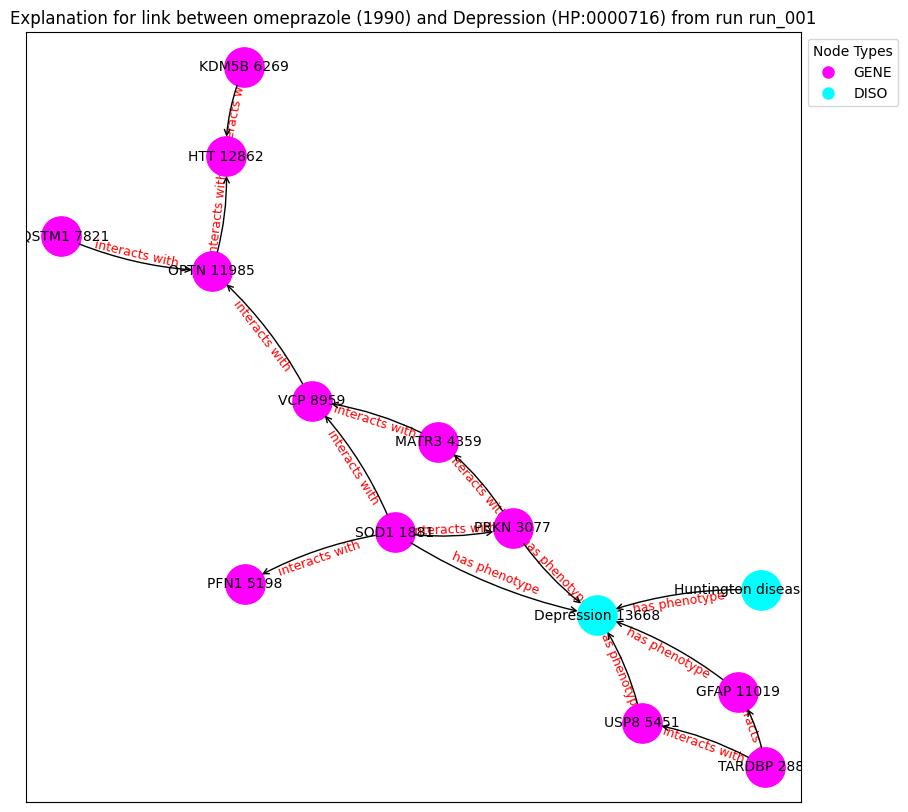

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('MATR3 4359', {'type': 'GENE'})
('PFN1 5198', {'type': 'GENE'})
('USP8 5451', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('SOD1 1881', 'PRKN 3077', {'label': 'interacts with'})
('SOD1 1881', 'PFN1 5198', {'label': 'interacts with'})
('SOD1 1881', 'VCP 8959', {'label': 'interacts with'})
('SOD1 1881', 'Depression 13668', {'label': 'has phenotype'})
('TARDBP 2880', 'GFAP 11019', {'label': 'interacts with'})
('TARDBP 2880', 'USP8 5451', {'label': 'interacts with'})
('PRKN 3077', 'MATR3 4359', {'label': 'interacts with'})
('PRKN 3077', 'Depression 13668', {'label': 'has phenotype'})
('MATR3 4359', 'VCP 8959', {'label': 'interacts with'})
('U

Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 136.69it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6248], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 141.87it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6248], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 142.54it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6248], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 149.27it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6248], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 135.02it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6248], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 121.60it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6248], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 134.72it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6248], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 135.17it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6248], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 133.80it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6248], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 133.47it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


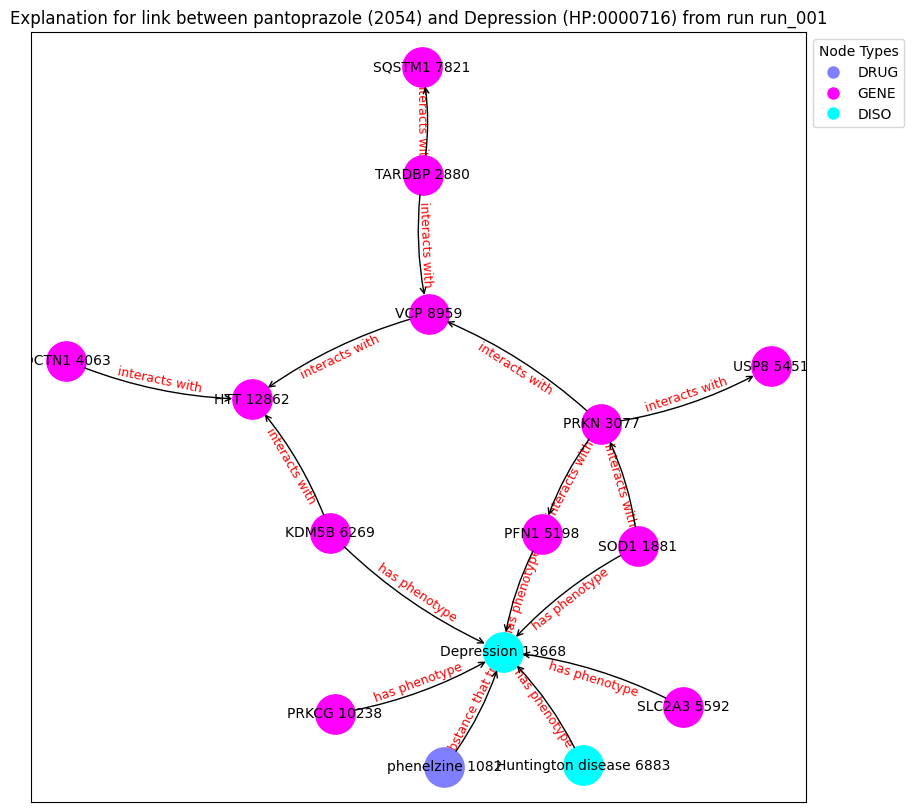

('phenelzine 1082', {'type': 'DRUG'})
('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('PFN1 5198', {'type': 'GENE'})
('USP8 5451', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('phenelzine 1082', 'Depression 13668', {'label': 'is substance that treats'})
('SOD1 1881', 'PRKN 3077', {'label': 'interacts with'})
('SOD1 1881', 'Depression 13668', {'label': 'has phenotype'})
('TARDBP 2880', 'SQSTM1 7821', {'label': 'interacts with'})
('TARDBP 2880', 'VCP 8959', {'label': 'interacts with'})
('PRKN 3077', 'VCP 8959', {'label': 'interacts with'})
('PRKN 3077', 'USP8 5451', {'label': 'interacts with'})
('PRKN 3077', 'PFN1 5198', {'label': 'interacts with'})
('D

Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:05<00:00, 136.54it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2714], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 140.05it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2714], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 143.32it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2714], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 144.92it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2714], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:05<00:00, 132.80it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2714], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:05<00:00, 135.08it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2714], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:05<00:00, 130.10it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2714], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:05<00:00, 135.04it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2714], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:05<00:00, 125.30it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2714], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 140.02it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


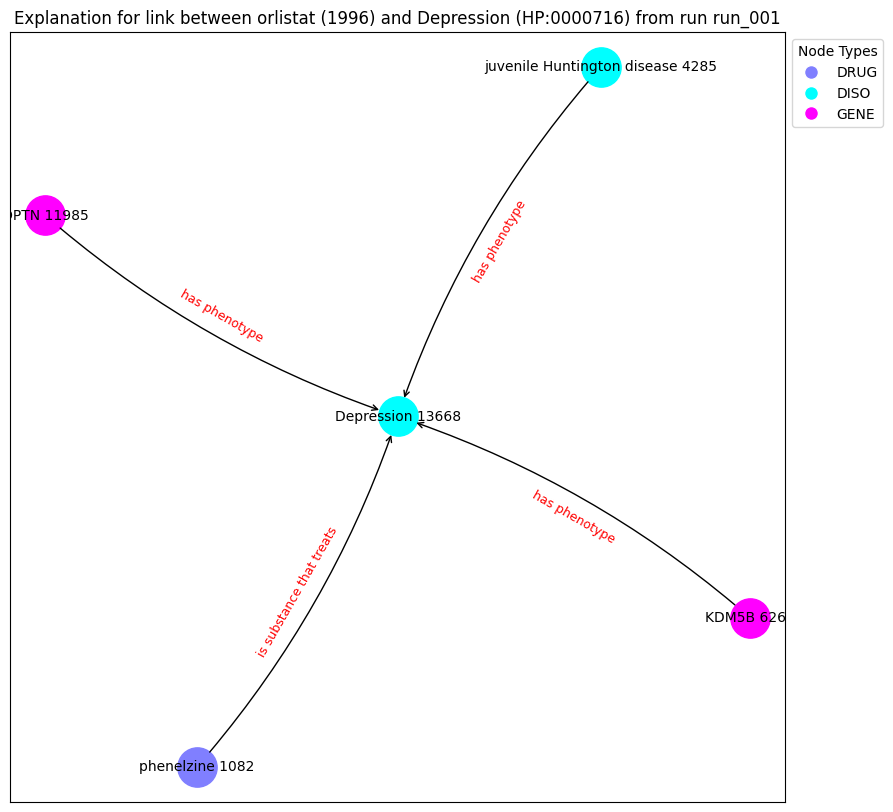

('phenelzine 1082', {'type': 'DRUG'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('KDM5B 6269', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('phenelzine 1082', 'Depression 13668', {'label': 'is substance that treats'})
('juvenile Huntington disease 4285', 'Depression 13668', {'label': 'has phenotype'})
('KDM5B 6269', 'Depression 13668', {'label': 'has phenotype'})
('OPTN 11985', 'Depression 13668', {'label': 'has phenotype'})
Explanation graph saved at c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\expl_5/incomplete_explanation_3_run_001_graph.gpickle
Explanation pair ids and names saved at c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\expl_5/incomplete_explanation_3_run_001_pair.pkl
node1:
       index_id          id semantic     label  semantic_id
12933     12933  HP:0001332     DISO  Dystonia            1
node2:
     index_id   id semanti

Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:05<00:00, 122.67it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 145.60it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 149.55it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 152.30it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 152.79it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 149.18it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 153.32it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 149.72it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 144.54it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 152.61it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


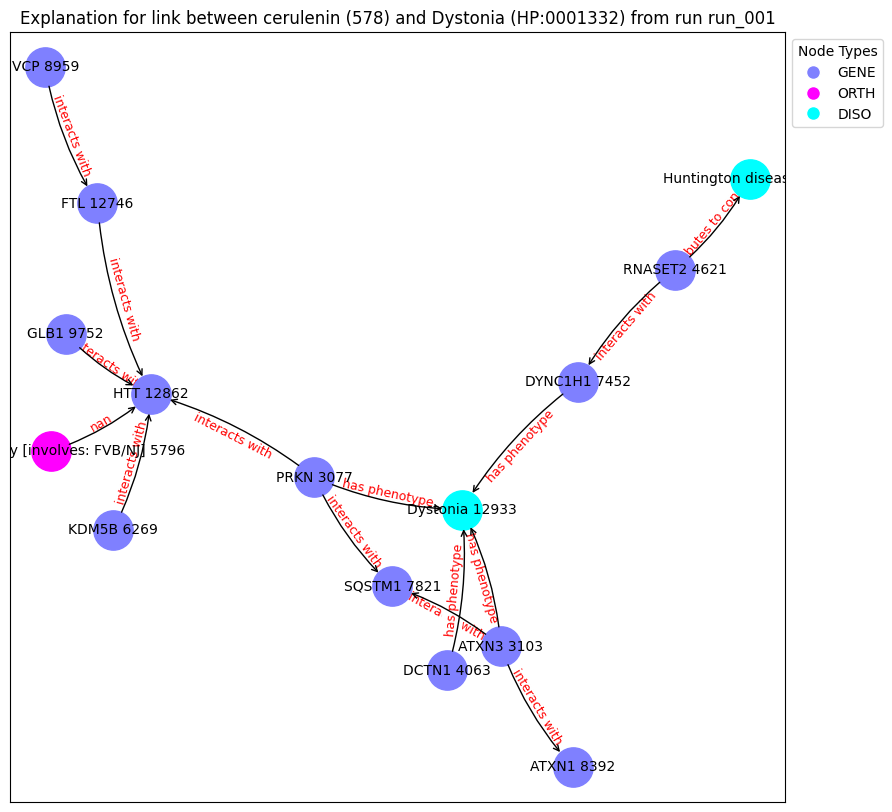

('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('RNASET2 4621', {'type': 'GENE'})
('Tg(HTT*)AXwy [involves: FVB/NJ] 5796', {'type': 'ORTH'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('GLB1 9752', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Dystonia 12933', {'type': 'DISO'})
('PRKN 3077', 'HTT 12862', {'label': 'interacts with'})
('PRKN 3077', 'Dystonia 12933', {'label': 'has phenotype'})
('PRKN 3077', 'SQSTM1 7821', {'label': 'interacts with'})
('ATXN3 3103', 'SQSTM1 7821', {'label': 'interacts with'})
('ATXN3 3103', 'Dystonia 12933', {'label': 'has phenotype'})
('ATXN3 3103', 'ATXN1 8392', {'label': 'interacts with'})
('DCTN1 4063', 'Dystonia 12933', {'label': 'has phenotype'})
('RNASET2 4621', 'DYNC1H1 7452', {'label': 'intera

Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:05<00:00, 129.29it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8642], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:05<00:00, 127.33it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8642], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 148.24it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8642], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 153.41it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8642], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 152.83it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8642], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 151.30it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8642], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 151.39it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8642], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 149.30it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8642], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 149.64it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8642], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 145.42it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


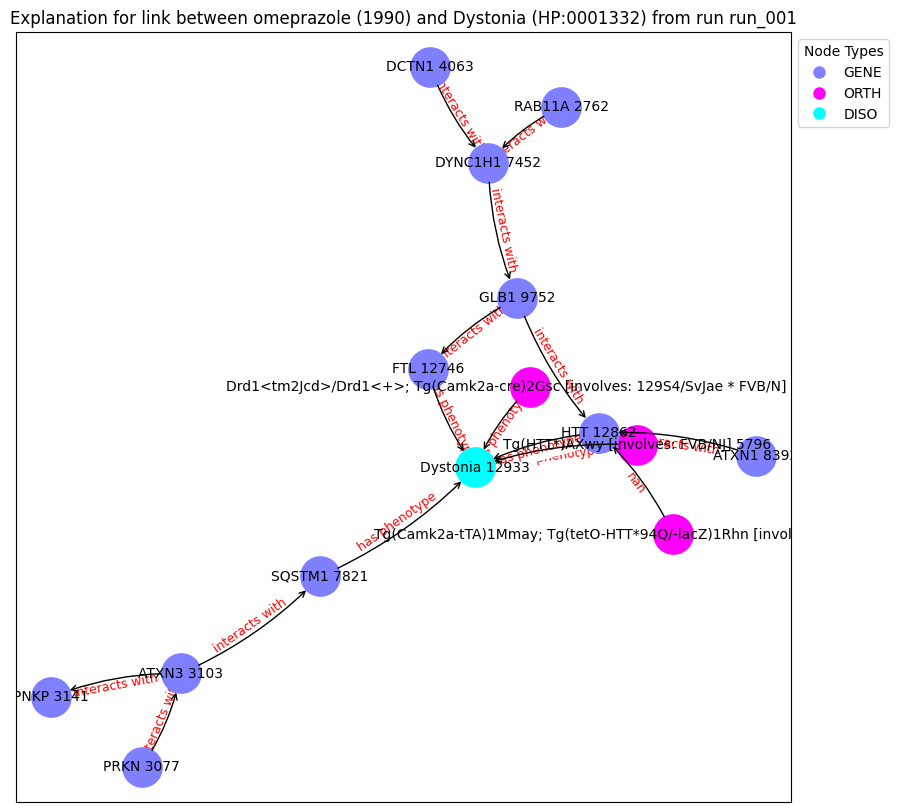

('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('Tg(Camk2a-tTA)1Mmay; Tg(tetO-HTT*94Q/-lacZ)1Rhn [involves: C57BL/6 * CBA] 4925', {'type': 'ORTH'})
('Tg(HTT*)AXwy [involves: FVB/NJ] 5796', {'type': 'ORTH'})
('DYNC1H1 7452', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('GLB1 9752', {'type': 'GENE'})
('Drd1<tm2Jcd>/Drd1<+>; Tg(Camk2a-cre)2Gsc [involves: 129S4/SvJae * FVB/N] 10314', {'type': 'ORTH'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Dystonia 12933', {'type': 'DISO'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'SQSTM1 7821', {'label': 'interacts with'})
('ATXN3 3103', 'PNKP 3141', {'label': 'interacts with'})
('DCTN1 4063', 'DYNC1H1 7452', {'label': 'interacts with'})
('Tg(Camk2a-tTA)1Mmay; Tg(tetO-HTT*94Q/-lacZ)1

Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 146.23it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5366], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 148.97it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5366], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 150.70it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5366], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 151.15it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5366], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 150.12it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5366], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 151.28it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5366], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 141.89it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5366], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 148.11it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5366], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 150.10it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5366], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 148.82it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


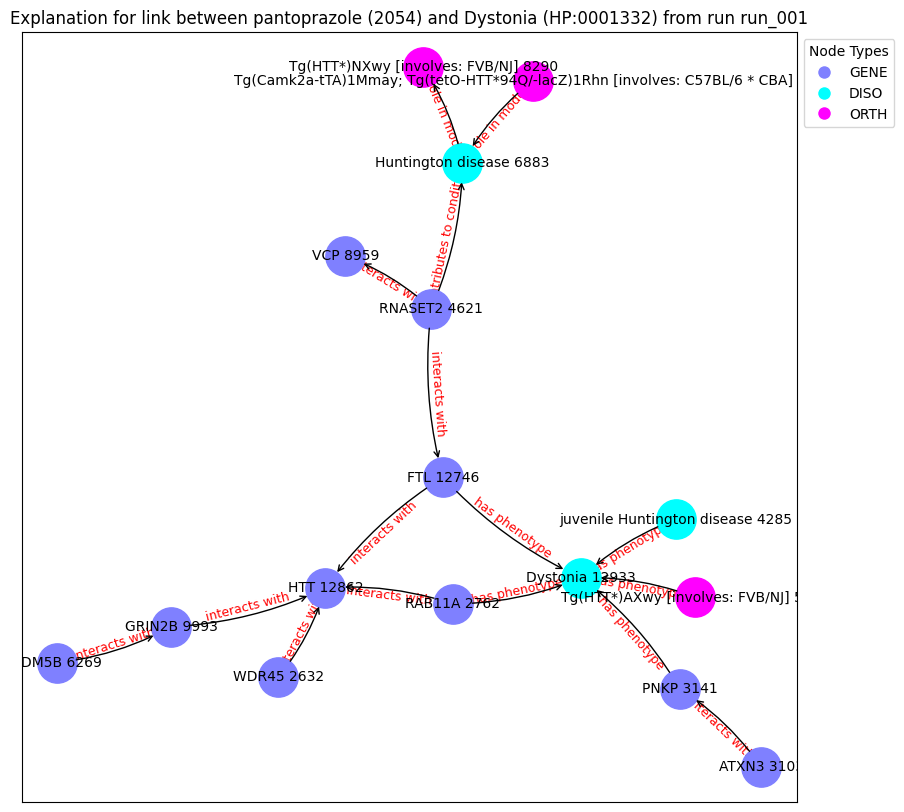

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('RNASET2 4621', {'type': 'GENE'})
('Tg(Camk2a-tTA)1Mmay; Tg(tetO-HTT*94Q/-lacZ)1Rhn [involves: C57BL/6 * CBA] 4925', {'type': 'ORTH'})
('Tg(HTT*)AXwy [involves: FVB/NJ] 5796', {'type': 'ORTH'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('Tg(HTT*)NXwy [involves: FVB/NJ] 8290', {'type': 'ORTH'})
('VCP 8959', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Dystonia 12933', {'type': 'DISO'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('RAB11A 2762', 'HTT 12862', {'label': 'interacts with'})
('RAB11A 2762', 'Dystonia 12933', {'label': 'has phenotype'})
('ATXN3 3103', 'PNKP 3141', {'label': 'interacts with'})
('PNKP 3141', 'Dystonia 12933', {'label': 'has phenotype'})
('juvenile Huntingto

Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 244.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 240.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 250.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 244.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 243.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 248.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 248.11it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic            label  semantic_id
14311     14311  HP:0031845     DISO  Abnormal libido            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.2872], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 218.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2872], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2872], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2872], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2872], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2872], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 193.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2872], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 193.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2872], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 201.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2872], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 194.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2872], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 193.08it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.8600], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 183.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8600], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8600], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 203.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8600], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 187.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8600], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 220.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8600], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:02<00:00, 233.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8600], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 212.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8600], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 225.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8600], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 227.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8600], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 228.40it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.7989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 223.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 213.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 233.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 215.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 223.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 213.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 223.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.61it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.5630], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 182.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5630], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 205.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5630], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 201.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5630], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 202.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5630], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 199.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5630], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 201.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5630], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 202.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5630], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 201.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5630], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 198.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5630], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 192.51it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
6473      6473  HP:0001272     DISO  Cerebellar atrophy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.8957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 180.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.15it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
6473      6473  HP:0001272     DISO  Cerebellar atrophy            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.5802], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5802], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5802], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5802], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 198.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5802], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 198.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5802], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5802], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5802], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5802], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 196.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5802], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.75it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic        label  semantic_id
2028      2028  HP:0002066     DISO  Gait ataxia            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.7679], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7679], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7679], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:02<00:00, 235.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7679], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7679], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7679], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 214.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7679], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 232.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7679], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 231.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7679], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7679], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 206.14it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic        label  semantic_id
2028      2028  HP:0002066     DISO  Gait ataxia            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.5398], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 222.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5398], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 226.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5398], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 229.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5398], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 226.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5398], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 210.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5398], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 225.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5398], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 229.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5398], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:02<00:00, 236.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5398], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 225.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5398], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 220.38it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
6571      6571  HP:0031473     DISO  Hostility            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.4116], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 232.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4116], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 224.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4116], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4116], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 212.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4116], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4116], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:02<00:00, 233.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4116], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4116], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4116], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 216.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4116], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 209.64it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic             label  semantic_id
9177      9177  HP:0030842     DISO  Choking episodes            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.3099], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 212.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3099], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3099], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 213.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3099], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 219.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3099], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3099], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3099], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3099], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3099], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3099], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.62it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic         label  semantic_id
7072      7072  HP:0002067     DISO  Bradykinesia            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5820], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 185.14it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5820], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 177.10it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5820], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 179.65it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5820], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 186.28it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5820], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 184.84it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5820], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:04<00:00, 167.45it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5820], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:04<00:00, 165.30it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5820], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:04<00:00, 174.26it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5820], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:04<00:00, 160.72it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5820], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:04<00:00, 172.75it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


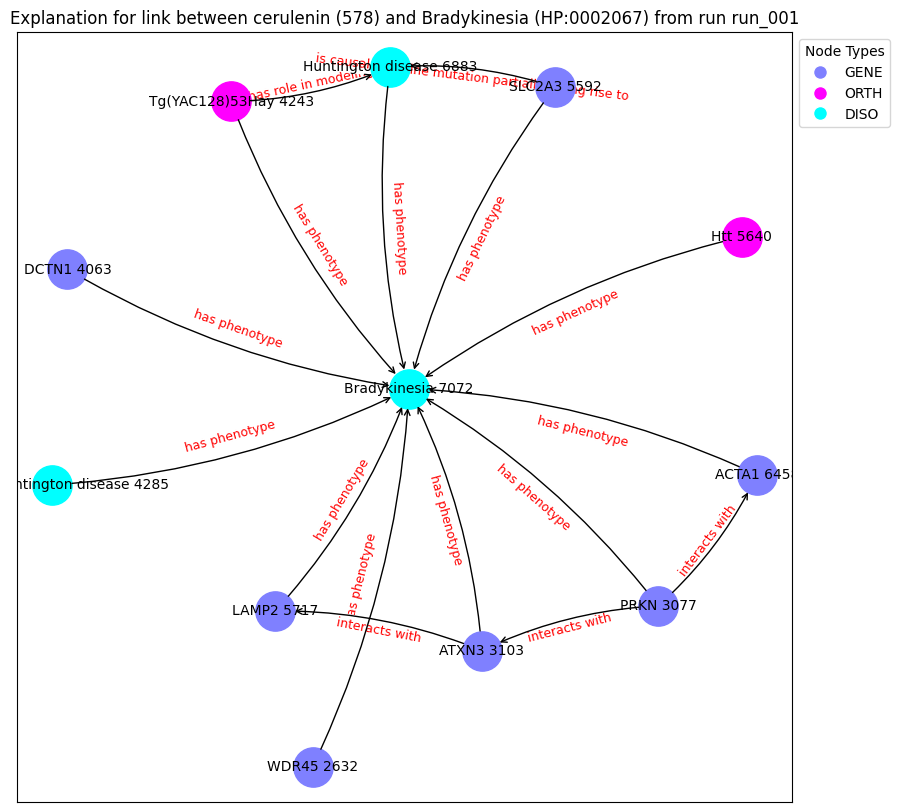

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('Tg(YAC128)53Hay 4243', {'type': 'ORTH'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('LAMP2 5717', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('Bradykinesia 7072', {'type': 'DISO'})
('WDR45 2632', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'Bradykinesia 7072', {'label': 'has phenotype'})
('ATXN3 3103', 'LAMP2 5717', {'label': 'interacts with'})
('DCTN1 4063', 'Bradykinesia 7072', {'label': 'has phenotype'})
('Tg(YAC128)53Hay 4243', 'Huntington disease 6883', {'label': 'has role in modeling'})
('Tg(YAC128)53Hay 4243', 'Bradykinesia 7

Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:04<00:00, 169.96it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6575], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 185.06it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6575], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 186.90it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6575], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 186.36it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6575], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 188.57it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6575], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 190.95it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6575], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 186.93it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6575], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 183.99it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6575], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 183.59it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6575], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 182.87it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


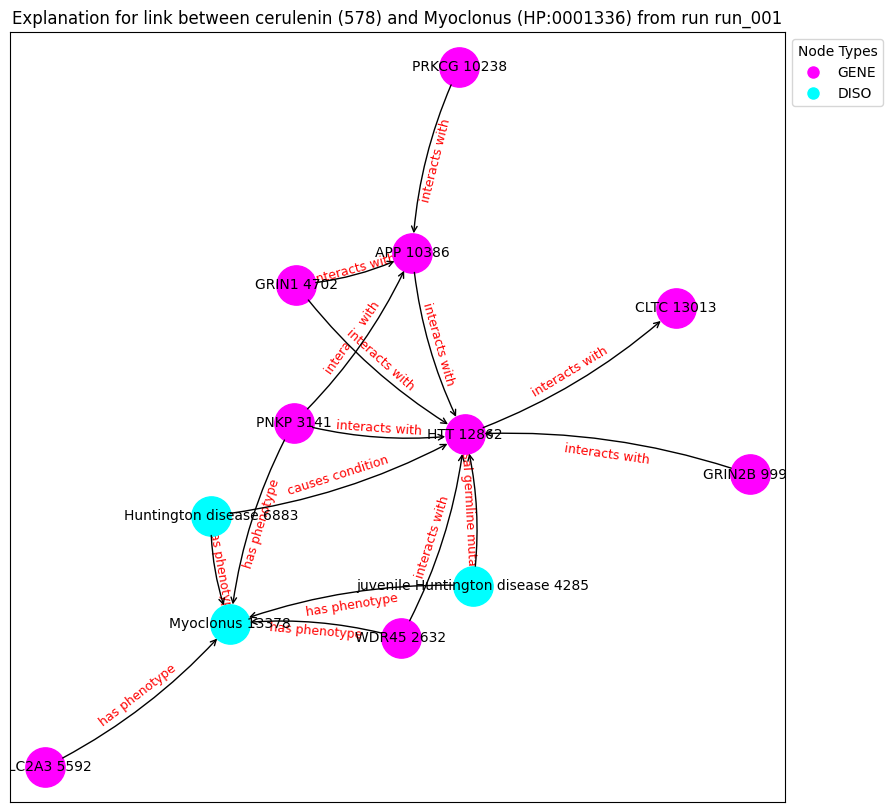

('WDR45 2632', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('GRIN2B 9993', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('APP 10386', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Myoclonus 13378', {'type': 'DISO'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('WDR45 2632', 'Myoclonus 13378', {'label': 'has phenotype'})
('PNKP 3141', 'HTT 12862', {'label': 'interacts with'})
('PNKP 3141', 'APP 10386', {'label': 'interacts with'})
('PNKP 3141', 'Myoclonus 13378', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is causal germline mutation in'})
('juvenile Huntington disease 4285', 'Myoclonus 13378', {'label': 'has phenotype'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'APP 10386', {'label'

Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:04<00:00, 166.56it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.8372], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.13it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.8372], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.95it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.8372], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.24it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8372], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 176.37it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8372], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.02it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.8372], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:04<00:00, 166.60it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8372], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.55it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.8372], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.24it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.8372], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.66it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


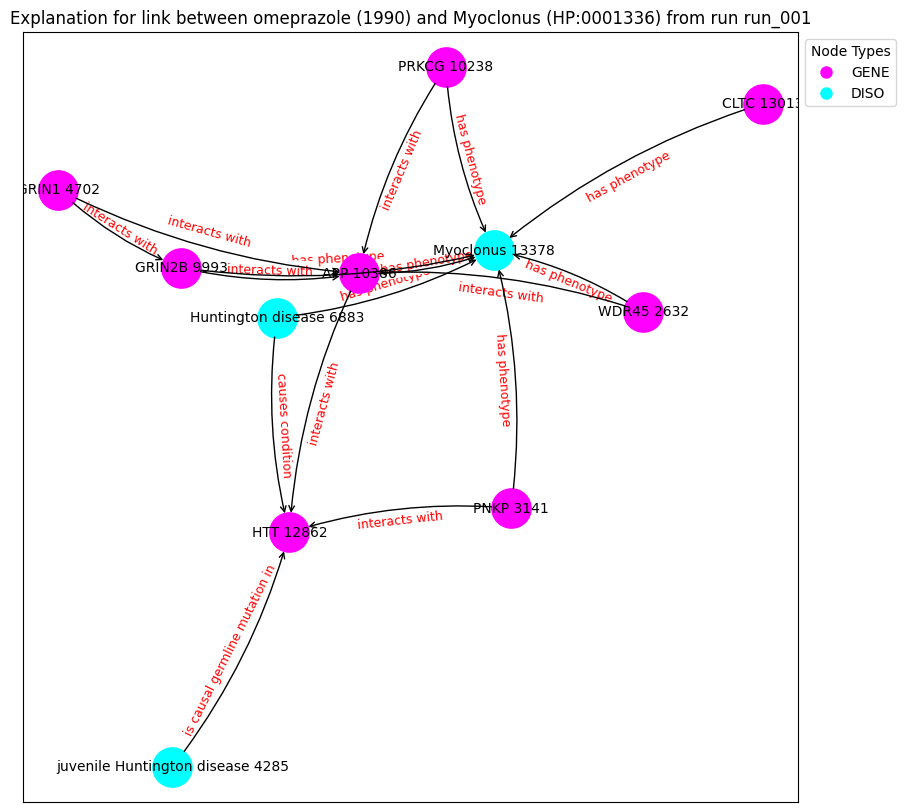

('WDR45 2632', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('GRIN2B 9993', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('APP 10386', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Myoclonus 13378', {'type': 'DISO'})
('WDR45 2632', 'APP 10386', {'label': 'interacts with'})
('WDR45 2632', 'Myoclonus 13378', {'label': 'has phenotype'})
('PNKP 3141', 'HTT 12862', {'label': 'interacts with'})
('PNKP 3141', 'Myoclonus 13378', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is causal germline mutation in'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'APP 10386', {'label': 'interacts with'})
('Huntington disease 6883', 'HTT 12862', {'label': 'causes condition'})
('Huntington disease 6883', 'Myoclonus 13378', {'label': 'has phenotype'})
('GR

Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:04<00:00, 174.68it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5484], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 181.33it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5484], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.69it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.5484], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 178.85it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.5484], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 179.41it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.5484], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 177.94it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.5484], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.02it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5484], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:04<00:00, 161.05it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.5484], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:04<00:00, 172.21it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.5484], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 178.10it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


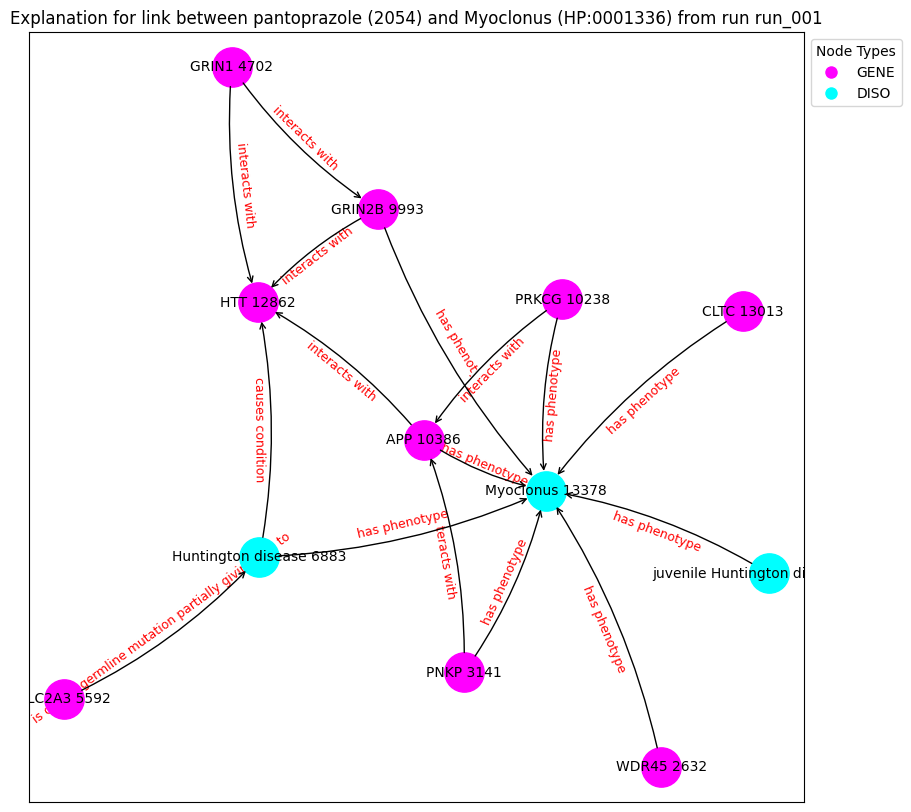

('WDR45 2632', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('GRIN2B 9993', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('APP 10386', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Myoclonus 13378', {'type': 'DISO'})
('WDR45 2632', 'Myoclonus 13378', {'label': 'has phenotype'})
('PNKP 3141', 'APP 10386', {'label': 'interacts with'})
('PNKP 3141', 'Myoclonus 13378', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'Myoclonus 13378', {'label': 'has phenotype'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('Huntington disease 6883', 'HTT 12862', {'label': 'causes condition'})
('H

Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 195.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3450], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 193.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3450], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 198.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3450], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 194.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3450], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 199.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3450], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 202.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3450], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 200.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3450], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 207.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3450], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 207.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3450], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 201.50it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic   label  semantic_id
14731     14731  HP:0002072     DISO  Chorea            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.8928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 167.47it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.8928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 156.22it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 169.28it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 168.93it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 172.08it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.8928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.74it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.8928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 172.55it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.8928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 168.66it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 168.34it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 165.69it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


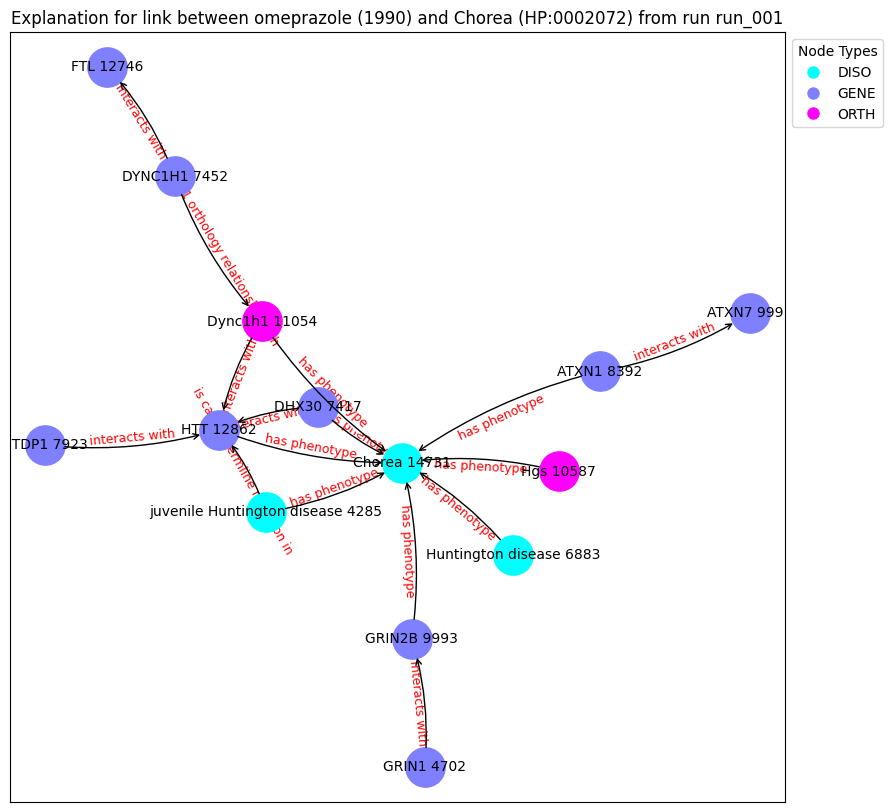

('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('Hgs 10587', {'type': 'ORTH'})
('Dync1h1 11054', {'type': 'ORTH'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Chorea 14731', {'type': 'DISO'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is causal germline mutation in'})
('juvenile Huntington disease 4285', 'Chorea 14731', {'label': 'has phenotype'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('Huntington disease 6883', 'Chorea 14731', {'label': 'has phenotype'})
('DHX30 7417', 'HTT 12862', {'label': 'interacts with'})
('DHX30 7417', 'Chorea 14731', {'label': 'has phenotype'})
('DYNC1H1 7452', 'Dync1h1 11054', {'label': 'in 1 to 1 orthology relationsh

Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 162.72it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6278], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 162.67it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6278], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 171.70it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6278], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:03<00:00, 177.26it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6278], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 173.69it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6278], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 163.68it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6278], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 172.82it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6278], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 152.06it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6278], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 165.58it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6278], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:03<00:00, 175.00it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


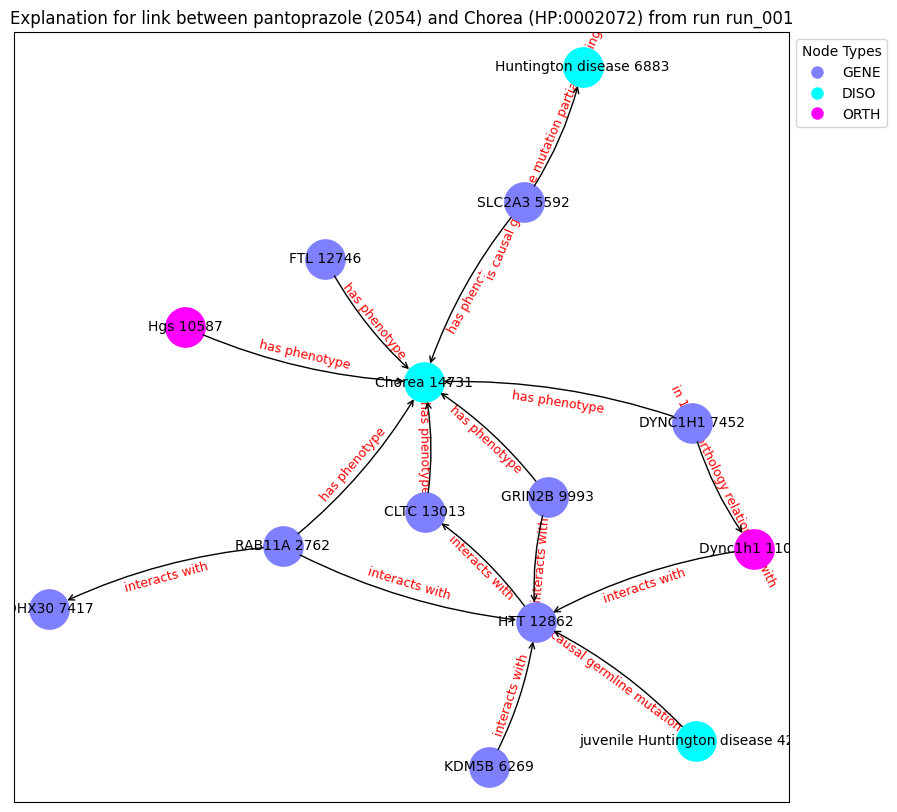

('RAB11A 2762', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('Hgs 10587', {'type': 'ORTH'})
('Dync1h1 11054', {'type': 'ORTH'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Chorea 14731', {'type': 'DISO'})
('RAB11A 2762', 'HTT 12862', {'label': 'interacts with'})
('RAB11A 2762', 'Chorea 14731', {'label': 'has phenotype'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is causal germline mutation in'})
('SLC2A3 5592', 'Chorea 14731', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('KDM5B 6269', 'HTT 12862', {'label': 'interacts with'

Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:03<00:00, 228.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 238.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 239.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 248.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:03<00:00, 217.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:03<00:00, 228.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 245.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 247.64it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic       label  semantic_id
2824      2824  HP:0002312     DISO  Clumsiness            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 240.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 239.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 250.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 238.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 243.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 248.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 239.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 246.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:03<00:00, 218.99it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic        label  semantic_id
13123     13123  HP:0001824     DISO  Weight loss            1
node2:
     index_id   id semantic      label  semantic_id
350       350  700     DRUG  clomifene            2
Prediction from trained model: tensor([0.5149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:04<00:00, 140.52it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 138.68it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:04<00:00, 140.43it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:04<00:00, 141.63it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 135.28it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:04<00:00, 140.78it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 139.73it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:06<00:00, 111.61it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:06<00:00, 111.77it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 137.56it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


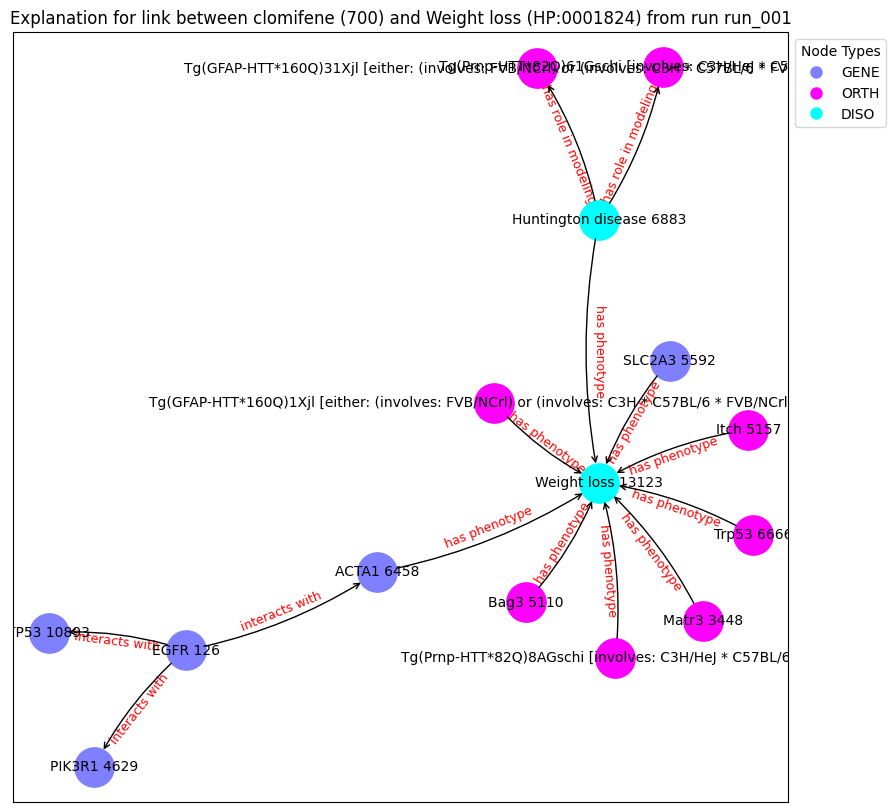

('EGFR 126', {'type': 'GENE'})
('Tg(Prnp-HTT*82Q)8AGschi [involves: C3H/HeJ * C57BL/6J] 839', {'type': 'ORTH'})
('Matr3 3448', {'type': 'ORTH'})
('PIK3R1 4629', {'type': 'GENE'})
('Tg(GFAP-HTT*160Q)1Xjl [either: (involves: FVB/NCrl) or (involves: C3H * C57BL/6 * FVB/NCrl)] 4958', {'type': 'ORTH'})
('Bag3 5110', {'type': 'ORTH'})
('Itch 5157', {'type': 'ORTH'})
('SLC2A3 5592', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Trp53 6666', {'type': 'ORTH'})
('Huntington disease 6883', {'type': 'DISO'})
('Tg(Prnp-HTT*82Q)61Gschi [involves: C3H/HeJ * C57BL/6J] 10477', {'type': 'ORTH'})
('TP53 10893', {'type': 'GENE'})
('Tg(GFAP-HTT*160Q)31Xjl [either: (involves: FVB/NCrl) or (involves: C3H * C57BL/6 * FVB/NCrl)] 12780', {'type': 'ORTH'})
('Weight loss 13123', {'type': 'DISO'})
('EGFR 126', 'PIK3R1 4629', {'label': 'interacts with'})
('EGFR 126', 'TP53 10893', {'label': 'interacts with'})
('EGFR 126', 'ACTA1 6458', {'label': 'interacts with'})
('Tg(Prnp-HTT*82Q)8AGschi [involves: C3H/HeJ

Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 134.17it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6007], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 139.59it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6007], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:04<00:00, 142.40it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6007], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 137.99it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6007], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 136.95it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6007], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 139.55it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6007], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 120.72it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6007], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 124.38it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6007], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 129.78it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6007], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:04<00:00, 140.92it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


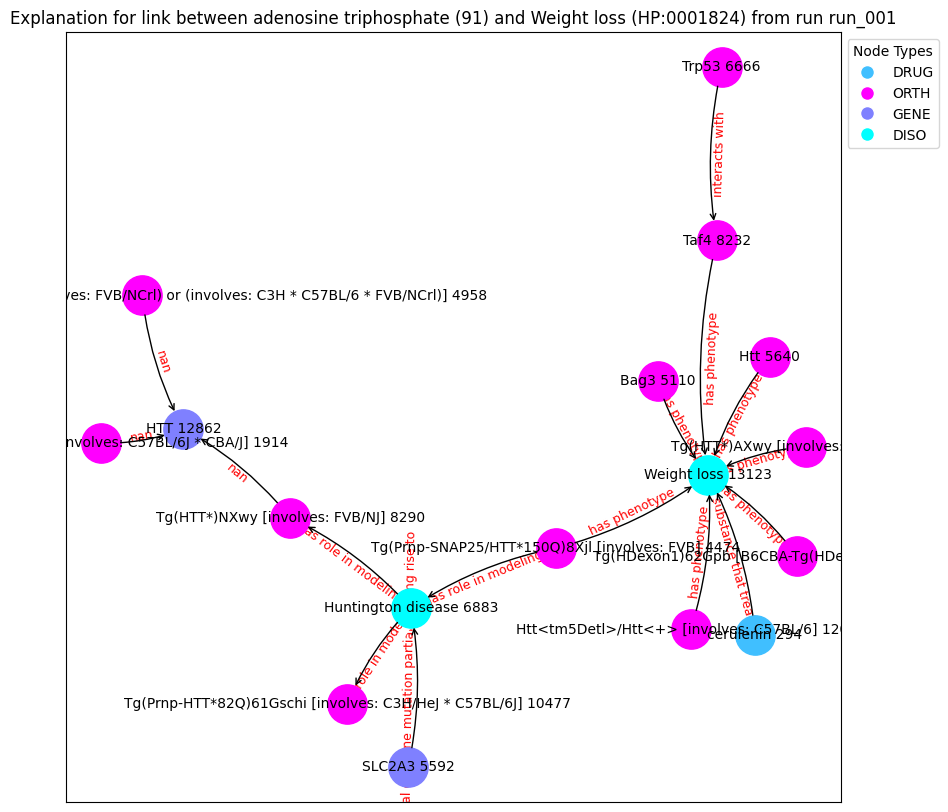

('cerulenin 294', {'type': 'DRUG'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', {'type': 'ORTH'})
('Tg(Prnp-SNAP25/HTT*150Q)8Xjl [involves: FVB] 4474', {'type': 'ORTH'})
('Tg(GFAP-HTT*160Q)1Xjl [either: (involves: FVB/NCrl) or (involves: C3H * C57BL/6 * FVB/NCrl)] 4958', {'type': 'ORTH'})
('Bag3 5110', {'type': 'ORTH'})
('SLC2A3 5592', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('Tg(HTT*)AXwy [involves: FVB/NJ] 5796', {'type': 'ORTH'})
('Trp53 6666', {'type': 'ORTH'})
('Huntington disease 6883', {'type': 'DISO'})
('Taf4 8232', {'type': 'ORTH'})
('Tg(HTT*)NXwy [involves: FVB/NJ] 8290', {'type': 'ORTH'})
('Tg(Prnp-HTT*82Q)61Gschi [involves: C3H/HeJ * C57BL/6J] 10477', {'type': 'ORTH'})
('Htt<tm5Detl>/Htt<+> [involves: C57BL/6] 12001', {'type': 'ORTH'})
('Tg(HDexon1)62Gpb [B6CBA-Tg(HDexon1)62Gpb/1J] 12785', {'type': 'ORTH'})
('HTT 12862', {'type': 'GENE'})
('Weight loss 13123', {'type': 'DISO'})
('cerulenin 294', 'Weight loss 13123', {'label': 'is substance that treats'})

Explain edge between nodes 13978 and 581: 100%|██████████| 700/700 [00:03<00:00, 179.41it/s]


Contribution threshold is tensor(0.0063)
Explanation found!


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


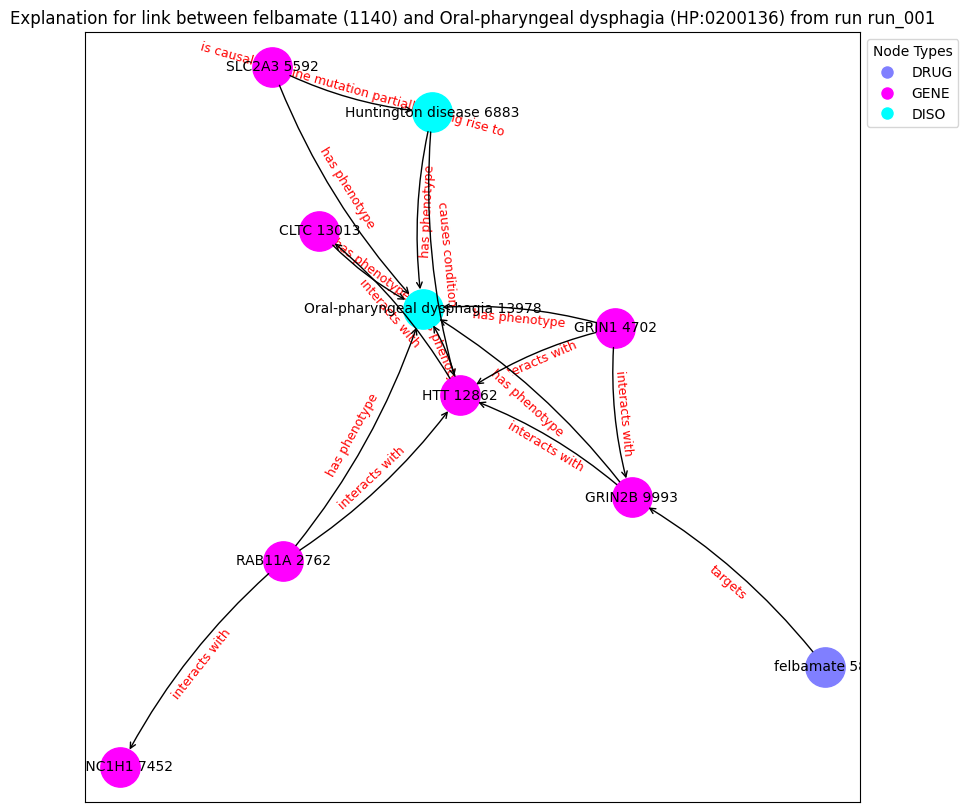

('felbamate 581', {'type': 'DRUG'})
('RAB11A 2762', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Oral-pharyngeal dysphagia 13978', {'type': 'DISO'})
('felbamate 581', 'GRIN2B 9993', {'label': 'targets'})
('RAB11A 2762', 'HTT 12862', {'label': 'interacts with'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('SLC2A3 5592', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenot

Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 134.69it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1129], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 138.78it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1129], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 146.89it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1129], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 144.57it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1129], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 137.76it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1129], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 129.28it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1129], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 143.31it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1129], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 142.43it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1129], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 142.90it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1129], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 141.66it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


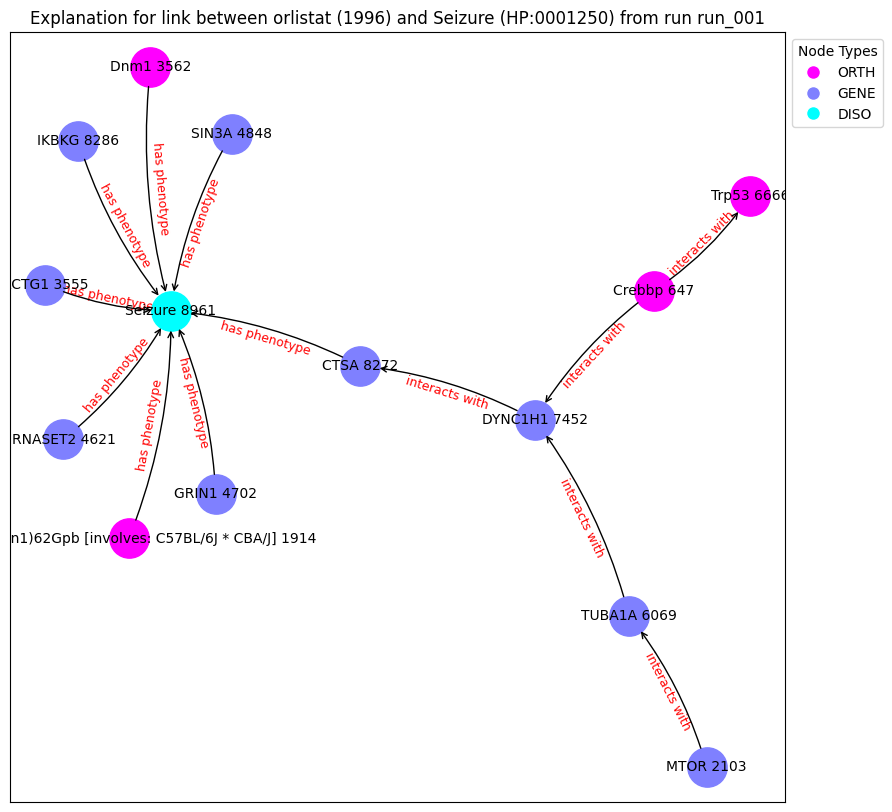

('Crebbp 647', {'type': 'ORTH'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', {'type': 'ORTH'})
('MTOR 2103', {'type': 'GENE'})
('ACTG1 3555', {'type': 'GENE'})
('Dnm1 3562', {'type': 'ORTH'})
('RNASET2 4621', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SIN3A 4848', {'type': 'GENE'})
('TUBA1A 6069', {'type': 'GENE'})
('Trp53 6666', {'type': 'ORTH'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTSA 8272', {'type': 'GENE'})
('IKBKG 8286', {'type': 'GENE'})
('Seizure 8961', {'type': 'DISO'})
('Crebbp 647', 'Trp53 6666', {'label': 'interacts with'})
('Crebbp 647', 'DYNC1H1 7452', {'label': 'interacts with'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', 'Seizure 8961', {'label': 'has phenotype'})
('MTOR 2103', 'TUBA1A 6069', {'label': 'interacts with'})
('ACTG1 3555', 'Seizure 8961', {'label': 'has phenotype'})
('Dnm1 3562', 'Seizure 8961', {'label': 'has phenotype'})
('RNASET2 4621', 'Seizure 8961', {'label': 'has phenotype'})
('GRIN1 4702', 'Seizure 8961', {'label': 

Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 132.81it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7575], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 136.79it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7575], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 142.61it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7575], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 143.57it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7575], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 143.25it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7575], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 143.96it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.7575], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 143.80it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7575], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 142.30it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7575], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 137.58it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7575], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 133.37it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


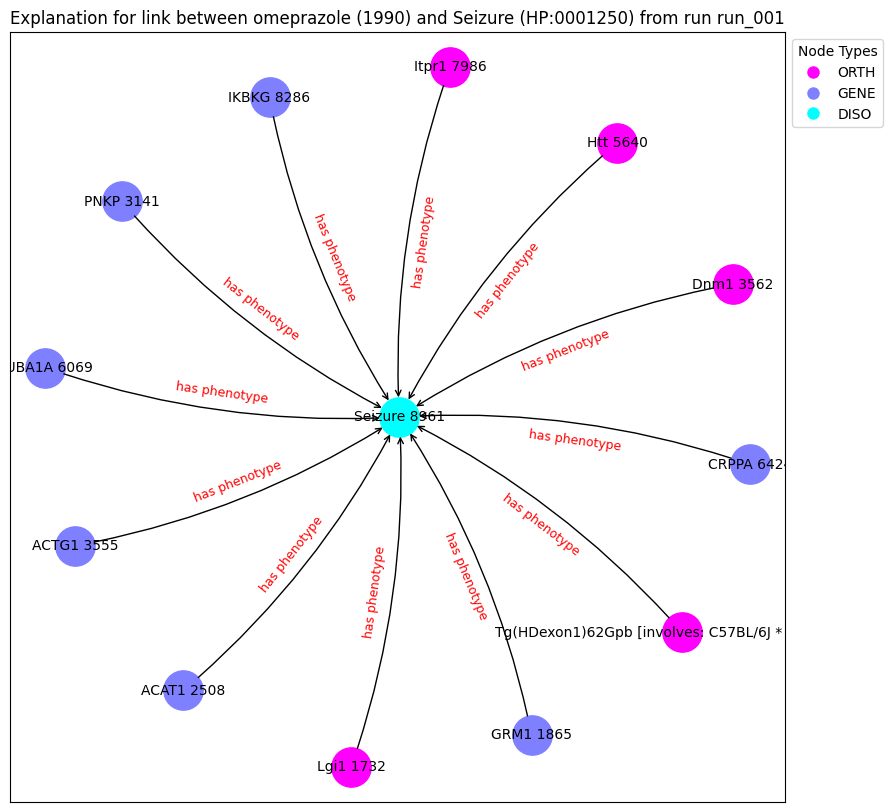

('Lgi1 1732', {'type': 'ORTH'})
('GRM1 1865', {'type': 'GENE'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', {'type': 'ORTH'})
('ACAT1 2508', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('ACTG1 3555', {'type': 'GENE'})
('Dnm1 3562', {'type': 'ORTH'})
('Htt 5640', {'type': 'ORTH'})
('TUBA1A 6069', {'type': 'GENE'})
('CRPPA 6424', {'type': 'GENE'})
('Itpr1 7986', {'type': 'ORTH'})
('IKBKG 8286', {'type': 'GENE'})
('Seizure 8961', {'type': 'DISO'})
('Lgi1 1732', 'Seizure 8961', {'label': 'has phenotype'})
('GRM1 1865', 'Seizure 8961', {'label': 'has phenotype'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', 'Seizure 8961', {'label': 'has phenotype'})
('ACAT1 2508', 'Seizure 8961', {'label': 'has phenotype'})
('PNKP 3141', 'Seizure 8961', {'label': 'has phenotype'})
('ACTG1 3555', 'Seizure 8961', {'label': 'has phenotype'})
('Dnm1 3562', 'Seizure 8961', {'label': 'has phenotype'})
('Htt 5640', 'Seizure 8961', {'label': 'has phenotype'})
('TUBA1A 6069', 'Seizure 896

Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:05<00:00, 136.39it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3463], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:05<00:00, 127.86it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3463], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 143.61it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3463], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 144.61it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3463], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 144.26it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3463], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:05<00:00, 136.43it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3463], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:05<00:00, 134.97it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3463], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 142.20it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3463], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 142.12it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3463], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 140.88it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


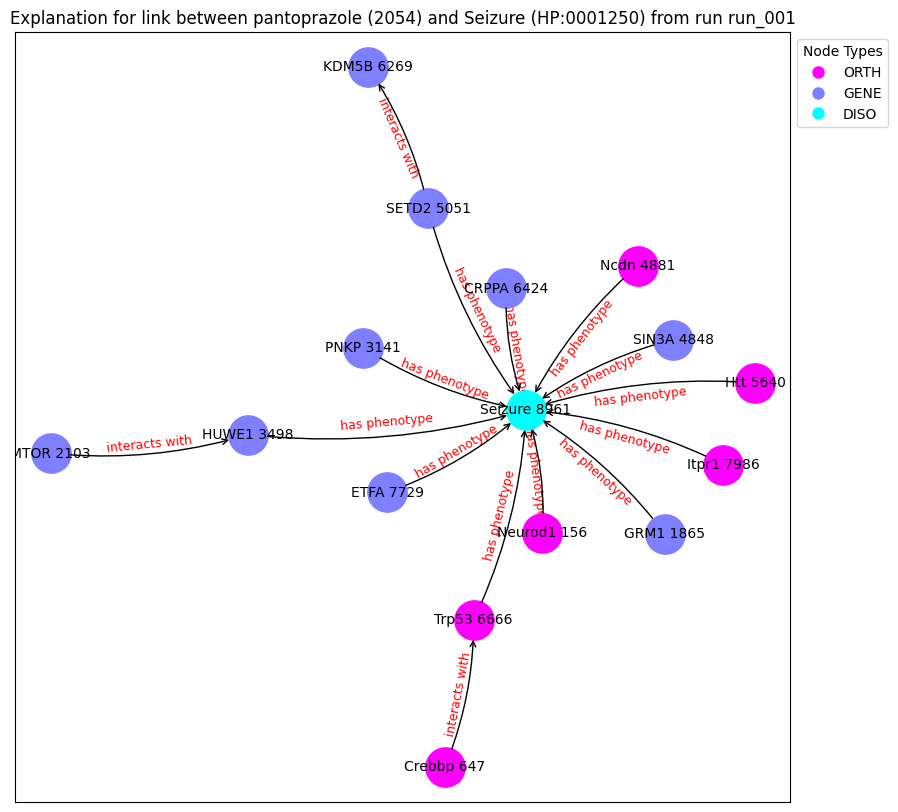

('Neurod1 156', {'type': 'ORTH'})
('Crebbp 647', {'type': 'ORTH'})
('GRM1 1865', {'type': 'GENE'})
('MTOR 2103', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('SIN3A 4848', {'type': 'GENE'})
('Ncdn 4881', {'type': 'ORTH'})
('SETD2 5051', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('KDM5B 6269', {'type': 'GENE'})
('CRPPA 6424', {'type': 'GENE'})
('Trp53 6666', {'type': 'ORTH'})
('ETFA 7729', {'type': 'GENE'})
('Itpr1 7986', {'type': 'ORTH'})
('Seizure 8961', {'type': 'DISO'})
('Neurod1 156', 'Seizure 8961', {'label': 'has phenotype'})
('Crebbp 647', 'Trp53 6666', {'label': 'interacts with'})
('GRM1 1865', 'Seizure 8961', {'label': 'has phenotype'})
('MTOR 2103', 'HUWE1 3498', {'label': 'interacts with'})
('PNKP 3141', 'Seizure 8961', {'label': 'has phenotype'})
('HUWE1 3498', 'Seizure 8961', {'label': 'has phenotype'})
('SIN3A 4848', 'Seizure 8961', {'label': 'has phenotype'})
('Ncdn 4881', 'Seizure 8961', {'label': 'has phenotype'})
('SETD2 5

Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0695], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0695], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 244.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0695], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0695], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 192.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0695], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0695], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 205.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0695], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0695], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 232.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0695], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 237.86it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                             label  \
1317      1317  HP:0009088     DISO  Speech articulation difficulties   

      semantic_id  
1317            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.5951], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5951], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 235.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5951], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 252.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5951], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5951], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 247.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5951], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 248.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5951], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5951], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5951], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 251.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5951], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 246.52it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
4154      4154  HP:0000746     DISO  Delusions            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.2870], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2870], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 252.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2870], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2870], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:03<00:00, 212.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2870], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 252.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2870], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2870], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2870], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 257.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2870], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:03<00:00, 229.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2870], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 255.49it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                         label  \
12562     12562  HP:0001262     DISO  Excessive daytime somnolence   

       semantic_id  
12562            1  
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.5550], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 217.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5550], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 229.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5550], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5550], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 208.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5550], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5550], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5550], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 223.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5550], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5550], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 209.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5550], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 209.37it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                         label  \
12562     12562  HP:0001262     DISO  Excessive daytime somnolence   

       semantic_id  
12562            1  
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.5440], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 208.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5440], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5440], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 205.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5440], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5440], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 207.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5440], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5440], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 212.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5440], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 227.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5440], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5440], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.93it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic   label  semantic_id
9999      9999  HP:0002169     DISO  Clonus            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.4475], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 229.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4475], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 209.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4475], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 228.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4475], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4475], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 221.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4475], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 231.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4475], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4475], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 228.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4475], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 209.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4475], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 232.60it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic  \
9644      9644  HP:0010794     DISO   

                                             label  semantic_id  
9644  Impaired visuospatial constructive cognition            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.3154], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3154], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 215.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3154], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:02<00:00, 233.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3154], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3154], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3154], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 216.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3154], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3154], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3154], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3154], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.99it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic              label  semantic_id
14773     14773  HP:0002540     DISO  Inability to walk            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.8066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 180.48it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.8066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.79it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.8066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 180.46it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.8066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.18it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.8066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 197.71it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.8066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.18it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.8066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 199.68it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.8066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.73it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.8066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.47it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.8066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.38it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


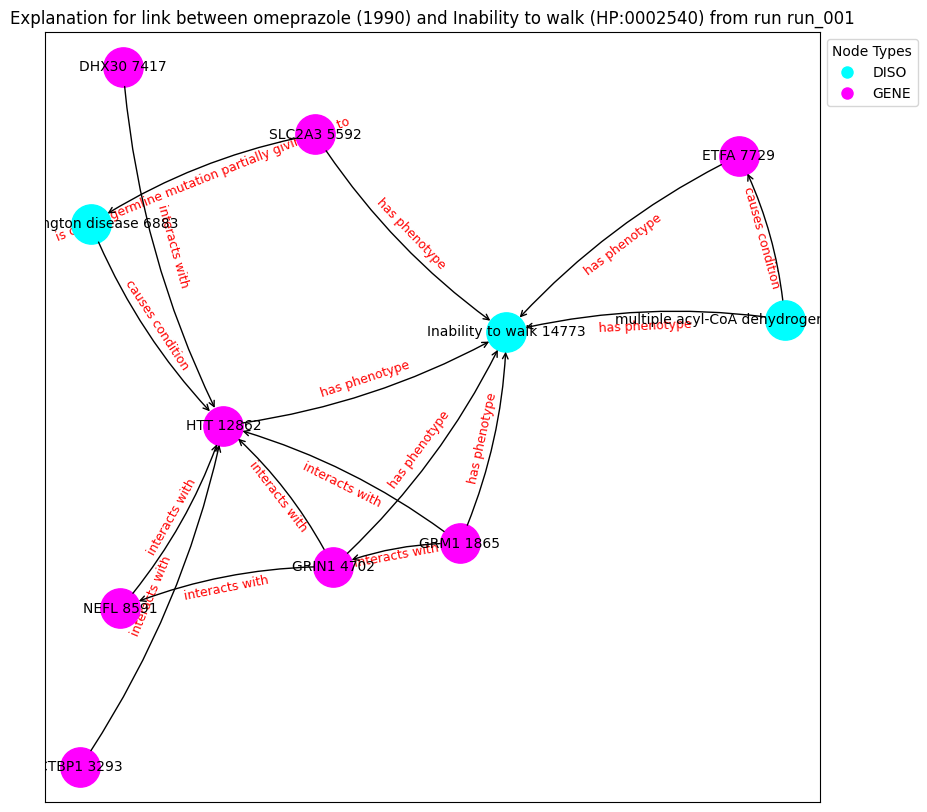

('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('GRM1 1865', {'type': 'GENE'})
('CTBP1 3293', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Inability to walk 14773', {'type': 'DISO'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'Inability to walk 14773', {'label': 'has phenotype'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'ETFA 7729', {'label': 'causes condition'})
('GRM1 1865', 'HTT 12862', {'label': 'interacts with'})
('GRM1 1865', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('CTBP1 3293', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'NEFL 8591', {'label': 'interacts with'})
('GRIN1 4702', 'Inabilit

Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 181.54it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 185.73it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.86it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.06it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.30it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.68it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 199.13it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.15it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.23it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.79it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


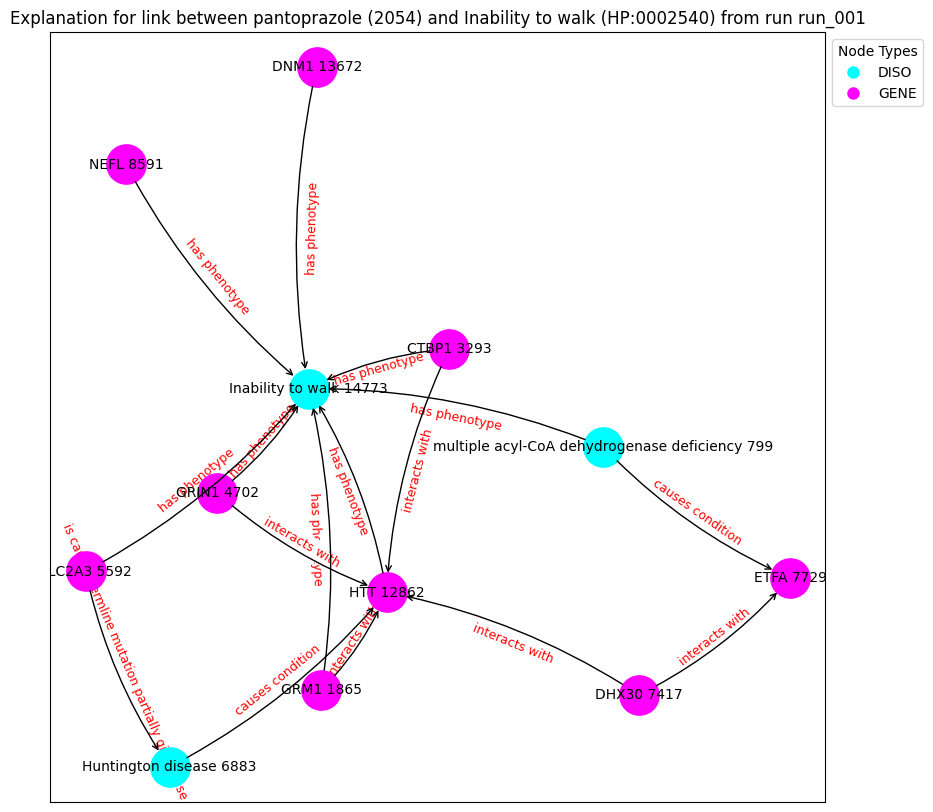

('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('GRM1 1865', {'type': 'GENE'})
('CTBP1 3293', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('DNM1 13672', {'type': 'GENE'})
('Inability to walk 14773', {'type': 'DISO'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'Inability to walk 14773', {'label': 'has phenotype'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'ETFA 7729', {'label': 'causes condition'})
('GRM1 1865', 'HTT 12862', {'label': 'interacts with'})
('GRM1 1865', 'Inability to walk 14773', {'label': 'has phenotype'})
('CTBP1 3293', 'HTT 12862', {'label': 'interacts with'})
('CTBP1 3293', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'Inability to walk 1

Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4339], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4339], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 251.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4339], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4339], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4339], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 253.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4339], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 245.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4339], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:03<00:00, 233.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4339], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:03<00:00, 185.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4339], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:03<00:00, 209.45it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                    label  \
917       917  HP:0002529     DISO  Neuronal loss in central nervous system   

     semantic_id  
917            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.2359], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 229.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2359], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 246.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2359], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2359], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 241.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2359], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2359], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 224.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2359], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 252.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2359], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2359], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 247.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2359], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 248.27it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 259.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 249.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 244.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 252.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 249.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 246.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 255.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:03<00:00, 217.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 242.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 251.23it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 249.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 251.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 241.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 242.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:03<00:00, 229.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 254.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:03<00:00, 224.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 241.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 250.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 254.78it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic       label  semantic_id
14527     14527  HP:0030955     DISO  Alcoholism            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.2944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 209.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 220.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 199.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 224.45it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic             label  semantic_id
8158      8158  HP:0002059     DISO  Cerebral atrophy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.8618], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.38it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.8618], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 178.82it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.8618], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.22it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.8618], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.05it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.8618], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.11it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.8618], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.30it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.8618], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.52it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.8618], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.05it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.8618], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.74it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.8618], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.55it/s]


Contribution threshold is tensor(0.0061)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


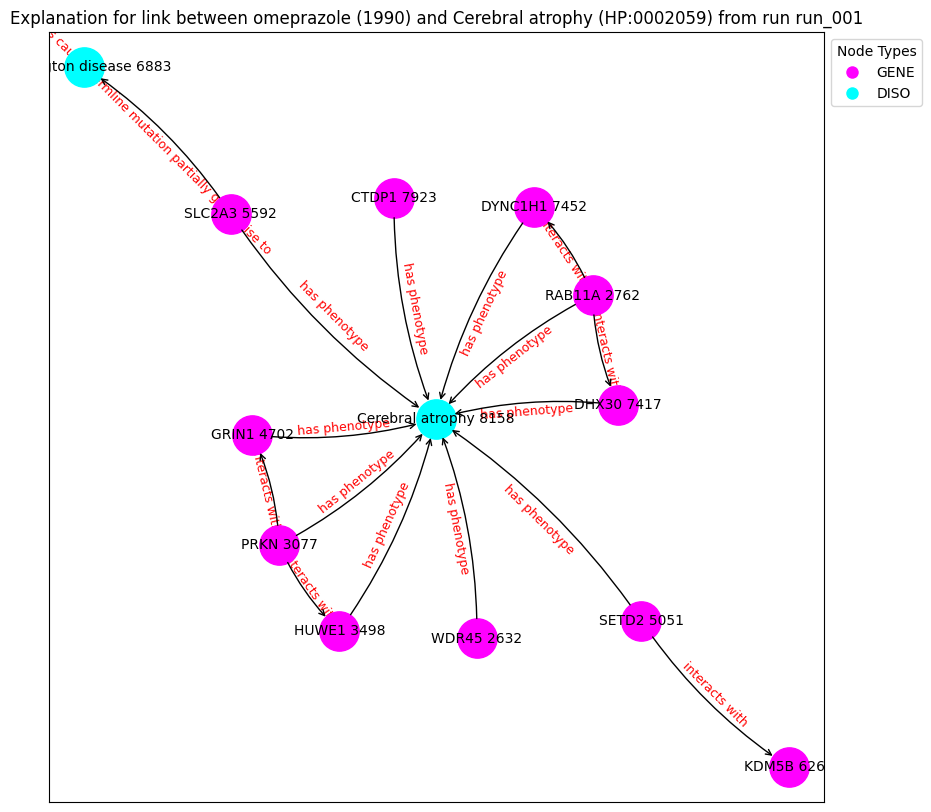

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('Cerebral atrophy 8158', {'type': 'DISO'})
('WDR45 2632', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('HUWE1 3498', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('GRIN1 4702', 'Cerebral atrophy 8158'

Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 179.37it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5841], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.06it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5841], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.71it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5841], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 185.15it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5841], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.72it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5841], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.67it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5841], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.75it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5841], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.08it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5841], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.55it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5841], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.16it/s]


Contribution threshold is tensor(0.0062)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


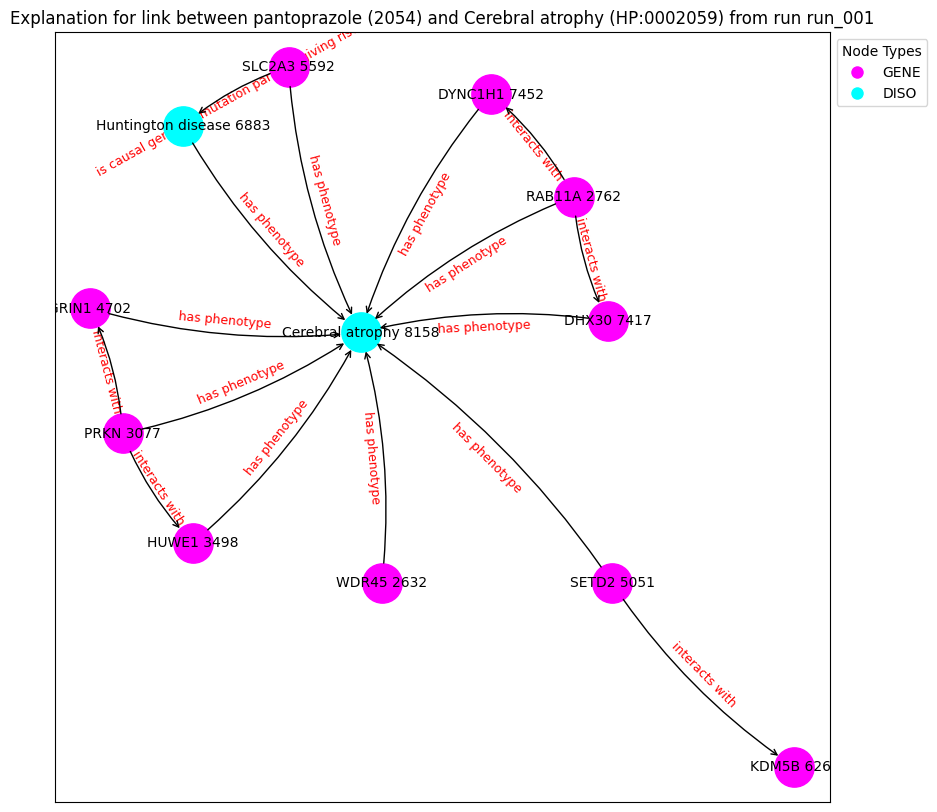

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('Cerebral atrophy 8158', {'type': 'DISO'})
('WDR45 2632', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('HUWE1 3498', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('GRIN1 4702', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('S

Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 169.33it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8538], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 171.74it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8538], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:03<00:00, 175.89it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8538], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 172.80it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.8538], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 173.86it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8538], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 174.11it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8538], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 173.38it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8538], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:03<00:00, 175.43it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.8538], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 172.03it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.8538], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.35it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


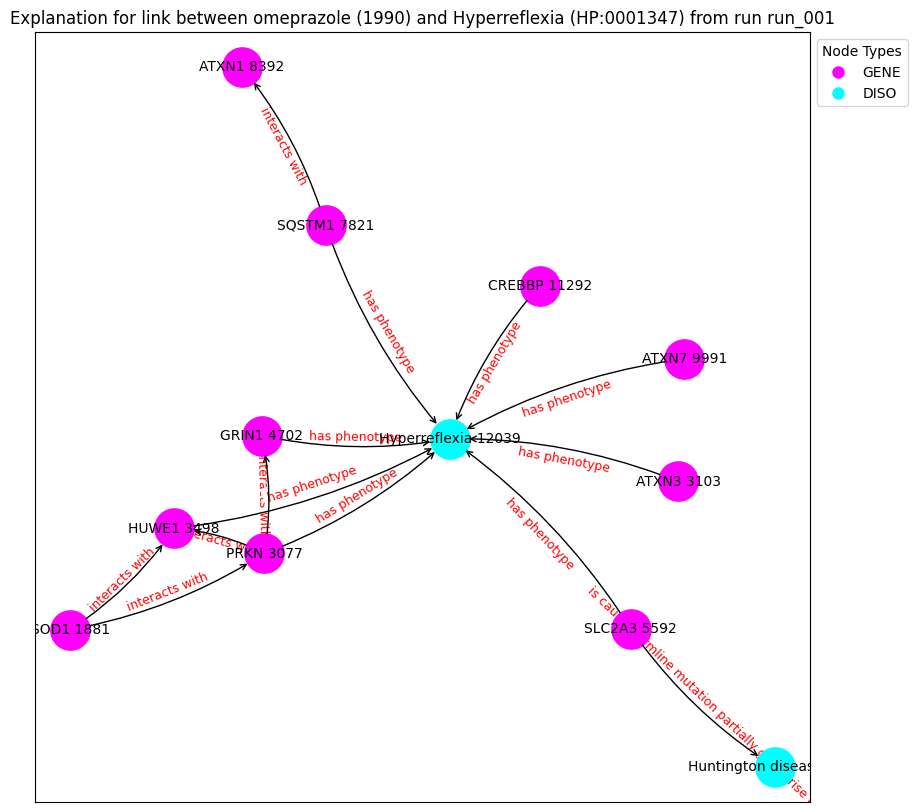

('SOD1 1881', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('CREBBP 11292', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('SOD1 1881', 'HUWE1 3498', {'label': 'interacts with'})
('SOD1 1881', 'PRKN 3077', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('ATXN3 3103', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('HUWE1 3498', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('GRIN1 4702', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partiall

Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 166.83it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4802], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 170.64it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4802], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 161.80it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4802], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 174.66it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.4802], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 173.24it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4802], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 173.08it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4802], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 172.39it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4802], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:03<00:00, 175.83it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4802], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 164.08it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4802], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 169.64it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


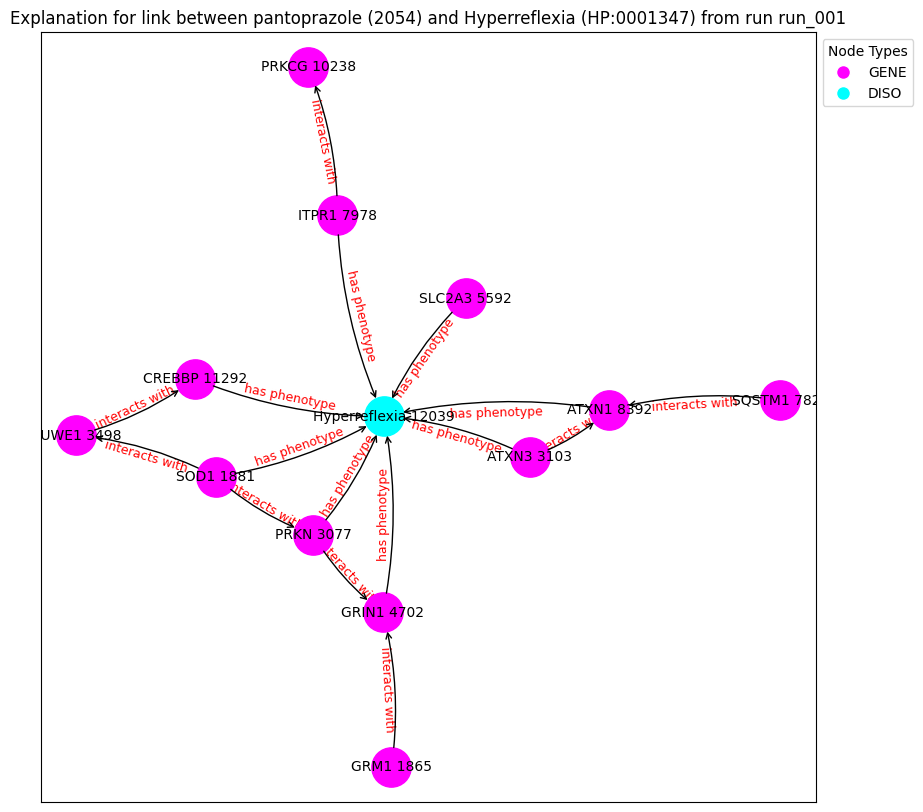

('GRM1 1865', {'type': 'GENE'})
('SOD1 1881', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('ITPR1 7978', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('CREBBP 11292', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('SOD1 1881', 'HUWE1 3498', {'label': 'interacts with'})
('SOD1 1881', 'PRKN 3077', {'label': 'interacts with'})
('SOD1 1881', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('PRKN 3077', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('ATXN3 3103', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('ATXN3 3103', 'ATXN1 8392', {'label': 'interacts with'})
('HUWE1 3498', 'CREBBP 11292', {'label': 'interacts with'})
('GRIN1 4702', 'Hyp

Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 165.56it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2521], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 163.79it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2521], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 171.59it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2521], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 168.75it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2521], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 174.80it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2521], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 164.40it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.2521], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 167.34it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2521], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 170.32it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.2521], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 172.93it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2521], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 173.65it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


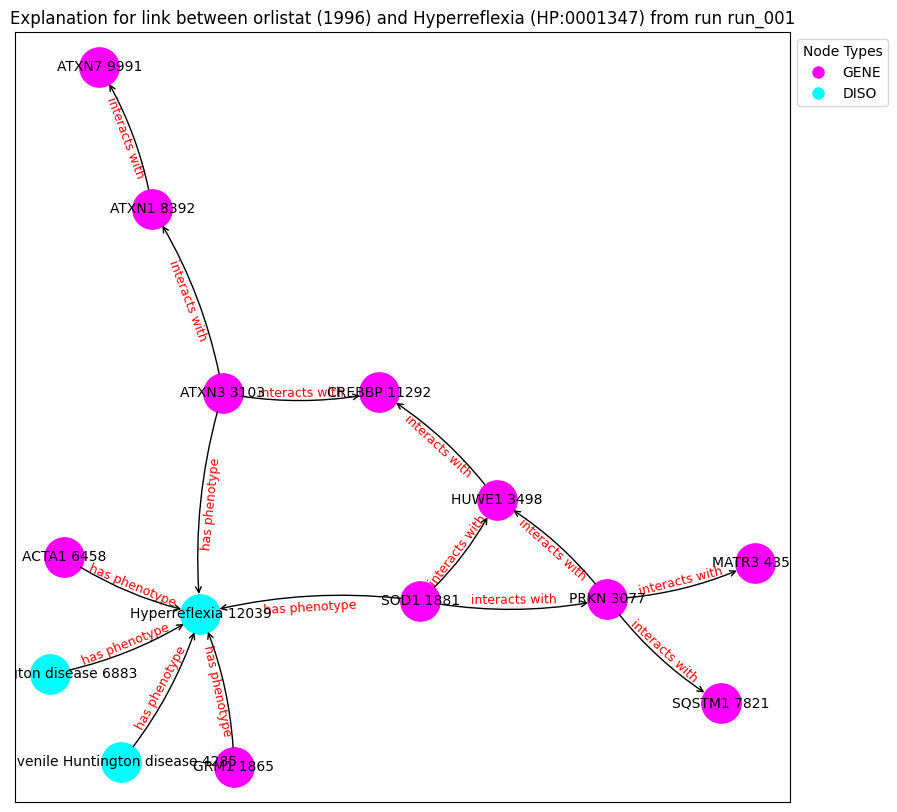

('GRM1 1865', {'type': 'GENE'})
('SOD1 1881', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('MATR3 4359', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('CREBBP 11292', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('GRM1 1865', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('SOD1 1881', 'HUWE1 3498', {'label': 'interacts with'})
('SOD1 1881', 'PRKN 3077', {'label': 'interacts with'})
('SOD1 1881', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'MATR3 4359', {'label': 'interacts with'})
('PRKN 3077', 'SQSTM1 7821', {'label': 'interacts with'})
('ATXN3 3103', 'CREBBP 11292', {'label': 'interacts with'})
('ATXN3 3103', 'Hyp

Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 183.59it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.8798], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.49it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.8798], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.14it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.8798], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.28it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.8798], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 178.57it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.8798], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.42it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.8798], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.23it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.8798], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.27it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.8798], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.85it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.8798], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.22it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


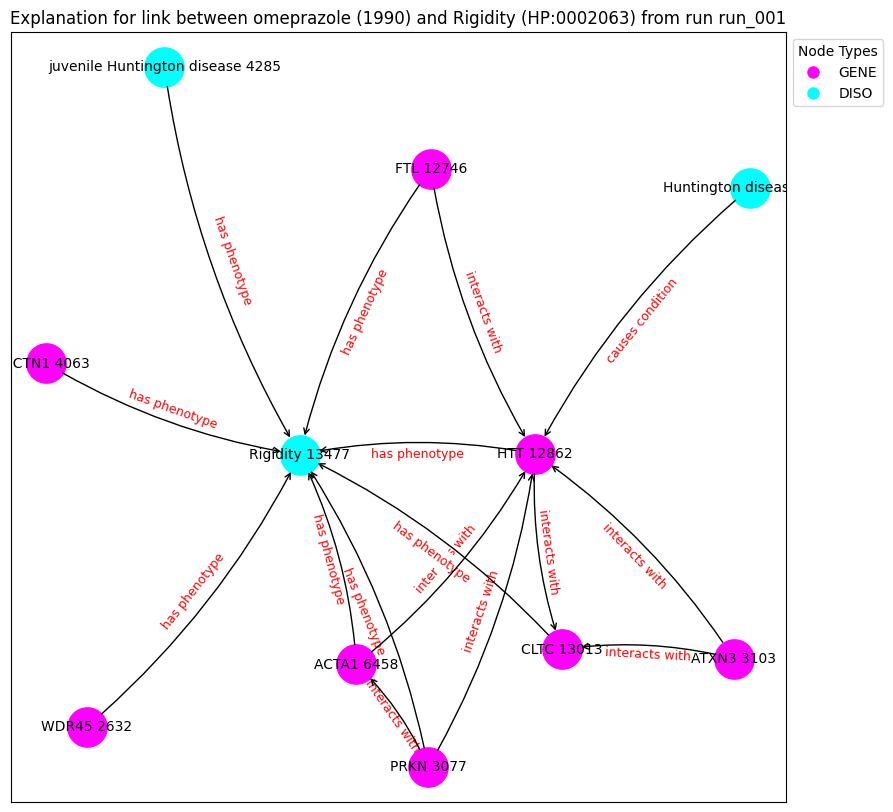

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Rigidity 13477', {'type': 'DISO'})
('WDR45 2632', 'Rigidity 13477', {'label': 'has phenotype'})
('PRKN 3077', 'HTT 12862', {'label': 'interacts with'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'Rigidity 13477', {'label': 'has phenotype'})
('ATXN3 3103', 'HTT 12862', {'label': 'interacts with'})
('ATXN3 3103', 'CLTC 13013', {'label': 'interacts with'})
('DCTN1 4063', 'Rigidity 13477', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'Rigidity 13477', {'label': 'has phenotype'})
('ACTA1 6458', 'HTT 12862', {'label': 'interacts with'})
('ACTA1 6458', 'Rigidity 13477', {'label': 'has phe

Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 183.90it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.5851], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 184.38it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5851], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.71it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5851], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.19it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.5851], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.80it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.5851], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 175.08it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.5851], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.78it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.5851], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.95it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.5851], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.62it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5851], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.54it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


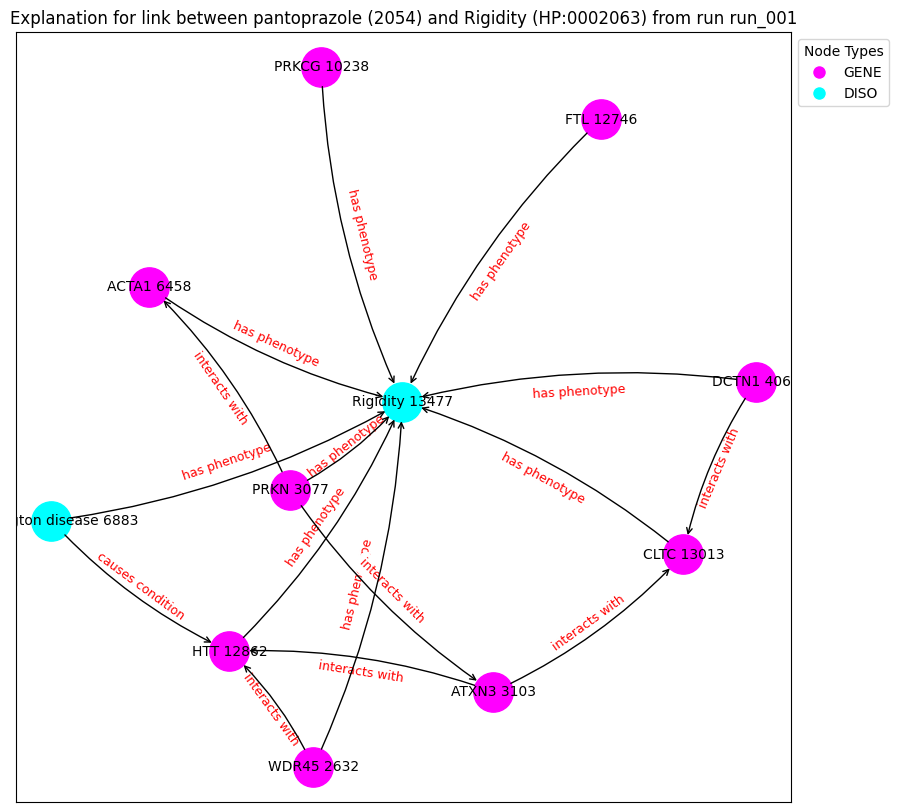

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('PRKCG 10238', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Rigidity 13477', {'type': 'DISO'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('WDR45 2632', 'Rigidity 13477', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'Rigidity 13477', {'label': 'has phenotype'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'HTT 12862', {'label': 'interacts with'})
('ATXN3 3103', 'CLTC 13013', {'label': 'interacts with'})
('DCTN1 4063', 'CLTC 13013', {'label': 'interacts with'})
('DCTN1 4063', 'Rigidity 13477', {'label': 'has phenotype'})
('ACTA1 6458', 'Rigidity 13477', {'label': 'has phenotype'})
('Huntington disease 6883', 'HTT 12

Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 233.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 216.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 250.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 240.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 232.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 250.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 251.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 232.09it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                      label  \
434       434  HP:0002500     DISO  Abnormal cerebral white matter morphology   

     semantic_id  
434            1  
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 238.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 236.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 235.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 246.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 242.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 254.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 248.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 244.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:03<00:00, 222.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 248.43it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
13783     13783  HP:0031843     DISO  Bradyphrenia            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.2873], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 216.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2873], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2873], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2873], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 233.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2873], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 224.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2873], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2873], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2873], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2873], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2873], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.25it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic             label  semantic_id
13592     13592  HP:0001288     DISO  Gait disturbance            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.3969], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 123.93it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3969], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 132.20it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3969], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 123.76it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3969], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 127.03it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3969], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 133.73it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3969], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 127.71it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3969], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 130.48it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3969], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 125.80it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3969], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 129.84it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3969], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 127.24it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


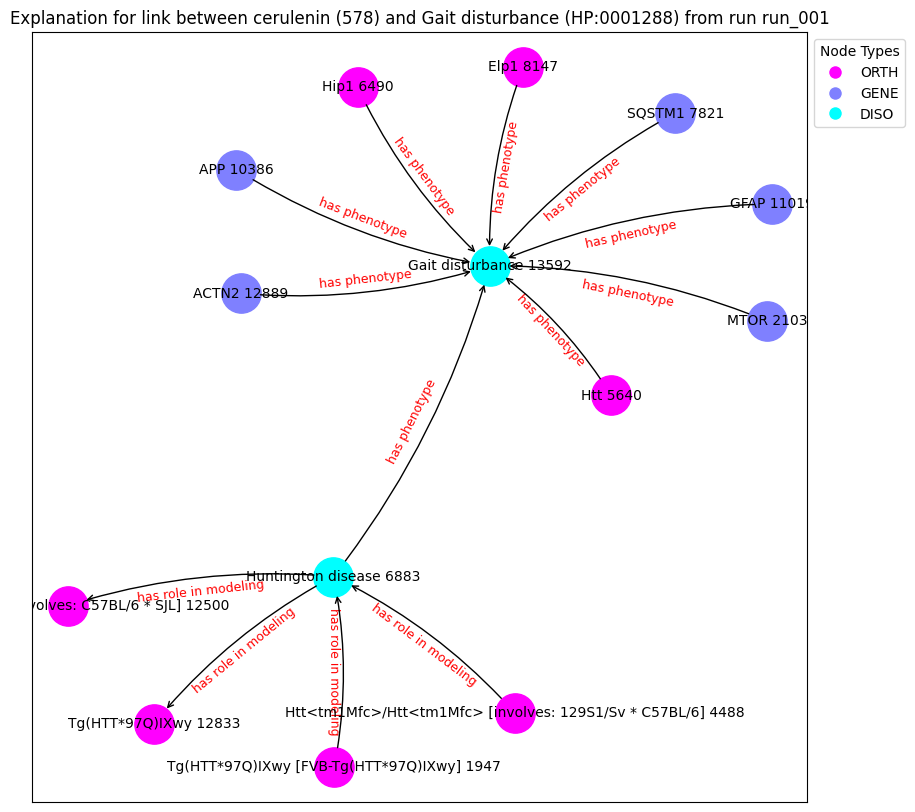

('Tg(HTT*97Q)IXwy [FVB-Tg(HTT*97Q)IXwy] 1947', {'type': 'ORTH'})
('MTOR 2103', {'type': 'GENE'})
('Htt<tm1Mfc>/Htt<tm1Mfc> [involves: 129S1/Sv * C57BL/6] 4488', {'type': 'ORTH'})
('Htt 5640', {'type': 'ORTH'})
('Hip1 6490', {'type': 'ORTH'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('Elp1 8147', {'type': 'ORTH'})
('APP 10386', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('Tg(HD)63Aron [involves: C57BL/6 * SJL] 12500', {'type': 'ORTH'})
('Tg(HTT*97Q)IXwy 12833', {'type': 'ORTH'})
('ACTN2 12889', {'type': 'GENE'})
('Gait disturbance 13592', {'type': 'DISO'})
('Tg(HTT*97Q)IXwy [FVB-Tg(HTT*97Q)IXwy] 1947', 'Huntington disease 6883', {'label': 'has role in modeling'})
('MTOR 2103', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Htt<tm1Mfc>/Htt<tm1Mfc> [involves: 129S1/Sv * C57BL/6] 4488', 'Huntington disease 6883', {'label': 'has role in modeling'})
('Htt 5640', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Hip1 6490', 'Gait d

Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 119.54it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5554], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 125.91it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5554], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 130.06it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5554], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 130.46it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5554], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 127.29it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5554], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 130.57it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5554], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 129.23it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5554], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 128.78it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5554], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 129.91it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5554], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 130.76it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


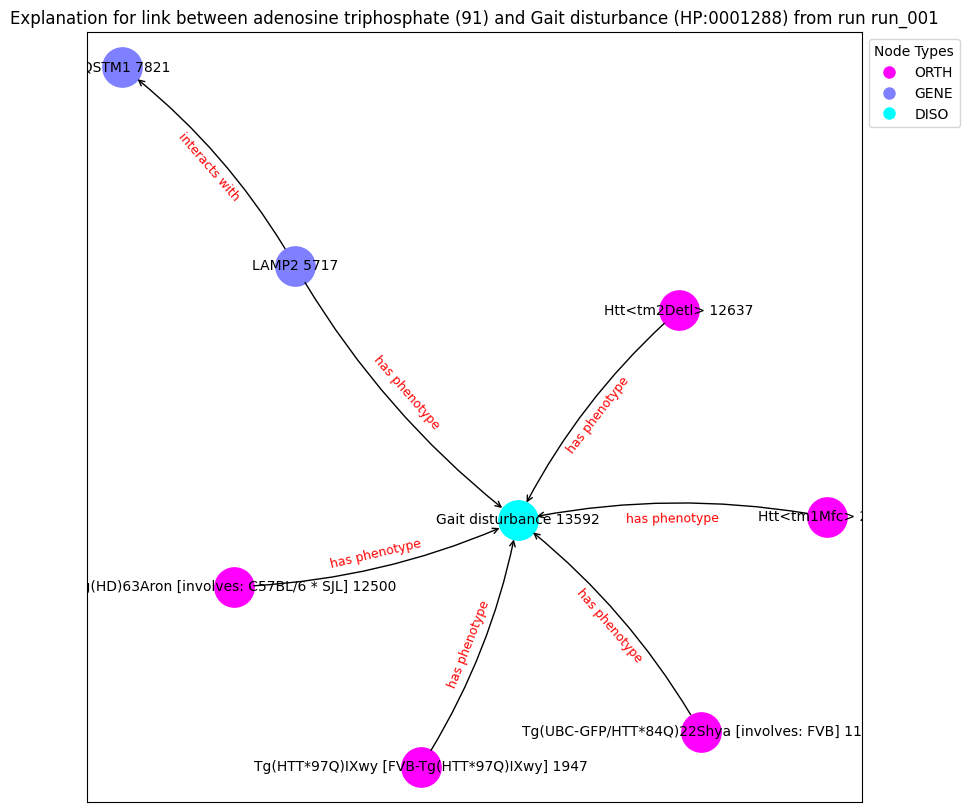

('Tg(UBC-GFP/HTT*84Q)22Shya [involves: FVB] 1121', {'type': 'ORTH'})
('Tg(HTT*97Q)IXwy [FVB-Tg(HTT*97Q)IXwy] 1947', {'type': 'ORTH'})
('Htt<tm1Mfc> 2128', {'type': 'ORTH'})
('LAMP2 5717', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('Tg(HD)63Aron [involves: C57BL/6 * SJL] 12500', {'type': 'ORTH'})
('Htt<tm2Detl> 12637', {'type': 'ORTH'})
('Gait disturbance 13592', {'type': 'DISO'})
('Tg(UBC-GFP/HTT*84Q)22Shya [involves: FVB] 1121', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Tg(HTT*97Q)IXwy [FVB-Tg(HTT*97Q)IXwy] 1947', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Htt<tm1Mfc> 2128', 'Gait disturbance 13592', {'label': 'has phenotype'})
('LAMP2 5717', 'SQSTM1 7821', {'label': 'interacts with'})
('LAMP2 5717', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Tg(HD)63Aron [involves: C57BL/6 * SJL] 12500', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Htt<tm2Detl> 12637', 'Gait disturbance 13592', {'label': 'has phenotype'})
Explanation graph 

Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:03<00:00, 232.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8888], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:03<00:00, 207.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8888], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 254.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8888], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 241.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8888], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8888], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 248.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8888], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 250.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8888], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8888], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8888], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.22it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\run_002
(0, {'node_feature': tensor([ 0.6534,  0.2869,  0.5678,  0.2438,  0.1743, -0.0714, -0.2233, -0.2793,
        -0.2677, -0.9234,  0.4162, -0.7531,  0.4714, -1.0980,  0.1894,  0.9905,
        -0.3054,  0.5982, -1.0458,  0.0240, -0.1289,  0.6568, -0.7097,  0.0460,
        -0.5496,  1.0396,  0.0995, -0.5989,  0.2985,  0.0546,  0.4277, -0.0735])})
(0, 11953, {'edge_label': 'in orthology relationship with'})
Number of edges is 134749
Number of nodes is 14833
node1:
       index_id          id semantic       label  semantic_id
13668     13668  HP:0000716     DISO  Depression            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.3569], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 121.15it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3569], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:06<00:00, 104.91it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3569], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 120.87it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3569], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 129.95it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3569], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 135.69it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3569], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 143.24it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3569], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 128.30it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3569], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 138.12it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3569], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 136.08it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3569], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 138.74it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


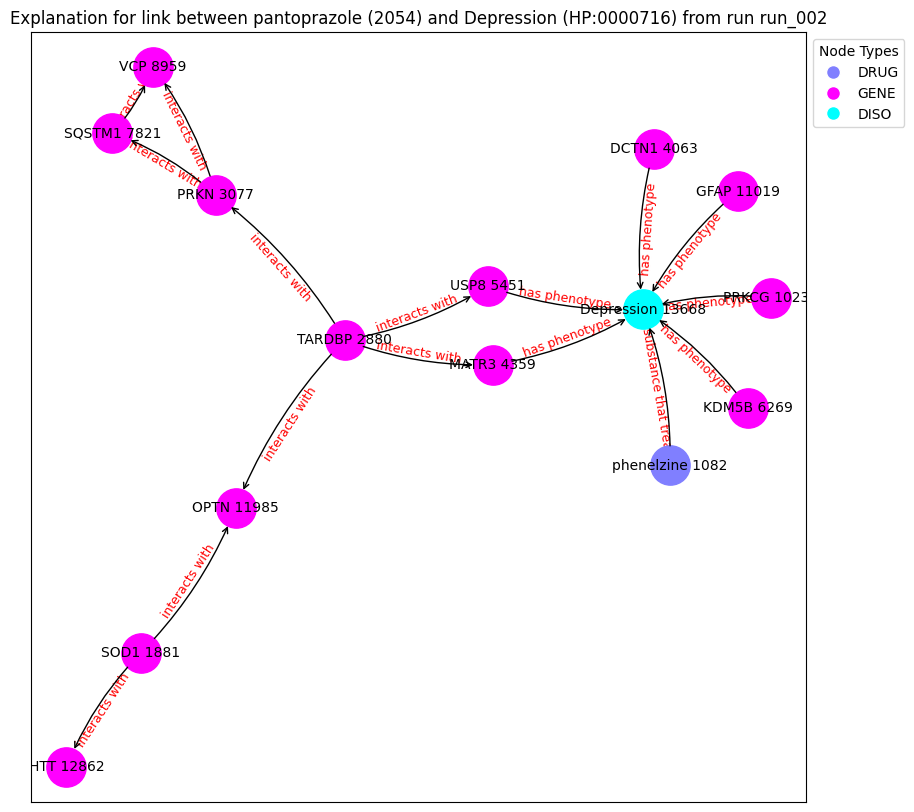

('phenelzine 1082', {'type': 'DRUG'})
('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('MATR3 4359', {'type': 'GENE'})
('USP8 5451', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('phenelzine 1082', 'Depression 13668', {'label': 'is substance that treats'})
('SOD1 1881', 'HTT 12862', {'label': 'interacts with'})
('SOD1 1881', 'OPTN 11985', {'label': 'interacts with'})
('TARDBP 2880', 'PRKN 3077', {'label': 'interacts with'})
('TARDBP 2880', 'USP8 5451', {'label': 'interacts with'})
('TARDBP 2880', 'MATR3 4359', {'label': 'interacts with'})
('TARDBP 2880', 'OPTN 11985', {'label': 'interacts with'})
('PRKN 3077', 'VCP 8959', {'label': 'interacts with'})
('PRKN 3077', 'S

Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:05<00:00, 127.65it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6230], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:05<00:00, 135.16it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6230], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:05<00:00, 139.71it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6230], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 153.17it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6230], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 152.46it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6230], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.13it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6230], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 166.62it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6230], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 166.95it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6230], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 167.67it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6230], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 168.34it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


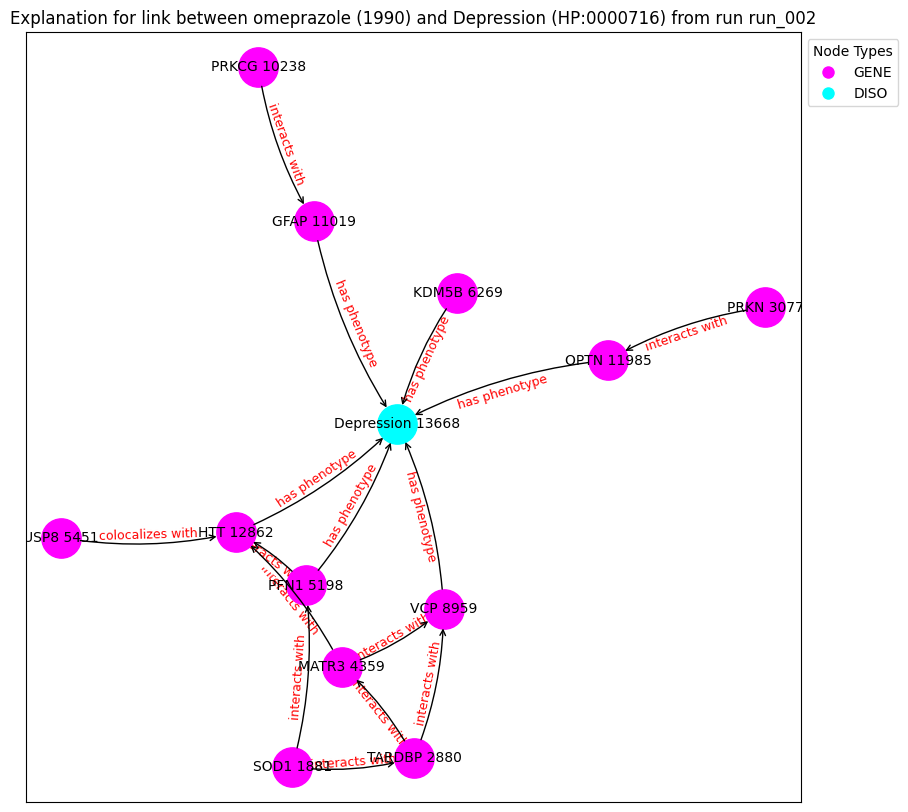

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('MATR3 4359', {'type': 'GENE'})
('PFN1 5198', {'type': 'GENE'})
('USP8 5451', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('SOD1 1881', 'PFN1 5198', {'label': 'interacts with'})
('SOD1 1881', 'TARDBP 2880', {'label': 'interacts with'})
('TARDBP 2880', 'MATR3 4359', {'label': 'interacts with'})
('TARDBP 2880', 'VCP 8959', {'label': 'interacts with'})
('PRKN 3077', 'OPTN 11985', {'label': 'interacts with'})
('MATR3 4359', 'HTT 12862', {'label': 'interacts with'})
('MATR3 4359', 'VCP 8959', {'label': 'interacts with'})
('PFN1 5198', 'HTT 12862', {'label': 'interacts with'})
('PFN1 5198', 'Depression 13668', {'label': 'has phenotype'})
('USP8 5451', 'HTT 12862', {'label': 'colocalizes wi

Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 159.96it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5232], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 164.95it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5232], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 160.12it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5232], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 167.07it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5232], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 169.75it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5232], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 165.75it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5232], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 170.33it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5232], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 164.58it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5232], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 167.17it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5232], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 168.40it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


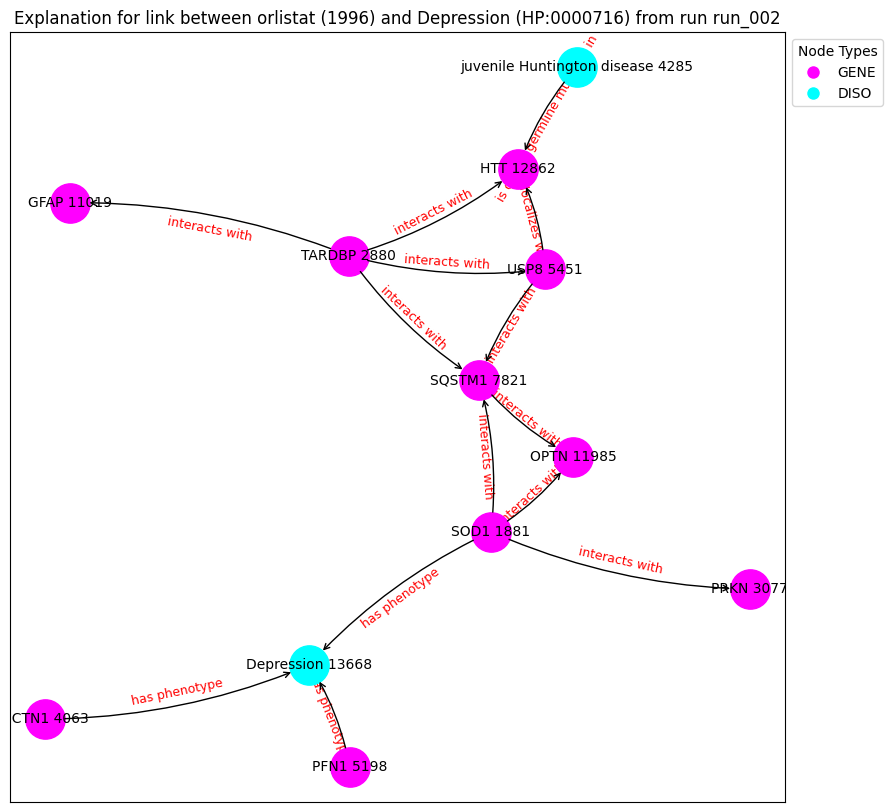

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('PFN1 5198', {'type': 'GENE'})
('USP8 5451', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('SOD1 1881', 'PRKN 3077', {'label': 'interacts with'})
('SOD1 1881', 'SQSTM1 7821', {'label': 'interacts with'})
('SOD1 1881', 'OPTN 11985', {'label': 'interacts with'})
('SOD1 1881', 'Depression 13668', {'label': 'has phenotype'})
('TARDBP 2880', 'SQSTM1 7821', {'label': 'interacts with'})
('TARDBP 2880', 'HTT 12862', {'label': 'interacts with'})
('TARDBP 2880', 'GFAP 11019', {'label': 'interacts with'})
('TARDBP 2880', 'USP8 5451', {'label': 'interacts with'})
('DCTN1 4063', 'Depression 13668', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'HTT 12862'

Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 210.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 229.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 217.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:04<00:00, 171.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:04<00:00, 149.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:04<00:00, 170.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 188.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 191.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 209.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 218.32it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic     label  semantic_id
12933     12933  HP:0001332     DISO  Dystonia            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.3890], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 147.81it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3890], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 146.13it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3890], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 141.90it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3890], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 149.24it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3890], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 145.84it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3890], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 149.50it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3890], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 145.43it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3890], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 151.83it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3890], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 154.85it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3890], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 152.06it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


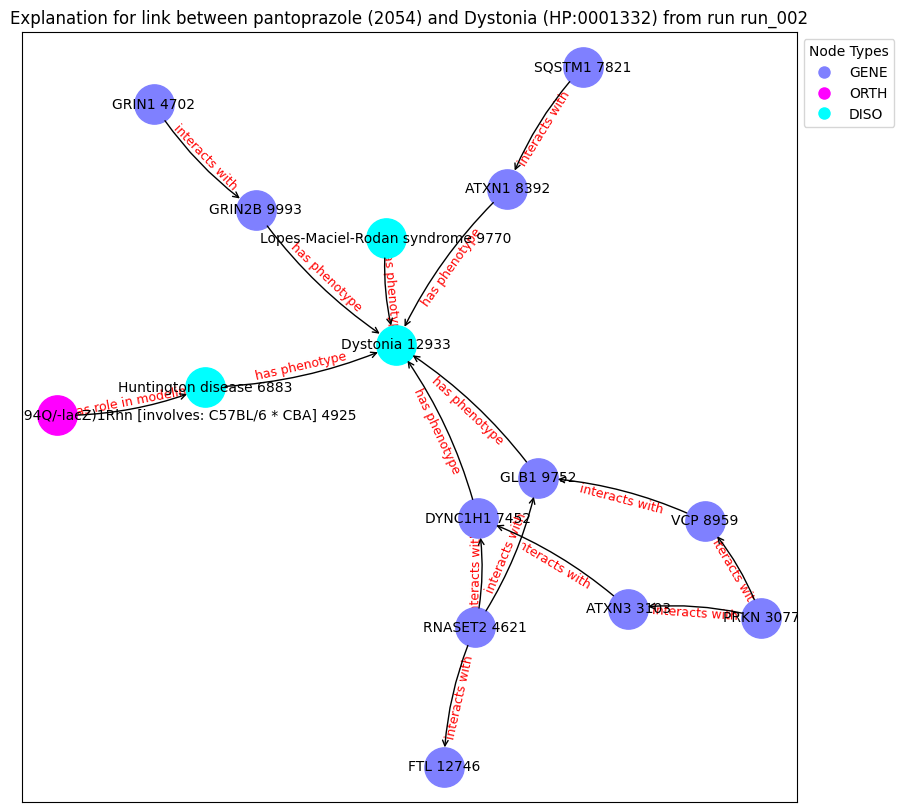

('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('RNASET2 4621', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('Tg(Camk2a-tTA)1Mmay; Tg(tetO-HTT*94Q/-lacZ)1Rhn [involves: C57BL/6 * CBA] 4925', {'type': 'ORTH'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('GLB1 9752', {'type': 'GENE'})
('Lopes-Maciel-Rodan syndrome 9770', {'type': 'DISO'})
('GRIN2B 9993', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('Dystonia 12933', {'type': 'DISO'})
('PRKN 3077', 'VCP 8959', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'DYNC1H1 7452', {'label': 'interacts with'})
('RNASET2 4621', 'DYNC1H1 7452', {'label': 'interacts with'})
('RNASET2 4621', 'GLB1 9752', {'label': 'interacts with'})
('RNASET2 4621', 'FTL 12746', {'label': 'interacts with'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'inte

Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 147.13it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.7127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 152.41it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 152.12it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 152.36it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 150.83it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 150.86it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 152.36it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.7127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 151.47it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 150.93it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.7127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 150.47it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


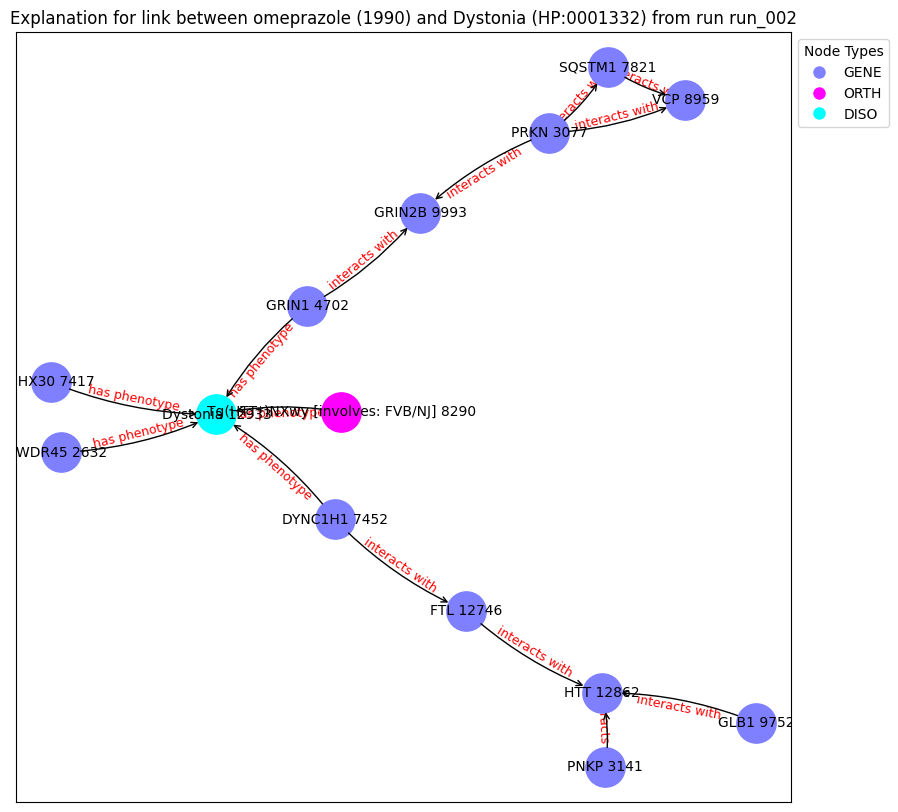

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('Tg(HTT*)NXwy [involves: FVB/NJ] 8290', {'type': 'ORTH'})
('VCP 8959', {'type': 'GENE'})
('GLB1 9752', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Dystonia 12933', {'type': 'DISO'})
('WDR45 2632', 'Dystonia 12933', {'label': 'has phenotype'})
('PRKN 3077', 'GRIN2B 9993', {'label': 'interacts with'})
('PRKN 3077', 'VCP 8959', {'label': 'interacts with'})
('PRKN 3077', 'SQSTM1 7821', {'label': 'interacts with'})
('PNKP 3141', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'Dystonia 12933', {'label': 'has phenotype'})
('DHX30 7417', 'Dystonia 12933', {'label': 'has phenotype'})
('DYNC1H1 7452', 'FTL 12746', {'label': 'i

Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 145.18it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.1785], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:05<00:00, 136.46it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1785], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 151.16it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1785], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 147.70it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.1785], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 142.72it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1785], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 152.24it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.1785], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 153.05it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.1785], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 151.97it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1785], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 150.80it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1785], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 142.14it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


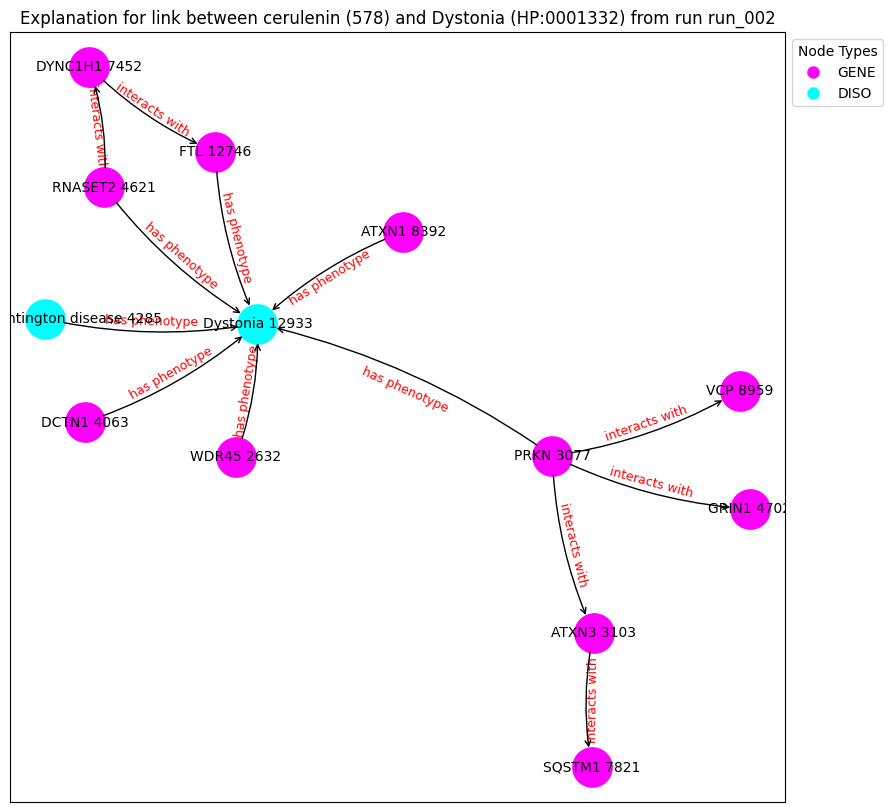

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('RNASET2 4621', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('Dystonia 12933', {'type': 'DISO'})
('WDR45 2632', 'Dystonia 12933', {'label': 'has phenotype'})
('PRKN 3077', 'VCP 8959', {'label': 'interacts with'})
('PRKN 3077', 'Dystonia 12933', {'label': 'has phenotype'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'SQSTM1 7821', {'label': 'interacts with'})
('DCTN1 4063', 'Dystonia 12933', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'Dystonia 12933', {'label': 'has phenotype'})
('RNASET2 4621', 'DYNC1H1 7452', {'label': 'interac

Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 250.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 243.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 244.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 256.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 240.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 218.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 250.79it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic            label  semantic_id
14311     14311  HP:0031845     DISO  Abnormal libido            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.3180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 219.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 211.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 211.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 219.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 201.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 229.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.40it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.5438], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5438], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 211.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5438], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5438], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 232.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5438], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 213.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5438], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 229.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5438], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 227.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5438], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:02<00:00, 235.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5438], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 231.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5438], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 232.18it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.1378], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1378], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 200.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1378], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1378], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 198.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1378], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1378], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 213.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1378], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:02<00:00, 237.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1378], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 232.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1378], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 230.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1378], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 230.92it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.3968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 209.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 229.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 229.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.08it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.6149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 206.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 202.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 209.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 208.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 199.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 207.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 202.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 202.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 206.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 210.50it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.1780], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 207.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1780], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 206.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1780], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 206.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1780], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1780], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 202.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1780], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 206.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1780], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 212.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1780], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 201.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1780], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 207.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1780], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 203.26it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.4790], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4790], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4790], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 197.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4790], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 204.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4790], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 207.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4790], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 210.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4790], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 207.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4790], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 209.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4790], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4790], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.57it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
6473      6473  HP:0001272     DISO  Cerebellar atrophy            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.2222], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 198.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2222], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 185.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2222], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 200.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2222], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2222], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 196.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2222], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 204.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2222], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 198.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2222], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 200.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2222], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 201.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2222], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 200.45it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
6473      6473  HP:0001272     DISO  Cerebellar atrophy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.4180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 200.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 204.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 200.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 199.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.18it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
4670      4670  HP:0031589     DISO  Suicidal ideation            1
node2:
      index_id    id semantic             label  semantic_id
2023      2023  4226     DRUG  ingenol mebutate            2
Prediction from trained model: tensor([0.0035], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 231.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0035], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:02<00:00, 237.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0035], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:02<00:00, 245.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0035], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:02<00:00, 241.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0035], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:02<00:00, 235.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0035], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 231.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0035], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:02<00:00, 237.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0035], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:02<00:00, 241.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0035], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 213.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0035], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:02<00:00, 239.27it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
4670      4670  HP:0031589     DISO  Suicidal ideation            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.0342], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0342], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0342], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0342], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:02<00:00, 251.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0342], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0342], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0342], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0342], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:02<00:00, 233.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0342], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 218.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0342], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 232.61it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic        label  semantic_id
2028      2028  HP:0002066     DISO  Gait ataxia            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.6685], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:02<00:00, 236.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6685], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 231.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6685], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 232.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6685], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:02<00:00, 233.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6685], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:02<00:00, 236.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6685], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 232.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6685], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 228.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6685], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 220.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6685], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 227.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6685], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 231.16it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic        label  semantic_id
2028      2028  HP:0002066     DISO  Gait ataxia            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.9101], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9101], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9101], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 229.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9101], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9101], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:04<00:00, 174.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9101], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 214.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9101], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9101], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9101], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9101], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 231.57it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                 label  semantic_id
10550     10550  HP:0001268     DISO  Mental deterioration            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.3165], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 212.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3165], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 212.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3165], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 214.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3165], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 211.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3165], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 206.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3165], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 209.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3165], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 198.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3165], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 214.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3165], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 203.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3165], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 211.67it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
6571      6571  HP:0031473     DISO  Hostility            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.5807], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 229.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5807], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:02<00:00, 235.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5807], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5807], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5807], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5807], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 216.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5807], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5807], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5807], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:02<00:00, 237.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5807], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.67it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic             label  semantic_id
9177      9177  HP:0030842     DISO  Choking episodes            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.3340], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3340], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3340], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 232.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3340], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:02<00:00, 233.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3340], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3340], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 220.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3340], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3340], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3340], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3340], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 217.75it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic         label  semantic_id
7072      7072  HP:0002067     DISO  Bradykinesia            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.1489], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 188.42it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1489], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 190.07it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1489], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 191.95it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.1489], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 193.11it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1489], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 185.89it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1489], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 190.84it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1489], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 194.70it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.1489], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 200.07it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1489], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 196.20it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.1489], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 194.27it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


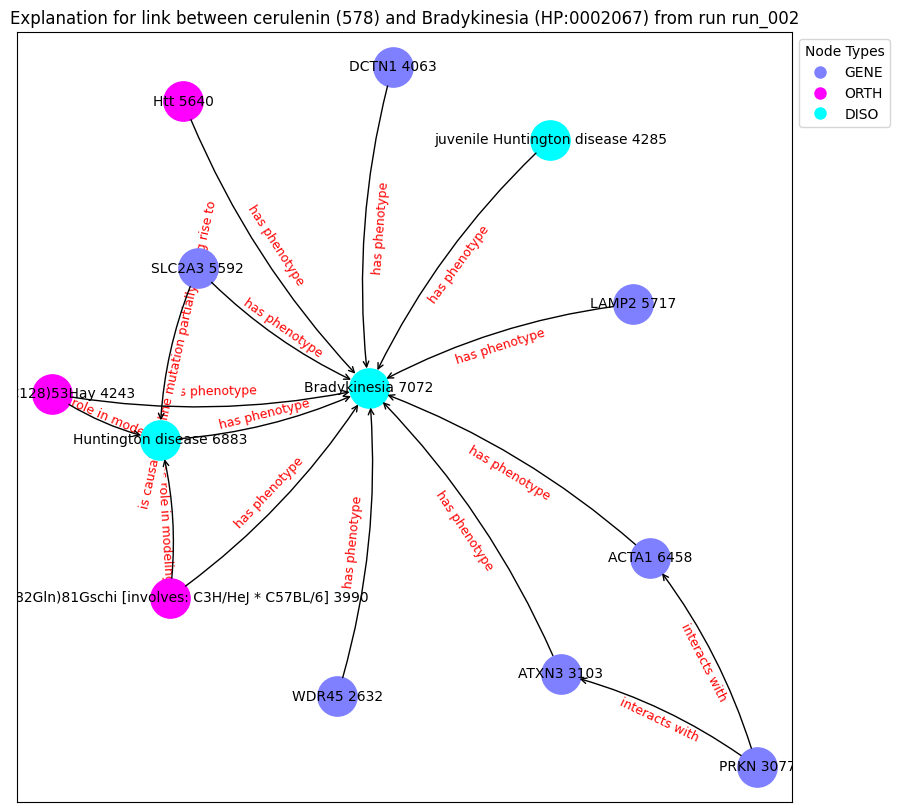

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', {'type': 'ORTH'})
('DCTN1 4063', {'type': 'GENE'})
('Tg(YAC128)53Hay 4243', {'type': 'ORTH'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('LAMP2 5717', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('Bradykinesia 7072', {'type': 'DISO'})
('WDR45 2632', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'Bradykinesia 7072', {'label': 'has phenotype'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Huntington disease 6883', {'label': 'has role in modeling'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Bradykinesia 7072', {'label': 'has phenotype'})
('DCTN1 4

Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.26it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.1666], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.57it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1666], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.03it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.1666], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.84it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1666], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.87it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.1666], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.62it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.1666], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.84it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.1666], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.15it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1666], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.53it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.1666], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.04it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


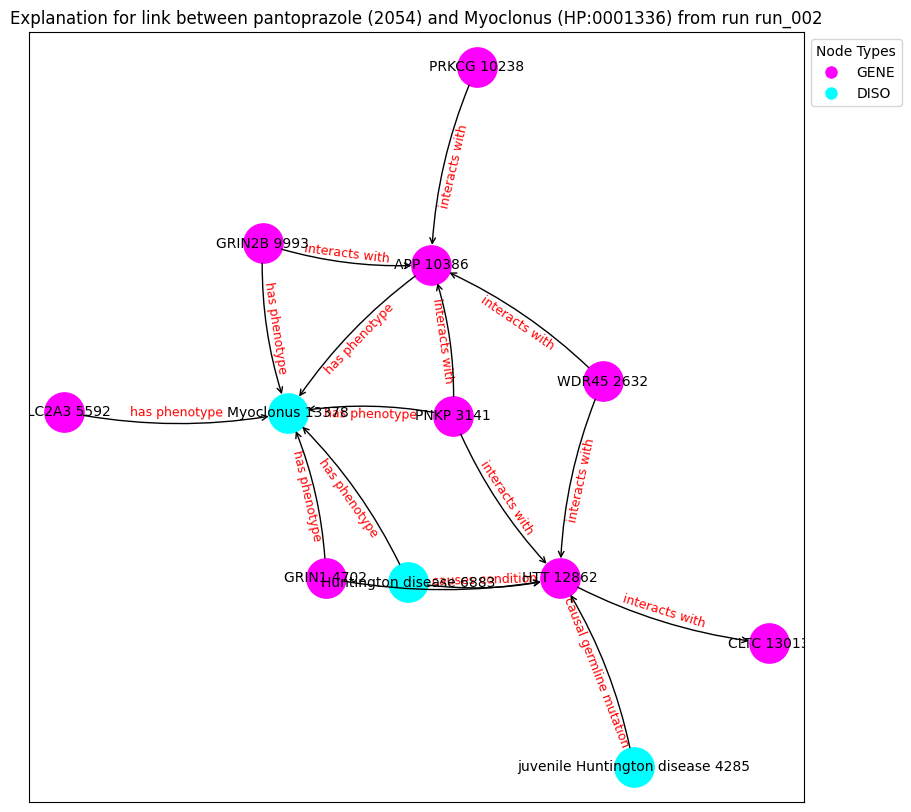

('WDR45 2632', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('GRIN2B 9993', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('APP 10386', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Myoclonus 13378', {'type': 'DISO'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('WDR45 2632', 'APP 10386', {'label': 'interacts with'})
('PNKP 3141', 'HTT 12862', {'label': 'interacts with'})
('PNKP 3141', 'APP 10386', {'label': 'interacts with'})
('PNKP 3141', 'Myoclonus 13378', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is causal germline mutation in'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'Myoclonus 13378', {'label': 'has phenotype'})
('SLC2A3 5592', 'Myoclonus 13378', {'label': 'has phenotype'})


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 182.67it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.3357], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.52it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.3357], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.59it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.3357], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.11it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.3357], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.14it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.3357], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.90it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.3357], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.47it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.3357], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.43it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.3357], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.02it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.3357], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 183.51it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


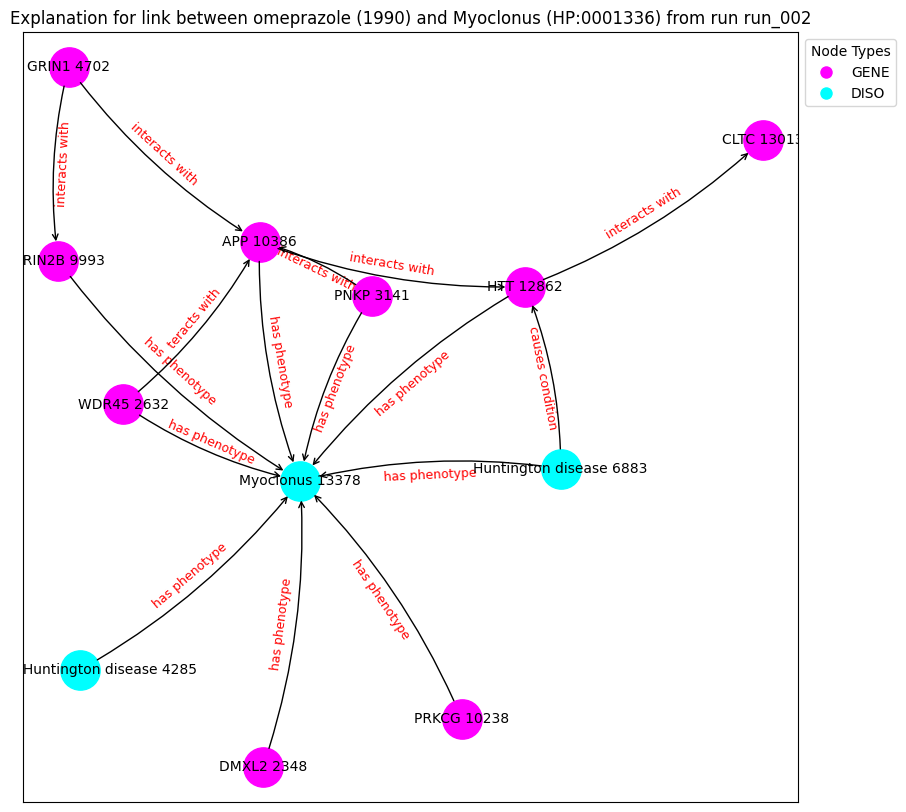

('DMXL2 2348', {'type': 'GENE'})
('WDR45 2632', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('GRIN2B 9993', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('APP 10386', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Myoclonus 13378', {'type': 'DISO'})
('DMXL2 2348', 'Myoclonus 13378', {'label': 'has phenotype'})
('WDR45 2632', 'APP 10386', {'label': 'interacts with'})
('WDR45 2632', 'Myoclonus 13378', {'label': 'has phenotype'})
('PNKP 3141', 'APP 10386', {'label': 'interacts with'})
('PNKP 3141', 'Myoclonus 13378', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'Myoclonus 13378', {'label': 'has phenotype'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'APP 10386', {'label': 'interacts with'})
('Huntington disease 6883', 'HTT 12862', {'label': 'causes conditio

Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 186.67it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1103], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 183.56it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.1103], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 191.50it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1103], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 191.61it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.1103], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 188.61it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.1103], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 192.78it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.1103], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 187.68it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.1103], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 189.26it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.1103], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 186.05it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1103], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 189.59it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


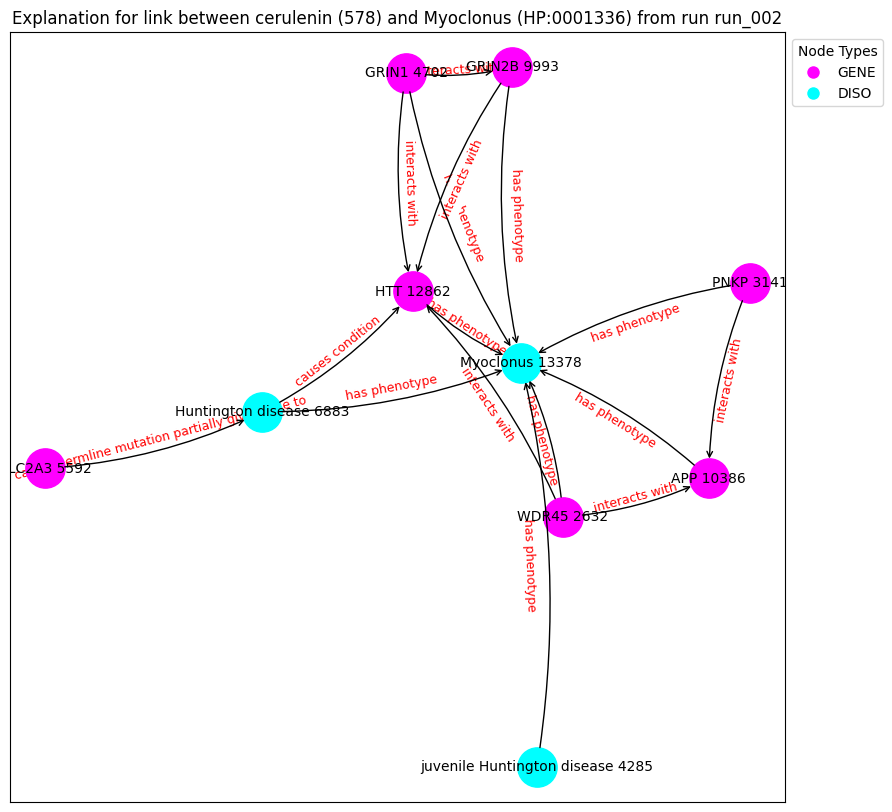

('WDR45 2632', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('GRIN2B 9993', {'type': 'GENE'})
('APP 10386', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Myoclonus 13378', {'type': 'DISO'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('WDR45 2632', 'APP 10386', {'label': 'interacts with'})
('WDR45 2632', 'Myoclonus 13378', {'label': 'has phenotype'})
('PNKP 3141', 'APP 10386', {'label': 'interacts with'})
('PNKP 3141', 'Myoclonus 13378', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'Myoclonus 13378', {'label': 'has phenotype'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'Myoclonus 13378', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mut

Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 201.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3280], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 196.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3280], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 198.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3280], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 199.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3280], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 205.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3280], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 200.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3280], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3280], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 213.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3280], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 212.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3280], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 206.20it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
5935      5935  HP:0000713     DISO  Agitation            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.7115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 204.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 211.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 207.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 197.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 198.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 208.63it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic    label  semantic_id
3363      3363  HP:0002171     DISO  Gliosis            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.0324], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 210.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0324], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 211.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0324], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 207.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0324], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0324], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 203.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0324], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 207.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0324], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0324], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 204.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0324], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0324], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 209.31it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic   label  semantic_id
14731     14731  HP:0002072     DISO  Chorea            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.3053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 174.09it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.3053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 173.51it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:03<00:00, 176.49it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 164.82it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:03<00:00, 179.13it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 174.46it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:03<00:00, 177.55it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:03<00:00, 177.25it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.3053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:03<00:00, 178.23it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:03<00:00, 179.51it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


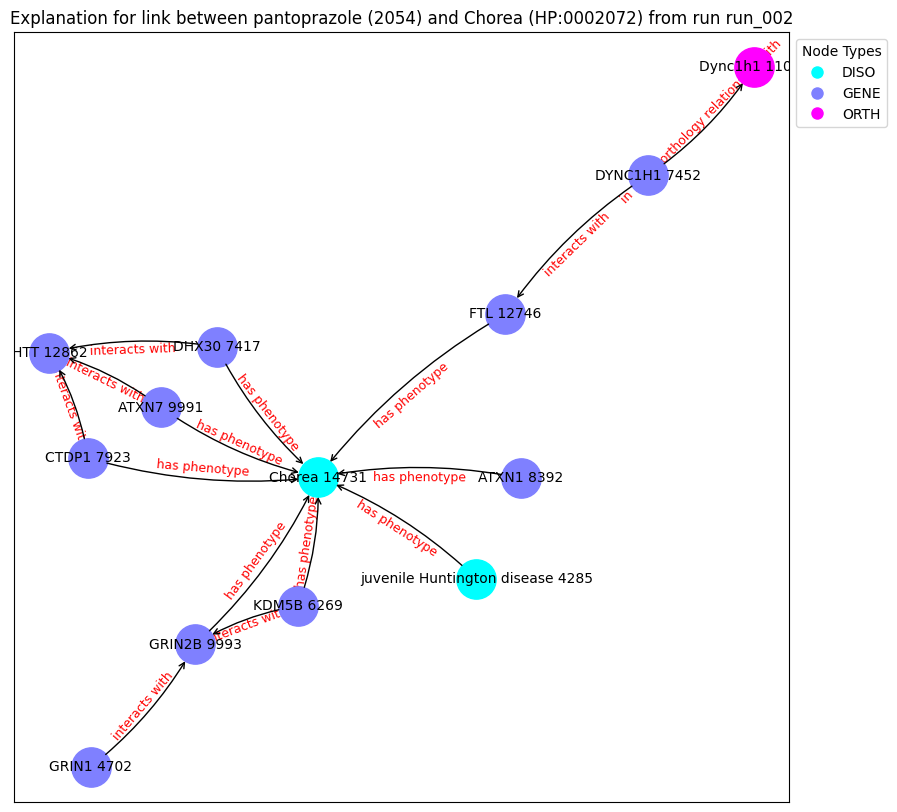

('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('Dync1h1 11054', {'type': 'ORTH'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Chorea 14731', {'type': 'DISO'})
('juvenile Huntington disease 4285', 'Chorea 14731', {'label': 'has phenotype'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('KDM5B 6269', 'GRIN2B 9993', {'label': 'interacts with'})
('KDM5B 6269', 'Chorea 14731', {'label': 'has phenotype'})
('DHX30 7417', 'HTT 12862', {'label': 'interacts with'})
('DHX30 7417', 'Chorea 14731', {'label': 'has phenotype'})
('DYNC1H1 7452', 'Dync1h1 11054', {'label': 'in 1 to 1 orthology relationship with'})
('DYNC1H1 7452', 'FTL 12746', {'label': 'interacts with'})
('CTDP1 7923', 'HTT 1286

Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.99it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.4585], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 158.60it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4585], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:03<00:00, 176.63it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4585], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:03<00:00, 176.43it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4585], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 174.84it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4585], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 173.27it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.4585], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 174.87it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.4585], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:03<00:00, 176.79it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4585], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:03<00:00, 176.44it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4585], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:03<00:00, 178.10it/s]


Contribution threshold is tensor(0.9936)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


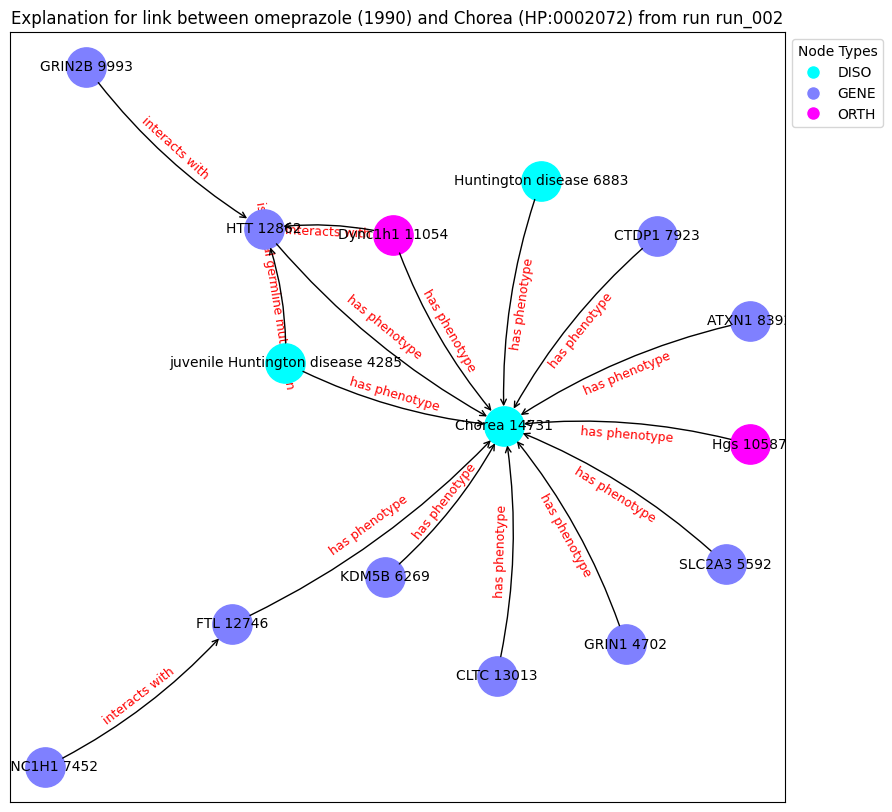

('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('Hgs 10587', {'type': 'ORTH'})
('Dync1h1 11054', {'type': 'ORTH'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Chorea 14731', {'type': 'DISO'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is causal germline mutation in'})
('juvenile Huntington disease 4285', 'Chorea 14731', {'label': 'has phenotype'})
('GRIN1 4702', 'Chorea 14731', {'label': 'has phenotype'})
('SLC2A3 5592', 'Chorea 14731', {'label': 'has phenotype'})
('KDM5B 6269', 'Chorea 14731', {'label': 'has phenotype'})
('Huntington disease 6883', 'Chorea 14731', {'label': 'has phenotype'})
('DYNC1H1 7452', 'FTL 12746', {'label'

Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 238.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 250.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 239.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 243.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 243.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 238.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 257.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 237.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 244.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.92it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic        label  semantic_id
13123     13123  HP:0001824     DISO  Weight loss            1
node2:
      index_id    id semantic           label  semantic_id
2596      2596  5382     DRUG  bempedoic acid            2
Prediction from trained model: tensor([0.1892], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:04<00:00, 140.12it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1892], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 129.27it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.1892], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 136.44it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.1892], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 135.03it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.1892], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:04<00:00, 142.62it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1892], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:04<00:00, 141.54it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.1892], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:04<00:00, 140.70it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1892], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:04<00:00, 142.16it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1892], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:04<00:00, 142.39it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.1892], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:04<00:00, 141.25it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


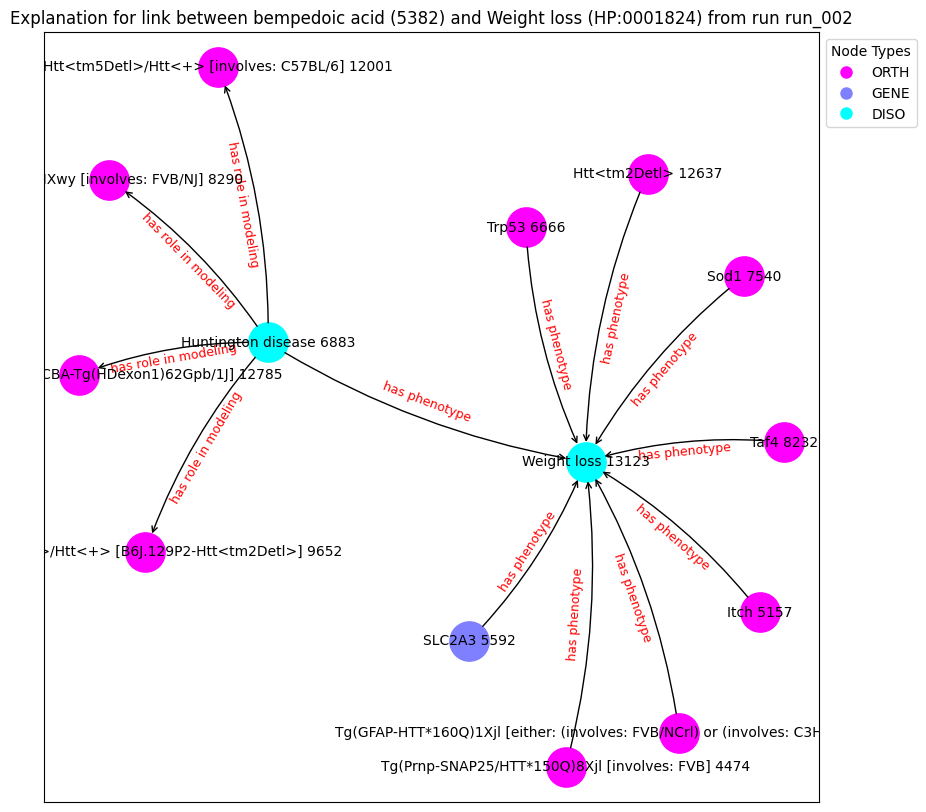

('Tg(Prnp-SNAP25/HTT*150Q)8Xjl [involves: FVB] 4474', {'type': 'ORTH'})
('Tg(GFAP-HTT*160Q)1Xjl [either: (involves: FVB/NCrl) or (involves: C3H * C57BL/6 * FVB/NCrl)] 4958', {'type': 'ORTH'})
('Itch 5157', {'type': 'ORTH'})
('SLC2A3 5592', {'type': 'GENE'})
('Trp53 6666', {'type': 'ORTH'})
('Huntington disease 6883', {'type': 'DISO'})
('Sod1 7540', {'type': 'ORTH'})
('Taf4 8232', {'type': 'ORTH'})
('Tg(HTT*)NXwy [involves: FVB/NJ] 8290', {'type': 'ORTH'})
('Htt<tm2Detl>/Htt<+> [B6J.129P2-Htt<tm2Detl>] 9652', {'type': 'ORTH'})
('Htt<tm5Detl>/Htt<+> [involves: C57BL/6] 12001', {'type': 'ORTH'})
('Htt<tm2Detl> 12637', {'type': 'ORTH'})
('Tg(HDexon1)62Gpb [B6CBA-Tg(HDexon1)62Gpb/1J] 12785', {'type': 'ORTH'})
('Weight loss 13123', {'type': 'DISO'})
('Tg(Prnp-SNAP25/HTT*150Q)8Xjl [involves: FVB] 4474', 'Weight loss 13123', {'label': 'has phenotype'})
('Tg(GFAP-HTT*160Q)1Xjl [either: (involves: FVB/NCrl) or (involves: C3H * C57BL/6 * FVB/NCrl)] 4958', 'Weight loss 13123', {'label': 'has pheno

Explain edge between nodes 13978 and 581: 100%|██████████| 700/700 [00:03<00:00, 189.29it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.0612], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 581: 100%|██████████| 700/700 [00:03<00:00, 190.07it/s]


Contribution threshold is tensor(0.0062)
Explanation found!


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


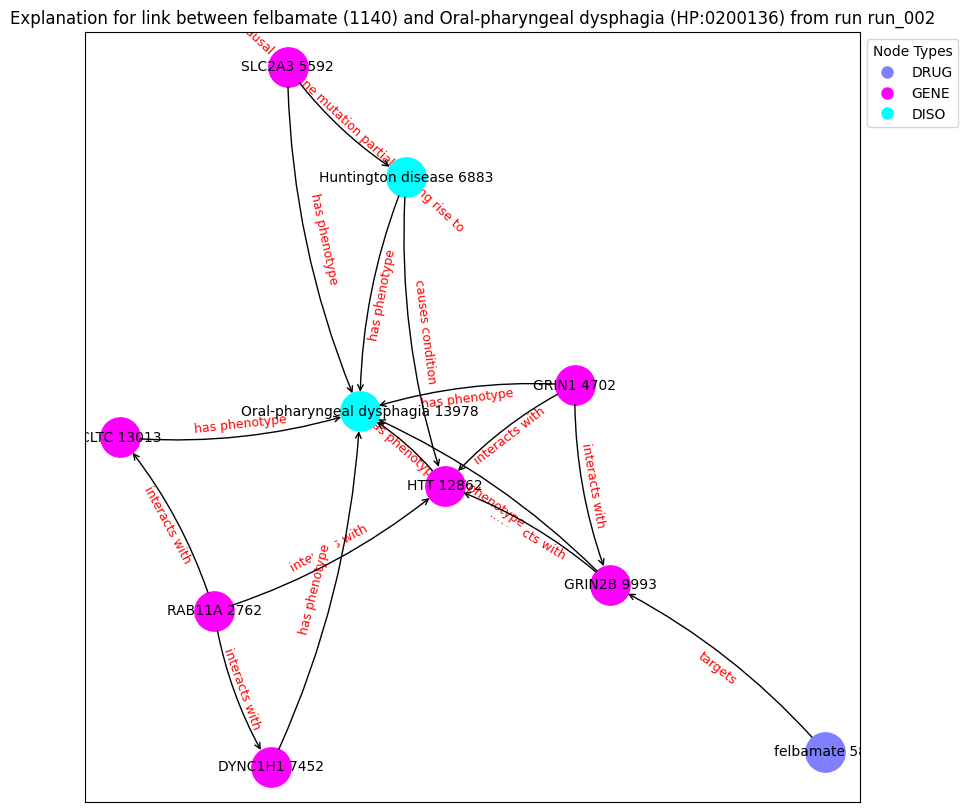

('felbamate 581', {'type': 'DRUG'})
('RAB11A 2762', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Oral-pharyngeal dysphagia 13978', {'type': 'DISO'})
('felbamate 581', 'GRIN2B 9993', {'label': 'targets'})
('RAB11A 2762', 'HTT 12862', {'label': 'interacts with'})
('RAB11A 2762', 'CLTC 13013', {'label': 'interacts with'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('SLC2A3 5592', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('Huntington 

Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.28it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.1805], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 196.11it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.1805], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 183.24it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.1805], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 201.67it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.1805], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 202.55it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.1805], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 206.07it/s]


Contribution threshold is tensor(0.0060)
Prediction from trained model: tensor([0.1805], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 203.82it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.1805], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 206.92it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1805], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 203.16it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.1805], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 200.97it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


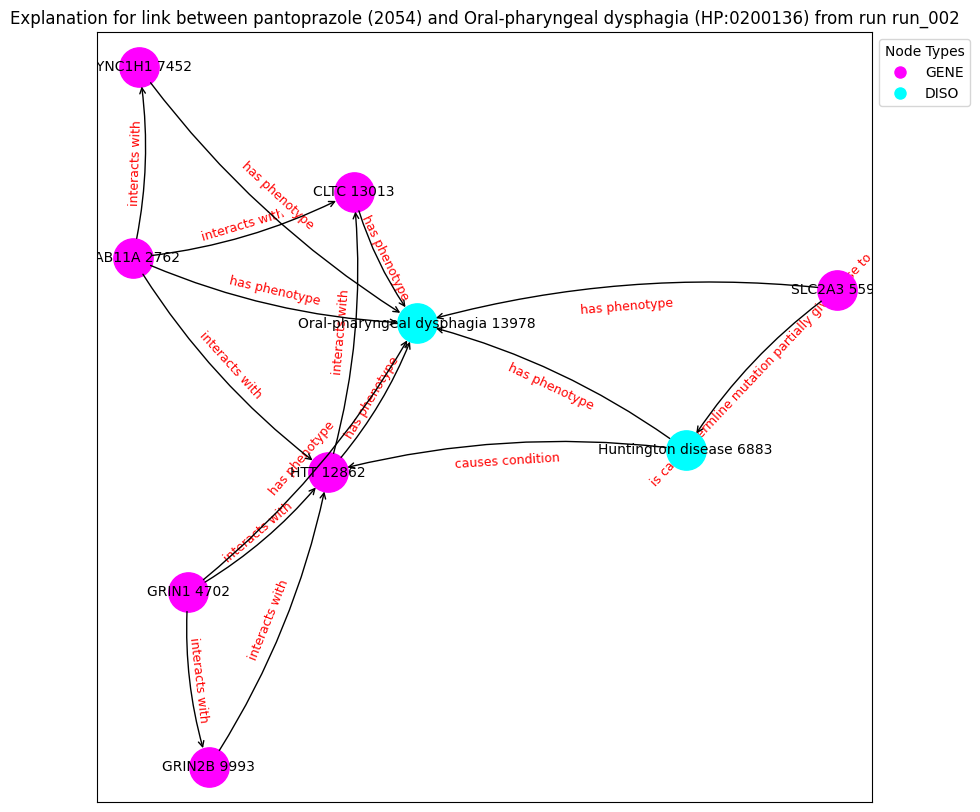

('RAB11A 2762', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Oral-pharyngeal dysphagia 13978', {'type': 'DISO'})
('RAB11A 2762', 'HTT 12862', {'label': 'interacts with'})
('RAB11A 2762', 'CLTC 13013', {'label': 'interacts with'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('SLC2A3 5592', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('Huntington disease 6883

Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:05<00:00, 133.90it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1178], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:05<00:00, 138.80it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.1178], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 142.92it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1178], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 143.11it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1178], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 147.86it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1178], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 141.92it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.1178], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 144.47it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1178], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 145.50it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1178], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:05<00:00, 136.89it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1178], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 146.70it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


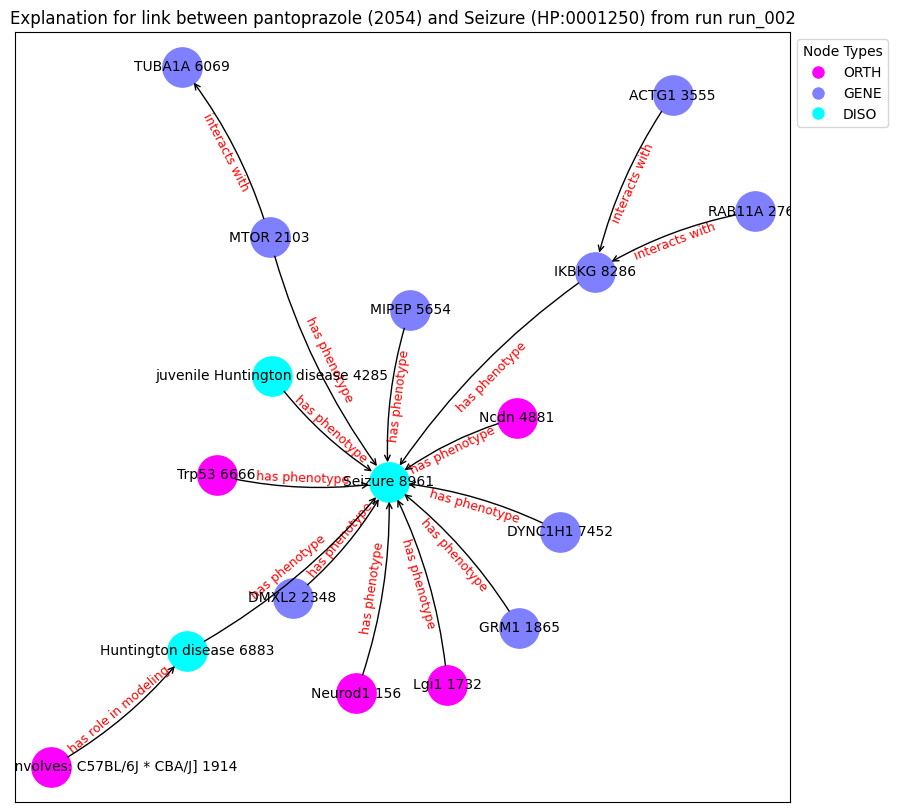

('Neurod1 156', {'type': 'ORTH'})
('Lgi1 1732', {'type': 'ORTH'})
('GRM1 1865', {'type': 'GENE'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', {'type': 'ORTH'})
('MTOR 2103', {'type': 'GENE'})
('DMXL2 2348', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('ACTG1 3555', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('Ncdn 4881', {'type': 'ORTH'})
('MIPEP 5654', {'type': 'GENE'})
('TUBA1A 6069', {'type': 'GENE'})
('Trp53 6666', {'type': 'ORTH'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('IKBKG 8286', {'type': 'GENE'})
('Seizure 8961', {'type': 'DISO'})
('Neurod1 156', 'Seizure 8961', {'label': 'has phenotype'})
('Lgi1 1732', 'Seizure 8961', {'label': 'has phenotype'})
('GRM1 1865', 'Seizure 8961', {'label': 'has phenotype'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', 'Huntington disease 6883', {'label': 'has role in modeling'})
('MTOR 2103', 'TUBA1A 6069', {'label': 'interacts with'})
('MTOR 210

Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 139.64it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2474], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 147.92it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2474], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 142.62it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2474], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 145.15it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2474], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 141.98it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2474], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 139.28it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2474], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 144.20it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2474], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 141.25it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.2474], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 141.81it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.2474], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 146.22it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


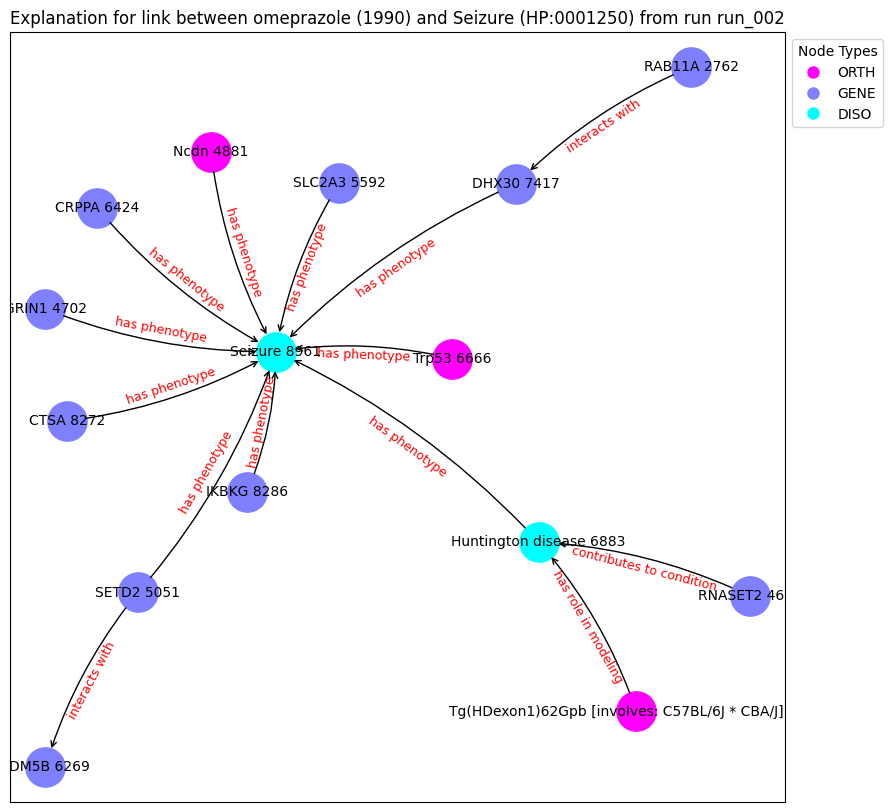

('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', {'type': 'ORTH'})
('RAB11A 2762', {'type': 'GENE'})
('RNASET2 4621', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('Ncdn 4881', {'type': 'ORTH'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('CRPPA 6424', {'type': 'GENE'})
('Trp53 6666', {'type': 'ORTH'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('CTSA 8272', {'type': 'GENE'})
('IKBKG 8286', {'type': 'GENE'})
('Seizure 8961', {'type': 'DISO'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', 'Huntington disease 6883', {'label': 'has role in modeling'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('RNASET2 4621', 'Huntington disease 6883', {'label': 'contributes to condition'})
('GRIN1 4702', 'Seizure 8961', {'label': 'has phenotype'})
('Ncdn 4881', 'Seizure 8961', {'label': 'has phenotype'})
('SETD2 5051', 'KDM5B 6269', {'label': 'interacts with'})
('SETD2 5051',

Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 138.27it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 135.18it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 144.14it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 142.20it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 143.60it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 145.28it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 146.45it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 143.12it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 141.93it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 143.35it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


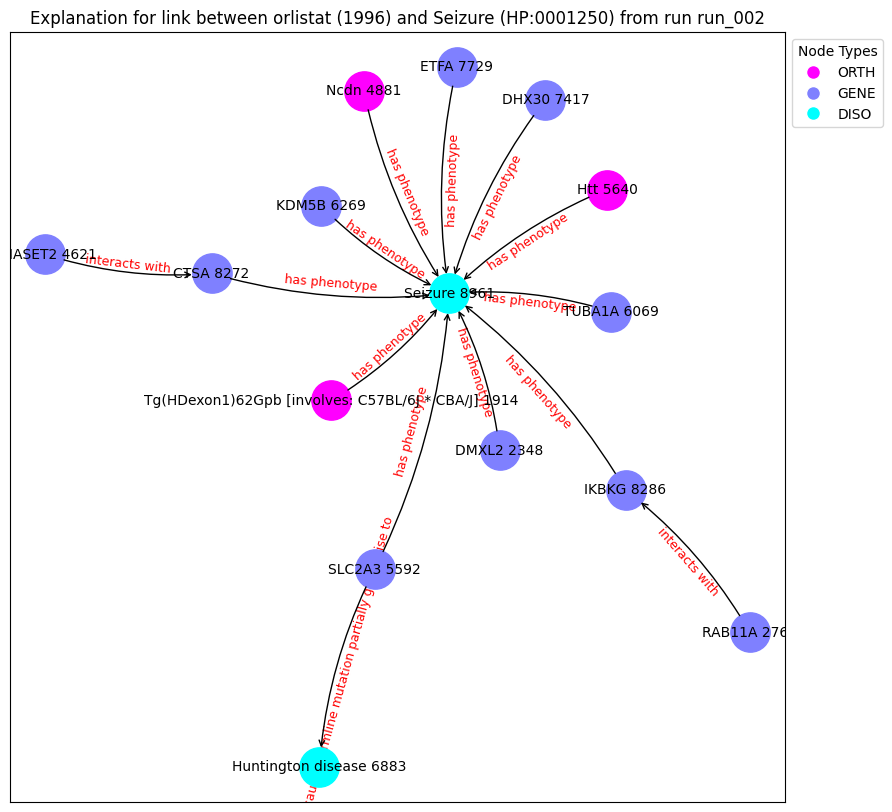

('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', {'type': 'ORTH'})
('DMXL2 2348', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('RNASET2 4621', {'type': 'GENE'})
('Ncdn 4881', {'type': 'ORTH'})
('SLC2A3 5592', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('TUBA1A 6069', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('CTSA 8272', {'type': 'GENE'})
('IKBKG 8286', {'type': 'GENE'})
('Seizure 8961', {'type': 'DISO'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', 'Seizure 8961', {'label': 'has phenotype'})
('DMXL2 2348', 'Seizure 8961', {'label': 'has phenotype'})
('RAB11A 2762', 'IKBKG 8286', {'label': 'interacts with'})
('RNASET2 4621', 'CTSA 8272', {'label': 'interacts with'})
('Ncdn 4881', 'Seizure 8961', {'label': 'has phenotype'})
('SLC2A3 5592', 'Seizure 8961', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is

Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 196.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0923], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 235.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0923], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0923], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0923], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 235.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0923], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 236.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0923], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0923], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0923], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 237.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0923], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.83it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
11896     11896  HP:0000737     DISO  Irritability            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.4747], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 220.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4747], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 220.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4747], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4747], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 232.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4747], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 217.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4747], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 220.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4747], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 221.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4747], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:02<00:00, 234.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4747], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 204.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4747], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 215.87it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                             label  \
1317      1317  HP:0009088     DISO  Speech articulation difficulties   

      semantic_id  
1317            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 253.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 237.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 241.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 235.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:03<00:00, 233.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 248.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 237.66it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
4154      4154  HP:0000746     DISO  Delusions            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 243.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 246.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 253.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 245.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 246.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 245.62it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic           label  semantic_id
5925      5925  HP:0000738     DISO  Hallucinations            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.3607], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3607], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 231.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3607], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3607], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3607], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3607], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 228.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3607], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3607], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3607], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3607], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 228.67it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic   label  semantic_id
9999      9999  HP:0002169     DISO  Clonus            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.5051], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 228.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5051], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5051], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5051], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 227.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5051], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5051], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 225.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5051], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5051], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 204.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5051], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 232.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5051], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 221.07it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic  \
9644      9644  HP:0010794     DISO   

                                             label  semantic_id  
9644  Impaired visuospatial constructive cognition            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.3346], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3346], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 224.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3346], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 229.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3346], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:02<00:00, 233.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3346], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 217.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3346], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 220.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3346], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3346], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 210.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3346], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 208.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3346], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 224.70it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic              label  semantic_id
14773     14773  HP:0002540     DISO  Inability to walk            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.2568], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.00it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2568], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.92it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.2568], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.86it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2568], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.98it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.2568], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.28it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2568], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.65it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2568], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.91it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2568], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.38it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2568], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 175.44it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2568], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 179.16it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


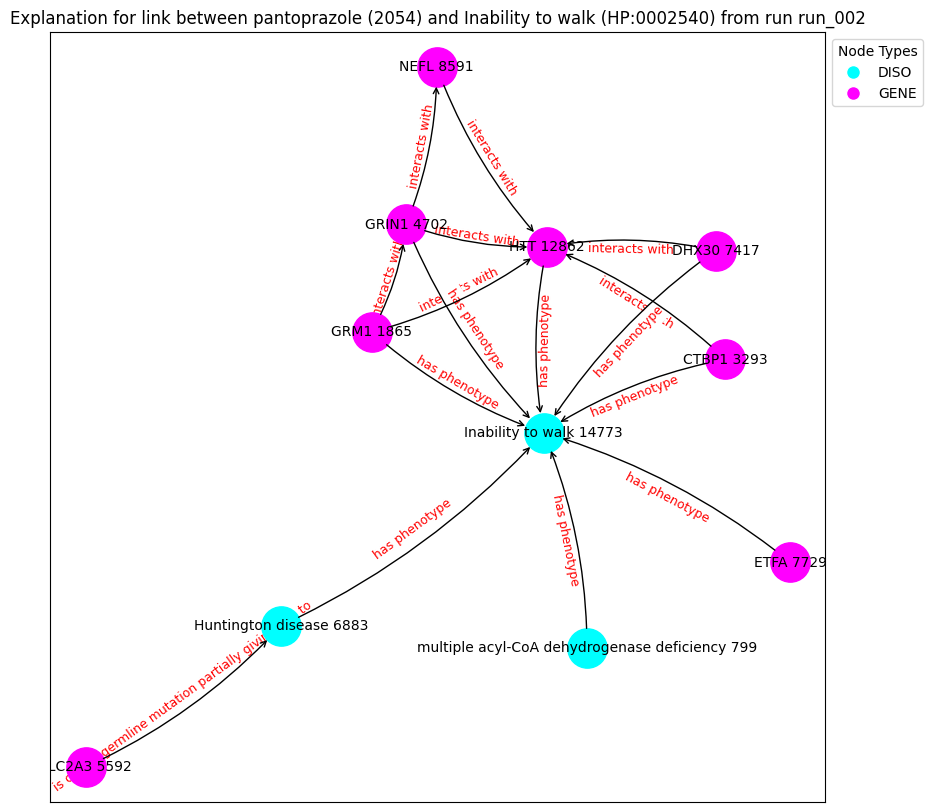

('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('GRM1 1865', {'type': 'GENE'})
('CTBP1 3293', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Inability to walk 14773', {'type': 'DISO'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRM1 1865', 'HTT 12862', {'label': 'interacts with'})
('GRM1 1865', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('CTBP1 3293', 'HTT 12862', {'label': 'interacts with'})
('CTBP1 3293', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'NEFL 8591', {'label': 'interacts with'})
('GRIN1 4702', 'Inability to walk 14773', {'label

Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.57it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.4817], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:04<00:00, 167.45it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.4817], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.91it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4817], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 175.36it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.4817], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 178.05it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4817], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 182.86it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.4817], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 176.45it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4817], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.36it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4817], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.90it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.4817], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 183.83it/s]


Contribution threshold is tensor(0.0062)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


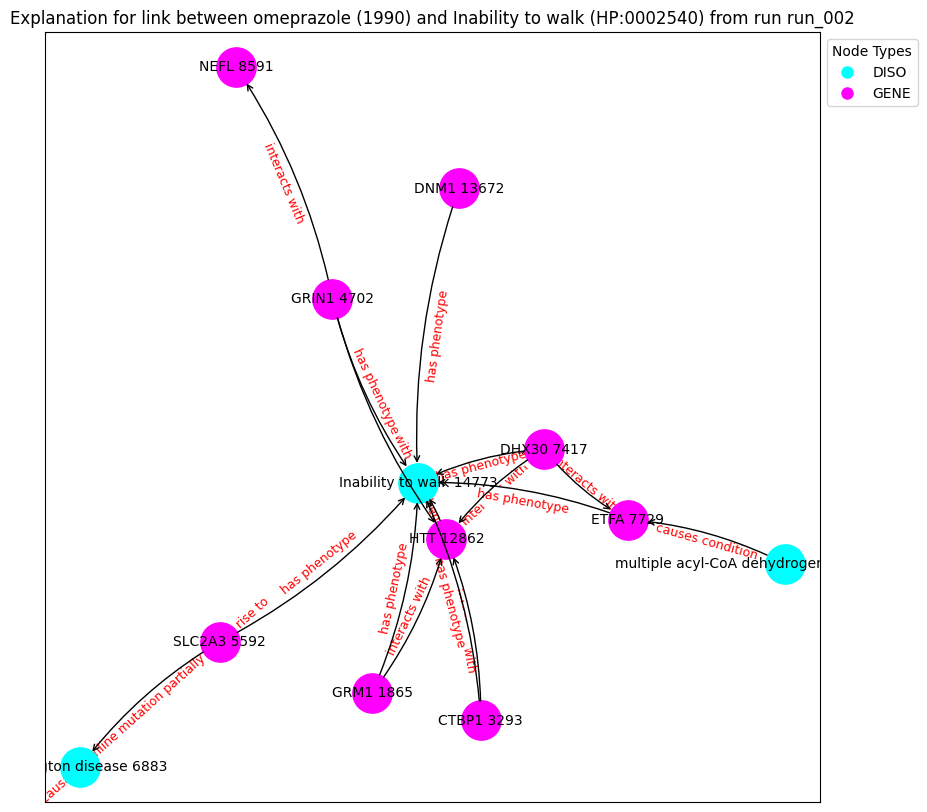

('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('GRM1 1865', {'type': 'GENE'})
('CTBP1 3293', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('DNM1 13672', {'type': 'GENE'})
('Inability to walk 14773', {'type': 'DISO'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'ETFA 7729', {'label': 'causes condition'})
('GRM1 1865', 'HTT 12862', {'label': 'interacts with'})
('GRM1 1865', 'Inability to walk 14773', {'label': 'has phenotype'})
('CTBP1 3293', 'HTT 12862', {'label': 'interacts with'})
('CTBP1 3293', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'NEFL 8591', {'label': 'interacts with'})
('GRIN1 4702', 'Inability to walk 14773', {'label': 'has phenotype'})
('SLC2A3 5592'

Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:03<00:00, 213.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 251.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:03<00:00, 224.21it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                    label  \
917       917  HP:0002529     DISO  Neuronal loss in central nervous system   

     semantic_id  
917            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 243.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 245.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 235.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 245.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 243.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 247.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.09it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 236.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:03<00:00, 229.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 250.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 246.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 237.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 251.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 244.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 250.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 241.70it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 251.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:03<00:00, 231.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 242.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 245.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 246.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 243.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 248.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:03<00:00, 233.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 246.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 245.96it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:03<00:00, 232.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:03<00:00, 232.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 241.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:03<00:00, 215.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 250.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 241.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 243.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 243.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 238.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.25it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                         label  semantic_id
9801      9801  HP:0007010     DISO  Poor fine motor coordination            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.5030], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 220.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5030], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 219.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5030], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5030], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 213.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5030], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 220.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5030], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 215.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5030], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 212.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5030], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 206.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5030], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 203.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5030], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 199.73it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic       label  semantic_id
14527     14527  HP:0030955     DISO  Alcoholism            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.3015], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 207.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3015], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 209.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3015], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 224.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3015], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3015], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 212.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3015], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3015], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 219.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3015], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 217.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3015], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3015], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 196.65it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic             label  semantic_id
8158      8158  HP:0002059     DISO  Cerebral atrophy            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.3022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.38it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.3022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.91it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.3022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 183.42it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.3022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.97it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.3022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.39it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.3022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 183.14it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.3022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.83it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.3022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:04<00:00, 174.52it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.3022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.02it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.3022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.08it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


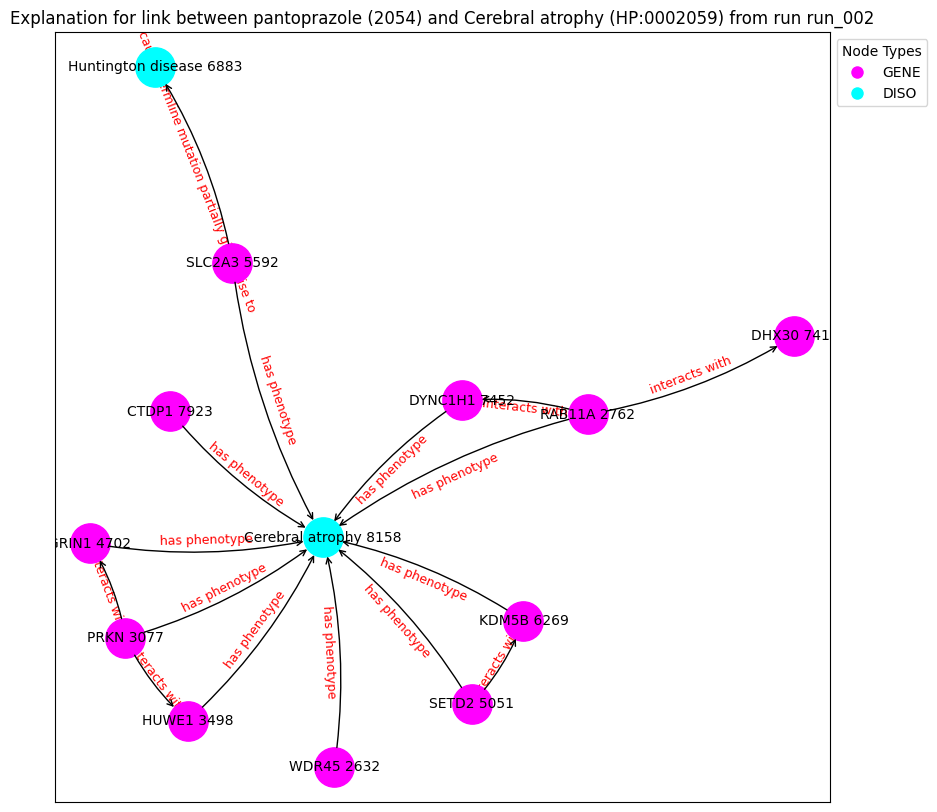

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('Cerebral atrophy 8158', {'type': 'DISO'})
('WDR45 2632', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('HUWE1 3498', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('GRIN1 4702', 'Cerebral atrophy 8158'

Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 183.24it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5018], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 182.74it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5018], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.69it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5018], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.17it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5018], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.63it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5018], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.38it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5018], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.57it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5018], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.42it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5018], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 182.29it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5018], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.21it/s]


Contribution threshold is tensor(0.0061)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


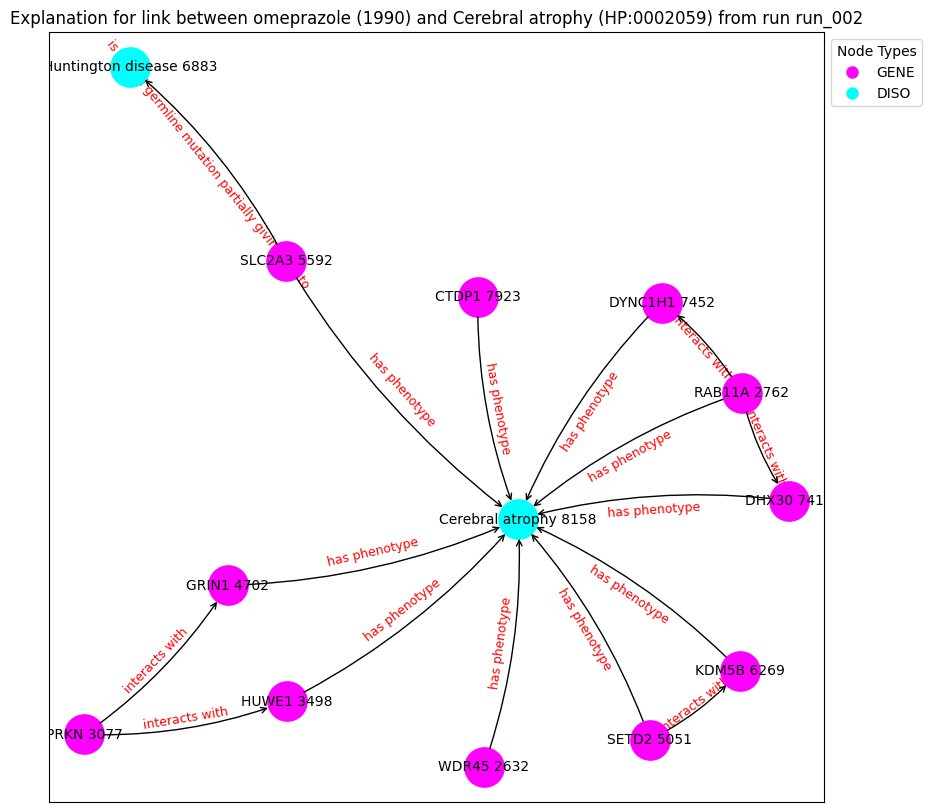

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('Cerebral atrophy 8158', {'type': 'DISO'})
('WDR45 2632', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('HUWE1 3498', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('GRIN1 4702', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('SETD2 5051', 'KDM5B 6269', {'label'

Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 230.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 230.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 241.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 223.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 242.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.77it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic          label  semantic_id
12039     12039  HP:0001347     DISO  Hyperreflexia            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.4471], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 169.42it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4471], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 166.95it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4471], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 169.49it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4471], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 159.28it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4471], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 168.01it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4471], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 153.55it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4471], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 163.48it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4471], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 168.24it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4471], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 169.78it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4471], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 170.76it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


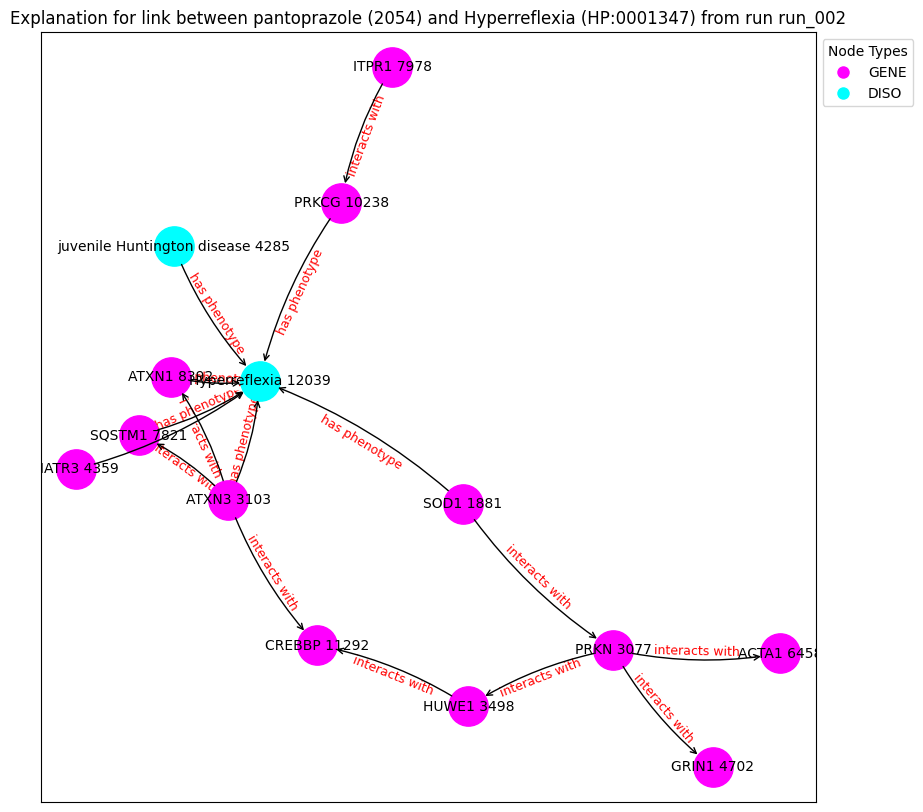

('SOD1 1881', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('MATR3 4359', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('ITPR1 7978', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('CREBBP 11292', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('SOD1 1881', 'PRKN 3077', {'label': 'interacts with'})
('SOD1 1881', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('ATXN3 3103', 'SQSTM1 7821', {'label': 'interacts with'})
('ATXN3 3103', 'CREBBP 11292', {'label': 'interacts with'})
('ATXN3 3103', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('ATXN3 3103', 'ATXN1 8392',

Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 160.59it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6805], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 159.46it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6805], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 166.82it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6805], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.26it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6805], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 169.90it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6805], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 163.15it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6805], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 168.98it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6805], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 172.51it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6805], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.41it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6805], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 149.53it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


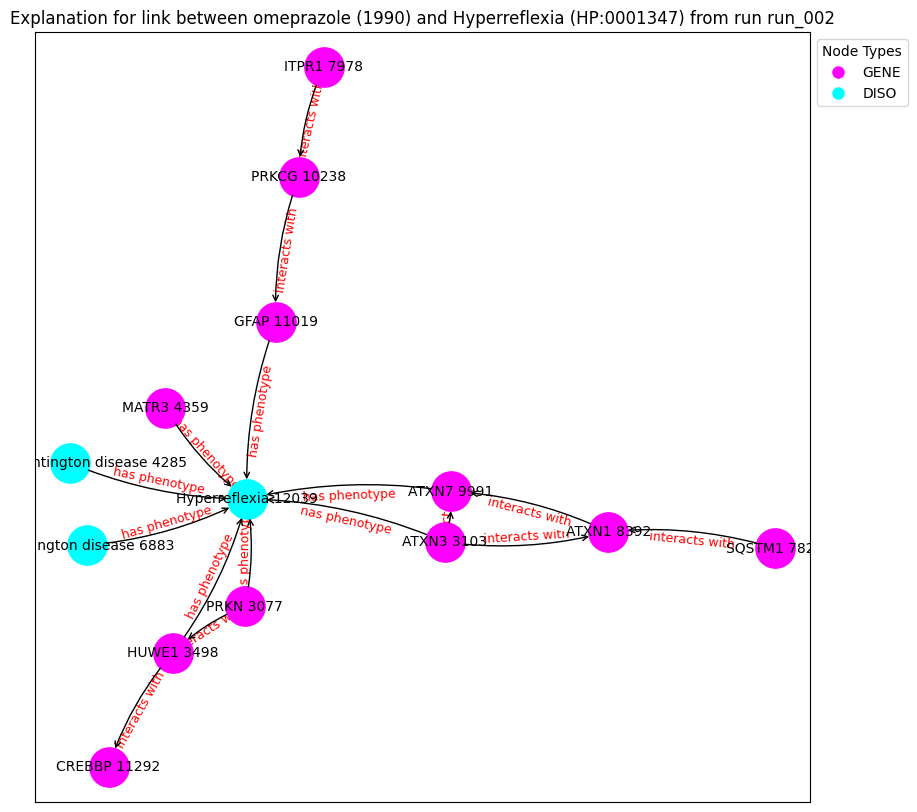

('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('MATR3 4359', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('ITPR1 7978', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('CREBBP 11292', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('ATXN3 3103', 'ATXN7 9991', {'label': 'interacts with'})
('ATXN3 3103', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('ATXN3 3103', 'ATXN1 8392', {'label': 'interacts with'})
('HUWE1 3498', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('HUWE1 3498', 'CREBBP 11292', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'Hyperreflexia 12039', {

Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 189.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 197.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 201.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 198.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 203.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 205.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 198.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 189.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 198.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 204.94it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
1369      1369  HP:0000751     DISO  Personality changes            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 247.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 233.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 237.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:03<00:00, 214.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.42it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic     label  semantic_id
13477     13477  HP:0002063     DISO  Rigidity            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.2318], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.57it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2318], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.29it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2318], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.12it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2318], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.22it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2318], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.97it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2318], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.93it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2318], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 176.46it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2318], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.04it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2318], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.02it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2318], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.80it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


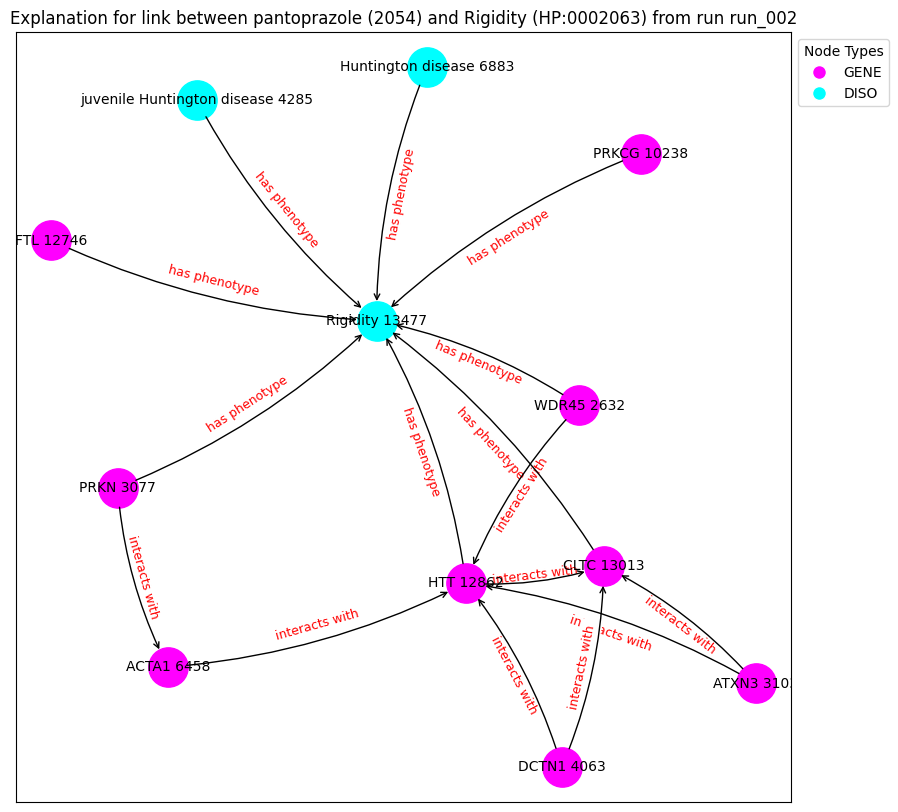

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('PRKCG 10238', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Rigidity 13477', {'type': 'DISO'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('WDR45 2632', 'Rigidity 13477', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'Rigidity 13477', {'label': 'has phenotype'})
('ATXN3 3103', 'HTT 12862', {'label': 'interacts with'})
('ATXN3 3103', 'CLTC 13013', {'label': 'interacts with'})
('DCTN1 4063', 'HTT 12862', {'label': 'interacts with'})
('DCTN1 4063', 'CLTC 13013', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'Rigidity 13477', {'label': 'has phenotype'})
('ACTA1 6458', 'HTT

Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.43it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4960], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 179.99it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.4960], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.89it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4960], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 180.00it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4960], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.96it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4960], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.07it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4960], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.47it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4960], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.95it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4960], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.41it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4960], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.19it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


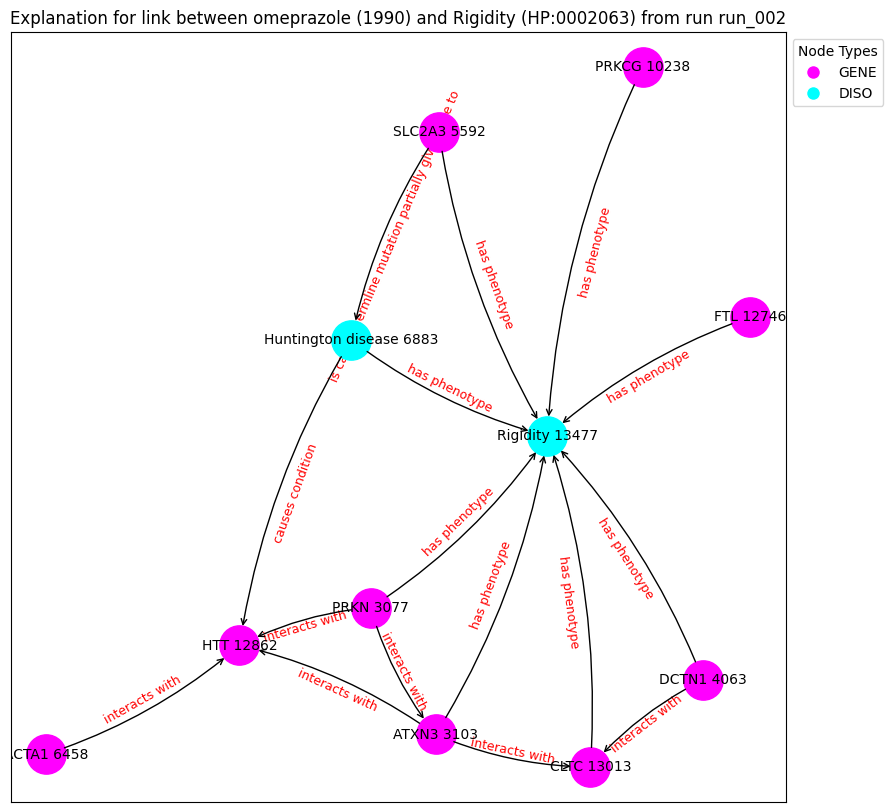

('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('PRKCG 10238', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Rigidity 13477', {'type': 'DISO'})
('PRKN 3077', 'HTT 12862', {'label': 'interacts with'})
('PRKN 3077', 'Rigidity 13477', {'label': 'has phenotype'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'HTT 12862', {'label': 'interacts with'})
('ATXN3 3103', 'CLTC 13013', {'label': 'interacts with'})
('ATXN3 3103', 'Rigidity 13477', {'label': 'has phenotype'})
('DCTN1 4063', 'CLTC 13013', {'label': 'interacts with'})
('DCTN1 4063', 'Rigidity 13477', {'label': 'has phenotype'})
('SLC2A3 5592', 'Rigidity 13477', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially

Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:03<00:00, 231.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 233.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:03<00:00, 225.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 237.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 246.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:03<00:00, 228.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 241.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 247.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 243.79it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                      label  \
434       434  HP:0002500     DISO  Abnormal cerebral white matter morphology   

     semantic_id  
434            1  
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 247.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 241.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 249.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:03<00:00, 228.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 238.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 251.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:03<00:00, 232.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 249.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 243.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 246.86it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                      label  \
434       434  HP:0002500     DISO  Abnormal cerebral white matter morphology   

     semantic_id  
434            1  
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 244.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 249.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 239.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 242.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 246.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 243.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 243.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 232.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 238.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 249.50it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic          label  semantic_id
13239     13239  HP:0003487     DISO  Babinski sign            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.3675], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 181.96it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3675], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 179.02it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3675], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:04<00:00, 169.08it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3675], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 179.42it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.3675], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 183.92it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3675], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 176.14it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3675], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 180.72it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3675], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 179.64it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3675], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 179.53it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3675], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 180.15it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


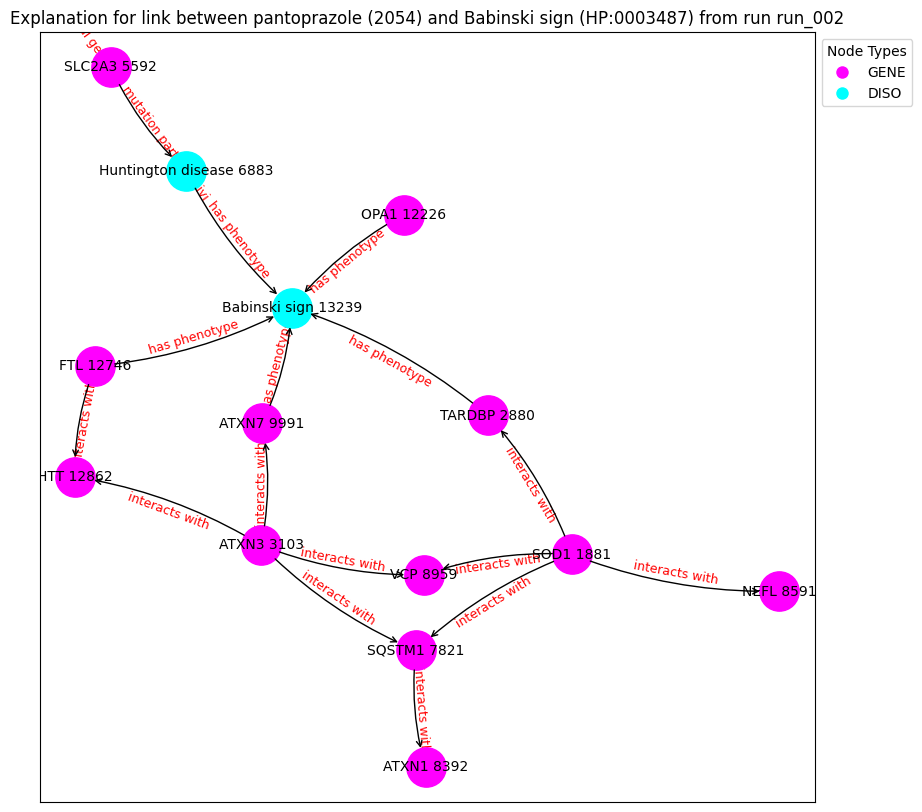

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('OPA1 12226', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Babinski sign 13239', {'type': 'DISO'})
('SOD1 1881', 'SQSTM1 7821', {'label': 'interacts with'})
('SOD1 1881', 'NEFL 8591', {'label': 'interacts with'})
('SOD1 1881', 'VCP 8959', {'label': 'interacts with'})
('SOD1 1881', 'TARDBP 2880', {'label': 'interacts with'})
('TARDBP 2880', 'Babinski sign 13239', {'label': 'has phenotype'})
('ATXN3 3103', 'SQSTM1 7821', {'label': 'interacts with'})
('ATXN3 3103', 'HTT 12862', {'label': 'interacts with'})
('ATXN3 3103', 'VCP 8959', {'label': 'interacts with'})
('ATXN3 3103', 'ATXN7 9991', {'label': 'interacts wit

Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 200.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3091], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 198.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3091], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 220.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3091], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 220.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3091], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3091], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 219.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3091], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 211.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3091], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3091], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3091], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 211.22it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic            label  semantic_id
830       830  HP:0002340     DISO  Caudate atrophy            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 243.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 241.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 247.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:03<00:00, 218.48it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic             label  semantic_id
13592     13592  HP:0001288     DISO  Gait disturbance            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.0902], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 130.18it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.0902], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 128.77it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.0902], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:06<00:00, 108.24it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.0902], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:06<00:00, 116.10it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.0902], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 125.84it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.0902], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 124.48it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.0902], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 125.16it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.0902], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 127.73it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.0902], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 125.65it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.0902], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 131.08it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


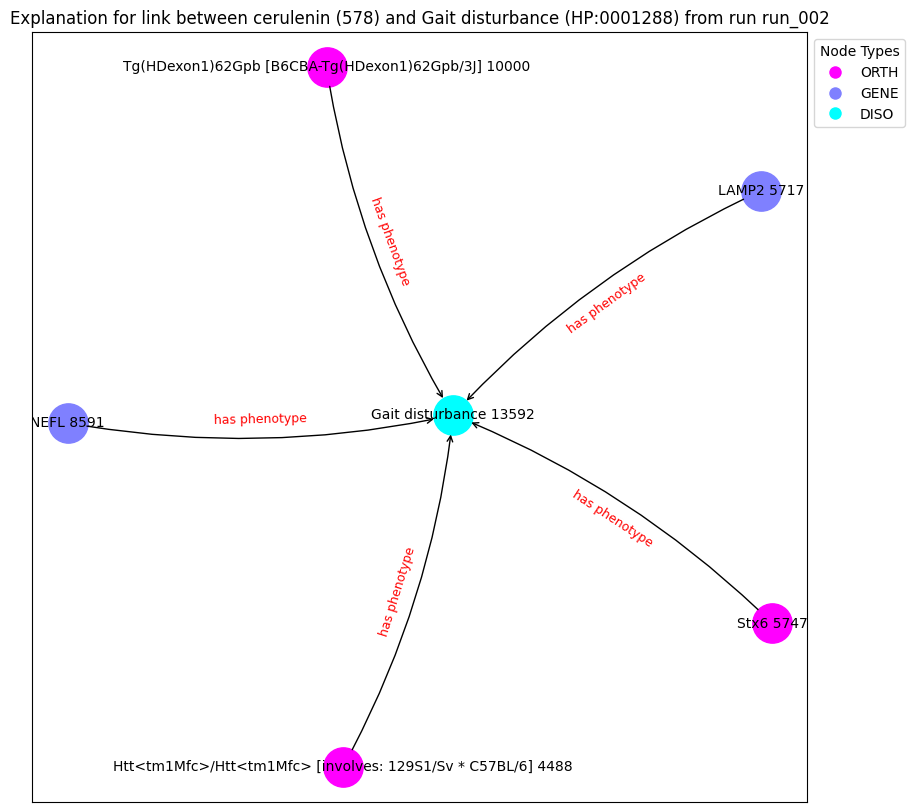

('Htt<tm1Mfc>/Htt<tm1Mfc> [involves: 129S1/Sv * C57BL/6] 4488', {'type': 'ORTH'})
('LAMP2 5717', {'type': 'GENE'})
('Stx6 5747', {'type': 'ORTH'})
('NEFL 8591', {'type': 'GENE'})
('Tg(HDexon1)62Gpb [B6CBA-Tg(HDexon1)62Gpb/3J] 10000', {'type': 'ORTH'})
('Gait disturbance 13592', {'type': 'DISO'})
('Htt<tm1Mfc>/Htt<tm1Mfc> [involves: 129S1/Sv * C57BL/6] 4488', 'Gait disturbance 13592', {'label': 'has phenotype'})
('LAMP2 5717', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Stx6 5747', 'Gait disturbance 13592', {'label': 'has phenotype'})
('NEFL 8591', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Tg(HDexon1)62Gpb [B6CBA-Tg(HDexon1)62Gpb/3J] 10000', 'Gait disturbance 13592', {'label': 'has phenotype'})
Explanation graph saved at c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\expl_5/incomplete_explanation_27_run_002_graph.gpickle
Explanation pair ids and names saved at c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIF

Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 220.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0610], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0610], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0610], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 208.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0610], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 219.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0610], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:02<00:00, 235.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0610], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 228.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0610], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 209.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0610], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 224.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0610], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 228.67it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                        label  semantic_id
4071      4071  HP:0003324     DISO  Generalized muscle weakness            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.3738], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 215.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3738], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3738], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3738], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3738], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 230.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3738], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3738], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3738], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 229.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3738], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3738], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 232.01it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic  \
5436      5436  HP:0003107     DISO   

                                               label  semantic_id  
5436  Abnormal circulating cholesterol concentration            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 249.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 237.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 252.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 253.52it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\run_003
(0, {'node_feature': tensor([-0.0721, -0.3387, -0.3201, -1.4014,  0.9629, -0.5414,  0.8502,  0.0140,
        -0.5490, -0.2541,  0.1943, -0.3583, -0.3585,  0.7598,  0.1906, -0.3510,
         0.4885, -0.0800, -0.0303,  0.7804, -0.3846, -0.0369, -0.2168,  0.2300,
        -0.0762, -0.5227,  0.4830, -0.3841, -0.3553,  0.3916,  0.9235,  0.8249])})
(0, 11953, {'edge_label': 'in orthology relationship with'})
Number of edges is 134749
Number of nodes is 14833
node1:
       index_id          id semantic       label  semantic_id
13668     13668  HP:0000716     DISO  Depression            1
node2:
      index_id    id semantic     label  semantic_id
1000      1000  1996     DRUG  orlistat            2
Prediction from trained model: tensor([0.4315], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 160.01it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4315], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 166.40it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4315], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 165.72it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4315], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 162.01it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4315], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 168.59it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4315], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 160.21it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4315], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 171.92it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4315], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 170.80it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4315], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 168.48it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4315], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 169.78it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


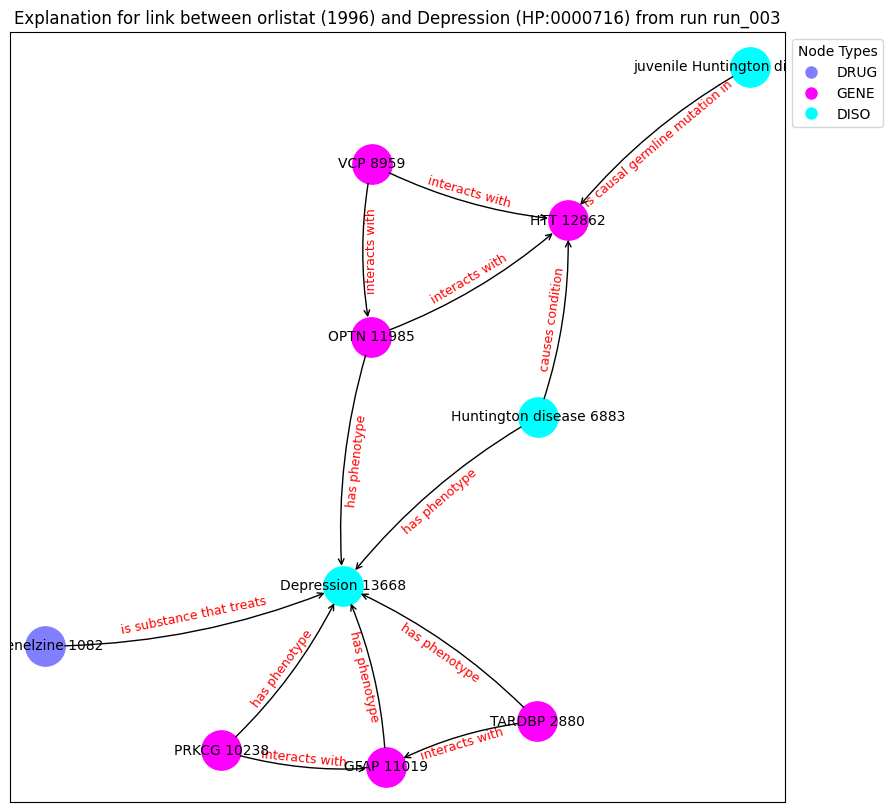

('phenelzine 1082', {'type': 'DRUG'})
('TARDBP 2880', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('Huntington disease 6883', {'type': 'DISO'})
('VCP 8959', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('phenelzine 1082', 'Depression 13668', {'label': 'is substance that treats'})
('TARDBP 2880', 'GFAP 11019', {'label': 'interacts with'})
('TARDBP 2880', 'Depression 13668', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is causal germline mutation in'})
('Huntington disease 6883', 'HTT 12862', {'label': 'causes condition'})
('Huntington disease 6883', 'Depression 13668', {'label': 'has phenotype'})
('VCP 8959', 'HTT 12862', {'label': 'interacts with'})
('VCP 8959', 'OPTN 11985', {'label': 'interacts with'})
('PRKCG 10238', 'GFAP 11019', {'label': 'interacts with'})
('PRKCG 10

Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 152.20it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6174], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 161.39it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6174], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 169.93it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6174], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 171.60it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6174], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 167.23it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6174], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 168.41it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6174], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 166.43it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6174], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 166.52it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6174], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 166.50it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6174], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 159.45it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


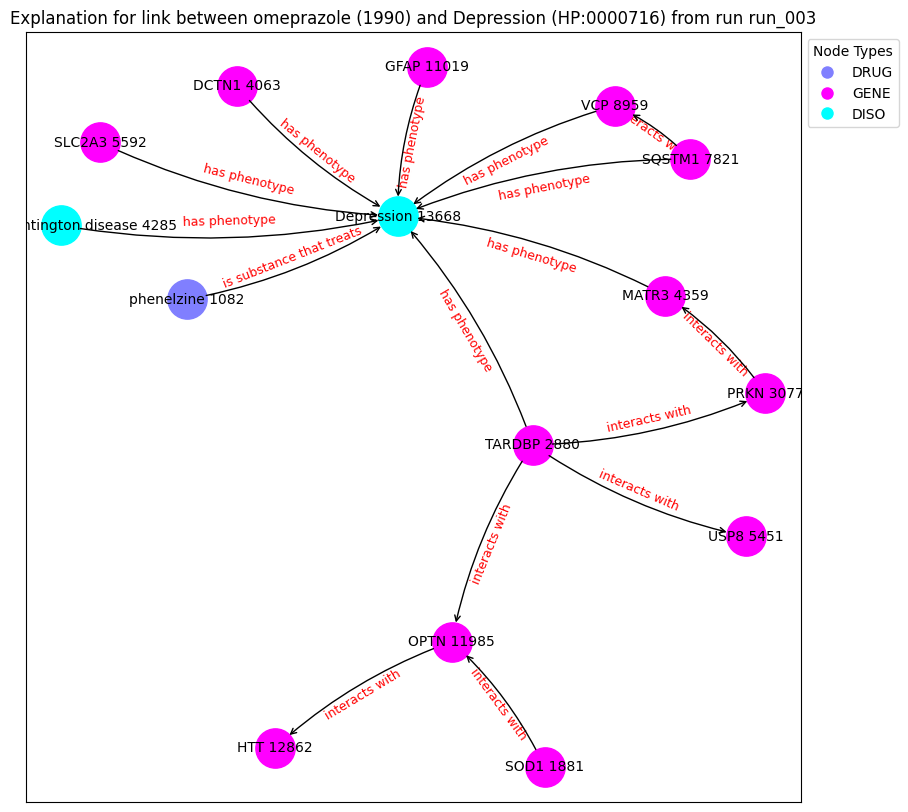

('phenelzine 1082', {'type': 'DRUG'})
('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('MATR3 4359', {'type': 'GENE'})
('USP8 5451', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('phenelzine 1082', 'Depression 13668', {'label': 'is substance that treats'})
('SOD1 1881', 'OPTN 11985', {'label': 'interacts with'})
('TARDBP 2880', 'PRKN 3077', {'label': 'interacts with'})
('TARDBP 2880', 'USP8 5451', {'label': 'interacts with'})
('TARDBP 2880', 'OPTN 11985', {'label': 'interacts with'})
('TARDBP 2880', 'Depression 13668', {'label': 'has phenotype'})
('PRKN 3077', 'MATR3 4359', {'label': 'interacts with'})
('DCTN1 4063', 'Depression 13668', {'label'

Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 157.04it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6597], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 161.85it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6597], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 169.32it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6597], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 170.75it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6597], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 170.42it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6597], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 172.44it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6597], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 170.14it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6597], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 159.99it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6597], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 171.39it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6597], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 168.74it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


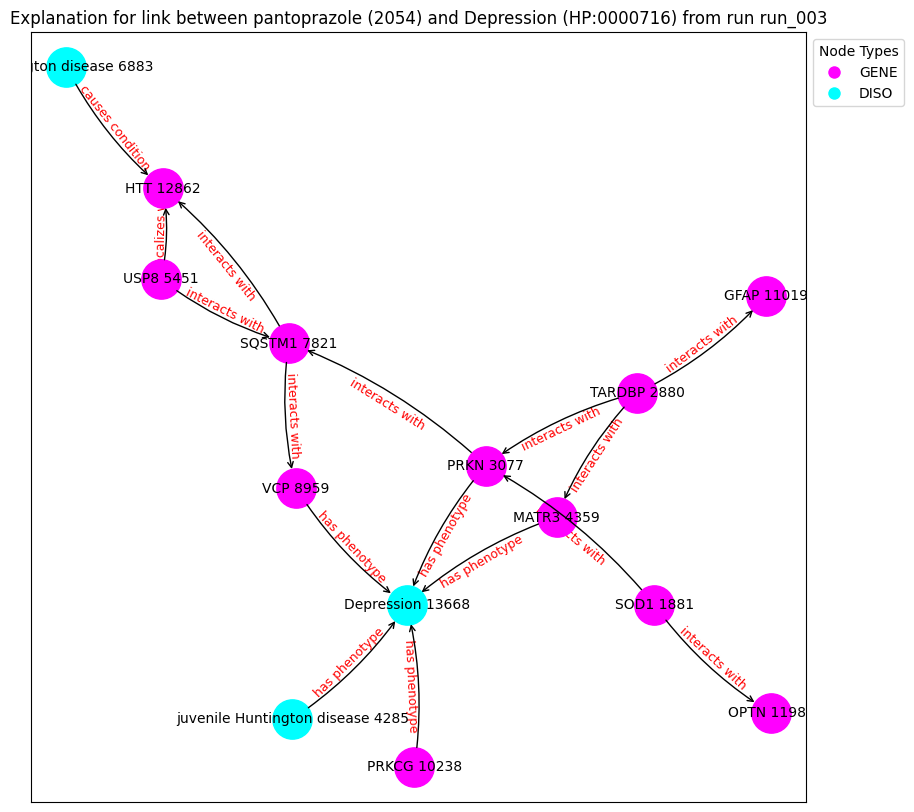

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('MATR3 4359', {'type': 'GENE'})
('USP8 5451', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('SOD1 1881', 'PRKN 3077', {'label': 'interacts with'})
('SOD1 1881', 'OPTN 11985', {'label': 'interacts with'})
('TARDBP 2880', 'PRKN 3077', {'label': 'interacts with'})
('TARDBP 2880', 'GFAP 11019', {'label': 'interacts with'})
('TARDBP 2880', 'MATR3 4359', {'label': 'interacts with'})
('PRKN 3077', 'Depression 13668', {'label': 'has phenotype'})
('PRKN 3077', 'SQSTM1 7821', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'Depression 13668', {'label': 'has phenotype'})
('MATR

Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7276], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7276], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7276], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:02<00:00, 236.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7276], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:02<00:00, 242.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7276], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7276], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 213.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7276], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 227.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7276], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 232.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7276], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 232.25it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic     label  semantic_id
12933     12933  HP:0001332     DISO  Dystonia            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.5962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 149.11it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 148.80it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 149.10it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 145.63it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 148.49it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 151.85it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 151.30it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 149.43it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 150.39it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 151.44it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


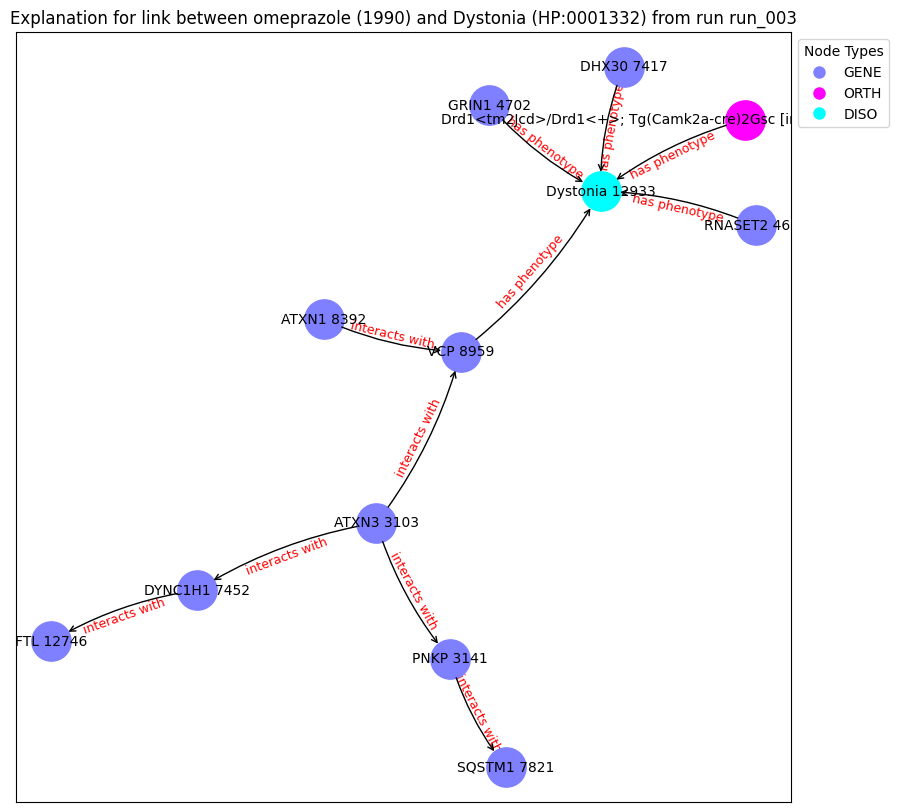

('ATXN3 3103', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('RNASET2 4621', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('Drd1<tm2Jcd>/Drd1<+>; Tg(Camk2a-cre)2Gsc [involves: 129S4/SvJae * FVB/N] 10314', {'type': 'ORTH'})
('FTL 12746', {'type': 'GENE'})
('Dystonia 12933', {'type': 'DISO'})
('ATXN3 3103', 'DYNC1H1 7452', {'label': 'interacts with'})
('ATXN3 3103', 'PNKP 3141', {'label': 'interacts with'})
('ATXN3 3103', 'VCP 8959', {'label': 'interacts with'})
('PNKP 3141', 'SQSTM1 7821', {'label': 'interacts with'})
('RNASET2 4621', 'Dystonia 12933', {'label': 'has phenotype'})
('GRIN1 4702', 'Dystonia 12933', {'label': 'has phenotype'})
('DHX30 7417', 'Dystonia 12933', {'label': 'has phenotype'})
('DYNC1H1 7452', 'FTL 12746', {'label': 'interacts with'})
('ATXN1 8392', 'VCP 8959', {'label': 'interacts with'})


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 145.49it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6311], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 142.66it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6311], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 144.46it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6311], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 150.77it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6311], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 149.69it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6311], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 151.51it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6311], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 150.31it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6311], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 152.66it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6311], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 151.07it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6311], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 143.50it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


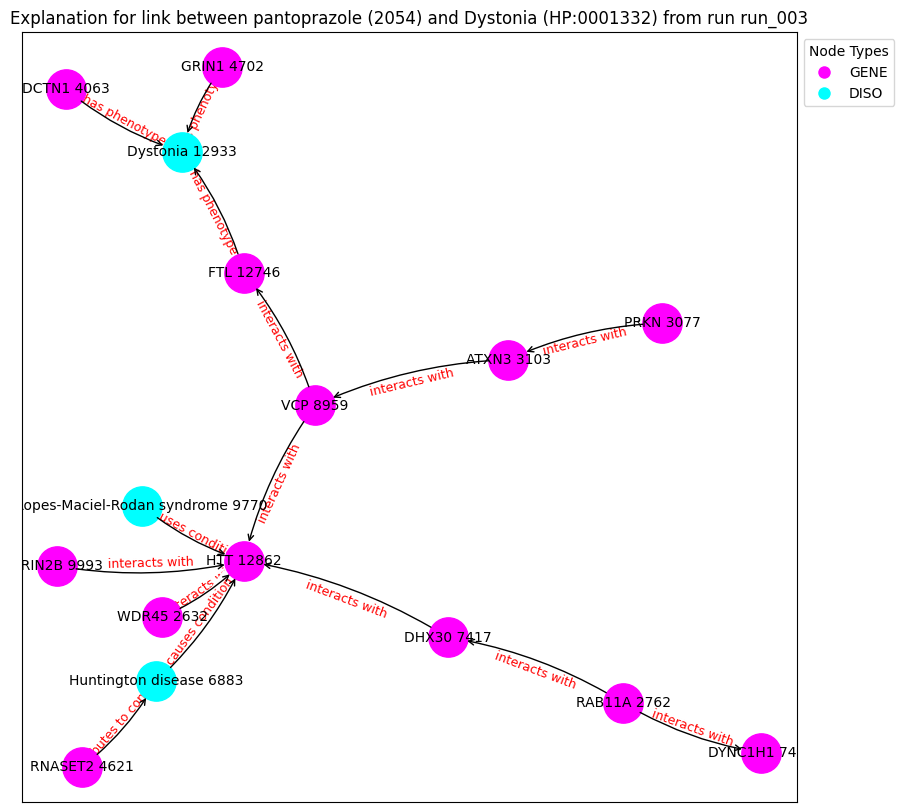

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('RNASET2 4621', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('Lopes-Maciel-Rodan syndrome 9770', {'type': 'DISO'})
('GRIN2B 9993', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Dystonia 12933', {'type': 'DISO'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'VCP 8959', {'label': 'interacts with'})
('DCTN1 4063', 'Dystonia 12933', {'label': 'has phenotype'})
('RNASET2 4621', 'Huntington disease 6883', {'label': 'contributes to condition'}

Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 232.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8310], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 224.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8310], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 249.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8310], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 222.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8310], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 242.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8310], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 258.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8310], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 242.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8310], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 226.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8310], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 241.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8310], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 243.11it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic    label  semantic_id
1789      1789  HP:0000739     DISO  Anxiety            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 244.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 239.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 256.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 240.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 238.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 242.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 230.56it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6094], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 230.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6094], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 207.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6094], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6094], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6094], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6094], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 228.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6094], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6094], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6094], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 233.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6094], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:02<00:00, 238.91it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.6479], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 231.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6479], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 224.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6479], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 221.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6479], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6479], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6479], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 222.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6479], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 224.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6479], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 209.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6479], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:02<00:00, 239.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6479], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 233.08it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.7427], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 230.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7427], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7427], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7427], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 218.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7427], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 230.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7427], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 231.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7427], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 203.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7427], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 227.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7427], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 227.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7427], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 227.87it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.7321], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 208.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7321], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 204.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7321], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 205.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7321], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 209.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7321], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 197.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7321], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 197.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7321], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 203.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7321], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 205.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7321], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 205.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7321], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 203.90it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 210.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 204.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 208.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 204.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.57it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
6473      6473  HP:0001272     DISO  Cerebellar atrophy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.5919], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 197.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5919], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5919], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 183.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5919], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5919], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5919], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5919], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 198.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5919], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5919], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 197.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5919], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.35it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
6473      6473  HP:0001272     DISO  Cerebellar atrophy            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.6304], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6304], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6304], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6304], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6304], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6304], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 180.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6304], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6304], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6304], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6304], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.68it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
4670      4670  HP:0031589     DISO  Suicidal ideation            1
node2:
      index_id    id semantic             label  semantic_id
2023      2023  4226     DRUG  ingenol mebutate            2
Prediction from trained model: tensor([0.4377], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 225.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4377], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 218.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4377], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 223.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4377], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 232.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4377], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:02<00:00, 234.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4377], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 230.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4377], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:02<00:00, 235.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4377], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 231.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4377], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 229.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4377], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 232.04it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic        label  semantic_id
2028      2028  HP:0002066     DISO  Gait ataxia            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.4727], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4727], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4727], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:02<00:00, 233.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4727], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4727], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 213.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4727], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4727], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4727], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4727], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4727], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.38it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic        label  semantic_id
2028      2028  HP:0002066     DISO  Gait ataxia            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.5332], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 219.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5332], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 229.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5332], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 222.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5332], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 208.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5332], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5332], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 214.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5332], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 229.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5332], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 211.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5332], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 226.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5332], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 206.02it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                 label  semantic_id
10550     10550  HP:0001268     DISO  Mental deterioration            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.5482], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5482], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 208.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5482], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 208.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5482], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 204.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5482], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 208.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5482], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5482], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5482], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 209.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5482], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 183.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5482], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 215.51it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                        label  semantic_id
8786      8786  HP:0000496     DISO  Abnormality of eye movement            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.6554], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 227.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6554], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6554], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 199.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6554], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 203.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6554], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6554], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 215.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6554], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6554], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 193.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6554], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 221.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6554], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 215.69it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic         label  semantic_id
7072      7072  HP:0002067     DISO  Bradykinesia            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.4741], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 194.33it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.4741], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 195.69it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4741], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 198.83it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.4741], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 197.62it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.4741], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 194.84it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.4741], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 182.21it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4741], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 184.16it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4741], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 190.81it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.4741], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 191.76it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.4741], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 190.70it/s]


Contribution threshold is tensor(0.0062)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


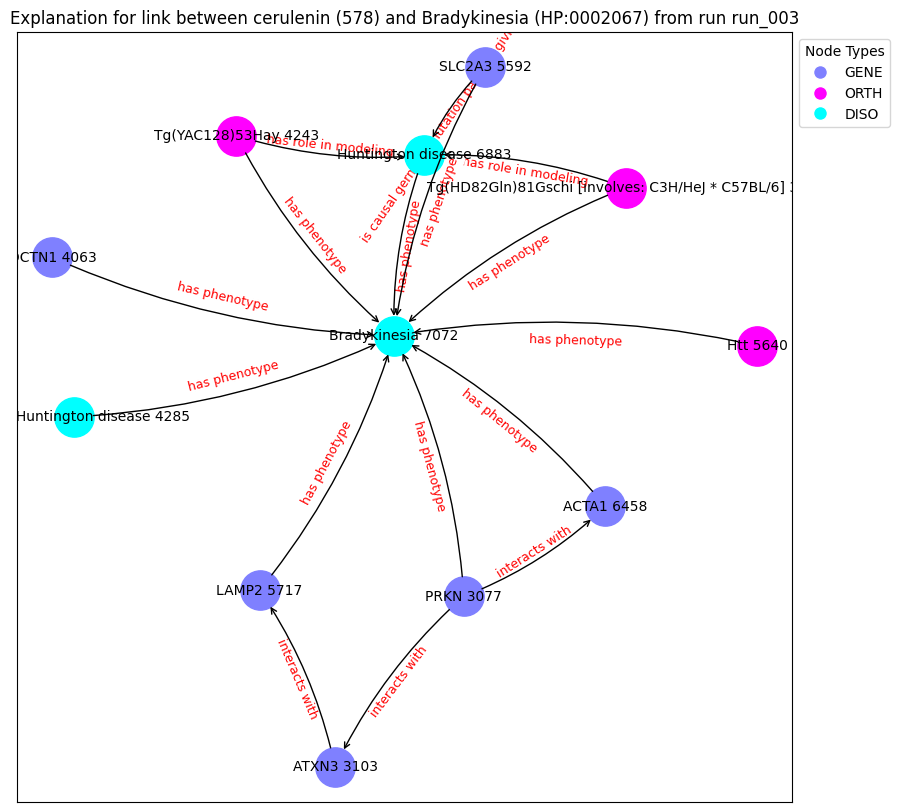

('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', {'type': 'ORTH'})
('DCTN1 4063', {'type': 'GENE'})
('Tg(YAC128)53Hay 4243', {'type': 'ORTH'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('LAMP2 5717', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('Bradykinesia 7072', {'type': 'DISO'})
('PRKN 3077', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'LAMP2 5717', {'label': 'interacts with'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Huntington disease 6883', {'label': 'has role in modeling'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Bradykinesia 7072', {'label': 'has phenotype'})
('DCTN1 4063', 'Bradykinesia 7072', {'label': 'ha

Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 217.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 223.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 257.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 240.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 251.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 260.05it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic           label  semantic_id
1065      1065  HP:0002141     DISO  Gait imbalance            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 241.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 236.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:03<00:00, 226.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 239.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 236.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 241.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 237.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 253.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:03<00:00, 230.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 234.85it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
5935      5935  HP:0000713     DISO  Agitation            1
node2:
      index_id    id semantic     label  semantic_id
1000      1000  1996     DRUG  orlistat            2
Prediction from trained model: tensor([0.4517], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 190.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4517], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 201.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4517], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 202.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4517], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 202.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4517], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 191.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4517], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 203.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4517], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 201.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4517], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 204.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4517], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 199.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4517], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 197.37it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
5935      5935  HP:0000713     DISO  Agitation            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6441], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 212.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6441], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6441], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6441], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6441], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6441], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6441], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 207.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6441], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6441], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6441], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.32it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic    label  semantic_id
3363      3363  HP:0002171     DISO  Gliosis            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 210.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 200.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 202.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 203.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 207.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 198.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 202.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 205.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 204.66it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic   label  semantic_id
14731     14731  HP:0002072     DISO  Chorea            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6100], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 173.10it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6100], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:03<00:00, 175.92it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6100], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 173.48it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6100], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 165.94it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6100], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:03<00:00, 177.06it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6100], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.47it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6100], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 174.97it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6100], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.80it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6100], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 174.27it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6100], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 174.35it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


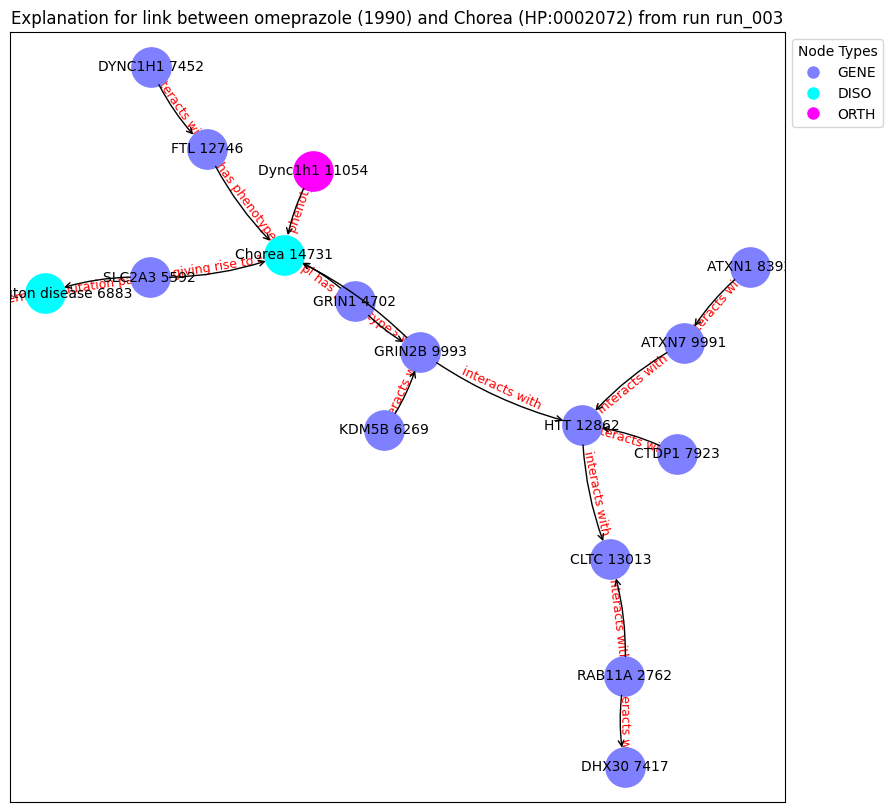

('RAB11A 2762', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('Dync1h1 11054', {'type': 'ORTH'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Chorea 14731', {'type': 'DISO'})
('RAB11A 2762', 'CLTC 13013', {'label': 'interacts with'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'Chorea 14731', {'label': 'has phenotype'})
('SLC2A3 5592', 'Chorea 14731', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('KDM5B 6269', 'GRIN2B 9993', {'label': 'inte

Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 166.46it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6435], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 165.70it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6435], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 169.72it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6435], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 174.28it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6435], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 174.13it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6435], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:03<00:00, 176.43it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6435], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 169.30it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6435], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:03<00:00, 175.64it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6435], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 174.62it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6435], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 168.27it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


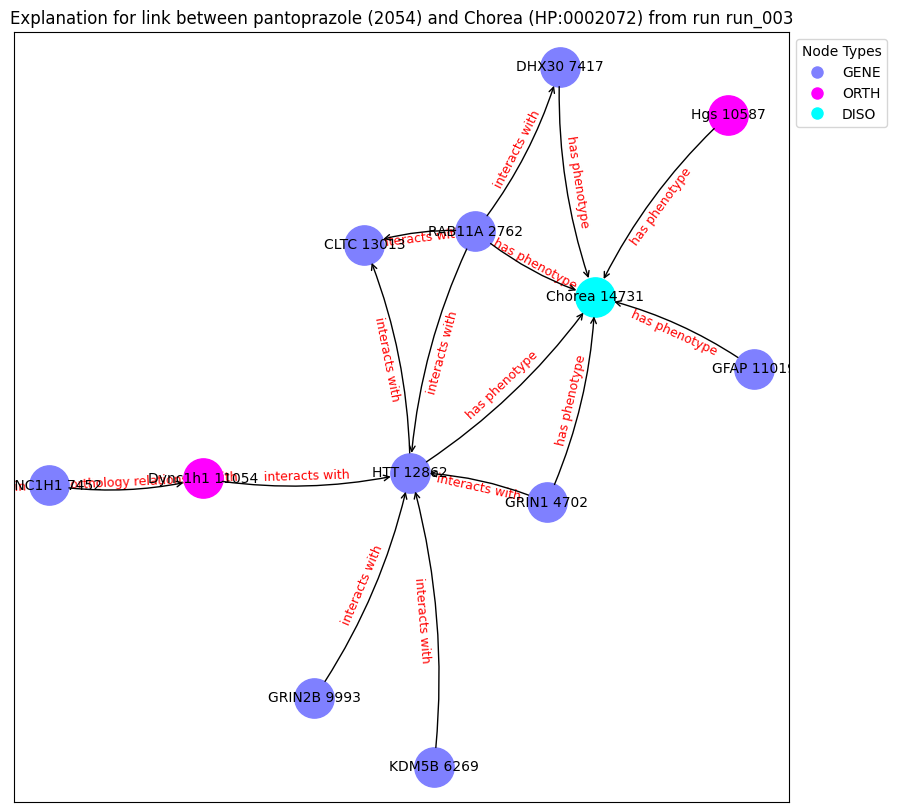

('RAB11A 2762', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('Hgs 10587', {'type': 'ORTH'})
('GFAP 11019', {'type': 'GENE'})
('Dync1h1 11054', {'type': 'ORTH'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Chorea 14731', {'type': 'DISO'})
('RAB11A 2762', 'HTT 12862', {'label': 'interacts with'})
('RAB11A 2762', 'CLTC 13013', {'label': 'interacts with'})
('RAB11A 2762', 'Chorea 14731', {'label': 'has phenotype'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'Chorea 14731', {'label': 'has phenotype'})
('KDM5B 6269', 'HTT 12862', {'label': 'interacts with'})
('DHX30 7417', 'Chorea 14731', {'label': 'has phenotype'})
('DYNC1H1 7452', 'Dync1h1 11054', {'label': 'in 1 to 1 orthology relationship with'})
('GRIN2B 9993', 'HTT 12862', {'label': 'int

Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 240.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 246.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 236.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 241.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 234.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 243.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:03<00:00, 232.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 247.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 234.39it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic        label  semantic_id
13123     13123  HP:0001824     DISO  Weight loss            1
node2:
    index_id  id semantic                   label  semantic_id
53        53  91     DRUG  adenosine triphosphate            2
Prediction from trained model: tensor([0.5088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 134.51it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 139.03it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:04<00:00, 140.36it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 137.68it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 135.65it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 139.81it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:04<00:00, 140.08it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:04<00:00, 140.03it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 137.92it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:04<00:00, 140.31it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


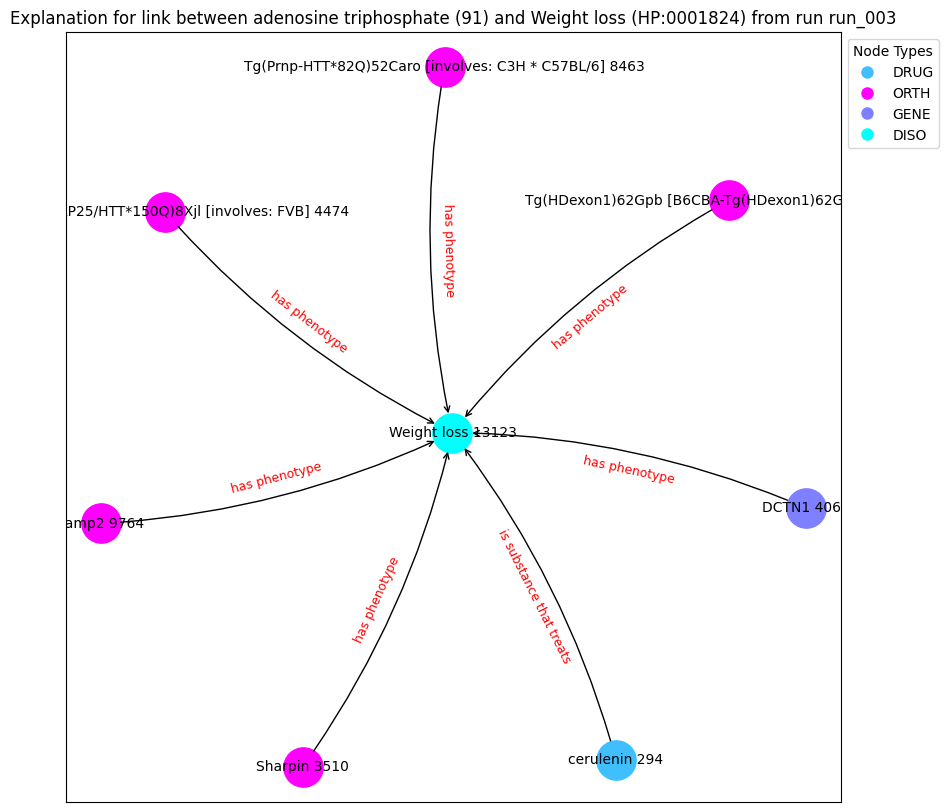

('cerulenin 294', {'type': 'DRUG'})
('Sharpin 3510', {'type': 'ORTH'})
('DCTN1 4063', {'type': 'GENE'})
('Tg(Prnp-SNAP25/HTT*150Q)8Xjl [involves: FVB] 4474', {'type': 'ORTH'})
('Tg(Prnp-HTT*82Q)52Caro [involves: C3H * C57BL/6] 8463', {'type': 'ORTH'})
('Lamp2 9764', {'type': 'ORTH'})
('Tg(HDexon1)62Gpb [B6CBA-Tg(HDexon1)62Gpb/1J] 12785', {'type': 'ORTH'})
('Weight loss 13123', {'type': 'DISO'})
('cerulenin 294', 'Weight loss 13123', {'label': 'is substance that treats'})
('Sharpin 3510', 'Weight loss 13123', {'label': 'has phenotype'})
('DCTN1 4063', 'Weight loss 13123', {'label': 'has phenotype'})
('Tg(Prnp-SNAP25/HTT*150Q)8Xjl [involves: FVB] 4474', 'Weight loss 13123', {'label': 'has phenotype'})
('Tg(Prnp-HTT*82Q)52Caro [involves: C3H * C57BL/6] 8463', 'Weight loss 13123', {'label': 'has phenotype'})
('Lamp2 9764', 'Weight loss 13123', {'label': 'has phenotype'})
('Tg(HDexon1)62Gpb [B6CBA-Tg(HDexon1)62Gpb/1J] 12785', 'Weight loss 13123', {'label': 'has phenotype'})
Explanation grap

Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 129.96it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5429], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 138.75it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5429], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:04<00:00, 140.24it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5429], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 139.80it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5429], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:04<00:00, 141.70it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5429], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:04<00:00, 142.29it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5429], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:04<00:00, 140.40it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5429], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 139.04it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5429], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 133.48it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5429], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:04<00:00, 140.54it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


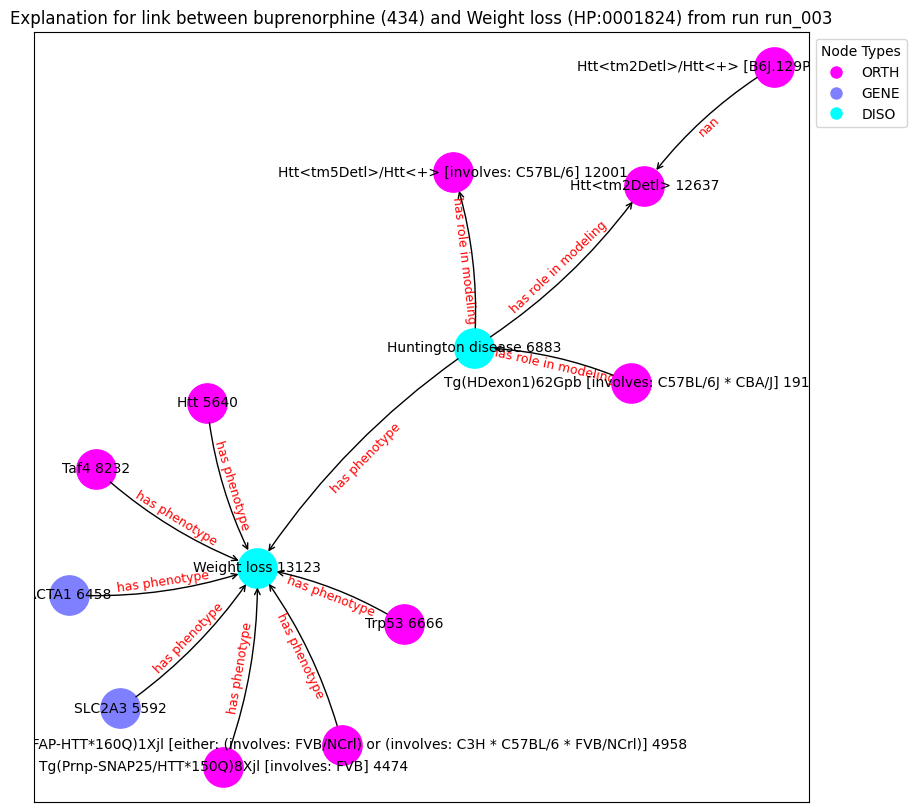

('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', {'type': 'ORTH'})
('Tg(Prnp-SNAP25/HTT*150Q)8Xjl [involves: FVB] 4474', {'type': 'ORTH'})
('Tg(GFAP-HTT*160Q)1Xjl [either: (involves: FVB/NCrl) or (involves: C3H * C57BL/6 * FVB/NCrl)] 4958', {'type': 'ORTH'})
('SLC2A3 5592', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('ACTA1 6458', {'type': 'GENE'})
('Trp53 6666', {'type': 'ORTH'})
('Huntington disease 6883', {'type': 'DISO'})
('Taf4 8232', {'type': 'ORTH'})
('Htt<tm2Detl>/Htt<+> [B6J.129P2-Htt<tm2Detl>] 9652', {'type': 'ORTH'})
('Htt<tm5Detl>/Htt<+> [involves: C57BL/6] 12001', {'type': 'ORTH'})
('Htt<tm2Detl> 12637', {'type': 'ORTH'})
('Weight loss 13123', {'type': 'DISO'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', 'Huntington disease 6883', {'label': 'has role in modeling'})
('Tg(Prnp-SNAP25/HTT*150Q)8Xjl [involves: FVB] 4474', 'Weight loss 13123', {'label': 'has phenotype'})
('Tg(GFAP-HTT*160Q)1Xjl [either: (involves: FVB/NCrl) or (involves: C3H * C57BL/6 * F

Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.73it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5787], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.12it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5787], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.91it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5787], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 199.28it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5787], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.85it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5787], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 201.27it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5787], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.80it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5787], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 202.34it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5787], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.04it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5787], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 202.90it/s]


Contribution threshold is tensor(0.0061)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


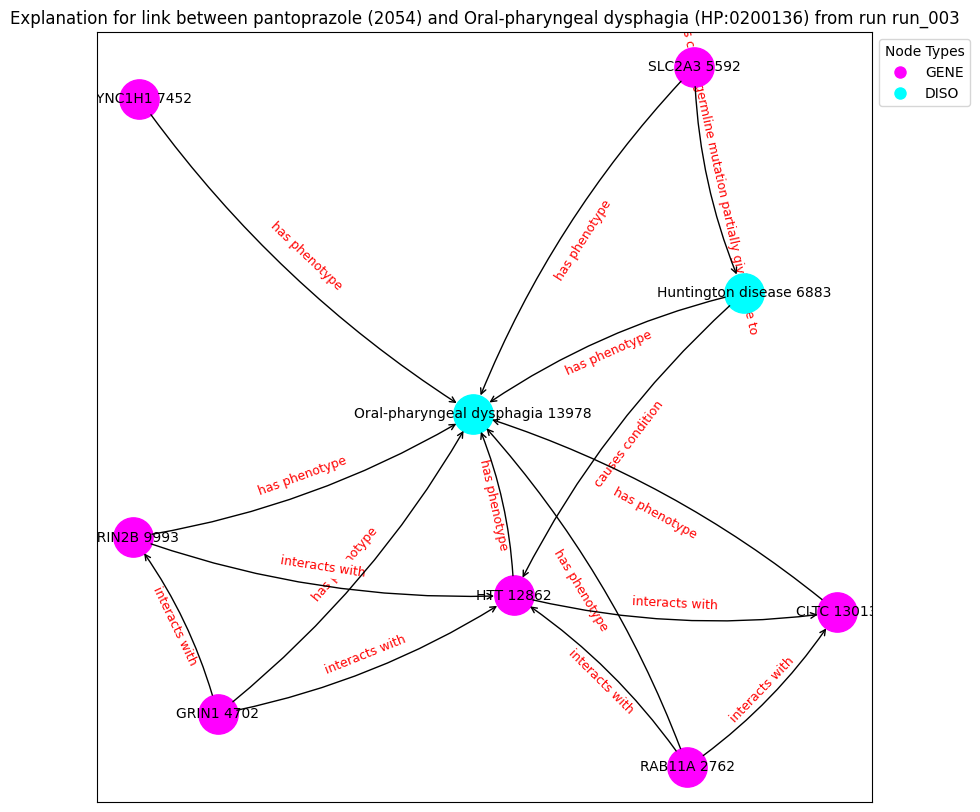

('RAB11A 2762', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Oral-pharyngeal dysphagia 13978', {'type': 'DISO'})
('RAB11A 2762', 'HTT 12862', {'label': 'interacts with'})
('RAB11A 2762', 'CLTC 13013', {'label': 'interacts with'})
('RAB11A 2762', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('SLC2A3 5592', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('Huntington disease 6883', 'HTT 12862', {'label': 'causes condition'})
('Huntington d

Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5653], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 197.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5653], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5653], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 197.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5653], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5653], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5653], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5653], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 182.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5653], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5653], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.60it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic     label  semantic_id
10333     10333  HP:0000726     DISO  Dementia            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.6026], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 196.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6026], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6026], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 202.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6026], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 183.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6026], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6026], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 196.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6026], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 199.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6026], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 198.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6026], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 177.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6026], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 179.67it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic    label  semantic_id
8961      8961  HP:0001250     DISO  Seizure            1
node2:
      index_id    id semantic     label  semantic_id
1000      1000  1996     DRUG  orlistat            2
Prediction from trained model: tensor([0.5316], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 143.07it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5316], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 138.19it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5316], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 140.38it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5316], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 140.84it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5316], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 145.74it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5316], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 143.09it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5316], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 143.15it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5316], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 144.54it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5316], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 144.69it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5316], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 141.08it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


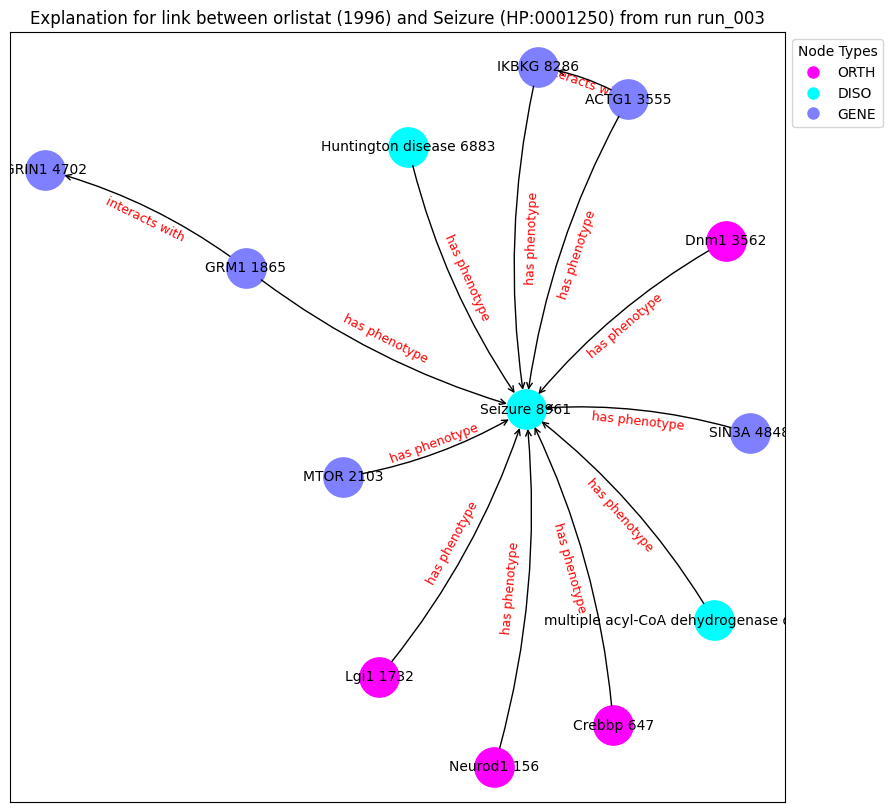

('Neurod1 156', {'type': 'ORTH'})
('Crebbp 647', {'type': 'ORTH'})
('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('Lgi1 1732', {'type': 'ORTH'})
('GRM1 1865', {'type': 'GENE'})
('MTOR 2103', {'type': 'GENE'})
('ACTG1 3555', {'type': 'GENE'})
('Dnm1 3562', {'type': 'ORTH'})
('GRIN1 4702', {'type': 'GENE'})
('SIN3A 4848', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('IKBKG 8286', {'type': 'GENE'})
('Seizure 8961', {'type': 'DISO'})
('Neurod1 156', 'Seizure 8961', {'label': 'has phenotype'})
('Crebbp 647', 'Seizure 8961', {'label': 'has phenotype'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'Seizure 8961', {'label': 'has phenotype'})
('Lgi1 1732', 'Seizure 8961', {'label': 'has phenotype'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('GRM1 1865', 'Seizure 8961', {'label': 'has phenotype'})
('MTOR 2103', 'Seizure 8961', {'label': 'has phenotype'})
('ACTG1 3555', 'IKBKG 8286', {'label': 'interacts with'})
('ACTG1 3555', 'Seiz

Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 140.57it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6360], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 140.28it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6360], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 140.89it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6360], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 141.15it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6360], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 143.77it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6360], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 137.35it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6360], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 136.67it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6360], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 142.30it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6360], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 144.00it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6360], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 142.51it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


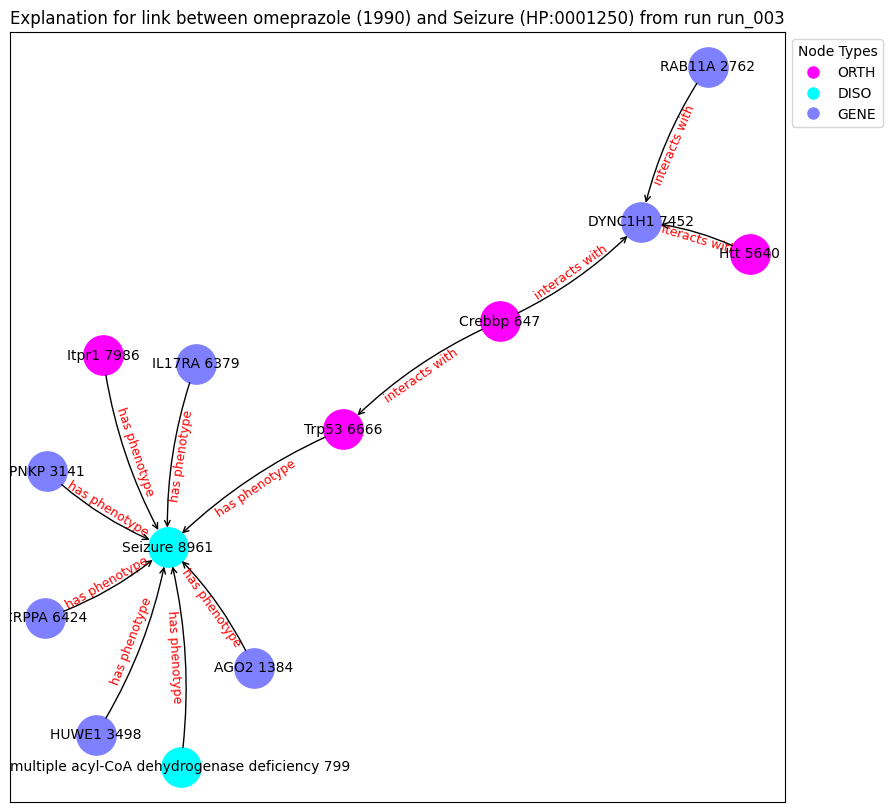

('Crebbp 647', {'type': 'ORTH'})
('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('AGO2 1384', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('IL17RA 6379', {'type': 'GENE'})
('CRPPA 6424', {'type': 'GENE'})
('Trp53 6666', {'type': 'ORTH'})
('DYNC1H1 7452', {'type': 'GENE'})
('Itpr1 7986', {'type': 'ORTH'})
('Seizure 8961', {'type': 'DISO'})
('Crebbp 647', 'Trp53 6666', {'label': 'interacts with'})
('Crebbp 647', 'DYNC1H1 7452', {'label': 'interacts with'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'Seizure 8961', {'label': 'has phenotype'})
('AGO2 1384', 'Seizure 8961', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('PNKP 3141', 'Seizure 8961', {'label': 'has phenotype'})
('HUWE1 3498', 'Seizure 8961', {'label': 'has phenotype'})
('Htt 5640', 'DYNC1H1 7452', {'label': 'interacts with'})
('IL17RA 6379', 'Seizure 8

Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5598], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 237.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5598], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 235.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5598], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5598], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5598], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5598], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5598], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5598], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5598], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 237.17it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
11896     11896  HP:0000737     DISO  Irritability            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.6810], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6810], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 231.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6810], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 221.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6810], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 210.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6810], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 220.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6810], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6810], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6810], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6810], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 213.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6810], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 217.32it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                         label  \
12562     12562  HP:0001262     DISO  Excessive daytime somnolence   

       semantic_id  
12562            1  
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.6312], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6312], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6312], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 227.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6312], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 216.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6312], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 220.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6312], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 218.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6312], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 220.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6312], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 225.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6312], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6312], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 225.95it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic           label  semantic_id
5925      5925  HP:0000738     DISO  Hallucinations            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 204.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 218.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 206.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 218.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 223.80it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic   label  semantic_id
8154      8154  HP:0000741     DISO  Apathy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.5851], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 212.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5851], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5851], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5851], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5851], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5851], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 206.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5851], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 200.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5851], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5851], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5851], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.69it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic   label  semantic_id
9999      9999  HP:0002169     DISO  Clonus            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.6552], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 213.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6552], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6552], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6552], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 229.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6552], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 227.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6552], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 208.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6552], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 211.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6552], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 207.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6552], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 225.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6552], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 204.58it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 243.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 247.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 248.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 235.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 239.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 239.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 246.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:03<00:00, 228.57it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:03<00:00, 221.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 240.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:03<00:00, 229.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 235.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:03<00:00, 224.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 243.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 241.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:03<00:00, 215.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 242.10it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic             label  semantic_id
8158      8158  HP:0002059     DISO  Cerebral atrophy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.23it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.79it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.09it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.42it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.33it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.30it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.77it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 175.23it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.50it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.32it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


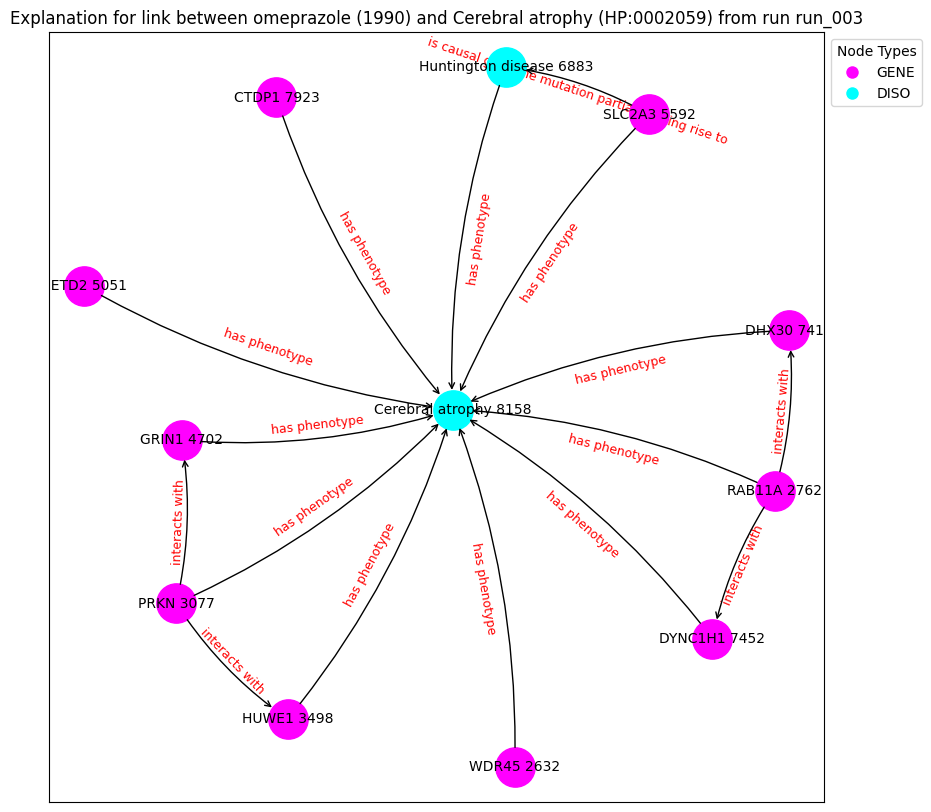

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('Cerebral atrophy 8158', {'type': 'DISO'})
('WDR45 2632', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('HUWE1 3498', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('GRIN1 4702', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('S

Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 177.16it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6461], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.96it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6461], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.00it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6461], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 196.26it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6461], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.16it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6461], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.14it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6461], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.40it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6461], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.76it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6461], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.57it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6461], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.56it/s]


Contribution threshold is tensor(0.0061)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


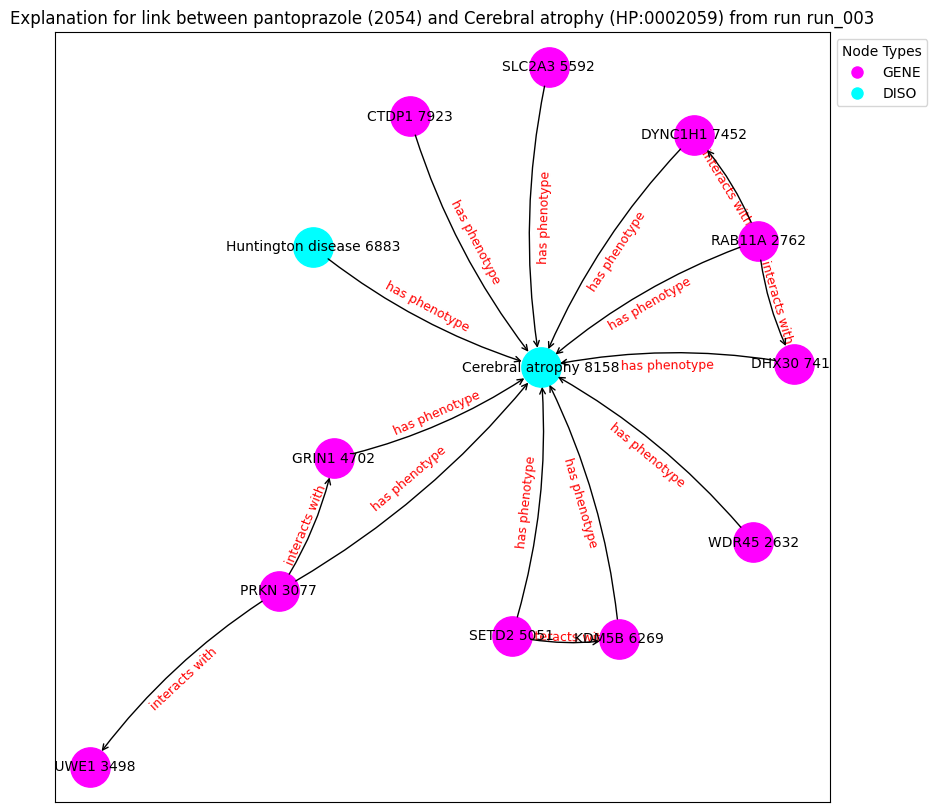

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('Cerebral atrophy 8158', {'type': 'DISO'})
('WDR45 2632', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('GRIN1 4702', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('SETD2 5051', 'KDM5B 6269', {'label':

Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 248.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 229.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 244.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 244.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 242.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 238.90it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic          label  semantic_id
12039     12039  HP:0001347     DISO  Hyperreflexia            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.5947], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 174.56it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5947], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:03<00:00, 176.08it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5947], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 172.30it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5947], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 165.16it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5947], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 174.59it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5947], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 171.66it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5947], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 173.99it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5947], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.54it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5947], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.37it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5947], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.44it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


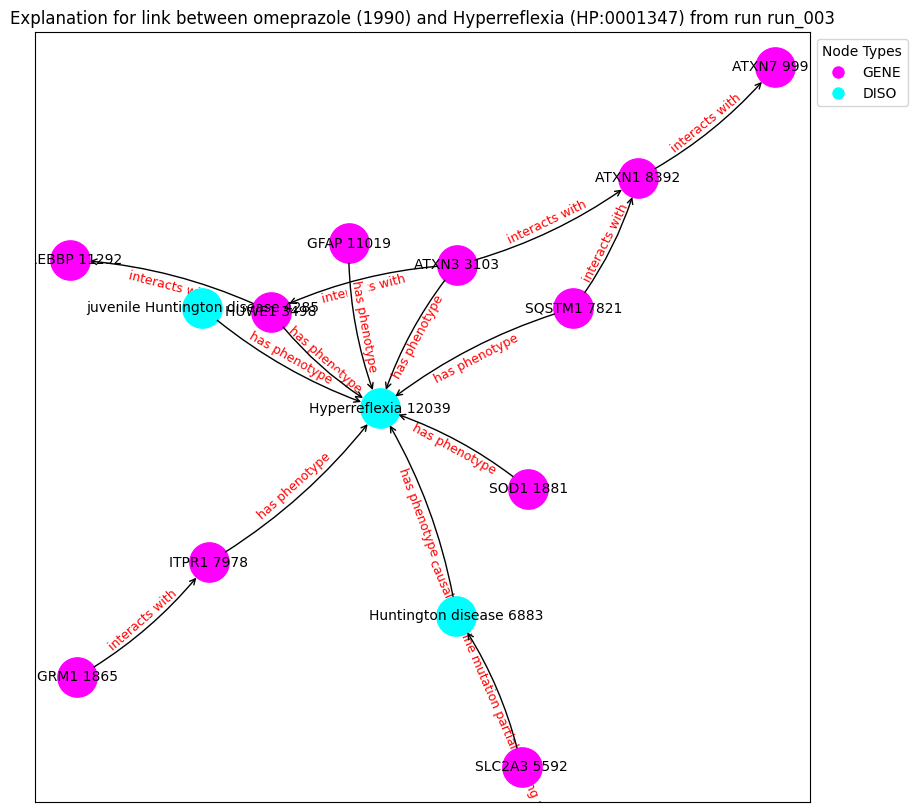

('GRM1 1865', {'type': 'GENE'})
('SOD1 1881', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('ITPR1 7978', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('CREBBP 11292', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('GRM1 1865', 'ITPR1 7978', {'label': 'interacts with'})
('SOD1 1881', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('ATXN3 3103', 'HUWE1 3498', {'label': 'interacts with'})
('ATXN3 3103', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('ATXN3 3103', 'ATXN1 8392', {'label': 'interacts with'})
('HUWE1 3498', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('HUWE1 3498', 'CREBBP 11292', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'Hyperreflexia 12039', {'

Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 167.35it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6313], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 155.08it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6313], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 168.74it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6313], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 172.74it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6313], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 171.54it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6313], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 169.64it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6313], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 172.40it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6313], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 173.25it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6313], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 173.73it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6313], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 162.79it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


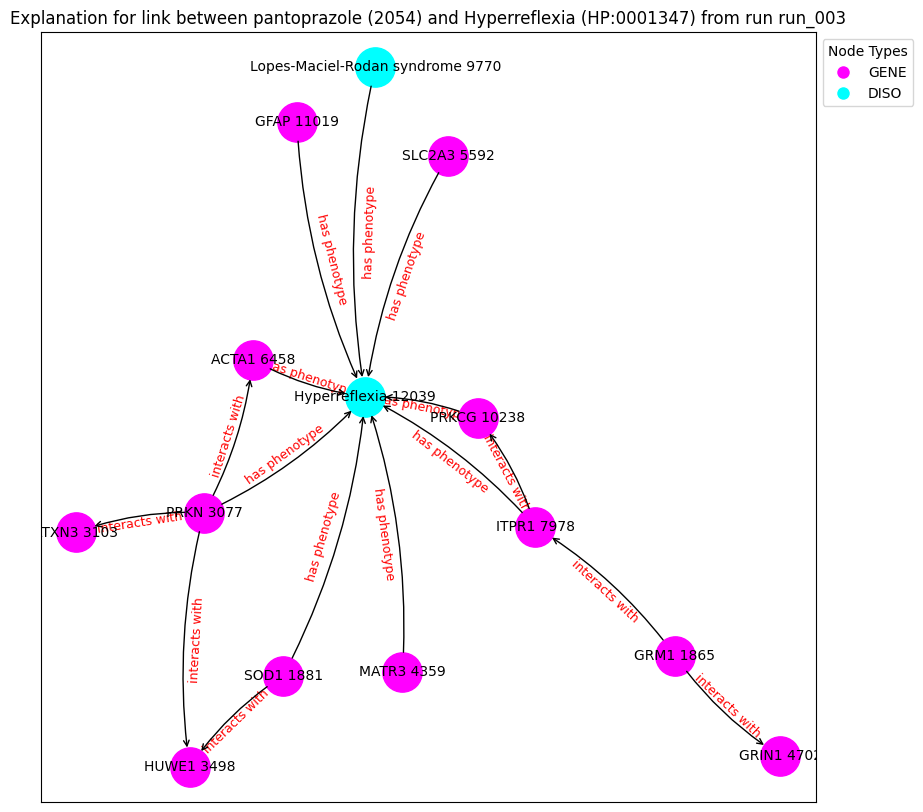

('GRM1 1865', {'type': 'GENE'})
('SOD1 1881', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('MATR3 4359', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('ITPR1 7978', {'type': 'GENE'})
('Lopes-Maciel-Rodan syndrome 9770', {'type': 'DISO'})
('PRKCG 10238', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('GRM1 1865', 'ITPR1 7978', {'label': 'interacts with'})
('SOD1 1881', 'HUWE1 3498', {'label': 'interacts with'})
('SOD1 1881', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('MATR3 4359', 'Hyperreflexia 12039'

Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 196.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7378], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 204.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7378], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 202.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7378], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 191.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7378], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 208.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7378], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 196.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7378], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 201.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7378], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 199.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7378], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 191.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7378], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 198.53it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic     label  semantic_id
13477     13477  HP:0002063     DISO  Rigidity            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.5769], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.85it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.5769], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.92it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.5769], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.30it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5769], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.69it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5769], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.51it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5769], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.91it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5769], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 180.84it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5769], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.82it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.5769], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 180.71it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.5769], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.76it/s]


Contribution threshold is tensor(0.9936)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


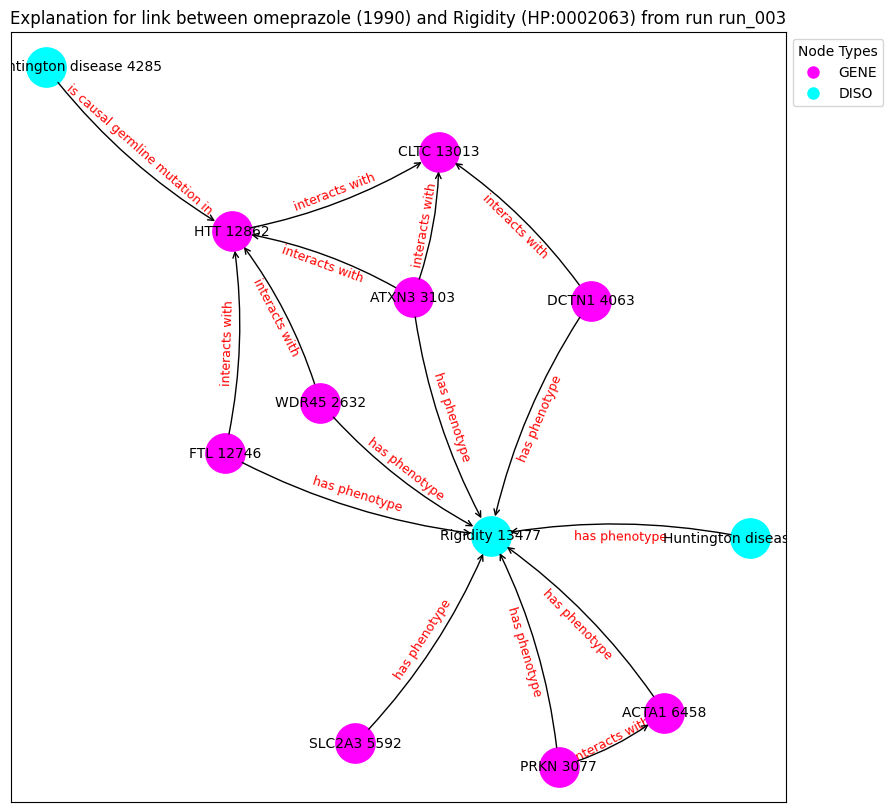

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Rigidity 13477', {'type': 'DISO'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('WDR45 2632', 'Rigidity 13477', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'Rigidity 13477', {'label': 'has phenotype'})
('ATXN3 3103', 'HTT 12862', {'label': 'interacts with'})
('ATXN3 3103', 'CLTC 13013', {'label': 'interacts with'})
('ATXN3 3103', 'Rigidity 13477', {'label': 'has phenotype'})
('DCTN1 4063', 'CLTC 13013', {'label': 'interacts with'})
('DCTN1 4063', 'Rigidity 13477', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 

Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 180.54it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6080], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.01it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6080], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.74it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6080], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.80it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6080], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.64it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6080], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.58it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6080], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.76it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6080], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.52it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6080], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.09it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6080], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 185.82it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


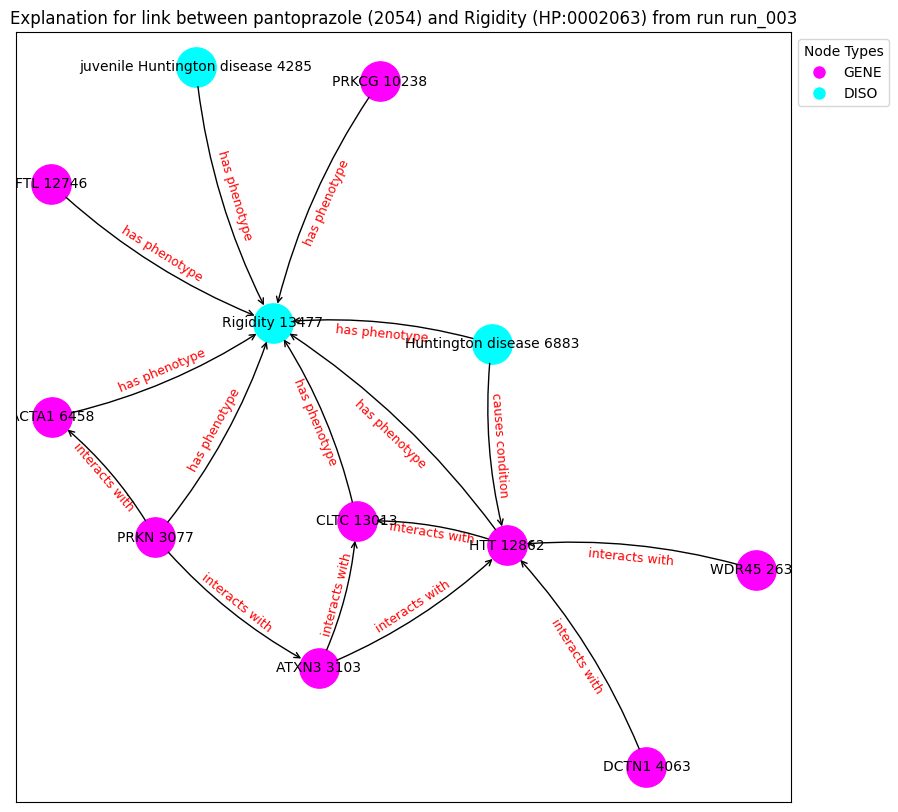

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('PRKCG 10238', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Rigidity 13477', {'type': 'DISO'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'Rigidity 13477', {'label': 'has phenotype'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'HTT 12862', {'label': 'interacts with'})
('ATXN3 3103', 'CLTC 13013', {'label': 'interacts with'})
('DCTN1 4063', 'HTT 12862', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'Rigidity 13477', {'label': 'has phenotype'})
('ACTA1 6458', 'Rigidity 13477', {'label': 'has phenotype'})
('Huntington disease

Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 228.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 229.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 249.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 240.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 248.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 249.21it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                      label  \
434       434  HP:0002500     DISO  Abnormal cerebral white matter morphology   

     semantic_id  
434            1  
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 242.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 242.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 236.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:03<00:00, 230.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:03<00:00, 232.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 236.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 247.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 239.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 238.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:03<00:00, 230.07it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic          label  semantic_id
13239     13239  HP:0003487     DISO  Babinski sign            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.5848], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 172.55it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.5848], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.62it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.5848], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 166.97it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.5848], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.97it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5848], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 179.00it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5848], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.28it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5848], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 169.47it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5848], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 178.72it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5848], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 176.02it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5848], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 178.04it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


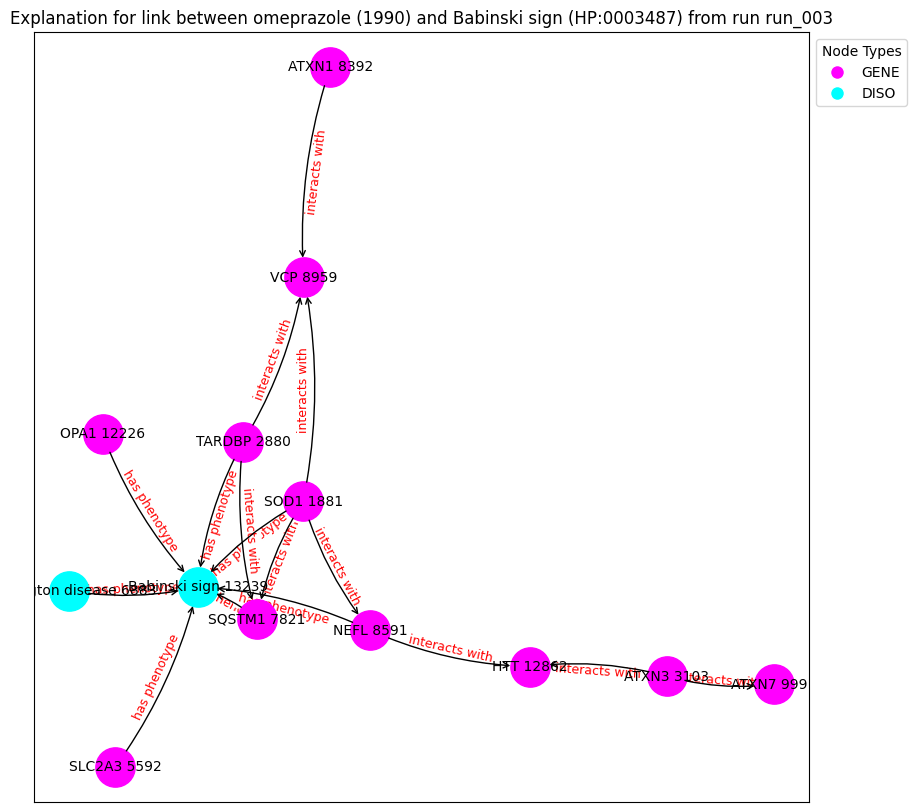

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('OPA1 12226', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Babinski sign 13239', {'type': 'DISO'})
('SOD1 1881', 'SQSTM1 7821', {'label': 'interacts with'})
('SOD1 1881', 'NEFL 8591', {'label': 'interacts with'})
('SOD1 1881', 'VCP 8959', {'label': 'interacts with'})
('SOD1 1881', 'Babinski sign 13239', {'label': 'has phenotype'})
('TARDBP 2880', 'SQSTM1 7821', {'label': 'interacts with'})
('TARDBP 2880', 'VCP 8959', {'label': 'interacts with'})
('TARDBP 2880', 'Babinski sign 13239', {'label': 'has phenotype'})
('ATXN3 3103', 'HTT 12862', {'label': 'interacts with'})
('ATXN3 3103', 'ATXN7 9991', {'label': 'interacts with'})
('SLC2A3 5592', 'B

Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 117.31it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4775], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 125.09it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4775], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 125.92it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4775], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 127.79it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4775], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 126.66it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4775], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 126.76it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4775], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 128.56it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4775], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 129.01it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4775], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 127.20it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4775], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 127.33it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


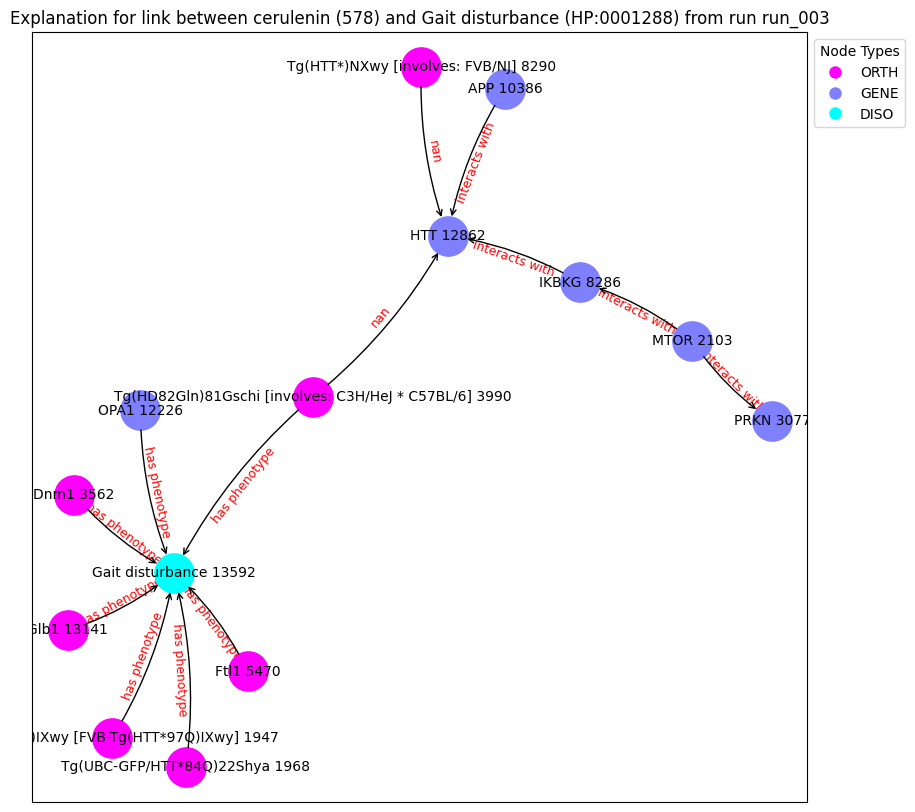

('Tg(HTT*97Q)IXwy [FVB-Tg(HTT*97Q)IXwy] 1947', {'type': 'ORTH'})
('Tg(UBC-GFP/HTT*84Q)22Shya 1968', {'type': 'ORTH'})
('MTOR 2103', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('Dnm1 3562', {'type': 'ORTH'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', {'type': 'ORTH'})
('Ftl1 5470', {'type': 'ORTH'})
('IKBKG 8286', {'type': 'GENE'})
('Tg(HTT*)NXwy [involves: FVB/NJ] 8290', {'type': 'ORTH'})
('APP 10386', {'type': 'GENE'})
('OPA1 12226', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Glb1 13141', {'type': 'ORTH'})
('Gait disturbance 13592', {'type': 'DISO'})
('Tg(HTT*97Q)IXwy [FVB-Tg(HTT*97Q)IXwy] 1947', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Tg(UBC-GFP/HTT*84Q)22Shya 1968', 'Gait disturbance 13592', {'label': 'has phenotype'})
('MTOR 2103', 'PRKN 3077', {'label': 'interacts with'})
('MTOR 2103', 'IKBKG 8286', {'label': 'interacts with'})
('Dnm1 3562', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ 

Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 124.62it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4992], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 129.44it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4992], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 130.28it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4992], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 123.26it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4992], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:06<00:00, 116.41it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4992], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 123.17it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4992], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 123.21it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4992], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 129.11it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4992], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 128.93it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4992], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 127.07it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


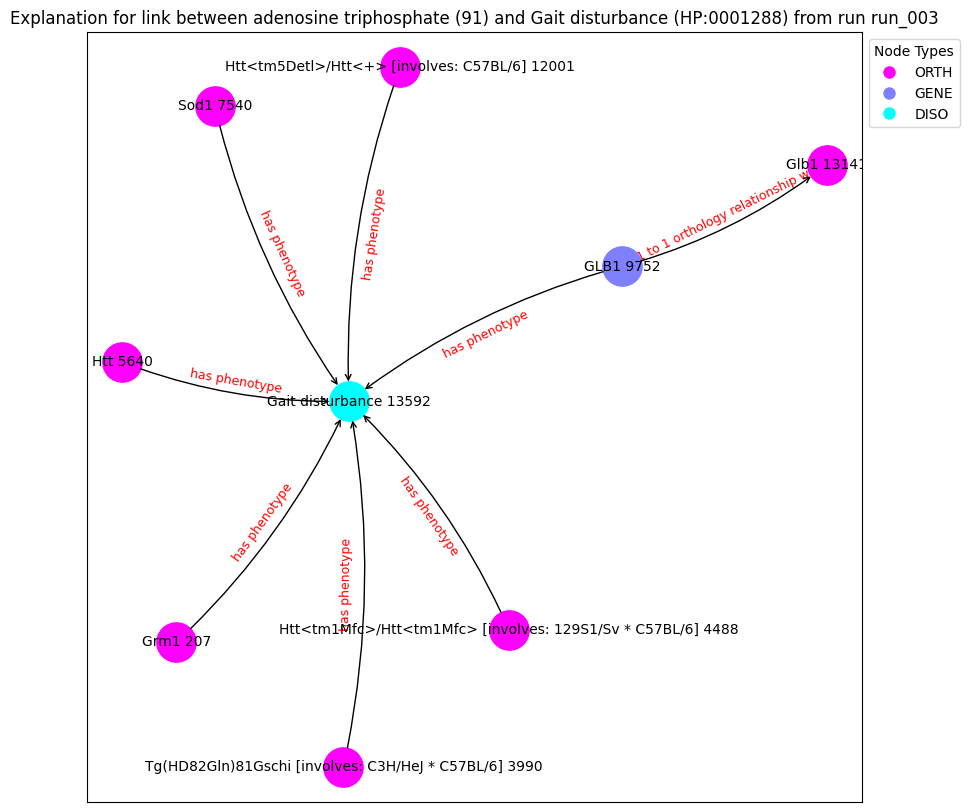

('Grm1 207', {'type': 'ORTH'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', {'type': 'ORTH'})
('Htt<tm1Mfc>/Htt<tm1Mfc> [involves: 129S1/Sv * C57BL/6] 4488', {'type': 'ORTH'})
('Htt 5640', {'type': 'ORTH'})
('Sod1 7540', {'type': 'ORTH'})
('GLB1 9752', {'type': 'GENE'})
('Htt<tm5Detl>/Htt<+> [involves: C57BL/6] 12001', {'type': 'ORTH'})
('Glb1 13141', {'type': 'ORTH'})
('Gait disturbance 13592', {'type': 'DISO'})
('Grm1 207', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Htt<tm1Mfc>/Htt<tm1Mfc> [involves: 129S1/Sv * C57BL/6] 4488', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Htt 5640', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Sod1 7540', 'Gait disturbance 13592', {'label': 'has phenotype'})
('GLB1 9752', 'Gait disturbance 13592', {'label': 'has phenotype'})
('GLB1 9752', 'Glb1 13141', {'label': 'in 1 to 1 orthology relationshi

Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 249.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 250.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 241.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 233.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 245.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 239.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 235.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 233.77it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
1951      1951  HP:0002354     DISO  Memory impairment            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:03<00:00, 225.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 242.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 243.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 244.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 239.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 244.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 233.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 234.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 240.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 243.44it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\run_004
(0, {'node_feature': tensor([-0.2524,  0.9979, -0.3626,  0.2531,  0.1702, -0.3157,  0.1353, -0.1542,
         0.1270,  0.2344,  0.0451, -0.5645,  0.2921,  0.6098,  0.2784,  0.0470,
        -0.0813, -0.7032, -0.1011,  1.3047, -0.6793,  0.1201,  0.0219,  0.1612,
        -0.0400, -0.2617,  0.8612,  0.3038, -0.5448, -0.5828, -0.8219, -0.7686])})
(0, 11953, {'edge_label': 'in orthology relationship with'})
Number of edges is 134749
Number of nodes is 14833
node1:
       index_id          id semantic       label  semantic_id
13668     13668  HP:0000716     DISO  Depression            1
node2:
      index_id    id semantic     label  semantic_id
1000      1000  1996     DRUG  orlistat            2
Prediction from trained model: tensor([0.4966], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 165.46it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4966], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 158.00it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4966], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 166.51it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4966], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 162.84it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4966], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 168.52it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4966], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 167.78it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4966], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 167.87it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4966], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 163.45it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4966], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 168.39it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4966], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 159.45it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


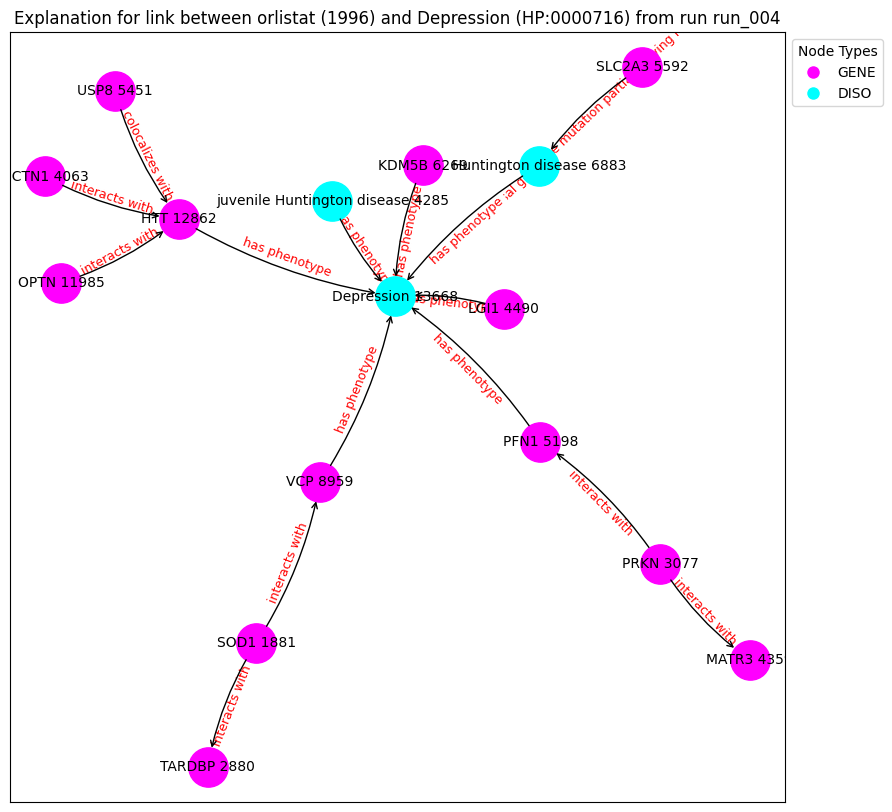

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('MATR3 4359', {'type': 'GENE'})
('LGI1 4490', {'type': 'GENE'})
('PFN1 5198', {'type': 'GENE'})
('USP8 5451', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('VCP 8959', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('SOD1 1881', 'VCP 8959', {'label': 'interacts with'})
('SOD1 1881', 'TARDBP 2880', {'label': 'interacts with'})
('PRKN 3077', 'MATR3 4359', {'label': 'interacts with'})
('PRKN 3077', 'PFN1 5198', {'label': 'interacts with'})
('DCTN1 4063', 'HTT 12862', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'Depression 13668', {'label': 'has phenotype'})
('LGI1 4490', 'Depression 13668', {'label': 'has phenotype'})
('PFN1 

Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:02<00:00, 233.82it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                         label  semantic_id
5086      5086  HP:0040140     DISO  Degeneration of the striatum            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.4920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:02<00:00, 234.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:02<00:00, 237.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 231.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 225.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 228.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 214.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.55it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic     label  semantic_id
12933     12933  HP:0001332     DISO  Dystonia            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.6064], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 151.04it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6064], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 148.09it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6064], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 149.06it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6064], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 147.93it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6064], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 148.85it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6064], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 148.92it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6064], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 144.95it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6064], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 148.39it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6064], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 148.94it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6064], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 149.31it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


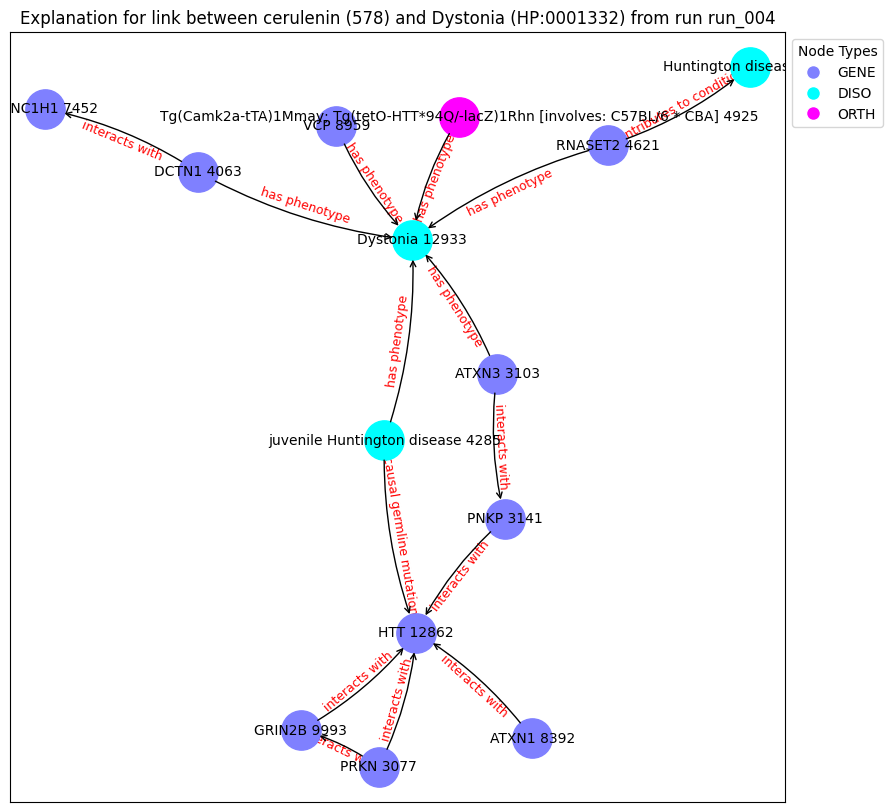

('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('RNASET2 4621', {'type': 'GENE'})
('Tg(Camk2a-tTA)1Mmay; Tg(tetO-HTT*94Q/-lacZ)1Rhn [involves: C57BL/6 * CBA] 4925', {'type': 'ORTH'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Dystonia 12933', {'type': 'DISO'})
('PRKN 3077', 'GRIN2B 9993', {'label': 'interacts with'})
('PRKN 3077', 'HTT 12862', {'label': 'interacts with'})
('ATXN3 3103', 'PNKP 3141', {'label': 'interacts with'})
('ATXN3 3103', 'Dystonia 12933', {'label': 'has phenotype'})
('PNKP 3141', 'HTT 12862', {'label': 'interacts with'})
('DCTN1 4063', 'Dystonia 12933', {'label': 'has phenotype'})
('DCTN1 4063', 'DYNC1H1 7452', {'label': 'interacts with'})
('juvenile Huntington 

Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0561], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 202.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0561], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0561], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0561], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0561], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0561], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0561], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0561], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0561], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.73it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.6195], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 230.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6195], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6195], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 225.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6195], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 206.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6195], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 225.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6195], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6195], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 220.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6195], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6195], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6195], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 225.93it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.5467], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 231.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5467], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 215.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5467], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 196.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5467], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 226.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5467], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 204.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5467], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 227.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5467], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5467], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 219.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5467], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 220.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5467], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 219.90it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.3330], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 204.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3330], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 191.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3330], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 202.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3330], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 202.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3330], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 197.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3330], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 197.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3330], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 197.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3330], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 201.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3330], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 201.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3330], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 190.27it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.3927], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3927], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 201.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3927], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 203.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3927], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 203.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3927], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3927], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 199.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3927], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 200.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3927], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3927], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 201.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3927], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.11it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
11096     11096  HP:0025401     DISO  Staring gaze            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.0637], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0637], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0637], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0637], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0637], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0637], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0637], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0637], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0637], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0637], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.94it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
4670      4670  HP:0031589     DISO  Suicidal ideation            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5691], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5691], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5691], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5691], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5691], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5691], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5691], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5691], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5691], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5691], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.03it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
6571      6571  HP:0031473     DISO  Hostility            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.0532], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:02<00:00, 239.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0532], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0532], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0532], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0532], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0532], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0532], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0532], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0532], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0532], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.59it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                        label  semantic_id
8786      8786  HP:0000496     DISO  Abnormality of eye movement            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.1190], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1190], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1190], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1190], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1190], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 207.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1190], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1190], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1190], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 212.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1190], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1190], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.02it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                        label  semantic_id
8786      8786  HP:0000496     DISO  Abnormality of eye movement            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.2588], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 218.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2588], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 211.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2588], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 206.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2588], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 186.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2588], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 217.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2588], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 211.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2588], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 209.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2588], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 213.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2588], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 206.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2588], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 215.04it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic             label  semantic_id
9177      9177  HP:0030842     DISO  Choking episodes            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.0483], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 232.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0483], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0483], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:02<00:00, 235.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0483], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0483], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0483], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 210.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0483], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0483], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0483], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 212.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0483], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.54it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic         label  semantic_id
7072      7072  HP:0002067     DISO  Bradykinesia            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.4647], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 186.64it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4647], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 175.16it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4647], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 184.00it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.4647], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 178.06it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4647], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 188.52it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4647], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 193.12it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.4647], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 196.62it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4647], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 194.75it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.4647], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 189.78it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.4647], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 180.26it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


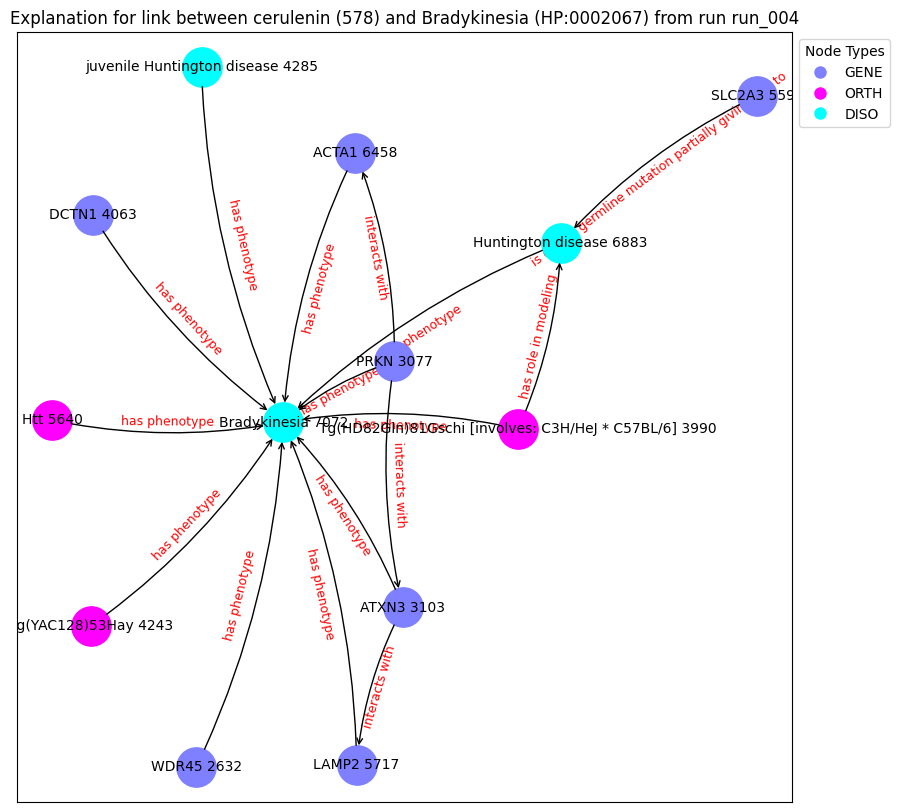

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', {'type': 'ORTH'})
('DCTN1 4063', {'type': 'GENE'})
('Tg(YAC128)53Hay 4243', {'type': 'ORTH'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('LAMP2 5717', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('Bradykinesia 7072', {'type': 'DISO'})
('WDR45 2632', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'Bradykinesia 7072', {'label': 'has phenotype'})
('ATXN3 3103', 'LAMP2 5717', {'label': 'interacts with'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Huntington disease 6883', {'label': 'has role in modelin

Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 182.75it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.5698], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 182.54it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.5698], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 178.96it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5698], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 187.97it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.5698], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 187.41it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.5698], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 187.16it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5698], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 185.42it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5698], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 184.90it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.5698], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 186.67it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.5698], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 186.24it/s]


Contribution threshold is tensor(0.9936)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


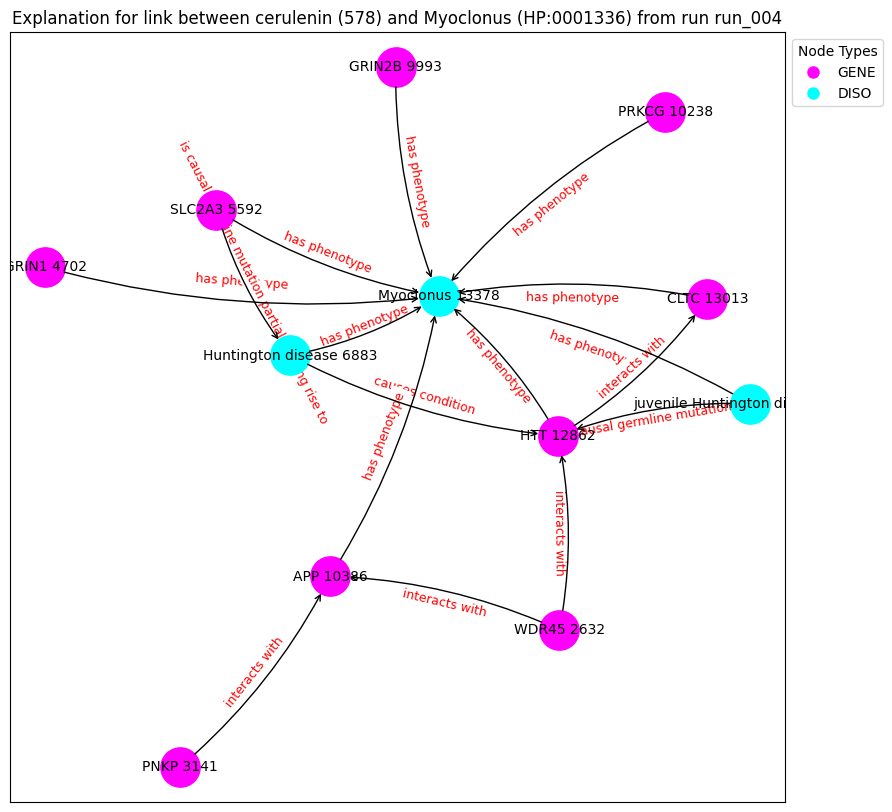

('WDR45 2632', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('GRIN2B 9993', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('APP 10386', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Myoclonus 13378', {'type': 'DISO'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('WDR45 2632', 'APP 10386', {'label': 'interacts with'})
('PNKP 3141', 'APP 10386', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is causal germline mutation in'})
('juvenile Huntington disease 4285', 'Myoclonus 13378', {'label': 'has phenotype'})
('GRIN1 4702', 'Myoclonus 13378', {'label': 'has phenotype'})
('SLC2A3 5592', 'Myoclonus 13378', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partiall

Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 184.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7162], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 206.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7162], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 210.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7162], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 205.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7162], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 209.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7162], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 202.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7162], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 205.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7162], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 207.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7162], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7162], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 201.69it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic       label  semantic_id
2824      2824  HP:0002312     DISO  Clumsiness            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.9928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 242.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 237.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 244.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 242.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 242.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 238.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 239.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 250.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 242.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.62it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic        label  semantic_id
13123     13123  HP:0001824     DISO  Weight loss            1
node2:
     index_id   id semantic      label  semantic_id
350       350  700     DRUG  clomifene            2
Prediction from trained model: tensor([0.5180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 137.89it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 138.18it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 138.80it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 138.86it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 139.53it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 137.83it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 139.39it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 138.55it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 137.77it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5180], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 137.93it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


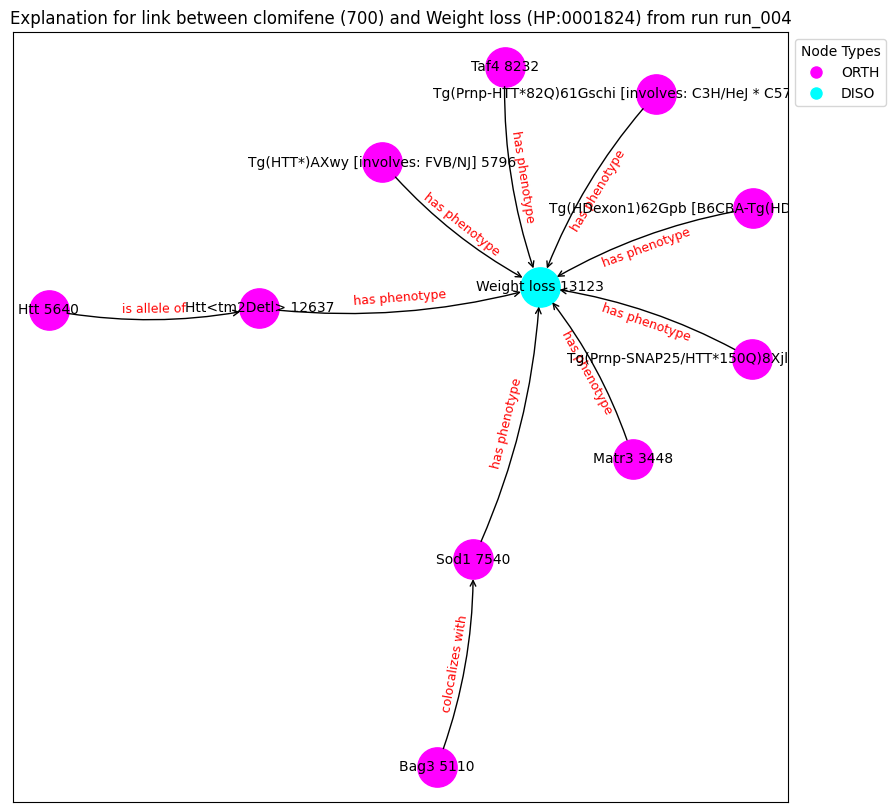

('Matr3 3448', {'type': 'ORTH'})
('Tg(Prnp-SNAP25/HTT*150Q)8Xjl [involves: FVB] 4474', {'type': 'ORTH'})
('Bag3 5110', {'type': 'ORTH'})
('Htt 5640', {'type': 'ORTH'})
('Tg(HTT*)AXwy [involves: FVB/NJ] 5796', {'type': 'ORTH'})
('Sod1 7540', {'type': 'ORTH'})
('Taf4 8232', {'type': 'ORTH'})
('Tg(Prnp-HTT*82Q)61Gschi [involves: C3H/HeJ * C57BL/6J] 10477', {'type': 'ORTH'})
('Htt<tm2Detl> 12637', {'type': 'ORTH'})
('Tg(HDexon1)62Gpb [B6CBA-Tg(HDexon1)62Gpb/1J] 12785', {'type': 'ORTH'})
('Weight loss 13123', {'type': 'DISO'})
('Matr3 3448', 'Weight loss 13123', {'label': 'has phenotype'})
('Tg(Prnp-SNAP25/HTT*150Q)8Xjl [involves: FVB] 4474', 'Weight loss 13123', {'label': 'has phenotype'})
('Bag3 5110', 'Sod1 7540', {'label': 'colocalizes with'})
('Htt 5640', 'Htt<tm2Detl> 12637', {'label': 'is allele of'})
('Tg(HTT*)AXwy [involves: FVB/NJ] 5796', 'Weight loss 13123', {'label': 'has phenotype'})
('Sod1 7540', 'Weight loss 13123', {'label': 'has phenotype'})
('Taf4 8232', 'Weight loss 13123

Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 135.68it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5371], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 131.76it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5371], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:04<00:00, 142.22it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5371], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 139.51it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5371], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 137.35it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5371], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 138.91it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5371], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:04<00:00, 141.61it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5371], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:04<00:00, 140.23it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5371], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:04<00:00, 140.01it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5371], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 137.85it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


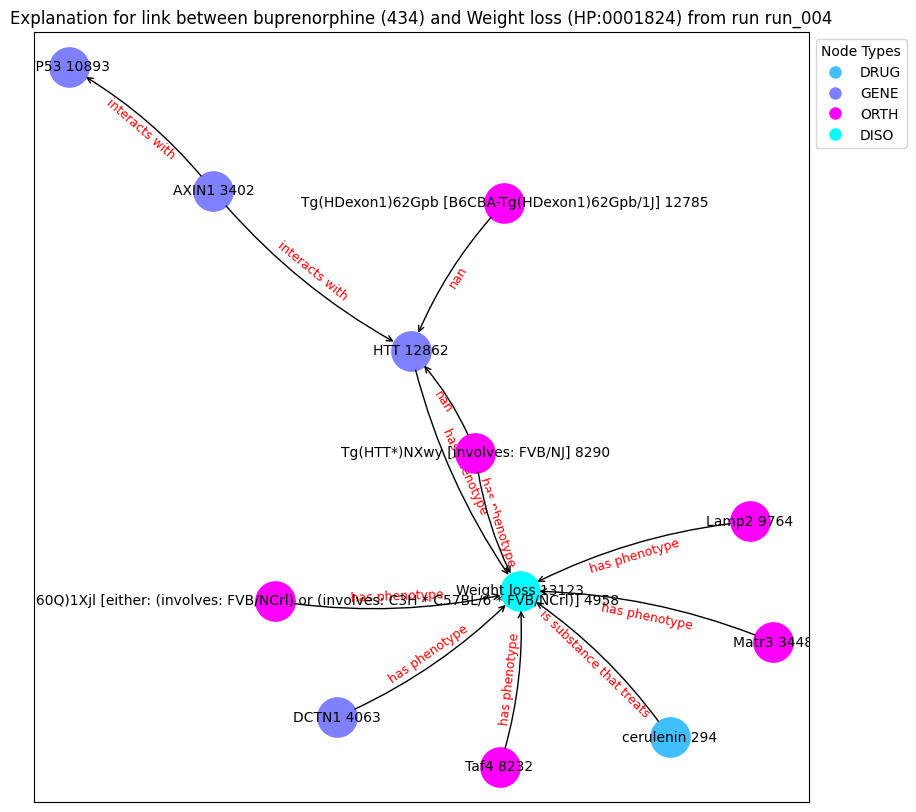

('cerulenin 294', {'type': 'DRUG'})
('AXIN1 3402', {'type': 'GENE'})
('Matr3 3448', {'type': 'ORTH'})
('DCTN1 4063', {'type': 'GENE'})
('Tg(GFAP-HTT*160Q)1Xjl [either: (involves: FVB/NCrl) or (involves: C3H * C57BL/6 * FVB/NCrl)] 4958', {'type': 'ORTH'})
('Taf4 8232', {'type': 'ORTH'})
('Tg(HTT*)NXwy [involves: FVB/NJ] 8290', {'type': 'ORTH'})
('Lamp2 9764', {'type': 'ORTH'})
('TP53 10893', {'type': 'GENE'})
('Tg(HDexon1)62Gpb [B6CBA-Tg(HDexon1)62Gpb/1J] 12785', {'type': 'ORTH'})
('HTT 12862', {'type': 'GENE'})
('Weight loss 13123', {'type': 'DISO'})
('cerulenin 294', 'Weight loss 13123', {'label': 'is substance that treats'})
('AXIN1 3402', 'TP53 10893', {'label': 'interacts with'})
('AXIN1 3402', 'HTT 12862', {'label': 'interacts with'})
('Matr3 3448', 'Weight loss 13123', {'label': 'has phenotype'})
('DCTN1 4063', 'Weight loss 13123', {'label': 'has phenotype'})
('Tg(GFAP-HTT*160Q)1Xjl [either: (involves: FVB/NCrl) or (involves: C3H * C57BL/6 * FVB/NCrl)] 4958', 'Weight loss 13123',

Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 136.47it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6484], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 133.55it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6484], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 134.83it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6484], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 138.46it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6484], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 138.97it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6484], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:04<00:00, 140.95it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6484], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:04<00:00, 141.60it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6484], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 131.50it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6484], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 137.59it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6484], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 137.87it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


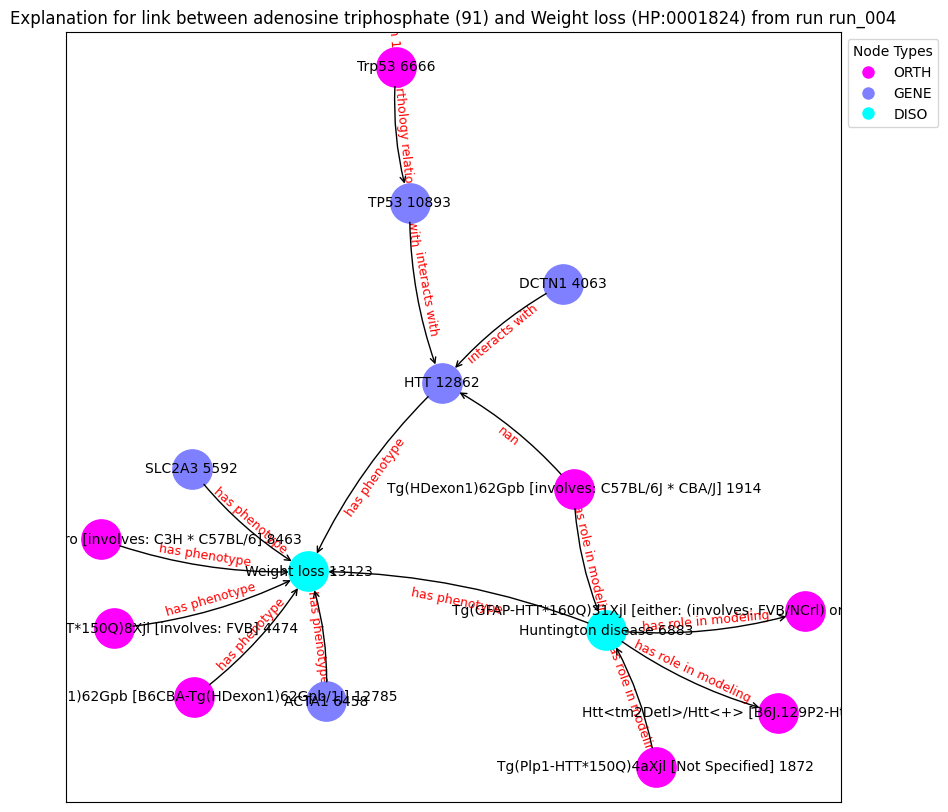

('Tg(Plp1-HTT*150Q)4aXjl [Not Specified] 1872', {'type': 'ORTH'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', {'type': 'ORTH'})
('DCTN1 4063', {'type': 'GENE'})
('Tg(Prnp-SNAP25/HTT*150Q)8Xjl [involves: FVB] 4474', {'type': 'ORTH'})
('SLC2A3 5592', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Trp53 6666', {'type': 'ORTH'})
('Huntington disease 6883', {'type': 'DISO'})
('Tg(Prnp-HTT*82Q)52Caro [involves: C3H * C57BL/6] 8463', {'type': 'ORTH'})
('Htt<tm2Detl>/Htt<+> [B6J.129P2-Htt<tm2Detl>] 9652', {'type': 'ORTH'})
('TP53 10893', {'type': 'GENE'})
('Tg(GFAP-HTT*160Q)31Xjl [either: (involves: FVB/NCrl) or (involves: C3H * C57BL/6 * FVB/NCrl)] 12780', {'type': 'ORTH'})
('Tg(HDexon1)62Gpb [B6CBA-Tg(HDexon1)62Gpb/1J] 12785', {'type': 'ORTH'})
('HTT 12862', {'type': 'GENE'})
('Weight loss 13123', {'type': 'DISO'})
('Tg(Plp1-HTT*150Q)4aXjl [Not Specified] 1872', 'Huntington disease 6883', {'label': 'has role in modeling'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914

Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 207.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.04it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                      label  semantic_id
13978     13978  HP:0200136     DISO  Oral-pharyngeal dysphagia            1
node2:
     index_id    id semantic      label  semantic_id
581       581  1140     DRUG  felbamate            2
Prediction from trained model: tensor([0.4851], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 581: 100%|██████████| 700/700 [00:03<00:00, 199.77it/s]


Contribution threshold is tensor(0.0062)
Explanation found!


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


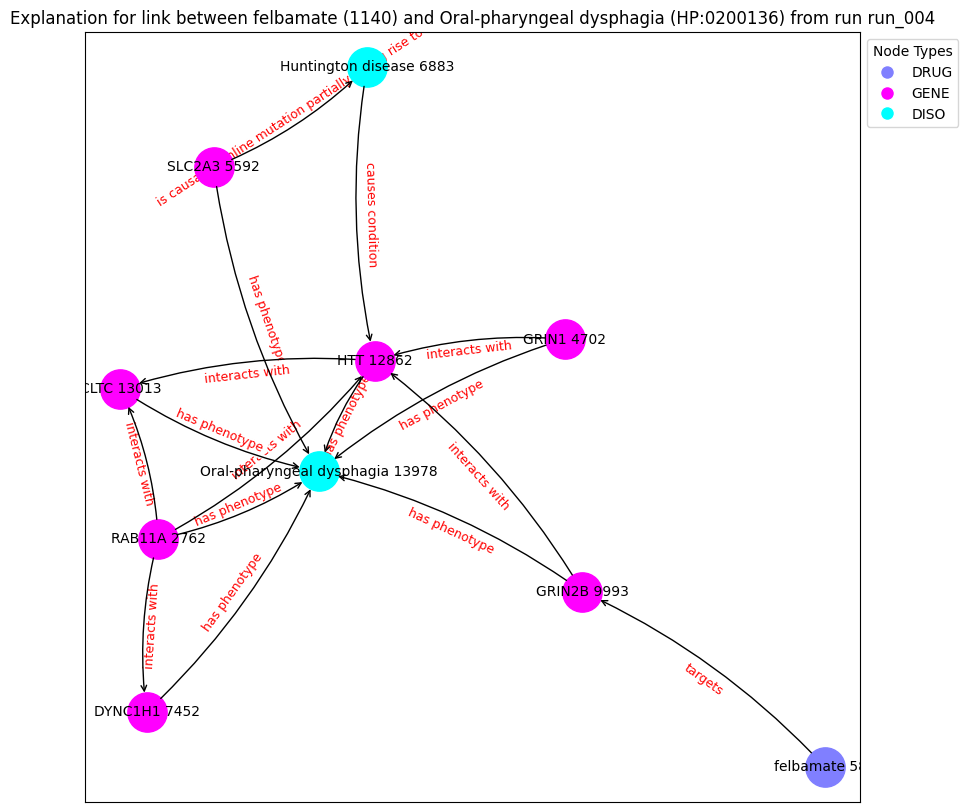

('felbamate 581', {'type': 'DRUG'})
('RAB11A 2762', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Oral-pharyngeal dysphagia 13978', {'type': 'DISO'})
('felbamate 581', 'GRIN2B 9993', {'label': 'targets'})
('RAB11A 2762', 'HTT 12862', {'label': 'interacts with'})
('RAB11A 2762', 'CLTC 13013', {'label': 'interacts with'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('SLC2A3 5592', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenot

Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 137.57it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6616], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 137.65it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6616], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 144.11it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6616], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 145.35it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6616], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 137.27it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6616], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 144.74it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6616], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 143.86it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6616], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 144.84it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6616], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 142.27it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6616], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 140.40it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


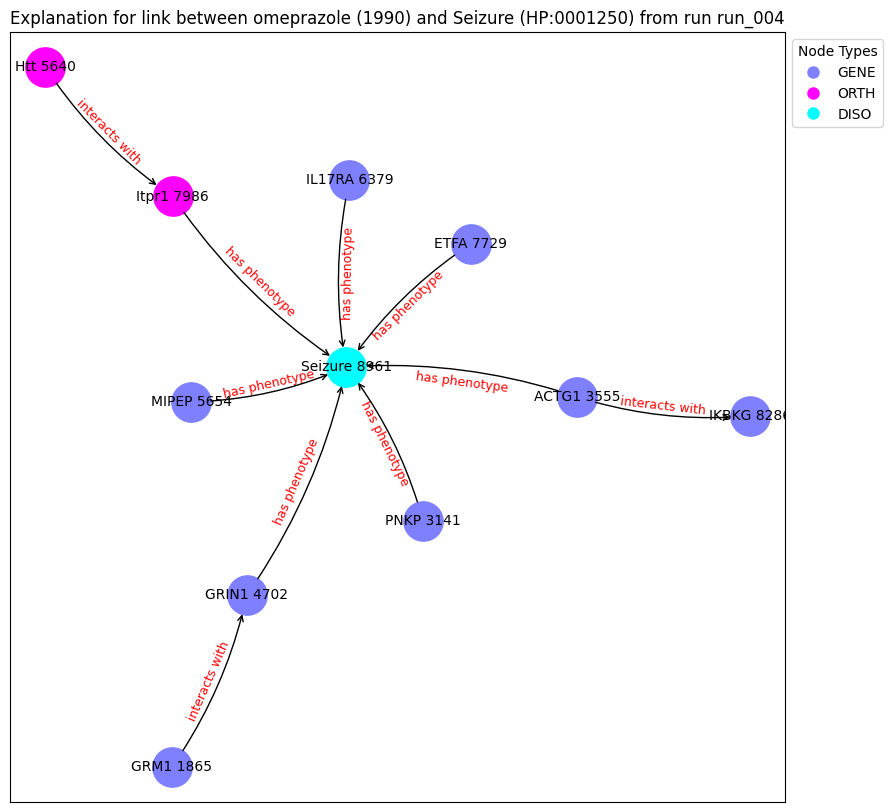

('GRM1 1865', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('ACTG1 3555', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('MIPEP 5654', {'type': 'GENE'})
('IL17RA 6379', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('Itpr1 7986', {'type': 'ORTH'})
('IKBKG 8286', {'type': 'GENE'})
('Seizure 8961', {'type': 'DISO'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('PNKP 3141', 'Seizure 8961', {'label': 'has phenotype'})
('ACTG1 3555', 'IKBKG 8286', {'label': 'interacts with'})
('ACTG1 3555', 'Seizure 8961', {'label': 'has phenotype'})
('GRIN1 4702', 'Seizure 8961', {'label': 'has phenotype'})
('Htt 5640', 'Itpr1 7986', {'label': 'interacts with'})
('MIPEP 5654', 'Seizure 8961', {'label': 'has phenotype'})
('IL17RA 6379', 'Seizure 8961', {'label': 'has phenotype'})
('ETFA 7729', 'Seizure 8961', {'label': 'has phenotype'})
('Itpr1 7986', 'Seizure 8961', {'label': 'has phenotype'})
Explanation graph saved at c:\Users\rosa-\Google Drive\M

Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8850], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8850], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8850], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8850], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8850], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 237.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8850], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 233.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8850], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 233.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8850], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 239.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8850], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 233.52it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
11896     11896  HP:0000737     DISO  Irritability            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.1606], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1606], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1606], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1606], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1606], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1606], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1606], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1606], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1606], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1606], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.54it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
11896     11896  HP:0000737     DISO  Irritability            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.2822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 207.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 218.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 229.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 225.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 217.74it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                             label  \
1317      1317  HP:0009088     DISO  Speech articulation difficulties   

      semantic_id  
1317            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.9955], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 239.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9955], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9955], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 249.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9955], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 254.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9955], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9955], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 248.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9955], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9955], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 246.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9955], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 246.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9955], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 245.13it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
4154      4154  HP:0000746     DISO  Delusions            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.8982], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:03<00:00, 190.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8982], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:03<00:00, 224.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8982], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8982], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8982], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8982], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 247.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8982], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8982], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8982], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8982], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 247.42it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
4154      4154  HP:0000746     DISO  Delusions            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.9868], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9868], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 246.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9868], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 237.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9868], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 246.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9868], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9868], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9868], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 246.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9868], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9868], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9868], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.78it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                         label  \
12562     12562  HP:0001262     DISO  Excessive daytime somnolence   

       semantic_id  
12562            1  
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.3183], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 208.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3183], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3183], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 227.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3183], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3183], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 218.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3183], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3183], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3183], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 229.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3183], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3183], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.71it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic   label  semantic_id
9999      9999  HP:0002169     DISO  Clonus            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.2062], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2062], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 228.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2062], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 229.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2062], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 216.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2062], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 220.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2062], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2062], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 221.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2062], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 221.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2062], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 230.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2062], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 209.42it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic  \
9644      9644  HP:0010794     DISO   

                                             label  semantic_id  
9644  Impaired visuospatial constructive cognition            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.0496], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0496], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0496], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0496], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0496], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0496], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0496], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0496], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0496], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0496], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 211.22it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic              label  semantic_id
14773     14773  HP:0002540     DISO  Inability to walk            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.5977], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 198.46it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5977], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.65it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5977], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.67it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5977], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.19it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5977], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.80it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.5977], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.88it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5977], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 177.66it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5977], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.04it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5977], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.86it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5977], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.37it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


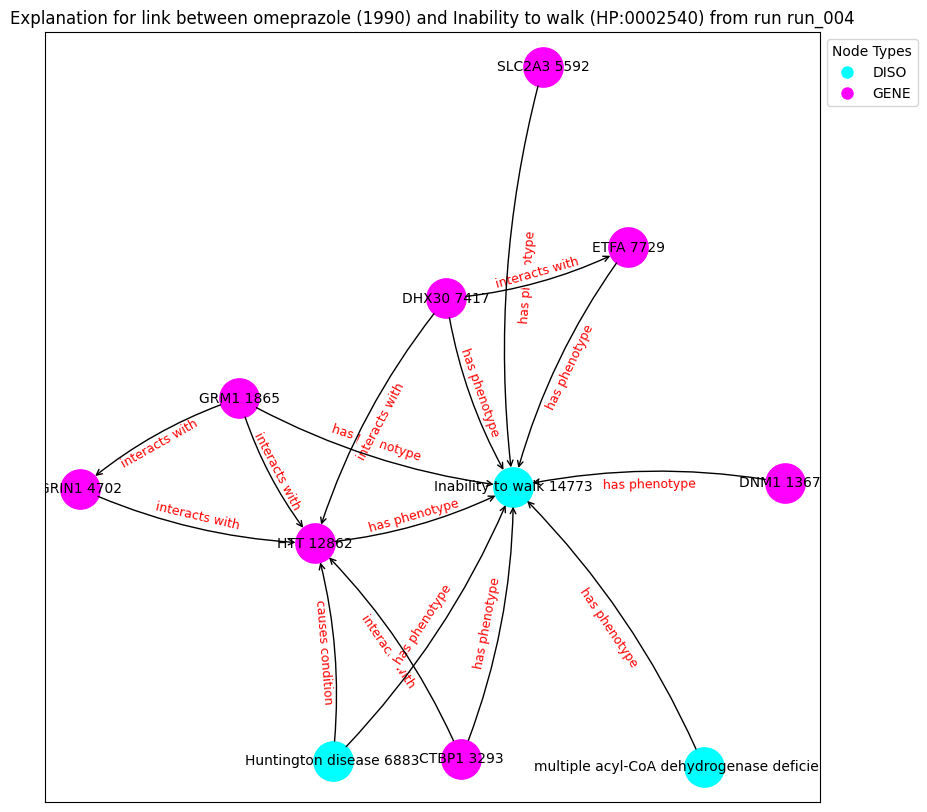

('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('GRM1 1865', {'type': 'GENE'})
('CTBP1 3293', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('DNM1 13672', {'type': 'GENE'})
('Inability to walk 14773', {'type': 'DISO'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRM1 1865', 'HTT 12862', {'label': 'interacts with'})
('GRM1 1865', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('CTBP1 3293', 'HTT 12862', {'label': 'interacts with'})
('CTBP1 3293', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('SLC2A3 5592', 'Inability to walk 14773', {'label': 'has phenotype'})
('Huntington disease 6883', 'HTT 1

Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 183.89it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6010], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 183.46it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6010], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.47it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6010], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 196.94it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6010], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.61it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6010], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.43it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6010], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:04<00:00, 172.53it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6010], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.92it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6010], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.25it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6010], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.01it/s]


Contribution threshold is tensor(0.0062)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


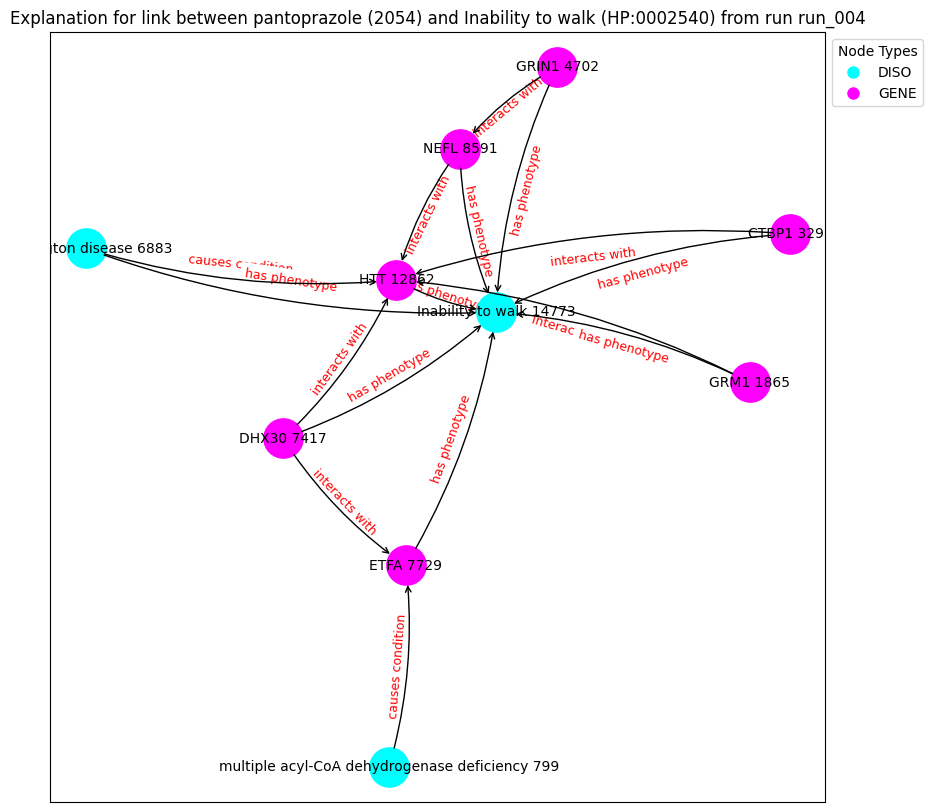

('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('GRM1 1865', {'type': 'GENE'})
('CTBP1 3293', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Inability to walk 14773', {'type': 'DISO'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'ETFA 7729', {'label': 'causes condition'})
('GRM1 1865', 'HTT 12862', {'label': 'interacts with'})
('GRM1 1865', 'Inability to walk 14773', {'label': 'has phenotype'})
('CTBP1 3293', 'HTT 12862', {'label': 'interacts with'})
('CTBP1 3293', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRIN1 4702', 'NEFL 8591', {'label': 'interacts with'})
('GRIN1 4702', 'Inability to walk 14773', {'label': 'has phenotype'})
('Huntington disease 6883', 'HTT 12862', {'label': 'causes condition'})
('Huntington disease 6883', 'Inability to walk 14773', {'label': '

Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9875], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:03<00:00, 212.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9875], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 250.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9875], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9875], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 246.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9875], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:03<00:00, 212.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9875], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9875], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 239.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9875], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 251.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9875], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.42it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                    label  \
917       917  HP:0002529     DISO  Neuronal loss in central nervous system   

     semantic_id  
917            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.9937], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 243.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9937], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9937], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 246.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9937], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 256.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9937], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 246.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9937], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9937], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 246.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9937], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 243.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9937], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9937], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.27it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                    label  \
917       917  HP:0002529     DISO  Neuronal loss in central nervous system   

     semantic_id  
917            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.9980], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 235.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9980], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 246.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9980], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 245.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9980], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9980], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 248.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9980], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9980], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9980], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9980], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 254.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9980], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.15it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 242.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 248.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 242.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 242.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 249.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:03<00:00, 230.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 245.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 257.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 248.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 246.54it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                         label  semantic_id
9801      9801  HP:0007010     DISO  Poor fine motor coordination            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.1104], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1104], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1104], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1104], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1104], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1104], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1104], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1104], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1104], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1104], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 232.11it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic       label  semantic_id
14527     14527  HP:0030955     DISO  Alcoholism            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.0537], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 232.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0537], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0537], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0537], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0537], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 194.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0537], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0537], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0537], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0537], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0537], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 211.22it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic             label  semantic_id
8158      8158  HP:0002059     DISO  Cerebral atrophy            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.4917], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.34it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4917], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.45it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.4917], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.73it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.4917], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 184.29it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4917], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.76it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4917], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.16it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4917], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.54it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4917], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.68it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.4917], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.68it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.4917], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.60it/s]


Contribution threshold is tensor(0.0062)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


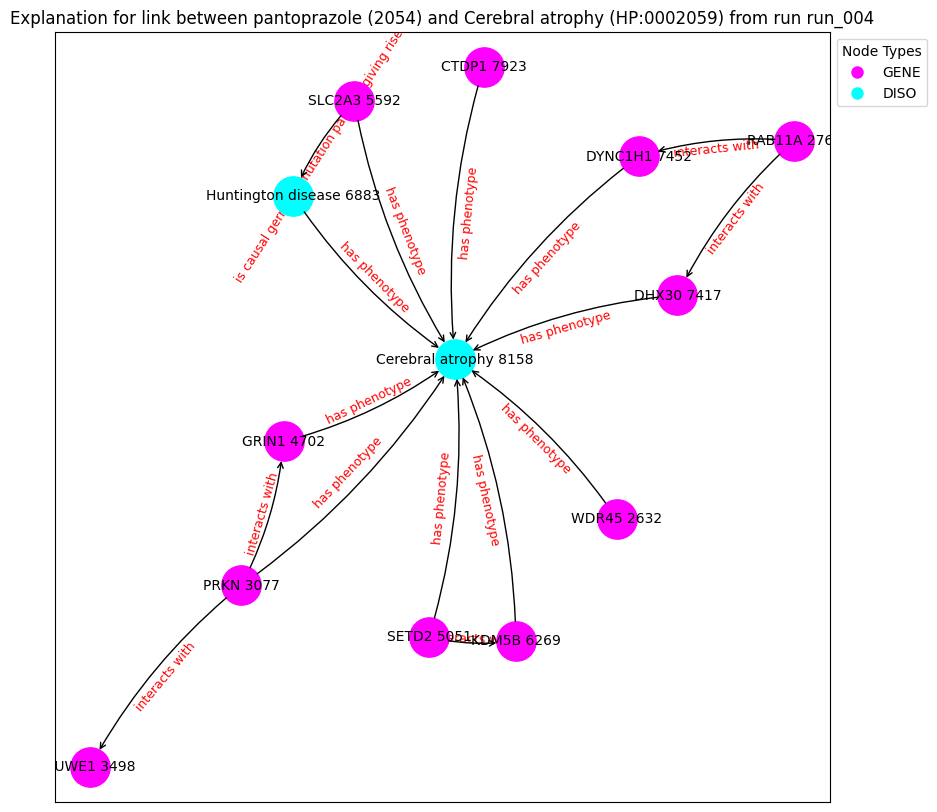

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('Cerebral atrophy 8158', {'type': 'DISO'})
('WDR45 2632', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('GRIN1 4702', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('SETD2 5051', 'KDM5B 6269', {'label': 'interacts with'})
('SETD2 5051', 'Cerebral atrophy 8158', {'label':

Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 177.98it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.00it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.36it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.02it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.32it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.93it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.41it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.50it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.07it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.71it/s]


Contribution threshold is tensor(0.0061)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


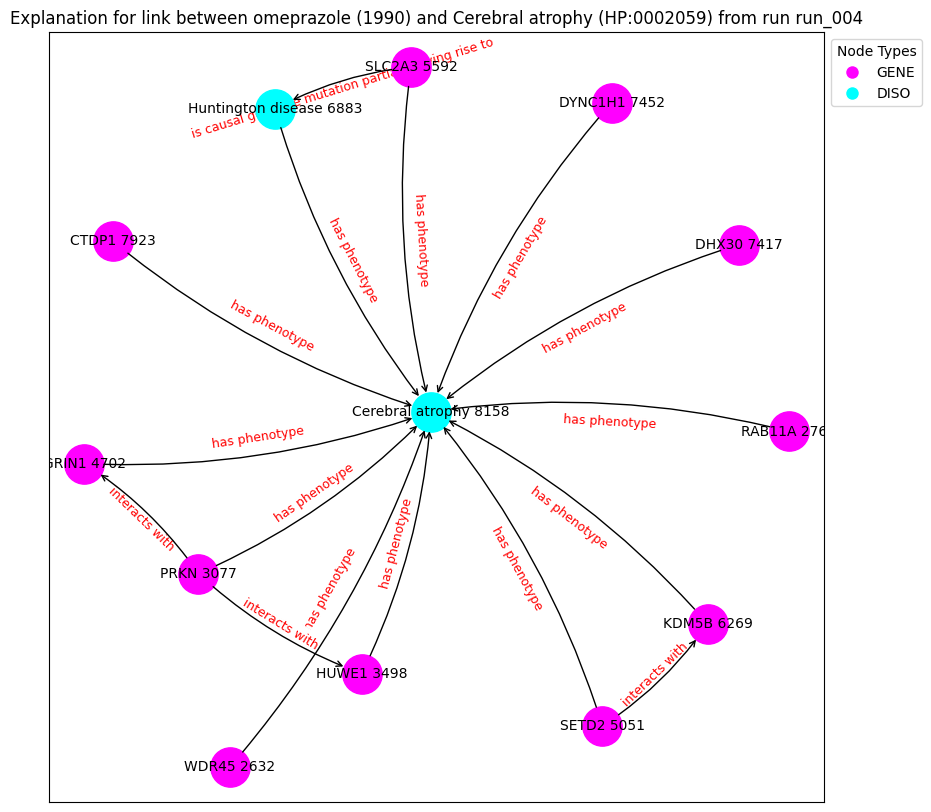

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('Cerebral atrophy 8158', {'type': 'DISO'})
('WDR45 2632', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('HUWE1 3498', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('GRIN1 4702', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('SETD2 5051', 'KDM5B 6269', {'label': 'interacts with'})
('SETD2 5051', 'Cerebral atrophy

Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0705], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0705], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0705], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0705], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0705], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0705], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0705], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 232.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0705], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0705], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 212.79it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                              label  \
12080     12080  HP:0004408     DISO  Abnormality of the sense of smell   

       semantic_id  
12080            1  
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.1533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 212.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 217.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 230.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 216.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 225.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 232.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 218.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 215.39it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic   label  semantic_id
12647     12647  HP:0002300     DISO  Mutism            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.4165], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 206.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4165], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 203.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4165], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 203.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4165], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 189.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4165], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 204.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4165], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 199.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4165], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 202.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4165], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 198.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4165], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 190.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4165], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 191.37it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
1369      1369  HP:0000751     DISO  Personality changes            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.9910], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 244.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9910], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 239.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9910], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9910], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 245.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9910], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 251.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9910], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 241.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9910], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 248.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9910], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9910], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:03<00:00, 210.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9910], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.92it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
1369      1369  HP:0000751     DISO  Personality changes            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.9962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 246.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 253.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 253.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 241.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 237.90it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
13783     13783  HP:0031843     DISO  Bradyphrenia            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.0578], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0578], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0578], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0578], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0578], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0578], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0578], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0578], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0578], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0578], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.04it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic            label  semantic_id
830       830  HP:0002340     DISO  Caudate atrophy            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.9885], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 251.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9885], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 241.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9885], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 244.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9885], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 247.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9885], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9885], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 253.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9885], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9885], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9885], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9885], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 253.60it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic            label  semantic_id
830       830  HP:0002340     DISO  Caudate atrophy            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.8929], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8929], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8929], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8929], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8929], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 241.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8929], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 260.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8929], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8929], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8929], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 254.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8929], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 245.65it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic             label  semantic_id
13592     13592  HP:0001288     DISO  Gait disturbance            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.8110], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 129.83it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.8110], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 131.25it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.8110], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 131.04it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.8110], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 129.48it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.8110], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 128.51it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.8110], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 127.77it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.8110], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 128.27it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.8110], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 129.92it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.8110], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 129.83it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.8110], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 129.01it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


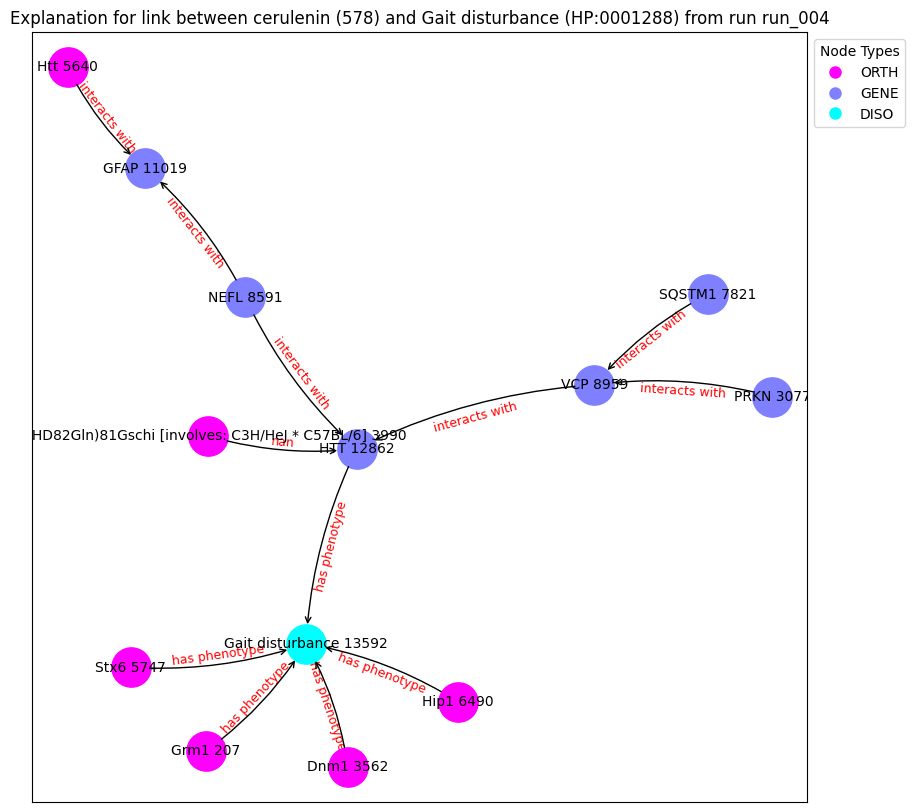

('Grm1 207', {'type': 'ORTH'})
('PRKN 3077', {'type': 'GENE'})
('Dnm1 3562', {'type': 'ORTH'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', {'type': 'ORTH'})
('Htt 5640', {'type': 'ORTH'})
('Stx6 5747', {'type': 'ORTH'})
('Hip1 6490', {'type': 'ORTH'})
('SQSTM1 7821', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Gait disturbance 13592', {'type': 'DISO'})
('Grm1 207', 'Gait disturbance 13592', {'label': 'has phenotype'})
('PRKN 3077', 'VCP 8959', {'label': 'interacts with'})
('Dnm1 3562', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'HTT 12862', {'label': nan})
('Htt 5640', 'GFAP 11019', {'label': 'interacts with'})
('Stx6 5747', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Hip1 6490', 'Gait disturbance 13592', {'label': 'has phenotype'})
('SQSTM1 7821', 'VCP 8959', {'label': 'interacts with'})
(

Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 253.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 244.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 246.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 246.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 248.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 235.72it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\run_005
(0, {'node_feature': tensor([-0.0614, -0.1968,  0.0830,  0.5828, -0.0151,  0.4354, -0.4066,  0.5215,
        -0.2219, -0.4668, -1.1477, -0.2054, -0.0063,  0.2815, -0.4800, -0.3343,
         0.0192, -1.3524, -0.0229, -0.4111, -0.8789,  0.5231,  0.5531, -0.2778,
        -0.5724, -1.0235,  0.5599,  0.2300,  0.5511, -0.7767,  0.3050,  0.2750])})
(0, 11953, {'edge_label': 'in orthology relationship with'})
Number of edges is 134749
Number of nodes is 14833
node1:
       index_id          id semantic       label  semantic_id
13668     13668  HP:0000716     DISO  Depression            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.4006], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 157.09it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4006], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 164.69it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4006], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 164.24it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4006], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 166.82it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4006], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 158.77it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4006], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 166.17it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4006], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 163.37it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4006], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 164.79it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4006], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 167.70it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4006], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 168.32it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


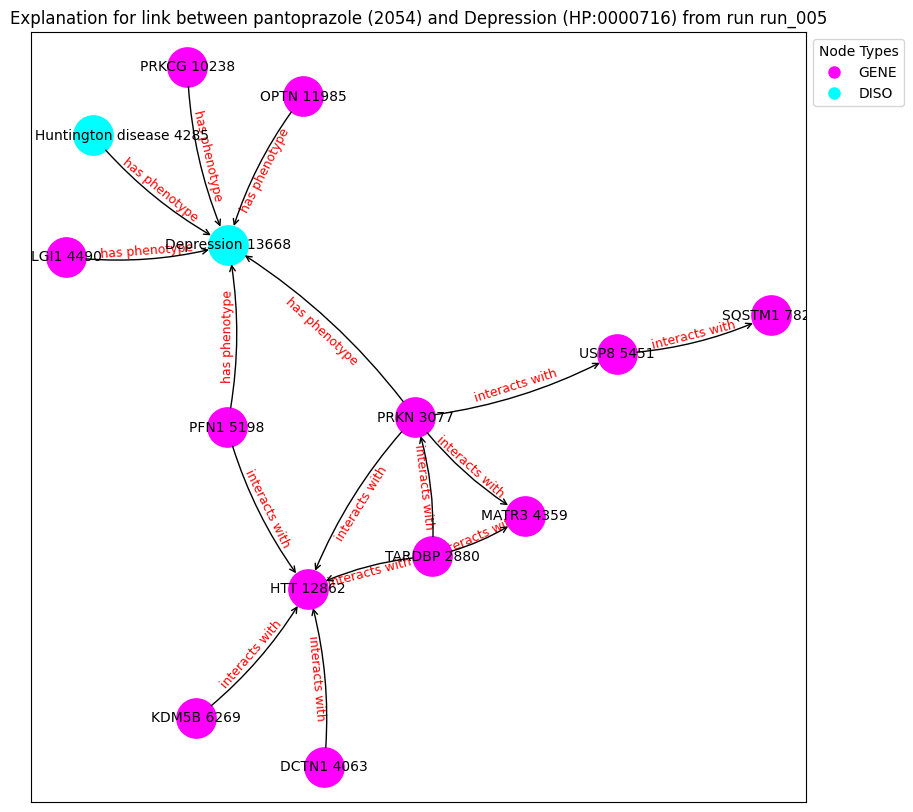

('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('MATR3 4359', {'type': 'GENE'})
('LGI1 4490', {'type': 'GENE'})
('PFN1 5198', {'type': 'GENE'})
('USP8 5451', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('TARDBP 2880', 'PRKN 3077', {'label': 'interacts with'})
('TARDBP 2880', 'HTT 12862', {'label': 'interacts with'})
('TARDBP 2880', 'MATR3 4359', {'label': 'interacts with'})
('PRKN 3077', 'HTT 12862', {'label': 'interacts with'})
('PRKN 3077', 'MATR3 4359', {'label': 'interacts with'})
('PRKN 3077', 'Depression 13668', {'label': 'has phenotype'})
('PRKN 3077', 'USP8 5451', {'label': 'interacts with'})
('DCTN1 4063', 'HTT 12862', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'Depression 

Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 164.16it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3063], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 166.06it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3063], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 166.01it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3063], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 167.98it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3063], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 169.98it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3063], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 168.11it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3063], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 170.37it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3063], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 170.70it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3063], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 167.43it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3063], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 164.98it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


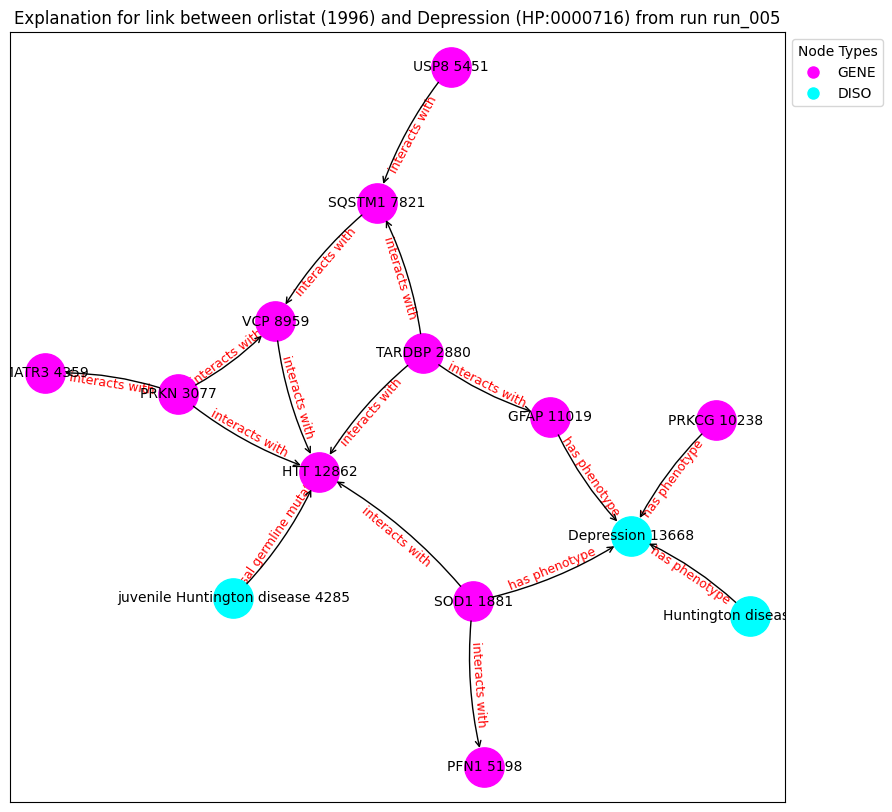

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('MATR3 4359', {'type': 'GENE'})
('PFN1 5198', {'type': 'GENE'})
('USP8 5451', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('SOD1 1881', 'HTT 12862', {'label': 'interacts with'})
('SOD1 1881', 'PFN1 5198', {'label': 'interacts with'})
('SOD1 1881', 'Depression 13668', {'label': 'has phenotype'})
('TARDBP 2880', 'SQSTM1 7821', {'label': 'interacts with'})
('TARDBP 2880', 'HTT 12862', {'label': 'interacts with'})
('TARDBP 2880', 'GFAP 11019', {'label': 'interacts with'})
('PRKN 3077', 'HTT 12862', {'label': 'interacts with'})
('PRKN 3077', 'VCP 8959', {'label': 'interacts with'})
('PRKN 3077', 'MATR3 4359', {'label': '

Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 220.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5786], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5786], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5786], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5786], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5786], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:02<00:00, 237.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5786], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 232.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5786], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5786], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5786], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 219.83it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                         label  semantic_id
5086      5086  HP:0040140     DISO  Degeneration of the striatum            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.4425], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4425], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 232.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4425], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4425], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:02<00:00, 236.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4425], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:02<00:00, 236.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4425], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 232.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4425], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4425], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:02<00:00, 236.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4425], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:02<00:00, 233.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4425], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 212.93it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic     label  semantic_id
12933     12933  HP:0001332     DISO  Dystonia            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.1391], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 150.51it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1391], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 150.56it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1391], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 149.73it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1391], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 149.47it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1391], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 149.07it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1391], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 150.39it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.1391], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 150.87it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.1391], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 144.72it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1391], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 151.35it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.1391], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 149.13it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


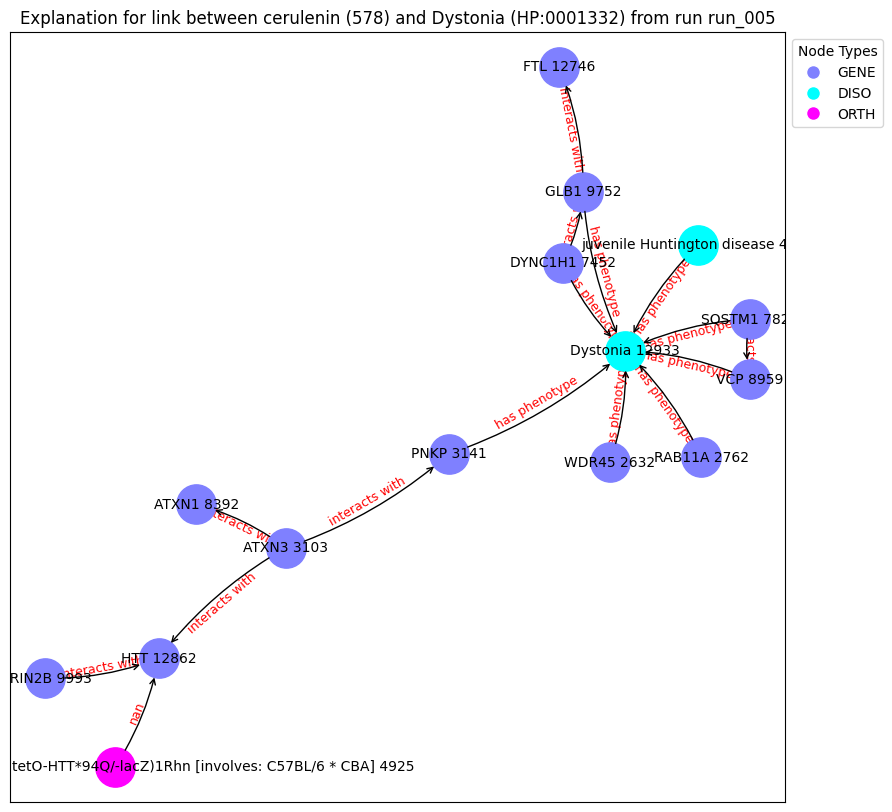

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('Tg(Camk2a-tTA)1Mmay; Tg(tetO-HTT*94Q/-lacZ)1Rhn [involves: C57BL/6 * CBA] 4925', {'type': 'ORTH'})
('DYNC1H1 7452', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('GLB1 9752', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Dystonia 12933', {'type': 'DISO'})
('WDR45 2632', 'Dystonia 12933', {'label': 'has phenotype'})
('RAB11A 2762', 'Dystonia 12933', {'label': 'has phenotype'})
('ATXN3 3103', 'HTT 12862', {'label': 'interacts with'})
('ATXN3 3103', 'PNKP 3141', {'label': 'interacts with'})
('ATXN3 3103', 'ATXN1 8392', {'label': 'interacts with'})
('PNKP 3141', 'Dystonia 12933', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'Dystonia 12933', {'

Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 230.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 230.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 249.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 242.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 241.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 248.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 241.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 240.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 251.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 250.06it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic            label  semantic_id
14311     14311  HP:0031845     DISO  Abnormal libido            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.4837], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4837], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 224.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4837], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4837], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4837], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 224.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4837], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 213.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4837], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4837], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4837], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4837], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 220.65it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic            label  semantic_id
14311     14311  HP:0031845     DISO  Abnormal libido            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 232.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 206.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.25it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.2101], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 229.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2101], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 216.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2101], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 225.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2101], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 224.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2101], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 228.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2101], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 222.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2101], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 226.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2101], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2101], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 225.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2101], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:02<00:00, 241.83it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.1914], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 223.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1914], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1914], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1914], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 230.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1914], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 215.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1914], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 230.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1914], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 230.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1914], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 231.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1914], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 218.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1914], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.23it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.2179], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 204.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2179], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 207.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2179], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 207.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2179], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 195.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2179], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 208.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2179], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 207.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2179], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 204.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2179], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 199.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2179], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 202.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2179], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 200.60it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.2193], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 207.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2193], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 208.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2193], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2193], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 204.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2193], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 209.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2193], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 203.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2193], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 203.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2193], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 203.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2193], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 204.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2193], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 210.95it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
11096     11096  HP:0025401     DISO  Staring gaze            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.3403], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3403], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3403], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3403], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3403], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3403], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3403], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3403], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3403], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3403], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.35it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
6473      6473  HP:0001272     DISO  Cerebellar atrophy            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.2187], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2187], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 183.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2187], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 196.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2187], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 196.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2187], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2187], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 201.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2187], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2187], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2187], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 196.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2187], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 199.48it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
6473      6473  HP:0001272     DISO  Cerebellar atrophy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.2312], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 179.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2312], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2312], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2312], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 198.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2312], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 199.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2312], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2312], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 200.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2312], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 198.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2312], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2312], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 183.65it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
4670      4670  HP:0031589     DISO  Suicidal ideation            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.5082], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:02<00:00, 235.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5082], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5082], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5082], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 232.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5082], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5082], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5082], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5082], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5082], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5082], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.07it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
4670      4670  HP:0031589     DISO  Suicidal ideation            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.3831], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3831], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3831], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3831], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3831], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3831], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3831], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3831], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3831], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3831], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:02<00:00, 237.20it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic        label  semantic_id
2028      2028  HP:0002066     DISO  Gait ataxia            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.3308], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:02<00:00, 235.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3308], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 232.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3308], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 224.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3308], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 230.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3308], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 228.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3308], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 225.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3308], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 226.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3308], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 226.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3308], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 213.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3308], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 231.10it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
6571      6571  HP:0031473     DISO  Hostility            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.5735], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5735], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:02<00:00, 233.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5735], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5735], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:02<00:00, 237.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5735], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 232.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5735], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:02<00:00, 233.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5735], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5735], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 232.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5735], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 218.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5735], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:02<00:00, 237.71it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
6571      6571  HP:0031473     DISO  Hostility            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5439], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:02<00:00, 235.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5439], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:02<00:00, 236.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5439], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5439], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:02<00:00, 237.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5439], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5439], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5439], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:02<00:00, 237.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5439], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5439], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5439], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.63it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                        label  semantic_id
8786      8786  HP:0000496     DISO  Abnormality of eye movement            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.2426], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2426], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2426], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2426], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2426], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2426], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2426], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2426], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2426], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2426], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.38it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic             label  semantic_id
9177      9177  HP:0030842     DISO  Choking episodes            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.4784], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4784], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4784], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4784], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4784], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4784], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 189.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4784], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 207.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4784], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4784], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 214.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4784], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 229.52it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic             label  semantic_id
9177      9177  HP:0030842     DISO  Choking episodes            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.6157], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6157], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6157], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:02<00:00, 233.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6157], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6157], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6157], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6157], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6157], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6157], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:02<00:00, 239.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6157], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:02<00:00, 235.29it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic         label  semantic_id
7072      7072  HP:0002067     DISO  Bradykinesia            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.2620], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 192.75it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.2620], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 192.20it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.2620], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 189.47it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.2620], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 191.87it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.2620], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 190.68it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2620], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 183.92it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.2620], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 190.67it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.2620], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 196.08it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.2620], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 192.55it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.2620], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 193.09it/s]


Contribution threshold is tensor(0.0061)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


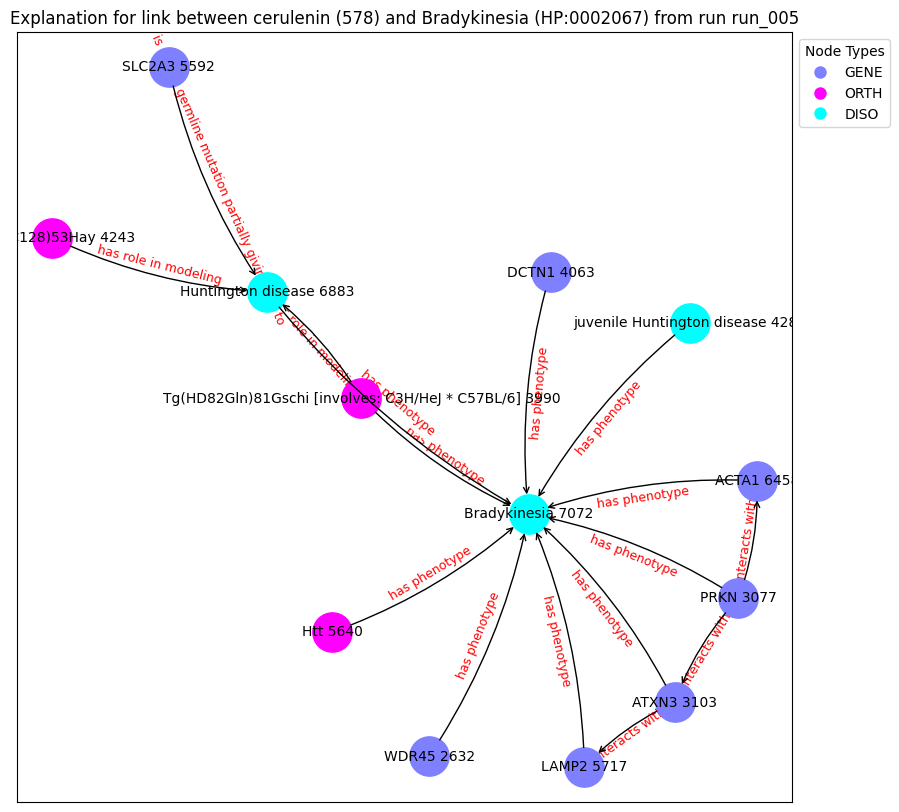

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', {'type': 'ORTH'})
('DCTN1 4063', {'type': 'GENE'})
('Tg(YAC128)53Hay 4243', {'type': 'ORTH'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('LAMP2 5717', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('Bradykinesia 7072', {'type': 'DISO'})
('WDR45 2632', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'Bradykinesia 7072', {'label': 'has phenotype'})
('ATXN3 3103', 'LAMP2 5717', {'label': 'interacts with'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Huntington disease 6883', {'label': 'has role in modelin

Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 183.49it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.3920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 181.38it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.3920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 190.86it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.3920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 179.79it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.3920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 188.49it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.3920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 191.10it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.3920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 194.64it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.3920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 193.67it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.3920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 197.31it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.3920], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 198.26it/s]


Contribution threshold is tensor(0.0061)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


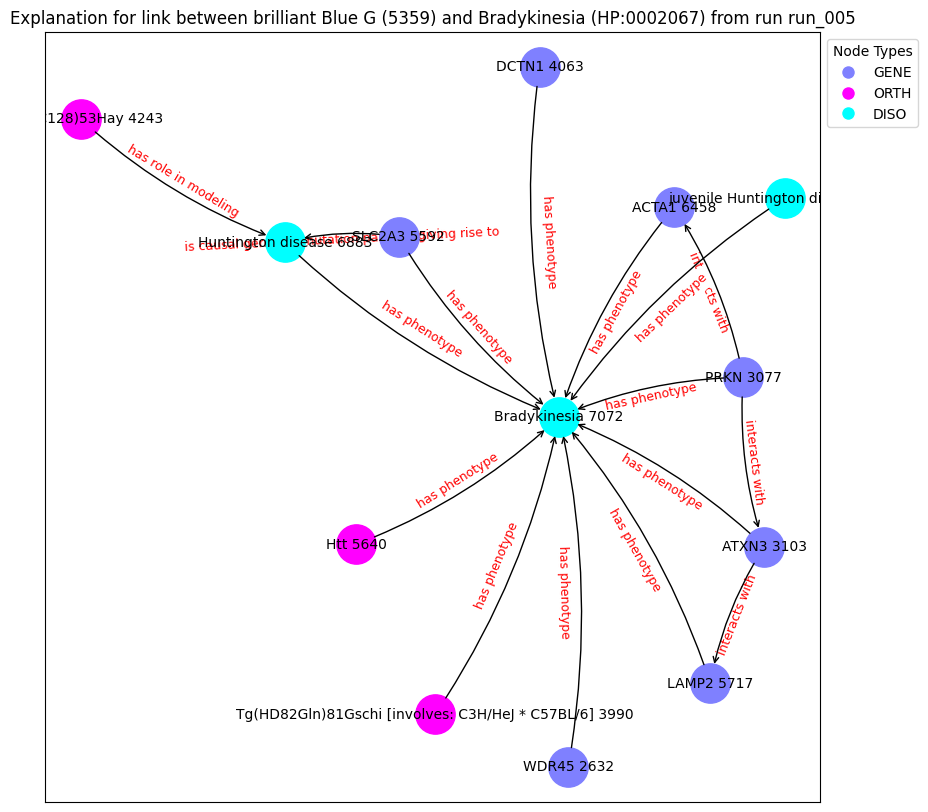

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', {'type': 'ORTH'})
('DCTN1 4063', {'type': 'GENE'})
('Tg(YAC128)53Hay 4243', {'type': 'ORTH'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('LAMP2 5717', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('Bradykinesia 7072', {'type': 'DISO'})
('WDR45 2632', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'Bradykinesia 7072', {'label': 'has phenotype'})
('ATXN3 3103', 'LAMP2 5717', {'label': 'interacts with'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Bradykinesia 7072', {'label': 'has phenotype'})
('DCTN1 

Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 177.26it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.1761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:04<00:00, 173.04it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.1761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 187.51it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.1761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 187.29it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.1761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 186.48it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 187.03it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 185.62it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.1761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 179.36it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.1761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 189.07it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 187.64it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


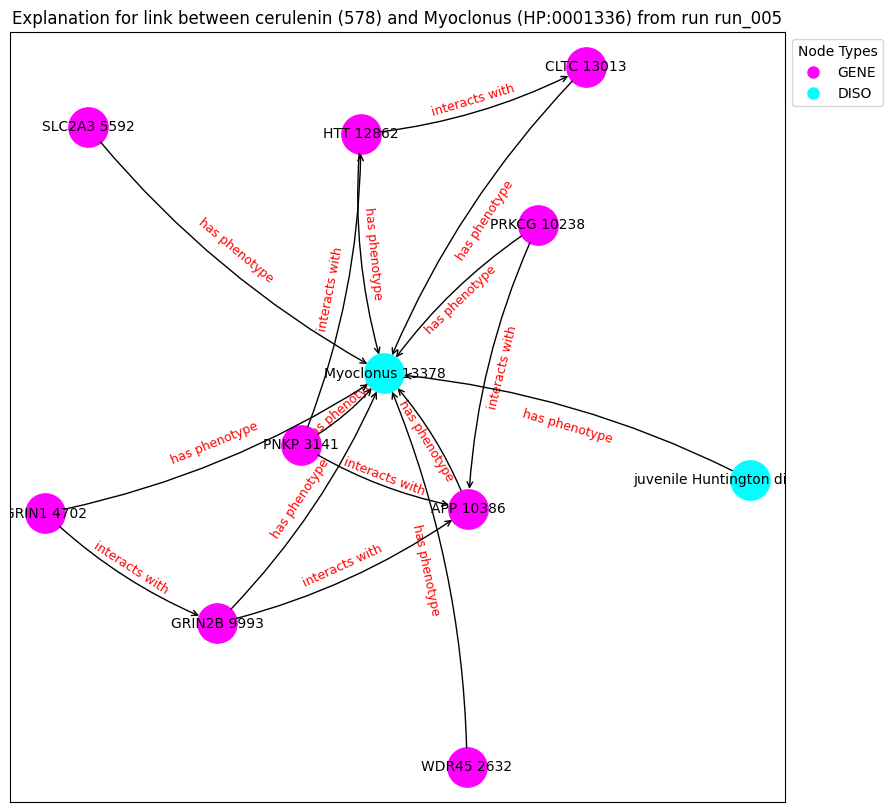

('WDR45 2632', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('APP 10386', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Myoclonus 13378', {'type': 'DISO'})
('WDR45 2632', 'Myoclonus 13378', {'label': 'has phenotype'})
('PNKP 3141', 'HTT 12862', {'label': 'interacts with'})
('PNKP 3141', 'APP 10386', {'label': 'interacts with'})
('PNKP 3141', 'Myoclonus 13378', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'Myoclonus 13378', {'label': 'has phenotype'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'Myoclonus 13378', {'label': 'has phenotype'})
('SLC2A3 5592', 'Myoclonus 13378', {'label': 'has phenotype'})
('GRIN2B 9993', 'Myoclonus 13378', {'label': 'has phenotype'})
('GRIN2B 9993', 'APP 10386', {'label': 'inte

Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 185.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2546], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 203.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2546], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2546], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2546], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 209.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2546], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 210.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2546], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2546], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 202.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2546], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 206.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2546], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 196.05it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic        label  semantic_id
13123     13123  HP:0001824     DISO  Weight loss            1
node2:
     index_id   id semantic      label  semantic_id
350       350  700     DRUG  clomifene            2
Prediction from trained model: tensor([0.4511], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 136.31it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4511], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 129.33it/s]


Contribution threshold is tensor(0.9938)
Explanation found!


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


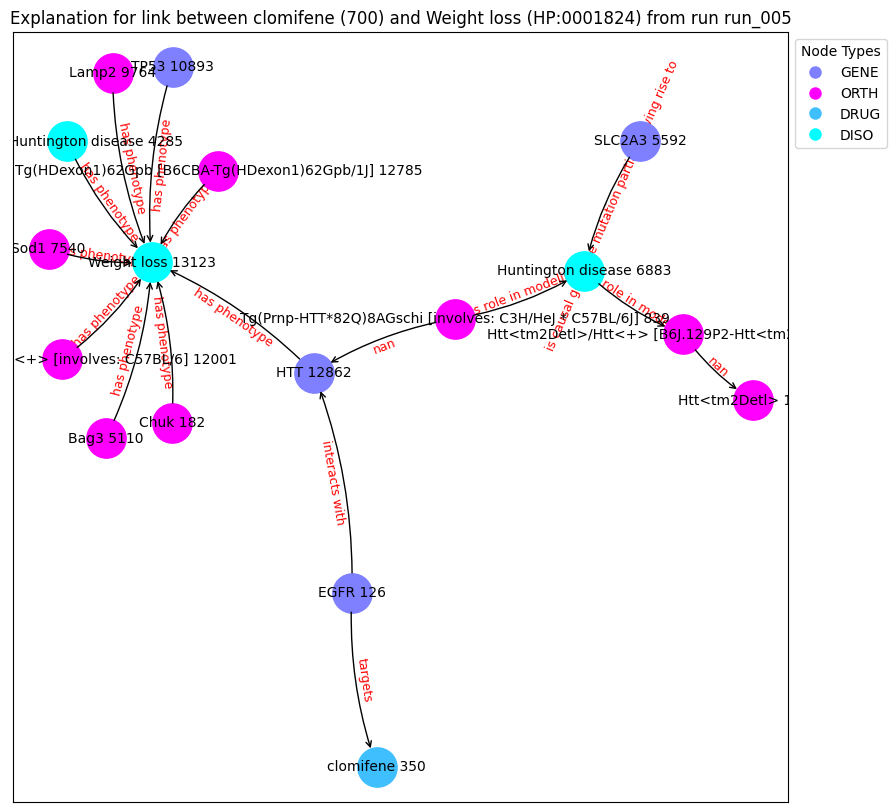

('EGFR 126', {'type': 'GENE'})
('Chuk 182', {'type': 'ORTH'})
('clomifene 350', {'type': 'DRUG'})
('Tg(Prnp-HTT*82Q)8AGschi [involves: C3H/HeJ * C57BL/6J] 839', {'type': 'ORTH'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('Bag3 5110', {'type': 'ORTH'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('Sod1 7540', {'type': 'ORTH'})
('Htt<tm2Detl>/Htt<+> [B6J.129P2-Htt<tm2Detl>] 9652', {'type': 'ORTH'})
('Lamp2 9764', {'type': 'ORTH'})
('TP53 10893', {'type': 'GENE'})
('Htt<tm5Detl>/Htt<+> [involves: C57BL/6] 12001', {'type': 'ORTH'})
('Htt<tm2Detl> 12637', {'type': 'ORTH'})
('Tg(HDexon1)62Gpb [B6CBA-Tg(HDexon1)62Gpb/1J] 12785', {'type': 'ORTH'})
('HTT 12862', {'type': 'GENE'})
('Weight loss 13123', {'type': 'DISO'})
('EGFR 126', 'HTT 12862', {'label': 'interacts with'})
('EGFR 126', 'clomifene 350', {'label': 'targets'})
('Chuk 182', 'Weight loss 13123', {'label': 'has phenotype'})
('Tg(Prnp-HTT*82Q)8AGschi [involves: C3H/HeJ * C57BL/6J] 839'

Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 136.41it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4478], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 134.98it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4478], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 138.15it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4478], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 138.16it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4478], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 133.66it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4478], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 139.51it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4478], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 136.17it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4478], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 139.34it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4478], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 139.40it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4478], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 135.79it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


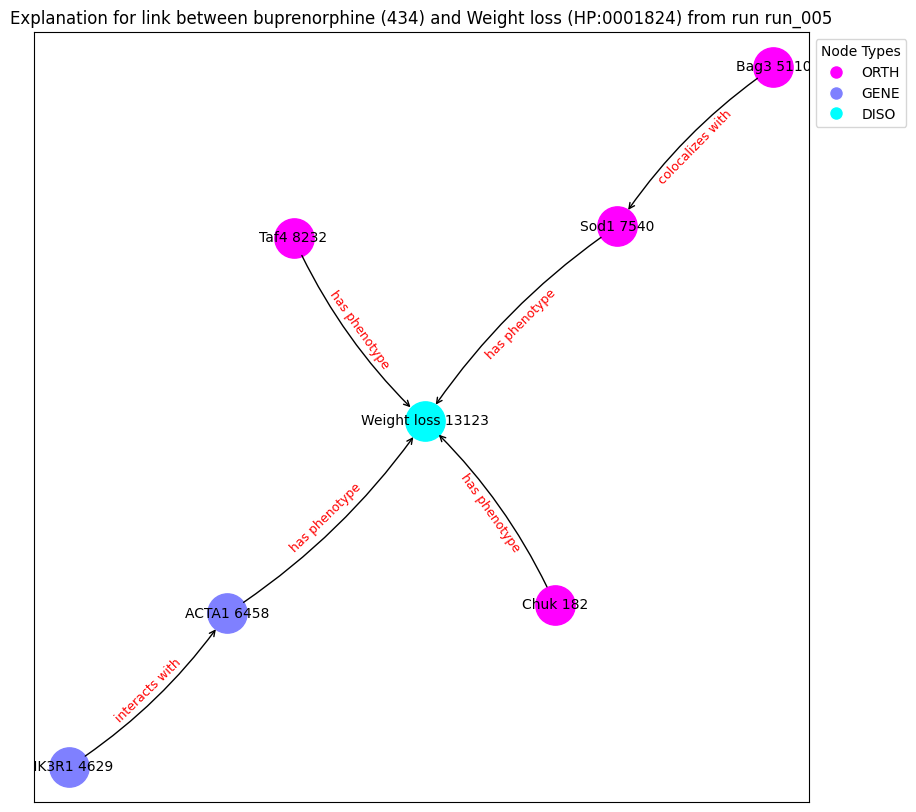

('Chuk 182', {'type': 'ORTH'})
('PIK3R1 4629', {'type': 'GENE'})
('Bag3 5110', {'type': 'ORTH'})
('ACTA1 6458', {'type': 'GENE'})
('Sod1 7540', {'type': 'ORTH'})
('Taf4 8232', {'type': 'ORTH'})
('Weight loss 13123', {'type': 'DISO'})
('Chuk 182', 'Weight loss 13123', {'label': 'has phenotype'})
('PIK3R1 4629', 'ACTA1 6458', {'label': 'interacts with'})
('Bag3 5110', 'Sod1 7540', {'label': 'colocalizes with'})
('ACTA1 6458', 'Weight loss 13123', {'label': 'has phenotype'})
('Sod1 7540', 'Weight loss 13123', {'label': 'has phenotype'})
('Taf4 8232', 'Weight loss 13123', {'label': 'has phenotype'})
Explanation graph saved at c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\expl_5/incomplete_explanation_7_run_005_graph.gpickle
Explanation pair ids and names saved at c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\expl_5/incomplete_explanation_7_run_005_pair.pkl
node1:
      index_id          id semantic   

Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3031], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3031], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 205.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3031], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3031], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3031], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3031], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3031], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3031], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3031], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.61it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                      label  semantic_id
13978     13978  HP:0200136     DISO  Oral-pharyngeal dysphagia            1
node2:
     index_id    id semantic      label  semantic_id
581       581  1140     DRUG  felbamate            2
Prediction from trained model: tensor([0.4476], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 581: 100%|██████████| 700/700 [00:03<00:00, 196.22it/s]


Contribution threshold is tensor(0.0063)
Explanation found!


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


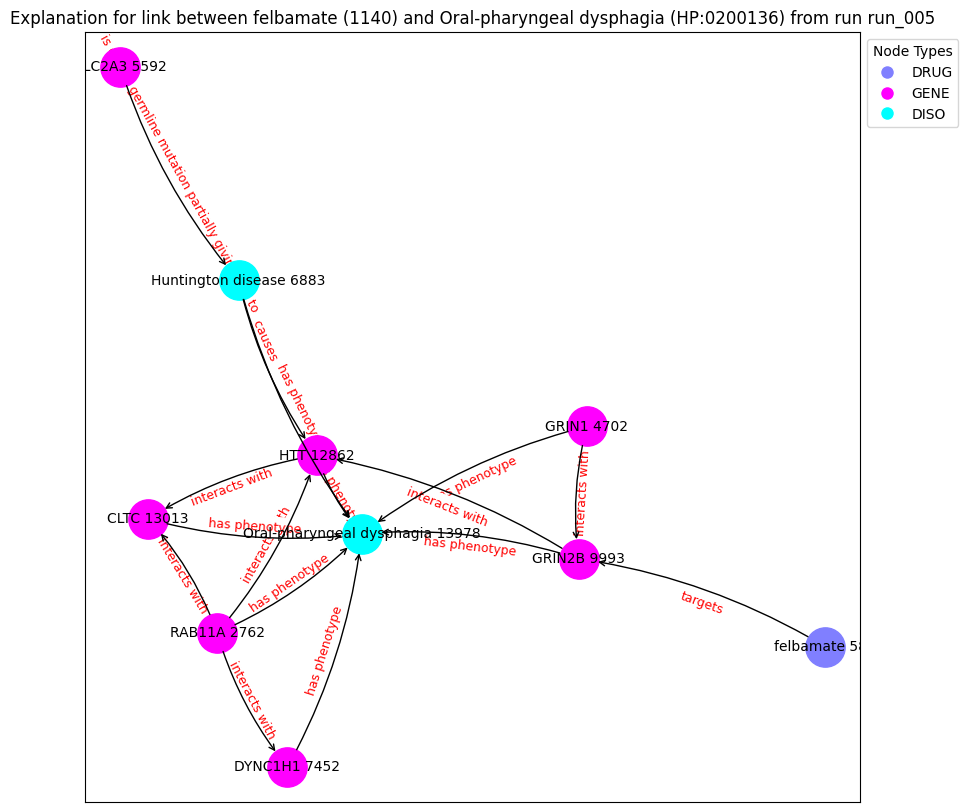

('felbamate 581', {'type': 'DRUG'})
('RAB11A 2762', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Oral-pharyngeal dysphagia 13978', {'type': 'DISO'})
('felbamate 581', 'GRIN2B 9993', {'label': 'targets'})
('RAB11A 2762', 'HTT 12862', {'label': 'interacts with'})
('RAB11A 2762', 'CLTC 13013', {'label': 'interacts with'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('Huntington disease 6883', 'HTT 12862', {'label': 'causes condition'}

Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:05<00:00, 132.43it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1823], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:05<00:00, 139.44it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1823], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:05<00:00, 139.69it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1823], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 144.08it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1823], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 143.40it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1823], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 143.22it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1823], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 142.65it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1823], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:05<00:00, 137.84it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1823], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 142.26it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1823], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 141.77it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


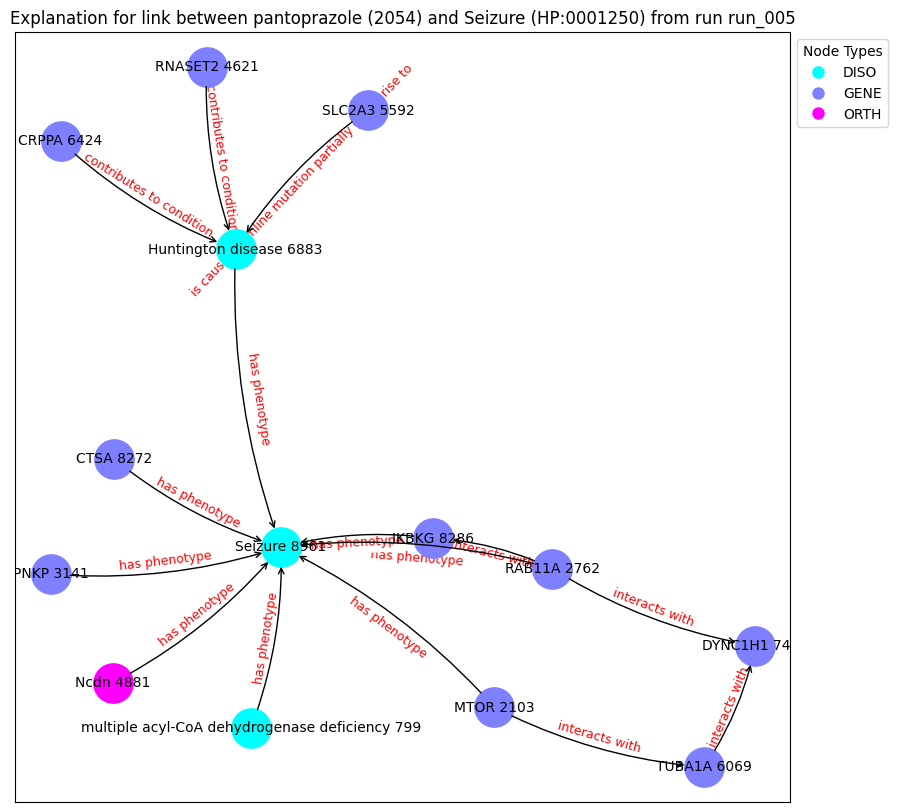

('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('MTOR 2103', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('RNASET2 4621', {'type': 'GENE'})
('Ncdn 4881', {'type': 'ORTH'})
('SLC2A3 5592', {'type': 'GENE'})
('TUBA1A 6069', {'type': 'GENE'})
('CRPPA 6424', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTSA 8272', {'type': 'GENE'})
('IKBKG 8286', {'type': 'GENE'})
('Seizure 8961', {'type': 'DISO'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'Seizure 8961', {'label': 'has phenotype'})
('MTOR 2103', 'TUBA1A 6069', {'label': 'interacts with'})
('MTOR 2103', 'Seizure 8961', {'label': 'has phenotype'})
('RAB11A 2762', 'IKBKG 8286', {'label': 'interacts with'})
('RAB11A 2762', 'Seizure 8961', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('PNKP 3141', 'Seizure 8961', {'label': 'has phenotype'})
('RNASET2 4621', 'Huntington diseas

Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 138.48it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1288], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 139.65it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1288], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 139.67it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1288], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 139.47it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1288], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 141.95it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1288], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 139.19it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1288], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 141.06it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1288], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 141.25it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.1288], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 140.20it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1288], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 142.50it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


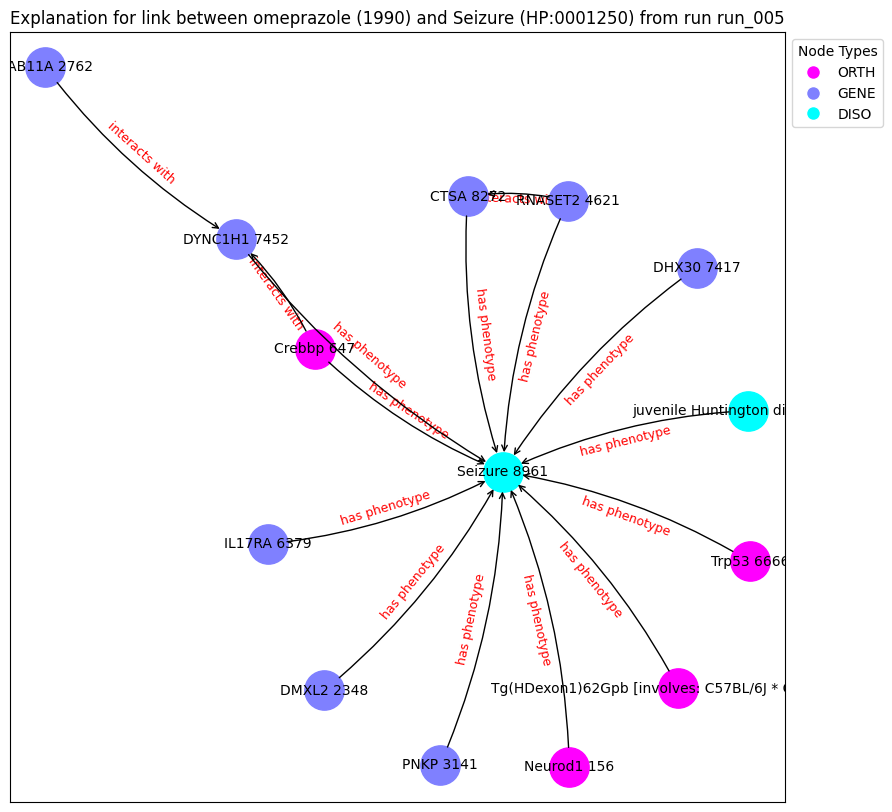

('Neurod1 156', {'type': 'ORTH'})
('Crebbp 647', {'type': 'ORTH'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', {'type': 'ORTH'})
('DMXL2 2348', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('RNASET2 4621', {'type': 'GENE'})
('IL17RA 6379', {'type': 'GENE'})
('Trp53 6666', {'type': 'ORTH'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTSA 8272', {'type': 'GENE'})
('Seizure 8961', {'type': 'DISO'})
('Neurod1 156', 'Seizure 8961', {'label': 'has phenotype'})
('Crebbp 647', 'DYNC1H1 7452', {'label': 'interacts with'})
('Crebbp 647', 'Seizure 8961', {'label': 'has phenotype'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', 'Seizure 8961', {'label': 'has phenotype'})
('DMXL2 2348', 'Seizure 8961', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('PNKP 3141', 'Seizure 8961', {'label': 'has phenotype'})
('juvenile Hu

Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1660], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1660], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1660], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 241.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1660], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 232.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1660], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1660], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 235.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1660], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1660], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1660], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.95it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
11896     11896  HP:0000737     DISO  Irritability            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.2768], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 210.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2768], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2768], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 200.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2768], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2768], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2768], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2768], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2768], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2768], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2768], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.82it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                             label  \
1317      1317  HP:0009088     DISO  Speech articulation difficulties   

      semantic_id  
1317            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.2116], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2116], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2116], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:03<00:00, 229.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2116], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 241.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2116], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 241.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2116], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 243.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2116], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 235.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2116], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2116], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2116], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.79it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                             label  \
1317      1317  HP:0009088     DISO  Speech articulation difficulties   

      semantic_id  
1317            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.1182], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 235.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1182], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1182], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 241.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1182], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 253.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1182], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1182], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1182], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1182], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1182], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 245.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1182], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.59it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
4154      4154  HP:0000746     DISO  Delusions            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.9955], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 250.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9955], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:03<00:00, 207.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9955], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9955], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9955], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9955], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9955], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 249.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9955], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 251.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9955], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9955], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:03<00:00, 216.70it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
4154      4154  HP:0000746     DISO  Delusions            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.9986], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9986], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9986], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 235.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9986], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9986], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9986], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9986], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 239.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9986], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9986], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9986], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 233.62it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic   label  semantic_id
9999      9999  HP:0002169     DISO  Clonus            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.2401], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 217.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2401], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 215.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2401], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 230.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2401], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2401], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 225.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2401], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 225.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2401], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2401], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 231.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2401], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 218.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2401], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.42it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic  \
9644      9644  HP:0010794     DISO   

                                             label  semantic_id  
9644  Impaired visuospatial constructive cognition            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.5098], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 217.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5098], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5098], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5098], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5098], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 214.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5098], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5098], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5098], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5098], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 216.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5098], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 215.82it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic  \
9644      9644  HP:0010794     DISO   

                                             label  semantic_id  
9644  Impaired visuospatial constructive cognition            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.6475], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6475], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6475], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6475], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6475], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6475], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6475], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6475], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6475], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6475], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 202.23it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic              label  semantic_id
14773     14773  HP:0002540     DISO  Inability to walk            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.2319], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.01it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2319], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.45it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2319], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 179.42it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2319], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.02it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2319], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.31it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2319], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.92it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2319], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.79it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.2319], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.84it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2319], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.24it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2319], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.93it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


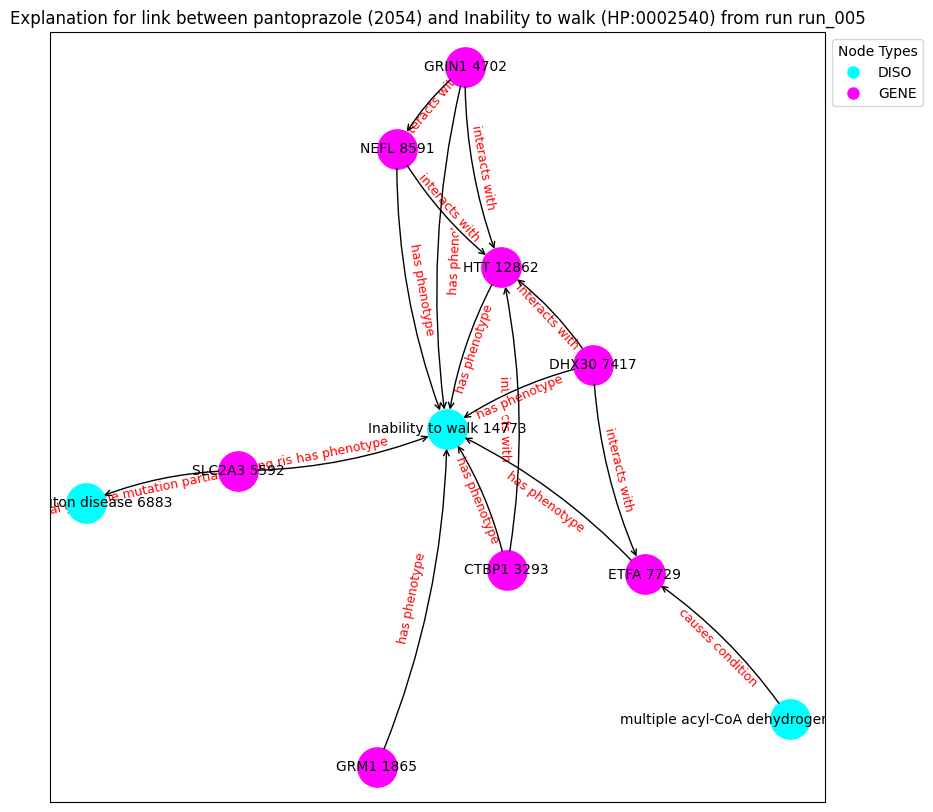

('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('GRM1 1865', {'type': 'GENE'})
('CTBP1 3293', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Inability to walk 14773', {'type': 'DISO'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'ETFA 7729', {'label': 'causes condition'})
('GRM1 1865', 'Inability to walk 14773', {'label': 'has phenotype'})
('CTBP1 3293', 'HTT 12862', {'label': 'interacts with'})
('CTBP1 3293', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'NEFL 8591', {'label': 'interacts with'})
('GRIN1 4702', 'Inability to walk 14773', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise

Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:04<00:00, 173.34it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2361], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 175.88it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2361], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.32it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2361], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.74it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2361], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.05it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.2361], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.81it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.2361], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 179.56it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2361], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.61it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2361], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.13it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2361], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.40it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


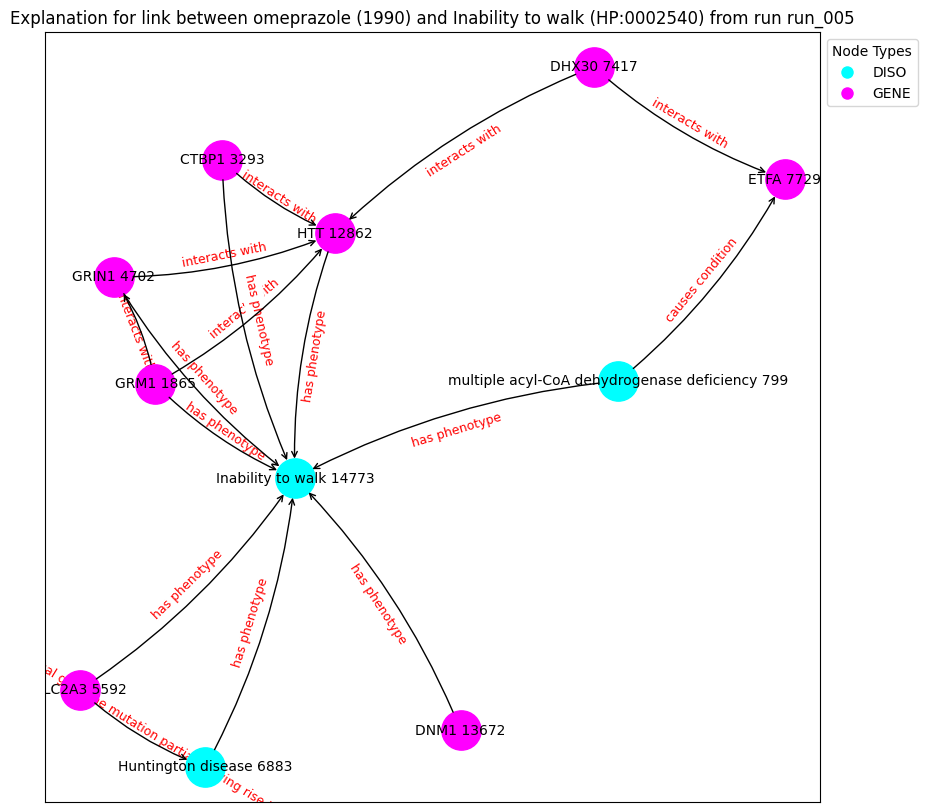

('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('GRM1 1865', {'type': 'GENE'})
('CTBP1 3293', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('DNM1 13672', {'type': 'GENE'})
('Inability to walk 14773', {'type': 'DISO'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'Inability to walk 14773', {'label': 'has phenotype'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'ETFA 7729', {'label': 'causes condition'})
('GRM1 1865', 'HTT 12862', {'label': 'interacts with'})
('GRM1 1865', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('CTBP1 3293', 'HTT 12862', {'label': 'interacts with'})
('CTBP1 3293', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 47

Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:03<00:00, 219.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0854], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0854], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 233.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0854], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 243.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0854], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 235.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0854], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0854], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 245.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0854], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0854], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0854], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.16it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                      label  semantic_id
3165      3165  HP:0045082     DISO  Decreased body mass index            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.1235], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 251.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1235], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 241.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1235], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 237.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1235], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1235], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 245.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1235], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:03<00:00, 205.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1235], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1235], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1235], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:03<00:00, 232.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1235], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.96it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                    label  \
917       917  HP:0002529     DISO  Neuronal loss in central nervous system   

     semantic_id  
917            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 246.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 249.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 245.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 229.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 237.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 243.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.26it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                    label  \
917       917  HP:0002529     DISO  Neuronal loss in central nervous system   

     semantic_id  
917            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 247.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 235.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 244.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 244.69it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 237.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 242.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 242.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 244.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 242.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 247.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 236.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 245.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 247.81it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 251.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 247.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 245.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 243.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 242.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 252.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 256.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 244.20it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                         label  semantic_id
9801      9801  HP:0007010     DISO  Poor fine motor coordination            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.3159], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3159], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3159], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3159], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3159], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3159], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3159], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3159], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3159], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 232.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3159], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.36it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                         label  semantic_id
9801      9801  HP:0007010     DISO  Poor fine motor coordination            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.3374], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3374], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3374], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3374], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 208.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3374], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3374], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3374], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 216.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3374], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3374], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 229.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3374], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.17it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic       label  semantic_id
14527     14527  HP:0030955     DISO  Alcoholism            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.4897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 220.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 217.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.94it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic       label  semantic_id
14527     14527  HP:0030955     DISO  Alcoholism            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5755], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5755], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5755], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 210.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5755], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5755], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5755], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5755], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5755], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5755], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5755], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.39it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic             label  semantic_id
8158      8158  HP:0002059     DISO  Cerebral atrophy            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.1901], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.31it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1901], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.66it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1901], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.71it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.1901], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.38it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1901], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.39it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1901], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.53it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.1901], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.67it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1901], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.99it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1901], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.38it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1901], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.73it/s]


Contribution threshold is tensor(0.0062)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


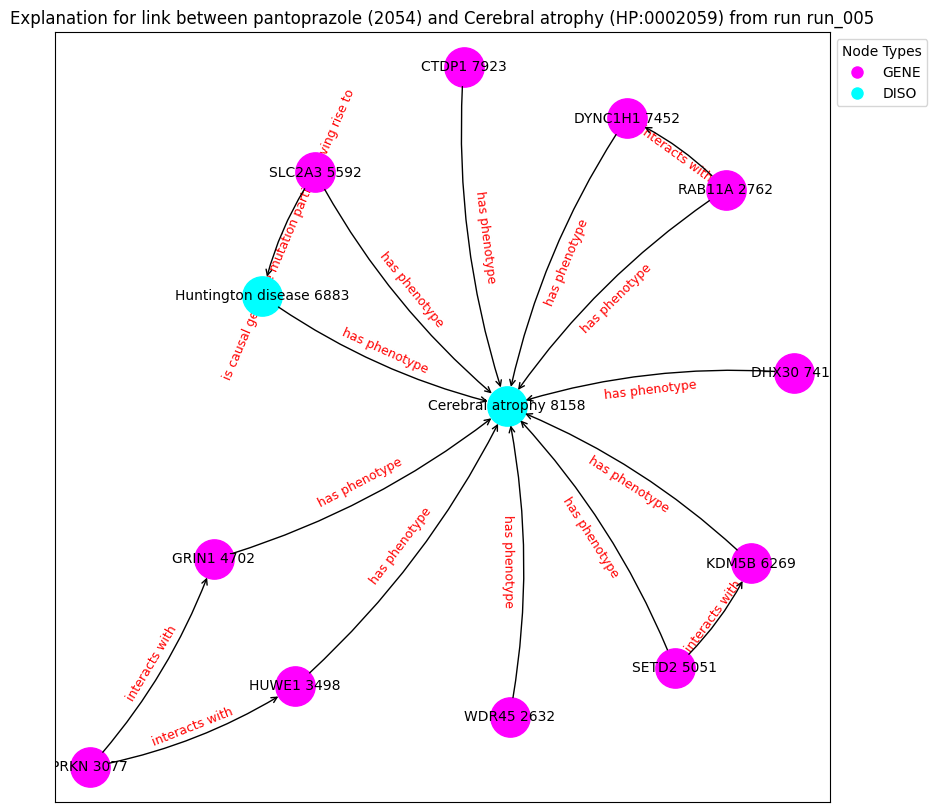

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('Cerebral atrophy 8158', {'type': 'DISO'})
('WDR45 2632', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('HUWE1 3498', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('GRIN1 4702', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('SETD2 5051', 'KDM5B 6269', {'label': 'interacts with'})
('SETD2 5051', 'Cerebral atrophy 8158'

Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:04<00:00, 172.76it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.35it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 179.30it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.32it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.08it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.50it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.99it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.1999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.64it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.1999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.18it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.66it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


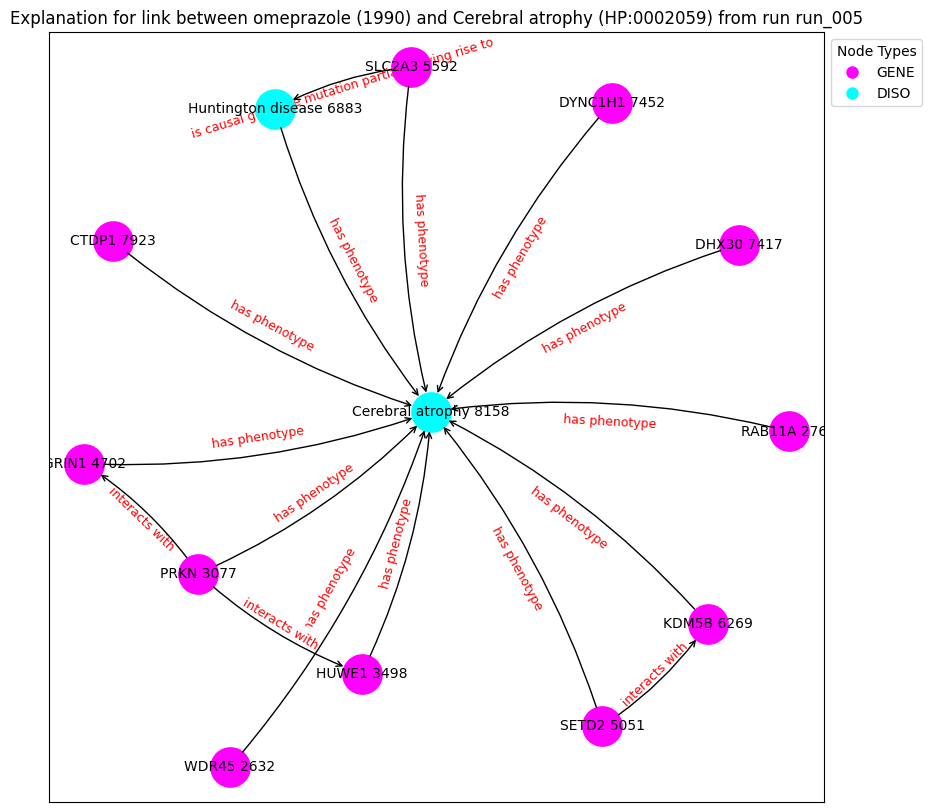

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('Cerebral atrophy 8158', {'type': 'DISO'})
('WDR45 2632', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('HUWE1 3498', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('GRIN1 4702', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('SETD2 5051', 'KDM5B 6269', {'label': 'interacts with'})
('SETD2 5051', 'Cerebral atrophy

Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 157.33it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 163.97it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 166.85it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 168.16it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 165.24it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.3936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 172.39it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 172.22it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.3936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 171.26it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.3936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 170.83it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.3936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 170.97it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


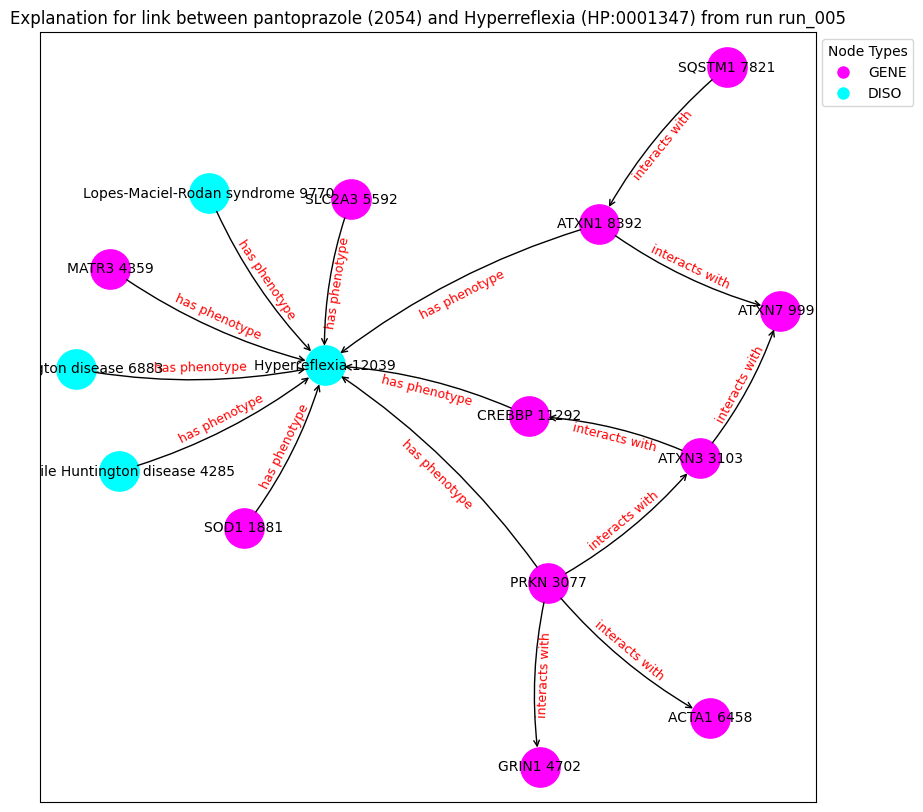

('SOD1 1881', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('MATR3 4359', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('Lopes-Maciel-Rodan syndrome 9770', {'type': 'DISO'})
('ATXN7 9991', {'type': 'GENE'})
('CREBBP 11292', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('SOD1 1881', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('PRKN 3077', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'CREBBP 11292', {'label': 'interacts with'})
('ATXN3 3103', 'ATXN7 9991', {'label': 'interacts with'})
('juvenile Hunting

Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 163.73it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3296], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 162.23it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3296], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 172.45it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3296], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.47it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3296], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 174.00it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3296], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.28it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3296], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 174.86it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3296], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 173.28it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3296], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.95it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3296], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 165.26it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


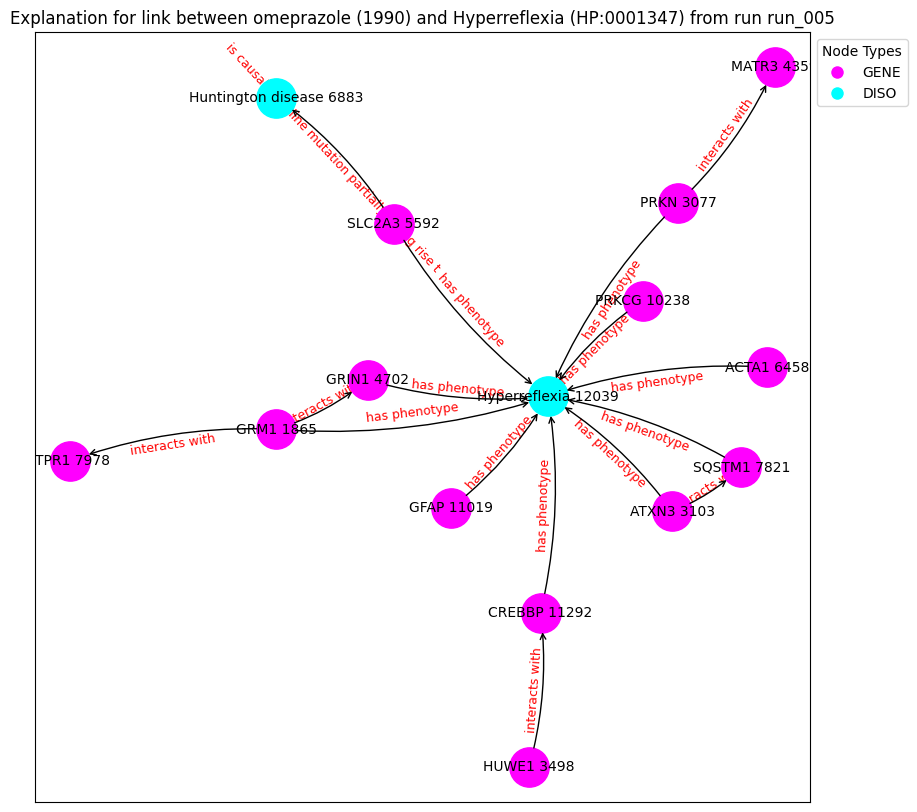

('GRM1 1865', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('MATR3 4359', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('ITPR1 7978', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('CREBBP 11292', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('GRM1 1865', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('GRM1 1865', 'ITPR1 7978', {'label': 'interacts with'})
('PRKN 3077', 'MATR3 4359', {'label': 'interacts with'})
('PRKN 3077', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('ATXN3 3103', 'SQSTM1 7821', {'label': 'interacts with'})
('ATXN3 3103', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('HUWE1 3498', 'CREBBP 11292', {'label': 'interacts wi

Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3461], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3461], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3461], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 206.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3461], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3461], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3461], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3461], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3461], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3461], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.97it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
1369      1369  HP:0000751     DISO  Personality changes            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.2754], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 246.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2754], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2754], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2754], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 241.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2754], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 252.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2754], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2754], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2754], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2754], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 241.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2754], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 245.49it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
1369      1369  HP:0000751     DISO  Personality changes            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.1321], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1321], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 245.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1321], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1321], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1321], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 250.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1321], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1321], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:03<00:00, 233.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1321], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1321], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1321], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.42it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
13783     13783  HP:0031843     DISO  Bradyphrenia            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.4868], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 212.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4868], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 215.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4868], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 206.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4868], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 213.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4868], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4868], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 220.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4868], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4868], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4868], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 218.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4868], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 217.00it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
13783     13783  HP:0031843     DISO  Bradyphrenia            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5710], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5710], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5710], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 212.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5710], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5710], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5710], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5710], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5710], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5710], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 201.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5710], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 194.15it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic            label  semantic_id
830       830  HP:0002340     DISO  Caudate atrophy            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5257], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5257], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5257], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5257], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 246.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5257], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 248.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5257], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5257], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5257], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5257], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5257], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 241.45it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic            label  semantic_id
830       830  HP:0002340     DISO  Caudate atrophy            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.2459], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 248.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2459], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2459], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2459], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 237.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2459], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2459], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 241.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2459], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2459], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 248.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2459], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 235.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2459], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.01it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic             label  semantic_id
13592     13592  HP:0001288     DISO  Gait disturbance            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.4446], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 125.63it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4446], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 127.45it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4446], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 128.57it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4446], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 125.95it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4446], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 127.46it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4446], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 127.86it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4446], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 126.80it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4446], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 120.94it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4446], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 123.60it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4446], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 125.99it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


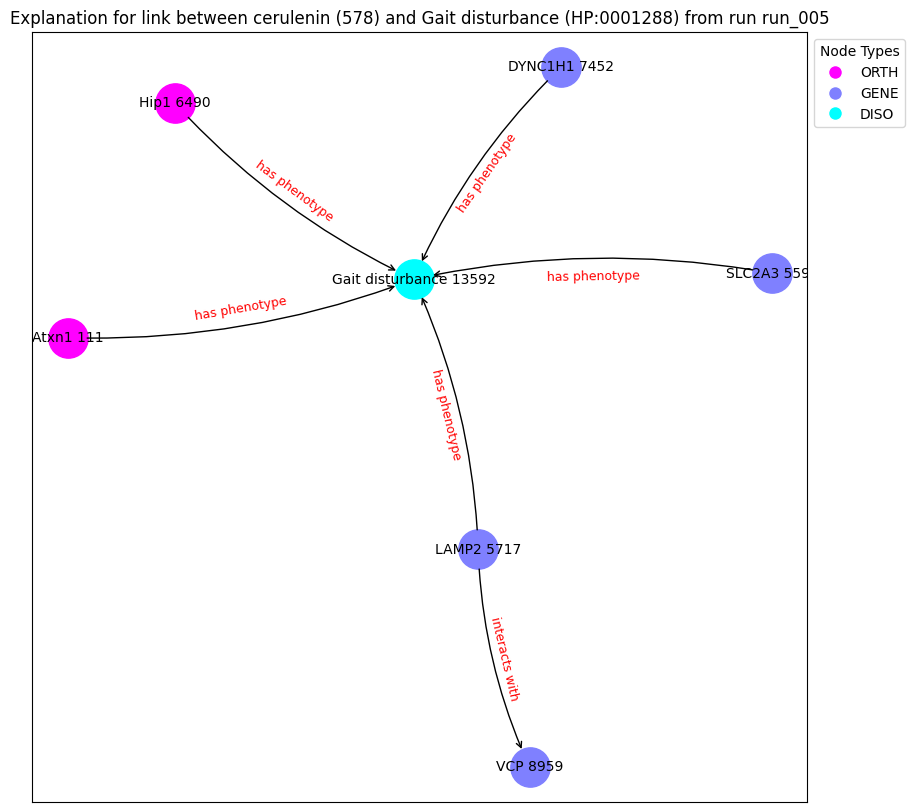

('Atxn1 111', {'type': 'ORTH'})
('SLC2A3 5592', {'type': 'GENE'})
('LAMP2 5717', {'type': 'GENE'})
('Hip1 6490', {'type': 'ORTH'})
('DYNC1H1 7452', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('Gait disturbance 13592', {'type': 'DISO'})
('Atxn1 111', 'Gait disturbance 13592', {'label': 'has phenotype'})
('SLC2A3 5592', 'Gait disturbance 13592', {'label': 'has phenotype'})
('LAMP2 5717', 'Gait disturbance 13592', {'label': 'has phenotype'})
('LAMP2 5717', 'VCP 8959', {'label': 'interacts with'})
('Hip1 6490', 'Gait disturbance 13592', {'label': 'has phenotype'})
('DYNC1H1 7452', 'Gait disturbance 13592', {'label': 'has phenotype'})
Explanation graph saved at c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\expl_5/incomplete_explanation_16_run_005_graph.gpickle
Explanation pair ids and names saved at c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\expl_5/incomplete_explanation_16_run_005_pair.pkl
no

Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 212.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1712], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 219.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1712], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 232.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1712], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 230.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1712], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 223.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1712], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 223.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1712], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 226.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1712], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 214.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1712], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 219.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1712], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 226.16it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic  \
5436      5436  HP:0003107     DISO   

                                               label  semantic_id  
5436  Abnormal circulating cholesterol concentration            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.1856], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:03<00:00, 232.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1856], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 247.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1856], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 237.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1856], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 241.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1856], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1856], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1856], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1856], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1856], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1856], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.50it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic  \
5436      5436  HP:0003107     DISO   

                                               label  semantic_id  
5436  Abnormal circulating cholesterol concentration            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.1383], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1383], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1383], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1383], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 246.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1383], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 244.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1383], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1383], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1383], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1383], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1383], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 239.10it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\run_006
(0, {'node_feature': tensor([-0.5596,  0.3174, -0.1110, -0.6635, -0.1103,  0.5426,  0.1828,  0.1558,
        -0.0805,  0.4944,  0.5424,  0.4528, -0.8762,  0.1464, -0.4145,  0.8521,
        -0.6081, -0.8802,  0.6050, -0.5817, -0.0673,  0.1118,  0.2132, -1.0297,
         0.2367, -0.2174,  0.0806,  1.0531,  0.3123, -0.2165,  1.1856,  0.8695])})
(0, 11953, {'edge_label': 'in orthology relationship with'})
Number of edges is 134749
Number of nodes is 14833
node1:
       index_id          id semantic       label  semantic_id
13668     13668  HP:0000716     DISO  Depression            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.2782], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 163.50it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2782], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 163.82it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2782], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 165.41it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2782], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 165.29it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2782], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 162.86it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2782], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 162.89it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2782], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 162.47it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2782], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 158.21it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2782], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 158.58it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2782], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 161.87it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


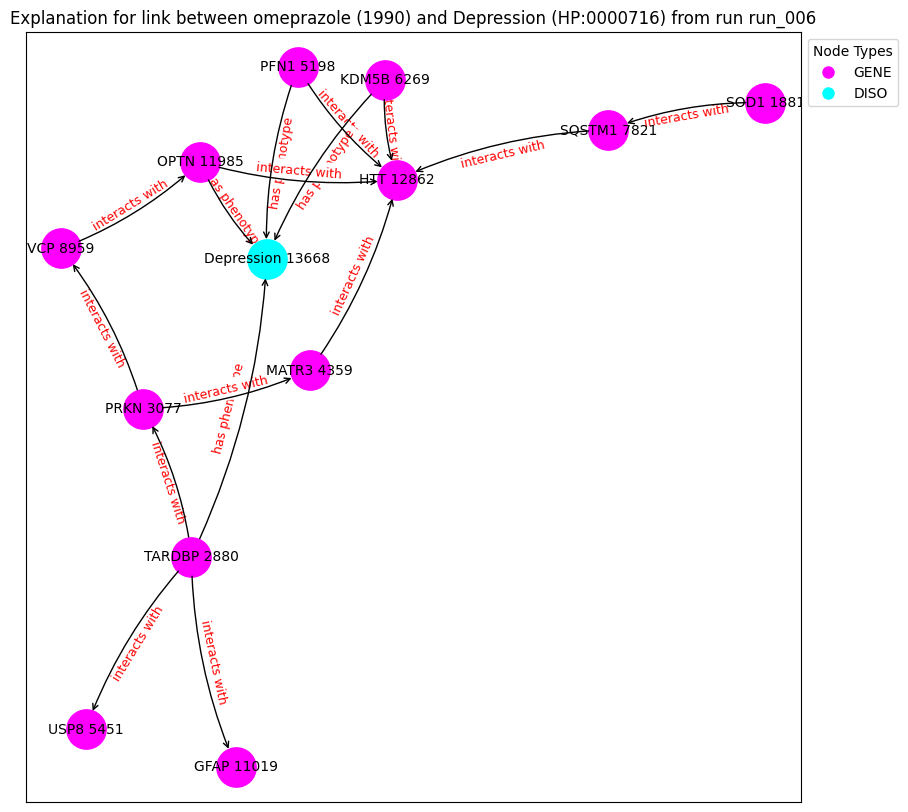

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('MATR3 4359', {'type': 'GENE'})
('PFN1 5198', {'type': 'GENE'})
('USP8 5451', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('SOD1 1881', 'SQSTM1 7821', {'label': 'interacts with'})
('TARDBP 2880', 'PRKN 3077', {'label': 'interacts with'})
('TARDBP 2880', 'GFAP 11019', {'label': 'interacts with'})
('TARDBP 2880', 'USP8 5451', {'label': 'interacts with'})
('TARDBP 2880', 'Depression 13668', {'label': 'has phenotype'})
('PRKN 3077', 'VCP 8959', {'label': 'interacts with'})
('PRKN 3077', 'MATR3 4359', {'label': 'interacts with'})
('MATR3 4359', 'HTT 12862', {'label': 'interacts with'})
('PFN1 5198', 'HTT 12862', {'label': 'interacts with'})
('PFN1 5198', 'Depression 13668', {'label': 'has

Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 158.75it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.0850], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 162.37it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.0850], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 163.99it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.0850], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 155.71it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.0850], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 160.64it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.0850], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 145.76it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.0850], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 164.90it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.0850], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 166.55it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.0850], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 165.47it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.0850], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 164.55it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


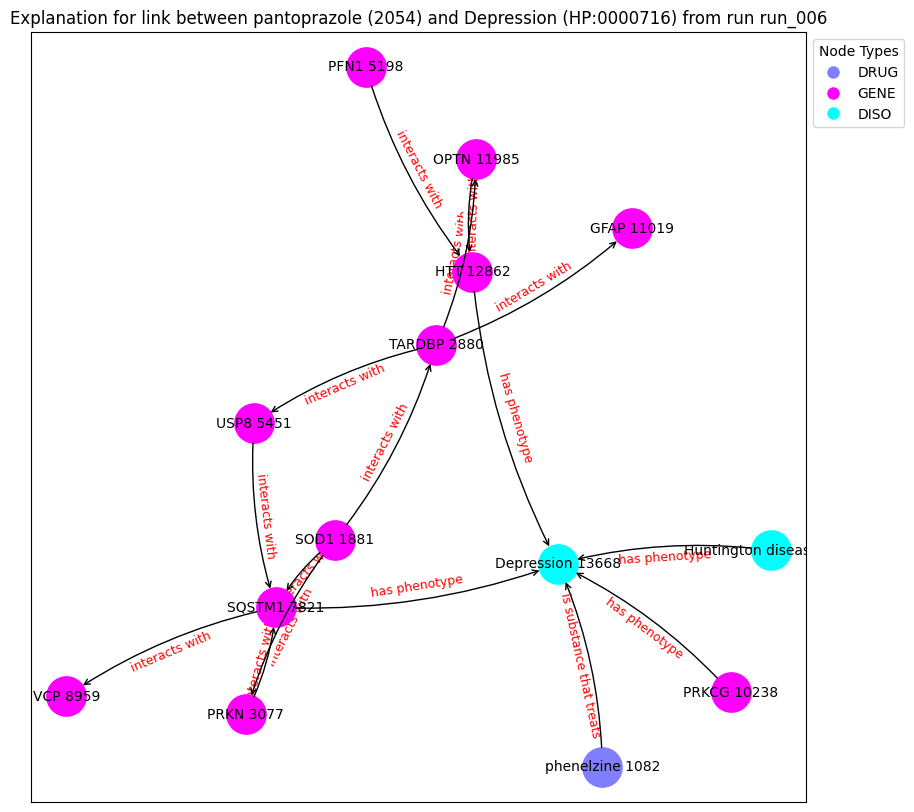

('phenelzine 1082', {'type': 'DRUG'})
('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('PFN1 5198', {'type': 'GENE'})
('USP8 5451', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('phenelzine 1082', 'Depression 13668', {'label': 'is substance that treats'})
('SOD1 1881', 'PRKN 3077', {'label': 'interacts with'})
('SOD1 1881', 'SQSTM1 7821', {'label': 'interacts with'})
('SOD1 1881', 'TARDBP 2880', {'label': 'interacts with'})
('TARDBP 2880', 'GFAP 11019', {'label': 'interacts with'})
('TARDBP 2880', 'USP8 5451', {'label': 'interacts with'})
('TARDBP 2880', 'OPTN 11985', {'label': 'interacts with'})
('PRKN 3077', 'SQSTM1 7821', {'label': 'interacts with'})
('PFN1 5198', 'HTT 12862', {'labe

Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 159.61it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6424], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 153.35it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6424], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 167.95it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6424], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 158.03it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6424], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 163.70it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6424], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 163.77it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6424], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 162.60it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6424], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 162.67it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6424], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 164.20it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6424], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 155.00it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


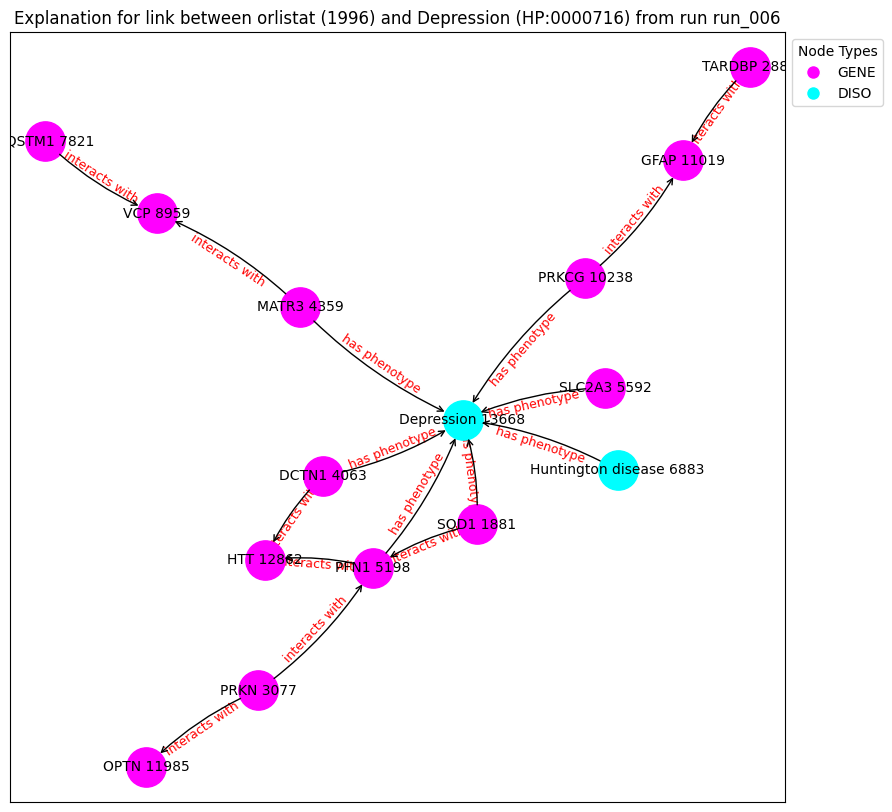

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('MATR3 4359', {'type': 'GENE'})
('PFN1 5198', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('SOD1 1881', 'PFN1 5198', {'label': 'interacts with'})
('SOD1 1881', 'Depression 13668', {'label': 'has phenotype'})
('TARDBP 2880', 'GFAP 11019', {'label': 'interacts with'})
('PRKN 3077', 'OPTN 11985', {'label': 'interacts with'})
('PRKN 3077', 'PFN1 5198', {'label': 'interacts with'})
('DCTN1 4063', 'HTT 12862', {'label': 'interacts with'})
('DCTN1 4063', 'Depression 13668', {'label': 'has phenotype'})
('MATR3 4359', 'Depression 13668', {'label': 'has phenotype'})
('MATR3 4359', 

Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 232.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:02<00:00, 244.32it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic     label  semantic_id
12933     12933  HP:0001332     DISO  Dystonia            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.1716], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 148.99it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1716], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 149.39it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1716], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 147.80it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1716], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 150.69it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1716], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 147.78it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1716], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 144.20it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1716], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:05<00:00, 137.78it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1716], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 149.80it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1716], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 149.53it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.1716], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 143.15it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


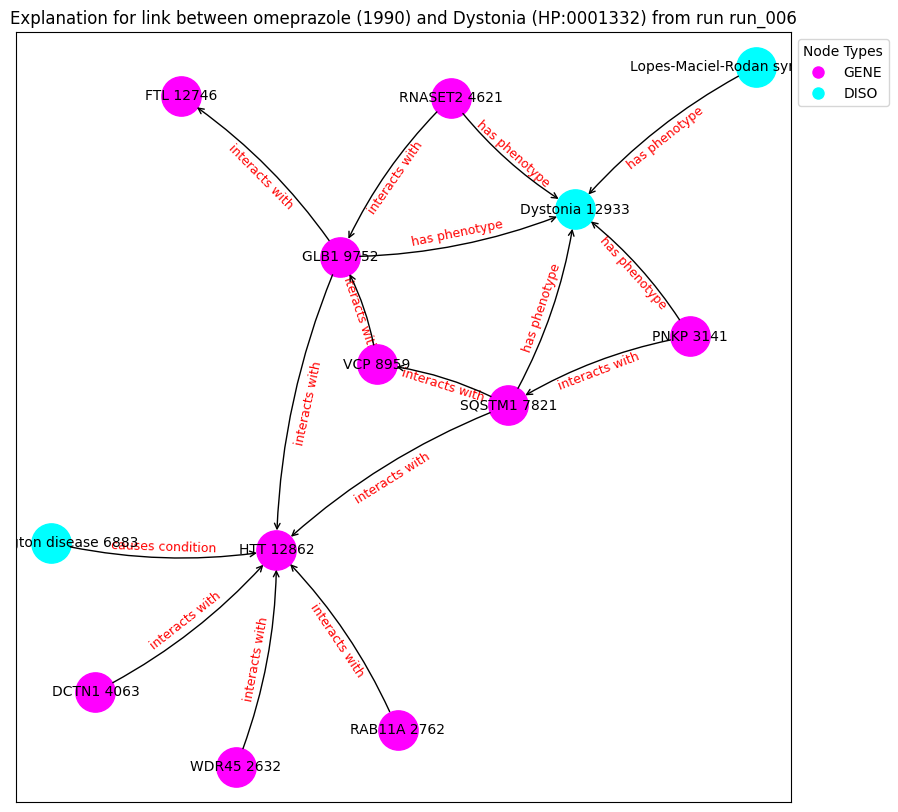

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('RNASET2 4621', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('GLB1 9752', {'type': 'GENE'})
('Lopes-Maciel-Rodan syndrome 9770', {'type': 'DISO'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Dystonia 12933', {'type': 'DISO'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('RAB11A 2762', 'HTT 12862', {'label': 'interacts with'})
('PNKP 3141', 'SQSTM1 7821', {'label': 'interacts with'})
('PNKP 3141', 'Dystonia 12933', {'label': 'has phenotype'})
('DCTN1 4063', 'HTT 12862', {'label': 'interacts with'})
('RNASET2 4621', 'GLB1 9752', {'label': 'interacts with'})
('RNASET2 4621', 'Dystonia 12933', {'label': 'has phenotype'})
('Huntington disease 6883', 'HTT 12862', {'label': 'causes condition'})
('SQSTM1 7821', 'HTT 12862', {'label': 'interacts 

Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 144.42it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.0721], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 140.17it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.0721], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 146.62it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.0721], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 143.85it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.0721], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 142.39it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.0721], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 148.26it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.0721], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 148.32it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.0721], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:05<00:00, 139.60it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.0721], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 149.52it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.0721], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 146.12it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


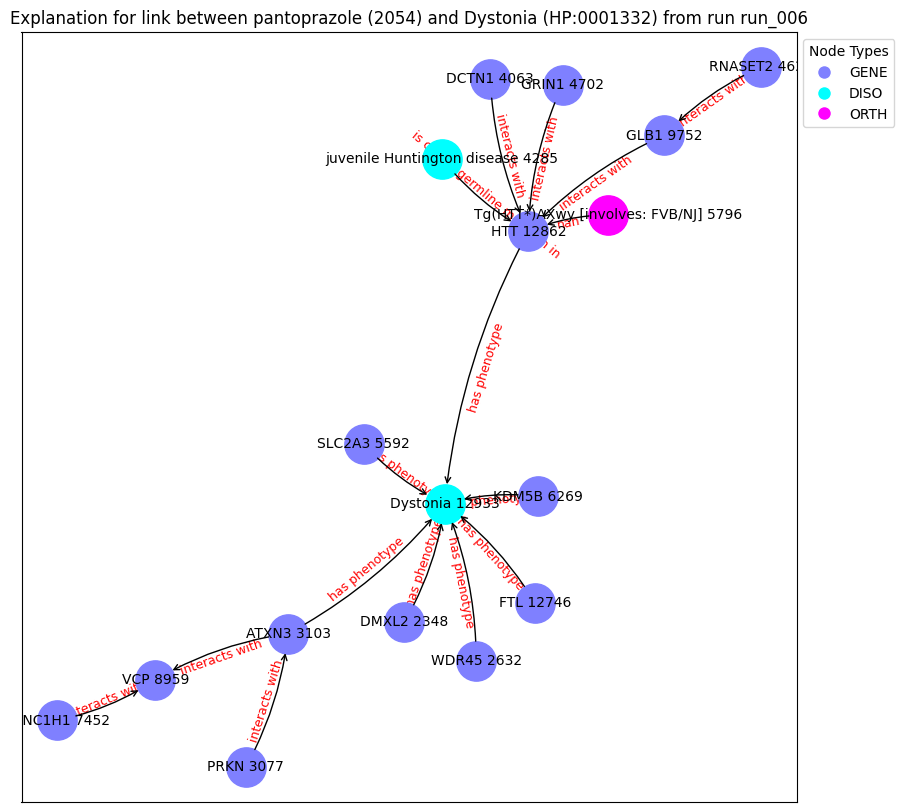

('DMXL2 2348', {'type': 'GENE'})
('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('RNASET2 4621', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Tg(HTT*)AXwy [involves: FVB/NJ] 5796', {'type': 'ORTH'})
('KDM5B 6269', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('GLB1 9752', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Dystonia 12933', {'type': 'DISO'})
('DMXL2 2348', 'Dystonia 12933', {'label': 'has phenotype'})
('WDR45 2632', 'Dystonia 12933', {'label': 'has phenotype'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'VCP 8959', {'label': 'interacts with'})
('ATXN3 3103', 'Dystonia 12933', {'label': 'has phenotype'})
('DCTN1 4063', 'HTT 12862', {'label': 'interacts with'})
('juvenile Huntington disease 4285'

Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 233.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 231.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 243.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 238.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 239.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 248.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 244.41it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic    label  semantic_id
1789      1789  HP:0000739     DISO  Anxiety            1
node2:
      index_id    id semantic     label  semantic_id
1000      1000  1996     DRUG  orlistat            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 242.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 231.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 239.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 239.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 241.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 254.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 242.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 235.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 243.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 239.33it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic            label  semantic_id
14311     14311  HP:0031845     DISO  Abnormal libido            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.1968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 209.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.70it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic            label  semantic_id
14311     14311  HP:0031845     DISO  Abnormal libido            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.7253], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 200.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7253], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 219.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7253], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 212.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7253], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7253], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7253], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 213.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7253], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7253], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 216.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7253], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 229.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7253], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 224.36it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.2066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 223.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 232.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 215.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2066], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 217.58it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.0669], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:02<00:00, 233.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0669], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0669], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 226.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0669], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 233.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0669], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 230.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0669], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 226.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0669], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 228.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0669], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:02<00:00, 238.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0669], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 227.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0669], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 218.84it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.5053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 206.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 210.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 207.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 206.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 206.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 208.13it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.1938], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1938], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 201.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1938], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 205.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1938], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 205.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1938], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 205.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1938], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 208.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1938], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 205.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1938], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1938], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 198.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1938], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 200.09it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
11096     11096  HP:0025401     DISO  Staring gaze            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5362], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5362], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5362], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5362], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5362], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5362], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5362], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 203.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5362], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5362], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5362], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.46it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
6473      6473  HP:0001272     DISO  Cerebellar atrophy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.3423], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3423], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3423], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3423], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3423], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3423], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 178.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3423], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3423], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3423], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3423], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.37it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
6473      6473  HP:0001272     DISO  Cerebellar atrophy            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.1593], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1593], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1593], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1593], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1593], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 183.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1593], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1593], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 196.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1593], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1593], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 196.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1593], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.78it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
4670      4670  HP:0031589     DISO  Suicidal ideation            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.3143], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3143], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3143], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3143], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3143], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3143], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3143], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:02<00:00, 237.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3143], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 232.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3143], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3143], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.80it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
4670      4670  HP:0031589     DISO  Suicidal ideation            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.6027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:02<00:00, 235.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 207.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:02<00:00, 235.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 232.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 233.20it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic        label  semantic_id
2028      2028  HP:0002066     DISO  Gait ataxia            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.3761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:02<00:00, 233.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 223.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:02<00:00, 235.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.81it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic        label  semantic_id
2028      2028  HP:0002066     DISO  Gait ataxia            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.2744], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 230.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2744], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 228.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2744], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 211.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2744], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 227.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2744], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:02<00:00, 233.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2744], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 231.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2744], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 214.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2744], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 224.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2744], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 228.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2744], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 216.28it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                 label  semantic_id
10550     10550  HP:0001268     DISO  Mental deterioration            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.0959], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 208.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0959], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 211.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0959], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0959], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 208.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0959], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 197.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0959], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 208.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0959], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 208.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0959], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 210.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0959], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 210.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0959], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 213.90it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                 label  semantic_id
10550     10550  HP:0001268     DISO  Mental deterioration            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.0281], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 209.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0281], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0281], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0281], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 210.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0281], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 208.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0281], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 210.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0281], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 204.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0281], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 196.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0281], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 205.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0281], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 208.06it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
6571      6571  HP:0031473     DISO  Hostility            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.0227], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0227], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:02<00:00, 235.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0227], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0227], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 232.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0227], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0227], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0227], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 212.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0227], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:02<00:00, 245.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0227], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0227], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.70it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
6571      6571  HP:0031473     DISO  Hostility            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.7529], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7529], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 218.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7529], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:02<00:00, 233.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7529], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7529], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7529], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 219.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7529], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 232.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7529], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 232.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7529], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:02<00:00, 237.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7529], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.22it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                        label  semantic_id
8786      8786  HP:0000496     DISO  Abnormality of eye movement            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.4932], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4932], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 209.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4932], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4932], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4932], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4932], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4932], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 207.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4932], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4932], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 211.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4932], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.79it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic             label  semantic_id
9177      9177  HP:0030842     DISO  Choking episodes            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.0387], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0387], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 211.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0387], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0387], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0387], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0387], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0387], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0387], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0387], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 200.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0387], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.41it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic             label  semantic_id
9177      9177  HP:0030842     DISO  Choking episodes            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.7303], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7303], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 219.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7303], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 219.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7303], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 224.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7303], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7303], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7303], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7303], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 214.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7303], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7303], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.10it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic         label  semantic_id
7072      7072  HP:0002067     DISO  Bradykinesia            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.6766], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 191.42it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6766], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 192.20it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6766], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 184.51it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6766], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 189.28it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6766], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 191.54it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6766], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 197.01it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6766], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 179.06it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6766], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 192.20it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6766], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 194.05it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6766], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 194.90it/s]


Contribution threshold is tensor(0.0061)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


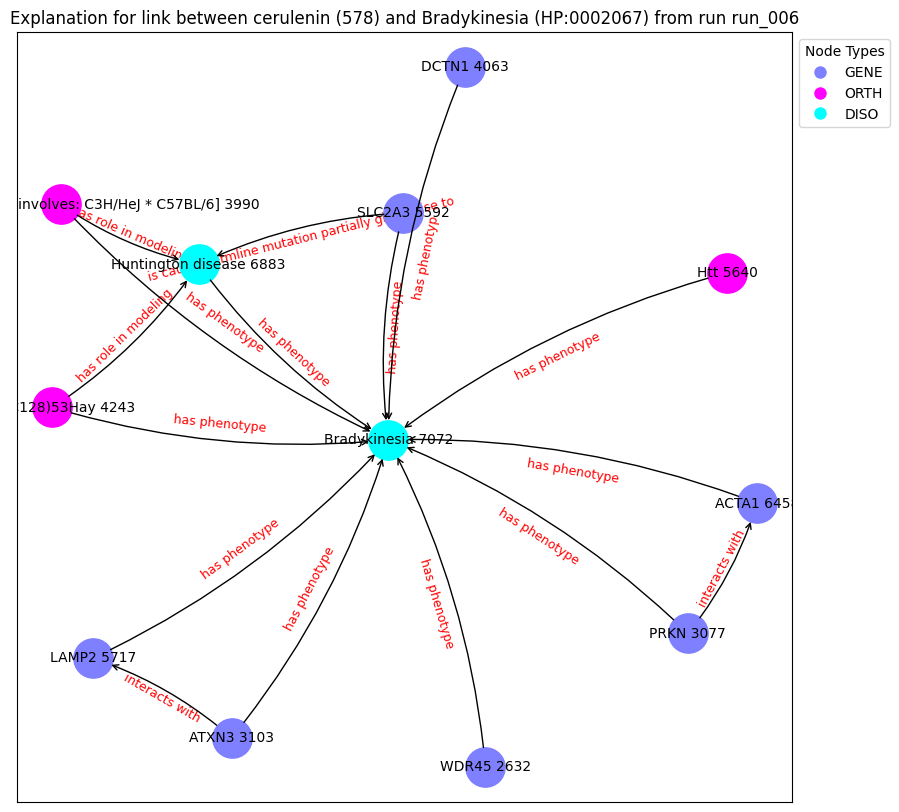

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', {'type': 'ORTH'})
('DCTN1 4063', {'type': 'GENE'})
('Tg(YAC128)53Hay 4243', {'type': 'ORTH'})
('SLC2A3 5592', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('LAMP2 5717', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('Bradykinesia 7072', {'type': 'DISO'})
('WDR45 2632', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('ATXN3 3103', 'Bradykinesia 7072', {'label': 'has phenotype'})
('ATXN3 3103', 'LAMP2 5717', {'label': 'interacts with'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Huntington disease 6883', {'label': 'has role in modeling'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Bradykinesia 7072', {'label': 'has phenotype'})


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 238.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 218.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 245.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 238.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 231.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 238.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 231.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 252.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.23it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic           label  semantic_id
1065      1065  HP:0002141     DISO  Gait imbalance            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 244.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 240.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:03<00:00, 229.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 247.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 236.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:03<00:00, 219.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 246.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 244.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 248.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 242.49it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic      label  semantic_id
13378     13378  HP:0001336     DISO  Myoclonus            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.7741], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 186.91it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.7741], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 187.75it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.7741], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 188.30it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.7741], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 190.97it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.7741], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 177.68it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.7741], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 190.00it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.7741], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 190.69it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.7741], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 188.14it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.7741], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 186.39it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.7741], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 186.98it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


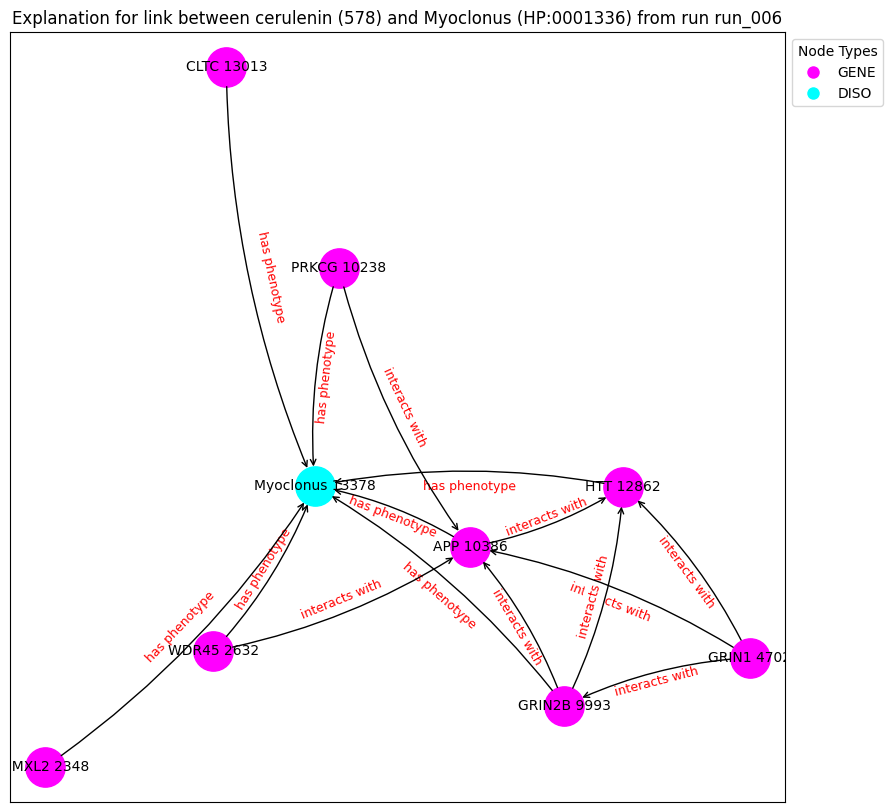

('DMXL2 2348', {'type': 'GENE'})
('WDR45 2632', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('APP 10386', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Myoclonus 13378', {'type': 'DISO'})
('DMXL2 2348', 'Myoclonus 13378', {'label': 'has phenotype'})
('WDR45 2632', 'APP 10386', {'label': 'interacts with'})
('WDR45 2632', 'Myoclonus 13378', {'label': 'has phenotype'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'APP 10386', {'label': 'interacts with'})
('GRIN2B 9993', 'HTT 12862', {'label': 'interacts with'})
('GRIN2B 9993', 'Myoclonus 13378', {'label': 'has phenotype'})
('GRIN2B 9993', 'APP 10386', {'label': 'interacts with'})
('PRKCG 10238', 'APP 10386', {'label': 'interacts with'})
('PRKCG 10238', 'Myoclonus 13378', {'label': 'has phenotype'})
('APP 10386', 'HTT 12862', {'label': 'intera

Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 181.79it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.0867], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 178.23it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.0867], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.20it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.0867], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 175.17it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.0867], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 184.51it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.0867], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.16it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.0867], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.05it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.0867], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.41it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.0867], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.03it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.0867], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 175.82it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


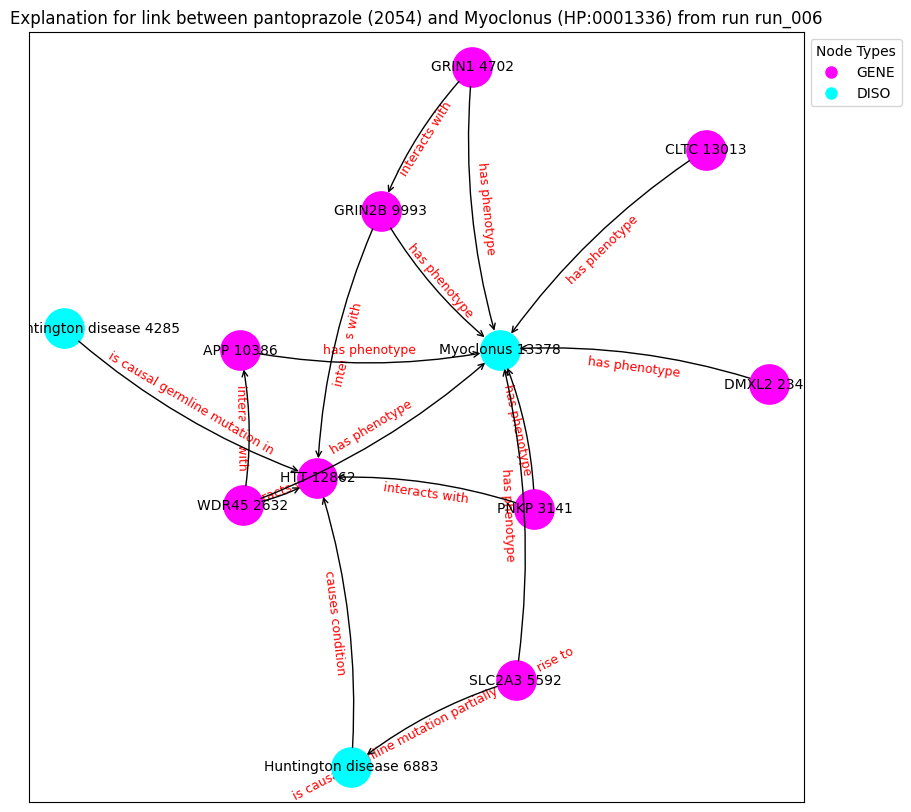

('DMXL2 2348', {'type': 'GENE'})
('WDR45 2632', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('GRIN2B 9993', {'type': 'GENE'})
('APP 10386', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Myoclonus 13378', {'type': 'DISO'})
('DMXL2 2348', 'Myoclonus 13378', {'label': 'has phenotype'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('WDR45 2632', 'APP 10386', {'label': 'interacts with'})
('WDR45 2632', 'Myoclonus 13378', {'label': 'has phenotype'})
('PNKP 3141', 'HTT 12862', {'label': 'interacts with'})
('PNKP 3141', 'Myoclonus 13378', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is causal germline mutation in'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'Myoclonus 13378', {'label': 'has phenoty

Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 185.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1670], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1670], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 202.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1670], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 204.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1670], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1670], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 205.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1670], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 204.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1670], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 202.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1670], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 202.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1670], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 201.55it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
5935      5935  HP:0000713     DISO  Agitation            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.4289], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4289], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4289], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 204.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4289], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4289], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4289], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4289], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4289], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 209.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4289], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4289], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.33it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic    label  semantic_id
3363      3363  HP:0002171     DISO  Gliosis            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.4606], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 199.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4606], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 195.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4606], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 211.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4606], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 204.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4606], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4606], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4606], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4606], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4606], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 189.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4606], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 202.52it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic   label  semantic_id
14731     14731  HP:0002072     DISO  Chorea            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.2583], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:03<00:00, 175.72it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2583], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 174.29it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2583], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 173.46it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2583], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 168.08it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2583], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 171.98it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2583], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.57it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2583], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 172.61it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2583], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 167.22it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2583], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 168.68it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.2583], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 171.07it/s]


Contribution threshold is tensor(0.9936)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


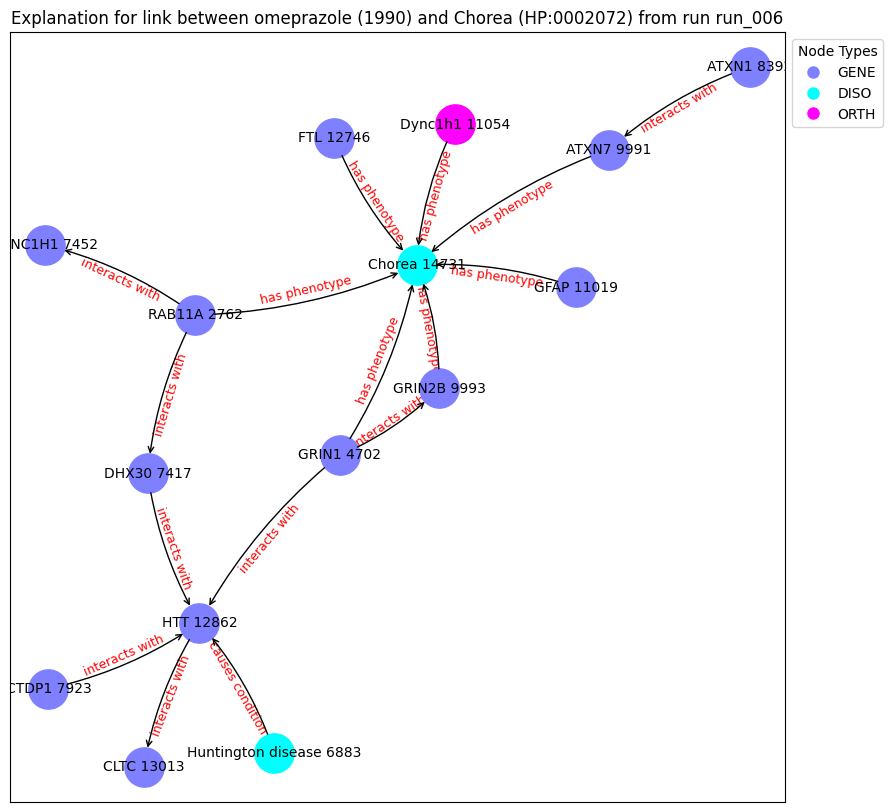

('RAB11A 2762', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('Dync1h1 11054', {'type': 'ORTH'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Chorea 14731', {'type': 'DISO'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Chorea 14731', {'label': 'has phenotype'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'Chorea 14731', {'label': 'has phenotype'})
('Huntington disease 6883', 'HTT 12862', {'label': 'causes condition'})
('DHX30 7417', 'HTT 12862', {'label': 'interacts with'})
(

Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 165.66it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.1170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 157.15it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.1170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 171.49it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 173.44it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.1170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 174.70it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:03<00:00, 176.36it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 174.27it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 171.97it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 171.98it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.1170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 162.92it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


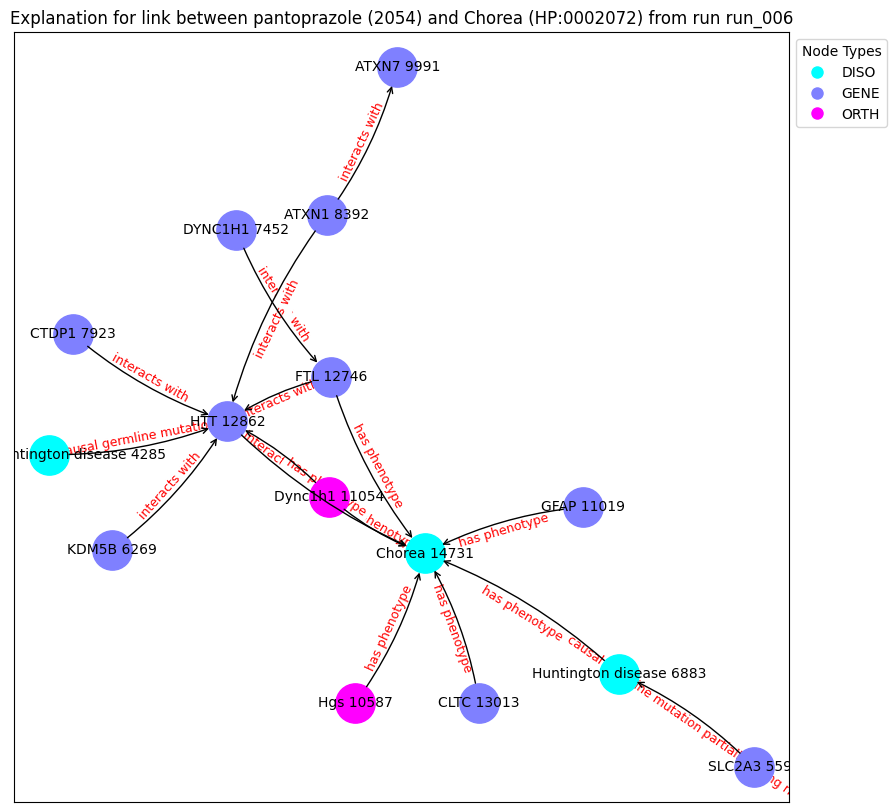

('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('Hgs 10587', {'type': 'ORTH'})
('GFAP 11019', {'type': 'GENE'})
('Dync1h1 11054', {'type': 'ORTH'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Chorea 14731', {'type': 'DISO'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is causal germline mutation in'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('KDM5B 6269', 'HTT 12862', {'label': 'interacts with'})
('Huntington disease 6883', 'Chorea 14731', {'label': 'has phenotype'})
('DYNC1H1 7452', 'FTL 12746', {'label': 'interacts with'})
('CTDP1 7923', 'HTT 12862', {'label': 'interacts with'})
('ATXN1 8392', 

Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:03<00:00, 230.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:03<00:00, 231.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 248.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 239.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 240.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 243.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:03<00:00, 231.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 235.54it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic       label  semantic_id
2824      2824  HP:0002312     DISO  Clumsiness            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:03<00:00, 231.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 246.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 246.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:03<00:00, 225.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 239.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 239.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:03<00:00, 231.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 244.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 247.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 242.14it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic        label  semantic_id
13123     13123  HP:0001824     DISO  Weight loss            1
node2:
      index_id    id semantic           label  semantic_id
2596      2596  5382     DRUG  bempedoic acid            2
Prediction from trained model: tensor([0.0813], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 138.66it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.0813], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 133.93it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.0813], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 137.14it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.0813], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:04<00:00, 140.54it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.0813], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:04<00:00, 140.36it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.0813], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 139.62it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.0813], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:04<00:00, 140.74it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.0813], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 136.76it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.0813], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 133.28it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.0813], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 133.28it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


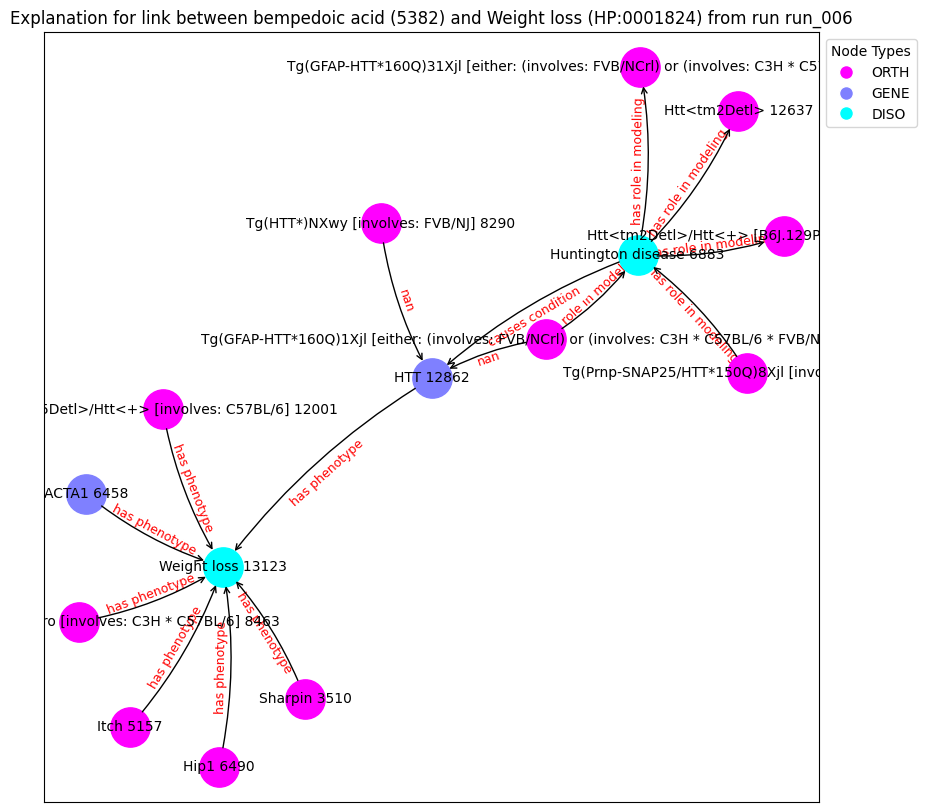

('Sharpin 3510', {'type': 'ORTH'})
('Tg(Prnp-SNAP25/HTT*150Q)8Xjl [involves: FVB] 4474', {'type': 'ORTH'})
('Tg(GFAP-HTT*160Q)1Xjl [either: (involves: FVB/NCrl) or (involves: C3H * C57BL/6 * FVB/NCrl)] 4958', {'type': 'ORTH'})
('Itch 5157', {'type': 'ORTH'})
('ACTA1 6458', {'type': 'GENE'})
('Hip1 6490', {'type': 'ORTH'})
('Huntington disease 6883', {'type': 'DISO'})
('Tg(HTT*)NXwy [involves: FVB/NJ] 8290', {'type': 'ORTH'})
('Tg(Prnp-HTT*82Q)52Caro [involves: C3H * C57BL/6] 8463', {'type': 'ORTH'})
('Htt<tm2Detl>/Htt<+> [B6J.129P2-Htt<tm2Detl>] 9652', {'type': 'ORTH'})
('Htt<tm5Detl>/Htt<+> [involves: C57BL/6] 12001', {'type': 'ORTH'})
('Htt<tm2Detl> 12637', {'type': 'ORTH'})
('Tg(GFAP-HTT*160Q)31Xjl [either: (involves: FVB/NCrl) or (involves: C3H * C57BL/6 * FVB/NCrl)] 12780', {'type': 'ORTH'})
('HTT 12862', {'type': 'GENE'})
('Weight loss 13123', {'type': 'DISO'})
('Sharpin 3510', 'Weight loss 13123', {'label': 'has phenotype'})
('Tg(Prnp-SNAP25/HTT*150Q)8Xjl [involves: FVB] 4474', 

Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5420], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5420], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5420], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5420], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5420], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5420], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5420], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 206.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5420], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 189.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5420], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.50it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                      label  semantic_id
13978     13978  HP:0200136     DISO  Oral-pharyngeal dysphagia            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.0644], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.17it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.0644], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.98it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.0644], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 201.58it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.0644], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 199.92it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.0644], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.92it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.0644], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 203.84it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.0644], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.15it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.0644], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 184.90it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.0644], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 200.13it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.0644], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 199.95it/s]


Contribution threshold is tensor(0.0061)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


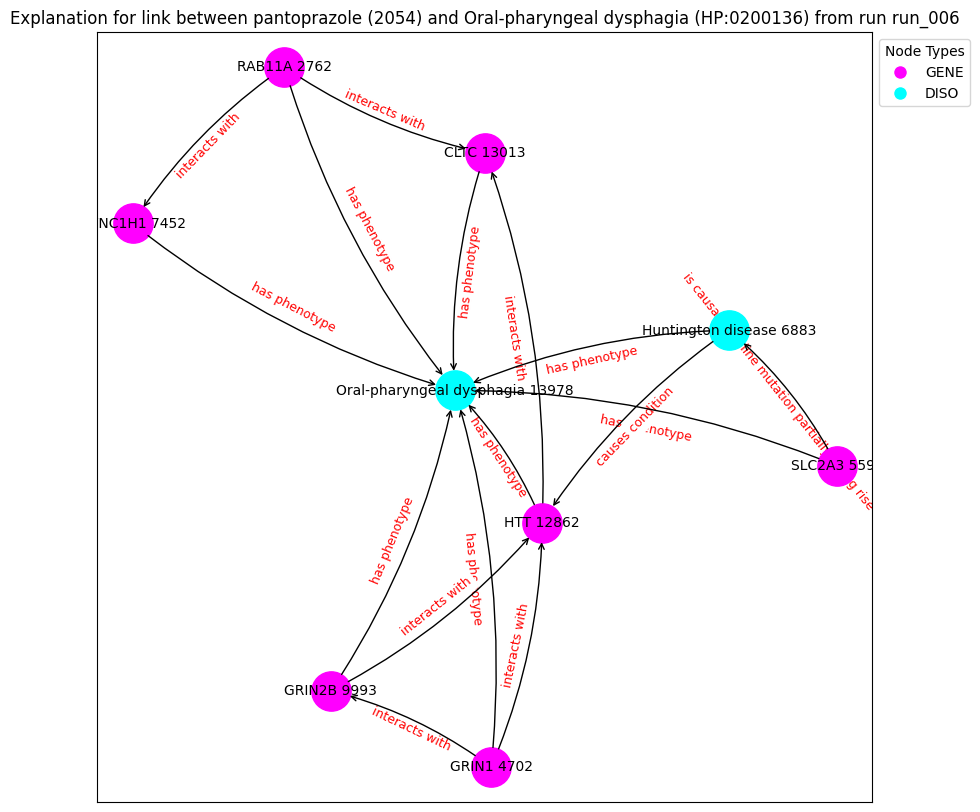

('RAB11A 2762', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Oral-pharyngeal dysphagia 13978', {'type': 'DISO'})
('RAB11A 2762', 'CLTC 13013', {'label': 'interacts with'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('SLC2A3 5592', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('Huntington disease 6883', 'HTT 12862', {'label': 'causes condition'})
('Huntingto

Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1797], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1797], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1797], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 198.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1797], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 200.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1797], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1797], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1797], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1797], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 198.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1797], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.12it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic     label  semantic_id
10333     10333  HP:0000726     DISO  Dementia            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.0522], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 199.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0522], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 201.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0522], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0522], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 198.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0522], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0522], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 176.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0522], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0522], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 198.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0522], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0522], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.66it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic    label  semantic_id
8961      8961  HP:0001250     DISO  Seizure            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.1282], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 140.31it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1282], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 141.38it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1282], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 141.91it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1282], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:05<00:00, 131.03it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1282], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 141.57it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1282], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 142.82it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1282], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:05<00:00, 138.95it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1282], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 140.43it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1282], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 140.38it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1282], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 142.34it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


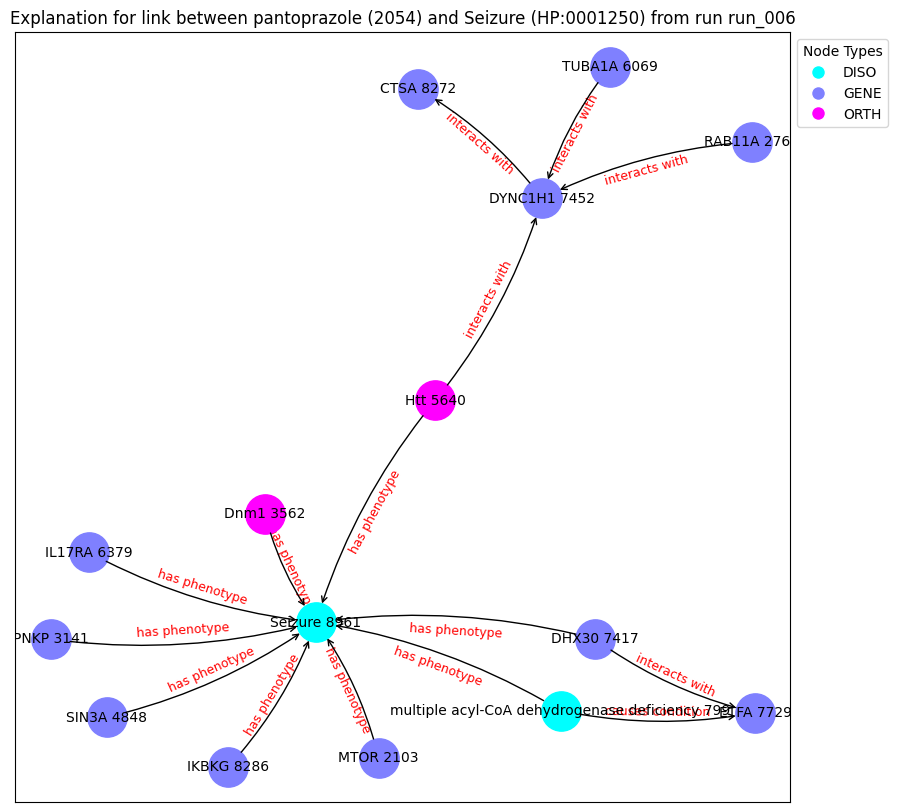

('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('MTOR 2103', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('Dnm1 3562', {'type': 'ORTH'})
('SIN3A 4848', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('TUBA1A 6069', {'type': 'GENE'})
('IL17RA 6379', {'type': 'GENE'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('CTSA 8272', {'type': 'GENE'})
('IKBKG 8286', {'type': 'GENE'})
('Seizure 8961', {'type': 'DISO'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'Seizure 8961', {'label': 'has phenotype'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'ETFA 7729', {'label': 'causes condition'})
('MTOR 2103', 'Seizure 8961', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('PNKP 3141', 'Seizure 8961', {'label': 'has phenotype'})
('Dnm1 3562', 'Seizure 8961', {'label': 'has phenotype'})
('SIN3A 4848', 'Seizure 8961', {'label': 'ha

Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 133.09it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2933], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 130.03it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2933], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 141.37it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2933], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 141.78it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.2933], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 140.41it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2933], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 142.86it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2933], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 139.96it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.2933], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 134.49it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2933], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 140.94it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.2933], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 142.24it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


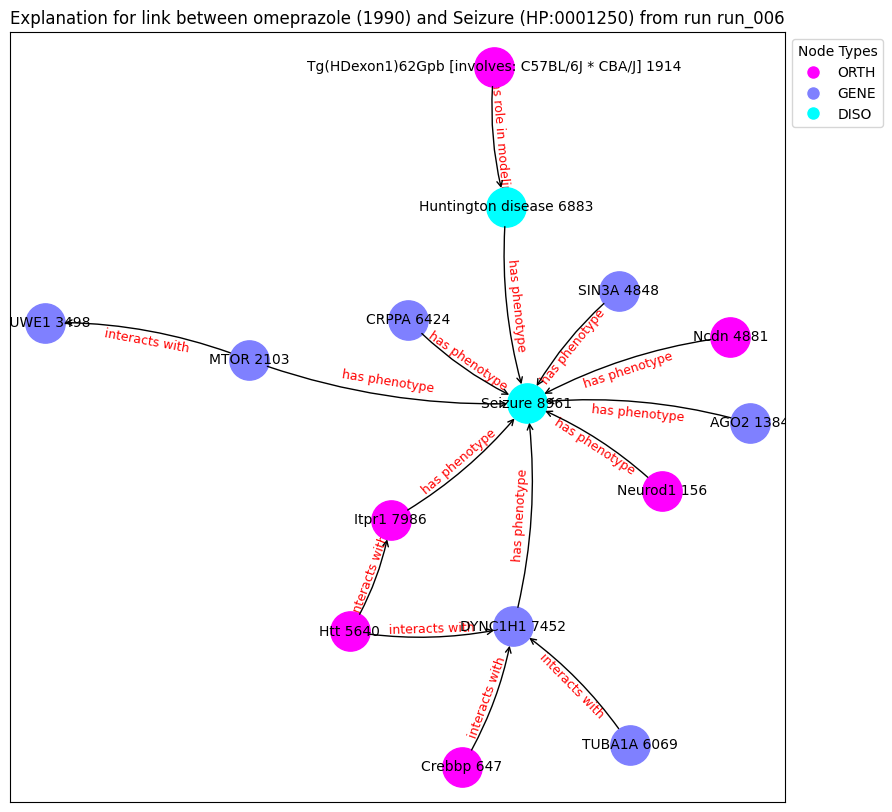

('Neurod1 156', {'type': 'ORTH'})
('Crebbp 647', {'type': 'ORTH'})
('AGO2 1384', {'type': 'GENE'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', {'type': 'ORTH'})
('MTOR 2103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('SIN3A 4848', {'type': 'GENE'})
('Ncdn 4881', {'type': 'ORTH'})
('Htt 5640', {'type': 'ORTH'})
('TUBA1A 6069', {'type': 'GENE'})
('CRPPA 6424', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('Itpr1 7986', {'type': 'ORTH'})
('Seizure 8961', {'type': 'DISO'})
('Neurod1 156', 'Seizure 8961', {'label': 'has phenotype'})
('Crebbp 647', 'DYNC1H1 7452', {'label': 'interacts with'})
('AGO2 1384', 'Seizure 8961', {'label': 'has phenotype'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', 'Huntington disease 6883', {'label': 'has role in modeling'})
('MTOR 2103', 'HUWE1 3498', {'label': 'interacts with'})
('MTOR 2103', 'Seizure 8961', {'label': 'has phenotype'})
('SIN3A 4848', 'Seizure 8961', {'label': 

Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 212.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4138], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4138], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4138], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4138], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4138], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4138], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4138], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4138], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4138], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.65it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
11896     11896  HP:0000737     DISO  Irritability            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.4002], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4002], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4002], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4002], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4002], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4002], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4002], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4002], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4002], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4002], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.68it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                             label  \
1317      1317  HP:0009088     DISO  Speech articulation difficulties   

      semantic_id  
1317            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 239.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 249.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 241.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.75it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                             label  \
1317      1317  HP:0009088     DISO  Speech articulation difficulties   

      semantic_id  
1317            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 246.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 247.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:03<00:00, 219.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 246.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:03<00:00, 232.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 237.04it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
4154      4154  HP:0000746     DISO  Delusions            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 245.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:03<00:00, 206.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:03<00:00, 229.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 246.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.45it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
4154      4154  HP:0000746     DISO  Delusions            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 237.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 239.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 237.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.24it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                         label  \
12562     12562  HP:0001262     DISO  Excessive daytime somnolence   

       semantic_id  
12562            1  
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.0943], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0943], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 215.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0943], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0943], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 215.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0943], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 204.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0943], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 214.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0943], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 218.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0943], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 215.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0943], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 218.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0943], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 212.12it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic           label  semantic_id
5925      5925  HP:0000738     DISO  Hallucinations            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.1431], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1431], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1431], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1431], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 206.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1431], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 218.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1431], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1431], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1431], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 228.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1431], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1431], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.67it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic   label  semantic_id
8154      8154  HP:0000741     DISO  Apathy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.1024], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1024], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 206.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1024], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1024], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1024], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 179.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1024], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 197.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1024], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1024], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 200.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1024], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 206.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1024], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.56it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic  \
9644      9644  HP:0010794     DISO   

                                             label  semantic_id  
9644  Impaired visuospatial constructive cognition            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.0345], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 212.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0345], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0345], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0345], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 212.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0345], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0345], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0345], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0345], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0345], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0345], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.75it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic  \
9644      9644  HP:0010794     DISO   

                                             label  semantic_id  
9644  Impaired visuospatial constructive cognition            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.7252], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 220.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7252], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 212.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7252], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 220.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7252], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7252], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 220.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7252], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7252], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 224.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7252], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 215.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7252], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7252], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.27it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic              label  semantic_id
14773     14773  HP:0002540     DISO  Inability to walk            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.2473], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.20it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.2473], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.34it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2473], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.75it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2473], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.49it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2473], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.85it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2473], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.92it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2473], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.15it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2473], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 180.32it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2473], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.99it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2473], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:04<00:00, 173.16it/s]


Contribution threshold is tensor(0.0062)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


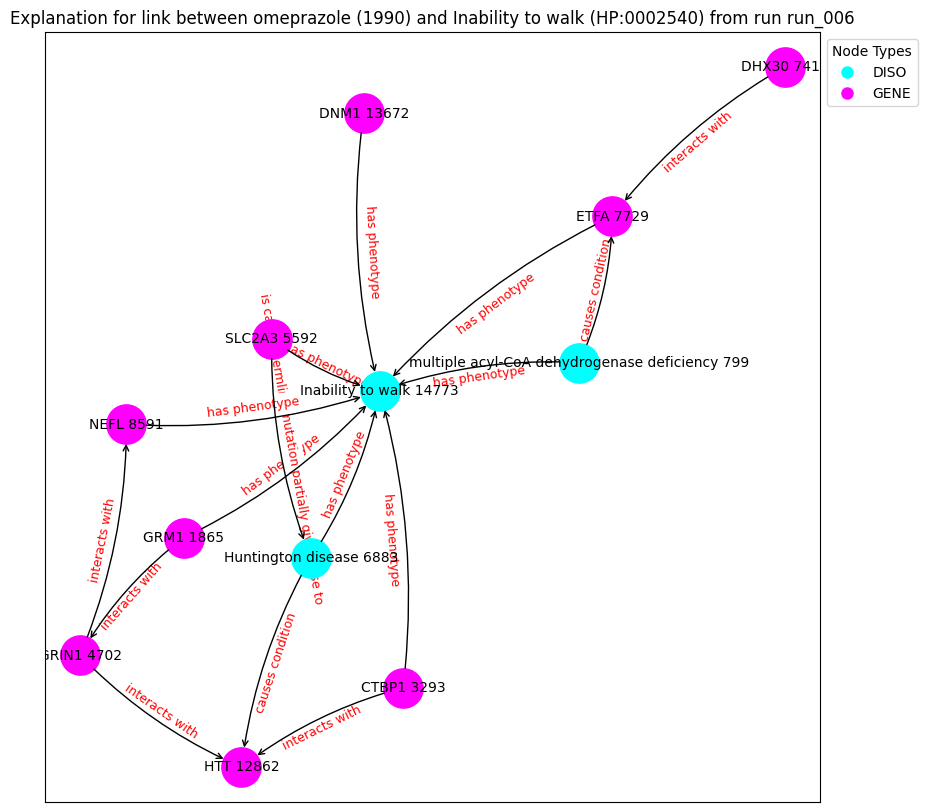

('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('GRM1 1865', {'type': 'GENE'})
('CTBP1 3293', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('DNM1 13672', {'type': 'GENE'})
('Inability to walk 14773', {'type': 'DISO'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'Inability to walk 14773', {'label': 'has phenotype'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'ETFA 7729', {'label': 'causes condition'})
('GRM1 1865', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('CTBP1 3293', 'HTT 12862', {'label': 'interacts with'})
('CTBP1 3293', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'NEFL 8591', {'labe

Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 181.44it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.0671], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.36it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.0671], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.22it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.0671], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.18it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.0671], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.75it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.0671], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.52it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.0671], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.29it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.0671], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 183.98it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.0671], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.39it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.0671], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 181.59it/s]


Contribution threshold is tensor(0.0062)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


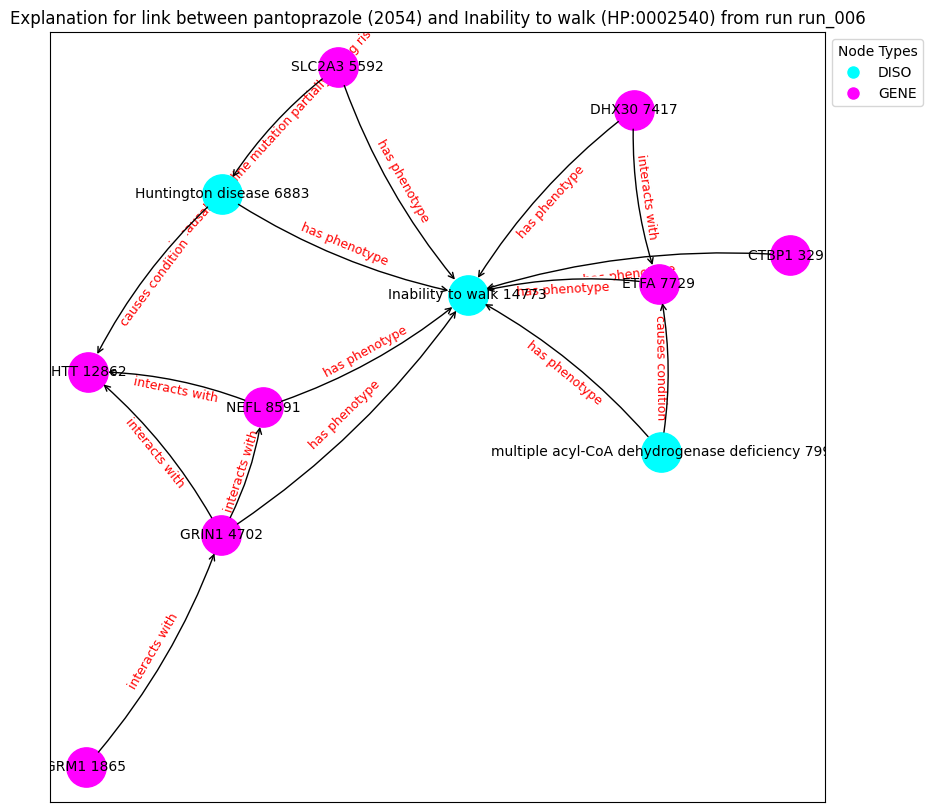

('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('GRM1 1865', {'type': 'GENE'})
('CTBP1 3293', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Inability to walk 14773', {'type': 'DISO'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'Inability to walk 14773', {'label': 'has phenotype'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'ETFA 7729', {'label': 'causes condition'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('CTBP1 3293', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'NEFL 8591', {'label': 'interacts with'})
('GRIN1 4702', 'Inability to walk 14773', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal ge

Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 248.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.72it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                      label  semantic_id
3165      3165  HP:0045082     DISO  Decreased body mass index            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 233.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:03<00:00, 232.95it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                    label  \
917       917  HP:0002529     DISO  Neuronal loss in central nervous system   

     semantic_id  
917            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 237.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 246.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 243.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 232.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 237.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.26it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                    label  \
917       917  HP:0002529     DISO  Neuronal loss in central nervous system   

     semantic_id  
917            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 239.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 247.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 246.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 239.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.66it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 240.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:03<00:00, 217.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 241.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 252.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 243.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 244.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:03<00:00, 232.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 241.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 248.63it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:03<00:00, 225.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 241.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 238.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:03<00:00, 232.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:03<00:00, 232.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:03<00:00, 219.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 239.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 246.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 245.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 240.32it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 244.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 239.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 236.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 248.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 234.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:03<00:00, 218.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 242.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:03<00:00, 227.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 242.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 237.14it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                         label  semantic_id
9801      9801  HP:0007010     DISO  Poor fine motor coordination            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.1573], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1573], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1573], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1573], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1573], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1573], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 211.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1573], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1573], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1573], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1573], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.49it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                         label  semantic_id
9801      9801  HP:0007010     DISO  Poor fine motor coordination            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.7481], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 213.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7481], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 220.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7481], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 216.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7481], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 218.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7481], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 213.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7481], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 207.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7481], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7481], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7481], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 209.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7481], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 207.06it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic       label  semantic_id
14527     14527  HP:0030955     DISO  Alcoholism            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.2088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 210.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 206.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 211.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.95it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic       label  semantic_id
14527     14527  HP:0030955     DISO  Alcoholism            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.7313], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7313], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 212.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7313], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 213.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7313], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 214.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7313], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 218.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7313], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 215.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7313], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 207.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7313], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 215.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7313], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 203.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7313], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 213.45it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic             label  semantic_id
8158      8158  HP:0002059     DISO  Cerebral atrophy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.2935], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 178.98it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.2935], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.98it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.2935], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.19it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.2935], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 178.09it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.2935], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.95it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.2935], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.70it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.2935], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.81it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.2935], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.95it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.2935], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.55it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.2935], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.03it/s]


Contribution threshold is tensor(0.0062)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


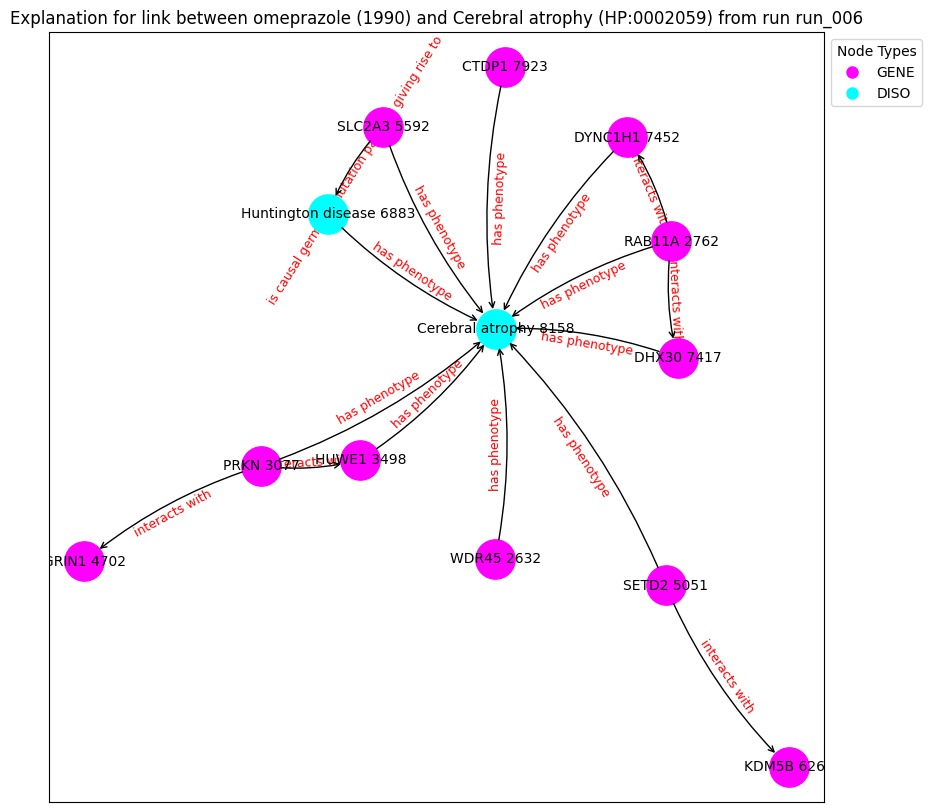

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('Cerebral atrophy 8158', {'type': 'DISO'})
('WDR45 2632', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('HUWE1 3498', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('SETD2 5051', 'KDM5B 6269', {'label':

Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:04<00:00, 167.01it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1357], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:04<00:00, 168.26it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1357], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.92it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1357], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 181.31it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1357], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 177.65it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1357], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.15it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.1357], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.44it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1357], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.09it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.1357], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 181.43it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1357], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.74it/s]


Contribution threshold is tensor(0.0061)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


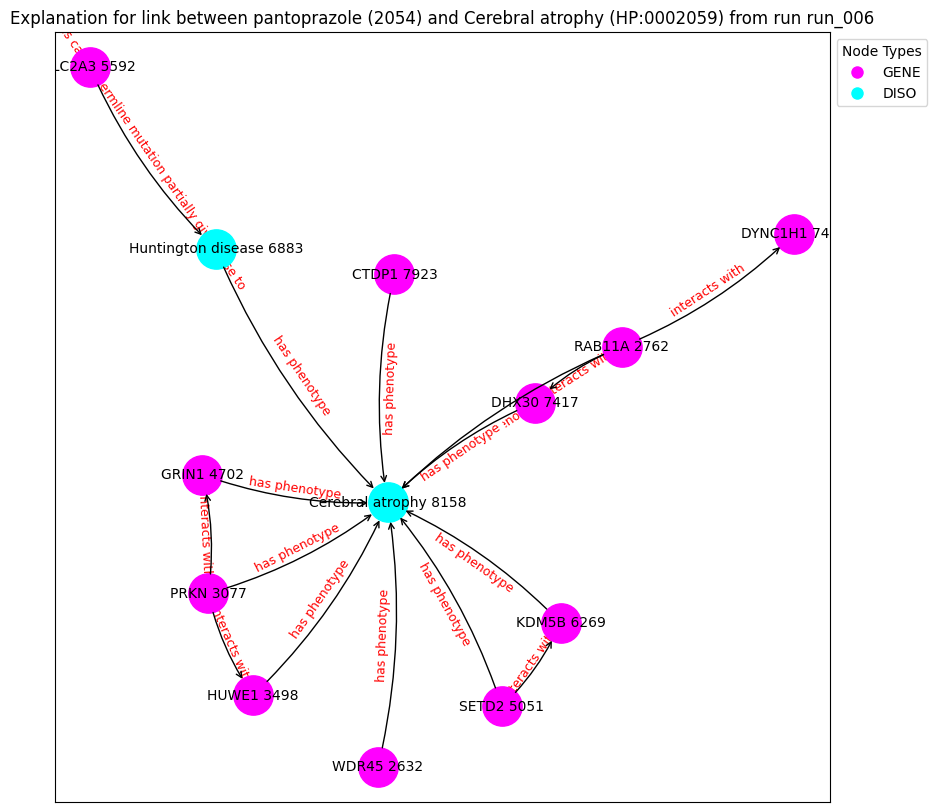

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('Cerebral atrophy 8158', {'type': 'DISO'})
('WDR45 2632', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('HUWE1 3498', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('GRIN1 4702', 'Cerebral atrophy 8158'

Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 233.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 243.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 233.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 241.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 223.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 233.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 231.83it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic          label  semantic_id
12039     12039  HP:0001347     DISO  Hyperreflexia            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.2944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.01it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.34it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.61it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 165.67it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 169.30it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.2944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 164.66it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 160.48it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 166.50it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.97it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 169.64it/s]


Contribution threshold is tensor(0.9936)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


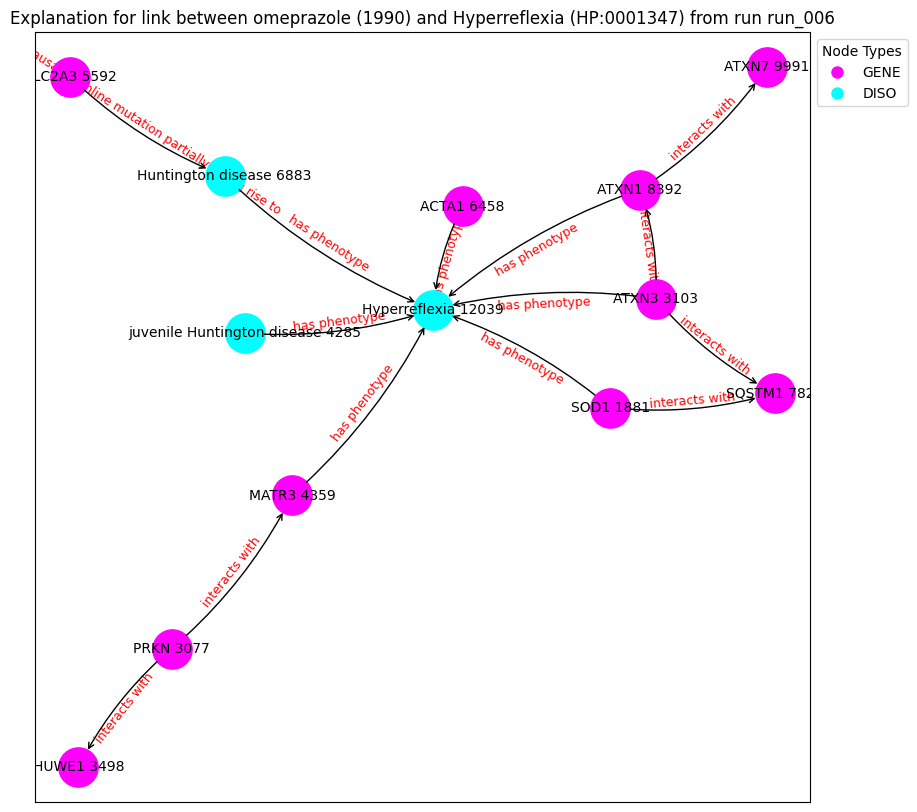

('SOD1 1881', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('MATR3 4359', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('SOD1 1881', 'SQSTM1 7821', {'label': 'interacts with'})
('SOD1 1881', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'MATR3 4359', {'label': 'interacts with'})
('ATXN3 3103', 'SQSTM1 7821', {'label': 'interacts with'})
('ATXN3 3103', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('ATXN3 3103', 'ATXN1 8392', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('MATR3 4359', 'Hyp

Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 155.68it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 163.48it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.1166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 162.14it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.1166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 172.98it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.1166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 160.35it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 170.43it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 169.49it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 170.85it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 168.05it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1166], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 169.89it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


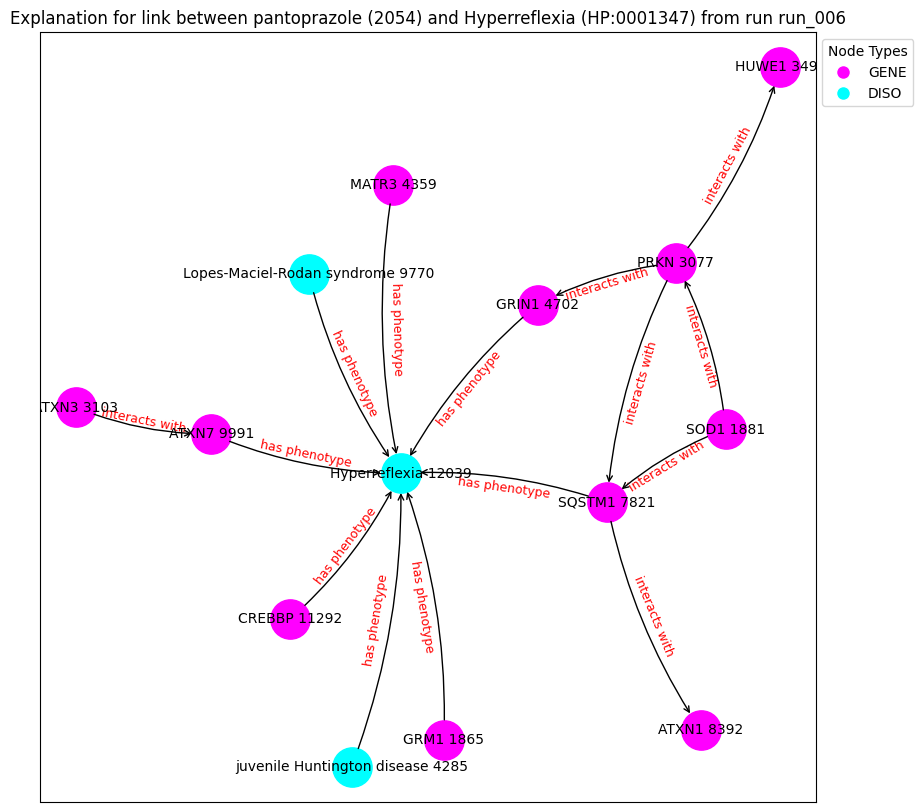

('GRM1 1865', {'type': 'GENE'})
('SOD1 1881', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('MATR3 4359', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('Lopes-Maciel-Rodan syndrome 9770', {'type': 'DISO'})
('ATXN7 9991', {'type': 'GENE'})
('CREBBP 11292', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('GRM1 1865', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('SOD1 1881', 'PRKN 3077', {'label': 'interacts with'})
('SOD1 1881', 'SQSTM1 7821', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'SQSTM1 7821', {'label': 'interacts with'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('ATXN3 3103', 'ATXN7 9991', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'Hyperreflexia 12039', {'label': 'has p

Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 162.24it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.7063], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 165.01it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7063], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 150.38it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.7063], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 162.83it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.7063], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 171.50it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7063], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 164.89it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7063], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 161.12it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7063], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 164.34it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7063], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 171.75it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7063], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 153.70it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


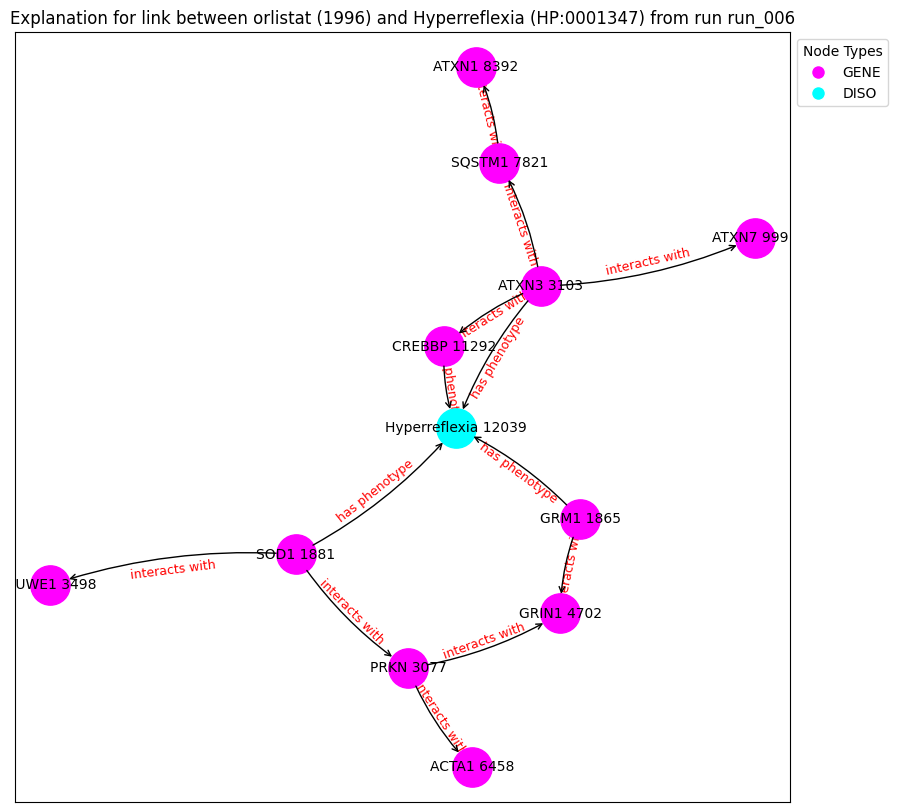

('GRM1 1865', {'type': 'GENE'})
('SOD1 1881', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('CREBBP 11292', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('GRM1 1865', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('SOD1 1881', 'HUWE1 3498', {'label': 'interacts with'})
('SOD1 1881', 'PRKN 3077', {'label': 'interacts with'})
('SOD1 1881', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('ATXN3 3103', 'SQSTM1 7821', {'label': 'interacts with'})
('ATXN3 3103', 'CREBBP 11292', {'label': 'interacts with'})
('ATXN3 3103', 'ATXN7 9991', {'label': 'interacts with'})
('AT

Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 192.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4134], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 196.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4134], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4134], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4134], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4134], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4134], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4134], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4134], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4134], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 210.61it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
1369      1369  HP:0000751     DISO  Personality changes            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 241.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 246.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 244.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 247.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 252.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.87it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
1369      1369  HP:0000751     DISO  Personality changes            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 243.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 249.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 241.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 243.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.02it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic     label  semantic_id
13477     13477  HP:0002063     DISO  Rigidity            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.1191], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.85it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.1191], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.15it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.1191], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.44it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.1191], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.35it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1191], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.26it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.1191], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.08it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.1191], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.18it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1191], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.20it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.1191], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 176.98it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1191], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.82it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


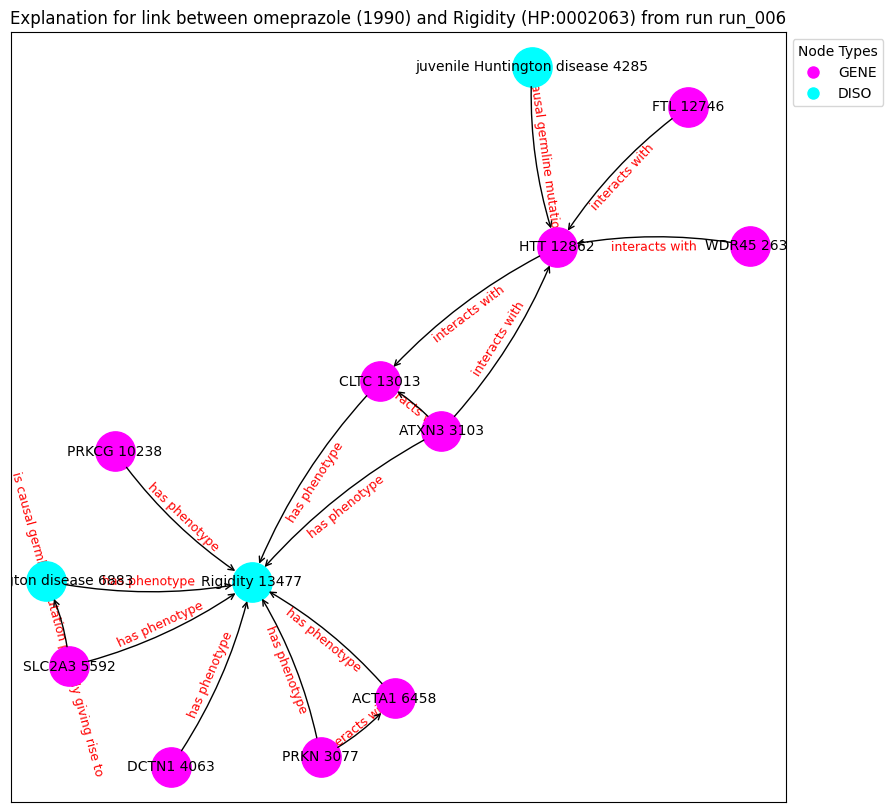

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('PRKCG 10238', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Rigidity 13477', {'type': 'DISO'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'Rigidity 13477', {'label': 'has phenotype'})
('ATXN3 3103', 'HTT 12862', {'label': 'interacts with'})
('ATXN3 3103', 'CLTC 13013', {'label': 'interacts with'})
('ATXN3 3103', 'Rigidity 13477', {'label': 'has phenotype'})
('DCTN1 4063', 'Rigidity 13477', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is causal germline mutation in'})
('SLC2A3 5592', 'Rigidity 1

Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 179.32it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.0358], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 176.90it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.0358], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 183.66it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.0358], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.58it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.0358], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.58it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.0358], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.62it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.0358], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 175.25it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.0358], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.00it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.0358], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.21it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.0358], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.18it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


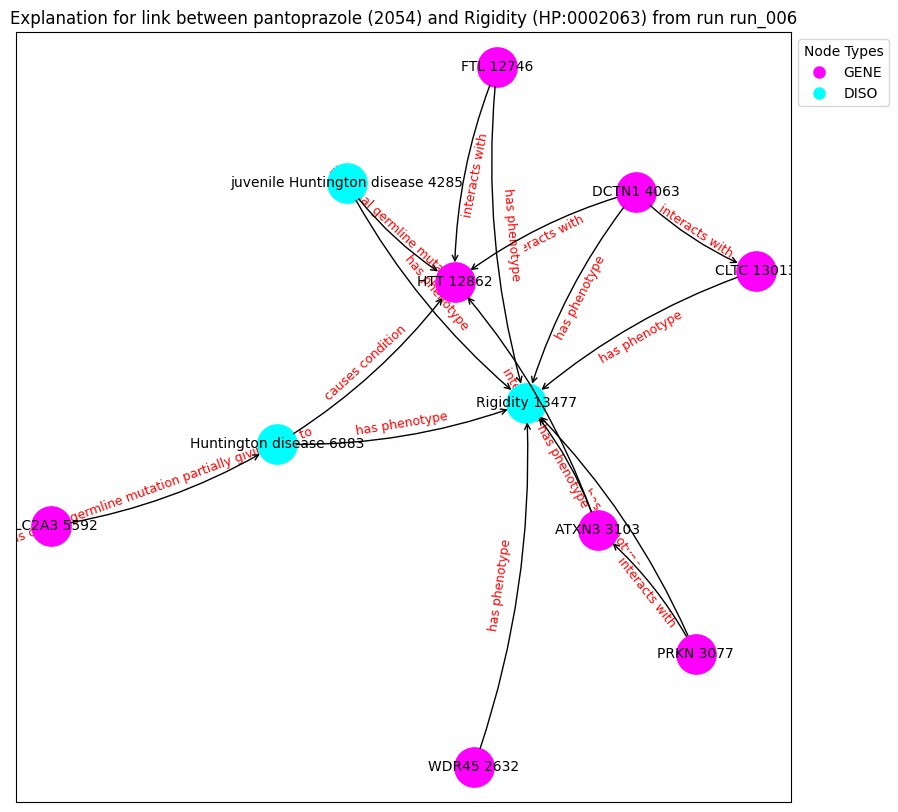

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Rigidity 13477', {'type': 'DISO'})
('WDR45 2632', 'Rigidity 13477', {'label': 'has phenotype'})
('PRKN 3077', 'Rigidity 13477', {'label': 'has phenotype'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'HTT 12862', {'label': 'interacts with'})
('ATXN3 3103', 'Rigidity 13477', {'label': 'has phenotype'})
('DCTN1 4063', 'HTT 12862', {'label': 'interacts with'})
('DCTN1 4063', 'CLTC 13013', {'label': 'interacts with'})
('DCTN1 4063', 'Rigidity 13477', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is causal germline mutation in'})
('juvenile Huntington disease 428

Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 211.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 241.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 246.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 240.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 247.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 223.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 241.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 229.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 241.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 246.07it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                      label  \
434       434  HP:0002500     DISO  Abnormal cerebral white matter morphology   

     semantic_id  
434            1  
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 240.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 246.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 241.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 243.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 246.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:03<00:00, 218.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 243.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 240.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 233.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 245.41it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                      label  \
434       434  HP:0002500     DISO  Abnormal cerebral white matter morphology   

     semantic_id  
434            1  
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 239.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 243.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 235.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 242.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 234.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 237.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:03<00:00, 229.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 236.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:03<00:00, 228.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 248.15it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic          label  semantic_id
13239     13239  HP:0003487     DISO  Babinski sign            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.2983], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 171.52it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2983], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 174.31it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2983], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 175.48it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2983], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 169.57it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2983], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 171.25it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.2983], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 179.13it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2983], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 179.62it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.2983], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 171.58it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2983], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 176.91it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2983], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 175.70it/s]


Contribution threshold is tensor(0.9936)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


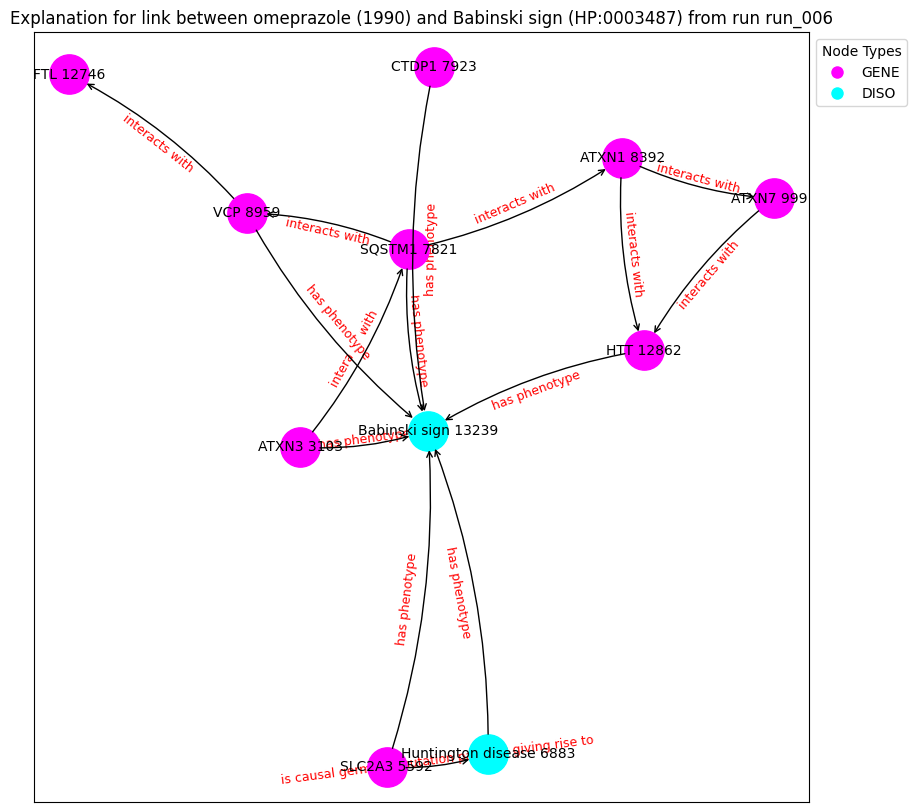

('ATXN3 3103', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Babinski sign 13239', {'type': 'DISO'})
('ATXN3 3103', 'SQSTM1 7821', {'label': 'interacts with'})
('ATXN3 3103', 'Babinski sign 13239', {'label': 'has phenotype'})
('SLC2A3 5592', 'Babinski sign 13239', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('Huntington disease 6883', 'Babinski sign 13239', {'label': 'has phenotype'})
('SQSTM1 7821', 'VCP 8959', {'label': 'interacts with'})
('SQSTM1 7821', 'Babinski sign 13239', {'label': 'has phenotype'})
('SQSTM1 7821', 'ATXN1 8392', {'label': 'interacts with'})
('CTDP1 7923', 'Babinski sign 13239', {'label': 'has 

Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:04<00:00, 173.63it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.1136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:04<00:00, 161.95it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:04<00:00, 171.61it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:04<00:00, 174.45it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 178.48it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 181.41it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 175.13it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.1136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:04<00:00, 173.94it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 175.21it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 178.17it/s]


Contribution threshold is tensor(0.9936)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


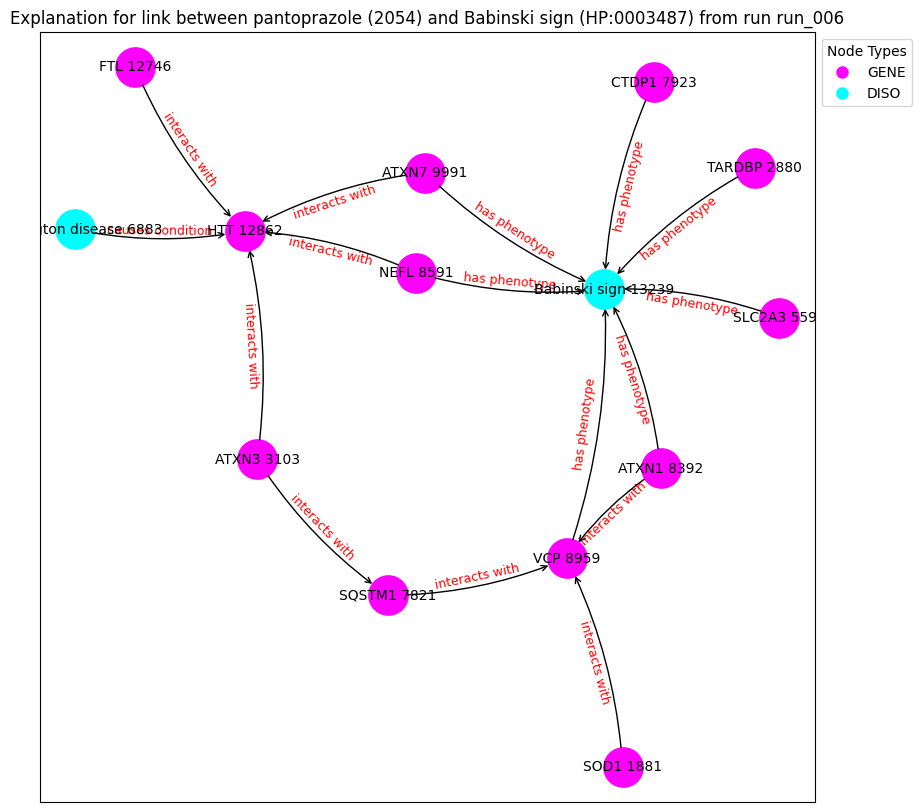

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Babinski sign 13239', {'type': 'DISO'})
('SOD1 1881', 'VCP 8959', {'label': 'interacts with'})
('TARDBP 2880', 'Babinski sign 13239', {'label': 'has phenotype'})
('ATXN3 3103', 'SQSTM1 7821', {'label': 'interacts with'})
('ATXN3 3103', 'HTT 12862', {'label': 'interacts with'})
('SLC2A3 5592', 'Babinski sign 13239', {'label': 'has phenotype'})
('Huntington disease 6883', 'HTT 12862', {'label': 'causes condition'})
('SQSTM1 7821', 'VCP 8959', {'label': 'interacts with'})
('CTDP1 7923', 'Babinski sign 13239', {'label': 'has phenotype'})
('ATXN1 8392', 'VCP

Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 199.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1833], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 209.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1833], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1833], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1833], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1833], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1833], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1833], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1833], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1833], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 202.78it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
13783     13783  HP:0031843     DISO  Bradyphrenia            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.7319], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7319], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7319], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 211.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7319], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 218.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7319], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 220.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7319], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7319], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 211.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7319], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7319], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7319], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 200.91it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic            label  semantic_id
830       830  HP:0002340     DISO  Caudate atrophy            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 251.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 248.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 241.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 236.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 244.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.25it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic            label  semantic_id
830       830  HP:0002340     DISO  Caudate atrophy            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 235.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 247.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 245.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 235.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.79it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic             label  semantic_id
13592     13592  HP:0001288     DISO  Gait disturbance            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.6012], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 129.27it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6012], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 125.74it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6012], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 129.30it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6012], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 123.06it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6012], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 125.49it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6012], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 129.89it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6012], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 127.63it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6012], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 129.75it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6012], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 127.76it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6012], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 123.20it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


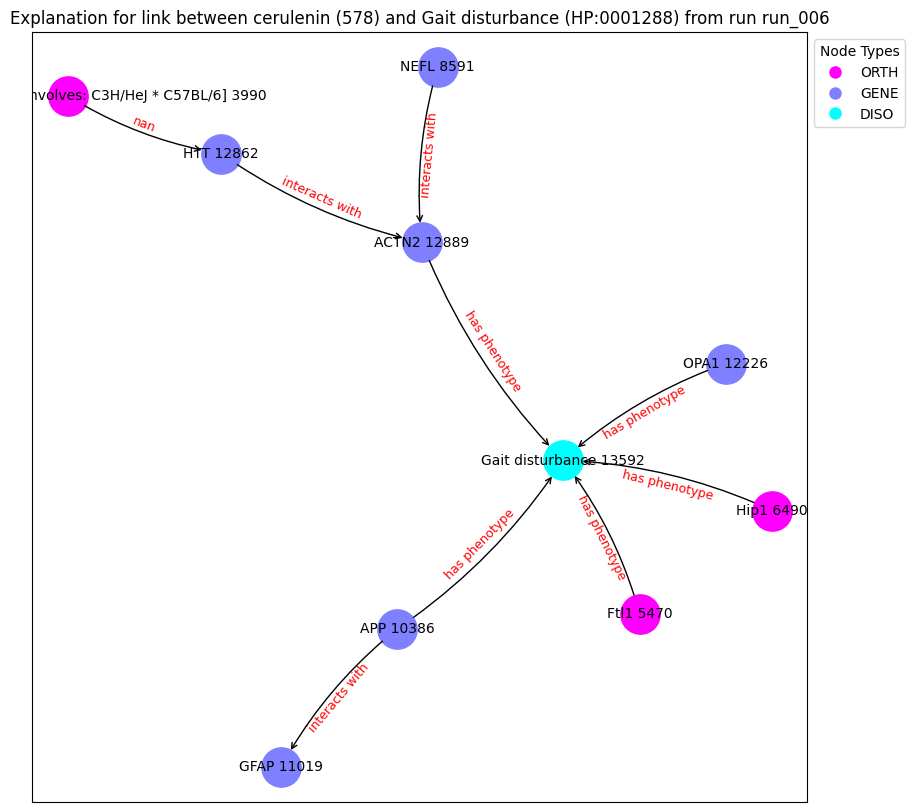

('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', {'type': 'ORTH'})
('Ftl1 5470', {'type': 'ORTH'})
('Hip1 6490', {'type': 'ORTH'})
('NEFL 8591', {'type': 'GENE'})
('APP 10386', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('OPA1 12226', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('ACTN2 12889', {'type': 'GENE'})
('Gait disturbance 13592', {'type': 'DISO'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'HTT 12862', {'label': nan})
('Ftl1 5470', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Hip1 6490', 'Gait disturbance 13592', {'label': 'has phenotype'})
('NEFL 8591', 'ACTN2 12889', {'label': 'interacts with'})
('APP 10386', 'GFAP 11019', {'label': 'interacts with'})
('APP 10386', 'Gait disturbance 13592', {'label': 'has phenotype'})
('OPA1 12226', 'Gait disturbance 13592', {'label': 'has phenotype'})
('HTT 12862', 'ACTN2 12889', {'label': 'interacts with'})
('ACTN2 12889', 'Gait disturbance 13592', {'label': 'has phenotype'})
Explanation grap

Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 218.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3964], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3964], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 206.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3964], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 211.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3964], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 206.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3964], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3964], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 211.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3964], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 223.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3964], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 228.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3964], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 199.25it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                        label  semantic_id
4071      4071  HP:0003324     DISO  Generalized muscle weakness            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.1141], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 198.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1141], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 226.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1141], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 203.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1141], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 221.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1141], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 225.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1141], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 219.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1141], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 221.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1141], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 211.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1141], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 221.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1141], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 226.61it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                        label  semantic_id
4071      4071  HP:0003324     DISO  Generalized muscle weakness            1
node2:
      index_id    id semantic     label  semantic_id
1000      1000  1996     DRUG  orlistat            2
Prediction from trained model: tensor([0.7126], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 217.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7126], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 214.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7126], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 217.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7126], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 223.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7126], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 201.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7126], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 226.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7126], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 227.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7126], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 207.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7126], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 227.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7126], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 222.07it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic  \
5436      5436  HP:0003107     DISO   

                                               label  semantic_id  
5436  Abnormal circulating cholesterol concentration            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 239.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 235.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 235.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.53it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic  \
5436      5436  HP:0003107     DISO   

                                               label  semantic_id  
5436  Abnormal circulating cholesterol concentration            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:03<00:00, 215.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 237.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:03<00:00, 218.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:03<00:00, 219.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.18it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
1951      1951  HP:0002354     DISO  Memory impairment            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:03<00:00, 208.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:03<00:00, 212.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 244.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:03<00:00, 216.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 235.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:03<00:00, 233.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 239.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:03<00:00, 211.04it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
1951      1951  HP:0002354     DISO  Memory impairment            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:03<00:00, 229.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:03<00:00, 224.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 245.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 238.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 243.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 238.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:03<00:00, 225.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 240.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 235.68it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\run_007
(0, {'node_feature': tensor([ 2.0939e-01, -6.5249e-01, -3.1399e-01,  1.1513e+00, -3.0226e-01,
         2.0646e-01,  3.4805e-01, -1.1440e+00, -1.1742e-01, -3.1274e-01,
        -2.1207e-01, -6.3210e-01,  3.2343e-01,  6.1437e-02, -5.2703e-01,
        -1.2456e+00,  2.4462e-01, -1.2047e-01, -6.6474e-01,  1.6438e-01,
         4.6073e-03,  4.3452e-01,  9.9916e-02,  3.4763e-02, -5.1334e-01,
        -9.2941e-02,  1.0591e-04,  3.1225e-01, -1.4063e-01, -8.4536e-01,
        -4.8101e-01,  4.2253e-01])})
(0, 11953, {'edge_label': 'in orthology relationship with'})
Number of edges is 134749
Number of nodes is 14833
node1:
       index_id          id semantic       label  semantic_id
13668     13668  HP:0000716     DISO  Depression            1
node2:
     index_id    id semantic       label  semantic_id
998       998  199

Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 142.92it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6650], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 146.96it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6650], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 148.51it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6650], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 155.79it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6650], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 148.17it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6650], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 153.92it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6650], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 159.62it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6650], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 162.26it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6650], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 156.81it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6650], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 153.74it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


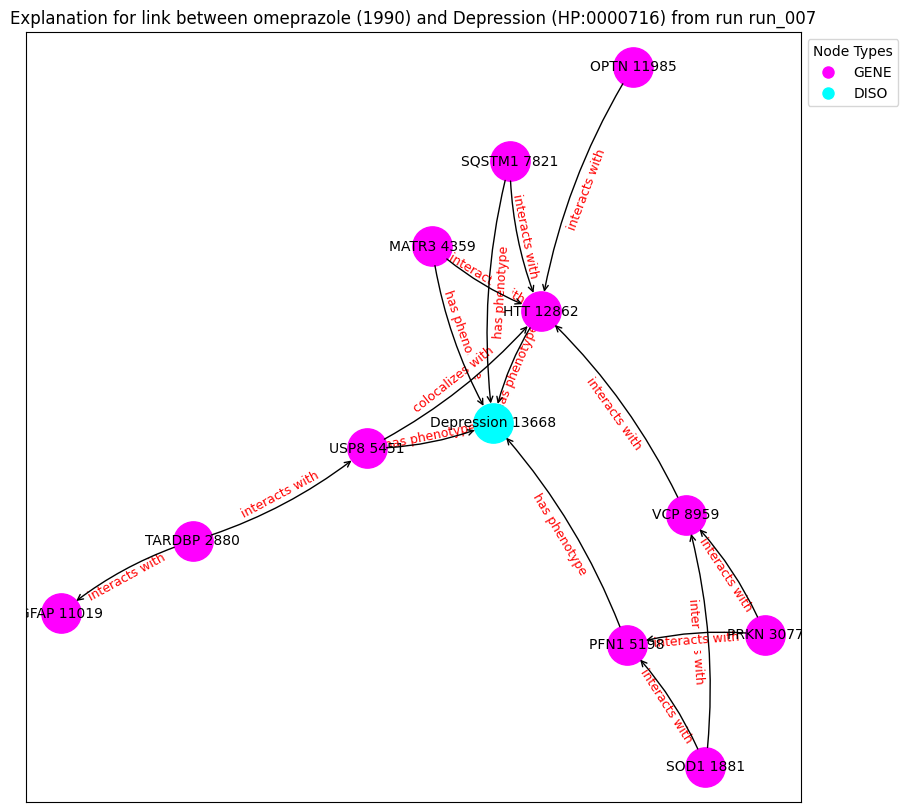

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('MATR3 4359', {'type': 'GENE'})
('PFN1 5198', {'type': 'GENE'})
('USP8 5451', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('SOD1 1881', 'PFN1 5198', {'label': 'interacts with'})
('SOD1 1881', 'VCP 8959', {'label': 'interacts with'})
('TARDBP 2880', 'GFAP 11019', {'label': 'interacts with'})
('TARDBP 2880', 'USP8 5451', {'label': 'interacts with'})
('PRKN 3077', 'VCP 8959', {'label': 'interacts with'})
('PRKN 3077', 'PFN1 5198', {'label': 'interacts with'})
('MATR3 4359', 'HTT 12862', {'label': 'interacts with'})
('MATR3 4359', 'Depression 13668', {'label': 'has phenotype'})
('PFN1 5198', 'Depression 13668', {'label': 'has phenotype'})
('USP8 5451', 'HTT 12862', {'label': 'colocalizes with'})
('USP8 5451', 'Depressio

Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 159.30it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7132], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 145.89it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7132], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 163.41it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7132], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 162.56it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7132], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 164.38it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7132], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 160.66it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7132], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 140.07it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7132], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 163.83it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7132], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 166.27it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7132], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 163.48it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


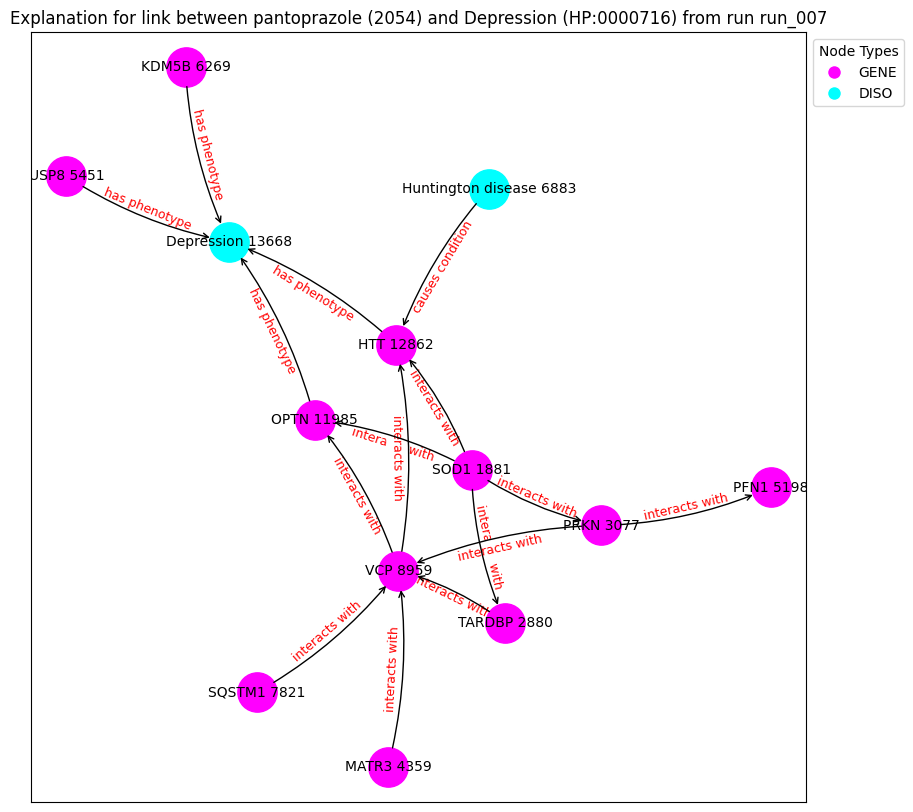

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('MATR3 4359', {'type': 'GENE'})
('PFN1 5198', {'type': 'GENE'})
('USP8 5451', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('SOD1 1881', 'PRKN 3077', {'label': 'interacts with'})
('SOD1 1881', 'HTT 12862', {'label': 'interacts with'})
('SOD1 1881', 'OPTN 11985', {'label': 'interacts with'})
('SOD1 1881', 'TARDBP 2880', {'label': 'interacts with'})
('TARDBP 2880', 'VCP 8959', {'label': 'interacts with'})
('PRKN 3077', 'VCP 8959', {'label': 'interacts with'})
('PRKN 3077', 'PFN1 5198', {'label': 'interacts with'})
('MATR3 4359', 'VCP 8959', {'label': 'interacts with'})
('USP8 5451', 'Depression 13668', {'label': 'has phenotype'})
('KDM5B 6269', 'Depression 13668', {'label':

Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 160.75it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8018], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 155.24it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8018], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 145.33it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8018], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 153.45it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8018], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 156.28it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8018], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 167.67it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8018], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 163.04it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8018], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 165.49it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8018], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 160.92it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8018], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 166.71it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


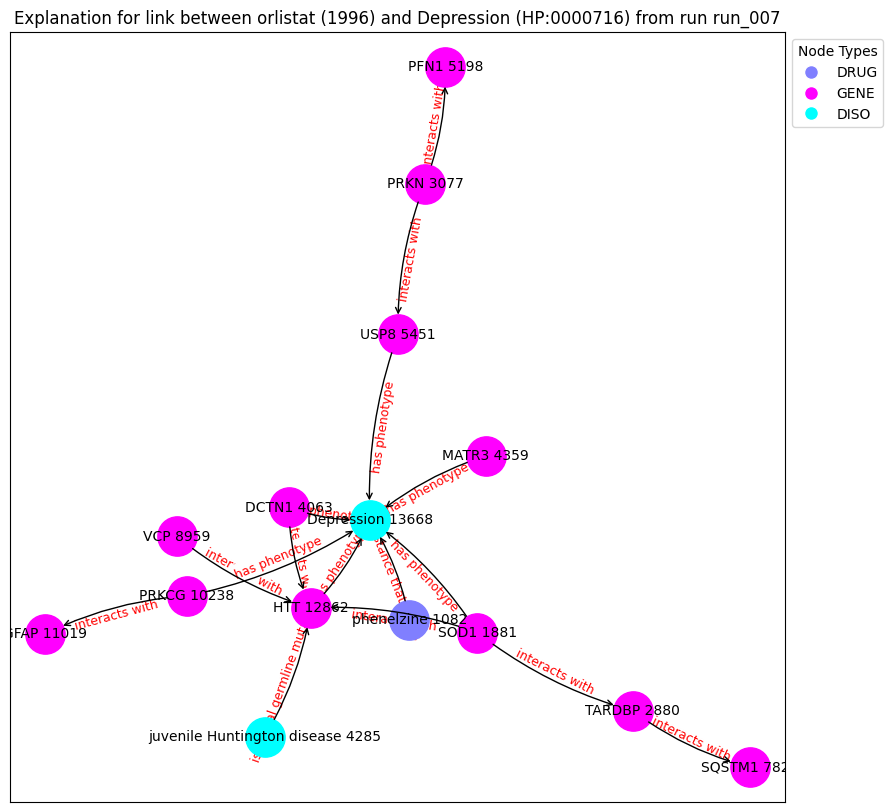

('phenelzine 1082', {'type': 'DRUG'})
('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('MATR3 4359', {'type': 'GENE'})
('PFN1 5198', {'type': 'GENE'})
('USP8 5451', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('phenelzine 1082', 'Depression 13668', {'label': 'is substance that treats'})
('SOD1 1881', 'HTT 12862', {'label': 'interacts with'})
('SOD1 1881', 'TARDBP 2880', {'label': 'interacts with'})
('SOD1 1881', 'Depression 13668', {'label': 'has phenotype'})
('TARDBP 2880', 'SQSTM1 7821', {'label': 'interacts with'})
('PRKN 3077', 'USP8 5451', {'label': 'interacts with'})
('PRKN 3077', 'PFN1 5198', {'label': 'interacts with'})
('DCTN1 4063', 'HTT 12862', {'label': 'interacts 

Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 219.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 210.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 215.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:02<00:00, 233.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.99it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                         label  semantic_id
5086      5086  HP:0040140     DISO  Degeneration of the striatum            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.6132], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6132], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6132], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6132], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6132], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6132], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6132], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6132], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6132], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6132], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.77it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic     label  semantic_id
12933     12933  HP:0001332     DISO  Dystonia            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6255], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 141.37it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6255], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 148.62it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6255], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 148.55it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6255], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 145.88it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6255], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 147.07it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6255], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 147.70it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6255], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 148.58it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6255], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 142.51it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6255], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 144.63it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6255], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 145.38it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


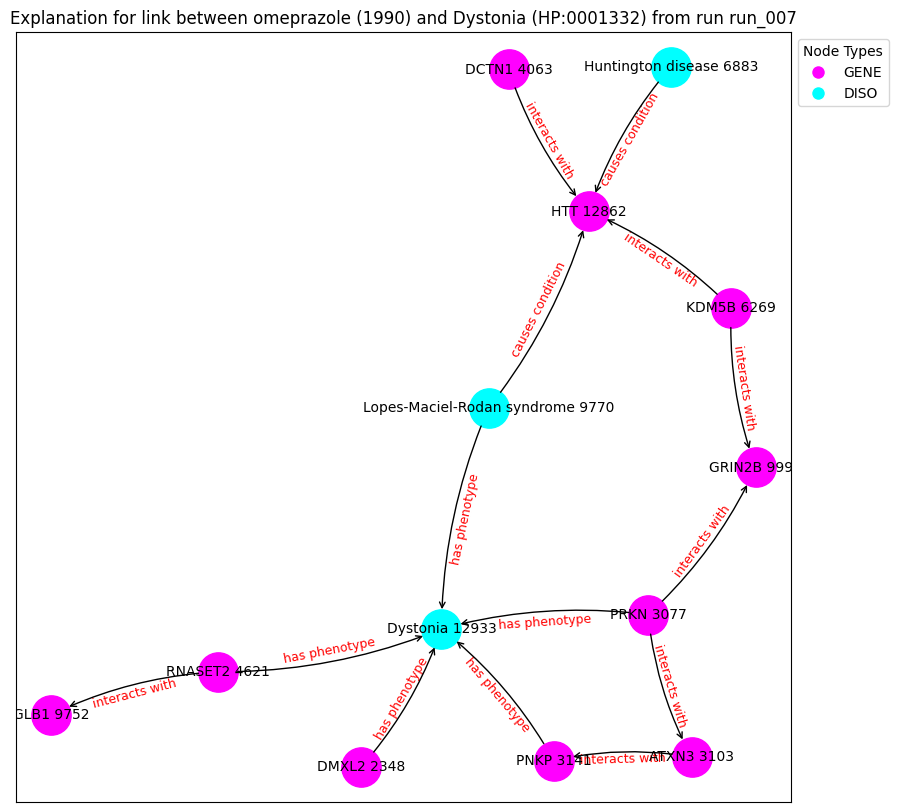

('DMXL2 2348', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('RNASET2 4621', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('GLB1 9752', {'type': 'GENE'})
('Lopes-Maciel-Rodan syndrome 9770', {'type': 'DISO'})
('GRIN2B 9993', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Dystonia 12933', {'type': 'DISO'})
('DMXL2 2348', 'Dystonia 12933', {'label': 'has phenotype'})
('PRKN 3077', 'GRIN2B 9993', {'label': 'interacts with'})
('PRKN 3077', 'Dystonia 12933', {'label': 'has phenotype'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'PNKP 3141', {'label': 'interacts with'})
('PNKP 3141', 'Dystonia 12933', {'label': 'has phenotype'})
('DCTN1 4063', 'HTT 12862', {'label': 'interacts with'})
('RNASET2 4621', 'GLB1 9752', {'label': 'interacts with'})
('RNASET2 4621', 'Dystonia 12933', {'label': 'has phenotype'})
(

Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 143.44it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5663], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:05<00:00, 137.65it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5663], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 147.24it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5663], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 149.04it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5663], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 149.36it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5663], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 144.05it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5663], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 146.66it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5663], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 146.96it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5663], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 145.55it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5663], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 142.41it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


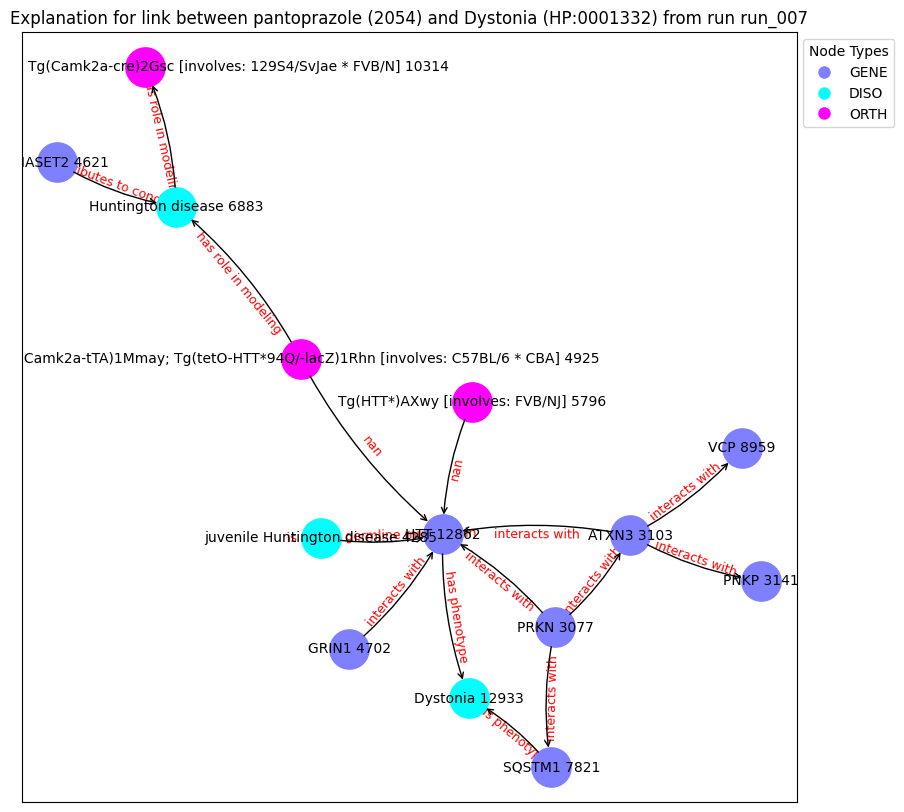

('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('RNASET2 4621', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('Tg(Camk2a-tTA)1Mmay; Tg(tetO-HTT*94Q/-lacZ)1Rhn [involves: C57BL/6 * CBA] 4925', {'type': 'ORTH'})
('Tg(HTT*)AXwy [involves: FVB/NJ] 5796', {'type': 'ORTH'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('Drd1<tm2Jcd>/Drd1<+>; Tg(Camk2a-cre)2Gsc [involves: 129S4/SvJae * FVB/N] 10314', {'type': 'ORTH'})
('HTT 12862', {'type': 'GENE'})
('Dystonia 12933', {'type': 'DISO'})
('PRKN 3077', 'HTT 12862', {'label': 'interacts with'})
('PRKN 3077', 'SQSTM1 7821', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'HTT 12862', {'label': 'interacts with'})
('ATXN3 3103', 'PNKP 3141', {'label': 'interacts with'})
('ATXN3 3103', 'VCP 8959', {'label': 'interacts with'}

Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 215.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 238.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 233.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 238.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 241.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 245.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 223.53it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic    label  semantic_id
1789      1789  HP:0000739     DISO  Anxiety            1
node2:
      index_id    id semantic     label  semantic_id
1000      1000  1996     DRUG  orlistat            2
Prediction from trained model: tensor([0.0959], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 241.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0959], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 240.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0959], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 237.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0959], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 229.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0959], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 228.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0959], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 235.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0959], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 248.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0959], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 248.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0959], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 239.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0959], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 242.05it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.8988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 229.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 208.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 228.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 230.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.8988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.86it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.7664], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 225.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7664], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 222.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7664], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 213.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7664], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 224.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7664], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7664], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 228.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7664], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 229.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7664], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 222.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7664], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 219.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7664], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 224.77it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.7506], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 203.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7506], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 182.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7506], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 202.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7506], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 203.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7506], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 202.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7506], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 201.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7506], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 204.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7506], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 196.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7506], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 203.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7506], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 197.19it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.7331], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7331], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 200.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7331], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 209.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7331], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 206.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7331], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7331], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7331], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 198.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7331], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7331], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 199.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7331], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.62it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.6262], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 202.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6262], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6262], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 206.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6262], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 204.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6262], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6262], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 201.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6262], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 205.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6262], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 203.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6262], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6262], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.30it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
11096     11096  HP:0025401     DISO  Staring gaze            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.7688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 209.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.26it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
6473      6473  HP:0001272     DISO  Cerebellar atrophy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.7636], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7636], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 182.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7636], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7636], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7636], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7636], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7636], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7636], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7636], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7636], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.39it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
6473      6473  HP:0001272     DISO  Cerebellar atrophy            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.6860], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6860], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 183.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6860], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6860], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 196.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6860], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6860], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:04<00:00, 174.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6860], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6860], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 177.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6860], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 198.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6860], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.44it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
4670      4670  HP:0031589     DISO  Suicidal ideation            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.3088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 232.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 209.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 217.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 218.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3088], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 217.91it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
4670      4670  HP:0031589     DISO  Suicidal ideation            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.6416], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6416], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 210.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6416], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6416], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 232.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6416], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 212.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6416], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6416], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6416], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6416], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6416], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.73it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic        label  semantic_id
2028      2028  HP:0002066     DISO  Gait ataxia            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.7687], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7687], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 207.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7687], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7687], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 208.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7687], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 212.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7687], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7687], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7687], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 218.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7687], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 209.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7687], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.31it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic        label  semantic_id
2028      2028  HP:0002066     DISO  Gait ataxia            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.6512], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6512], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 218.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6512], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 207.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6512], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6512], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 227.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6512], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 221.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6512], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 219.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6512], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 204.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6512], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 222.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6512], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 220.52it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                 label  semantic_id
10550     10550  HP:0001268     DISO  Mental deterioration            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.5822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 207.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 209.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 197.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 210.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 198.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 206.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.91it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                 label  semantic_id
10550     10550  HP:0001268     DISO  Mental deterioration            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.6533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 207.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 207.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 201.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 204.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 205.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 203.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6533], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 202.34it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                        label  semantic_id
8786      8786  HP:0000496     DISO  Abnormality of eye movement            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.7880], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 207.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7880], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 204.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7880], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7880], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7880], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 206.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7880], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7880], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 209.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7880], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7880], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7880], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 190.48it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic         label  semantic_id
7072      7072  HP:0002067     DISO  Bradykinesia            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5373], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 185.40it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5373], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 190.73it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5373], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 183.16it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5373], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 186.94it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5373], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 190.47it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5373], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 189.18it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5373], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 190.67it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5373], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 179.90it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5373], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 185.18it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5373], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 181.54it/s]


Contribution threshold is tensor(0.0062)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


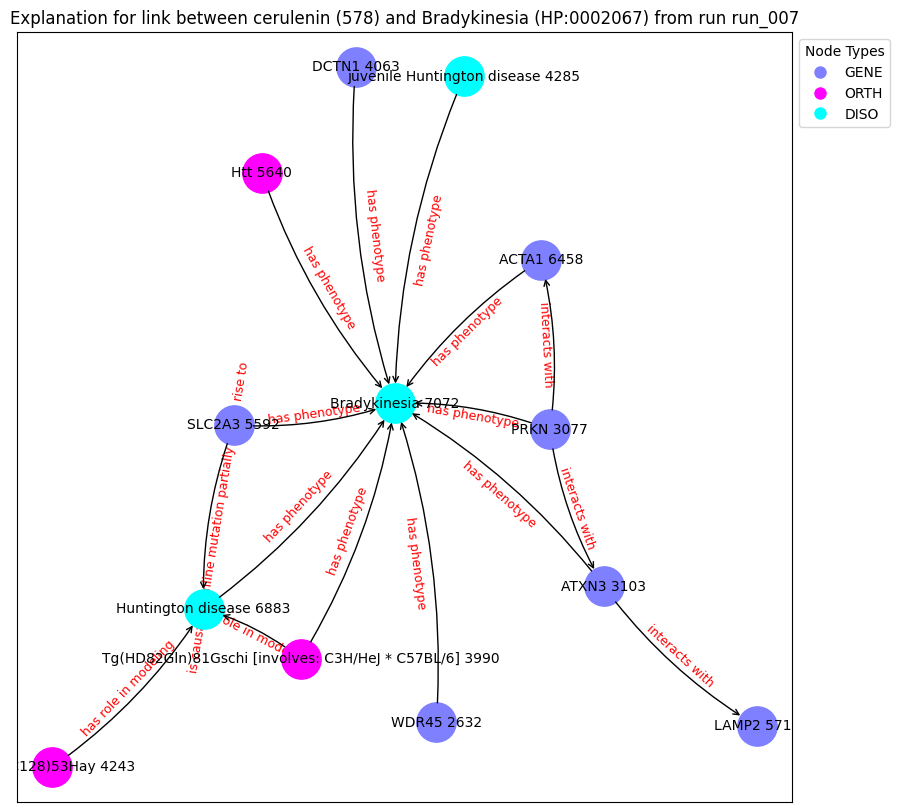

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', {'type': 'ORTH'})
('DCTN1 4063', {'type': 'GENE'})
('Tg(YAC128)53Hay 4243', {'type': 'ORTH'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('LAMP2 5717', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('Bradykinesia 7072', {'type': 'DISO'})
('WDR45 2632', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'Bradykinesia 7072', {'label': 'has phenotype'})
('ATXN3 3103', 'LAMP2 5717', {'label': 'interacts with'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Huntington disease 6883', {'label': 'has role in modelin

Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 178.75it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1494], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:04<00:00, 170.97it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1494], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 190.83it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.1494], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 188.09it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1494], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 187.35it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1494], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 185.88it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1494], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 177.78it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.1494], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 193.37it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1494], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 181.01it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.1494], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 190.42it/s]


Contribution threshold is tensor(0.0062)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


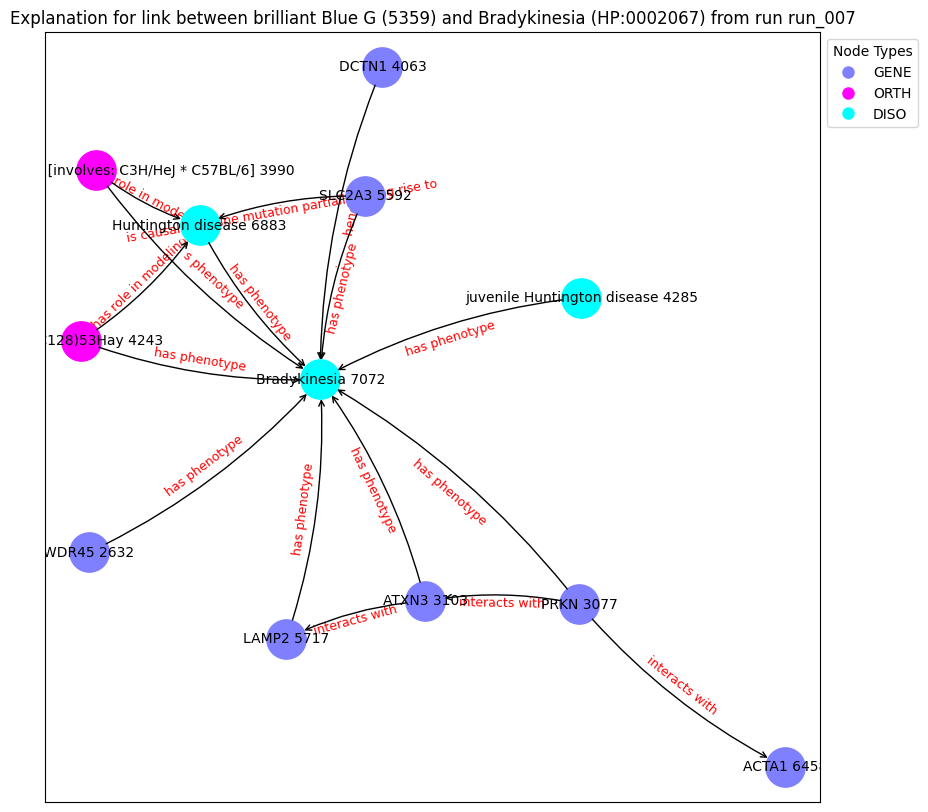

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', {'type': 'ORTH'})
('DCTN1 4063', {'type': 'GENE'})
('Tg(YAC128)53Hay 4243', {'type': 'ORTH'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('LAMP2 5717', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('Bradykinesia 7072', {'type': 'DISO'})
('WDR45 2632', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'Bradykinesia 7072', {'label': 'has phenotype'})
('ATXN3 3103', 'LAMP2 5717', {'label': 'interacts with'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Huntington disease 6883', {'label': 'has role in modeling'})
('Tg(HD82Gln)81Gschi [invo

Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 229.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9972], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9972], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 246.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9972], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 230.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9972], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 241.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9972], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 215.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9972], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 238.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9972], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 246.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9972], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9972], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 238.94it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic           label  semantic_id
1065      1065  HP:0002141     DISO  Gait imbalance            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.3252], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:03<00:00, 226.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3252], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 240.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3252], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 240.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3252], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:03<00:00, 214.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3252], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:03<00:00, 216.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3252], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3252], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 241.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3252], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 244.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3252], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 243.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3252], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 235.94it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic      label  semantic_id
13378     13378  HP:0001336     DISO  Myoclonus            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6725], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.70it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6725], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 180.75it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6725], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.45it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6725], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 175.92it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6725], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.80it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6725], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.62it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6725], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.97it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6725], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.76it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6725], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.01it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6725], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.90it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


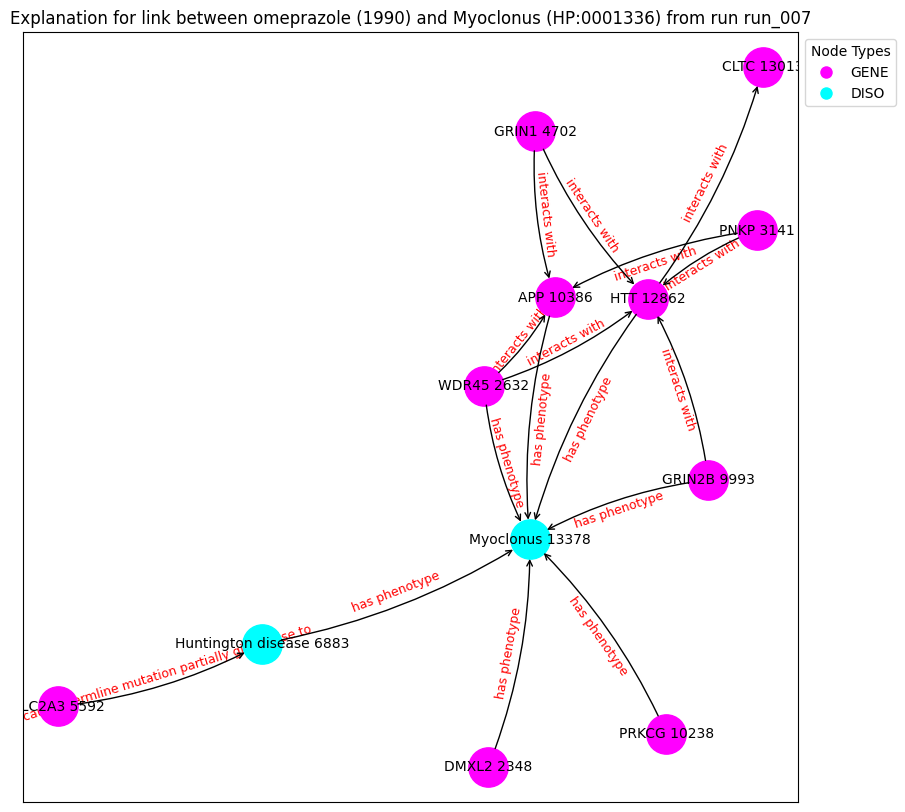

('DMXL2 2348', {'type': 'GENE'})
('WDR45 2632', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('GRIN2B 9993', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('APP 10386', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Myoclonus 13378', {'type': 'DISO'})
('DMXL2 2348', 'Myoclonus 13378', {'label': 'has phenotype'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('WDR45 2632', 'APP 10386', {'label': 'interacts with'})
('WDR45 2632', 'Myoclonus 13378', {'label': 'has phenotype'})
('PNKP 3141', 'HTT 12862', {'label': 'interacts with'})
('PNKP 3141', 'APP 10386', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'APP 10386', {'label': 'interacts with'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('Huntington

Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 179.78it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6130], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:04<00:00, 167.77it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6130], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:04<00:00, 172.70it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6130], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 185.84it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6130], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 177.25it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6130], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.43it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6130], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:04<00:00, 173.86it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6130], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.57it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6130], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.89it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6130], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.24it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


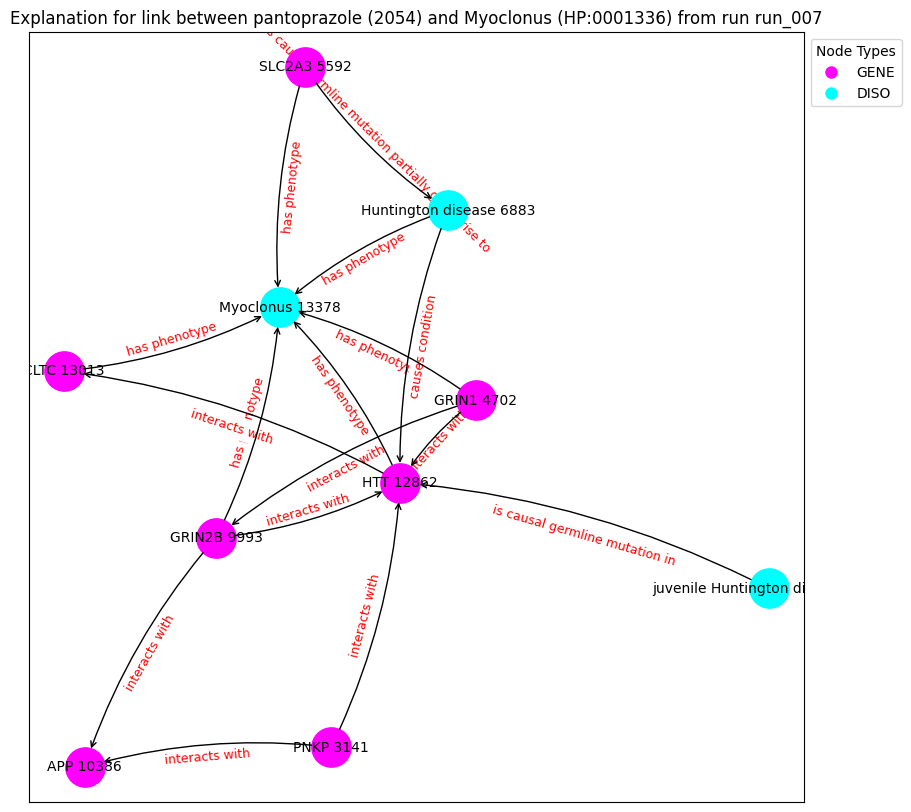

('PNKP 3141', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('GRIN2B 9993', {'type': 'GENE'})
('APP 10386', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Myoclonus 13378', {'type': 'DISO'})
('PNKP 3141', 'HTT 12862', {'label': 'interacts with'})
('PNKP 3141', 'APP 10386', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is causal germline mutation in'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'Myoclonus 13378', {'label': 'has phenotype'})
('SLC2A3 5592', 'Myoclonus 13378', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('Huntington disease 6883', 'HTT 12862', {'label': 'causes condition'})
(

Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4465], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4465], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4465], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4465], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4465], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 197.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4465], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 199.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4465], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 198.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4465], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 200.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4465], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.09it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
5935      5935  HP:0000713     DISO  Agitation            1
node2:
      index_id    id semantic     label  semantic_id
1000      1000  1996     DRUG  orlistat            2
Prediction from trained model: tensor([0.6073], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 190.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6073], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 198.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6073], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 196.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6073], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 201.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6073], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 186.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6073], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 202.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6073], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 205.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6073], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 199.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6073], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 187.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6073], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 200.40it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
5935      5935  HP:0000713     DISO  Agitation            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.5825], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 200.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5825], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 203.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5825], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 199.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5825], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 204.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5825], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 205.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5825], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 200.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5825], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 198.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5825], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5825], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 201.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5825], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 199.33it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic    label  semantic_id
3363      3363  HP:0002171     DISO  Gliosis            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5565], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 202.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5565], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 205.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5565], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 202.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5565], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 205.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5565], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 206.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5565], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 207.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5565], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 195.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5565], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5565], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5565], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 203.40it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic   label  semantic_id
14731     14731  HP:0002072     DISO  Chorea            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.7273], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 171.98it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7273], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 171.93it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7273], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 172.62it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7273], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 172.87it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.7273], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 165.34it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.7273], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 171.43it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7273], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 173.18it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7273], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:03<00:00, 175.01it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7273], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 169.41it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.7273], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 173.41it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


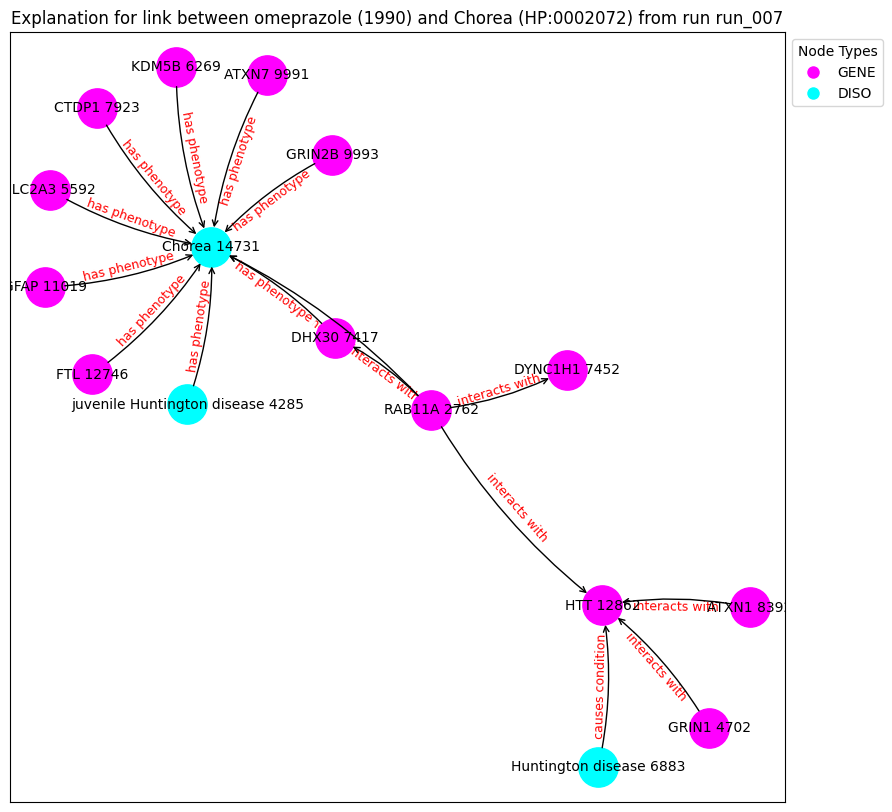

('RAB11A 2762', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Chorea 14731', {'type': 'DISO'})
('RAB11A 2762', 'HTT 12862', {'label': 'interacts with'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Chorea 14731', {'label': 'has phenotype'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'Chorea 14731', {'label': 'has phenotype'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('SLC2A3 5592', 'Chorea 14731', {'label': 'has phenotype

Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 166.92it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6013], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 164.45it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6013], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 166.72it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6013], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 173.69it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6013], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 170.14it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6013], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 173.62it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6013], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 168.59it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6013], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 168.54it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6013], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 169.96it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6013], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 171.91it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


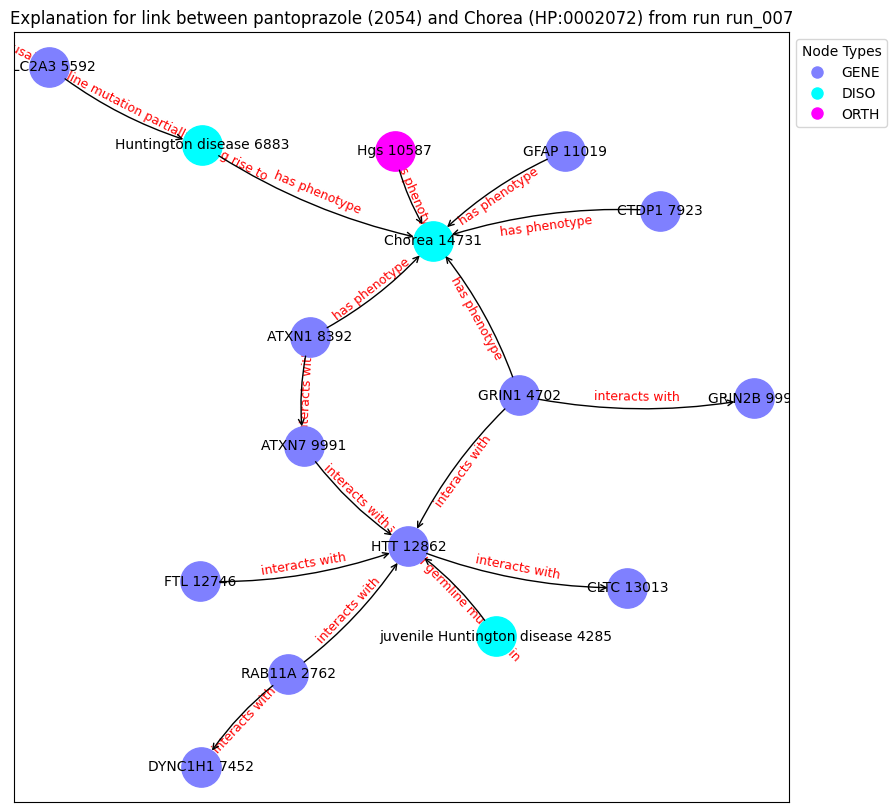

('RAB11A 2762', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('Hgs 10587', {'type': 'ORTH'})
('GFAP 11019', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Chorea 14731', {'type': 'DISO'})
('RAB11A 2762', 'HTT 12862', {'label': 'interacts with'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is causal germline mutation in'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'Chorea 14731', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {

Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:03<00:00, 229.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 240.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 248.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 233.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 246.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:03<00:00, 228.91it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic       label  semantic_id
2824      2824  HP:0002312     DISO  Clumsiness            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.9897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:03<00:00, 216.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 235.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 233.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 236.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:03<00:00, 229.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 244.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:03<00:00, 227.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 233.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:03<00:00, 227.67it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic        label  semantic_id
13123     13123  HP:0001824     DISO  Weight loss            1
node2:
      index_id    id semantic           label  semantic_id
2596      2596  5382     DRUG  bempedoic acid            2
Prediction from trained model: tensor([0.0832], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 134.72it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.0832], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 137.14it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.0832], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 136.65it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.0832], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 139.66it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.0832], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 136.63it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.0832], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 134.64it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.0832], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 136.94it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.0832], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 129.56it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.0832], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 138.66it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.0832], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 139.59it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


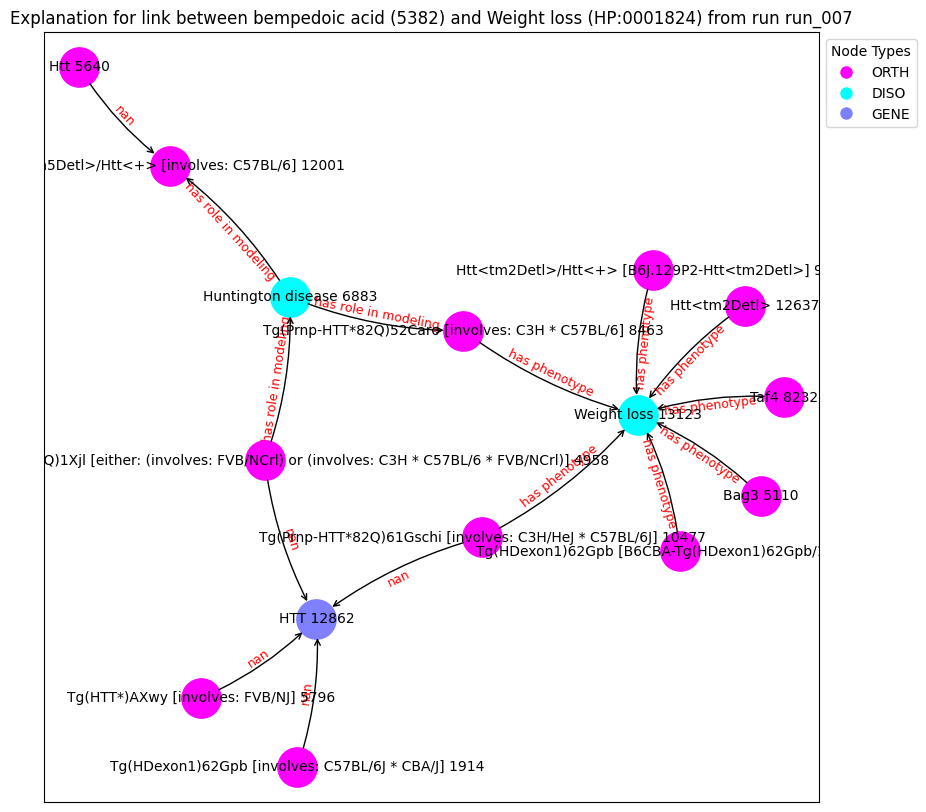

('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', {'type': 'ORTH'})
('Tg(GFAP-HTT*160Q)1Xjl [either: (involves: FVB/NCrl) or (involves: C3H * C57BL/6 * FVB/NCrl)] 4958', {'type': 'ORTH'})
('Bag3 5110', {'type': 'ORTH'})
('Htt 5640', {'type': 'ORTH'})
('Tg(HTT*)AXwy [involves: FVB/NJ] 5796', {'type': 'ORTH'})
('Huntington disease 6883', {'type': 'DISO'})
('Taf4 8232', {'type': 'ORTH'})
('Tg(Prnp-HTT*82Q)52Caro [involves: C3H * C57BL/6] 8463', {'type': 'ORTH'})
('Htt<tm2Detl>/Htt<+> [B6J.129P2-Htt<tm2Detl>] 9652', {'type': 'ORTH'})
('Tg(Prnp-HTT*82Q)61Gschi [involves: C3H/HeJ * C57BL/6J] 10477', {'type': 'ORTH'})
('Htt<tm5Detl>/Htt<+> [involves: C57BL/6] 12001', {'type': 'ORTH'})
('Htt<tm2Detl> 12637', {'type': 'ORTH'})
('Tg(HDexon1)62Gpb [B6CBA-Tg(HDexon1)62Gpb/1J] 12785', {'type': 'ORTH'})
('HTT 12862', {'type': 'GENE'})
('Weight loss 13123', {'type': 'DISO'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', 'HTT 12862', {'label': nan})
('Tg(GFAP-HTT*160Q)1Xjl [either: (invo

Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 131.96it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2245], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 126.13it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2245], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 138.76it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.2245], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 134.60it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2245], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 134.86it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2245], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 139.44it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.2245], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 133.93it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.2245], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 132.61it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2245], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 134.74it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2245], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 139.79it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


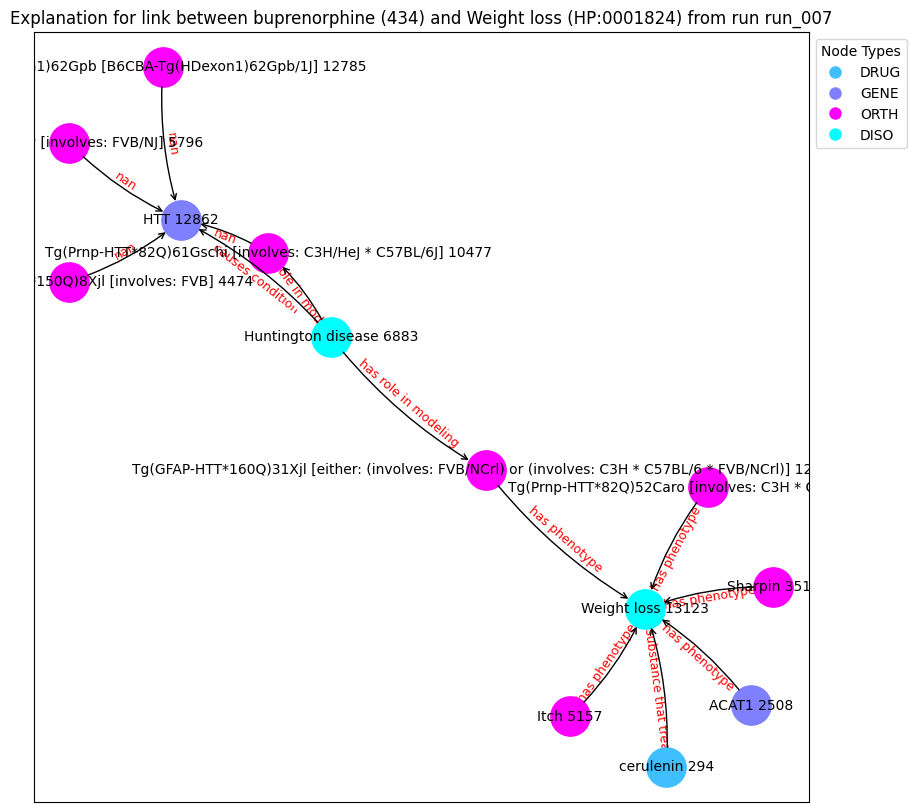

('cerulenin 294', {'type': 'DRUG'})
('ACAT1 2508', {'type': 'GENE'})
('Sharpin 3510', {'type': 'ORTH'})
('Tg(Prnp-SNAP25/HTT*150Q)8Xjl [involves: FVB] 4474', {'type': 'ORTH'})
('Itch 5157', {'type': 'ORTH'})
('Tg(HTT*)AXwy [involves: FVB/NJ] 5796', {'type': 'ORTH'})
('Huntington disease 6883', {'type': 'DISO'})
('Tg(Prnp-HTT*82Q)52Caro [involves: C3H * C57BL/6] 8463', {'type': 'ORTH'})
('Tg(Prnp-HTT*82Q)61Gschi [involves: C3H/HeJ * C57BL/6J] 10477', {'type': 'ORTH'})
('Tg(GFAP-HTT*160Q)31Xjl [either: (involves: FVB/NCrl) or (involves: C3H * C57BL/6 * FVB/NCrl)] 12780', {'type': 'ORTH'})
('Tg(HDexon1)62Gpb [B6CBA-Tg(HDexon1)62Gpb/1J] 12785', {'type': 'ORTH'})
('HTT 12862', {'type': 'GENE'})
('Weight loss 13123', {'type': 'DISO'})
('cerulenin 294', 'Weight loss 13123', {'label': 'is substance that treats'})
('ACAT1 2508', 'Weight loss 13123', {'label': 'has phenotype'})
('Sharpin 3510', 'Weight loss 13123', {'label': 'has phenotype'})
('Tg(Prnp-SNAP25/HTT*150Q)8Xjl [involves: FVB] 4474',

Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 130.42it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4402], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 123.66it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4402], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 136.34it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4402], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 135.94it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4402], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 131.32it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4402], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 138.36it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4402], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 137.80it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4402], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 134.66it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4402], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 133.42it/s]


Contribution threshold is tensor(0.9939)
Explanation found!


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


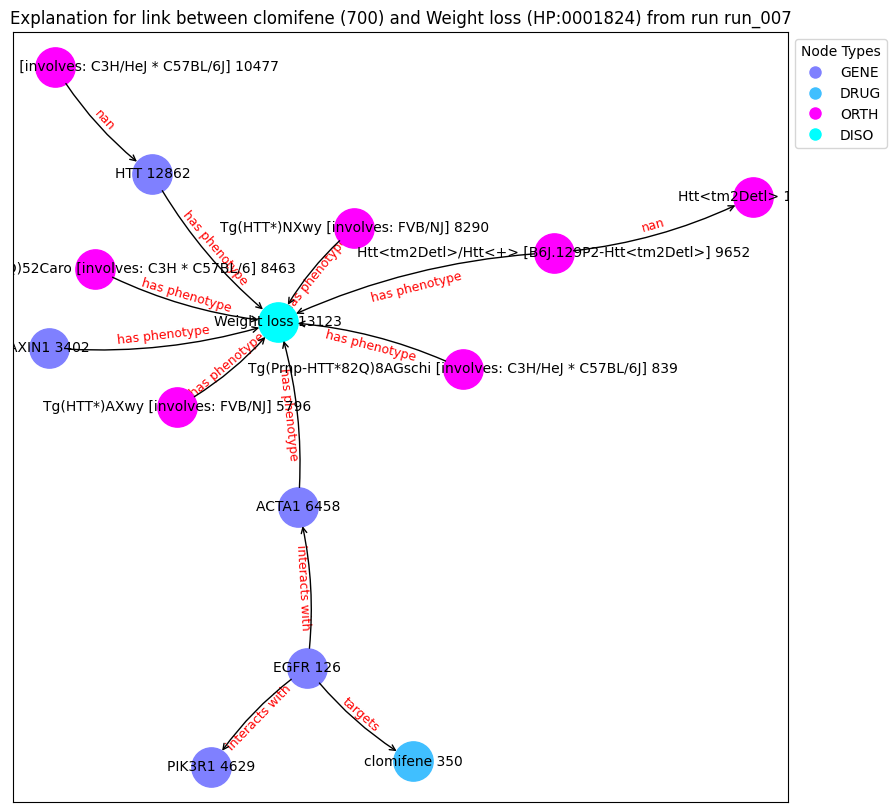

('EGFR 126', {'type': 'GENE'})
('clomifene 350', {'type': 'DRUG'})
('Tg(Prnp-HTT*82Q)8AGschi [involves: C3H/HeJ * C57BL/6J] 839', {'type': 'ORTH'})
('AXIN1 3402', {'type': 'GENE'})
('PIK3R1 4629', {'type': 'GENE'})
('Tg(HTT*)AXwy [involves: FVB/NJ] 5796', {'type': 'ORTH'})
('ACTA1 6458', {'type': 'GENE'})
('Tg(HTT*)NXwy [involves: FVB/NJ] 8290', {'type': 'ORTH'})
('Tg(Prnp-HTT*82Q)52Caro [involves: C3H * C57BL/6] 8463', {'type': 'ORTH'})
('Htt<tm2Detl>/Htt<+> [B6J.129P2-Htt<tm2Detl>] 9652', {'type': 'ORTH'})
('Tg(Prnp-HTT*82Q)61Gschi [involves: C3H/HeJ * C57BL/6J] 10477', {'type': 'ORTH'})
('Htt<tm2Detl> 12637', {'type': 'ORTH'})
('HTT 12862', {'type': 'GENE'})
('Weight loss 13123', {'type': 'DISO'})
('EGFR 126', 'PIK3R1 4629', {'label': 'interacts with'})
('EGFR 126', 'ACTA1 6458', {'label': 'interacts with'})
('EGFR 126', 'clomifene 350', {'label': 'targets'})
('Tg(Prnp-HTT*82Q)8AGschi [involves: C3H/HeJ * C57BL/6J] 839', 'Weight loss 13123', {'label': 'has phenotype'})
('AXIN1 3402'

Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4050], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 210.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4050], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 206.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4050], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4050], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4050], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 205.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4050], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4050], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 212.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4050], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4050], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.01it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                      label  semantic_id
13978     13978  HP:0200136     DISO  Oral-pharyngeal dysphagia            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.5781], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.88it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5781], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.40it/s]


Contribution threshold is tensor(0.0060)
Prediction from trained model: tensor([0.5781], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.12it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5781], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 199.10it/s]


Contribution threshold is tensor(0.0055)
Prediction from trained model: tensor([0.5781], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.37it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5781], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.07it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5781], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.44it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5781], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 183.05it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5781], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.98it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5781], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 200.95it/s]


Contribution threshold is tensor(0.0061)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


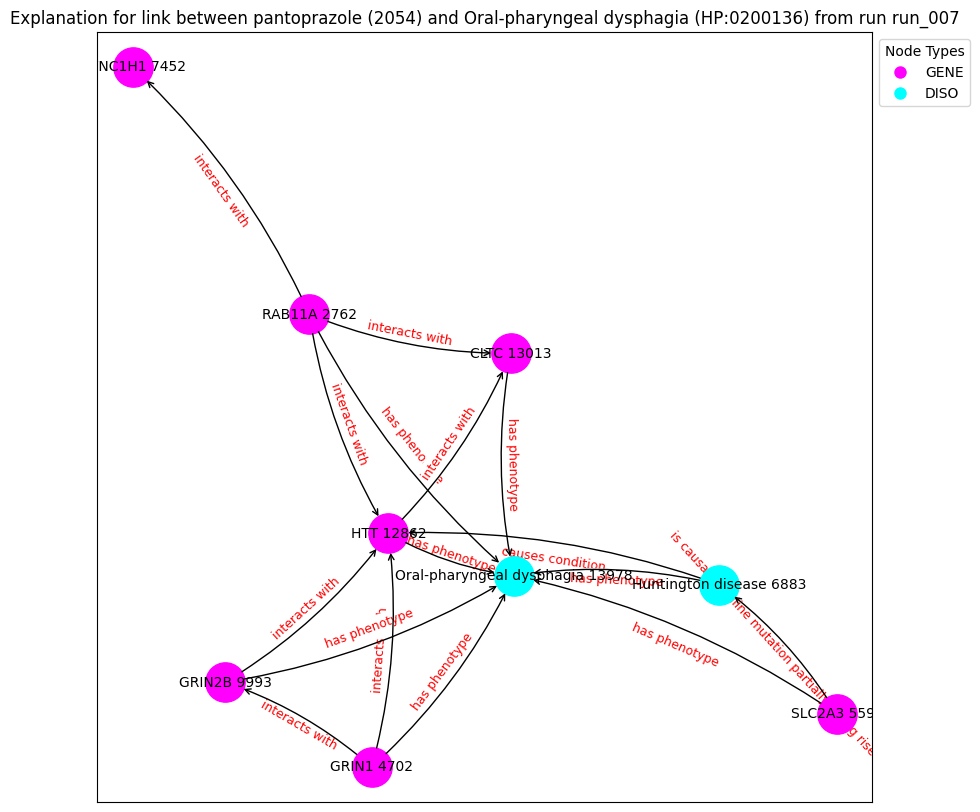

('RAB11A 2762', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Oral-pharyngeal dysphagia 13978', {'type': 'DISO'})
('RAB11A 2762', 'HTT 12862', {'label': 'interacts with'})
('RAB11A 2762', 'CLTC 13013', {'label': 'interacts with'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('SLC2A3 5592', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('Huntington disease 6883

Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5169], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5169], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 200.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5169], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 200.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5169], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5169], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 204.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5169], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5169], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 198.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5169], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5169], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.87it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic     label  semantic_id
10333     10333  HP:0000726     DISO  Dementia            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.6509], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 198.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6509], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6509], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 201.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6509], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 198.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6509], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 200.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6509], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6509], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6509], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6509], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6509], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 202.38it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic    label  semantic_id
8961      8961  HP:0001250     DISO  Seizure            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.8958], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 137.40it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8958], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 138.50it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8958], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 140.99it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8958], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 134.74it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8958], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 141.04it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8958], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 141.85it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8958], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 143.72it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8958], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 141.48it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8958], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 136.50it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8958], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 141.99it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


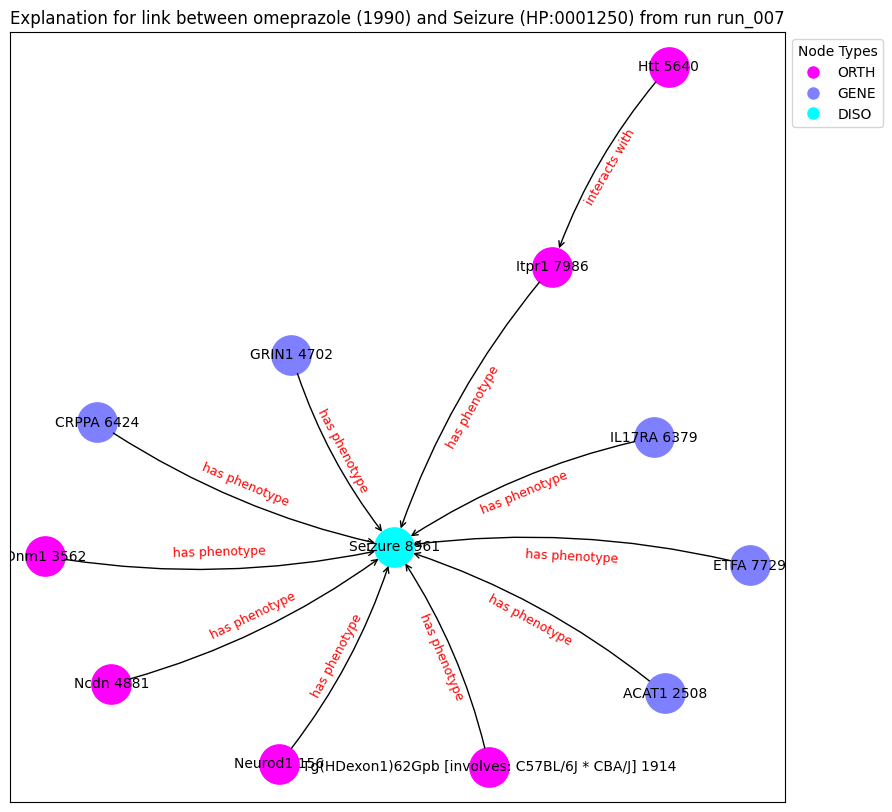

('Neurod1 156', {'type': 'ORTH'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', {'type': 'ORTH'})
('ACAT1 2508', {'type': 'GENE'})
('Dnm1 3562', {'type': 'ORTH'})
('GRIN1 4702', {'type': 'GENE'})
('Ncdn 4881', {'type': 'ORTH'})
('Htt 5640', {'type': 'ORTH'})
('IL17RA 6379', {'type': 'GENE'})
('CRPPA 6424', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('Itpr1 7986', {'type': 'ORTH'})
('Seizure 8961', {'type': 'DISO'})
('Neurod1 156', 'Seizure 8961', {'label': 'has phenotype'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', 'Seizure 8961', {'label': 'has phenotype'})
('ACAT1 2508', 'Seizure 8961', {'label': 'has phenotype'})
('Dnm1 3562', 'Seizure 8961', {'label': 'has phenotype'})
('GRIN1 4702', 'Seizure 8961', {'label': 'has phenotype'})
('Ncdn 4881', 'Seizure 8961', {'label': 'has phenotype'})
('Htt 5640', 'Itpr1 7986', {'label': 'interacts with'})
('IL17RA 6379', 'Seizure 8961', {'label': 'has phenotype'})
('CRPPA 6424', 'Seizure 8961', {'label': 'has phenotype'

Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:05<00:00, 128.27it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:05<00:00, 136.91it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 140.23it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:05<00:00, 139.95it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 141.79it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 141.97it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 142.33it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 142.36it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 142.32it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1036: 100%|██████████| 700/700 [00:04<00:00, 141.26it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


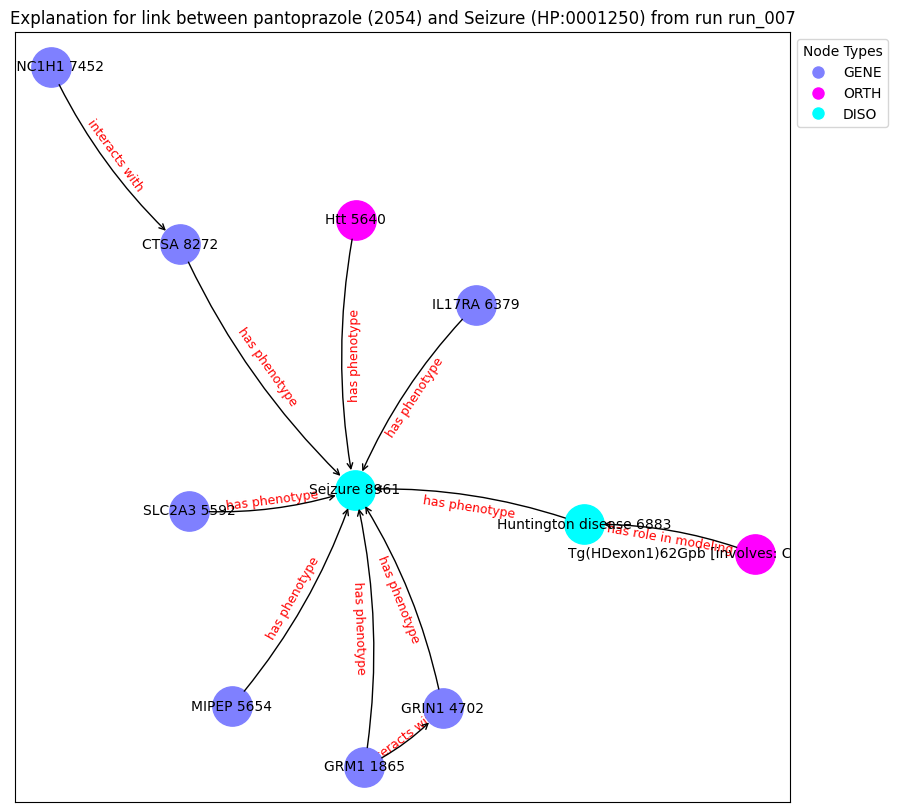

('GRM1 1865', {'type': 'GENE'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', {'type': 'ORTH'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('MIPEP 5654', {'type': 'GENE'})
('IL17RA 6379', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTSA 8272', {'type': 'GENE'})
('Seizure 8961', {'type': 'DISO'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('GRM1 1865', 'Seizure 8961', {'label': 'has phenotype'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', 'Huntington disease 6883', {'label': 'has role in modeling'})
('GRIN1 4702', 'Seizure 8961', {'label': 'has phenotype'})
('SLC2A3 5592', 'Seizure 8961', {'label': 'has phenotype'})
('Htt 5640', 'Seizure 8961', {'label': 'has phenotype'})
('MIPEP 5654', 'Seizure 8961', {'label': 'has phenotype'})
('IL17RA 6379', 'Seizure 8961', {'label': 'has phenotype'})
('Huntington disease 6883', 'Seizure 8961', {'label': '

Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 136.65it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8369], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 133.26it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8369], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 144.35it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8369], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 142.95it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8369], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 142.68it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8369], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 138.86it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8369], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 140.06it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.8369], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 137.66it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8369], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 142.29it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8369], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 139.69it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


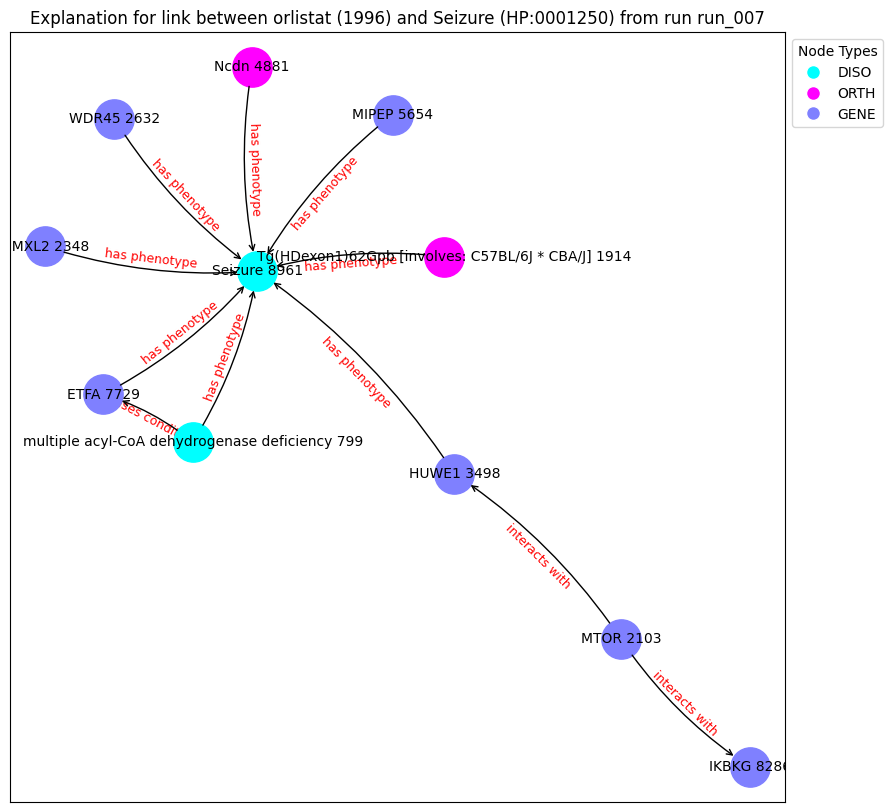

('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', {'type': 'ORTH'})
('MTOR 2103', {'type': 'GENE'})
('DMXL2 2348', {'type': 'GENE'})
('WDR45 2632', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('Ncdn 4881', {'type': 'ORTH'})
('MIPEP 5654', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('IKBKG 8286', {'type': 'GENE'})
('Seizure 8961', {'type': 'DISO'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'Seizure 8961', {'label': 'has phenotype'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'ETFA 7729', {'label': 'causes condition'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', 'Seizure 8961', {'label': 'has phenotype'})
('MTOR 2103', 'HUWE1 3498', {'label': 'interacts with'})
('MTOR 2103', 'IKBKG 8286', {'label': 'interacts with'})
('DMXL2 2348', 'Seizure 8961', {'label': 'has phenotype'})
('WDR45 2632', 'Seizure 8961', {'label': 'has phenotype'})
('HUWE1 3498', 'Seizure 8961', {'label': 

Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0643], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 232.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0643], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 212.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0643], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0643], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0643], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0643], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 236.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0643], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 239.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0643], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0643], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 232.32it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
11896     11896  HP:0000737     DISO  Irritability            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.7587], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 200.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7587], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7587], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 209.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7587], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7587], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7587], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7587], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7587], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 209.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7587], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7587], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.12it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
4154      4154  HP:0000746     DISO  Delusions            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 235.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:03<00:00, 224.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.02it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
4154      4154  HP:0000746     DISO  Delusions            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.6426], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6426], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6426], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6426], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6426], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6426], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6426], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 250.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6426], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 248.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6426], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 235.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6426], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 249.24it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                         label  \
12562     12562  HP:0001262     DISO  Excessive daytime somnolence   

       semantic_id  
12562            1  
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.3659], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 218.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3659], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 211.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3659], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3659], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3659], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3659], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3659], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3659], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3659], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3659], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 218.75it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic           label  semantic_id
5925      5925  HP:0000738     DISO  Hallucinations            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.5361], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 207.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5361], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5361], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5361], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 230.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5361], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5361], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5361], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5361], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5361], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 231.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5361], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.75it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic   label  semantic_id
8154      8154  HP:0000741     DISO  Apathy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.5051], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5051], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5051], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5051], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 204.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5051], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 206.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5051], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 183.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5051], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 198.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5051], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5051], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5051], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.86it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic   label  semantic_id
9999      9999  HP:0002169     DISO  Clonus            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.2942], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 214.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2942], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 225.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2942], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2942], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 217.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2942], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2942], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 211.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2942], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 218.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2942], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2942], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 188.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2942], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 225.24it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic              label  semantic_id
14773     14773  HP:0002540     DISO  Inability to walk            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6573], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.67it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6573], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.44it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6573], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.75it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6573], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.14it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6573], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.26it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6573], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.50it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6573], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.04it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6573], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 180.95it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6573], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.83it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6573], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 179.29it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


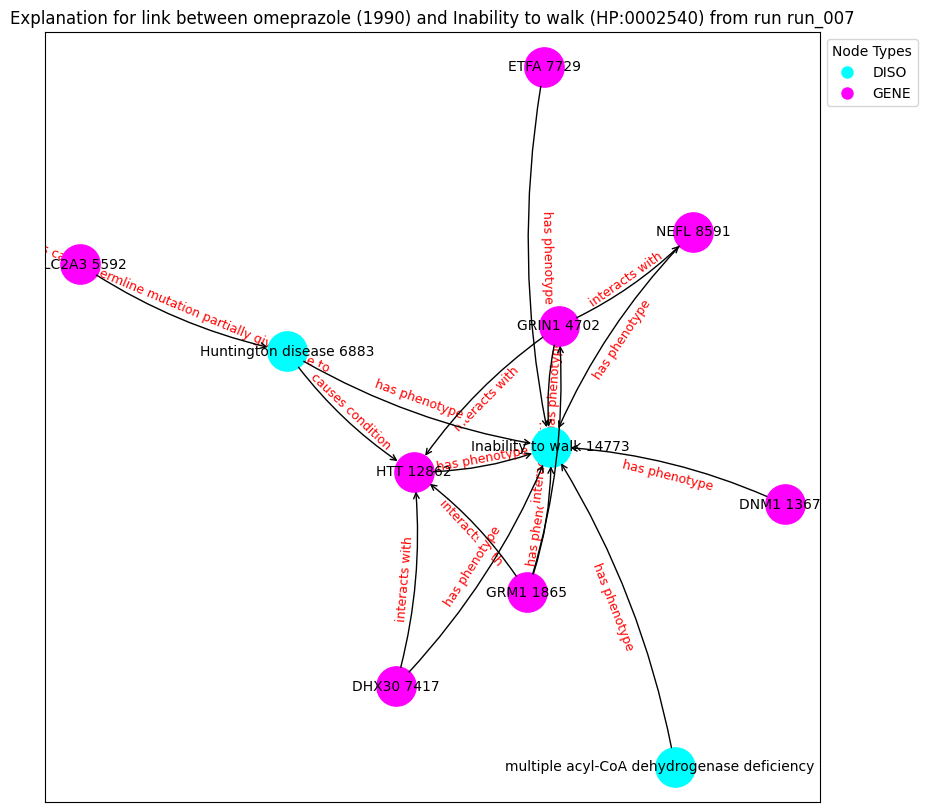

('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('GRM1 1865', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('DNM1 13672', {'type': 'GENE'})
('Inability to walk 14773', {'type': 'DISO'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRM1 1865', 'HTT 12862', {'label': 'interacts with'})
('GRM1 1865', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'NEFL 8591', {'label': 'interacts with'})
('GRIN1 4702', 'Inability to walk 14773', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to

Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 181.20it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 175.24it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 185.33it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 180.61it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.38it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 176.24it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.41it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.90it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.05it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6688], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.85it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


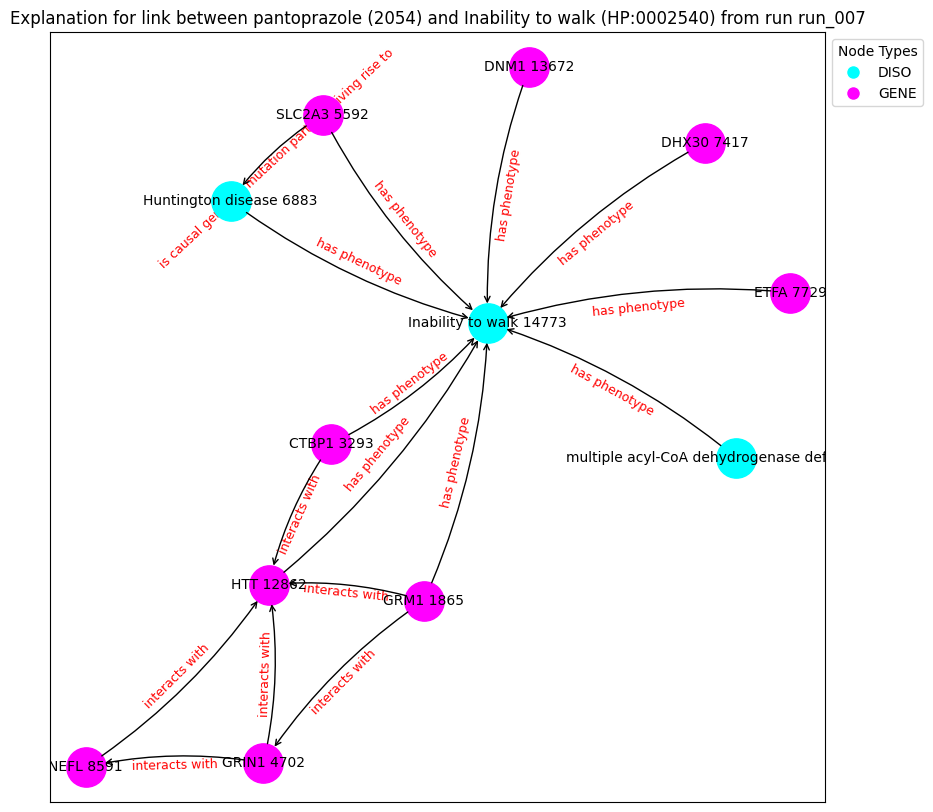

('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('GRM1 1865', {'type': 'GENE'})
('CTBP1 3293', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('DNM1 13672', {'type': 'GENE'})
('Inability to walk 14773', {'type': 'DISO'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRM1 1865', 'HTT 12862', {'label': 'interacts with'})
('GRM1 1865', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('CTBP1 3293', 'HTT 12862', {'label': 'interacts with'})
('CTBP1 3293', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'NEFL 8591', {'label': 'interacts with'})
('SLC2A3 5592', 

Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 219.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 224.75it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                    label  \
917       917  HP:0002529     DISO  Neuronal loss in central nervous system   

     semantic_id  
917            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.9753], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 235.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9753], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 247.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9753], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 247.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9753], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9753], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9753], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 241.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9753], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 246.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9753], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 241.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9753], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 245.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9753], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 246.26it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 235.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 246.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:03<00:00, 229.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:03<00:00, 232.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 240.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 248.74it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.9473], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 235.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9473], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 242.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9473], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 241.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9473], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:03<00:00, 210.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9473], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 242.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9473], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 245.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9473], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 246.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9473], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 236.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9473], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 233.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9473], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 243.79it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                         label  semantic_id
9801      9801  HP:0007010     DISO  Poor fine motor coordination            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.7801], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 206.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7801], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7801], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7801], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7801], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7801], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7801], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7801], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7801], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7801], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.69it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                         label  semantic_id
9801      9801  HP:0007010     DISO  Poor fine motor coordination            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.0993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 209.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 215.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 208.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 219.28it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic             label  semantic_id
8158      8158  HP:0002059     DISO  Cerebral atrophy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6605], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.16it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6605], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 175.67it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6605], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.08it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6605], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.96it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6605], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.86it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6605], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.52it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6605], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 182.59it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6605], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.00it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6605], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.22it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6605], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.02it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


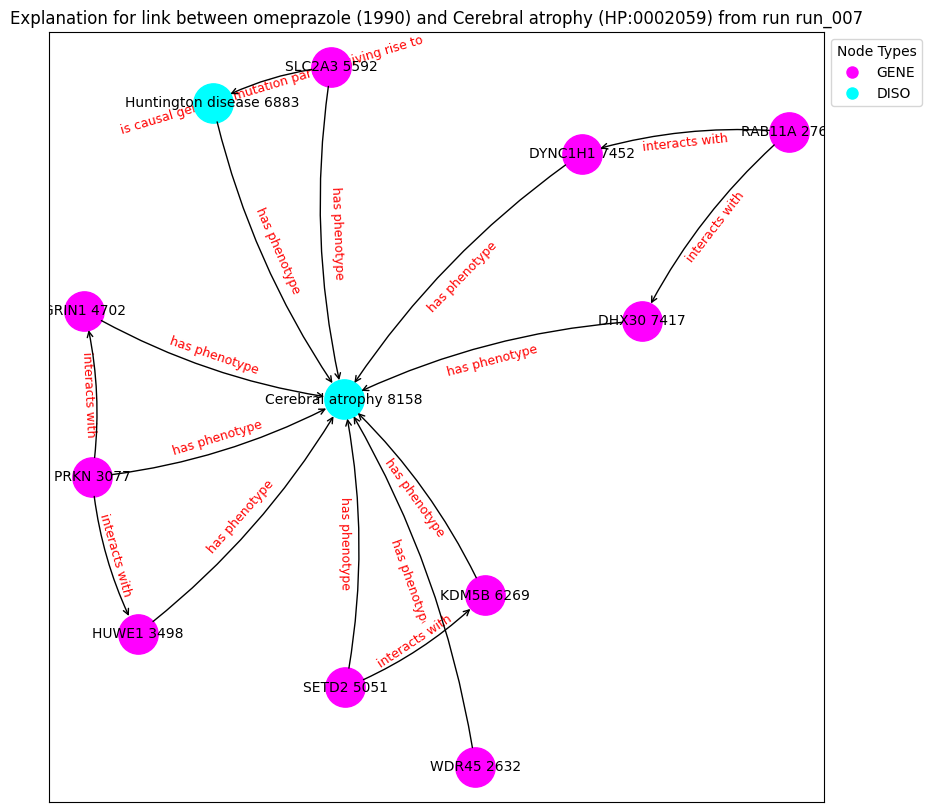

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('Cerebral atrophy 8158', {'type': 'DISO'})
('WDR45 2632', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('HUWE1 3498', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('GRIN1 4702', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('SETD2 5051', 'KDM5B 6269', {'label': 'interacts with'})
('SETD2 5051',

Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 176.75it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6348], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:04<00:00, 157.57it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6348], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.16it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6348], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 180.55it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6348], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.66it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6348], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 181.03it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6348], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.17it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6348], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 184.47it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6348], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.07it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6348], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 184.30it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


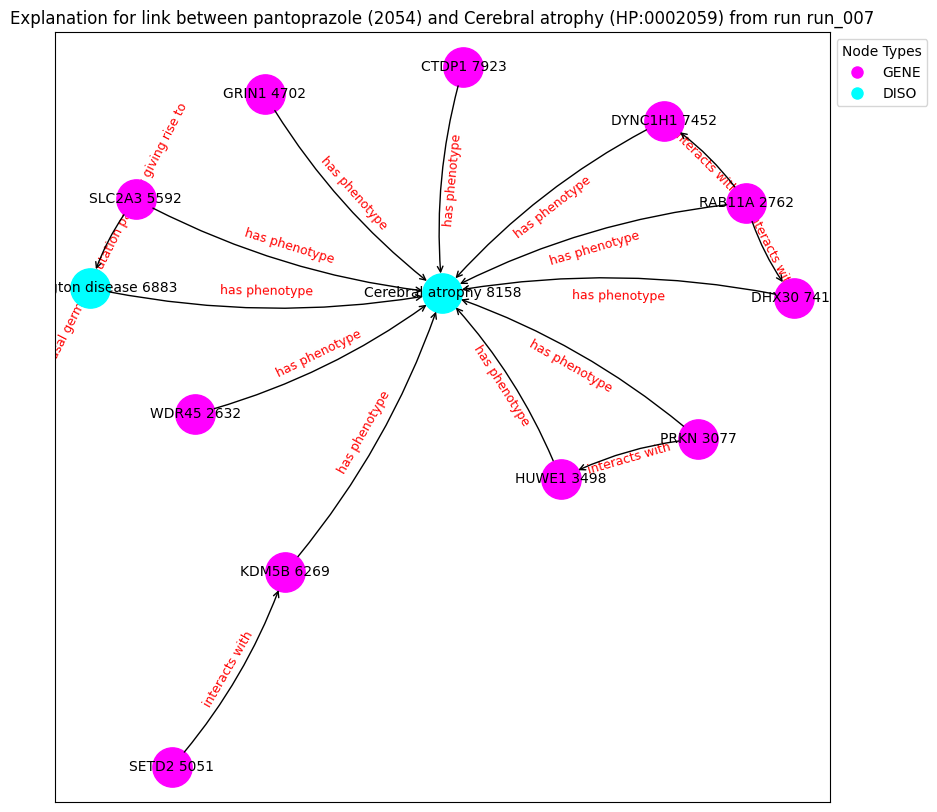

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('Cerebral atrophy 8158', {'type': 'DISO'})
('WDR45 2632', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('HUWE1 3498', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('GRIN1 4702', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('SETD2 5051', 'KDM5B 6269'

Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 228.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 209.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 242.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 239.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 239.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 229.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 214.97it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic          label  semantic_id
12039     12039  HP:0001347     DISO  Hyperreflexia            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6960], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 163.12it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6960], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 171.90it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6960], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 169.60it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6960], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 163.91it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6960], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 167.71it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6960], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 164.69it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6960], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 159.35it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6960], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 167.18it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6960], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 166.75it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6960], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 168.05it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


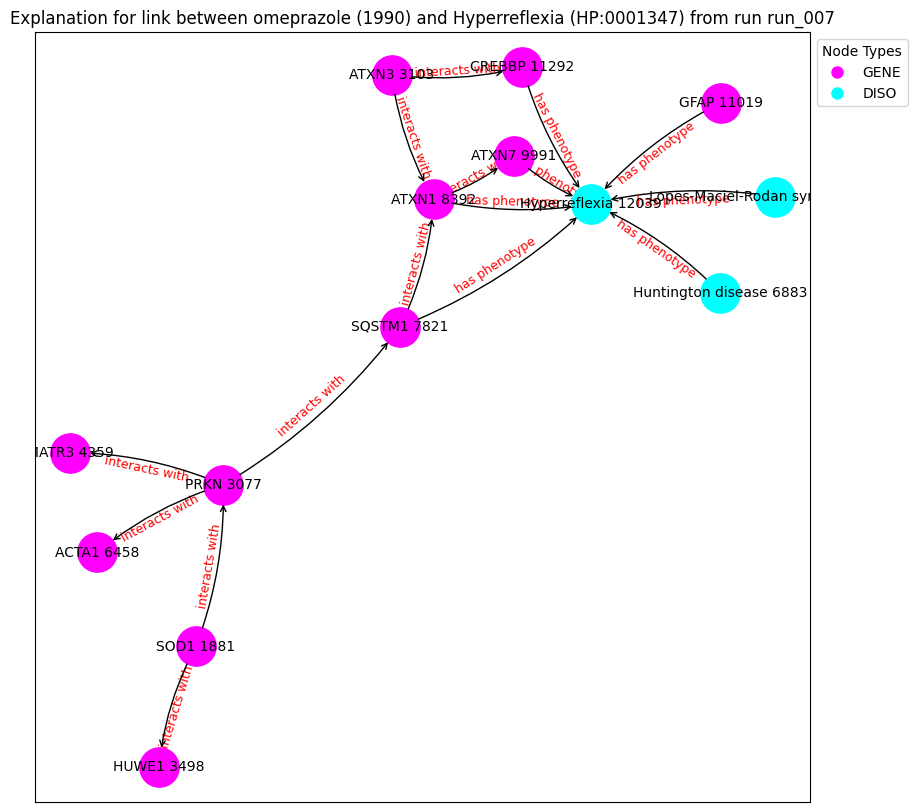

('SOD1 1881', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('MATR3 4359', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('Lopes-Maciel-Rodan syndrome 9770', {'type': 'DISO'})
('ATXN7 9991', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('CREBBP 11292', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('SOD1 1881', 'HUWE1 3498', {'label': 'interacts with'})
('SOD1 1881', 'PRKN 3077', {'label': 'interacts with'})
('PRKN 3077', 'MATR3 4359', {'label': 'interacts with'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'SQSTM1 7821', {'label': 'interacts with'})
('ATXN3 3103', 'CREBBP 11292', {'label': 'interacts with'})
('ATXN3 3103', 'ATXN1 8392', {'label': 'interacts with'})
('Huntington disease 6883', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('SQSTM1 78

Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 154.80it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6444], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 158.23it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6444], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 162.91it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6444], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 152.66it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6444], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 169.12it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6444], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 173.59it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6444], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 169.88it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6444], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 166.39it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6444], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 169.10it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6444], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 167.52it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


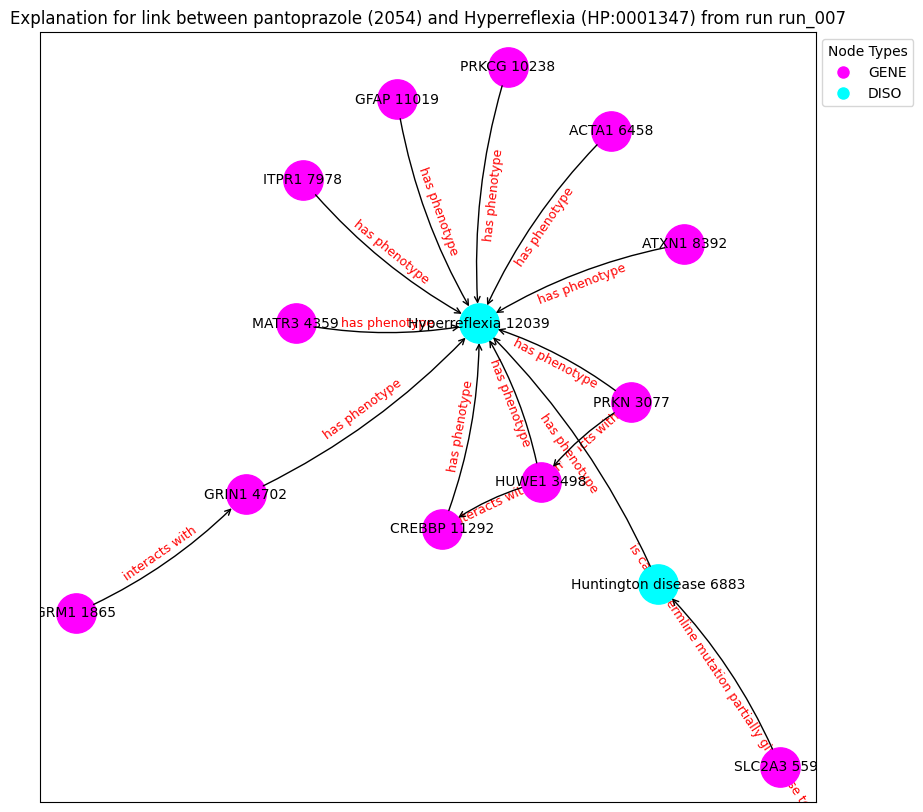

('GRM1 1865', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('MATR3 4359', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('ITPR1 7978', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('CREBBP 11292', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('HUWE1 3498', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('HUWE1 3498', 'CREBBP 11292', {'label': 'interacts with'})
('MATR3 4359', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('GRIN1 4702', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline muta

Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 162.22it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.8127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 154.30it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 167.61it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 169.78it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 164.76it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 165.58it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 165.27it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.8127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 164.44it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.8127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 171.98it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.8127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 158.65it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


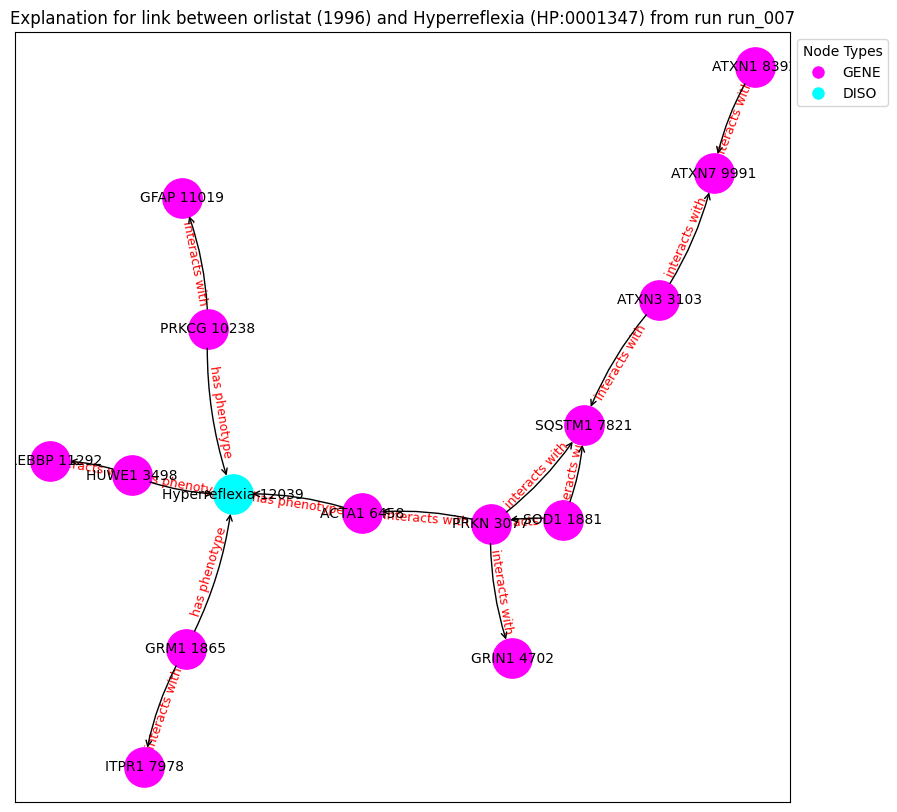

('GRM1 1865', {'type': 'GENE'})
('SOD1 1881', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('ITPR1 7978', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('CREBBP 11292', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('GRM1 1865', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('GRM1 1865', 'ITPR1 7978', {'label': 'interacts with'})
('SOD1 1881', 'PRKN 3077', {'label': 'interacts with'})
('SOD1 1881', 'SQSTM1 7821', {'label': 'interacts with'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'SQSTM1 7821', {'label': 'interacts with'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('ATXN3 3103', 'SQSTM1 7821', {'label': 'interacts with'})
('ATXN3 3103', 'ATXN7 9991',

Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 198.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7589], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7589], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7589], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7589], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7589], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7589], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7589], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7589], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7589], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 201.82it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                              label  \
12080     12080  HP:0004408     DISO  Abnormality of the sense of smell   

       semantic_id  
12080            1  
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.2702], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2702], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 209.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2702], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2702], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2702], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 221.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2702], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 212.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2702], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 210.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2702], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 220.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2702], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 206.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2702], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 214.95it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
1369      1369  HP:0000751     DISO  Personality changes            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 241.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 241.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:03<00:00, 232.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:03<00:00, 219.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 241.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.39it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
1369      1369  HP:0000751     DISO  Personality changes            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.2181], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2181], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2181], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 241.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2181], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2181], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 241.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2181], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2181], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2181], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2181], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2181], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.49it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic     label  semantic_id
13477     13477  HP:0002063     DISO  Rigidity            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6772], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.85it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6772], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.68it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6772], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.68it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6772], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.35it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6772], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.17it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6772], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 177.22it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6772], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 179.52it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6772], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.10it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6772], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.48it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6772], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.93it/s]


Contribution threshold is tensor(0.9936)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


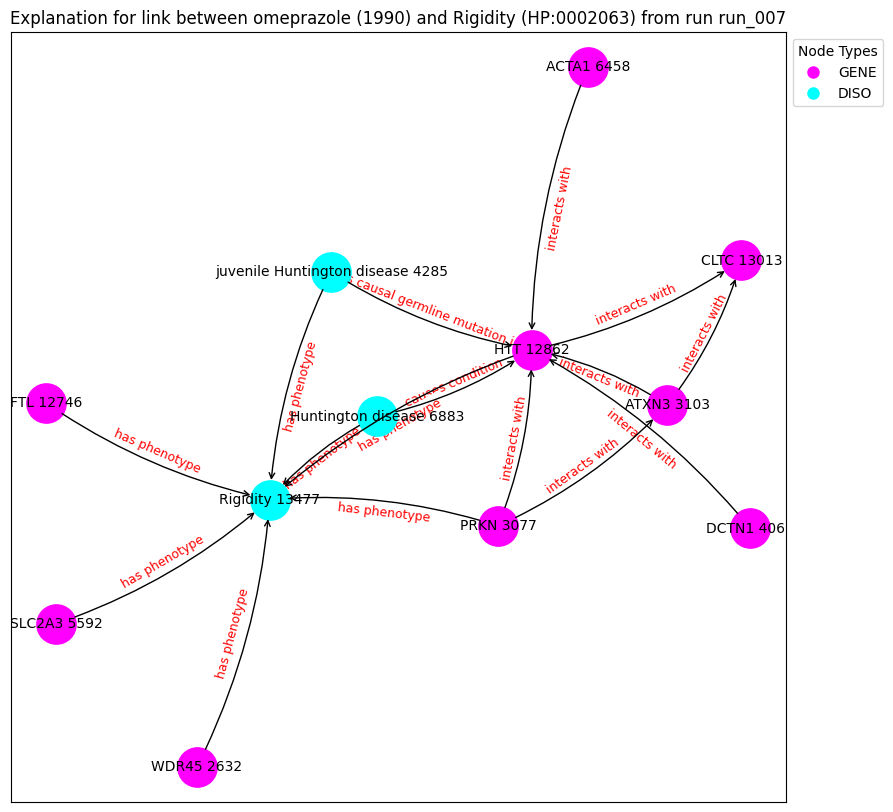

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Rigidity 13477', {'type': 'DISO'})
('WDR45 2632', 'Rigidity 13477', {'label': 'has phenotype'})
('PRKN 3077', 'HTT 12862', {'label': 'interacts with'})
('PRKN 3077', 'Rigidity 13477', {'label': 'has phenotype'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'HTT 12862', {'label': 'interacts with'})
('ATXN3 3103', 'CLTC 13013', {'label': 'interacts with'})
('DCTN1 4063', 'HTT 12862', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is causal germline mutation in'})
('juvenile Huntington disease 4285', 'Rigidity 13477', {'label': '

Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:04<00:00, 167.17it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 177.37it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.62it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 185.75it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:04<00:00, 174.22it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 185.99it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 180.54it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 184.80it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:04<00:00, 172.01it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 185.37it/s]


Contribution threshold is tensor(0.9936)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


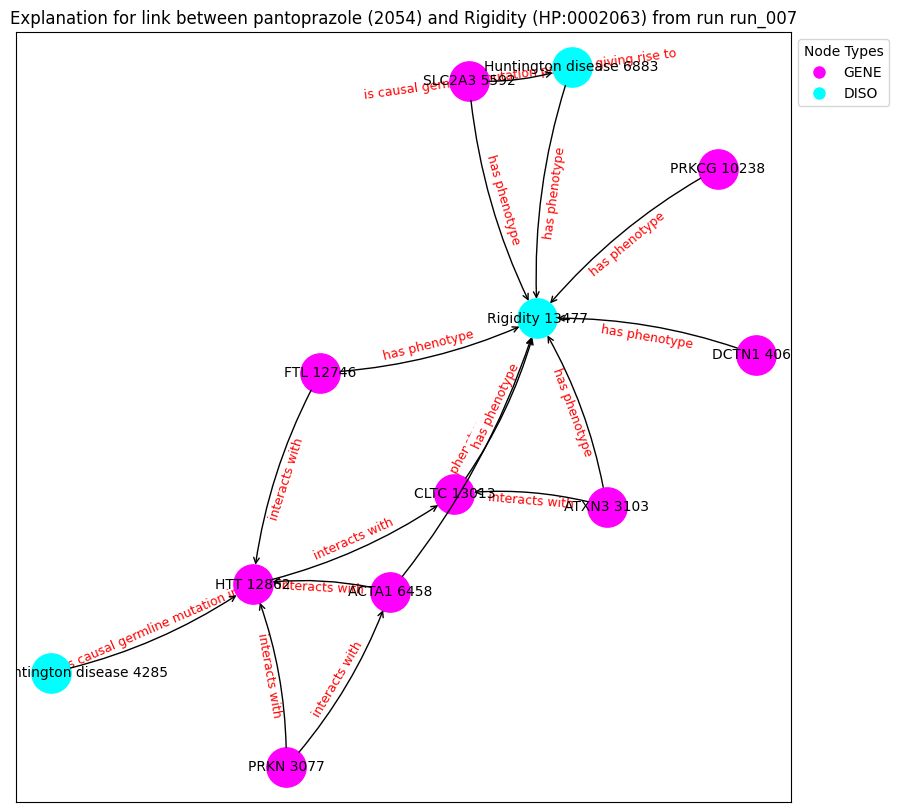

('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('PRKCG 10238', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Rigidity 13477', {'type': 'DISO'})
('PRKN 3077', 'HTT 12862', {'label': 'interacts with'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('ATXN3 3103', 'CLTC 13013', {'label': 'interacts with'})
('ATXN3 3103', 'Rigidity 13477', {'label': 'has phenotype'})
('DCTN1 4063', 'Rigidity 13477', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is causal germline mutation in'})
('SLC2A3 5592', 'Rigidity 13477', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('ACTA

Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 213.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 232.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 243.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 247.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 233.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 231.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 232.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 245.40it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                      label  \
434       434  HP:0002500     DISO  Abnormal cerebral white matter morphology   

     semantic_id  
434            1  
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 237.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 245.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:03<00:00, 229.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 245.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 244.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 237.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 239.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 238.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 244.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 239.25it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                      label  \
434       434  HP:0002500     DISO  Abnormal cerebral white matter morphology   

     semantic_id  
434            1  
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 246.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 241.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:03<00:00, 225.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 240.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 253.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 240.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 236.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 248.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 236.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 233.58it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic          label  semantic_id
13239     13239  HP:0003487     DISO  Babinski sign            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.7022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.12it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.7022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 176.89it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 176.36it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.7022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 169.42it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 179.07it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 175.13it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 178.10it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.7022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 176.14it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 168.68it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 172.75it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


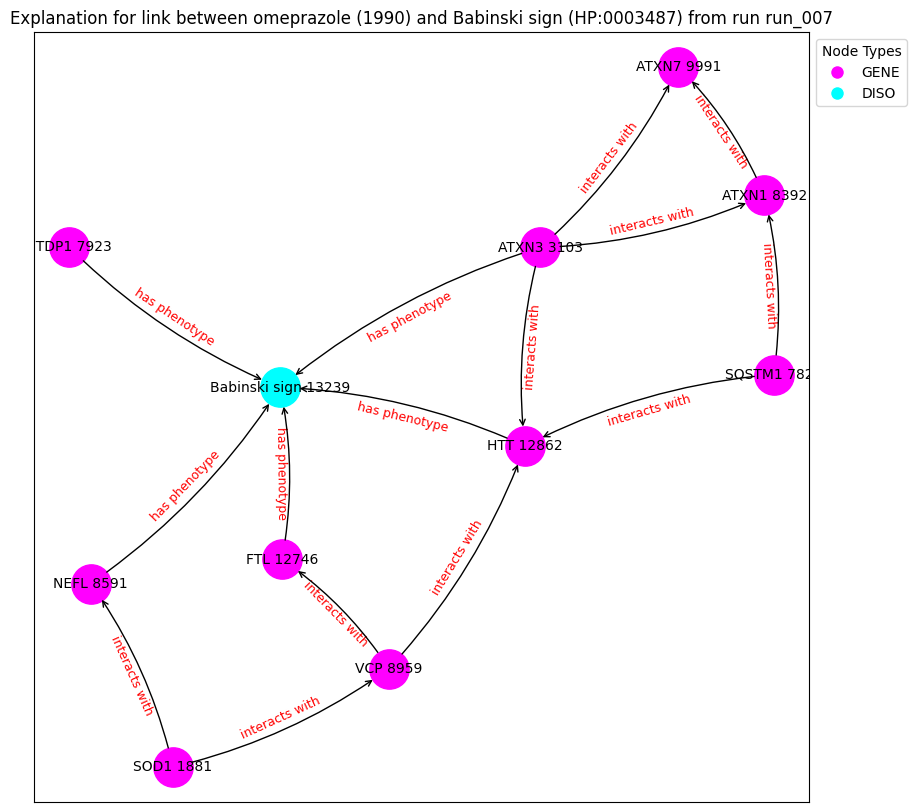

('SOD1 1881', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Babinski sign 13239', {'type': 'DISO'})
('SOD1 1881', 'NEFL 8591', {'label': 'interacts with'})
('SOD1 1881', 'VCP 8959', {'label': 'interacts with'})
('ATXN3 3103', 'HTT 12862', {'label': 'interacts with'})
('ATXN3 3103', 'ATXN7 9991', {'label': 'interacts with'})
('ATXN3 3103', 'Babinski sign 13239', {'label': 'has phenotype'})
('ATXN3 3103', 'ATXN1 8392', {'label': 'interacts with'})
('SQSTM1 7821', 'HTT 12862', {'label': 'interacts with'})
('SQSTM1 7821', 'ATXN1 8392', {'label': 'interacts with'})
('CTDP1 7923', 'Babinski sign 13239', {'label': 'has phenotype'})
('ATXN1 8392', 'ATXN7 9991', {'label': 'interacts with'})
('NEFL 8591', 'Babinski sign 13239', {'lab

Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:04<00:00, 167.12it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7091], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:04<00:00, 172.10it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.7091], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 177.77it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7091], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:04<00:00, 169.58it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7091], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 175.52it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7091], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 176.56it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.7091], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:04<00:00, 167.83it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.7091], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 176.34it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7091], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:04<00:00, 168.92it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.7091], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 177.06it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


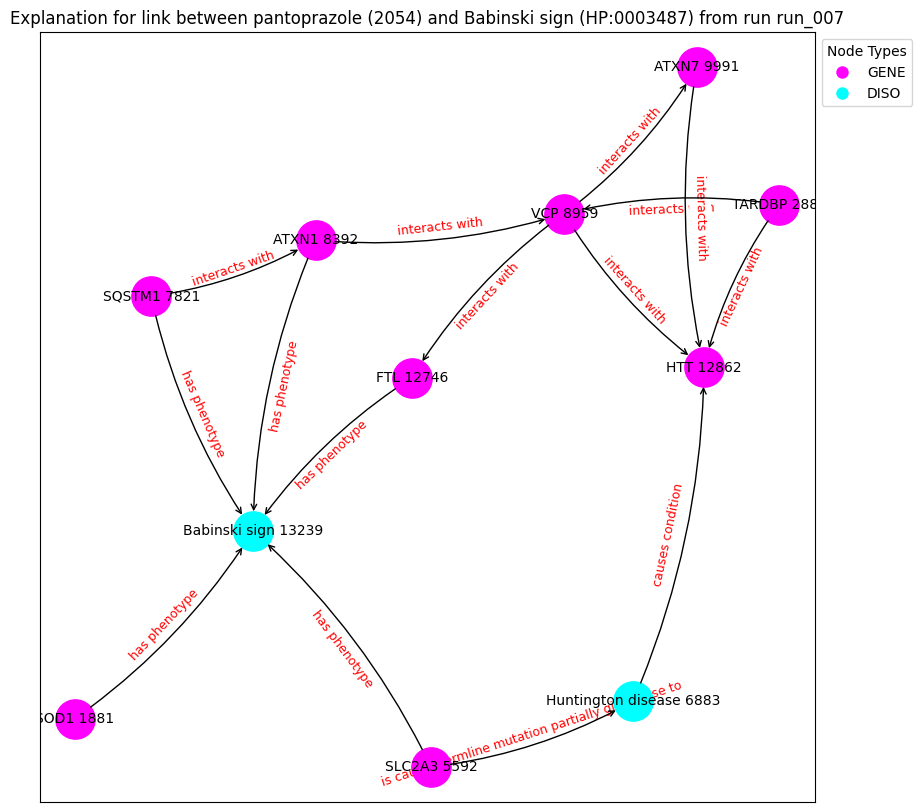

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Babinski sign 13239', {'type': 'DISO'})
('SOD1 1881', 'Babinski sign 13239', {'label': 'has phenotype'})
('TARDBP 2880', 'HTT 12862', {'label': 'interacts with'})
('TARDBP 2880', 'VCP 8959', {'label': 'interacts with'})
('SLC2A3 5592', 'Babinski sign 13239', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('Huntington disease 6883', 'HTT 12862', {'label': 'causes condition'})
('SQSTM1 7821', 'Babinski sign 13239', {'label': 'has phenotype'})
('SQSTM1 7821', 'ATXN1 8392', {'label': 'interacts with'})
('ATXN1 8392', 'VCP 8959', {'label': 'interacts with'})
('ATXN

Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0440], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 237.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0440], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 241.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0440], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0440], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 236.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0440], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0440], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0440], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0440], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0440], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.88it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic             label  semantic_id
13592     13592  HP:0001288     DISO  Gait disturbance            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.3283], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 128.79it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3283], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 121.86it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3283], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 129.04it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3283], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 126.96it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3283], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 126.94it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3283], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 125.20it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3283], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 128.21it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3283], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 129.87it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3283], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 128.06it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3283], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 123.86it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


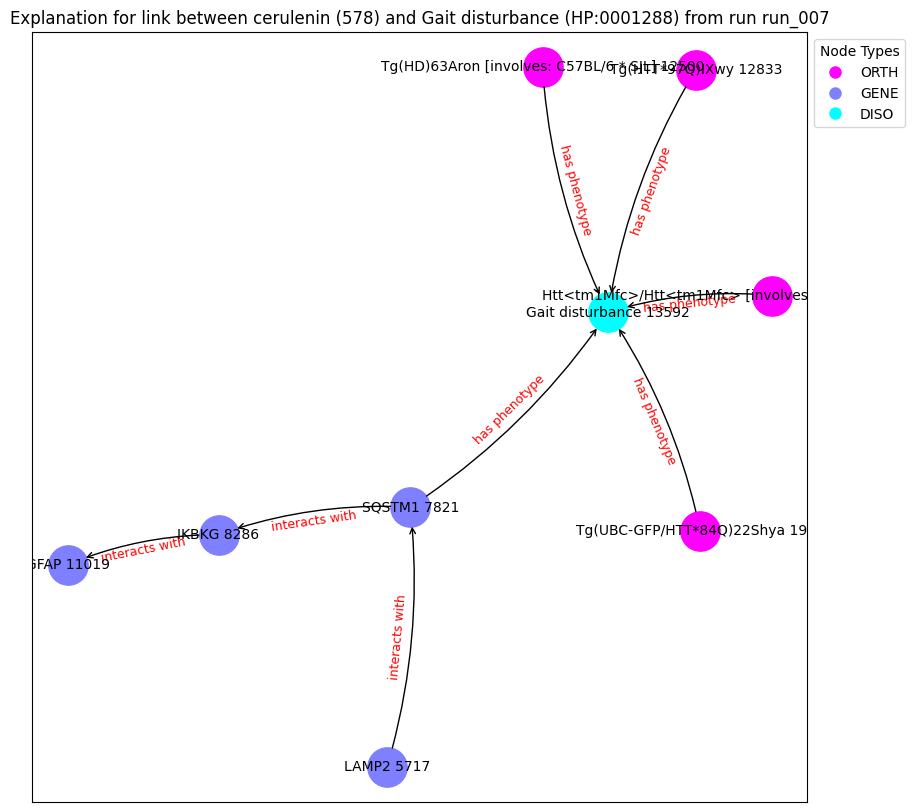

('Tg(UBC-GFP/HTT*84Q)22Shya 1968', {'type': 'ORTH'})
('Htt<tm1Mfc>/Htt<tm1Mfc> [involves: 129S1/Sv * C57BL/6] 4488', {'type': 'ORTH'})
('LAMP2 5717', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('IKBKG 8286', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('Tg(HD)63Aron [involves: C57BL/6 * SJL] 12500', {'type': 'ORTH'})
('Tg(HTT*97Q)IXwy 12833', {'type': 'ORTH'})
('Gait disturbance 13592', {'type': 'DISO'})
('Tg(UBC-GFP/HTT*84Q)22Shya 1968', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Htt<tm1Mfc>/Htt<tm1Mfc> [involves: 129S1/Sv * C57BL/6] 4488', 'Gait disturbance 13592', {'label': 'has phenotype'})
('LAMP2 5717', 'SQSTM1 7821', {'label': 'interacts with'})
('SQSTM1 7821', 'IKBKG 8286', {'label': 'interacts with'})
('SQSTM1 7821', 'Gait disturbance 13592', {'label': 'has phenotype'})
('IKBKG 8286', 'GFAP 11019', {'label': 'interacts with'})
('Tg(HD)63Aron [involves: C57BL/6 * SJL] 12500', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Tg(HTT*97Q)IXwy 12

Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 212.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4863], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4863], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4863], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 211.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4863], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4863], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4863], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4863], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 223.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4863], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4863], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.76it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                        label  semantic_id
4071      4071  HP:0003324     DISO  Generalized muscle weakness            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.6505], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 215.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6505], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6505], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 220.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6505], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 206.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6505], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 222.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6505], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 220.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6505], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 225.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6505], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 225.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6505], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 213.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6505], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.62it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                        label  semantic_id
4071      4071  HP:0003324     DISO  Generalized muscle weakness            1
node2:
      index_id    id semantic     label  semantic_id
1000      1000  1996     DRUG  orlistat            2
Prediction from trained model: tensor([0.5970], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 223.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5970], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 218.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5970], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 230.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5970], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 211.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5970], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 225.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5970], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 224.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5970], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 217.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5970], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 229.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5970], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 222.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5970], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 213.13it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
1951      1951  HP:0002354     DISO  Memory impairment            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.0201], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:03<00:00, 223.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0201], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0201], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 244.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0201], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0201], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0201], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 242.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0201], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 235.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0201], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0201], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 239.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0201], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.87it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
1951      1951  HP:0002354     DISO  Memory impairment            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.0099], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:03<00:00, 229.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0099], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:03<00:00, 230.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0099], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:03<00:00, 226.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0099], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 236.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0099], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 240.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0099], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:03<00:00, 225.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0099], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:03<00:00, 231.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0099], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:03<00:00, 225.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0099], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 236.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0099], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:03<00:00, 222.51it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\run_008
(0, {'node_feature': tensor([-1.2827e-01,  4.4501e-01,  6.2609e-01, -2.5627e-01,  6.3245e-01,
        -4.0226e-02,  5.0810e-01,  6.8469e-01, -8.4801e-01,  7.1988e-01,
        -6.5668e-01,  1.2048e+00, -2.2209e-02,  6.3826e-02,  1.3906e-01,
        -2.1106e-01,  3.2675e-04, -4.2977e-01,  7.6430e-01, -2.1061e-01,
         5.4452e-01, -2.2575e-01, -6.0184e-02, -6.6464e-02, -7.3592e-01,
        -4.8977e-01,  4.8376e-01, -6.0411e-01, -6.9825e-01,  1.1033e+00,
         9.7110e-02,  1.6796e-01])})
(0, 11953, {'edge_label': 'in orthology relationship with'})
Number of edges is 134749
Number of nodes is 14833
node1:
       index_id          id semantic       label  semantic_id
13668     13668  HP:0000716     DISO  Depression            1
node2:
     index_id    id semantic       label  semantic_id
998       998  199

Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 162.87it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6644], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 155.98it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6644], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 156.11it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6644], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 165.46it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6644], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 151.86it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6644], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 166.81it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6644], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 160.70it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6644], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 160.09it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6644], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 152.74it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6644], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 141.84it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


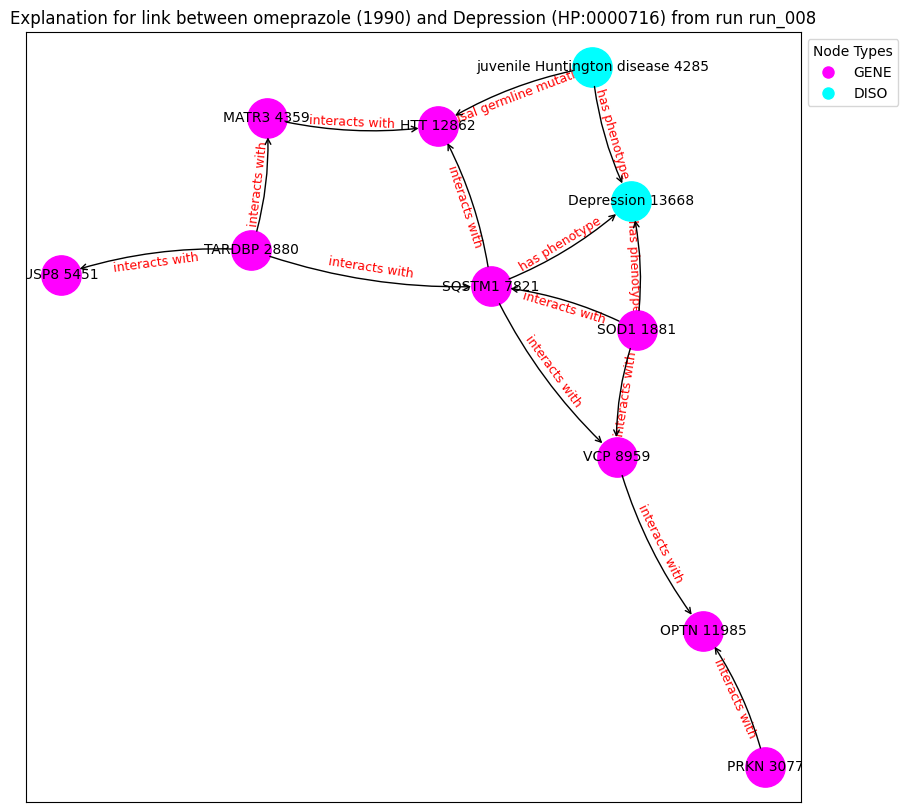

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('MATR3 4359', {'type': 'GENE'})
('USP8 5451', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('SOD1 1881', 'SQSTM1 7821', {'label': 'interacts with'})
('SOD1 1881', 'VCP 8959', {'label': 'interacts with'})
('SOD1 1881', 'Depression 13668', {'label': 'has phenotype'})
('TARDBP 2880', 'SQSTM1 7821', {'label': 'interacts with'})
('TARDBP 2880', 'USP8 5451', {'label': 'interacts with'})
('TARDBP 2880', 'MATR3 4359', {'label': 'interacts with'})
('PRKN 3077', 'OPTN 11985', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is causal germline mutation in'})
('juvenile Huntington disease 4285', 'Depression 13668', {'label': 'has phenotype'})
('MATR3 4359', 'HTT 1286

Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 154.32it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6177], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 151.30it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6177], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 163.82it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6177], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 159.28it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6177], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 164.99it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6177], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 161.33it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6177], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 161.12it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6177], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 161.33it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6177], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 157.93it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6177], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:04<00:00, 162.10it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


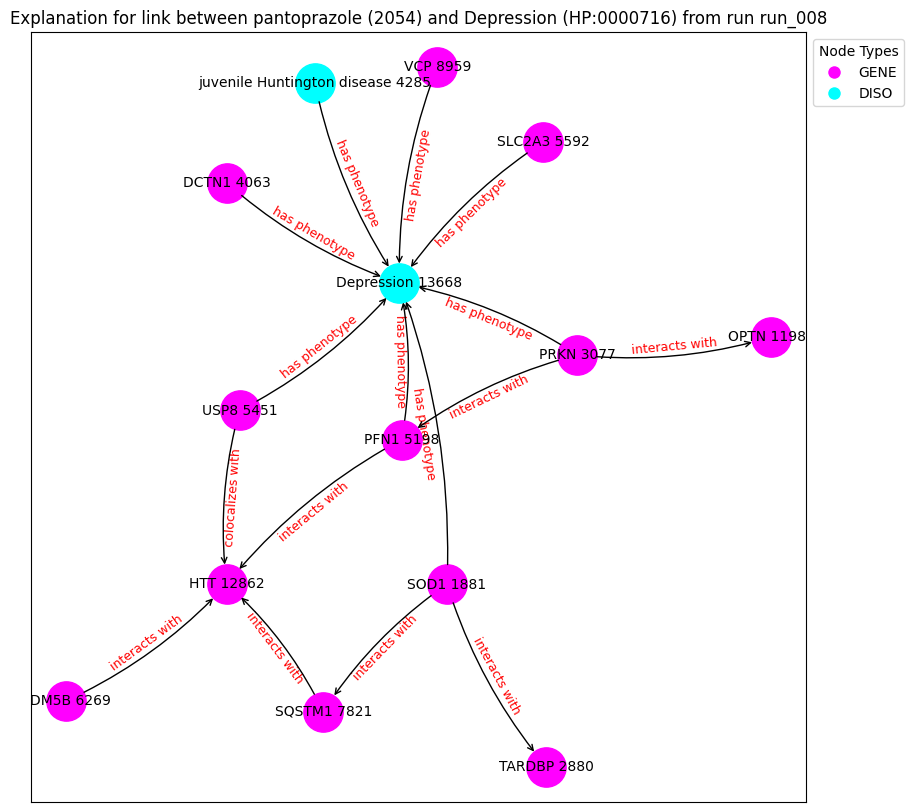

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('PFN1 5198', {'type': 'GENE'})
('USP8 5451', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('SOD1 1881', 'SQSTM1 7821', {'label': 'interacts with'})
('SOD1 1881', 'TARDBP 2880', {'label': 'interacts with'})
('SOD1 1881', 'Depression 13668', {'label': 'has phenotype'})
('PRKN 3077', 'Depression 13668', {'label': 'has phenotype'})
('PRKN 3077', 'OPTN 11985', {'label': 'interacts with'})
('PRKN 3077', 'PFN1 5198', {'label': 'interacts with'})
('DCTN1 4063', 'Depression 13668', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'Depression 13668', {'label': 'has phenotype'})
('PFN1 5198',

Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 153.01it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6809], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 151.99it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6809], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 161.89it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6809], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 158.63it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6809], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 151.68it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6809], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 157.25it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6809], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 160.45it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6809], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 152.79it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6809], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 160.78it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6809], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 155.74it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


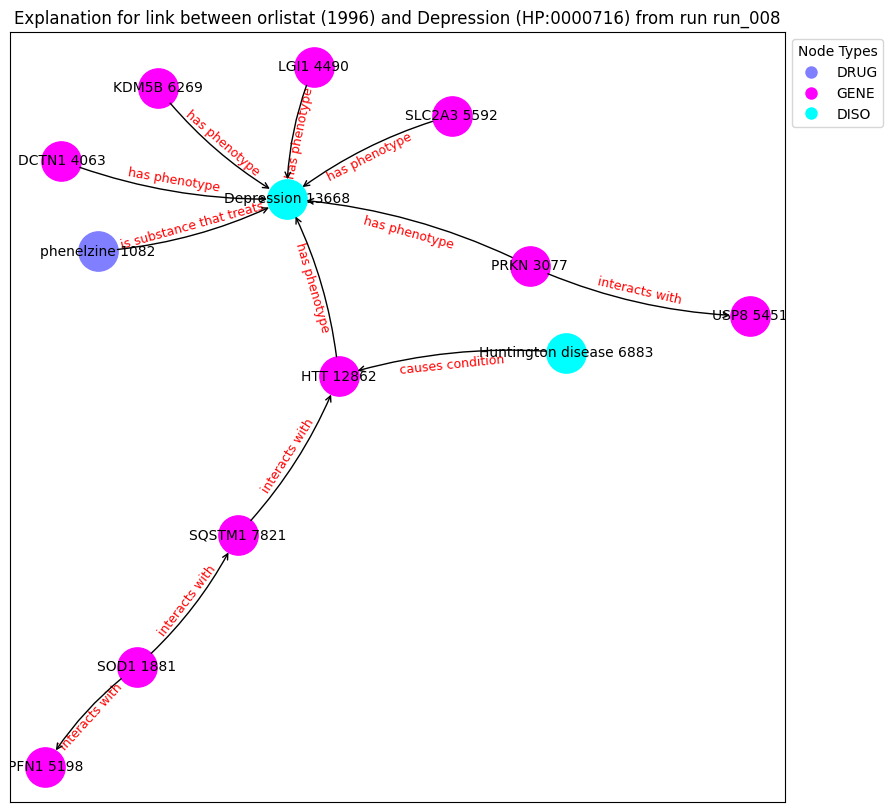

('phenelzine 1082', {'type': 'DRUG'})
('SOD1 1881', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('LGI1 4490', {'type': 'GENE'})
('PFN1 5198', {'type': 'GENE'})
('USP8 5451', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('phenelzine 1082', 'Depression 13668', {'label': 'is substance that treats'})
('SOD1 1881', 'SQSTM1 7821', {'label': 'interacts with'})
('SOD1 1881', 'PFN1 5198', {'label': 'interacts with'})
('PRKN 3077', 'Depression 13668', {'label': 'has phenotype'})
('PRKN 3077', 'USP8 5451', {'label': 'interacts with'})
('DCTN1 4063', 'Depression 13668', {'label': 'has phenotype'})
('LGI1 4490', 'Depression 13668', {'label': 'has phenotype'})
('SLC2A3 5592', 'Depression 13668', {'label': 'has phenotype'})
('KDM5B 6269', 'Depression 13668', {'label': 'has p

Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 209.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6078], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 215.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6078], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 199.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6078], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6078], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6078], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 218.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6078], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 229.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6078], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6078], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 212.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6078], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 220.73it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                         label  semantic_id
5086      5086  HP:0040140     DISO  Degeneration of the striatum            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.6005], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 229.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6005], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 211.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6005], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 215.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6005], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6005], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6005], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6005], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6005], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6005], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6005], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 216.03it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                         label  semantic_id
5086      5086  HP:0040140     DISO  Degeneration of the striatum            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.6640], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6640], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 206.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6640], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6640], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6640], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6640], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6640], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6640], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6640], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6640], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.45it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic     label  semantic_id
12933     12933  HP:0001332     DISO  Dystonia            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6524], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:05<00:00, 138.59it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6524], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 144.74it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6524], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 144.86it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6524], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 144.81it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6524], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 148.03it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6524], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 143.67it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6524], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 140.75it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6524], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 145.82it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6524], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 140.41it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6524], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 144.65it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


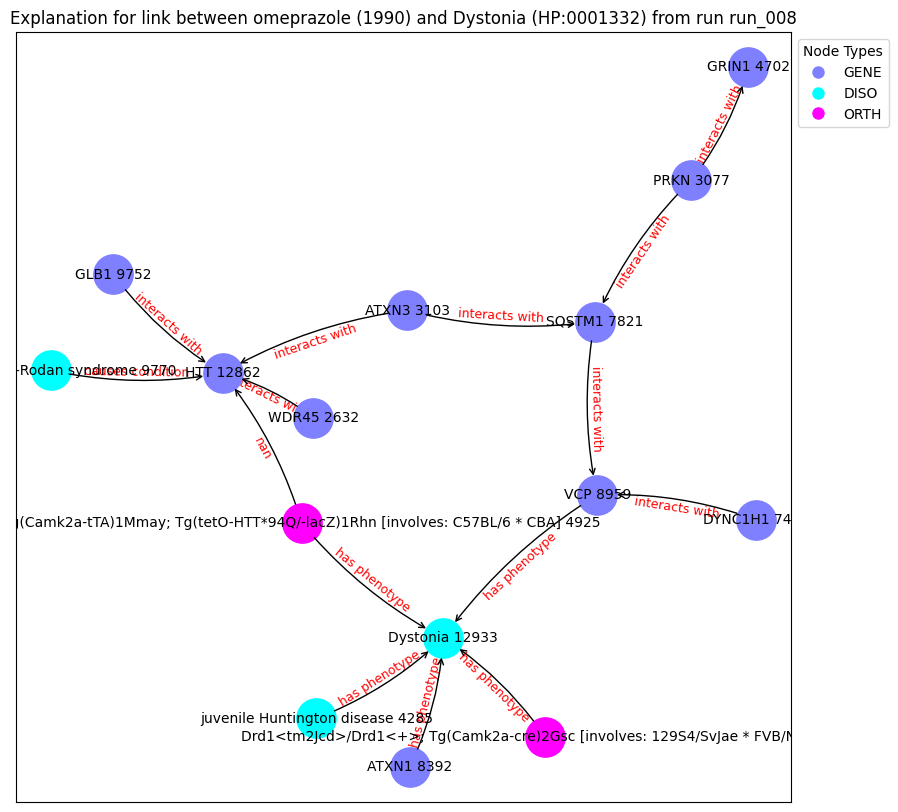

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('Tg(Camk2a-tTA)1Mmay; Tg(tetO-HTT*94Q/-lacZ)1Rhn [involves: C57BL/6 * CBA] 4925', {'type': 'ORTH'})
('DYNC1H1 7452', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('GLB1 9752', {'type': 'GENE'})
('Lopes-Maciel-Rodan syndrome 9770', {'type': 'DISO'})
('Drd1<tm2Jcd>/Drd1<+>; Tg(Camk2a-cre)2Gsc [involves: 129S4/SvJae * FVB/N] 10314', {'type': 'ORTH'})
('HTT 12862', {'type': 'GENE'})
('Dystonia 12933', {'type': 'DISO'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('PRKN 3077', 'SQSTM1 7821', {'label': 'interacts with'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('ATXN3 3103', 'SQSTM1 7821', {'label': 'interacts with'})
('ATXN3 3103', 'HTT 12862', {'label': 'interacts with'})
('juvenile Huntington disease 4285'

Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:05<00:00, 137.86it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 140.84it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 147.31it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 140.77it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 143.70it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:05<00:00, 139.13it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:05<00:00, 138.80it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 146.26it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 146.16it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6022], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:05<00:00, 138.89it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


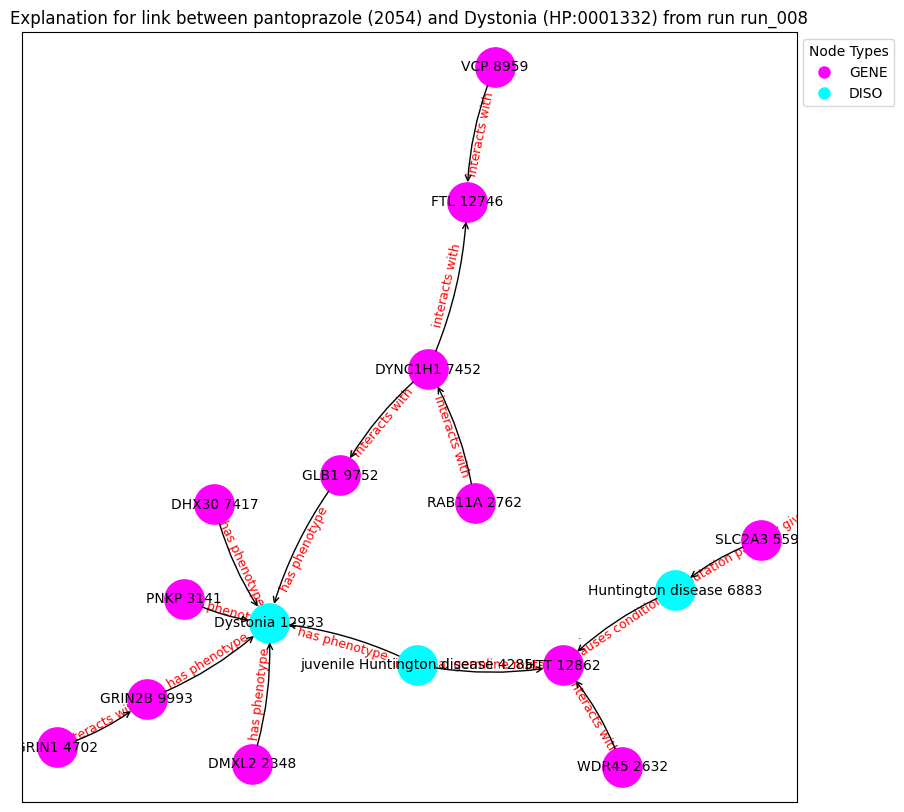

('DMXL2 2348', {'type': 'GENE'})
('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('GLB1 9752', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Dystonia 12933', {'type': 'DISO'})
('DMXL2 2348', 'Dystonia 12933', {'label': 'has phenotype'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('PNKP 3141', 'Dystonia 12933', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is causal germline mutation in'})
('juvenile Huntington disease 4285', 'Dystonia 12933', {'label': 'has phenotype'})
('GRIN1 4702', 'G

Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 228.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 216.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 240.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 228.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 238.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.64it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic    label  semantic_id
1789      1789  HP:0000739     DISO  Anxiety            1
node2:
      index_id    id semantic     label  semantic_id
1000      1000  1996     DRUG  orlistat            2
Prediction from trained model: tensor([0.9874], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 239.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9874], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 247.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9874], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 224.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9874], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 225.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9874], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 240.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9874], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 229.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9874], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 234.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9874], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 218.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9874], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 227.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9874], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 224.01it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic            label  semantic_id
14311     14311  HP:0031845     DISO  Abnormal libido            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5890], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5890], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5890], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 209.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5890], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 207.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5890], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5890], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5890], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5890], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 209.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5890], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5890], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.70it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6616], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6616], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 197.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6616], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6616], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6616], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 209.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6616], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 228.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6616], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6616], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 218.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6616], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6616], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 206.82it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.6021], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 187.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6021], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 209.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6021], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6021], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 221.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6021], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 211.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6021], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 227.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6021], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6021], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 215.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6021], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 229.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6021], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 208.40it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.6275], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 211.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6275], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 222.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6275], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 231.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6275], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6275], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 227.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6275], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 205.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6275], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 221.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6275], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 225.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6275], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 207.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6275], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 215.38it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.5598], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 198.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5598], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 195.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5598], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 204.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5598], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 196.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5598], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 197.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5598], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 198.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5598], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 195.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5598], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 202.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5598], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 188.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5598], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 201.90it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6228], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 199.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6228], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6228], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6228], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 180.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6228], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6228], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 199.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6228], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 199.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6228], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 200.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6228], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6228], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 200.57it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.5877], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5877], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 201.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5877], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5877], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 207.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5877], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5877], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5877], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5877], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 200.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5877], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5877], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 199.78it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
11096     11096  HP:0025401     DISO  Staring gaze            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.6019], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6019], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 205.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6019], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6019], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6019], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 196.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6019], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6019], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 211.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6019], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6019], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6019], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11096 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.58it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
6473      6473  HP:0001272     DISO  Cerebellar atrophy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6651], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6651], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6651], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6651], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 178.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6651], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6651], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6651], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6651], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6651], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6651], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.33it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
6473      6473  HP:0001272     DISO  Cerebellar atrophy            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.6222], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6222], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 184.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6222], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 177.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6222], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6222], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6222], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6222], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6222], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6222], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6222], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.09it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
4670      4670  HP:0031589     DISO  Suicidal ideation            1
node2:
      index_id    id semantic             label  semantic_id
2023      2023  4226     DRUG  ingenol mebutate            2
Prediction from trained model: tensor([0.5928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 211.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 222.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 224.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 222.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 222.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 222.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 212.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:02<00:00, 238.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 215.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5928], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 228.66it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
4670      4670  HP:0031589     DISO  Suicidal ideation            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.5885], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5885], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 215.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5885], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 233.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5885], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5885], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 212.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5885], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 232.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5885], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5885], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 213.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5885], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5885], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.38it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic        label  semantic_id
2028      2028  HP:0002066     DISO  Gait ataxia            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.7073], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 198.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7073], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7073], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7073], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 218.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7073], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7073], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7073], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 210.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7073], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7073], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 229.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7073], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.21it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic        label  semantic_id
2028      2028  HP:0002066     DISO  Gait ataxia            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.6641], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 227.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6641], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 210.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6641], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 221.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6641], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 211.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6641], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 229.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6641], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 221.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6641], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 211.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6641], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 221.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6641], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 222.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6641], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 214.50it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                 label  semantic_id
10550     10550  HP:0001268     DISO  Mental deterioration            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6381], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6381], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 207.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6381], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 204.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6381], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6381], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6381], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6381], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6381], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6381], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6381], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 197.43it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                 label  semantic_id
10550     10550  HP:0001268     DISO  Mental deterioration            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.5978], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 203.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5978], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5978], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5978], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5978], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 202.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5978], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 204.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5978], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 178.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5978], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 203.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5978], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 199.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5978], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 198.47it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
6571      6571  HP:0031473     DISO  Hostility            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 232.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 206.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5761], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.36it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                        label  semantic_id
8786      8786  HP:0000496     DISO  Abnormality of eye movement            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.5820], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5820], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 209.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5820], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 211.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5820], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 211.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5820], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 214.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5820], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 203.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5820], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5820], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 211.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5820], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5820], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 214.81it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic             label  semantic_id
9177      9177  HP:0030842     DISO  Choking episodes            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5246], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 209.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5246], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5246], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5246], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5246], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5246], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5246], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5246], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5246], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5246], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.82it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic         label  semantic_id
7072      7072  HP:0002067     DISO  Bradykinesia            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.6662], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 185.18it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6662], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 192.78it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6662], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 190.22it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6662], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:04<00:00, 173.70it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6662], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 189.74it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6662], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 180.28it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6662], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 185.15it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6662], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 182.52it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6662], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 188.19it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6662], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 184.34it/s]


Contribution threshold is tensor(0.0061)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


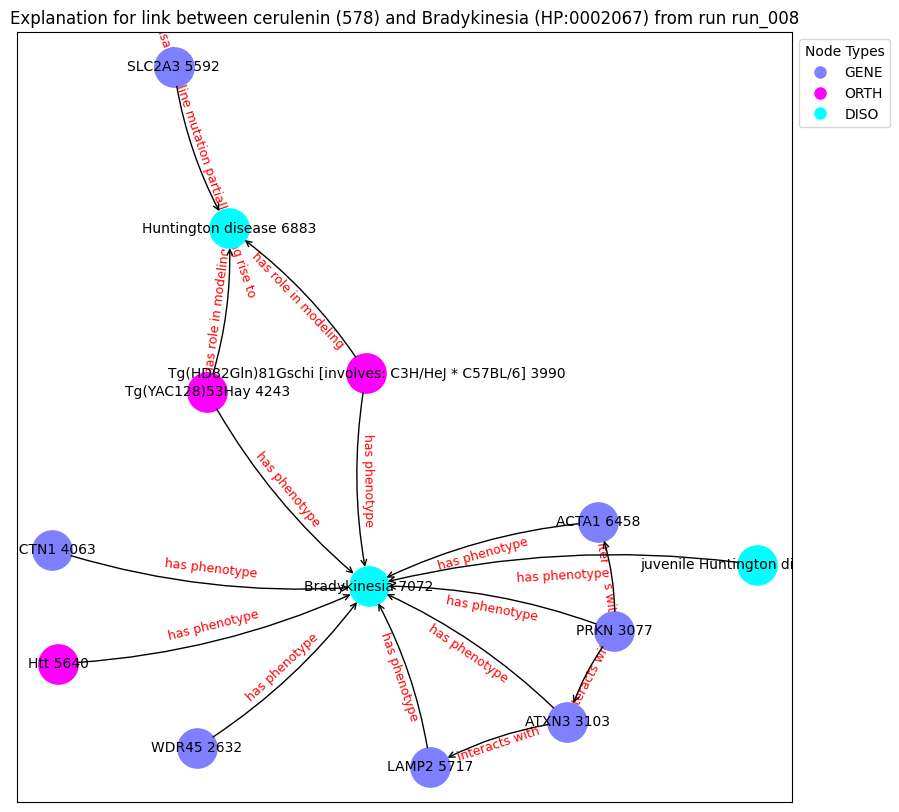

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', {'type': 'ORTH'})
('DCTN1 4063', {'type': 'GENE'})
('Tg(YAC128)53Hay 4243', {'type': 'ORTH'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('LAMP2 5717', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('Bradykinesia 7072', {'type': 'DISO'})
('WDR45 2632', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'Bradykinesia 7072', {'label': 'has phenotype'})
('ATXN3 3103', 'LAMP2 5717', {'label': 'interacts with'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Huntington disease 6883', {'label': 'has role in modelin

Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 179.71it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6114], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:04<00:00, 170.04it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6114], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 184.77it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6114], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 183.64it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6114], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 188.21it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6114], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 179.74it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6114], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 189.96it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6114], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 181.38it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6114], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 188.13it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6114], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 185.10it/s]


Contribution threshold is tensor(0.0061)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


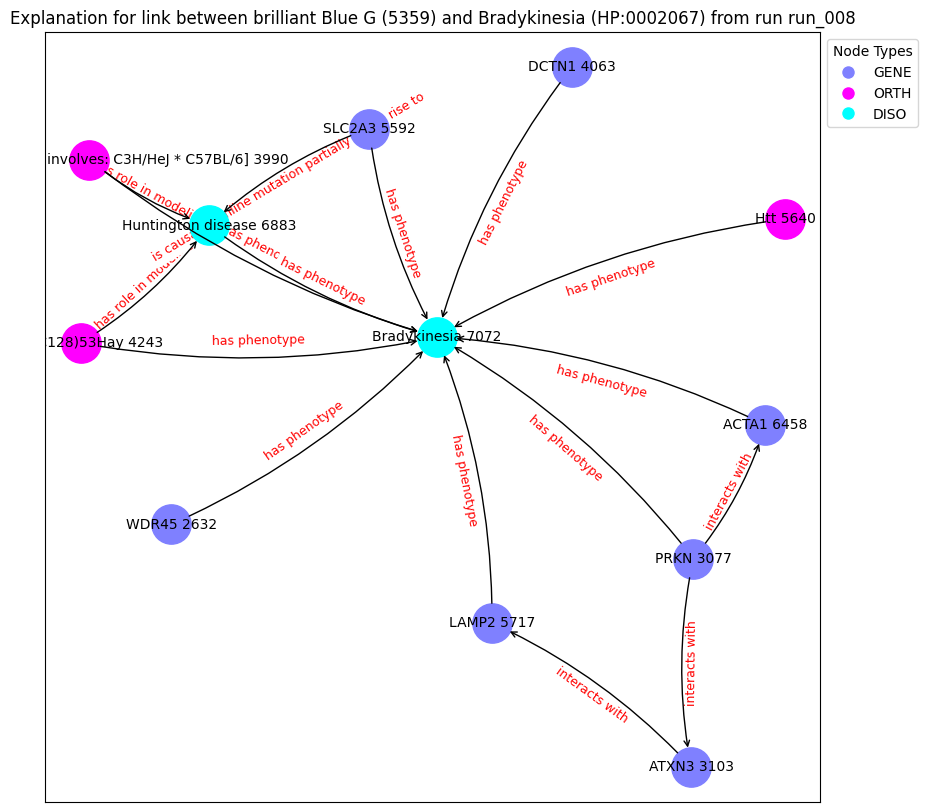

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', {'type': 'ORTH'})
('DCTN1 4063', {'type': 'GENE'})
('Tg(YAC128)53Hay 4243', {'type': 'ORTH'})
('SLC2A3 5592', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('LAMP2 5717', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('Bradykinesia 7072', {'type': 'DISO'})
('WDR45 2632', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'LAMP2 5717', {'label': 'interacts with'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Huntington disease 6883', {'label': 'has role in modeling'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Bradykinesia 7072', {'label': 'has phenotype'})
('DCTN1

Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 210.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9991], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9991], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9991], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 239.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9991], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 230.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9991], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 240.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9991], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9991], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 252.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9991], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9991], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.69it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic           label  semantic_id
1065      1065  HP:0002141     DISO  Gait imbalance            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.9940], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:03<00:00, 220.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9940], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 240.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9940], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 240.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9940], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:03<00:00, 224.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9940], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:03<00:00, 230.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9940], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:03<00:00, 230.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9940], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 242.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9940], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 234.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9940], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 244.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9940], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:03<00:00, 226.10it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic      label  semantic_id
13378     13378  HP:0001336     DISO  Myoclonus            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6482], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.97it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6482], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 177.57it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6482], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.94it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6482], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 177.59it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6482], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.45it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6482], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 180.69it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6482], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 177.17it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6482], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 176.50it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6482], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 176.72it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6482], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.02it/s]


Contribution threshold is tensor(0.9936)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


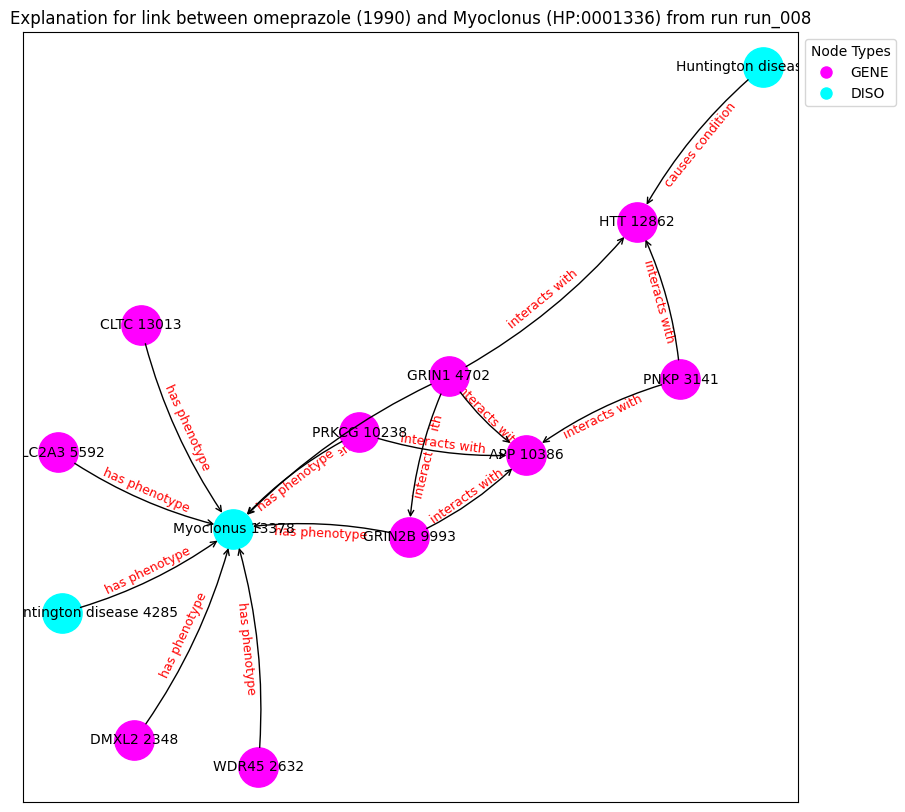

('DMXL2 2348', {'type': 'GENE'})
('WDR45 2632', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('GRIN2B 9993', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('APP 10386', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Myoclonus 13378', {'type': 'DISO'})
('DMXL2 2348', 'Myoclonus 13378', {'label': 'has phenotype'})
('WDR45 2632', 'Myoclonus 13378', {'label': 'has phenotype'})
('PNKP 3141', 'HTT 12862', {'label': 'interacts with'})
('PNKP 3141', 'APP 10386', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'Myoclonus 13378', {'label': 'has phenotype'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'APP 10386', {'label': 'interacts with'})
('GRIN1 4702', 'Myoclonus 13378', {'la

Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 178.56it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6041], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:04<00:00, 174.39it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6041], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 185.58it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6041], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 176.70it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6041], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.41it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6041], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 175.09it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6041], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 184.94it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6041], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 184.68it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6041], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 178.50it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6041], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 1036: 100%|██████████| 700/700 [00:03<00:00, 184.91it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


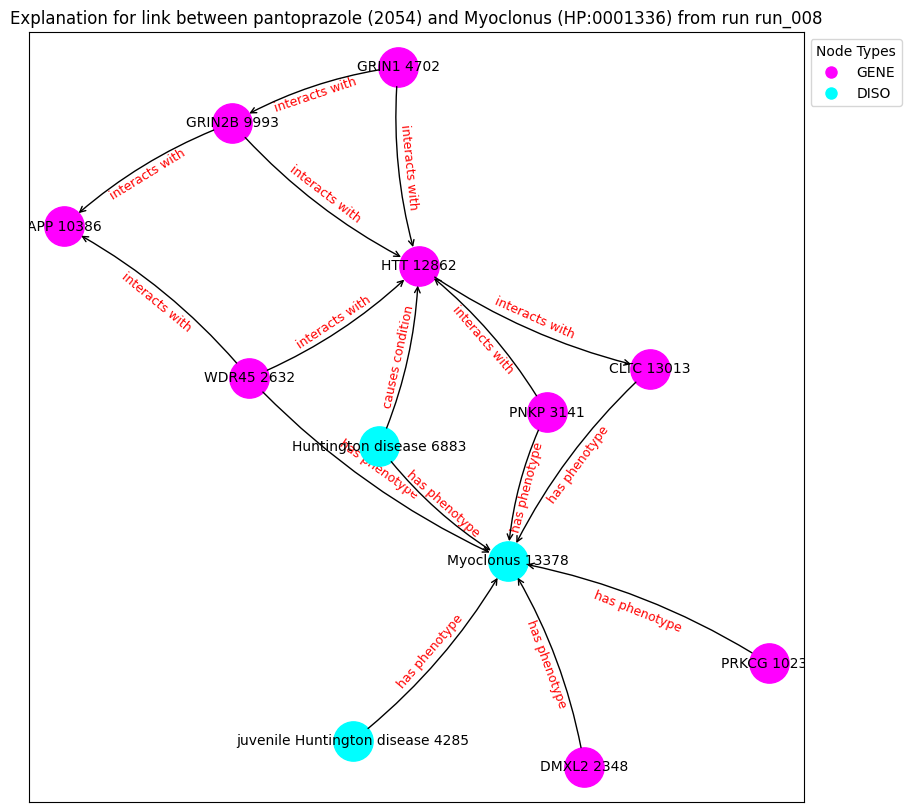

('DMXL2 2348', {'type': 'GENE'})
('WDR45 2632', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('GRIN2B 9993', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('APP 10386', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Myoclonus 13378', {'type': 'DISO'})
('DMXL2 2348', 'Myoclonus 13378', {'label': 'has phenotype'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('WDR45 2632', 'APP 10386', {'label': 'interacts with'})
('WDR45 2632', 'Myoclonus 13378', {'label': 'has phenotype'})
('PNKP 3141', 'HTT 12862', {'label': 'interacts with'})
('PNKP 3141', 'Myoclonus 13378', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'Myoclonus 13378', {'label': 'has phenotype'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('Huntingt

Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6657], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6657], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6657], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6657], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 177.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6657], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6657], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 199.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6657], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6657], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6657], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.12it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
5935      5935  HP:0000713     DISO  Agitation            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.6144], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6144], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 200.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6144], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 198.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6144], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6144], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 203.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6144], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6144], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 199.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6144], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 196.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6144], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6144], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 196.46it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
5935      5935  HP:0000713     DISO  Agitation            1
node2:
      index_id    id semantic     label  semantic_id
1000      1000  1996     DRUG  orlistat            2
Prediction from trained model: tensor([0.6855], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:04<00:00, 174.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6855], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 189.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6855], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 187.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6855], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 200.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6855], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 196.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6855], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 200.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6855], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 204.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6855], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 188.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6855], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 195.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6855], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 202.19it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic    label  semantic_id
3363      3363  HP:0002171     DISO  Gliosis            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.6884], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 207.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6884], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 194.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6884], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 201.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6884], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 190.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6884], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6884], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6884], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 202.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6884], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 197.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6884], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 203.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6884], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 199.27it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic   label  semantic_id
14731     14731  HP:0002072     DISO  Chorea            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6593], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 167.94it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6593], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 169.43it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6593], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.93it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6593], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.94it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6593], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.37it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6593], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 169.45it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6593], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.46it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6593], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 172.20it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6593], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 163.54it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6593], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 172.28it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


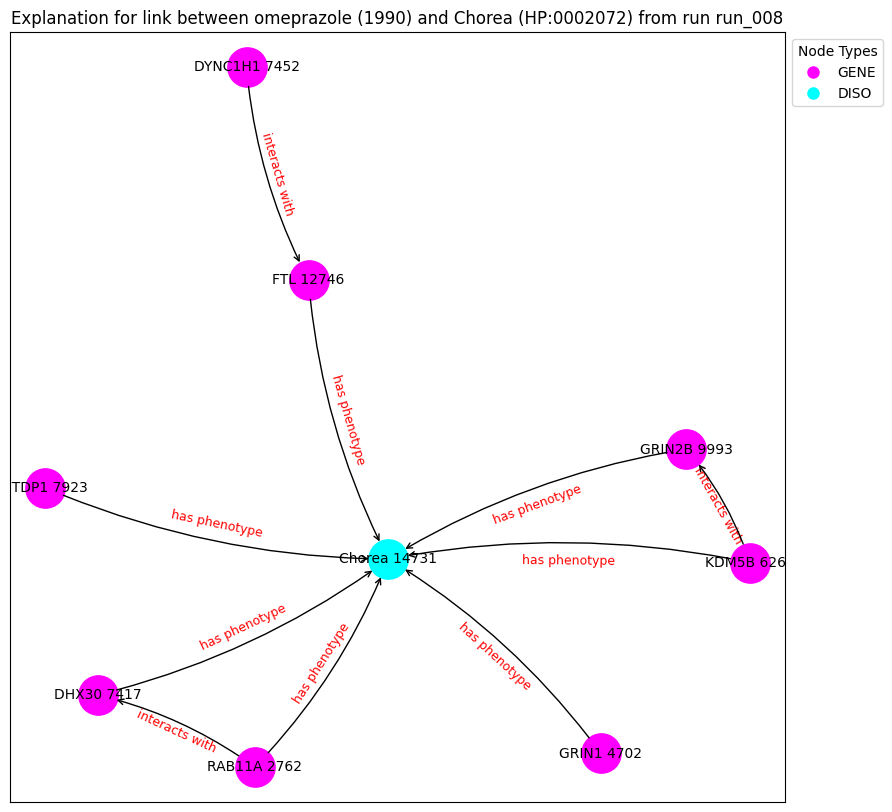

('RAB11A 2762', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('Chorea 14731', {'type': 'DISO'})
('RAB11A 2762', 'Chorea 14731', {'label': 'has phenotype'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('GRIN1 4702', 'Chorea 14731', {'label': 'has phenotype'})
('KDM5B 6269', 'GRIN2B 9993', {'label': 'interacts with'})
('KDM5B 6269', 'Chorea 14731', {'label': 'has phenotype'})
('DHX30 7417', 'Chorea 14731', {'label': 'has phenotype'})
('DYNC1H1 7452', 'FTL 12746', {'label': 'interacts with'})
('CTDP1 7923', 'Chorea 14731', {'label': 'has phenotype'})
('GRIN2B 9993', 'Chorea 14731', {'label': 'has phenotype'})
('FTL 12746', 'Chorea 14731', {'label': 'has phenotype'})
Explanation graph saved at c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output

Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 164.88it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6089], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 164.55it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6089], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 169.48it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6089], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 171.12it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6089], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 168.19it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6089], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 166.50it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6089], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 168.03it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6089], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 166.61it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6089], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 170.66it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6089], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 168.84it/s]


Contribution threshold is tensor(0.9936)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


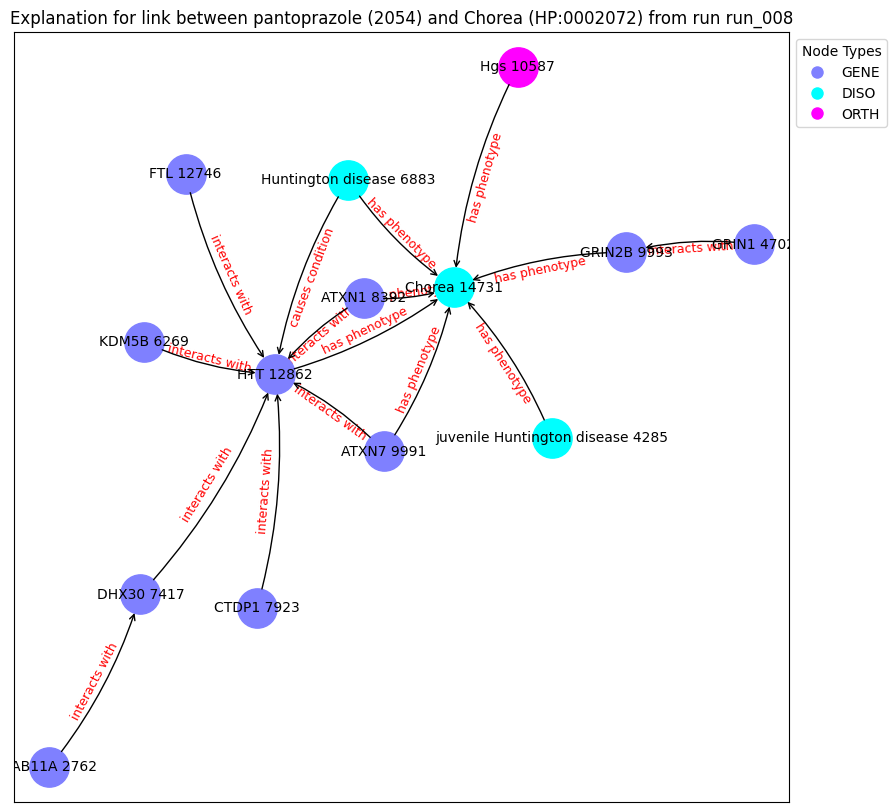

('RAB11A 2762', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('Hgs 10587', {'type': 'ORTH'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Chorea 14731', {'type': 'DISO'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'Chorea 14731', {'label': 'has phenotype'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('KDM5B 6269', 'HTT 12862', {'label': 'interacts with'})
('Huntington disease 6883', 'HTT 12862', {'label': 'causes condition'})
('Huntington disease 6883', 'Chorea 14731', {'label': 'has phenotype'})
('DHX30 7417', 'HTT 12862', {'label': 'interacts with'})
('CTDP1 7923', 'HTT 12862', {'label': 'intera

Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9990], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 238.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9990], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9990], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:03<00:00, 230.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9990], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:03<00:00, 213.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9990], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:03<00:00, 231.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9990], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9990], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9990], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 235.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9990], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:03<00:00, 228.37it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic       label  semantic_id
2824      2824  HP:0002312     DISO  Clumsiness            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.9914], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 240.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9914], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 244.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9914], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 239.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9914], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 235.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9914], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:03<00:00, 211.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9914], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 240.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9914], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9914], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 242.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9914], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 233.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9914], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:03<00:00, 232.60it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic       label  semantic_id
2824      2824  HP:0002312     DISO  Clumsiness            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 240.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 257.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 236.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 238.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 251.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 239.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 238.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:03<00:00, 231.31it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic        label  semantic_id
13123     13123  HP:0001824     DISO  Weight loss            1
node2:
      index_id    id semantic           label  semantic_id
2596      2596  5382     DRUG  bempedoic acid            2
Prediction from trained model: tensor([0.6117], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 138.30it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6117], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 134.60it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6117], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 133.19it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6117], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 139.44it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6117], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 131.46it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6117], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 138.13it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6117], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 132.60it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6117], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 138.57it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6117], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 131.01it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6117], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:05<00:00, 133.51it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


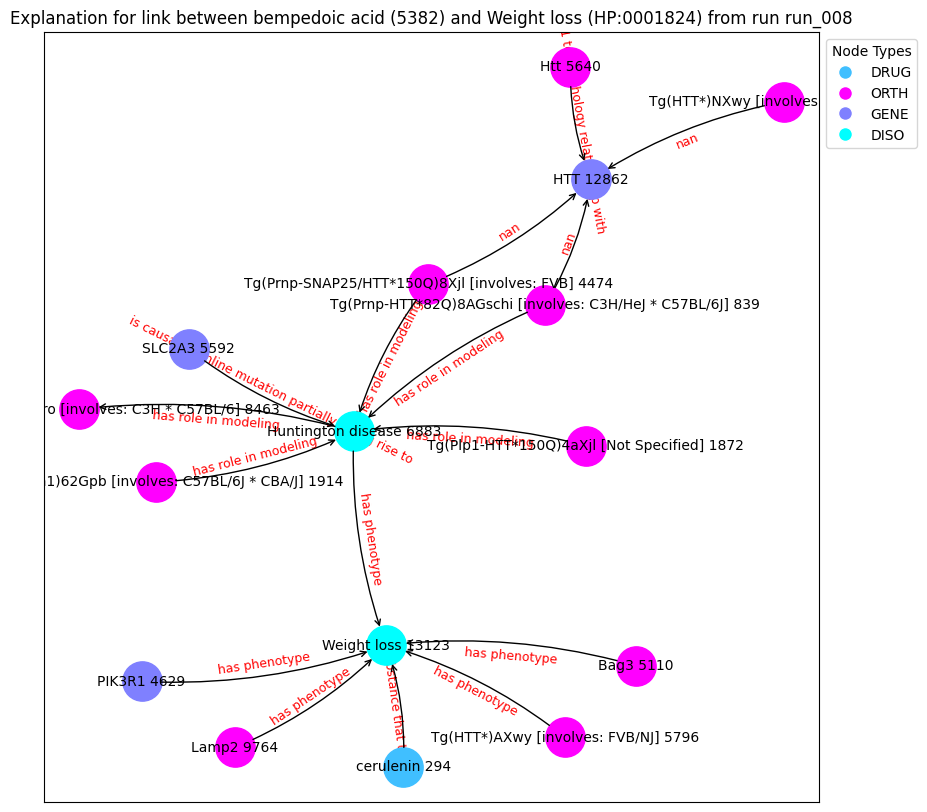

('cerulenin 294', {'type': 'DRUG'})
('Tg(Prnp-HTT*82Q)8AGschi [involves: C3H/HeJ * C57BL/6J] 839', {'type': 'ORTH'})
('Tg(Plp1-HTT*150Q)4aXjl [Not Specified] 1872', {'type': 'ORTH'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', {'type': 'ORTH'})
('Tg(Prnp-SNAP25/HTT*150Q)8Xjl [involves: FVB] 4474', {'type': 'ORTH'})
('PIK3R1 4629', {'type': 'GENE'})
('Bag3 5110', {'type': 'ORTH'})
('SLC2A3 5592', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('Tg(HTT*)AXwy [involves: FVB/NJ] 5796', {'type': 'ORTH'})
('Huntington disease 6883', {'type': 'DISO'})
('Tg(HTT*)NXwy [involves: FVB/NJ] 8290', {'type': 'ORTH'})
('Tg(Prnp-HTT*82Q)52Caro [involves: C3H * C57BL/6] 8463', {'type': 'ORTH'})
('Lamp2 9764', {'type': 'ORTH'})
('HTT 12862', {'type': 'GENE'})
('Weight loss 13123', {'type': 'DISO'})
('cerulenin 294', 'Weight loss 13123', {'label': 'is substance that treats'})
('Tg(Prnp-HTT*82Q)8AGschi [involves: C3H/HeJ * C57BL/6J] 839', 'Huntington disease 6883', {'label': 'has role in model

Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 130.72it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5495], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 126.12it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5495], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 139.22it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5495], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 135.43it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5495], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 132.90it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5495], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 135.42it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5495], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 127.56it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5495], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 131.04it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5495], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 137.90it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5495], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 350: 100%|██████████| 700/700 [00:05<00:00, 135.09it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


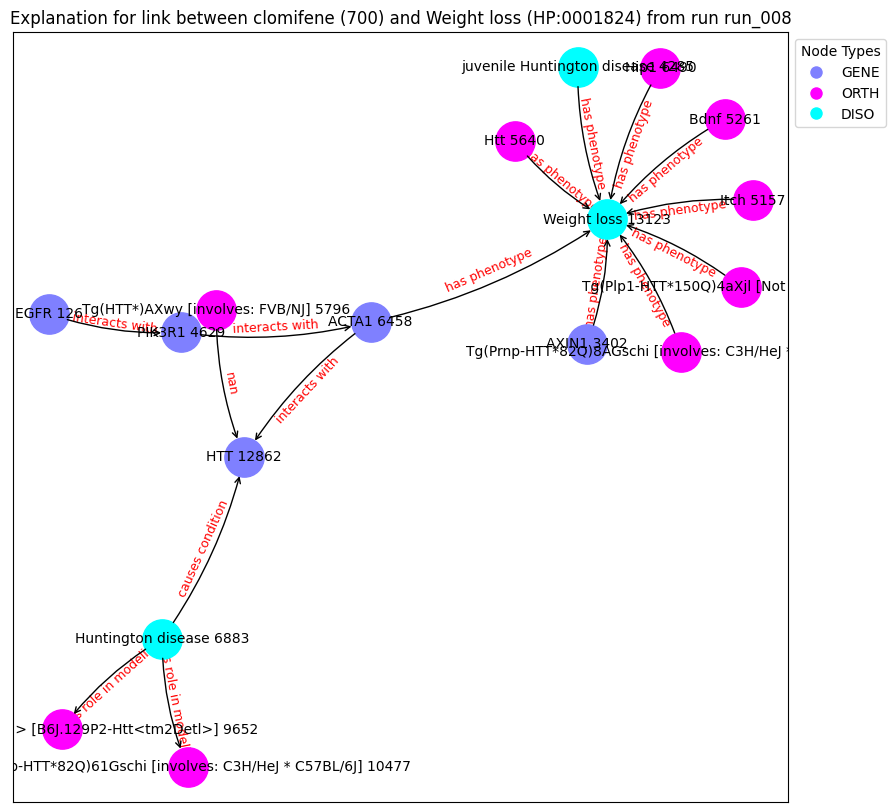

('EGFR 126', {'type': 'GENE'})
('Tg(Prnp-HTT*82Q)8AGschi [involves: C3H/HeJ * C57BL/6J] 839', {'type': 'ORTH'})
('Tg(Plp1-HTT*150Q)4aXjl [Not Specified] 1872', {'type': 'ORTH'})
('AXIN1 3402', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('PIK3R1 4629', {'type': 'GENE'})
('Itch 5157', {'type': 'ORTH'})
('Bdnf 5261', {'type': 'ORTH'})
('Htt 5640', {'type': 'ORTH'})
('Tg(HTT*)AXwy [involves: FVB/NJ] 5796', {'type': 'ORTH'})
('ACTA1 6458', {'type': 'GENE'})
('Hip1 6490', {'type': 'ORTH'})
('Huntington disease 6883', {'type': 'DISO'})
('Htt<tm2Detl>/Htt<+> [B6J.129P2-Htt<tm2Detl>] 9652', {'type': 'ORTH'})
('Tg(Prnp-HTT*82Q)61Gschi [involves: C3H/HeJ * C57BL/6J] 10477', {'type': 'ORTH'})
('HTT 12862', {'type': 'GENE'})
('Weight loss 13123', {'type': 'DISO'})
('EGFR 126', 'PIK3R1 4629', {'label': 'interacts with'})
('Tg(Prnp-HTT*82Q)8AGschi [involves: C3H/HeJ * C57BL/6J] 839', 'Weight loss 13123', {'label': 'has phenotype'})
('Tg(Plp1-HTT*150Q)4aXjl [Not Specified

Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.12it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5896], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 181.76it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5896], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.99it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5896], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.81it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5896], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:04<00:00, 174.73it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5896], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.13it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5896], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 196.96it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5896], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.30it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5896], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 185.39it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5896], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.66it/s]


Contribution threshold is tensor(0.0061)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


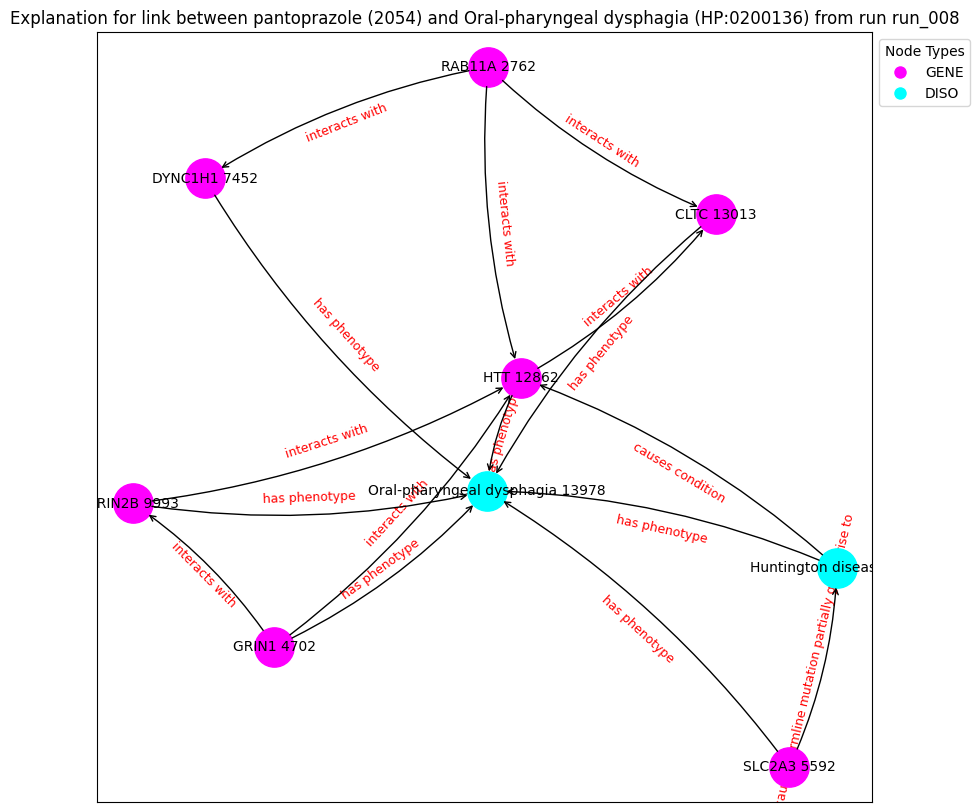

('RAB11A 2762', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Oral-pharyngeal dysphagia 13978', {'type': 'DISO'})
('RAB11A 2762', 'HTT 12862', {'label': 'interacts with'})
('RAB11A 2762', 'CLTC 13013', {'label': 'interacts with'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('SLC2A3 5592', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('Huntington disease 6883', 'HTT 12862', {'label': 'causes condition'})
('Huntington disease 6883', 'Ora

Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6460], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6460], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6460], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6460], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6460], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 197.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6460], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6460], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6460], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 198.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6460], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.06it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic     label  semantic_id
10333     10333  HP:0000726     DISO  Dementia            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.6004], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6004], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 185.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6004], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6004], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6004], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6004], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 184.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6004], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6004], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6004], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6004], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.95it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic    label  semantic_id
8961      8961  HP:0001250     DISO  Seizure            1
node2:
      index_id    id semantic     label  semantic_id
1000      1000  1996     DRUG  orlistat            2
Prediction from trained model: tensor([0.6971], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 127.83it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6971], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 137.88it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6971], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 137.91it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6971], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 134.61it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6971], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 138.72it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6971], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 139.31it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6971], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 134.25it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6971], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 132.91it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6971], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 131.89it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6971], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 139.31it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


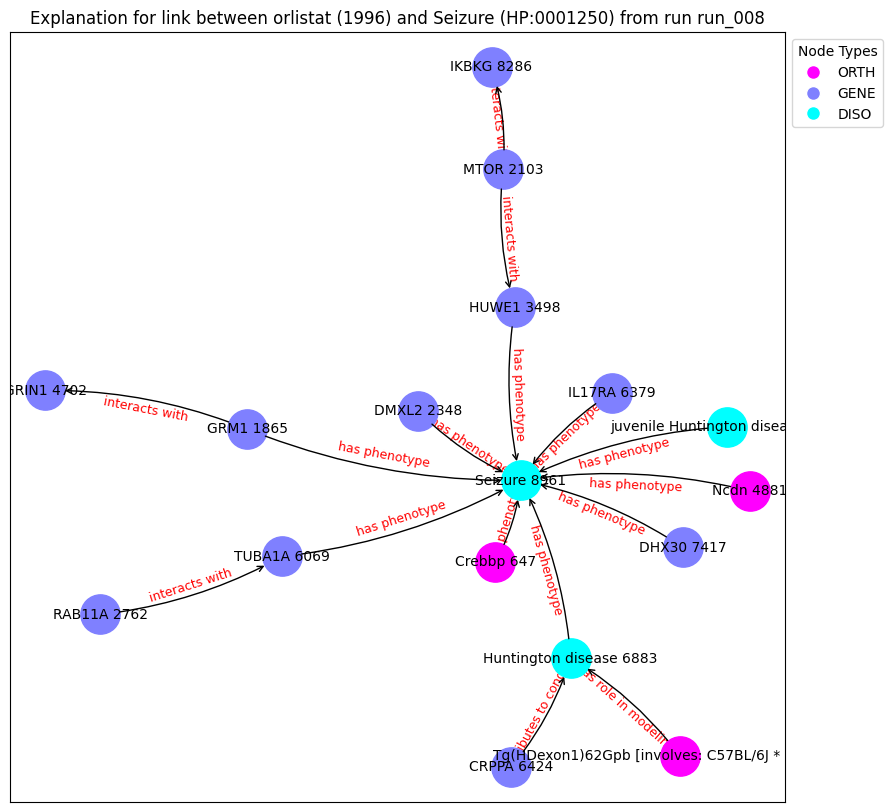

('Crebbp 647', {'type': 'ORTH'})
('GRM1 1865', {'type': 'GENE'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', {'type': 'ORTH'})
('MTOR 2103', {'type': 'GENE'})
('DMXL2 2348', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('Ncdn 4881', {'type': 'ORTH'})
('TUBA1A 6069', {'type': 'GENE'})
('IL17RA 6379', {'type': 'GENE'})
('CRPPA 6424', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('IKBKG 8286', {'type': 'GENE'})
('Seizure 8961', {'type': 'DISO'})
('Crebbp 647', 'Seizure 8961', {'label': 'has phenotype'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('GRM1 1865', 'Seizure 8961', {'label': 'has phenotype'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', 'Huntington disease 6883', {'label': 'has role in modeling'})
('MTOR 2103', 'HUWE1 3498', {'label': 'interacts with'})
('MTOR 2103', 

Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 138.11it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 130.56it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 134.11it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 139.94it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 136.35it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 135.55it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 137.59it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 137.81it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 140.77it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 135.88it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


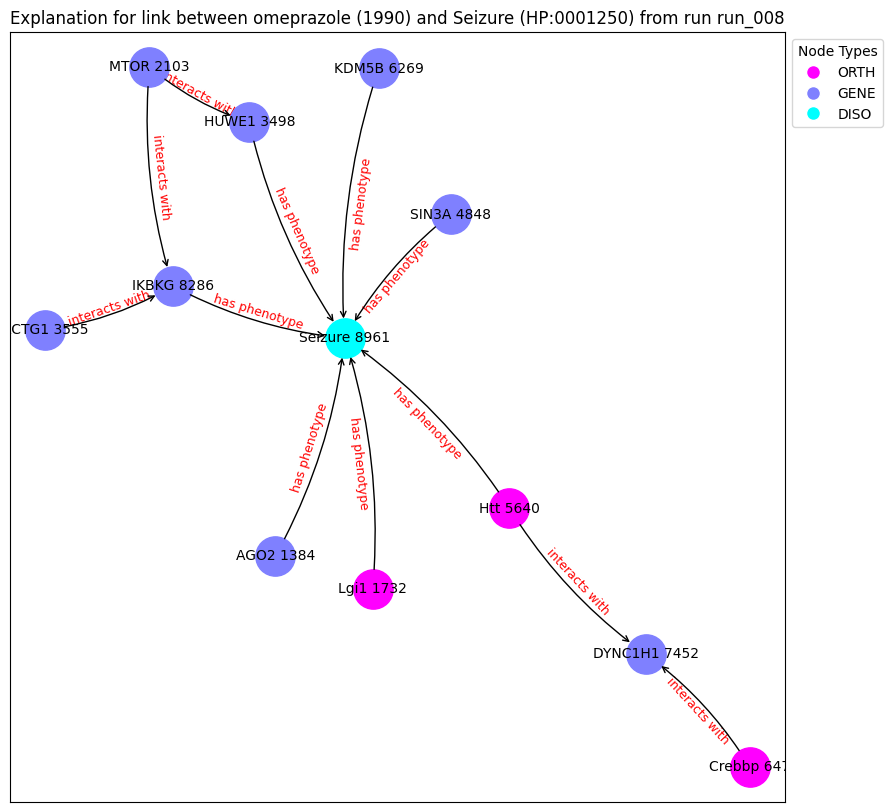

('Crebbp 647', {'type': 'ORTH'})
('AGO2 1384', {'type': 'GENE'})
('Lgi1 1732', {'type': 'ORTH'})
('MTOR 2103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('ACTG1 3555', {'type': 'GENE'})
('SIN3A 4848', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('KDM5B 6269', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('IKBKG 8286', {'type': 'GENE'})
('Seizure 8961', {'type': 'DISO'})
('Crebbp 647', 'DYNC1H1 7452', {'label': 'interacts with'})
('AGO2 1384', 'Seizure 8961', {'label': 'has phenotype'})
('Lgi1 1732', 'Seizure 8961', {'label': 'has phenotype'})
('MTOR 2103', 'HUWE1 3498', {'label': 'interacts with'})
('MTOR 2103', 'IKBKG 8286', {'label': 'interacts with'})
('HUWE1 3498', 'Seizure 8961', {'label': 'has phenotype'})
('ACTG1 3555', 'IKBKG 8286', {'label': 'interacts with'})
('SIN3A 4848', 'Seizure 8961', {'label': 'has phenotype'})
('Htt 5640', 'DYNC1H1 7452', {'label': 'interacts with'})
('Htt 5640', 'Seizure 8961', {'label': 'has phenotype'})
('KDM5B 6269', 'Seizure 

Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4501], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4501], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 205.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4501], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4501], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4501], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 210.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4501], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4501], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4501], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4501], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.84it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
11896     11896  HP:0000737     DISO  Irritability            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.5950], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 202.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5950], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 205.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5950], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 214.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5950], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 208.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5950], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 199.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5950], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 213.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5950], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5950], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 205.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5950], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 206.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5950], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 207.92it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                             label  \
1317      1317  HP:0009088     DISO  Speech articulation difficulties   

      semantic_id  
1317            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.9987], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9987], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9987], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9987], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9987], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 244.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9987], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9987], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9987], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9987], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9987], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.59it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
4154      4154  HP:0000746     DISO  Delusions            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.9985], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9985], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9985], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 245.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9985], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9985], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9985], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9985], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 245.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9985], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 236.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9985], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 244.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9985], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.16it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                         label  \
12562     12562  HP:0001262     DISO  Excessive daytime somnolence   

       semantic_id  
12562            1  
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 223.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 212.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 206.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 209.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 206.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 207.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 217.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.06it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic           label  semantic_id
5925      5925  HP:0000738     DISO  Hallucinations            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6588], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 207.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6588], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 217.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6588], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6588], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6588], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 207.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6588], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6588], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6588], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 211.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6588], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6588], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5925 and 998: 100%|██████████| 700/700 [00:03<00:00, 218.49it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic   label  semantic_id
8154      8154  HP:0000741     DISO  Apathy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6413], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6413], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6413], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 207.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6413], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6413], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6413], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6413], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6413], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6413], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6413], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.47it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic   label  semantic_id
9999      9999  HP:0002169     DISO  Clonus            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.5979], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 205.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5979], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 221.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5979], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5979], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 205.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5979], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 216.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5979], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 205.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5979], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 193.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5979], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 175.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5979], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 198.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5979], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 209.33it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic  \
9644      9644  HP:0010794     DISO   

                                             label  semantic_id  
9644  Impaired visuospatial constructive cognition            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5249], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5249], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5249], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5249], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5249], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 209.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5249], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 209.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5249], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5249], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5249], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5249], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.73it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic              label  semantic_id
14773     14773  HP:0002540     DISO  Inability to walk            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6449], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 183.30it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6449], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 182.44it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6449], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.92it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6449], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 183.47it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6449], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 177.18it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6449], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.82it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6449], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 178.84it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6449], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.35it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6449], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.20it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6449], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.73it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


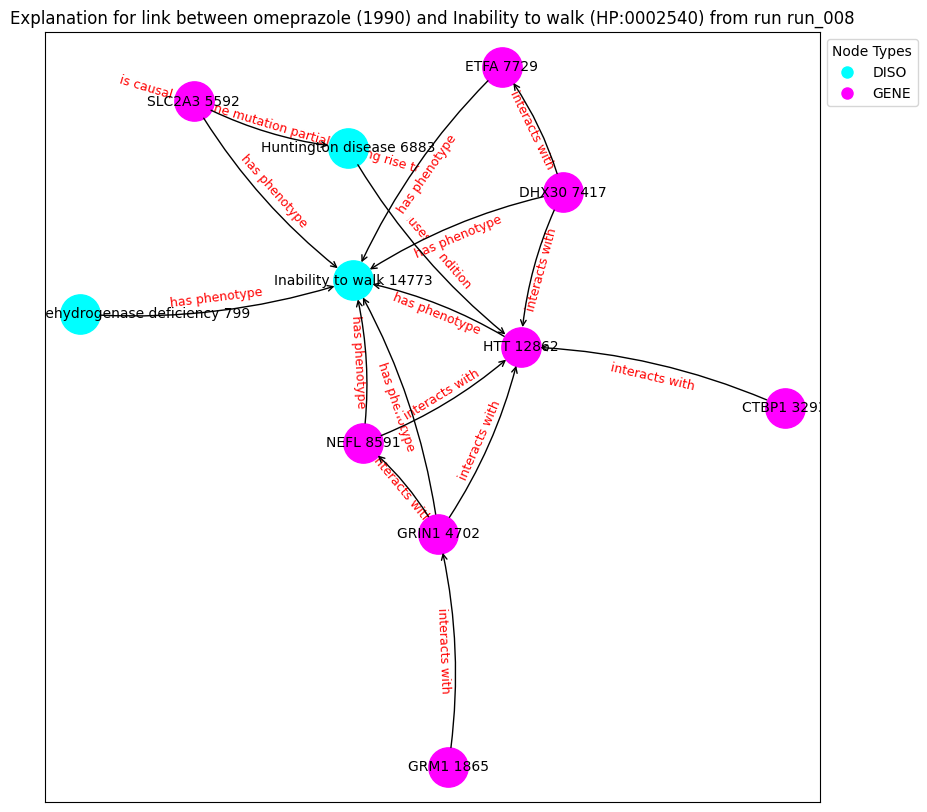

('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('GRM1 1865', {'type': 'GENE'})
('CTBP1 3293', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Inability to walk 14773', {'type': 'DISO'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('CTBP1 3293', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'NEFL 8591', {'label': 'interacts with'})
('GRIN1 4702', 'Inability to walk 14773', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('SLC2A3 5592', 'Inability to walk 14773', {'label': 'has phenot

Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:04<00:00, 173.84it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6008], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 179.72it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6008], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:04<00:00, 170.01it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6008], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 184.71it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6008], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.87it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6008], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.71it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6008], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.25it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6008], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.83it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6008], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.76it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6008], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 185.27it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


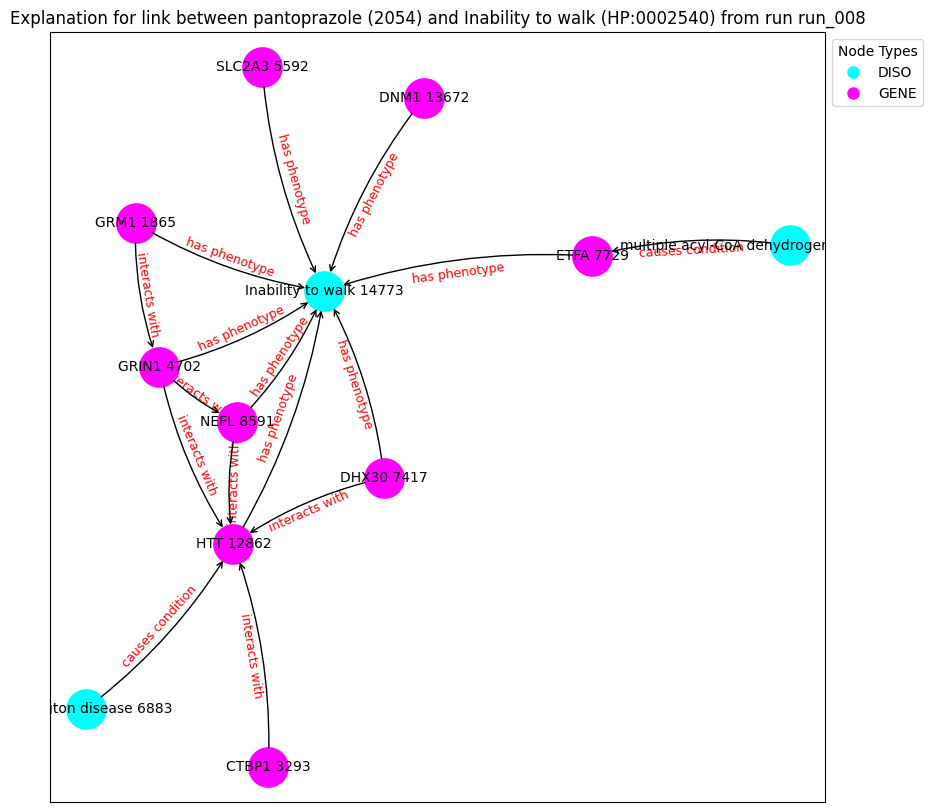

('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('GRM1 1865', {'type': 'GENE'})
('CTBP1 3293', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('DNM1 13672', {'type': 'GENE'})
('Inability to walk 14773', {'type': 'DISO'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'ETFA 7729', {'label': 'causes condition'})
('GRM1 1865', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('CTBP1 3293', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'NEFL 8591', {'label': 'interacts with'})
('GRIN1 4702', 'Inability to walk 14773', {'label': 'has phenotype'})
('SLC2A3 5592', 'Inability to walk 14773', {'label': 'has phenotype'})
('Huntington

Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 249.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 237.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.63it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                    label  \
917       917  HP:0002529     DISO  Neuronal loss in central nervous system   

     semantic_id  
917            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.9998], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9998], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 241.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9998], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 229.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9998], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 237.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9998], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 249.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9998], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9998], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 235.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9998], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9998], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 255.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9998], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.38it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.9993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:03<00:00, 214.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 242.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 243.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 245.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 244.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 240.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 248.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 245.19it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.9944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:03<00:00, 230.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:03<00:00, 227.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 236.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 241.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:03<00:00, 232.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 236.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 243.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 238.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 245.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9944], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:03<00:00, 224.81it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                         label  semantic_id
9801      9801  HP:0007010     DISO  Poor fine motor coordination            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.6002], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6002], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6002], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6002], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6002], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6002], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6002], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6002], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6002], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6002], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 294: 100%|██████████| 700/700 [00:03<00:00, 206.25it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                         label  semantic_id
9801      9801  HP:0007010     DISO  Poor fine motor coordination            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.5730], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 218.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5730], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5730], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5730], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5730], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5730], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 214.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5730], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 216.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5730], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5730], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 202.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5730], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 217.33it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic       label  semantic_id
14527     14527  HP:0030955     DISO  Alcoholism            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5911], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5911], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5911], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 212.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5911], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 206.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5911], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5911], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5911], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5911], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5911], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5911], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.91it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic             label  semantic_id
8158      8158  HP:0002059     DISO  Cerebral atrophy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6489], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.83it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6489], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.91it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6489], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.87it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6489], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.71it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6489], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.96it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6489], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.61it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6489], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 177.38it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6489], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.81it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6489], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 182.20it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6489], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.92it/s]


Contribution threshold is tensor(0.0062)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


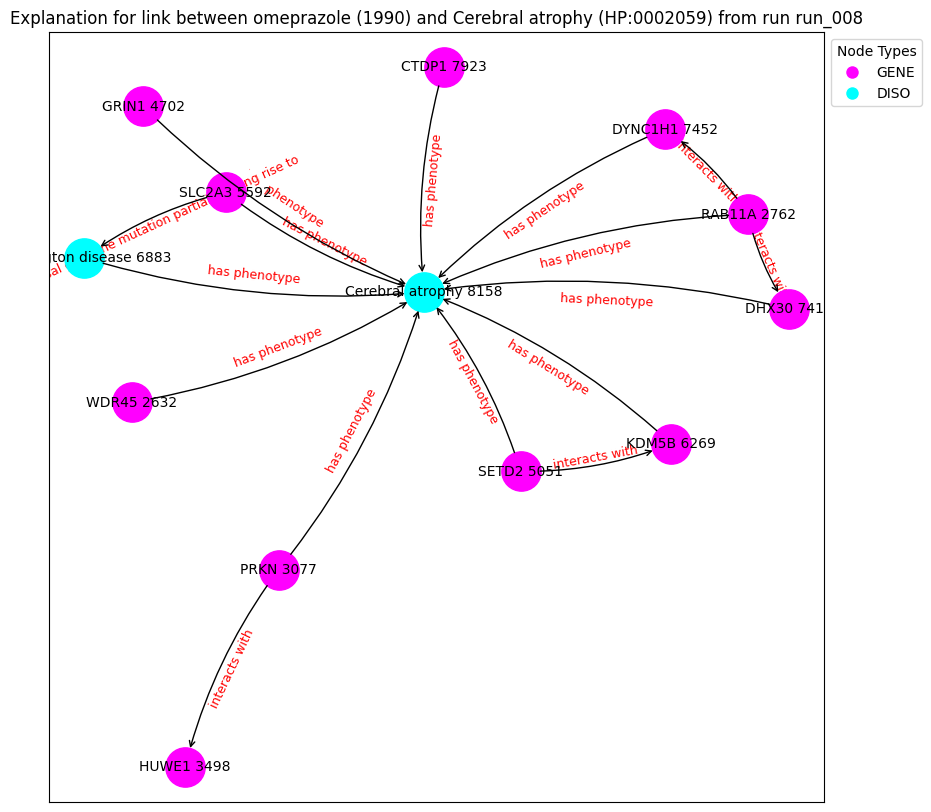

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('Cerebral atrophy 8158', {'type': 'DISO'})
('WDR45 2632', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('GRIN1 4702', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('SETD2 5051', 'KDM5B 6269', {'label': 'interacts with'})
('SETD2 5051', 'Cerebral atrophy 8158

Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.89it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6049], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 178.08it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6049], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.85it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6049], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.99it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6049], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 181.72it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6049], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.36it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6049], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.49it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6049], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.12it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6049], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.81it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6049], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.22it/s]


Contribution threshold is tensor(0.0062)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


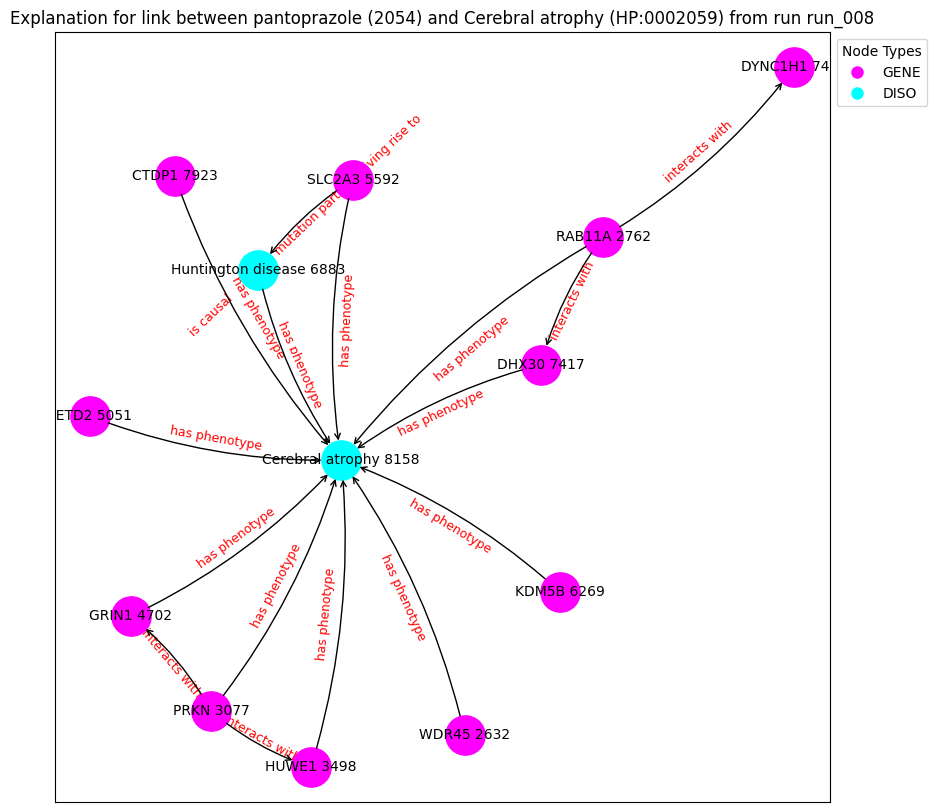

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('Cerebral atrophy 8158', {'type': 'DISO'})
('WDR45 2632', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('HUWE1 3498', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('GRIN1 4702', 'Cerebral atrophy 8158'

Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 229.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 214.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 231.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 210.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 242.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:03<00:00, 209.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9988], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4177 and 998: 100%|██████████| 700/700 [00:02<00:00, 244.88it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic          label  semantic_id
12039     12039  HP:0001347     DISO  Hyperreflexia            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6550], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 161.85it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6550], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 141.82it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6550], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 155.77it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6550], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 165.04it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6550], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 168.10it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6550], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 164.28it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6550], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 158.61it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6550], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 166.53it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6550], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 166.14it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6550], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 166.84it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


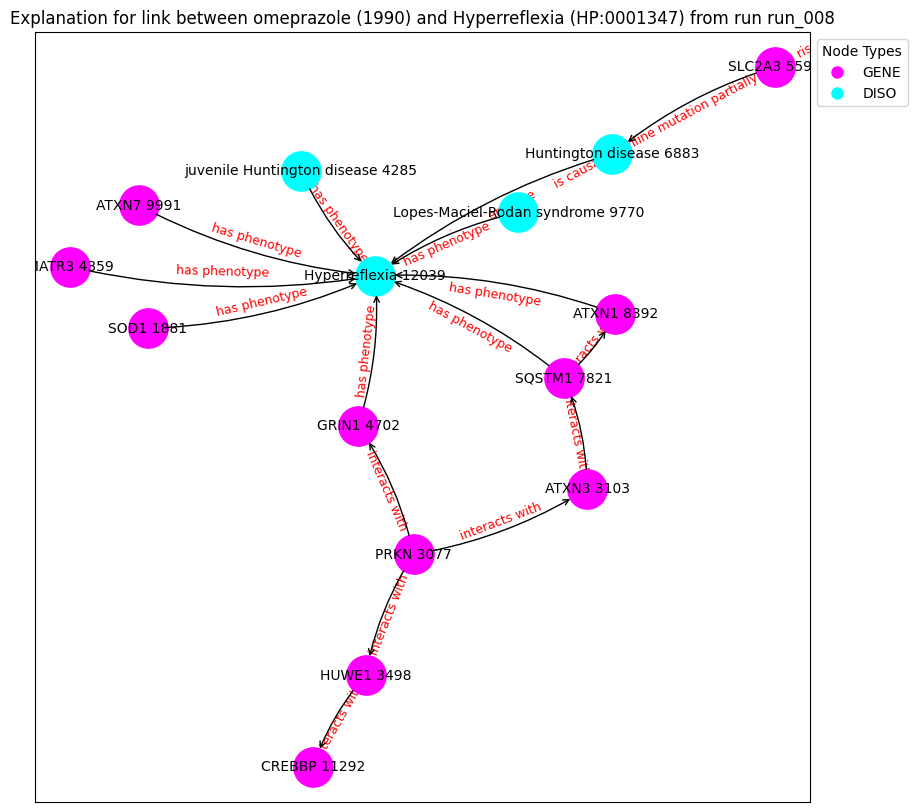

('SOD1 1881', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('MATR3 4359', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('Lopes-Maciel-Rodan syndrome 9770', {'type': 'DISO'})
('ATXN7 9991', {'type': 'GENE'})
('CREBBP 11292', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('SOD1 1881', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'SQSTM1 7821', {'label': 'interacts with'})
('HUWE1 3498', 'CREBBP 11292', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'Hyperreflexia 12039', {'label': 'has phenoty

Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 154.08it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6108], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 157.86it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6108], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 159.87it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6108], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 166.11it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6108], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 167.28it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6108], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 167.33it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6108], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 164.40it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6108], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 166.90it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6108], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 160.44it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6108], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 163.44it/s]


Contribution threshold is tensor(0.9936)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


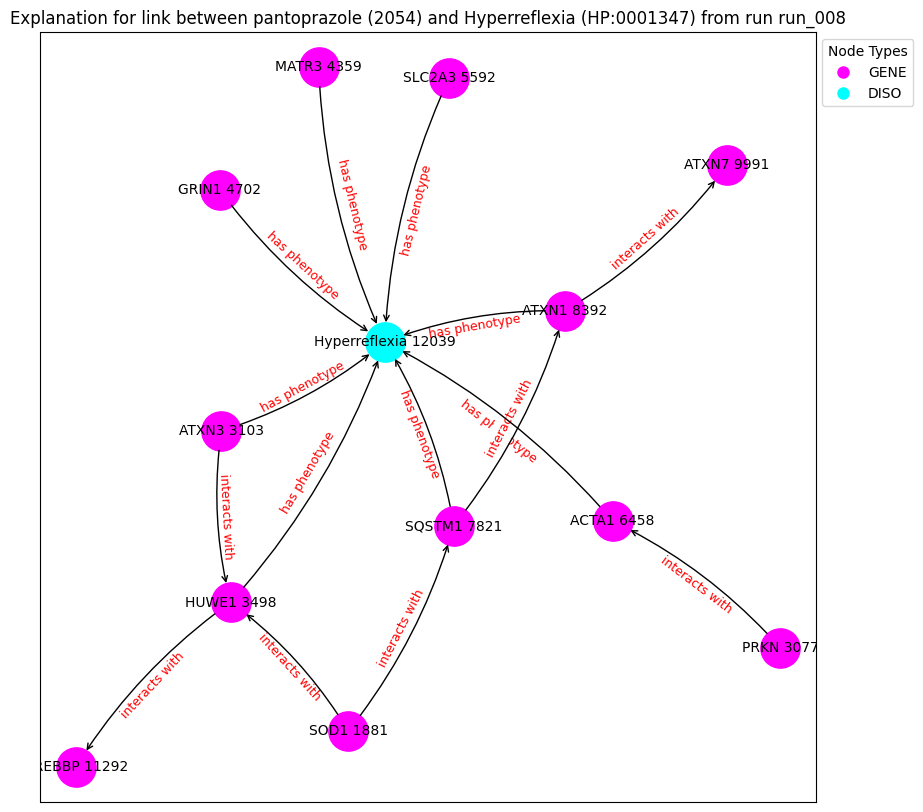

('SOD1 1881', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('MATR3 4359', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('CREBBP 11292', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('SOD1 1881', 'HUWE1 3498', {'label': 'interacts with'})
('SOD1 1881', 'SQSTM1 7821', {'label': 'interacts with'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('ATXN3 3103', 'HUWE1 3498', {'label': 'interacts with'})
('ATXN3 3103', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('HUWE1 3498', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('HUWE1 3498', 'CREBBP 11292', {'label': 'interacts with'})
('MATR3 4359', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('GRIN1 4702', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('SLC2

Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 163.17it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6751], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 161.46it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6751], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 172.34it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6751], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 162.05it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6751], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 163.84it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6751], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 165.39it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6751], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 160.82it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6751], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 164.35it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6751], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 162.97it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6751], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 161.92it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


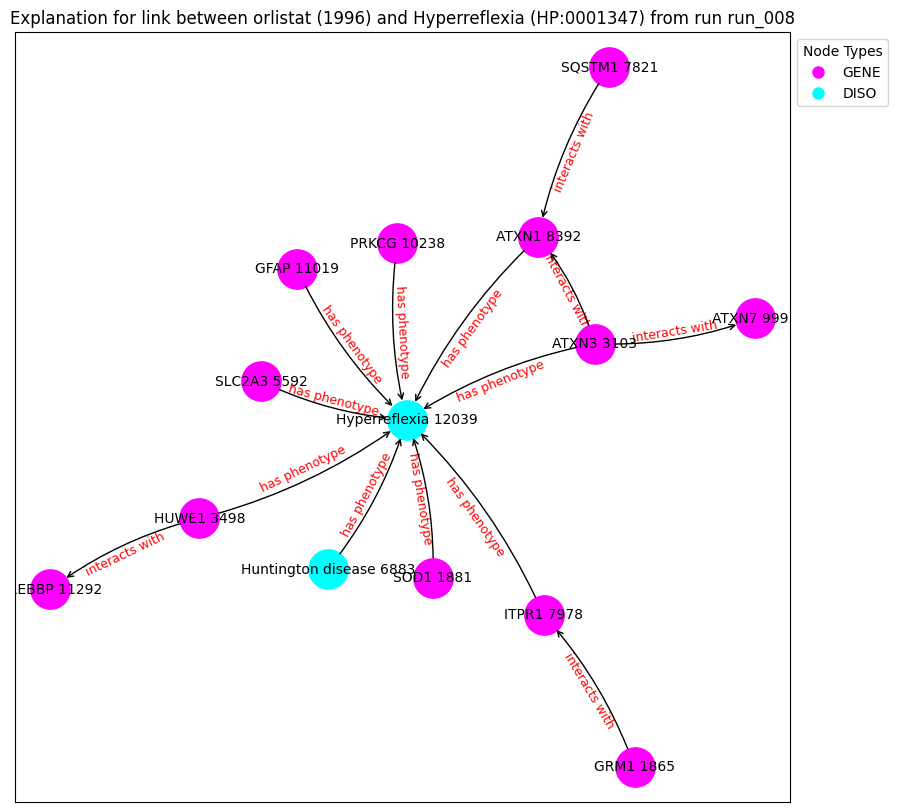

('GRM1 1865', {'type': 'GENE'})
('SOD1 1881', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('ITPR1 7978', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('CREBBP 11292', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('GRM1 1865', 'ITPR1 7978', {'label': 'interacts with'})
('SOD1 1881', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('ATXN3 3103', 'ATXN7 9991', {'label': 'interacts with'})
('ATXN3 3103', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('ATXN3 3103', 'ATXN1 8392', {'label': 'interacts with'})
('HUWE1 3498', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('HUWE1 3498', 'CREBBP 11292', {'label': 'interacts with'})
('SLC2A3 5592', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('Huntington dis

Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 210.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 207.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 211.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 221.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 202.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 208.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 220.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 206.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 218.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 205.29it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                              label  \
12080     12080  HP:0004408     DISO  Abnormality of the sense of smell   

       semantic_id  
12080            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.6130], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6130], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 212.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6130], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6130], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 206.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6130], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 212.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6130], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6130], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6130], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 212.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6130], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6130], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.39it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic     label  semantic_id
13477     13477  HP:0002063     DISO  Rigidity            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6488], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 182.86it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6488], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.32it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6488], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:04<00:00, 174.92it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6488], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.71it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6488], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 177.84it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6488], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.09it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6488], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.73it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6488], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.35it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6488], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 177.43it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6488], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.12it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


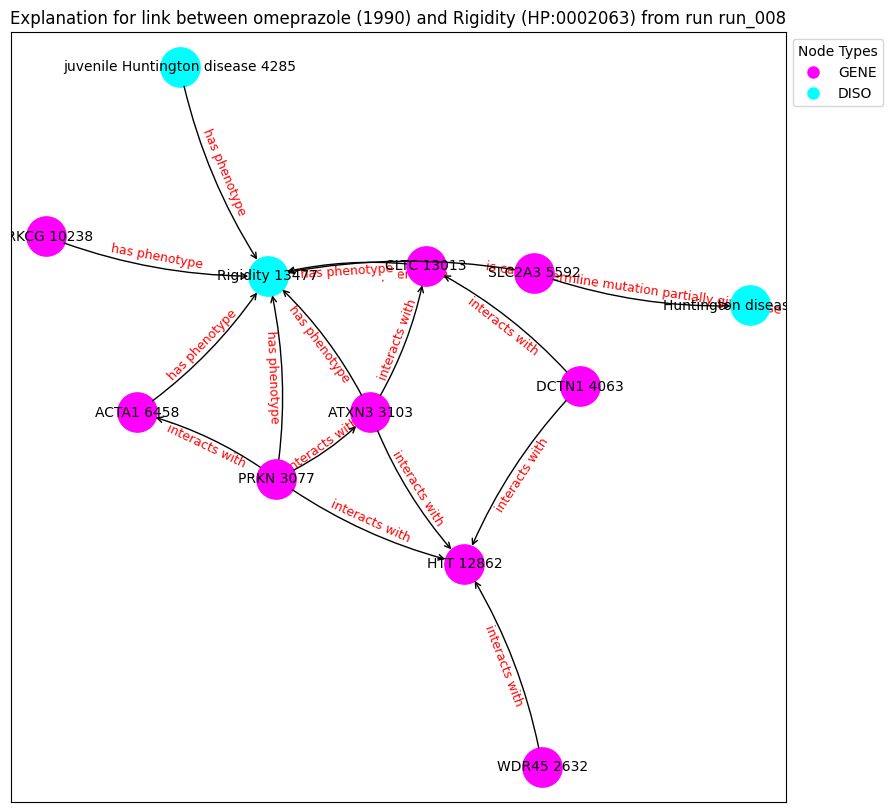

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('PRKCG 10238', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Rigidity 13477', {'type': 'DISO'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('PRKN 3077', 'HTT 12862', {'label': 'interacts with'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'Rigidity 13477', {'label': 'has phenotype'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'HTT 12862', {'label': 'interacts with'})
('ATXN3 3103', 'CLTC 13013', {'label': 'interacts with'})
('ATXN3 3103', 'Rigidity 13477', {'label': 'has phenotype'})
('DCTN1 4063', 'HTT 12862', {'label': 'interacts with'})
('DCTN1 4063', 'CLTC 13013', {'label': 'inter

Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 175.76it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6023], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:04<00:00, 171.22it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6023], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 175.25it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6023], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 180.73it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6023], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.52it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6023], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 178.31it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6023], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 180.47it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6023], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 179.40it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6023], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.62it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6023], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:04<00:00, 166.52it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


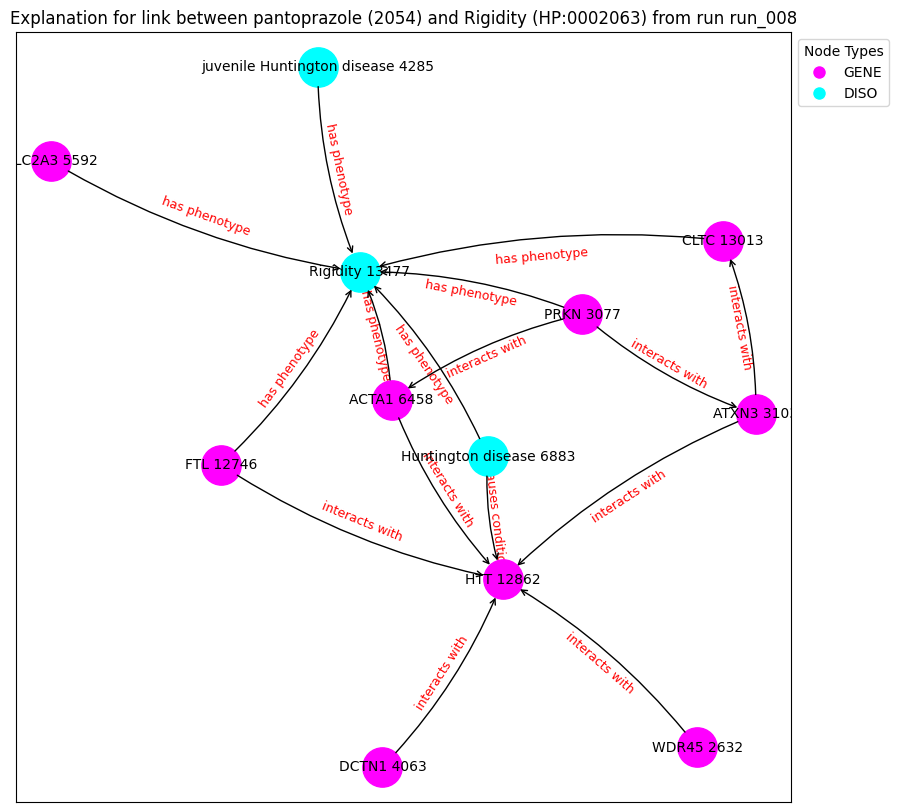

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Rigidity 13477', {'type': 'DISO'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'Rigidity 13477', {'label': 'has phenotype'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'HTT 12862', {'label': 'interacts with'})
('ATXN3 3103', 'CLTC 13013', {'label': 'interacts with'})
('DCTN1 4063', 'HTT 12862', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'Rigidity 13477', {'label': 'has phenotype'})
('SLC2A3 5592', 'Rigidity 13477', {'label': 'has phenotype'})
('ACTA1 6458', 'HTT

Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 229.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 233.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:03<00:00, 210.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9989], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 241.73it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                      label  \
434       434  HP:0002500     DISO  Abnormal cerebral white matter morphology   

     semantic_id  
434            1  
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.9900], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 234.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9900], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:03<00:00, 225.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9900], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:03<00:00, 231.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9900], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 234.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9900], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 234.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9900], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 249.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9900], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 238.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9900], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:03<00:00, 228.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9900], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:03<00:00, 215.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9900], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 245.36it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic          label  semantic_id
13239     13239  HP:0003487     DISO  Babinski sign            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6530], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 180.15it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6530], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 174.73it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6530], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 171.88it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6530], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 172.53it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6530], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 179.21it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6530], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.30it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6530], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 169.43it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6530], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 171.22it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6530], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 178.26it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6530], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 175.25it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


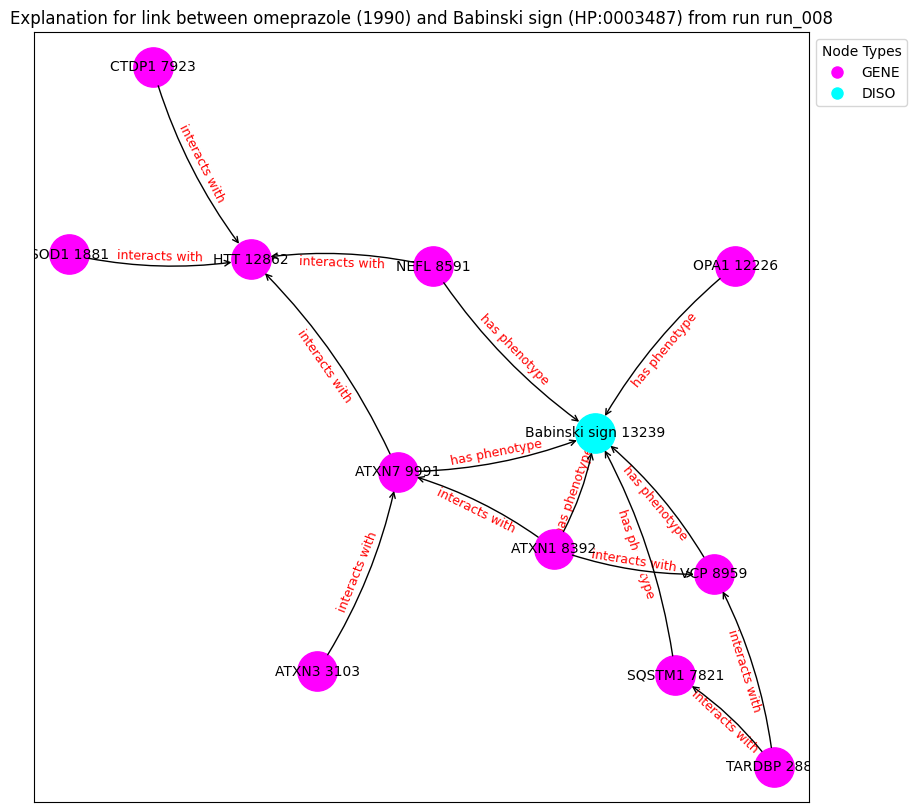

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('OPA1 12226', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Babinski sign 13239', {'type': 'DISO'})
('SOD1 1881', 'HTT 12862', {'label': 'interacts with'})
('TARDBP 2880', 'SQSTM1 7821', {'label': 'interacts with'})
('TARDBP 2880', 'VCP 8959', {'label': 'interacts with'})
('ATXN3 3103', 'ATXN7 9991', {'label': 'interacts with'})
('SQSTM1 7821', 'Babinski sign 13239', {'label': 'has phenotype'})
('CTDP1 7923', 'HTT 12862', {'label': 'interacts with'})
('ATXN1 8392', 'VCP 8959', {'label': 'interacts with'})
('ATXN1 8392', 'ATXN7 9991', {'label': 'interacts with'})
('ATXN1 8392', 'Babinski sign 13239', {'label': 'has phenotype'})
('NEFL 8591', 'HTT 12862', {'label': 'interacts with'})
('NEFL 

Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:04<00:00, 170.99it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:04<00:00, 166.92it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:04<00:00, 167.72it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.6115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:04<00:00, 173.40it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:04<00:00, 165.99it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:04<00:00, 174.65it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 178.69it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:04<00:00, 163.41it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 178.49it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 181.24it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


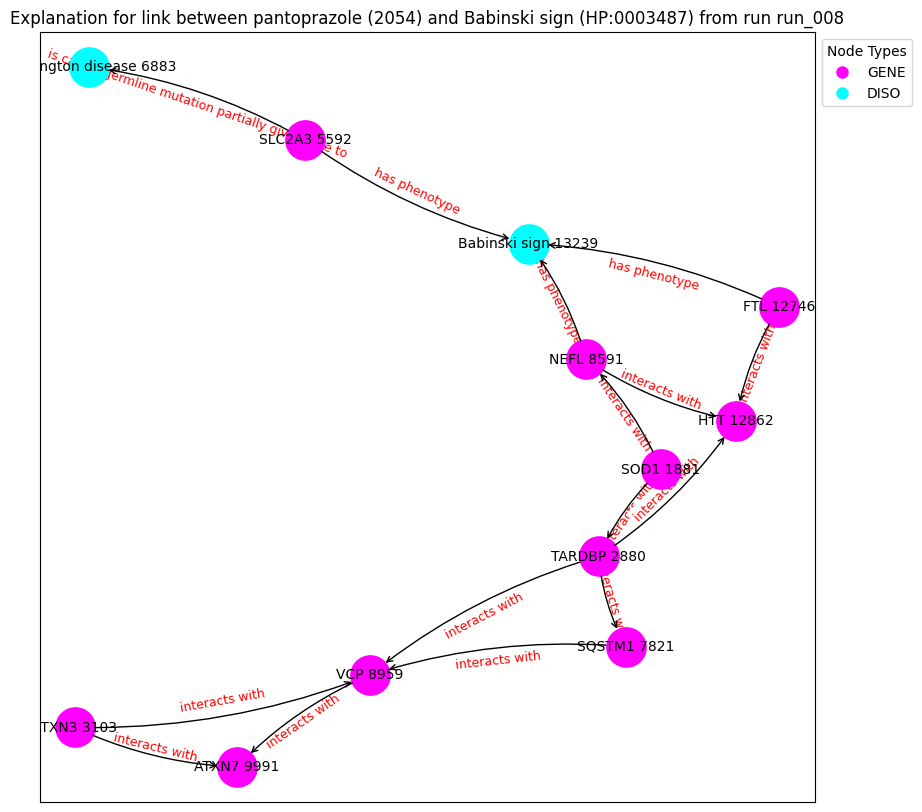

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Babinski sign 13239', {'type': 'DISO'})
('SOD1 1881', 'NEFL 8591', {'label': 'interacts with'})
('SOD1 1881', 'TARDBP 2880', {'label': 'interacts with'})
('TARDBP 2880', 'SQSTM1 7821', {'label': 'interacts with'})
('TARDBP 2880', 'HTT 12862', {'label': 'interacts with'})
('TARDBP 2880', 'VCP 8959', {'label': 'interacts with'})
('ATXN3 3103', 'VCP 8959', {'label': 'interacts with'})
('ATXN3 3103', 'ATXN7 9991', {'label': 'interacts with'})
('SLC2A3 5592', 'Babinski sign 13239', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('SQS

Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 195.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5900], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 200.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5900], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5900], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5900], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5900], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 207.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5900], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5900], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5900], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5900], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.03it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic            label  semantic_id
830       830  HP:0002340     DISO  Caudate atrophy            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.9986], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9986], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9986], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9986], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9986], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 244.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9986], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9986], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 245.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9986], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9986], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9986], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 294: 100%|██████████| 700/700 [00:02<00:00, 233.91it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic             label  semantic_id
13592     13592  HP:0001288     DISO  Gait disturbance            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.6670], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 124.79it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6670], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 119.36it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6670], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 127.93it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6670], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 123.28it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6670], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 128.22it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6670], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 124.67it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6670], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 127.27it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6670], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 121.14it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6670], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:06<00:00, 116.51it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6670], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 125.65it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


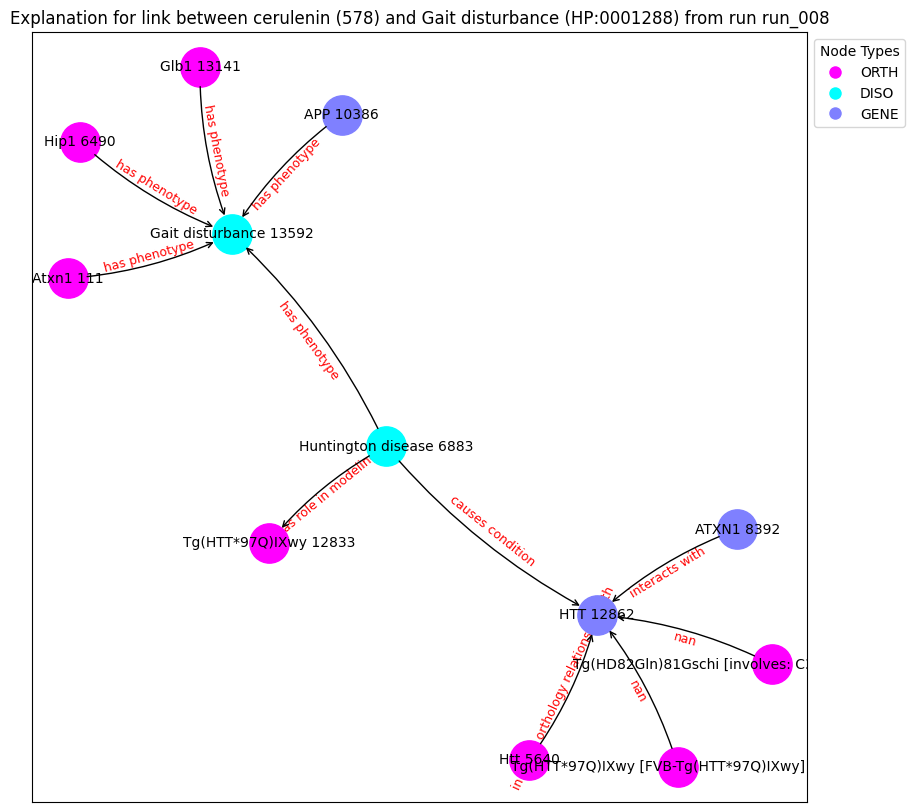

('Atxn1 111', {'type': 'ORTH'})
('Tg(HTT*97Q)IXwy [FVB-Tg(HTT*97Q)IXwy] 1947', {'type': 'ORTH'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', {'type': 'ORTH'})
('Htt 5640', {'type': 'ORTH'})
('Hip1 6490', {'type': 'ORTH'})
('Huntington disease 6883', {'type': 'DISO'})
('ATXN1 8392', {'type': 'GENE'})
('APP 10386', {'type': 'GENE'})
('Tg(HTT*97Q)IXwy 12833', {'type': 'ORTH'})
('HTT 12862', {'type': 'GENE'})
('Glb1 13141', {'type': 'ORTH'})
('Gait disturbance 13592', {'type': 'DISO'})
('Atxn1 111', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Tg(HTT*97Q)IXwy [FVB-Tg(HTT*97Q)IXwy] 1947', 'HTT 12862', {'label': nan})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'HTT 12862', {'label': nan})
('Htt 5640', 'HTT 12862', {'label': 'in 1 to 1 orthology relationship with'})
('Hip1 6490', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Huntington disease 6883', 'HTT 12862', {'label': 'causes condition'})
('Huntington disease 6883', 'Gait disturbance 1359

Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 125.34it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5649], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 126.84it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5649], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 128.22it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5649], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 126.05it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5649], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 124.62it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5649], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 124.80it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5649], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 124.85it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5649], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 127.49it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5649], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 128.60it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5649], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 123.24it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


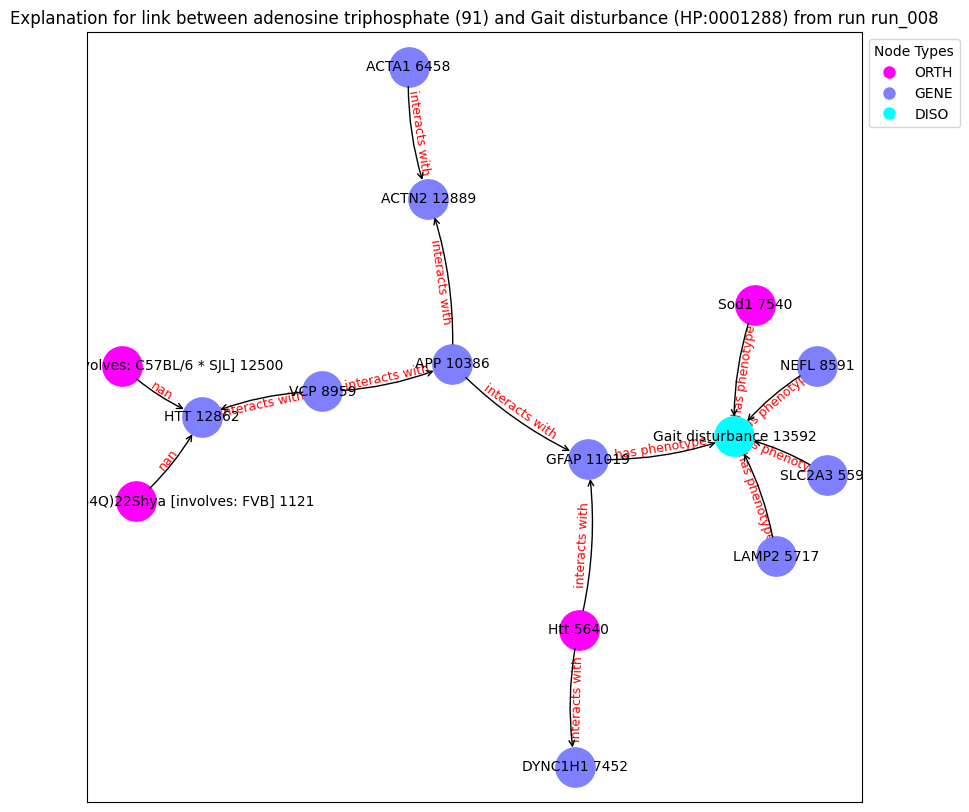

('Tg(UBC-GFP/HTT*84Q)22Shya [involves: FVB] 1121', {'type': 'ORTH'})
('SLC2A3 5592', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('LAMP2 5717', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('Sod1 7540', {'type': 'ORTH'})
('NEFL 8591', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('APP 10386', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('Tg(HD)63Aron [involves: C57BL/6 * SJL] 12500', {'type': 'ORTH'})
('HTT 12862', {'type': 'GENE'})
('ACTN2 12889', {'type': 'GENE'})
('Gait disturbance 13592', {'type': 'DISO'})
('Tg(UBC-GFP/HTT*84Q)22Shya [involves: FVB] 1121', 'HTT 12862', {'label': nan})
('SLC2A3 5592', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Htt 5640', 'GFAP 11019', {'label': 'interacts with'})
('Htt 5640', 'DYNC1H1 7452', {'label': 'interacts with'})
('LAMP2 5717', 'Gait disturbance 13592', {'label': 'has phenotype'})
('ACTA1 6458', 'ACTN2 12889', {'label': 'interacts with'})
('Sod1 7540', 'Gait disturbance 135

Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 208.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6974], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 223.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6974], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6974], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 230.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6974], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6974], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 228.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6974], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6974], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6974], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 229.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6974], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.41it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                        label  semantic_id
4071      4071  HP:0003324     DISO  Generalized muscle weakness            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.6526], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6526], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 226.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6526], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 222.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6526], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 222.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6526], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 217.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6526], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 219.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6526], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 226.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6526], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 230.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6526], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 220.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6526], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 226.62it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic  \
5436      5436  HP:0003107     DISO   

                                               label  semantic_id  
5436  Abnormal circulating cholesterol concentration            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.9987], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 254.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9987], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9987], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9987], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 235.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9987], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9987], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 236.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9987], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9987], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 241.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9987], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 237.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9987], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.53it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
1951      1951  HP:0002354     DISO  Memory impairment            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.9993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 238.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 235.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:03<00:00, 233.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 242.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 238.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 239.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 240.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 244.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.32it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
1951      1951  HP:0002354     DISO  Memory impairment            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.9946], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:03<00:00, 229.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9946], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 237.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9946], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 233.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9946], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 240.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9946], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 238.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9946], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 244.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9946], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 240.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9946], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 241.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9946], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 238.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9946], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:03<00:00, 224.00it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\run_009
(0, {'node_feature': tensor([ 0.1220,  0.0859, -0.1146, -0.5246,  0.0214,  1.9217, -0.5526, -0.0417,
        -0.0939,  0.0218,  0.1067, -0.0897,  0.3427, -1.1009,  0.1138,  0.4862,
        -0.1164,  0.0924, -0.1402, -1.0740,  0.7460,  0.2966, -0.8117, -0.1334,
        -0.6005, -0.3454, -0.3671, -0.7407,  0.4531,  0.2430, -0.0435,  1.4316])})
(0, 11953, {'edge_label': 'in orthology relationship with'})
Number of edges is 134749
Number of nodes is 14833
node1:
       index_id          id semantic       label  semantic_id
13668     13668  HP:0000716     DISO  Depression            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.5069], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 152.50it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5069], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 160.36it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5069], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 162.68it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5069], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 160.32it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5069], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 161.18it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5069], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 161.97it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5069], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 161.69it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5069], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 158.68it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5069], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 159.46it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5069], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:04<00:00, 157.78it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


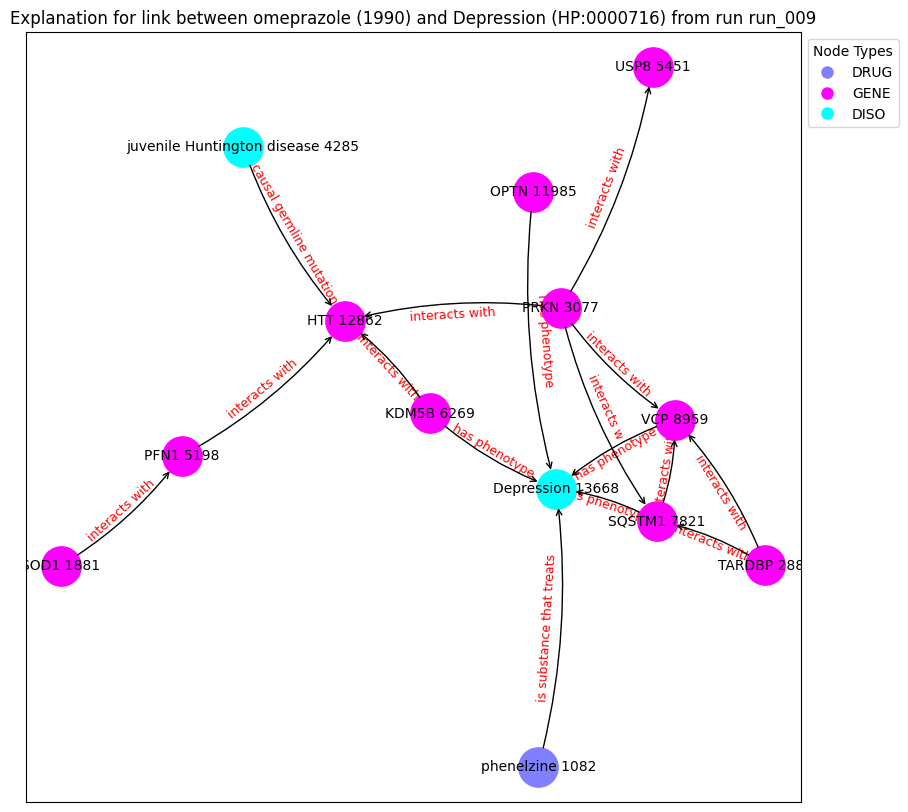

('phenelzine 1082', {'type': 'DRUG'})
('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('PFN1 5198', {'type': 'GENE'})
('USP8 5451', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('phenelzine 1082', 'Depression 13668', {'label': 'is substance that treats'})
('SOD1 1881', 'PFN1 5198', {'label': 'interacts with'})
('TARDBP 2880', 'SQSTM1 7821', {'label': 'interacts with'})
('TARDBP 2880', 'VCP 8959', {'label': 'interacts with'})
('PRKN 3077', 'HTT 12862', {'label': 'interacts with'})
('PRKN 3077', 'VCP 8959', {'label': 'interacts with'})
('PRKN 3077', 'USP8 5451', {'label': 'interacts with'})
('PRKN 3077', 'SQSTM1 7821', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is ca

Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 154.33it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6743], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 151.36it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6743], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 159.68it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6743], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 160.36it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6743], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 160.41it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6743], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 161.42it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6743], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 158.97it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6743], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 151.63it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6743], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 161.19it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6743], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1000: 100%|██████████| 700/700 [00:04<00:00, 159.95it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


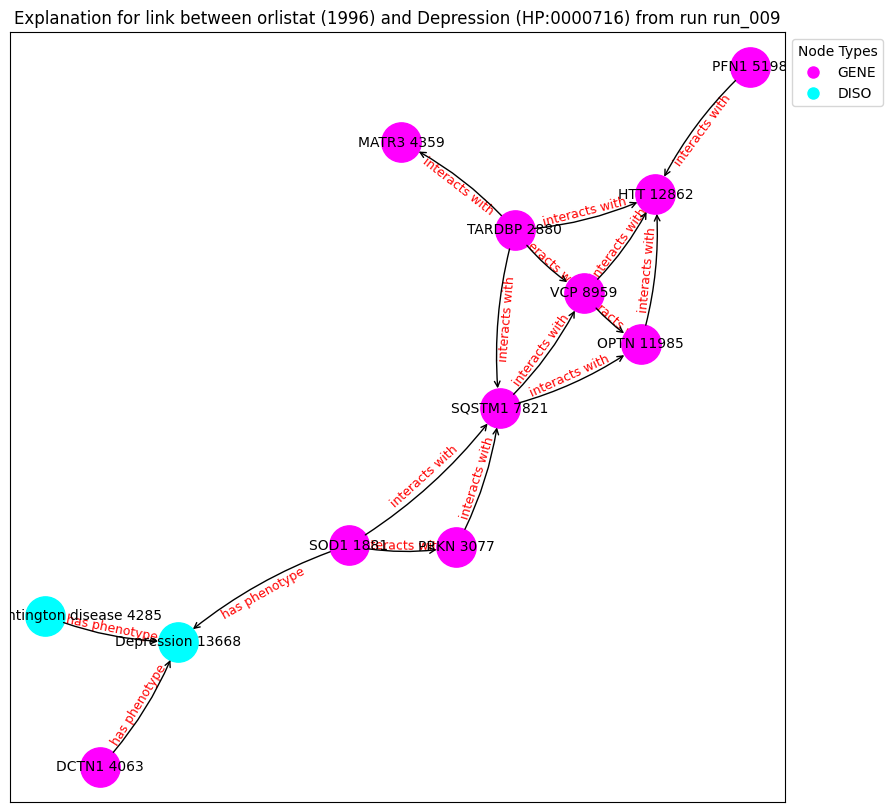

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('MATR3 4359', {'type': 'GENE'})
('PFN1 5198', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('SOD1 1881', 'PRKN 3077', {'label': 'interacts with'})
('SOD1 1881', 'SQSTM1 7821', {'label': 'interacts with'})
('SOD1 1881', 'Depression 13668', {'label': 'has phenotype'})
('TARDBP 2880', 'SQSTM1 7821', {'label': 'interacts with'})
('TARDBP 2880', 'HTT 12862', {'label': 'interacts with'})
('TARDBP 2880', 'MATR3 4359', {'label': 'interacts with'})
('TARDBP 2880', 'VCP 8959', {'label': 'interacts with'})
('PRKN 3077', 'SQSTM1 7821', {'label': 'interacts with'})
('DCTN1 4063', 'Depression 13668', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'Depression 

Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 220.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4521], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 218.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4521], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 221.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4521], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:02<00:00, 236.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4521], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 197.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4521], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 228.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4521], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4521], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 229.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4521], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 229.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4521], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 221.34it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic    label  semantic_id
1789      1789  HP:0000739     DISO  Anxiety            1
node2:
      index_id    id semantic     label  semantic_id
1000      1000  1996     DRUG  orlistat            2
Prediction from trained model: tensor([0.9995], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 234.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9995], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 225.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9995], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 252.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9995], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 237.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9995], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 236.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9995], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 239.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9995], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 235.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9995], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 238.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9995], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 241.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9995], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 245.55it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic    label  semantic_id
1789      1789  HP:0000739     DISO  Anxiety            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.9992], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 239.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9992], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9992], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 246.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9992], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9992], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:02<00:00, 235.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9992], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9992], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 210.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9992], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 232.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9992], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9992], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 998: 100%|██████████| 700/700 [00:03<00:00, 232.89it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.4830], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 215.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4830], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4830], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 207.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4830], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4830], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4830], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 216.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4830], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 217.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4830], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4830], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 211.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4830], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.85it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.4092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 221.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 213.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 210.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 221.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:04<00:00, 150.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 178.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:04<00:00, 167.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 177.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 227.97it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.5185], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 196.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5185], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 193.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5185], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 186.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5185], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 194.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5185], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 196.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5185], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 193.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5185], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 197.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5185], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 194.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5185], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 190.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5185], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 194.92it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.5240], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 204.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5240], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5240], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5240], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5240], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5240], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5240], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5240], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5240], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5240], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.98it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
6473      6473  HP:0001272     DISO  Cerebellar atrophy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.5086], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5086], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5086], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5086], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5086], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5086], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5086], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5086], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5086], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5086], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.31it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
6473      6473  HP:0001272     DISO  Cerebellar atrophy            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.4404], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4404], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4404], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4404], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4404], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4404], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4404], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4404], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 184.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4404], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4404], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:04<00:00, 174.82it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
4670      4670  HP:0031589     DISO  Suicidal ideation            1
node2:
      index_id    id semantic             label  semantic_id
2023      2023  4226     DRUG  ingenol mebutate            2
Prediction from trained model: tensor([0.4279], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 220.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4279], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 225.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4279], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 220.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4279], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:02<00:00, 242.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4279], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 221.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4279], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 232.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4279], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 212.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4279], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 218.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4279], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 228.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4279], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 219.58it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                        label  semantic_id
8786      8786  HP:0000496     DISO  Abnormality of eye movement            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.5477], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 228.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5477], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 206.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5477], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5477], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 207.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5477], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 204.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5477], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 205.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5477], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 202.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5477], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5477], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5477], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 213.24it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic         label  semantic_id
7072      7072  HP:0002067     DISO  Bradykinesia            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.6129], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 183.88it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6129], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 183.10it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6129], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 184.71it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6129], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 185.38it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6129], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 183.99it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6129], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 180.56it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6129], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 180.87it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6129], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 184.20it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6129], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 192.53it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6129], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 185.35it/s]


Contribution threshold is tensor(0.0062)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


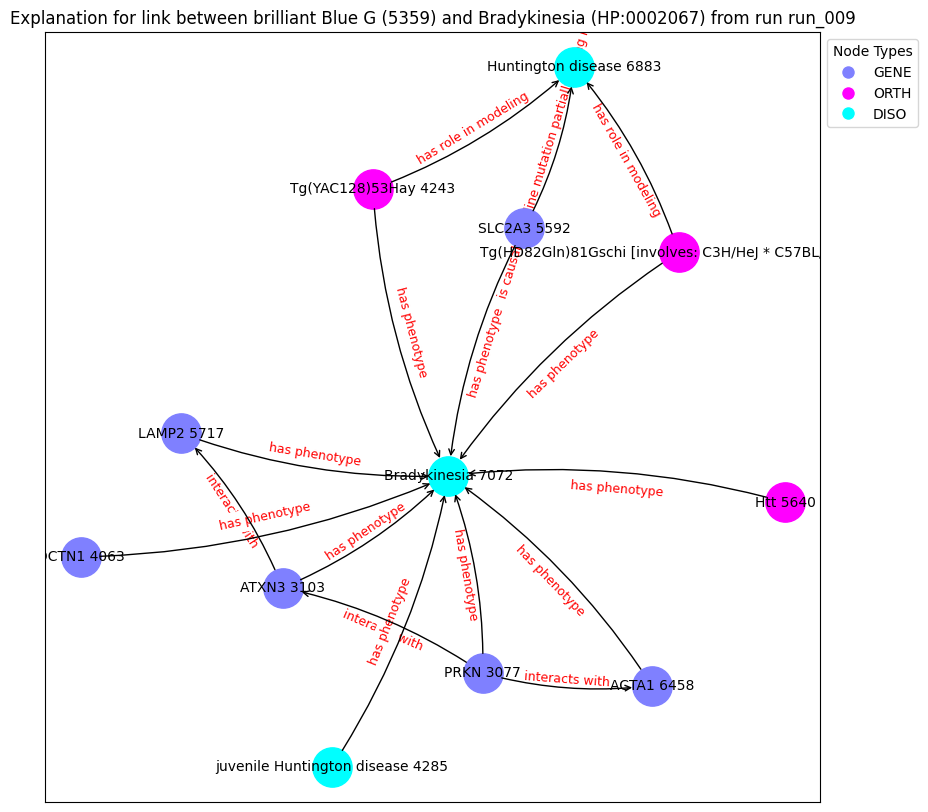

('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', {'type': 'ORTH'})
('DCTN1 4063', {'type': 'GENE'})
('Tg(YAC128)53Hay 4243', {'type': 'ORTH'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('LAMP2 5717', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('Bradykinesia 7072', {'type': 'DISO'})
('PRKN 3077', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'Bradykinesia 7072', {'label': 'has phenotype'})
('ATXN3 3103', 'LAMP2 5717', {'label': 'interacts with'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Huntington disease 6883', {'label': 'has role in modeling'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Bradykinesia 7072', {'label': 'ha

Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 181.97it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.3966], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 175.67it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.3966], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 183.91it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.3966], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 183.40it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.3966], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:04<00:00, 167.32it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.3966], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 182.29it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.3966], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 184.24it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.3966], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 184.32it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.3966], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 180.27it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.3966], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 185.13it/s]


Contribution threshold is tensor(0.0062)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


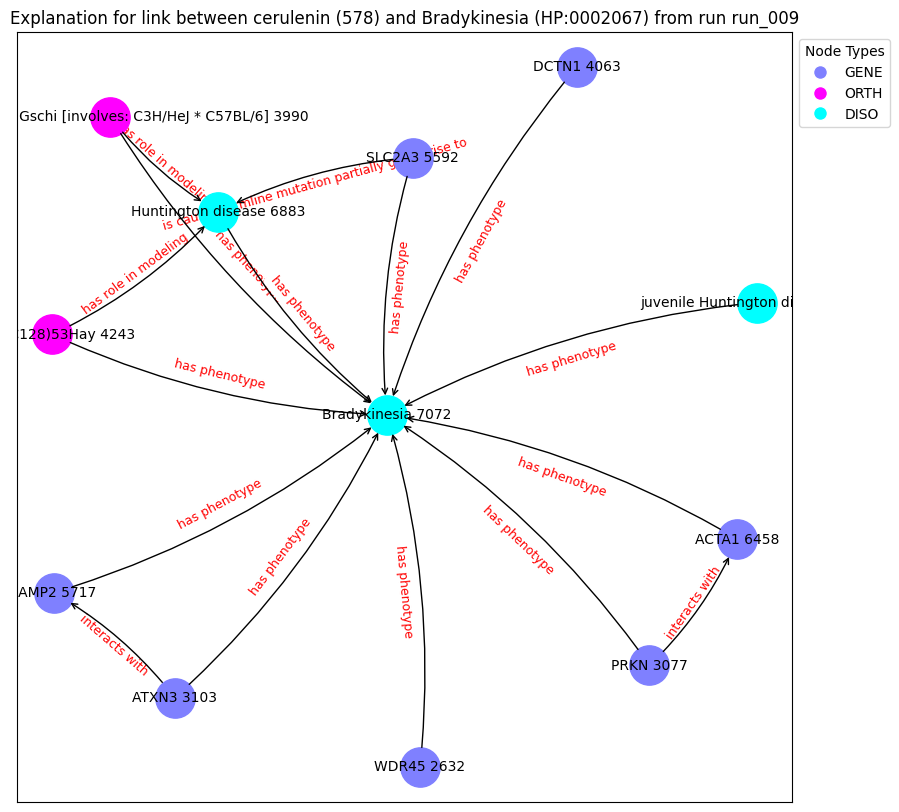

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', {'type': 'ORTH'})
('DCTN1 4063', {'type': 'GENE'})
('Tg(YAC128)53Hay 4243', {'type': 'ORTH'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('LAMP2 5717', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('Bradykinesia 7072', {'type': 'DISO'})
('WDR45 2632', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('ATXN3 3103', 'Bradykinesia 7072', {'label': 'has phenotype'})
('ATXN3 3103', 'LAMP2 5717', {'label': 'interacts with'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Huntington disease 6883', {'label': 'has role in modeling'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Bradykinesia 7072', {'la

Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 242.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 238.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 241.90it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic           label  semantic_id
1065      1065  HP:0002141     DISO  Gait imbalance            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.9979], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:03<00:00, 232.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9979], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:03<00:00, 226.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9979], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 233.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9979], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:03<00:00, 230.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9979], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 245.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9979], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:03<00:00, 219.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9979], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 237.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9979], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 238.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9979], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 240.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9979], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 249.34it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
5935      5935  HP:0000713     DISO  Agitation            1
node2:
      index_id    id semantic     label  semantic_id
1000      1000  1996     DRUG  orlistat            2
Prediction from trained model: tensor([0.6712], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 202.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6712], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 206.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6712], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 190.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6712], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 198.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6712], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 178.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6712], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 197.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6712], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 200.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6712], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 193.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6712], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 191.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6712], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:04<00:00, 173.40it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
5935      5935  HP:0000713     DISO  Agitation            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.5027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 198.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 198.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 208.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5027], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 197.79it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic    label  semantic_id
3363      3363  HP:0002171     DISO  Gliosis            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.4264], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 199.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4264], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 198.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4264], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 207.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4264], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 204.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4264], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 198.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4264], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4264], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 193.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4264], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 196.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4264], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 201.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4264], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 191.73it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic   label  semantic_id
14731     14731  HP:0002072     DISO  Chorea            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.4982], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.77it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4982], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.61it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.4982], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 170.91it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4982], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:03<00:00, 175.02it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4982], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 174.43it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.4982], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 174.42it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4982], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 171.36it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.4982], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 173.32it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4982], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 173.62it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.4982], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:04<00:00, 174.43it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


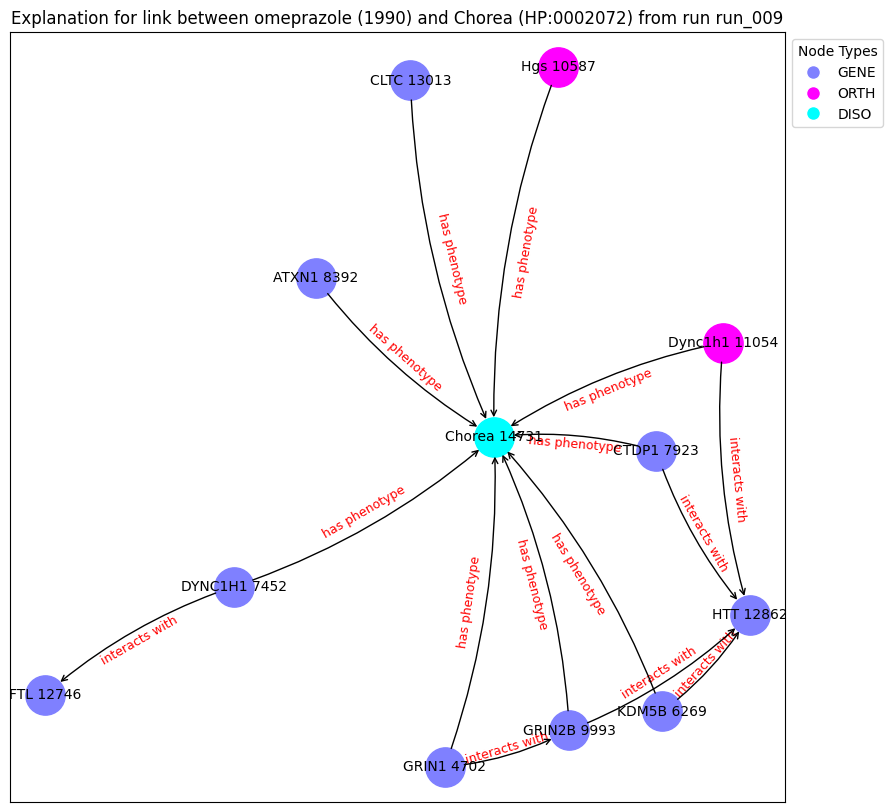

('GRIN1 4702', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('Hgs 10587', {'type': 'ORTH'})
('Dync1h1 11054', {'type': 'ORTH'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Chorea 14731', {'type': 'DISO'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'Chorea 14731', {'label': 'has phenotype'})
('KDM5B 6269', 'HTT 12862', {'label': 'interacts with'})
('KDM5B 6269', 'Chorea 14731', {'label': 'has phenotype'})
('DYNC1H1 7452', 'FTL 12746', {'label': 'interacts with'})
('DYNC1H1 7452', 'Chorea 14731', {'label': 'has phenotype'})
('CTDP1 7923', 'HTT 12862', {'label': 'interacts with'})
('CTDP1 7923', 'Chorea 14731', {'label': 'has phenotype'})
('ATXN1 8392', 'Chorea 14731', {'label': 'has phenotype'})
('GRIN2B 9993', 'HTT 12862', {'label': 'interacts with'})
('GRIN2B 999

Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:03<00:00, 230.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 236.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 243.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:03<00:00, 209.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 238.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 246.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 238.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 236.59it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic        label  semantic_id
13123     13123  HP:0001824     DISO  Weight loss            1
node2:
    index_id  id semantic                   label  semantic_id
53        53  91     DRUG  adenosine triphosphate            2
Prediction from trained model: tensor([0.4156], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 138.43it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4156], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 132.24it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4156], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 137.39it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4156], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 127.77it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4156], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 139.41it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4156], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 137.13it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4156], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 137.15it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4156], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 136.32it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4156], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 136.41it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4156], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:05<00:00, 136.57it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


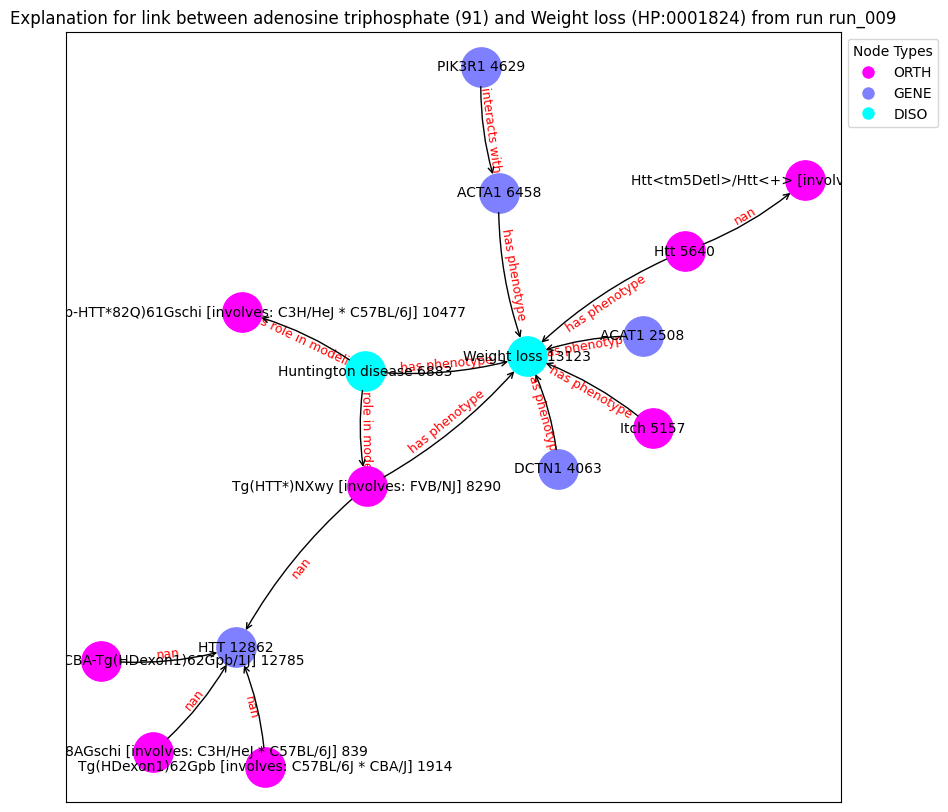

('Tg(Prnp-HTT*82Q)8AGschi [involves: C3H/HeJ * C57BL/6J] 839', {'type': 'ORTH'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', {'type': 'ORTH'})
('ACAT1 2508', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('PIK3R1 4629', {'type': 'GENE'})
('Itch 5157', {'type': 'ORTH'})
('Htt 5640', {'type': 'ORTH'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('Tg(HTT*)NXwy [involves: FVB/NJ] 8290', {'type': 'ORTH'})
('Tg(Prnp-HTT*82Q)61Gschi [involves: C3H/HeJ * C57BL/6J] 10477', {'type': 'ORTH'})
('Htt<tm5Detl>/Htt<+> [involves: C57BL/6] 12001', {'type': 'ORTH'})
('Tg(HDexon1)62Gpb [B6CBA-Tg(HDexon1)62Gpb/1J] 12785', {'type': 'ORTH'})
('HTT 12862', {'type': 'GENE'})
('Weight loss 13123', {'type': 'DISO'})
('Tg(Prnp-HTT*82Q)8AGschi [involves: C3H/HeJ * C57BL/6J] 839', 'HTT 12862', {'label': nan})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', 'HTT 12862', {'label': nan})
('ACAT1 2508', 'Weight loss 13123', {'label': 'has phenotype'})
('DCTN1 4

Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 127.22it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5819], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 126.18it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5819], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 134.22it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5819], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 136.95it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5819], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 139.29it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5819], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 139.00it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5819], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 139.05it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5819], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 131.40it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5819], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 138.95it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5819], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 219: 100%|██████████| 700/700 [00:05<00:00, 137.85it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


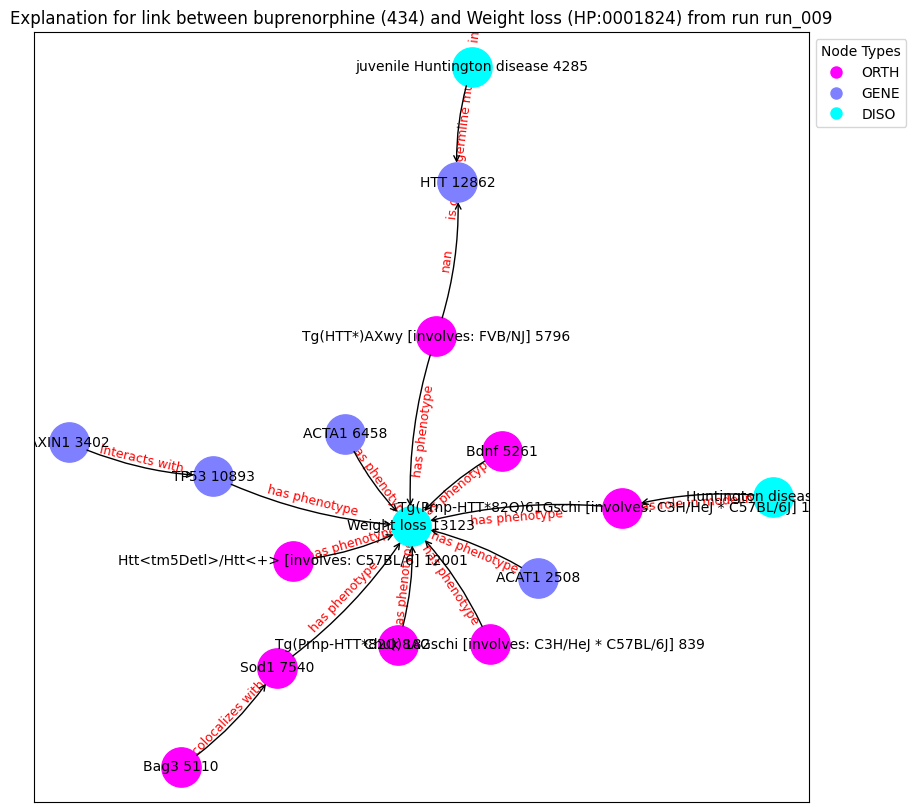

('Chuk 182', {'type': 'ORTH'})
('Tg(Prnp-HTT*82Q)8AGschi [involves: C3H/HeJ * C57BL/6J] 839', {'type': 'ORTH'})
('ACAT1 2508', {'type': 'GENE'})
('AXIN1 3402', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('Bag3 5110', {'type': 'ORTH'})
('Bdnf 5261', {'type': 'ORTH'})
('Tg(HTT*)AXwy [involves: FVB/NJ] 5796', {'type': 'ORTH'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('Sod1 7540', {'type': 'ORTH'})
('Tg(Prnp-HTT*82Q)61Gschi [involves: C3H/HeJ * C57BL/6J] 10477', {'type': 'ORTH'})
('TP53 10893', {'type': 'GENE'})
('Htt<tm5Detl>/Htt<+> [involves: C57BL/6] 12001', {'type': 'ORTH'})
('HTT 12862', {'type': 'GENE'})
('Weight loss 13123', {'type': 'DISO'})
('Chuk 182', 'Weight loss 13123', {'label': 'has phenotype'})
('Tg(Prnp-HTT*82Q)8AGschi [involves: C3H/HeJ * C57BL/6J] 839', 'Weight loss 13123', {'label': 'has phenotype'})
('ACAT1 2508', 'Weight loss 13123', {'label': 'has phenotype'})
('AXIN1 3402', 'TP53 10893', {'label': 

Explain edge between nodes 13978 and 581: 100%|██████████| 700/700 [00:03<00:00, 186.87it/s]


Contribution threshold is tensor(0.0062)
Explanation found!


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


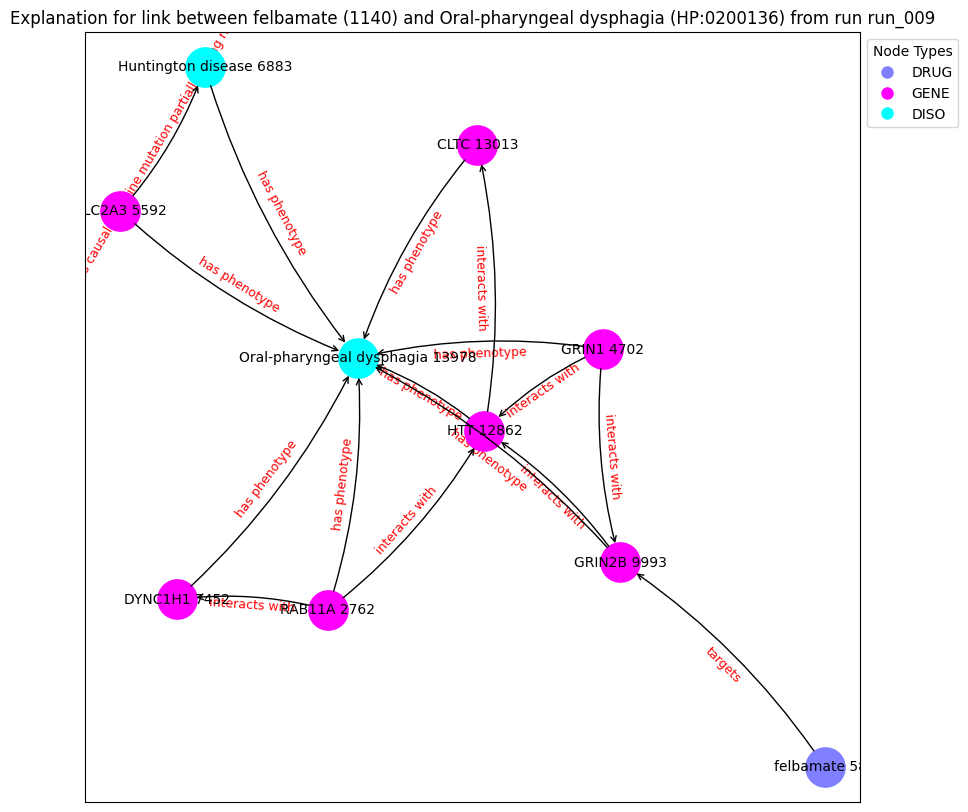

('felbamate 581', {'type': 'DRUG'})
('RAB11A 2762', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Oral-pharyngeal dysphagia 13978', {'type': 'DISO'})
('felbamate 581', 'GRIN2B 9993', {'label': 'targets'})
('RAB11A 2762', 'HTT 12862', {'label': 'interacts with'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('SLC2A3 5592', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenot

Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 129.71it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6672], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 135.56it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6672], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 141.74it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6672], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 137.97it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6672], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 137.03it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6672], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 139.31it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6672], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 141.61it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6672], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 138.50it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6672], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 140.79it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6672], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:05<00:00, 139.78it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


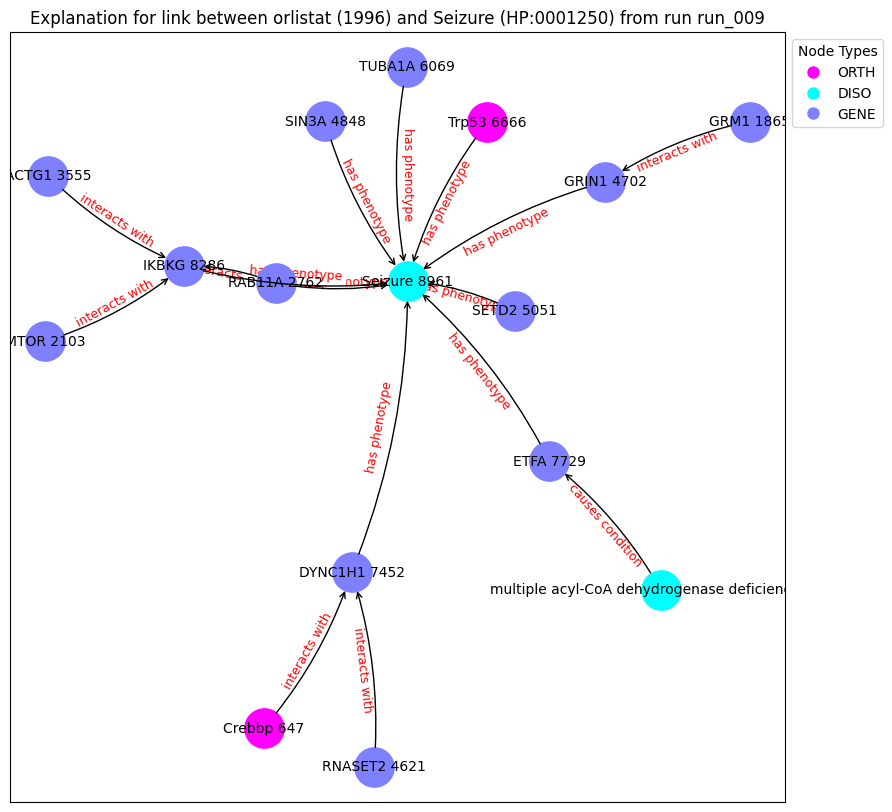

('Crebbp 647', {'type': 'ORTH'})
('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('GRM1 1865', {'type': 'GENE'})
('MTOR 2103', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('ACTG1 3555', {'type': 'GENE'})
('RNASET2 4621', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SIN3A 4848', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('TUBA1A 6069', {'type': 'GENE'})
('Trp53 6666', {'type': 'ORTH'})
('DYNC1H1 7452', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('IKBKG 8286', {'type': 'GENE'})
('Seizure 8961', {'type': 'DISO'})
('Crebbp 647', 'DYNC1H1 7452', {'label': 'interacts with'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'ETFA 7729', {'label': 'causes condition'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('MTOR 2103', 'IKBKG 8286', {'label': 'interacts with'})
('RAB11A 2762', 'IKBKG 8286', {'label': 'interacts with'})
('RAB11A 2762', 'Seizure 8961', {'label': 'has phenotype'})
('ACTG1 3555', 'IKBKG 8286', {'label': 'int

Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 137.31it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 137.70it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 136.79it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 142.31it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 140.93it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 139.01it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 138.39it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 141.00it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.5053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 126.93it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.5053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:05<00:00, 136.91it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


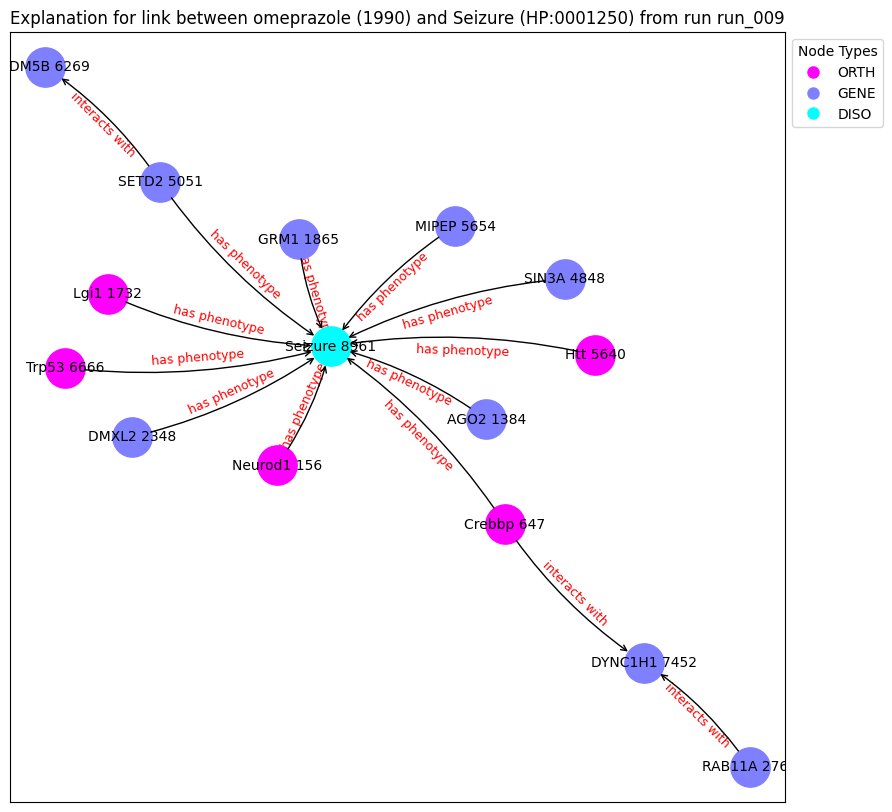

('Neurod1 156', {'type': 'ORTH'})
('Crebbp 647', {'type': 'ORTH'})
('AGO2 1384', {'type': 'GENE'})
('Lgi1 1732', {'type': 'ORTH'})
('GRM1 1865', {'type': 'GENE'})
('DMXL2 2348', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('SIN3A 4848', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('MIPEP 5654', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Trp53 6666', {'type': 'ORTH'})
('DYNC1H1 7452', {'type': 'GENE'})
('Seizure 8961', {'type': 'DISO'})
('Neurod1 156', 'Seizure 8961', {'label': 'has phenotype'})
('Crebbp 647', 'DYNC1H1 7452', {'label': 'interacts with'})
('Crebbp 647', 'Seizure 8961', {'label': 'has phenotype'})
('AGO2 1384', 'Seizure 8961', {'label': 'has phenotype'})
('Lgi1 1732', 'Seizure 8961', {'label': 'has phenotype'})
('GRM1 1865', 'Seizure 8961', {'label': 'has phenotype'})
('DMXL2 2348', 'Seizure 8961', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('SIN3A 4848', 'Seizure 8961', 

Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 210.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3897], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.01it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
11896     11896  HP:0000737     DISO  Irritability            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.5292], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 203.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5292], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 218.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5292], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 220.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5292], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5292], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 216.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5292], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 214.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5292], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 208.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5292], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 217.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5292], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 214.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5292], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 228.11it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
4154      4154  HP:0000746     DISO  Delusions            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 241.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 233.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 235.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 247.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.32it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                         label  \
12562     12562  HP:0001262     DISO  Excessive daytime somnolence   

       semantic_id  
12562            1  
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.6009], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 218.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6009], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 213.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6009], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 212.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6009], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 218.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6009], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 213.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6009], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 199.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6009], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 217.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6009], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6009], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 202.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6009], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 213.19it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic   label  semantic_id
9999      9999  HP:0002169     DISO  Clonus            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.5962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 213.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 218.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 221.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 200.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 215.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 225.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5962], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.32it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                    label  \
917       917  HP:0002529     DISO  Neuronal loss in central nervous system   

     semantic_id  
917            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 232.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 229.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 232.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 247.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:03<00:00, 233.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 235.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 237.94it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 244.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 240.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 240.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 234.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 237.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 242.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 236.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.0000], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 237.77it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 247.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 243.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 235.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:03<00:00, 213.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 241.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:03<00:00, 230.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 239.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 241.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 235.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9996], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.71it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic             label  semantic_id
8158      8158  HP:0002059     DISO  Cerebral atrophy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.4931], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 180.18it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.4931], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.72it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.4931], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 177.54it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.4931], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.23it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4931], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.62it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4931], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.08it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4931], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.42it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.4931], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.80it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4931], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.34it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4931], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 178.89it/s]


Contribution threshold is tensor(0.0061)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


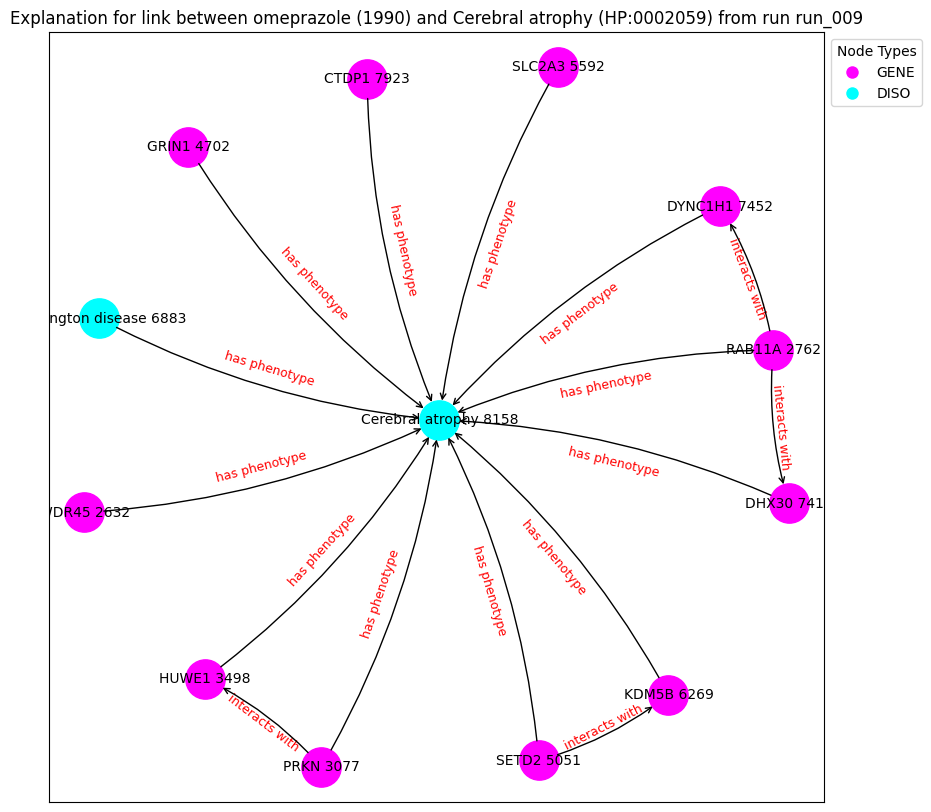

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('Cerebral atrophy 8158', {'type': 'DISO'})
('WDR45 2632', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('HUWE1 3498', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('GRIN1 4702', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('SETD2 5051', 'KDM5B 6269'

Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.25it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4292], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:04<00:00, 166.81it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4292], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.69it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4292], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.88it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4292], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.77it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.4292], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.52it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.4292], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.26it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4292], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.19it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.4292], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.83it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4292], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 176.69it/s]


Contribution threshold is tensor(0.0062)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


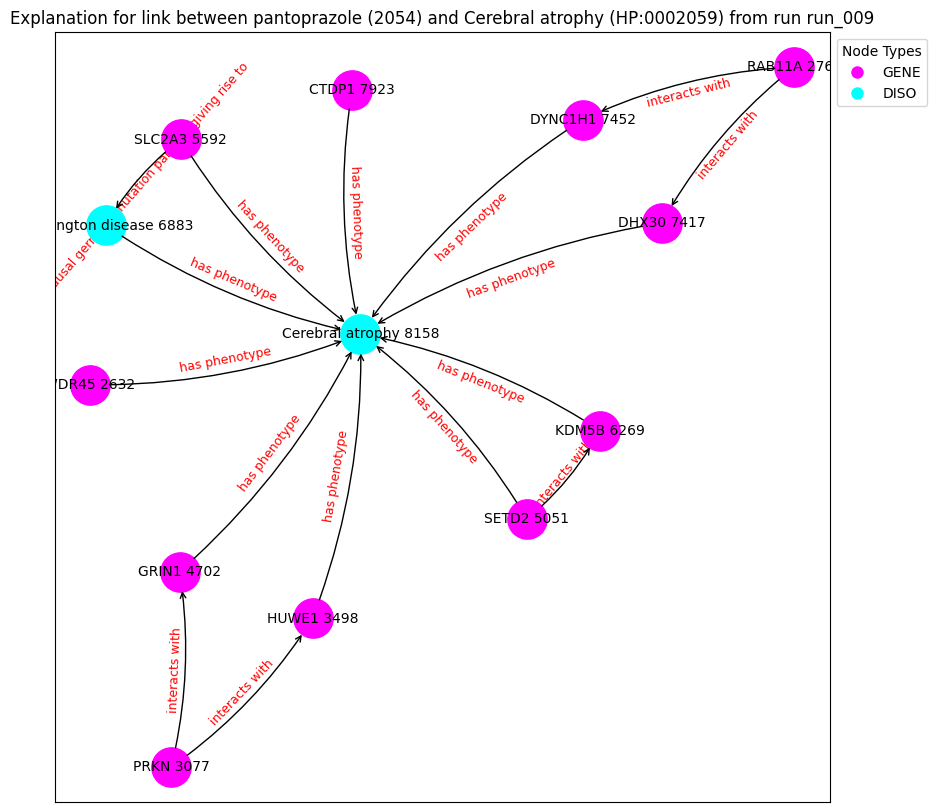

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('Cerebral atrophy 8158', {'type': 'DISO'})
('WDR45 2632', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('HUWE1 3498', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('GRIN1 4702', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('SETD2 5051', 'KDM5B 6269', {'label': 'interacts with'})
('SETD2 5051', 'Cerebral atrophy 8158', {'label'

Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 162.54it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 149.08it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 165.46it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 173.01it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 165.85it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 167.23it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.5170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 166.36it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 157.02it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 164.89it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 165.29it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


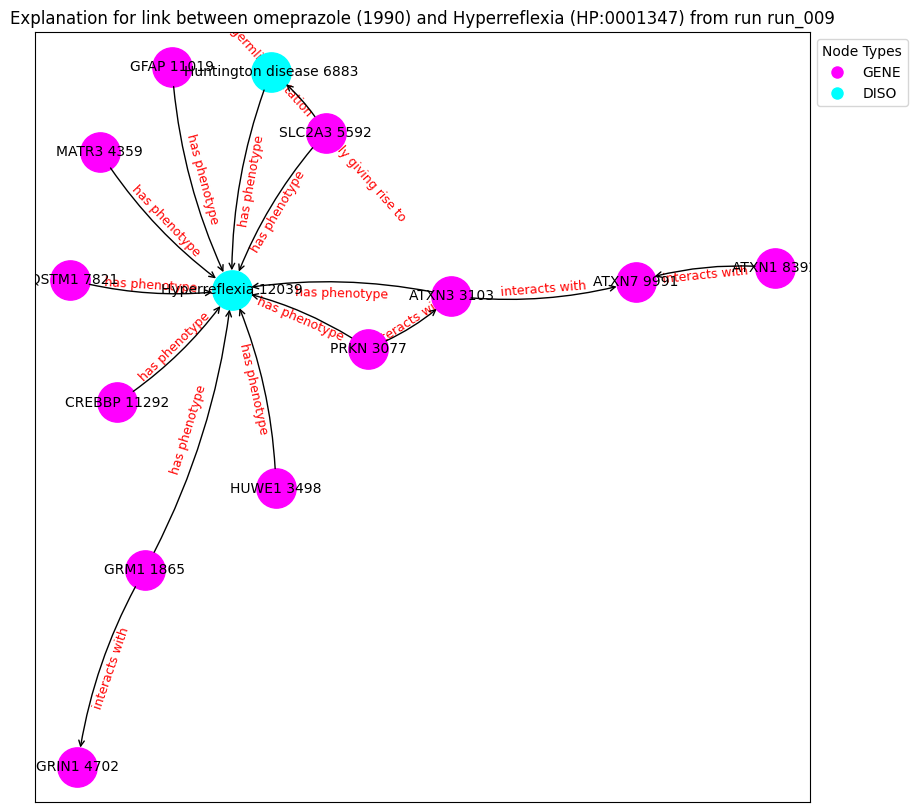

('GRM1 1865', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('MATR3 4359', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('CREBBP 11292', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('GRM1 1865', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('PRKN 3077', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'ATXN7 9991', {'label': 'interacts with'})
('ATXN3 3103', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('HUWE1 3498', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('MATR3 4359', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('SLC2A3 5592'

Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 160.80it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6592], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 154.79it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6592], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 167.81it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6592], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 169.65it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.6592], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 167.99it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6592], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 159.48it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6592], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 164.81it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6592], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 159.38it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6592], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 159.95it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.6592], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1000: 100%|██████████| 700/700 [00:04<00:00, 165.31it/s]


Contribution threshold is tensor(0.9936)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


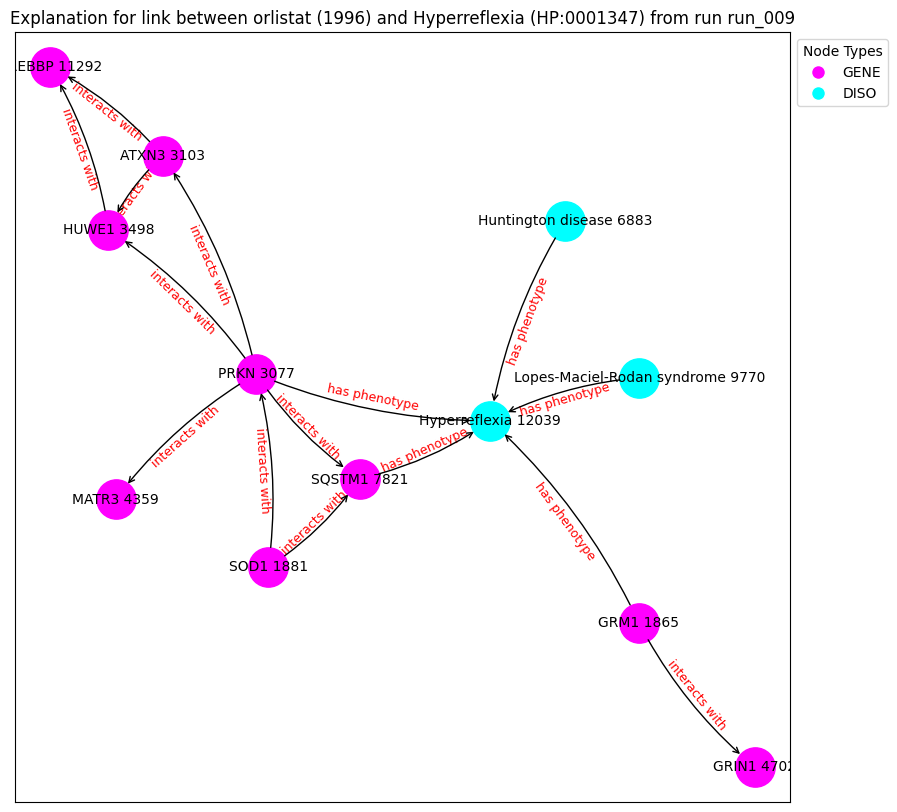

('GRM1 1865', {'type': 'GENE'})
('SOD1 1881', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('MATR3 4359', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('Lopes-Maciel-Rodan syndrome 9770', {'type': 'DISO'})
('CREBBP 11292', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('GRM1 1865', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('SOD1 1881', 'PRKN 3077', {'label': 'interacts with'})
('SOD1 1881', 'SQSTM1 7821', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'MATR3 4359', {'label': 'interacts with'})
('PRKN 3077', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('PRKN 3077', 'SQSTM1 7821', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'HUWE1 3498', {

Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 208.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 201.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 215.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 201.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 215.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 209.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 214.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 214.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 212.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5993], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 228.02it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic   label  semantic_id
12647     12647  HP:0002300     DISO  Mutism            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.5020], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 198.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5020], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 192.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5020], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 193.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5020], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 196.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5020], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 199.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5020], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 187.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5020], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 198.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5020], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 199.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5020], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 198.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5020], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 191.74it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
1369      1369  HP:0000751     DISO  Personality changes            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.9998], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9998], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9998], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9998], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9998], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9998], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 246.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9998], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:03<00:00, 217.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9998], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9998], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9998], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.65it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                      label  \
434       434  HP:0002500     DISO  Abnormal cerebral white matter morphology   

     semantic_id  
434            1  
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 238.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:03<00:00, 211.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 239.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 237.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 240.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 245.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:03<00:00, 227.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:03<00:00, 190.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9999], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:03<00:00, 218.74it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic          label  semantic_id
13239     13239  HP:0003487     DISO  Babinski sign            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.5125], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 161.19it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5125], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 175.00it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.5125], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 173.40it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5125], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 169.71it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5125], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 172.40it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5125], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 174.08it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.5125], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 173.96it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5125], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 181.23it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5125], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 175.71it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.5125], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:04<00:00, 174.47it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


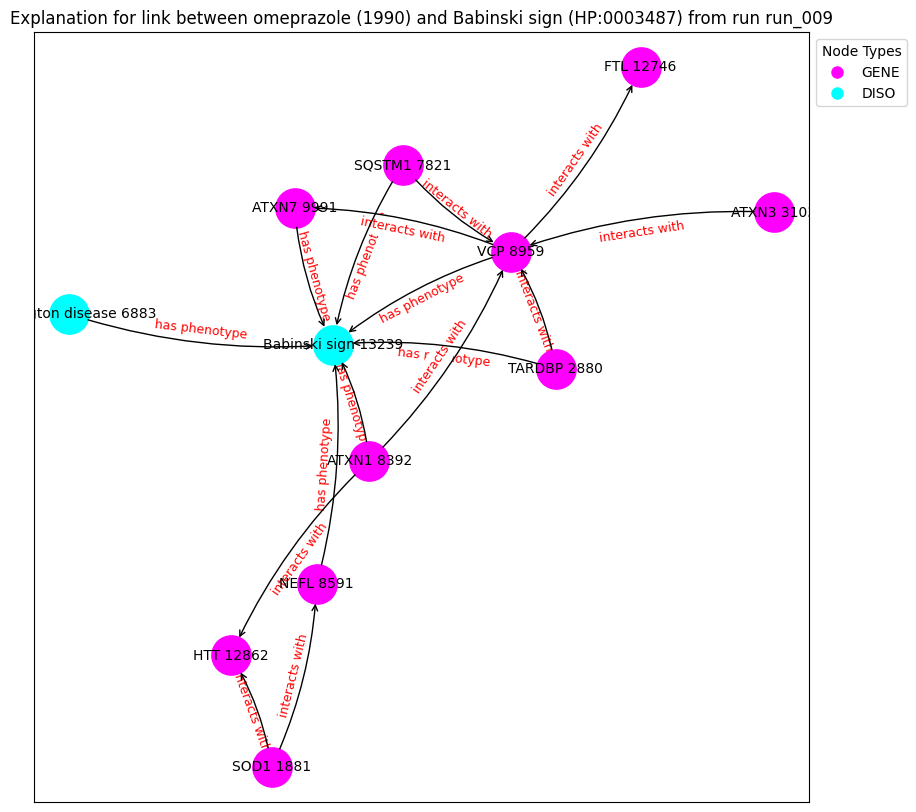

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Babinski sign 13239', {'type': 'DISO'})
('SOD1 1881', 'HTT 12862', {'label': 'interacts with'})
('SOD1 1881', 'NEFL 8591', {'label': 'interacts with'})
('TARDBP 2880', 'VCP 8959', {'label': 'interacts with'})
('TARDBP 2880', 'Babinski sign 13239', {'label': 'has phenotype'})
('ATXN3 3103', 'VCP 8959', {'label': 'interacts with'})
('Huntington disease 6883', 'Babinski sign 13239', {'label': 'has phenotype'})
('SQSTM1 7821', 'VCP 8959', {'label': 'interacts with'})
('SQSTM1 7821', 'Babinski sign 13239', {'label': 'has phenotype'})
('ATXN1 8392', 'HTT 12862', {'label': 'interacts with'})
('ATXN1 8392', 'VCP 8959', {'label

Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 122.00it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3731], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 122.95it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3731], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 124.78it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3731], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 126.20it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3731], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 126.50it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3731], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 126.00it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3731], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 126.43it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3731], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 123.35it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3731], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 128.24it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3731], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 125.57it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


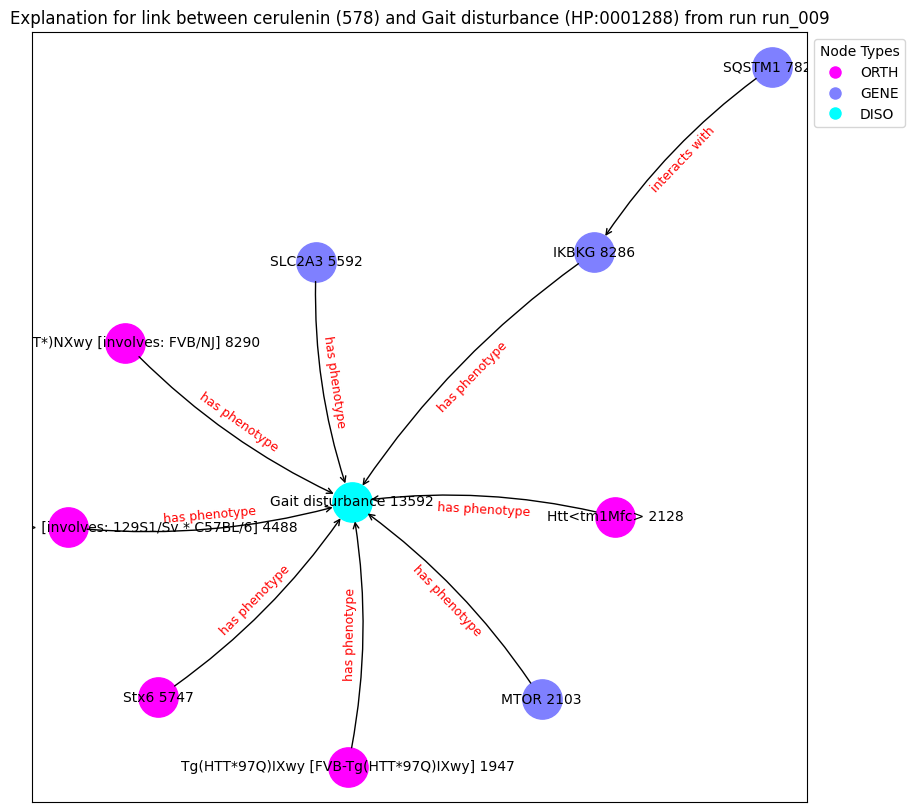

('Tg(HTT*97Q)IXwy [FVB-Tg(HTT*97Q)IXwy] 1947', {'type': 'ORTH'})
('MTOR 2103', {'type': 'GENE'})
('Htt<tm1Mfc> 2128', {'type': 'ORTH'})
('Htt<tm1Mfc>/Htt<tm1Mfc> [involves: 129S1/Sv * C57BL/6] 4488', {'type': 'ORTH'})
('SLC2A3 5592', {'type': 'GENE'})
('Stx6 5747', {'type': 'ORTH'})
('SQSTM1 7821', {'type': 'GENE'})
('IKBKG 8286', {'type': 'GENE'})
('Tg(HTT*)NXwy [involves: FVB/NJ] 8290', {'type': 'ORTH'})
('Gait disturbance 13592', {'type': 'DISO'})
('Tg(HTT*97Q)IXwy [FVB-Tg(HTT*97Q)IXwy] 1947', 'Gait disturbance 13592', {'label': 'has phenotype'})
('MTOR 2103', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Htt<tm1Mfc> 2128', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Htt<tm1Mfc>/Htt<tm1Mfc> [involves: 129S1/Sv * C57BL/6] 4488', 'Gait disturbance 13592', {'label': 'has phenotype'})
('SLC2A3 5592', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Stx6 5747', 'Gait disturbance 13592', {'label': 'has phenotype'})
('SQSTM1 7821', 'IKBKG 8286', {'label': 'inte

Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 123.89it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3812], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 124.59it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3812], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 123.70it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3812], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 124.40it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3812], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 127.05it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3812], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 125.10it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3812], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 125.73it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3812], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 127.28it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3812], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 126.40it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3812], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 121.30it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


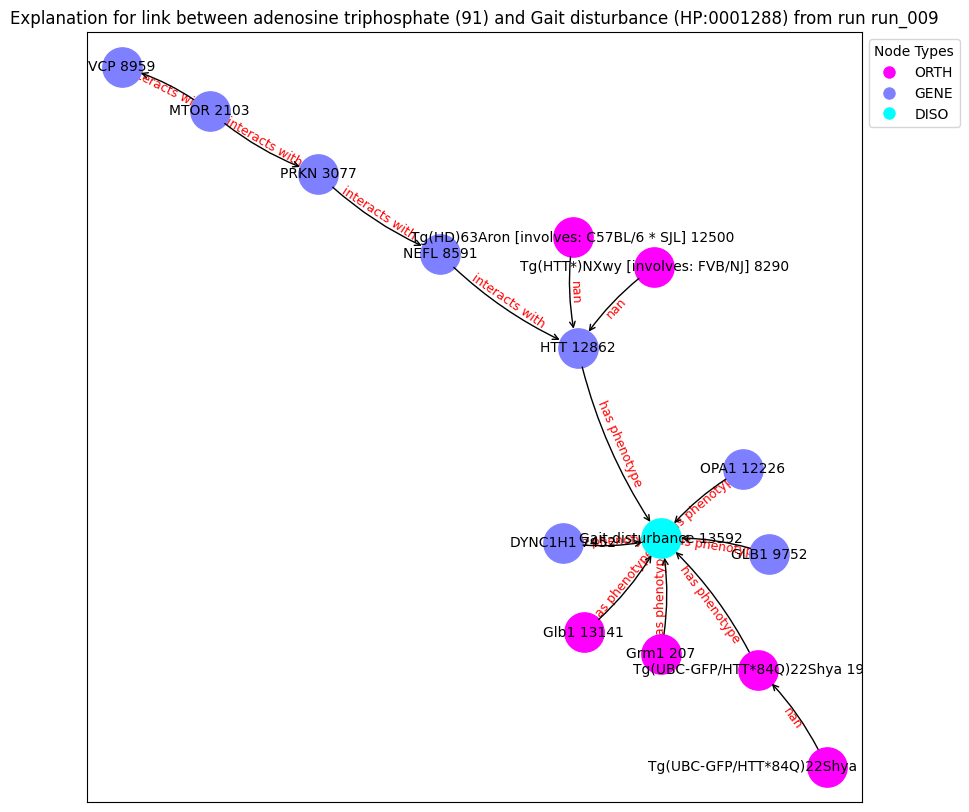

('Grm1 207', {'type': 'ORTH'})
('Tg(UBC-GFP/HTT*84Q)22Shya [involves: FVB] 1121', {'type': 'ORTH'})
('Tg(UBC-GFP/HTT*84Q)22Shya 1968', {'type': 'ORTH'})
('MTOR 2103', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('Tg(HTT*)NXwy [involves: FVB/NJ] 8290', {'type': 'ORTH'})
('NEFL 8591', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('GLB1 9752', {'type': 'GENE'})
('OPA1 12226', {'type': 'GENE'})
('Tg(HD)63Aron [involves: C57BL/6 * SJL] 12500', {'type': 'ORTH'})
('HTT 12862', {'type': 'GENE'})
('Glb1 13141', {'type': 'ORTH'})
('Gait disturbance 13592', {'type': 'DISO'})
('Grm1 207', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Tg(UBC-GFP/HTT*84Q)22Shya [involves: FVB] 1121', 'Tg(UBC-GFP/HTT*84Q)22Shya 1968', {'label': nan})
('Tg(UBC-GFP/HTT*84Q)22Shya 1968', 'Gait disturbance 13592', {'label': 'has phenotype'})
('MTOR 2103', 'PRKN 3077', {'label': 'interacts with'})
('MTOR 2103', 'VCP 8959', {'label': 'interacts with'})
('PRKN 3077', 'N

Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 210.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6310], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 223.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6310], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 213.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6310], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 228.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6310], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 226.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6310], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 220.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6310], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 222.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6310], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 219.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6310], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 214.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6310], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 224.43it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
1951      1951  HP:0002354     DISO  Memory impairment            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.9995], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9995], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 235.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9995], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9995], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:03<00:00, 228.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9995], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:03<00:00, 232.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9995], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 243.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9995], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9995], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 240.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9995], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:03<00:00, 218.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9995], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 998: 100%|██████████| 700/700 [00:02<00:00, 244.54it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\run_010
(0, {'node_feature': tensor([-0.2470,  0.4759, -0.6094, -0.1451, -0.8835,  0.1223, -0.2949, -0.2153,
         0.1050,  0.7581,  0.0468, -0.7061, -0.1427, -0.0108, -0.1205, -0.7118,
        -0.1916, -0.5212, -0.2647, -0.1443,  0.0239,  0.0296,  0.3017,  1.0252,
         0.9204, -0.8459, -0.3827, -1.5380, -0.0616, -0.0776, -0.0455, -0.3732])})
(0, 11953, {'edge_label': 'in orthology relationship with'})
Number of edges is 134749
Number of nodes is 14833
node1:
       index_id          id semantic       label  semantic_id
13668     13668  HP:0000716     DISO  Depression            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.2295], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 135.12it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2295], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 133.64it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2295], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 133.44it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2295], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 129.93it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2295], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 131.57it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2295], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 131.44it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2295], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 120.97it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2295], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 130.23it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2295], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 129.88it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2295], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 1036: 100%|██████████| 700/700 [00:05<00:00, 131.96it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


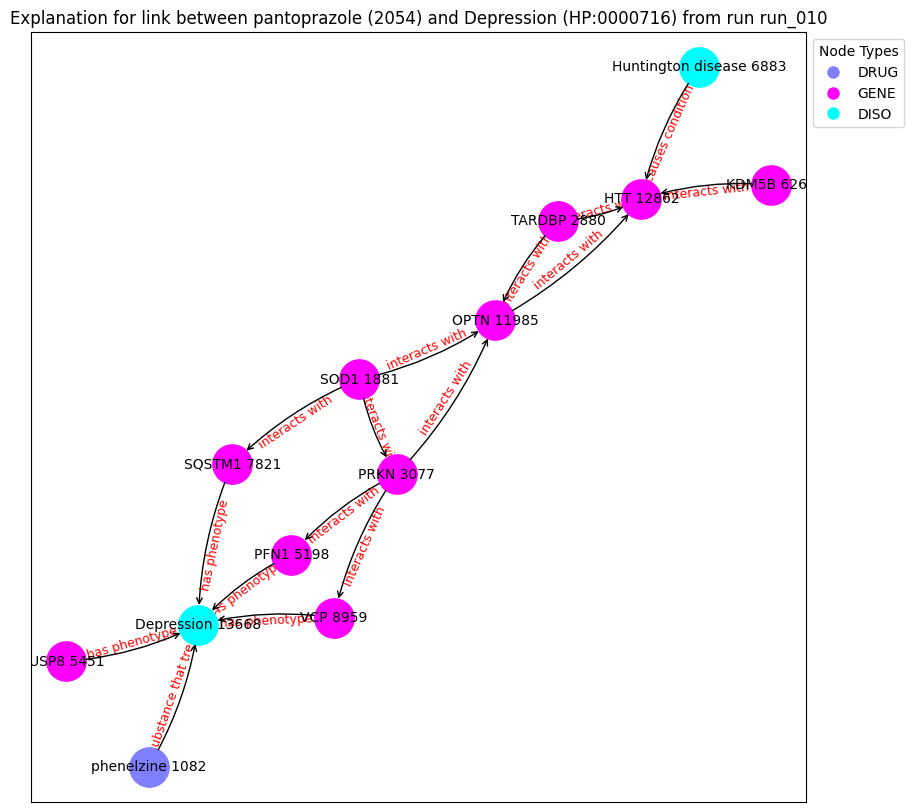

('phenelzine 1082', {'type': 'DRUG'})
('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('PFN1 5198', {'type': 'GENE'})
('USP8 5451', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('phenelzine 1082', 'Depression 13668', {'label': 'is substance that treats'})
('SOD1 1881', 'PRKN 3077', {'label': 'interacts with'})
('SOD1 1881', 'SQSTM1 7821', {'label': 'interacts with'})
('SOD1 1881', 'OPTN 11985', {'label': 'interacts with'})
('TARDBP 2880', 'HTT 12862', {'label': 'interacts with'})
('TARDBP 2880', 'OPTN 11985', {'label': 'interacts with'})
('PRKN 3077', 'VCP 8959', {'label': 'interacts with'})
('PRKN 3077', 'OPTN 11985', {'label': 'interacts with'})
('PRKN 3077', 'PFN1 5198', {'label': 'interacts with'})
('PFN1 5198', 'De

Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:05<00:00, 126.97it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3245], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:05<00:00, 124.83it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3245], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:05<00:00, 126.24it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3245], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:05<00:00, 136.56it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3245], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:05<00:00, 139.29it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3245], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:05<00:00, 134.93it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3245], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:05<00:00, 137.84it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3245], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:05<00:00, 136.05it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3245], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:05<00:00, 136.12it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3245], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13668 and 998: 100%|██████████| 700/700 [00:05<00:00, 132.73it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


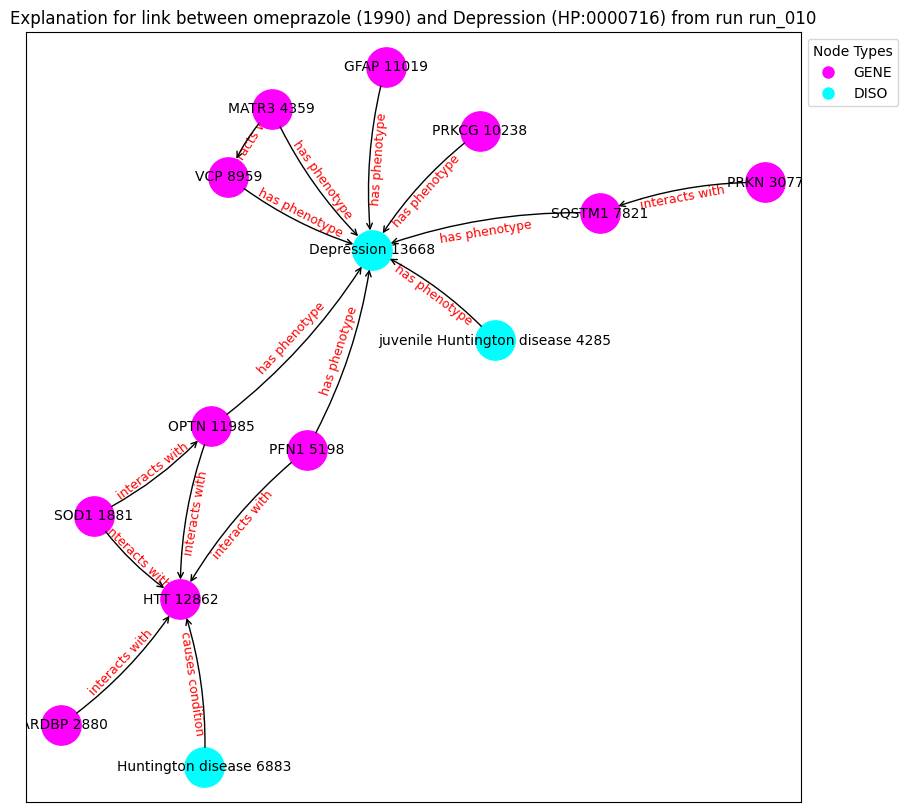

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('MATR3 4359', {'type': 'GENE'})
('PFN1 5198', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('OPTN 11985', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Depression 13668', {'type': 'DISO'})
('SOD1 1881', 'HTT 12862', {'label': 'interacts with'})
('SOD1 1881', 'OPTN 11985', {'label': 'interacts with'})
('TARDBP 2880', 'HTT 12862', {'label': 'interacts with'})
('PRKN 3077', 'SQSTM1 7821', {'label': 'interacts with'})
('juvenile Huntington disease 4285', 'Depression 13668', {'label': 'has phenotype'})
('MATR3 4359', 'Depression 13668', {'label': 'has phenotype'})
('MATR3 4359', 'VCP 8959', {'label': 'interacts with'})
('PFN1 5198', 'HTT 12862', {'label': 'interacts with'})
('PFN1 5198

Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 188.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9211], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 184.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9211], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 183.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9211], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 187.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9211], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 186.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9211], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 191.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9211], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9211], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 193.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9211], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 229.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9211], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 1082: 100%|██████████| 700/700 [00:03<00:00, 228.03it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                         label  semantic_id
5086      5086  HP:0040140     DISO  Degeneration of the striatum            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.7352], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7352], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7352], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7352], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 229.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7352], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7352], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7352], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7352], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 219.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7352], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7352], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5086 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.58it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic     label  semantic_id
12933     12933  HP:0001332     DISO  Dystonia            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.4936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:05<00:00, 138.78it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:05<00:00, 138.62it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 144.28it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 143.36it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 140.95it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 140.65it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 144.09it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 144.25it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 144.68it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4936], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 294: 100%|██████████| 700/700 [00:04<00:00, 145.62it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


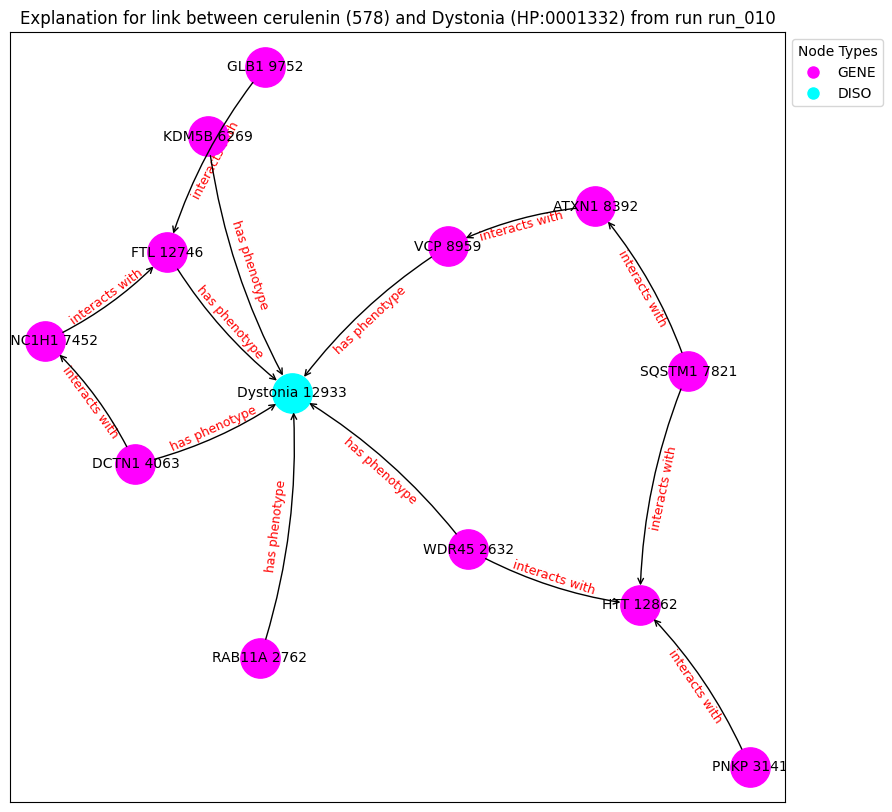

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('GLB1 9752', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Dystonia 12933', {'type': 'DISO'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('WDR45 2632', 'Dystonia 12933', {'label': 'has phenotype'})
('RAB11A 2762', 'Dystonia 12933', {'label': 'has phenotype'})
('PNKP 3141', 'HTT 12862', {'label': 'interacts with'})
('DCTN1 4063', 'Dystonia 12933', {'label': 'has phenotype'})
('DCTN1 4063', 'DYNC1H1 7452', {'label': 'interacts with'})
('KDM5B 6269', 'Dystonia 12933', {'label': 'has phenotype'})
('DYNC1H1 7452', 'FTL 12746', {'label': 'interacts with'})
('SQSTM1 7821', 'HTT 12862', {'label': 'interacts with'})
('SQSTM1 7821', 'ATXN1 8392', {'la

Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 140.95it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:05<00:00, 138.14it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 141.92it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 144.62it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 142.45it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.2115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 144.14it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 143.23it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 140.60it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:05<00:00, 137.81it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.2115], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 998: 100%|██████████| 700/700 [00:04<00:00, 140.17it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


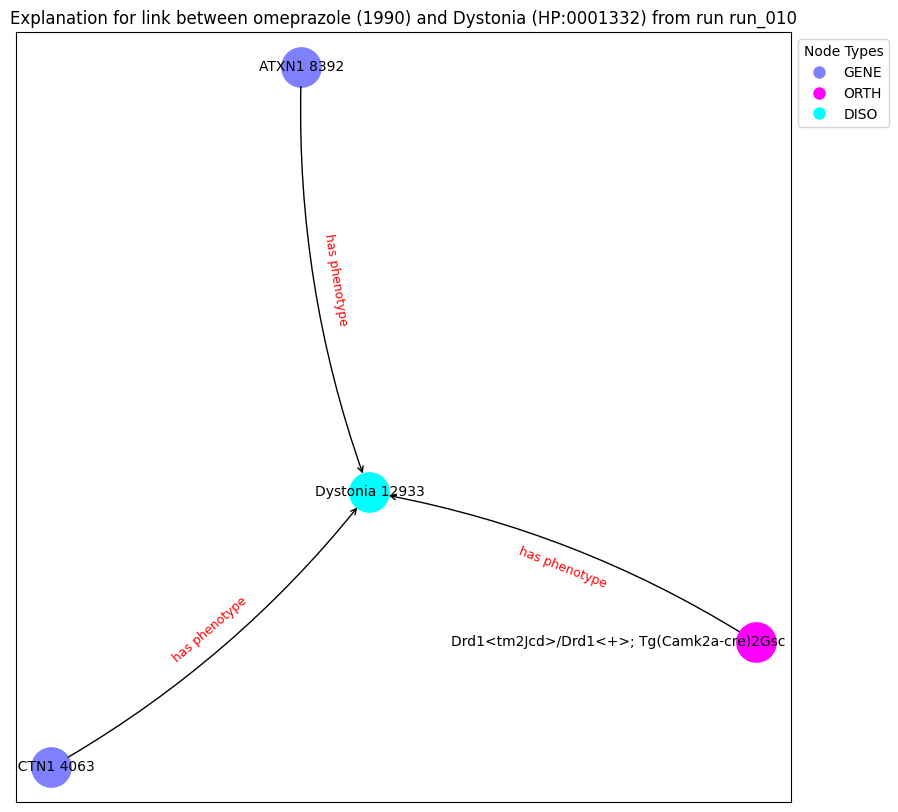

('DCTN1 4063', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('Drd1<tm2Jcd>/Drd1<+>; Tg(Camk2a-cre)2Gsc [involves: 129S4/SvJae * FVB/N] 10314', {'type': 'ORTH'})
('Dystonia 12933', {'type': 'DISO'})
('DCTN1 4063', 'Dystonia 12933', {'label': 'has phenotype'})
('ATXN1 8392', 'Dystonia 12933', {'label': 'has phenotype'})
('Drd1<tm2Jcd>/Drd1<+>; Tg(Camk2a-cre)2Gsc [involves: 129S4/SvJae * FVB/N] 10314', 'Dystonia 12933', {'label': 'has phenotype'})
Explanation graph saved at c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\expl_5/incomplete_explanation_4_run_010_graph.gpickle
Explanation pair ids and names saved at c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\expl_5/incomplete_explanation_4_run_010_pair.pkl
node1:
       index_id          id semantic     label  semantic_id
12933     12933  HP:0001332     DISO  Dystonia            1
node2:
      index_id    id semantic         label  semantic_id
10

Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 141.42it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3569], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:05<00:00, 136.11it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3569], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 144.32it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3569], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 141.03it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3569], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 146.60it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3569], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 145.96it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3569], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 147.12it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3569], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 145.04it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3569], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 145.29it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3569], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12933 and 1036: 100%|██████████| 700/700 [00:04<00:00, 142.48it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


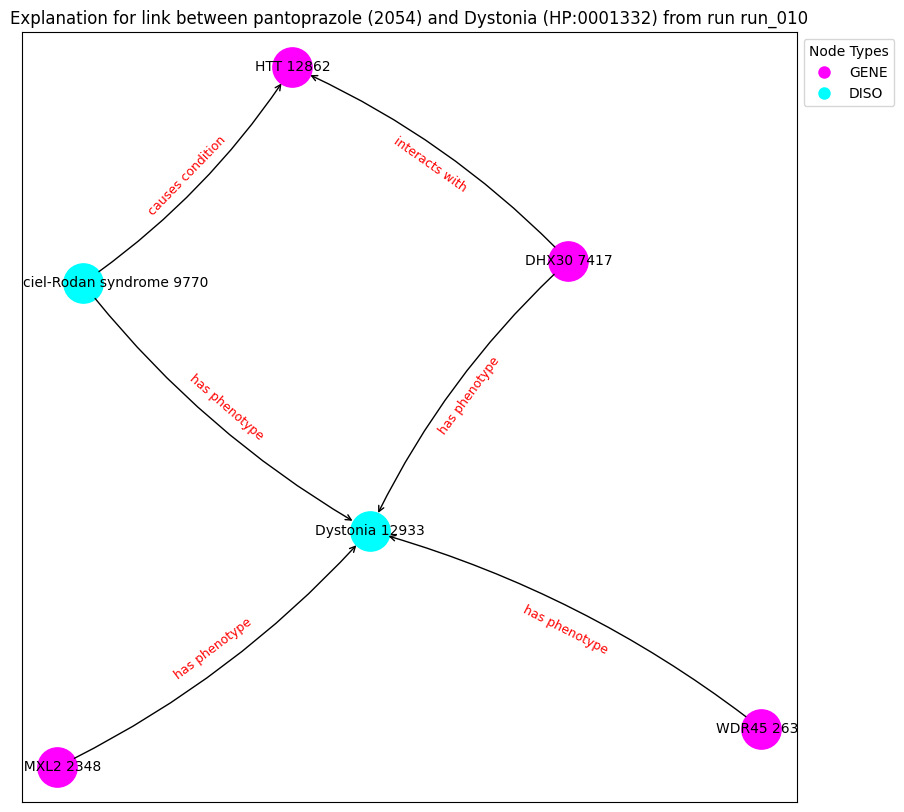

('DMXL2 2348', {'type': 'GENE'})
('WDR45 2632', {'type': 'GENE'})
('DHX30 7417', {'type': 'GENE'})
('Lopes-Maciel-Rodan syndrome 9770', {'type': 'DISO'})
('HTT 12862', {'type': 'GENE'})
('Dystonia 12933', {'type': 'DISO'})
('DMXL2 2348', 'Dystonia 12933', {'label': 'has phenotype'})
('WDR45 2632', 'Dystonia 12933', {'label': 'has phenotype'})
('DHX30 7417', 'HTT 12862', {'label': 'interacts with'})
('DHX30 7417', 'Dystonia 12933', {'label': 'has phenotype'})
('Lopes-Maciel-Rodan syndrome 9770', 'HTT 12862', {'label': 'causes condition'})
('Lopes-Maciel-Rodan syndrome 9770', 'Dystonia 12933', {'label': 'has phenotype'})
Explanation graph saved at c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\expl_5/incomplete_explanation_5_run_010_graph.gpickle
Explanation pair ids and names saved at c:\Users\rosa-\Google Drive\Msc_Bioinformatics\thesis\XAIFO-ThesisProject\output\hd\g1_e2v\expl_5/incomplete_explanation_5_run_010_pair.pkl
node1:
      index_id

Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 230.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 228.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 237.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 220.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 228.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 214.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 238.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 233.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:03<00:00, 226.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1789 and 1000: 100%|██████████| 700/700 [00:02<00:00, 234.43it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic            label  semantic_id
14311     14311  HP:0031845     DISO  Abnormal libido            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.7036], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7036], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7036], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 218.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7036], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 205.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7036], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 213.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7036], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 218.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7036], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7036], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7036], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 215.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7036], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 2585: 100%|██████████| 700/700 [00:03<00:00, 219.02it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic            label  semantic_id
14311     14311  HP:0031845     DISO  Abnormal libido            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5708], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5708], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5708], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5708], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5708], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 201.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5708], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5708], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5708], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 208.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5708], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5708], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14311 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.38it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.5659], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 212.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5659], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 209.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5659], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 222.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5659], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 200.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5659], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 225.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5659], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5659], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5659], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 211.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5659], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5659], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1082: 100%|██████████| 700/700 [00:03<00:00, 221.92it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.2760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 216.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 219.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 219.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 222.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 217.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 213.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 220.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 218.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 213.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2760], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 1036: 100%|██████████| 700/700 [00:03<00:00, 216.89it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
3673      3673  HP:0000718     DISO  Aggressive behavior            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.2124], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 218.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2124], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2124], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 204.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2124], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2124], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 213.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2124], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 215.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2124], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2124], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2124], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2124], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3673 and 998: 100%|██████████| 700/700 [00:03<00:00, 220.62it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.2887], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2887], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2887], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 204.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2887], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2887], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 198.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2887], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 201.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2887], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2887], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 197.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2887], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 180.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2887], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1036: 100%|██████████| 700/700 [00:03<00:00, 200.49it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.1772], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1772], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1772], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1772], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1772], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 197.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1772], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1772], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 199.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1772], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1772], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1772], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 998: 100%|██████████| 700/700 [00:03<00:00, 199.55it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                          label  \
12938     12938  HP:0000722     DISO  Obsessive-compulsive behavior   

       semantic_id  
12938            1  
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.1269], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 189.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1269], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 199.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1269], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 199.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1269], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 195.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1269], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 198.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1269], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 199.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1269], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 190.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1269], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 188.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1269], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 198.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1269], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12938 and 1082: 100%|██████████| 700/700 [00:03<00:00, 195.96it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
6473      6473  HP:0001272     DISO  Cerebellar atrophy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.6981], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 183.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6981], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6981], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6981], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 183.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6981], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6981], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 187.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6981], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 175.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6981], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 197.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6981], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 195.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6981], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 998: 100%|██████████| 700/700 [00:03<00:00, 196.39it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
6473      6473  HP:0001272     DISO  Cerebellar atrophy            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.7428], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7428], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7428], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:04<00:00, 163.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7428], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7428], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 180.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7428], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 183.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7428], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7428], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 198.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7428], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7428], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6473 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.78it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
4670      4670  HP:0031589     DISO  Suicidal ideation            1
node2:
      index_id    id semantic             label  semantic_id
2023      2023  4226     DRUG  ingenol mebutate            2
Prediction from trained model: tensor([0.2822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 225.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 228.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 217.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 227.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 207.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 231.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 232.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 214.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 230.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2822], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2023: 100%|██████████| 700/700 [00:03<00:00, 230.03it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
4670      4670  HP:0031589     DISO  Suicidal ideation            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.9160], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9160], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9160], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9160], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 202.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9160], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9160], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9160], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9160], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 225.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9160], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9160], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 294: 100%|██████████| 700/700 [00:03<00:00, 217.08it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
4670      4670  HP:0031589     DISO  Suicidal ideation            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.7072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 220.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 224.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 216.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 217.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.24it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4670 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.76it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic        label  semantic_id
2028      2028  HP:0002066     DISO  Gait ataxia            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.1368], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1368], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1368], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 216.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1368], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1368], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1368], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1368], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1368], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 228.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1368], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1368], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.98it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic        label  semantic_id
2028      2028  HP:0002066     DISO  Gait ataxia            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.1387], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 224.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1387], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 229.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1387], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 216.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1387], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 220.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1387], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 221.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1387], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 220.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1387], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 224.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1387], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 222.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1387], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 222.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1387], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2028 and 1036: 100%|██████████| 700/700 [00:03<00:00, 226.86it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                 label  semantic_id
10550     10550  HP:0001268     DISO  Mental deterioration            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.1331], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 204.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1331], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1331], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 207.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1331], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1331], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 204.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1331], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1331], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 212.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1331], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1331], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1331], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 998: 100%|██████████| 700/700 [00:03<00:00, 204.67it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                 label  semantic_id
10550     10550  HP:0001268     DISO  Mental deterioration            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.1086], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1086], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 207.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1086], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 207.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1086], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 208.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1086], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 204.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1086], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 202.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1086], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 203.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1086], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 205.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1086], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 206.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1086], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10550 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.16it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
6571      6571  HP:0031473     DISO  Hostility            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.7286], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7286], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 222.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7286], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7286], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 228.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7286], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7286], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7286], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 231.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7286], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7286], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7286], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 2585: 100%|██████████| 700/700 [00:03<00:00, 216.69it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
6571      6571  HP:0031473     DISO  Hostility            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5431], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5431], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5431], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5431], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5431], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5431], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:02<00:00, 233.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5431], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5431], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 219.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5431], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 199.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5431], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6571 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.63it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                        label  semantic_id
8786      8786  HP:0000496     DISO  Abnormality of eye movement            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.0045], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 220.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0045], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 214.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0045], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 218.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0045], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 218.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0045], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 211.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0045], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 215.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0045], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 217.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0045], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 217.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0045], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 214.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0045], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 1082: 100%|██████████| 700/700 [00:03<00:00, 217.28it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                        label  semantic_id
8786      8786  HP:0000496     DISO  Abnormality of eye movement            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.4334], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 209.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4334], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4334], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 210.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4334], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 201.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4334], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4334], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 212.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4334], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4334], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 207.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4334], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4334], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8786 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.06it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic             label  semantic_id
9177      9177  HP:0030842     DISO  Choking episodes            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.4503], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4503], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 220.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4503], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 230.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4503], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 226.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4503], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4503], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 229.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4503], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 210.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4503], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4503], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 225.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4503], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 2585: 100%|██████████| 700/700 [00:03<00:00, 224.42it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic             label  semantic_id
9177      9177  HP:0030842     DISO  Choking episodes            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5342], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5342], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5342], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5342], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 230.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5342], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 220.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5342], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5342], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5342], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 221.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5342], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5342], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9177 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.71it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic         label  semantic_id
7072      7072  HP:0002067     DISO  Bradykinesia            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 192.39it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 189.12it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 184.36it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 189.76it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 188.28it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 182.74it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 190.44it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 190.15it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 188.99it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5968], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 294: 100%|██████████| 700/700 [00:03<00:00, 189.67it/s]


Contribution threshold is tensor(0.0061)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


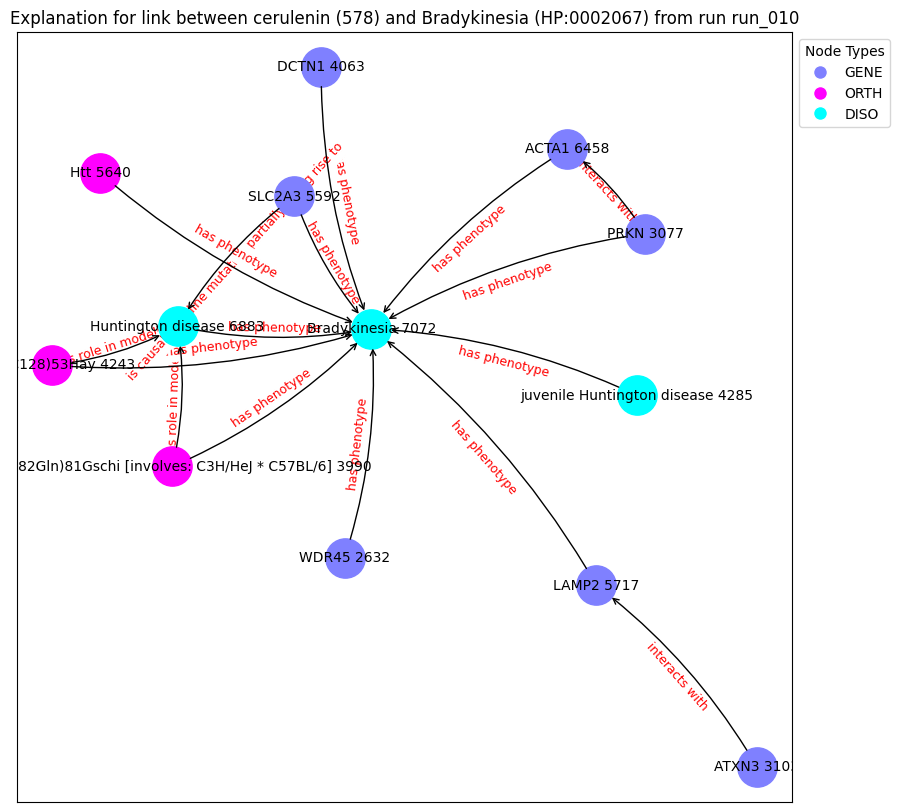

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', {'type': 'ORTH'})
('DCTN1 4063', {'type': 'GENE'})
('Tg(YAC128)53Hay 4243', {'type': 'ORTH'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('LAMP2 5717', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('Bradykinesia 7072', {'type': 'DISO'})
('WDR45 2632', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('ATXN3 3103', 'LAMP2 5717', {'label': 'interacts with'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Huntington disease 6883', {'label': 'has role in modeling'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Bradykinesia 7072', {'label': 'has phenotype'})
('DCTN1 4

Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:04<00:00, 171.14it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6658], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 179.12it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6658], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 190.93it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6658], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:04<00:00, 163.10it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6658], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 191.27it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6658], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 190.54it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.6658], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 189.85it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6658], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 190.66it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.6658], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 191.11it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.6658], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 7072 and 2585: 100%|██████████| 700/700 [00:03<00:00, 185.79it/s]


Contribution threshold is tensor(0.0062)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


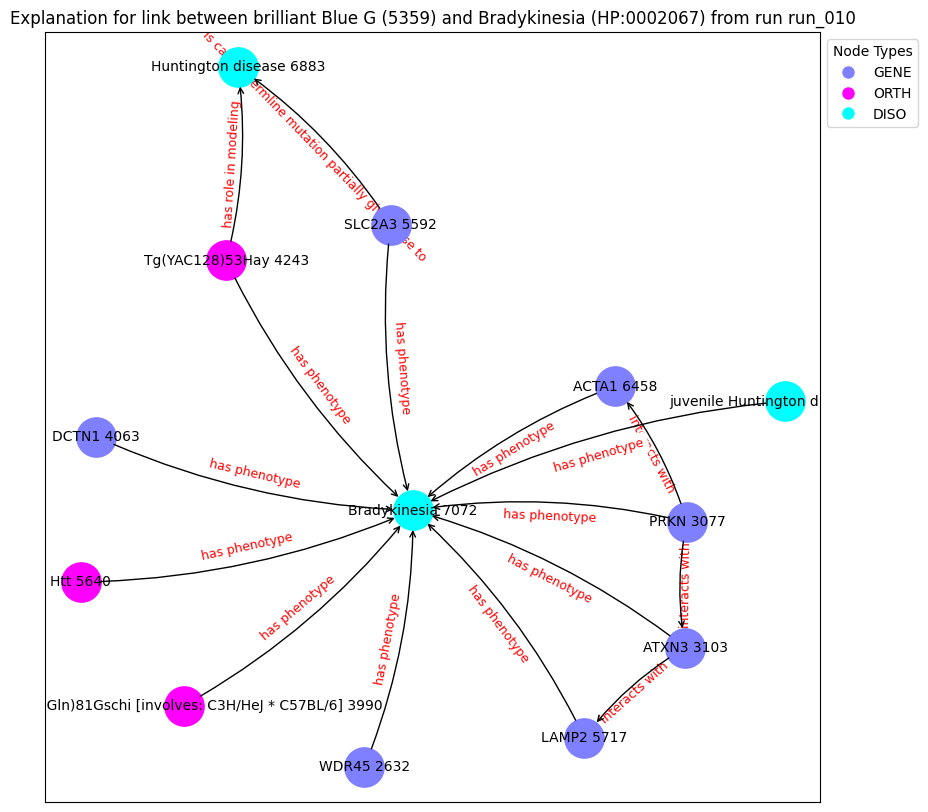

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', {'type': 'ORTH'})
('DCTN1 4063', {'type': 'GENE'})
('Tg(YAC128)53Hay 4243', {'type': 'ORTH'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('LAMP2 5717', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('Bradykinesia 7072', {'type': 'DISO'})
('WDR45 2632', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'Bradykinesia 7072', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'ATXN3 3103', {'label': 'interacts with'})
('ATXN3 3103', 'Bradykinesia 7072', {'label': 'has phenotype'})
('ATXN3 3103', 'LAMP2 5717', {'label': 'interacts with'})
('Tg(HD82Gln)81Gschi [involves: C3H/HeJ * C57BL/6] 3990', 'Bradykinesia 7072', {'label': 'has phenotype'})
('DCTN1 

Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 245.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 210.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 242.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 235.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 236.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 240.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:03<00:00, 232.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.88it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic           label  semantic_id
1065      1065  HP:0002141     DISO  Gait imbalance            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 240.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 241.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 245.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 235.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 234.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 246.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:02<00:00, 236.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:03<00:00, 230.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1065 and 1036: 100%|██████████| 700/700 [00:03<00:00, 232.27it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic      label  semantic_id
13378     13378  HP:0001336     DISO  Myoclonus            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.3317], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 204.61it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.3317], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.36it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.3317], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.67it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.3317], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.15it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.3317], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.05it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.3317], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 218.16it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.3317], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.10it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3317], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 210.42it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.3317], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 212.35it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.3317], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.92it/s]


Contribution threshold is tensor(0.0064)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


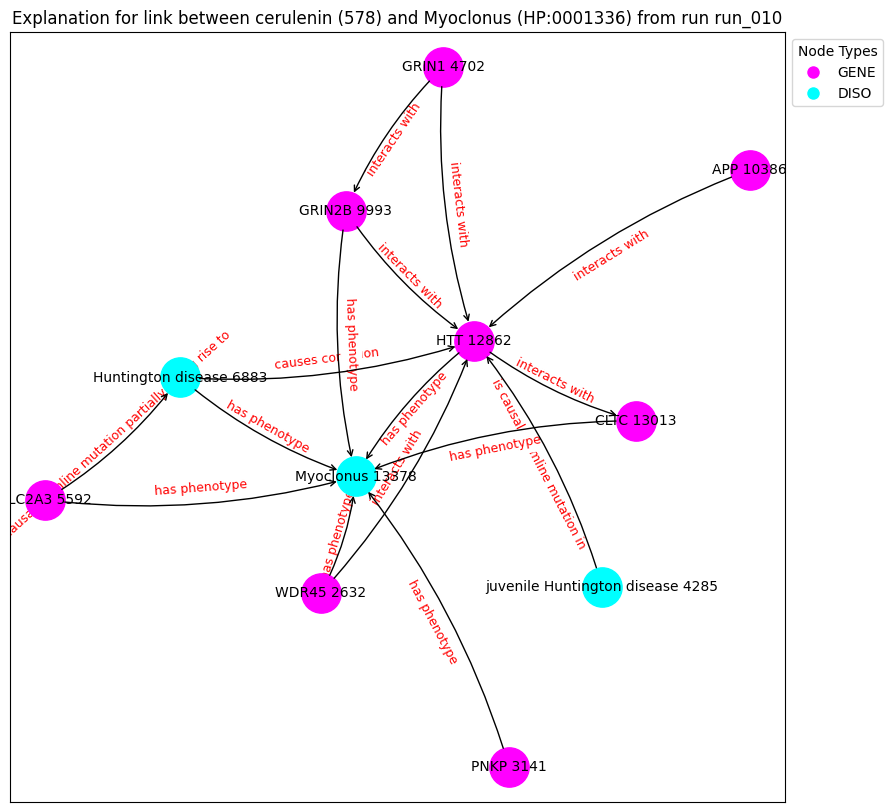

('WDR45 2632', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('GRIN2B 9993', {'type': 'GENE'})
('APP 10386', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Myoclonus 13378', {'type': 'DISO'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('WDR45 2632', 'Myoclonus 13378', {'label': 'has phenotype'})
('PNKP 3141', 'Myoclonus 13378', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is causal germline mutation in'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('SLC2A3 5592', 'Myoclonus 13378', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('Huntington disease 6883', 'HTT 1

Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.29it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2329], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 209.35it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2329], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 210.79it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.2329], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.96it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2329], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 217.05it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2329], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 209.94it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2329], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 208.54it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2329], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 214.16it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2329], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 204.90it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.2329], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13378 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.88it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


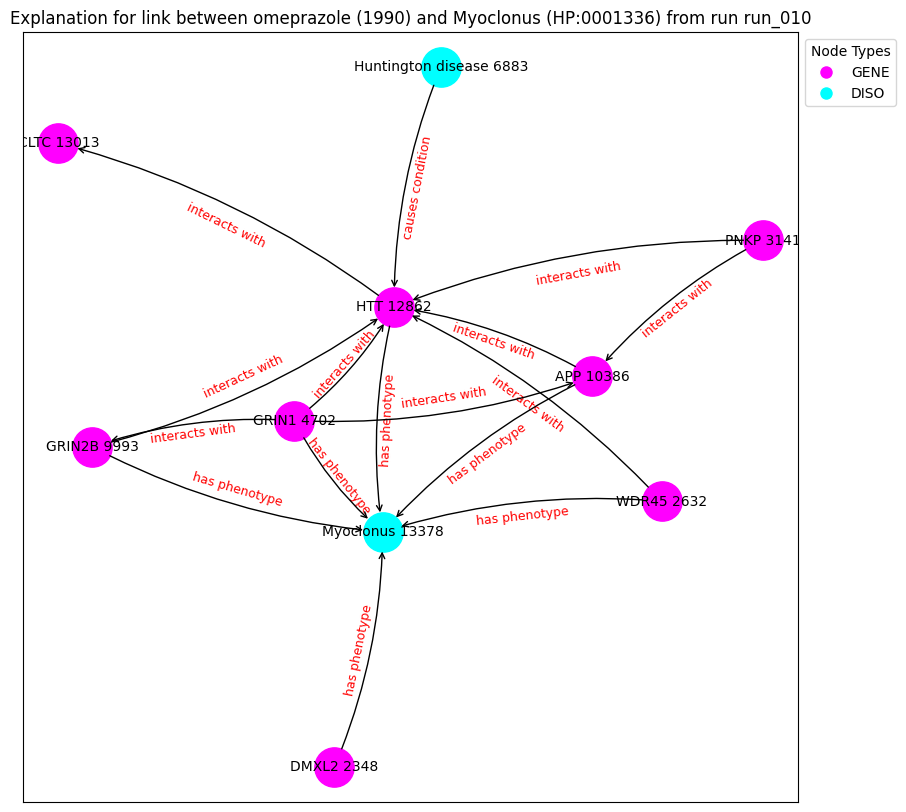

('DMXL2 2348', {'type': 'GENE'})
('WDR45 2632', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('GRIN2B 9993', {'type': 'GENE'})
('APP 10386', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Myoclonus 13378', {'type': 'DISO'})
('DMXL2 2348', 'Myoclonus 13378', {'label': 'has phenotype'})
('WDR45 2632', 'HTT 12862', {'label': 'interacts with'})
('WDR45 2632', 'Myoclonus 13378', {'label': 'has phenotype'})
('PNKP 3141', 'HTT 12862', {'label': 'interacts with'})
('PNKP 3141', 'APP 10386', {'label': 'interacts with'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'APP 10386', {'label': 'interacts with'})
('GRIN1 4702', 'Myoclonus 13378', {'label': 'has phenotype'})
('Huntington disease 6883', 'HTT 12862', {'label': 'causes condition'})
('GRIN2B 9993', 'HTT 12862', {'label': 'interacts with

Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4284], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4284], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 226.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4284], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4284], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 232.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4284], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 225.15it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4284], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 230.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4284], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 217.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4284], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 210.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4284], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 998: 100%|██████████| 700/700 [00:03<00:00, 227.34it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
5935      5935  HP:0000713     DISO  Agitation            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.1866], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 227.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1866], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 229.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1866], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 225.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1866], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 228.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1866], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 229.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1866], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 218.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1866], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 227.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1866], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 214.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1866], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 214.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1866], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1036: 100%|██████████| 700/700 [00:03<00:00, 231.95it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
5935      5935  HP:0000713     DISO  Agitation            1
node2:
      index_id    id semantic     label  semantic_id
1000      1000  1996     DRUG  orlistat            2
Prediction from trained model: tensor([0.3011], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 223.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3011], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 223.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3011], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 227.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3011], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 205.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3011], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 222.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3011], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 219.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3011], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 220.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3011], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 208.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3011], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 220.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3011], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5935 and 1000: 100%|██████████| 700/700 [00:03<00:00, 230.86it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic    label  semantic_id
3363      3363  HP:0002171     DISO  Gliosis            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5724], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 215.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5724], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5724], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5724], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5724], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 228.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5724], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 213.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5724], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5724], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 216.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5724], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 214.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5724], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3363 and 294: 100%|██████████| 700/700 [00:03<00:00, 211.50it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic   label  semantic_id
14731     14731  HP:0002072     DISO  Chorea            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.2343], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.52it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2343], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.32it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2343], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:03<00:00, 189.03it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2343], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.98it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2343], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.45it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2343], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.23it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.2343], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:03<00:00, 183.73it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2343], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.45it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.2343], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:03<00:00, 194.67it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.2343], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.10it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


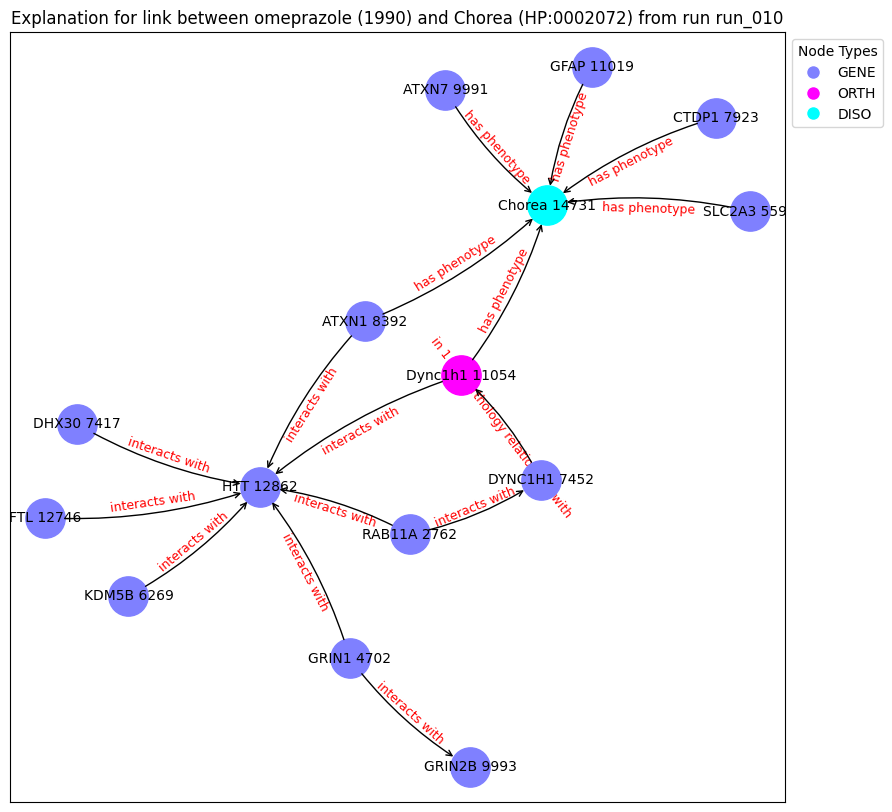

('RAB11A 2762', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('Dync1h1 11054', {'type': 'ORTH'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Chorea 14731', {'type': 'DISO'})
('RAB11A 2762', 'HTT 12862', {'label': 'interacts with'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('SLC2A3 5592', 'Chorea 14731', {'label': 'has phenotype'})
('KDM5B 6269', 'HTT 12862', {'label': 'interacts with'})
('DHX30 7417', 'HTT 12862', {'label': 'interacts with'})
('DYNC1H1 7452', 'Dync1h1 11054', {'label': 'in 1 to 1 orthology relationship with'})
('

Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:03<00:00, 183.65it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.2862], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:04<00:00, 174.48it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2862], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.79it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2862], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.40it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2862], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:03<00:00, 177.20it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.2862], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.78it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.2862], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.60it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.2862], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.52it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2862], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.45it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.2862], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14731 and 1036: 100%|██████████| 700/700 [00:03<00:00, 188.64it/s]


Contribution threshold is tensor(0.9936)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


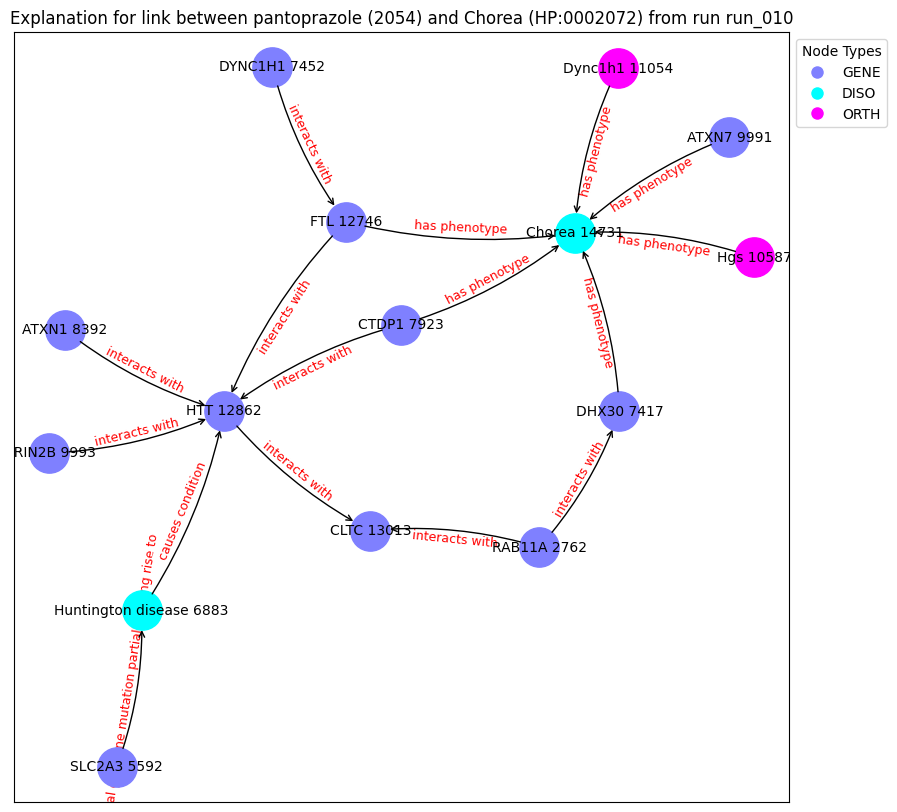

('RAB11A 2762', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('Hgs 10587', {'type': 'ORTH'})
('Dync1h1 11054', {'type': 'ORTH'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Chorea 14731', {'type': 'DISO'})
('RAB11A 2762', 'CLTC 13013', {'label': 'interacts with'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('Huntington disease 6883', 'HTT 12862', {'label': 'causes condition'})
('DHX30 7417', 'Chorea 14731', {'label': 'has phenotype'})
('DYNC1H1 7452', 'FTL 12746', {'label': 'interacts with'})
('CTDP1 7923', 'HTT 12862', {'label': 'interacts with'})
('CTDP1 79

Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 259.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 238.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 260.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 252.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 257.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 259.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 265.83it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 261.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 265.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1082: 100%|██████████| 700/700 [00:02<00:00, 262.83it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic       label  semantic_id
2824      2824  HP:0002312     DISO  Clumsiness            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 271.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 267.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 265.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 238.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 262.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 264.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 277.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 261.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 276.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 1036: 100%|██████████| 700/700 [00:02<00:00, 262.61it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic       label  semantic_id
2824      2824  HP:0002312     DISO  Clumsiness            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 263.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 271.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 257.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 244.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 265.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 265.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 261.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 271.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 262.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2824 and 998: 100%|██████████| 700/700 [00:02<00:00, 260.94it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic        label  semantic_id
13123     13123  HP:0001824     DISO  Weight loss            1
node2:
    index_id  id semantic                   label  semantic_id
53        53  91     DRUG  adenosine triphosphate            2
Prediction from trained model: tensor([0.3509], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:04<00:00, 151.97it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3509], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:04<00:00, 151.16it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3509], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:04<00:00, 146.55it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3509], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:04<00:00, 150.59it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3509], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:04<00:00, 150.83it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3509], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:04<00:00, 153.32it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3509], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:04<00:00, 150.57it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3509], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:04<00:00, 152.76it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.3509], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:04<00:00, 152.07it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.3509], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 53: 100%|██████████| 700/700 [00:04<00:00, 153.81it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


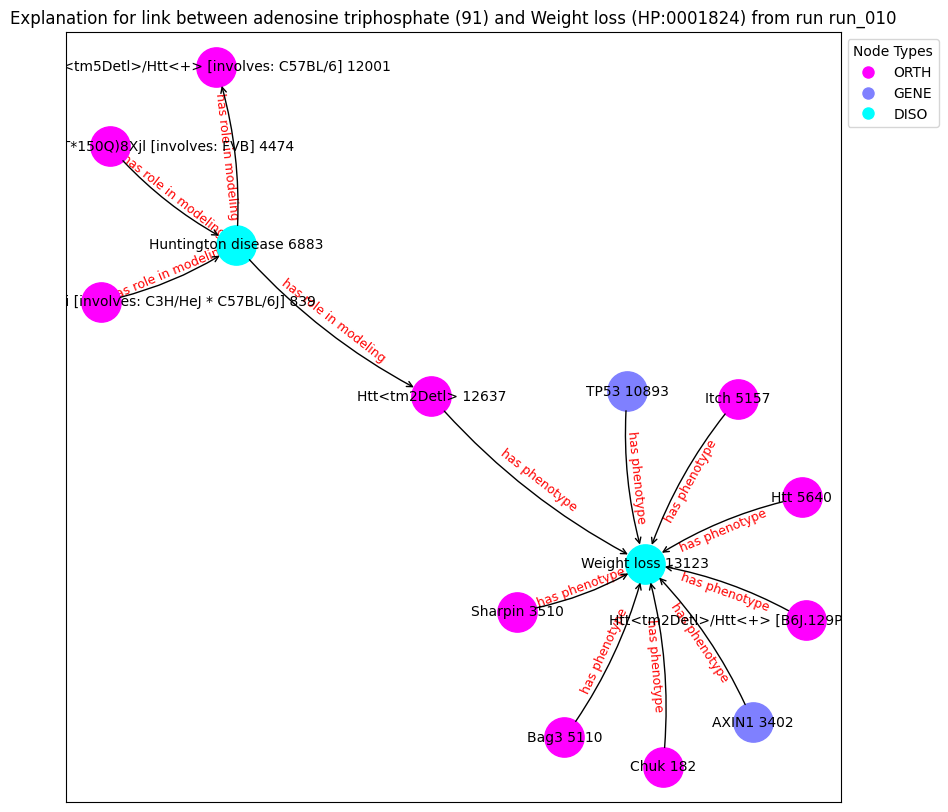

('Chuk 182', {'type': 'ORTH'})
('Tg(Prnp-HTT*82Q)8AGschi [involves: C3H/HeJ * C57BL/6J] 839', {'type': 'ORTH'})
('AXIN1 3402', {'type': 'GENE'})
('Sharpin 3510', {'type': 'ORTH'})
('Tg(Prnp-SNAP25/HTT*150Q)8Xjl [involves: FVB] 4474', {'type': 'ORTH'})
('Bag3 5110', {'type': 'ORTH'})
('Itch 5157', {'type': 'ORTH'})
('Htt 5640', {'type': 'ORTH'})
('Huntington disease 6883', {'type': 'DISO'})
('Htt<tm2Detl>/Htt<+> [B6J.129P2-Htt<tm2Detl>] 9652', {'type': 'ORTH'})
('TP53 10893', {'type': 'GENE'})
('Htt<tm5Detl>/Htt<+> [involves: C57BL/6] 12001', {'type': 'ORTH'})
('Htt<tm2Detl> 12637', {'type': 'ORTH'})
('Weight loss 13123', {'type': 'DISO'})
('Chuk 182', 'Weight loss 13123', {'label': 'has phenotype'})
('Tg(Prnp-HTT*82Q)8AGschi [involves: C3H/HeJ * C57BL/6J] 839', 'Huntington disease 6883', {'label': 'has role in modeling'})
('AXIN1 3402', 'Weight loss 13123', {'label': 'has phenotype'})
('Sharpin 3510', 'Weight loss 13123', {'label': 'has phenotype'})
('Tg(Prnp-SNAP25/HTT*150Q)8Xjl [invo

Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:04<00:00, 141.36it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6114], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:04<00:00, 144.03it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6114], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:04<00:00, 149.33it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6114], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:04<00:00, 152.82it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6114], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:04<00:00, 149.42it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.6114], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:04<00:00, 150.50it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6114], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:04<00:00, 148.11it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6114], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:04<00:00, 147.90it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6114], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:04<00:00, 150.65it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.6114], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13123 and 2596: 100%|██████████| 700/700 [00:04<00:00, 148.72it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


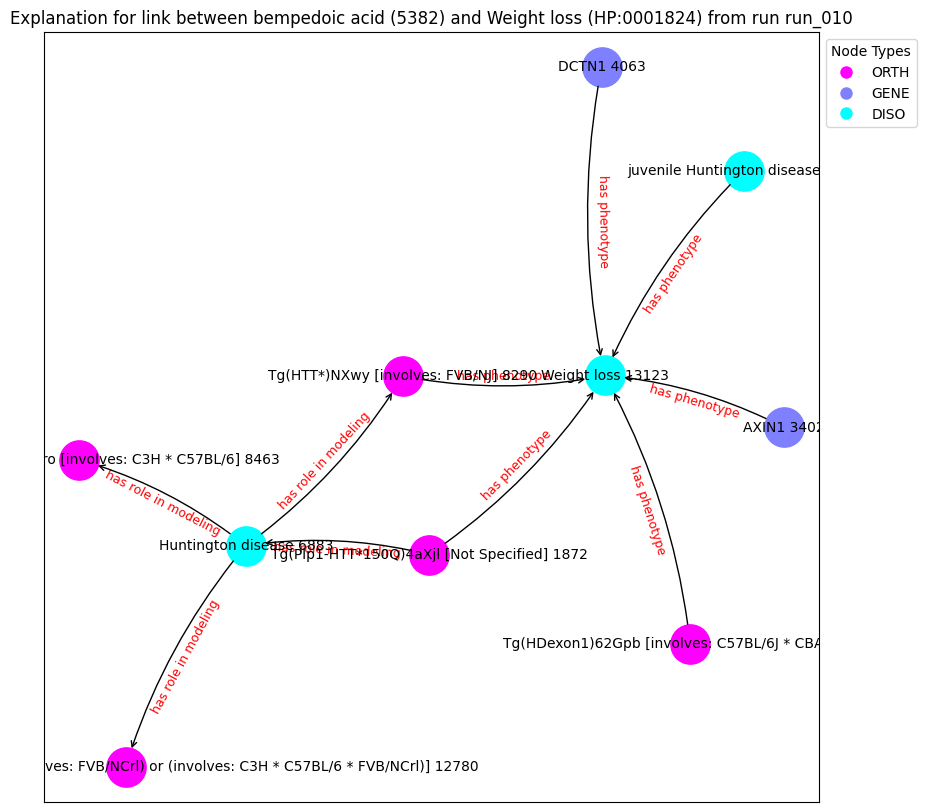

('Tg(Plp1-HTT*150Q)4aXjl [Not Specified] 1872', {'type': 'ORTH'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', {'type': 'ORTH'})
('AXIN1 3402', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('Huntington disease 6883', {'type': 'DISO'})
('Tg(HTT*)NXwy [involves: FVB/NJ] 8290', {'type': 'ORTH'})
('Tg(Prnp-HTT*82Q)52Caro [involves: C3H * C57BL/6] 8463', {'type': 'ORTH'})
('Tg(GFAP-HTT*160Q)31Xjl [either: (involves: FVB/NCrl) or (involves: C3H * C57BL/6 * FVB/NCrl)] 12780', {'type': 'ORTH'})
('Weight loss 13123', {'type': 'DISO'})
('Tg(Plp1-HTT*150Q)4aXjl [Not Specified] 1872', 'Huntington disease 6883', {'label': 'has role in modeling'})
('Tg(Plp1-HTT*150Q)4aXjl [Not Specified] 1872', 'Weight loss 13123', {'label': 'has phenotype'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', 'Weight loss 13123', {'label': 'has phenotype'})
('AXIN1 3402', 'Weight loss 13123', {'label': 'has phenotype'})
('DCTN1 4063', 'Weight

Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:02<00:00, 233.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7456], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:02<00:00, 246.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7456], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:02<00:00, 241.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7456], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7456], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:02<00:00, 254.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7456], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7456], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:02<00:00, 237.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7456], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7456], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:02<00:00, 248.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7456], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 6088 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.69it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                      label  semantic_id
13978     13978  HP:0200136     DISO  Oral-pharyngeal dysphagia            1
node2:
     index_id    id semantic      label  semantic_id
581       581  1140     DRUG  felbamate            2
Prediction from trained model: tensor([0.9455], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13978 and 581: 100%|██████████| 700/700 [00:03<00:00, 218.68it/s]


Contribution threshold is tensor(0.0062)
Explanation found!


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


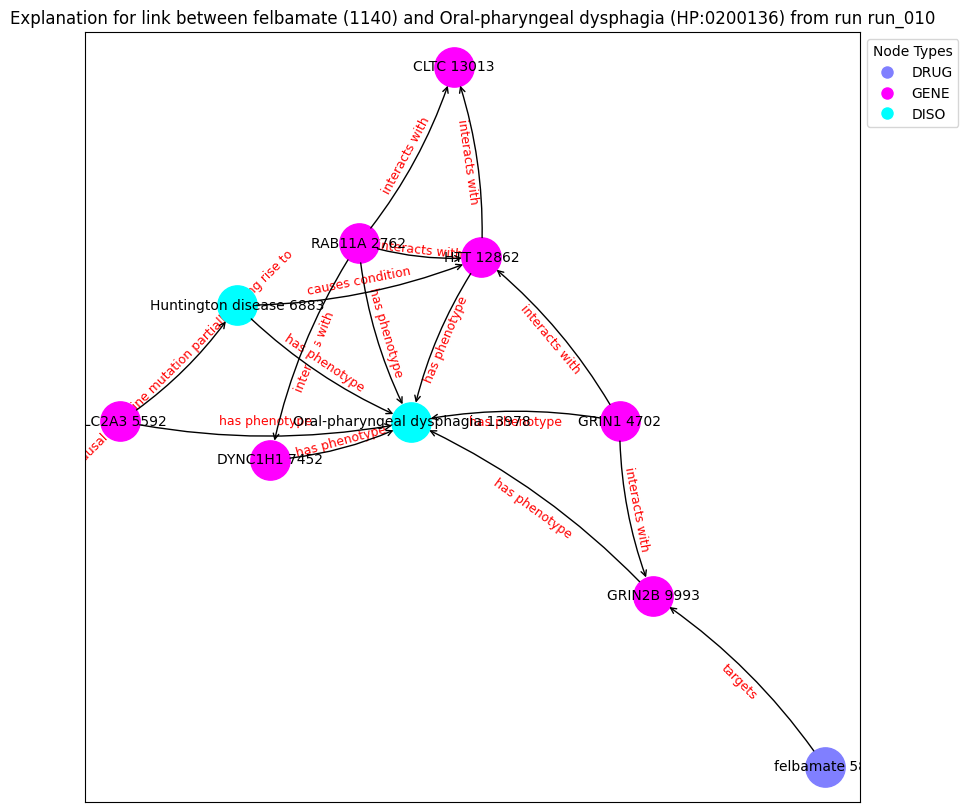

('felbamate 581', {'type': 'DRUG'})
('RAB11A 2762', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DYNC1H1 7452', {'type': 'GENE'})
('GRIN2B 9993', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Oral-pharyngeal dysphagia 13978', {'type': 'DISO'})
('felbamate 581', 'GRIN2B 9993', {'label': 'targets'})
('RAB11A 2762', 'HTT 12862', {'label': 'interacts with'})
('RAB11A 2762', 'CLTC 13013', {'label': 'interacts with'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('GRIN1 4702', 'GRIN2B 9993', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'Oral-pharyngeal dysphagia 13978', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('SLC2A3 5592

Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 208.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2290], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 213.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2290], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 217.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2290], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 218.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2290], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 218.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2290], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 212.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2290], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 212.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2290], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 216.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2290], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 213.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2290], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.05it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic     label  semantic_id
10333     10333  HP:0000726     DISO  Dementia            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([0.1432], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 213.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1432], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 215.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1432], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 216.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1432], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 217.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1432], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 202.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1432], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 215.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1432], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 217.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1432], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 218.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1432], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 214.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1432], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 10333 and 1036: 100%|██████████| 700/700 [00:03<00:00, 213.50it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic    label  semantic_id
8961      8961  HP:0001250     DISO  Seizure            1
node2:
      index_id    id semantic     label  semantic_id
1000      1000  1996     DRUG  orlistat            2
Prediction from trained model: tensor([0.2503], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 153.83it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2503], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 153.06it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2503], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 152.61it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2503], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 144.83it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2503], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 152.94it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2503], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 151.19it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2503], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 155.01it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2503], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 151.95it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2503], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 153.04it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.2503], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 1000: 100%|██████████| 700/700 [00:04<00:00, 155.09it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


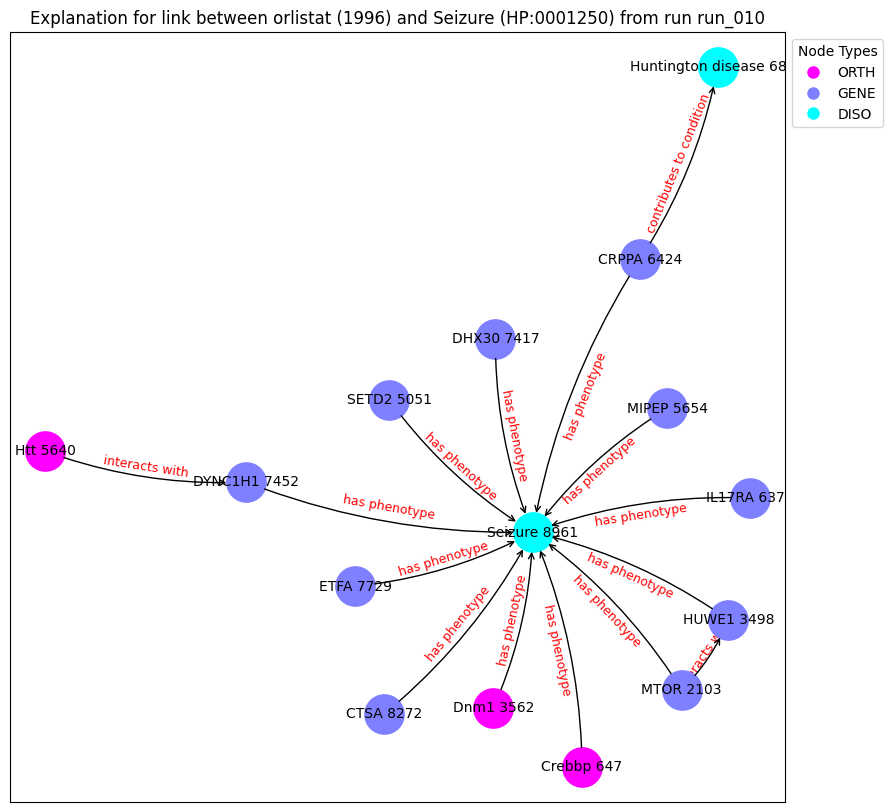

('Crebbp 647', {'type': 'ORTH'})
('MTOR 2103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('Dnm1 3562', {'type': 'ORTH'})
('SETD2 5051', {'type': 'GENE'})
('Htt 5640', {'type': 'ORTH'})
('MIPEP 5654', {'type': 'GENE'})
('IL17RA 6379', {'type': 'GENE'})
('CRPPA 6424', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('CTSA 8272', {'type': 'GENE'})
('Seizure 8961', {'type': 'DISO'})
('Crebbp 647', 'Seizure 8961', {'label': 'has phenotype'})
('MTOR 2103', 'HUWE1 3498', {'label': 'interacts with'})
('MTOR 2103', 'Seizure 8961', {'label': 'has phenotype'})
('HUWE1 3498', 'Seizure 8961', {'label': 'has phenotype'})
('Dnm1 3562', 'Seizure 8961', {'label': 'has phenotype'})
('SETD2 5051', 'Seizure 8961', {'label': 'has phenotype'})
('Htt 5640', 'DYNC1H1 7452', {'label': 'interacts with'})
('MIPEP 5654', 'Seizure 8961', {'label': 'has phenotype'})
('IL17RA 6379', 'Seizure 8

Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 144.50it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1568], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 145.76it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1568], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 149.47it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1568], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 150.26it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1568], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 152.19it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.1568], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 151.43it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1568], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 153.10it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.1568], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 151.94it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1568], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 146.77it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.1568], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8961 and 998: 100%|██████████| 700/700 [00:04<00:00, 142.37it/s]


Contribution threshold is tensor(0.9938)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


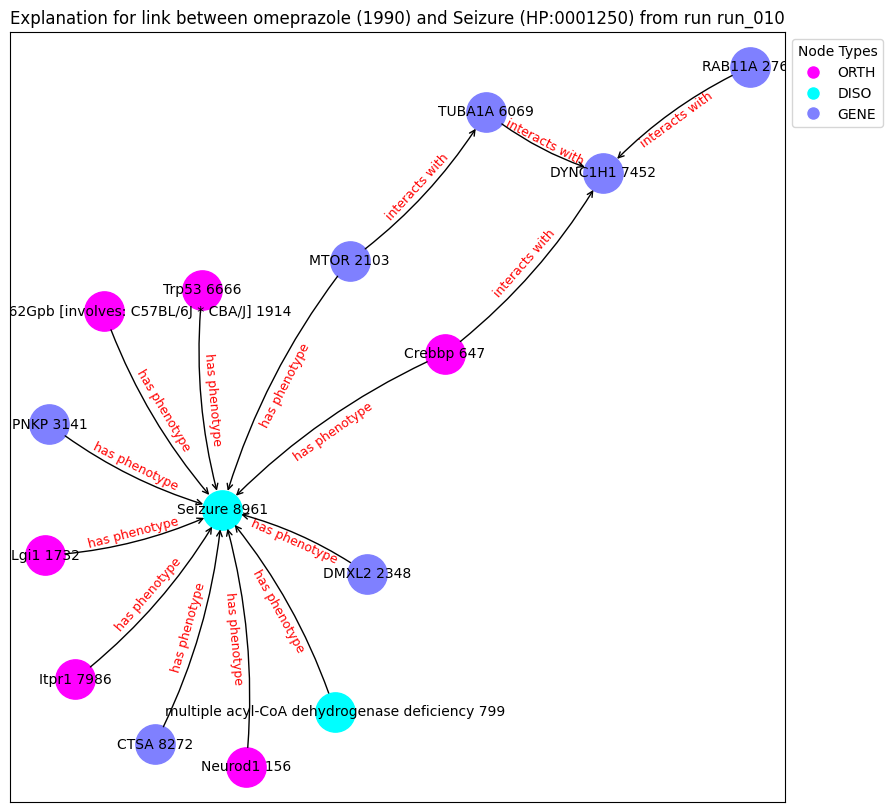

('Neurod1 156', {'type': 'ORTH'})
('Crebbp 647', {'type': 'ORTH'})
('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('Lgi1 1732', {'type': 'ORTH'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', {'type': 'ORTH'})
('MTOR 2103', {'type': 'GENE'})
('DMXL2 2348', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PNKP 3141', {'type': 'GENE'})
('TUBA1A 6069', {'type': 'GENE'})
('Trp53 6666', {'type': 'ORTH'})
('DYNC1H1 7452', {'type': 'GENE'})
('Itpr1 7986', {'type': 'ORTH'})
('CTSA 8272', {'type': 'GENE'})
('Seizure 8961', {'type': 'DISO'})
('Neurod1 156', 'Seizure 8961', {'label': 'has phenotype'})
('Crebbp 647', 'DYNC1H1 7452', {'label': 'interacts with'})
('Crebbp 647', 'Seizure 8961', {'label': 'has phenotype'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'Seizure 8961', {'label': 'has phenotype'})
('Lgi1 1732', 'Seizure 8961', {'label': 'has phenotype'})
('Tg(HDexon1)62Gpb [involves: C57BL/6J * CBA/J] 1914', 'Seizure 8961', {'label': 'has phenotyp

Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 241.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 239.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 236.57it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 254.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 249.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 252.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 250.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 235.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 244.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4827 and 294: 100%|██████████| 700/700 [00:02<00:00, 260.72it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
11896     11896  HP:0000737     DISO  Irritability            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5443], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5443], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 227.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5443], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5443], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 232.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5443], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5443], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:02<00:00, 236.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5443], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 205.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5443], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 223.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5443], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:02<00:00, 237.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5443], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.86it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
11896     11896  HP:0000737     DISO  Irritability            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.0092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:02<00:00, 237.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 232.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 229.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:02<00:00, 239.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:02<00:00, 234.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:03<00:00, 213.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:02<00:00, 235.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:02<00:00, 245.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0092], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 11896 and 1082: 100%|██████████| 700/700 [00:02<00:00, 234.45it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                             label  \
1317      1317  HP:0009088     DISO  Speech articulation difficulties   

      semantic_id  
1317            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.6525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 266.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 246.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 258.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 247.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 257.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 266.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 262.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 260.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.6525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 2585: 100%|██████████| 700/700 [00:02<00:00, 266.02it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                             label  \
1317      1317  HP:0009088     DISO  Speech articulation difficulties   

      semantic_id  
1317            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.3525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 261.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 262.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 247.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:03<00:00, 195.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 249.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 263.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 261.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 252.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3525], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1317 and 294: 100%|██████████| 700/700 [00:02<00:00, 261.00it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
4154      4154  HP:0000746     DISO  Delusions            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.0814], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 250.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0814], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 250.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0814], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 266.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0814], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0814], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 257.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0814], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:03<00:00, 217.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0814], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0814], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 255.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0814], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 250.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0814], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 2585: 100%|██████████| 700/700 [00:02<00:00, 250.40it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic      label  semantic_id
4154      4154  HP:0000746     DISO  Delusions            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.1514], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 247.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1514], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 255.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1514], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 248.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1514], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 269.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1514], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 250.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1514], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 259.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1514], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 247.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1514], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1514], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 261.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1514], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4154 and 294: 100%|██████████| 700/700 [00:02<00:00, 265.36it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                         label  \
12562     12562  HP:0001262     DISO  Excessive daytime somnolence   

       semantic_id  
12562            1  
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.0213], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0213], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:02<00:00, 235.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0213], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:02<00:00, 235.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0213], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:02<00:00, 240.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0213], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:02<00:00, 246.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0213], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 227.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0213], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 231.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0213], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:02<00:00, 239.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0213], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:03<00:00, 228.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0213], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 1082: 100%|██████████| 700/700 [00:02<00:00, 239.59it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                         label  \
12562     12562  HP:0001262     DISO  Excessive daytime somnolence   

       semantic_id  
12562            1  
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.1072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:02<00:00, 235.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 231.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 215.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 230.40it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:02<00:00, 237.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:03<00:00, 224.39it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1072], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12562 and 998: 100%|██████████| 700/700 [00:02<00:00, 234.96it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic   label  semantic_id
8154      8154  HP:0000741     DISO  Apathy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.3127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 228.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 223.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 215.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 222.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 217.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 219.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 221.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 216.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3127], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8154 and 998: 100%|██████████| 700/700 [00:03<00:00, 217.29it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic   label  semantic_id
9999      9999  HP:0002169     DISO  Clonus            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.0034], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:02<00:00, 233.90it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0034], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:02<00:00, 246.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0034], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:02<00:00, 235.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0034], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:02<00:00, 238.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0034], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0034], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:02<00:00, 251.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0034], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:02<00:00, 233.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0034], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:02<00:00, 235.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0034], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:02<00:00, 239.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0034], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9999 and 1082: 100%|██████████| 700/700 [00:02<00:00, 233.61it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic  \
9644      9644  HP:0010794     DISO   

                                             label  semantic_id  
9644  Impaired visuospatial constructive cognition            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.4478], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:02<00:00, 235.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4478], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:02<00:00, 250.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4478], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:02<00:00, 238.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4478], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4478], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 227.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4478], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:02<00:00, 252.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4478], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4478], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:03<00:00, 229.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4478], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:02<00:00, 247.19it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4478], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.88it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic  \
9644      9644  HP:0010794     DISO   

                                             label  semantic_id  
9644  Impaired visuospatial constructive cognition            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5288], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5288], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:02<00:00, 259.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5288], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:02<00:00, 236.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5288], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:02<00:00, 245.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5288], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 226.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5288], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:02<00:00, 239.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5288], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:02<00:00, 247.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5288], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5288], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5288], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9644 and 294: 100%|██████████| 700/700 [00:03<00:00, 222.78it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic              label  semantic_id
14773     14773  HP:0002540     DISO  Inability to walk            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.1039], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 212.17it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1039], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 199.66it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1039], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.10it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1039], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.60it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1039], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.36it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1039], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 198.34it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1039], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 198.55it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1039], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.73it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1039], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.71it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1039], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 998: 100%|██████████| 700/700 [00:03<00:00, 206.44it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


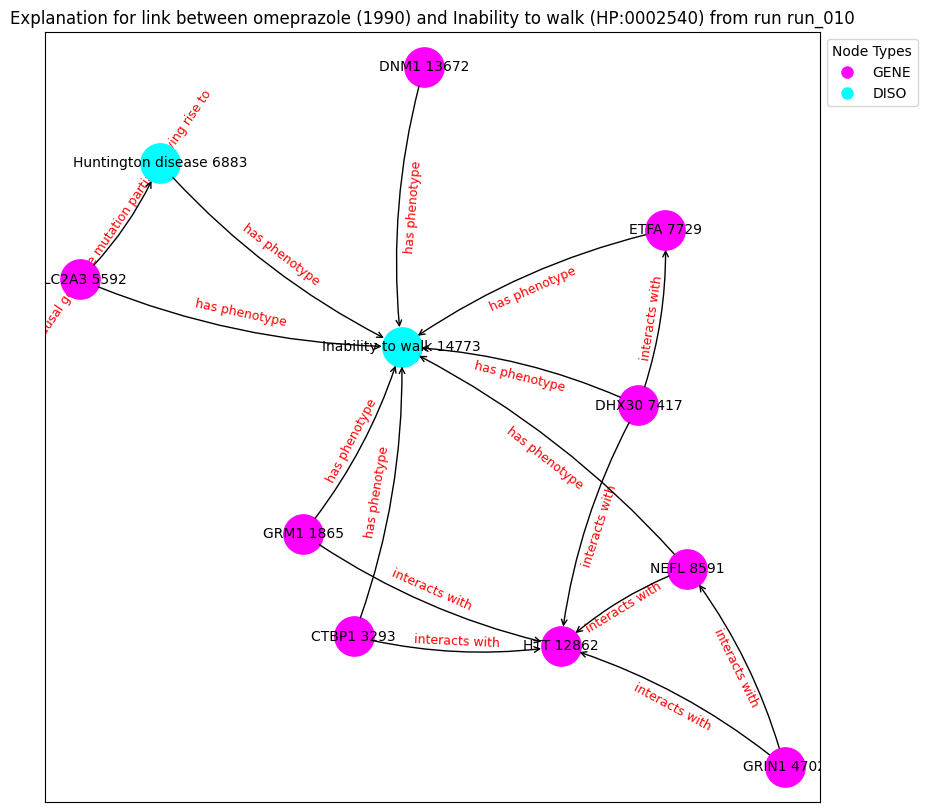

('GRM1 1865', {'type': 'GENE'})
('CTBP1 3293', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('DNM1 13672', {'type': 'GENE'})
('Inability to walk 14773', {'type': 'DISO'})
('GRM1 1865', 'HTT 12862', {'label': 'interacts with'})
('GRM1 1865', 'Inability to walk 14773', {'label': 'has phenotype'})
('CTBP1 3293', 'HTT 12862', {'label': 'interacts with'})
('CTBP1 3293', 'Inability to walk 14773', {'label': 'has phenotype'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'NEFL 8591', {'label': 'interacts with'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('SLC2A3 5592', 'Inability to walk 14773', {'label': 'has phenotype'})
('Huntington disease 6883', 'Inability to walk 14773', {'label': 'h

Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.86it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 191.27it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 200.89it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 207.95it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.1053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 205.50it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 208.67it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 208.56it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 208.33it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 204.59it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.1053], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14773 and 1036: 100%|██████████| 700/700 [00:03<00:00, 207.53it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


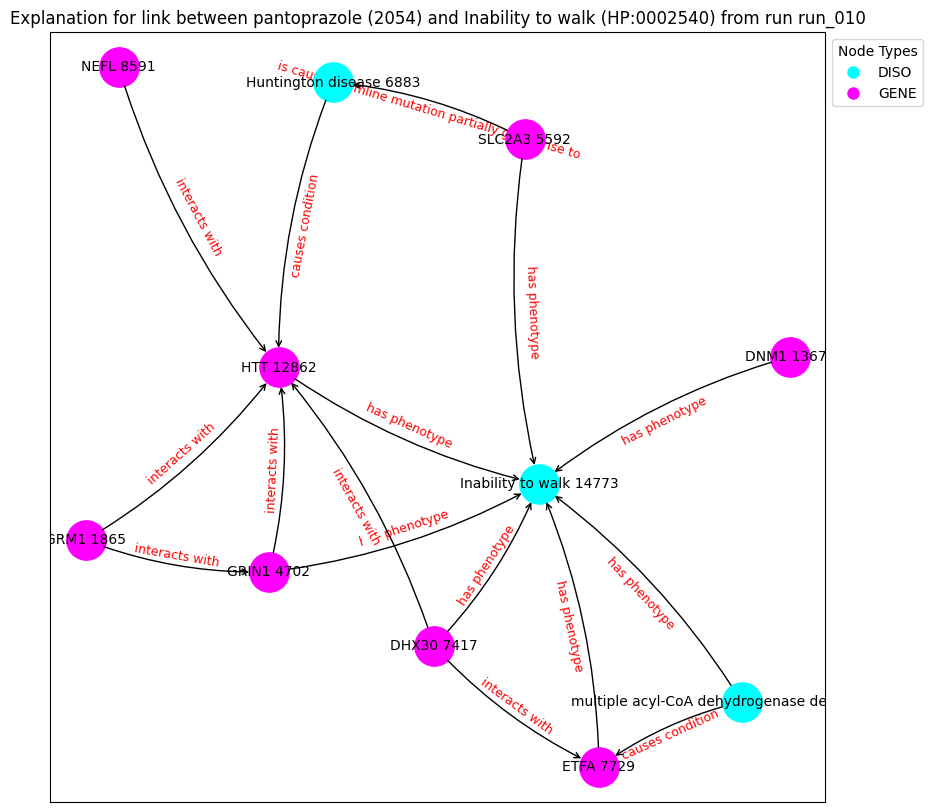

('multiple acyl-CoA dehydrogenase deficiency 799', {'type': 'DISO'})
('GRM1 1865', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('ETFA 7729', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('DNM1 13672', {'type': 'GENE'})
('Inability to walk 14773', {'type': 'DISO'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'Inability to walk 14773', {'label': 'has phenotype'})
('multiple acyl-CoA dehydrogenase deficiency 799', 'ETFA 7729', {'label': 'causes condition'})
('GRM1 1865', 'HTT 12862', {'label': 'interacts with'})
('GRM1 1865', 'GRIN1 4702', {'label': 'interacts with'})
('GRIN1 4702', 'HTT 12862', {'label': 'interacts with'})
('GRIN1 4702', 'Inability to walk 14773', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('SLC2A3 5592', 'Inability 

Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:03<00:00, 233.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4985], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4985], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 265.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4985], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 268.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4985], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 244.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4985], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 256.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4985], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 258.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4985], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:03<00:00, 221.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4985], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 262.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4985], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 2585: 100%|██████████| 700/700 [00:02<00:00, 250.88it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                      label  semantic_id
3165      3165  HP:0045082     DISO  Decreased body mass index            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.7793], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 252.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7793], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 254.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7793], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 263.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7793], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 272.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7793], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 261.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7793], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 265.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7793], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 259.72it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7793], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 264.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7793], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 255.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7793], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 3165 and 294: 100%|██████████| 700/700 [00:02<00:00, 261.98it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                    label  \
917       917  HP:0002529     DISO  Neuronal loss in central nervous system   

     semantic_id  
917            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.9915], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 266.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9915], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 250.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9915], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 261.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9915], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 267.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9915], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 261.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9915], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 273.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9915], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 258.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9915], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 265.68it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9915], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 272.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9915], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 2585: 100%|██████████| 700/700 [00:02<00:00, 259.61it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                    label  \
917       917  HP:0002529     DISO  Neuronal loss in central nervous system   

     semantic_id  
917            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.9925], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 260.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9925], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 250.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9925], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 262.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9925], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 247.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9925], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 271.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9925], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 265.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9925], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 259.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9925], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 256.31it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9925], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 260.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.9925], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 917 and 294: 100%|██████████| 700/700 [00:02<00:00, 256.88it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 262.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 241.77it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 261.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 269.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 266.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 257.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 266.58it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 272.65it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 261.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 998: 100%|██████████| 700/700 [00:02<00:00, 257.00it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 266.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 239.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 262.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 269.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 248.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 269.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 247.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 264.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 276.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1036: 100%|██████████| 700/700 [00:02<00:00, 273.94it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic               label  semantic_id
2520      2520  HP:0002355     DISO  Difficulty walking            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 263.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 245.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 261.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 256.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 269.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 268.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 256.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 267.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 262.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 2520 and 1082: 100%|██████████| 700/700 [00:02<00:00, 271.62it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                         label  semantic_id
9801      9801  HP:0007010     DISO  Poor fine motor coordination            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.4170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:02<00:00, 243.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 220.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:03<00:00, 229.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.69it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:02<00:00, 243.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:02<00:00, 240.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:02<00:00, 243.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:02<00:00, 248.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4170], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 9801 and 2585: 100%|██████████| 700/700 [00:02<00:00, 242.58it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic       label  semantic_id
14527     14527  HP:0030955     DISO  Alcoholism            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.7033], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7033], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:03<00:00, 229.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7033], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:02<00:00, 250.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7033], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:02<00:00, 237.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7033], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7033], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:02<00:00, 247.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7033], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:02<00:00, 236.91it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7033], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:02<00:00, 239.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7033], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:02<00:00, 243.66it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7033], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 2585: 100%|██████████| 700/700 [00:02<00:00, 252.09it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic       label  semantic_id
14527     14527  HP:0030955     DISO  Alcoholism            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5752], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:02<00:00, 245.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5752], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5752], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:02<00:00, 234.46it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5752], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:02<00:00, 247.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5752], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:02<00:00, 237.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5752], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5752], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:02<00:00, 242.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5752], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5752], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:02<00:00, 233.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5752], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 14527 and 294: 100%|██████████| 700/700 [00:02<00:00, 245.82it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic             label  semantic_id
8158      8158  HP:0002059     DISO  Cerebral atrophy            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.5303], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 199.31it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5303], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 210.98it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5303], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 209.95it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5303], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 207.73it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5303], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 210.75it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5303], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 209.17it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5303], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 212.12it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5303], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 209.78it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5303], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 209.45it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5303], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 998: 100%|██████████| 700/700 [00:03<00:00, 204.85it/s]


Contribution threshold is tensor(0.0061)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


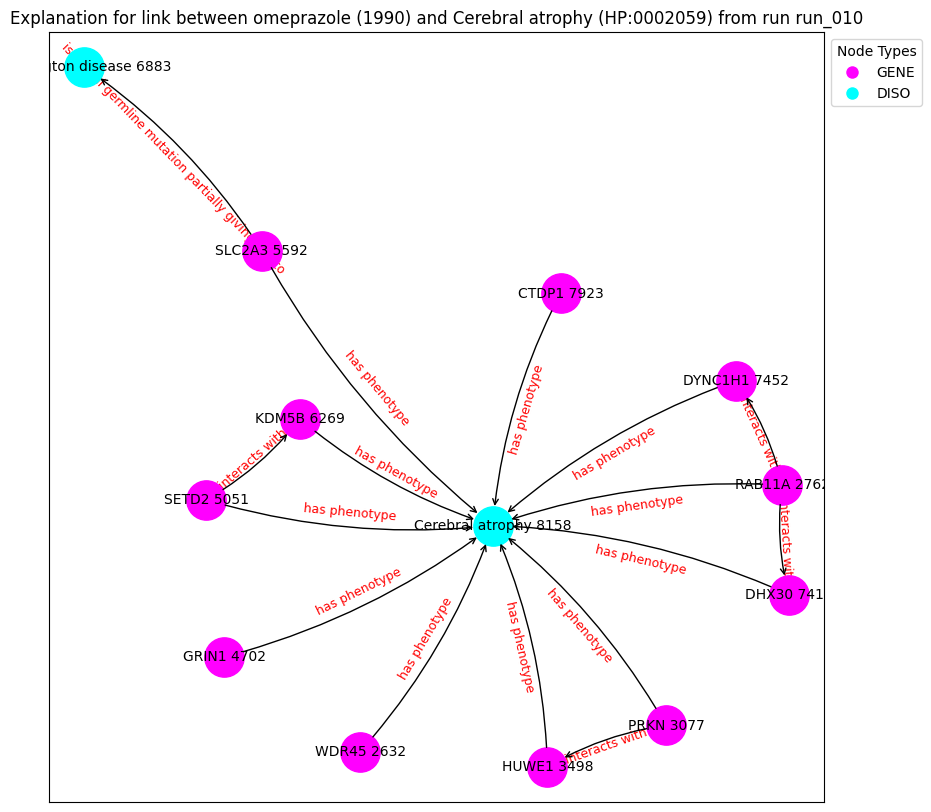

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('Cerebral atrophy 8158', {'type': 'DISO'})
('WDR45 2632', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('HUWE1 3498', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('GRIN1 4702', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('SETD2 5051', 'KDM5B 6269'

Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.56it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5892], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 196.37it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5892], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 199.84it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5892], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 210.38it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5892], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 200.20it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5892], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 204.38it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5892], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 200.76it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.5892], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 199.36it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.5892], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 183.21it/s]


Contribution threshold is tensor(0.0061)
Prediction from trained model: tensor([0.5892], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 8158 and 1036: 100%|██████████| 700/700 [00:03<00:00, 203.91it/s]


Contribution threshold is tensor(0.0062)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


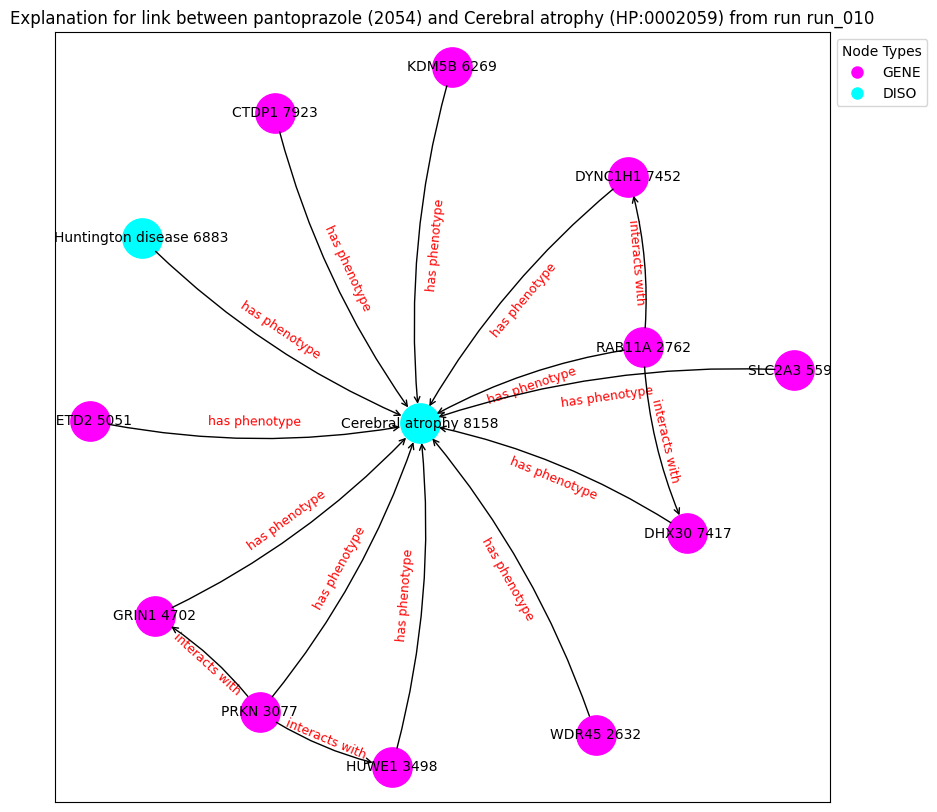

('WDR45 2632', {'type': 'GENE'})
('RAB11A 2762', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('GRIN1 4702', {'type': 'GENE'})
('SETD2 5051', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('KDM5B 6269', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('DHX30 7417', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('Cerebral atrophy 8158', {'type': 'DISO'})
('WDR45 2632', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DYNC1H1 7452', {'label': 'interacts with'})
('RAB11A 2762', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('RAB11A 2762', 'DHX30 7417', {'label': 'interacts with'})
('PRKN 3077', 'HUWE1 3498', {'label': 'interacts with'})
('PRKN 3077', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('PRKN 3077', 'GRIN1 4702', {'label': 'interacts with'})
('HUWE1 3498', 'Cerebral atrophy 8158', {'label': 'has phenotype'})
('GRIN1 4702', 'Cerebral atrophy 8158'

Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:03<00:00, 176.06it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 167.23it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:03<00:00, 185.56it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.47it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:03<00:00, 177.36it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.34it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:04<00:00, 172.45it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:03<00:00, 179.50it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:03<00:00, 180.11it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.3957], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.87it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


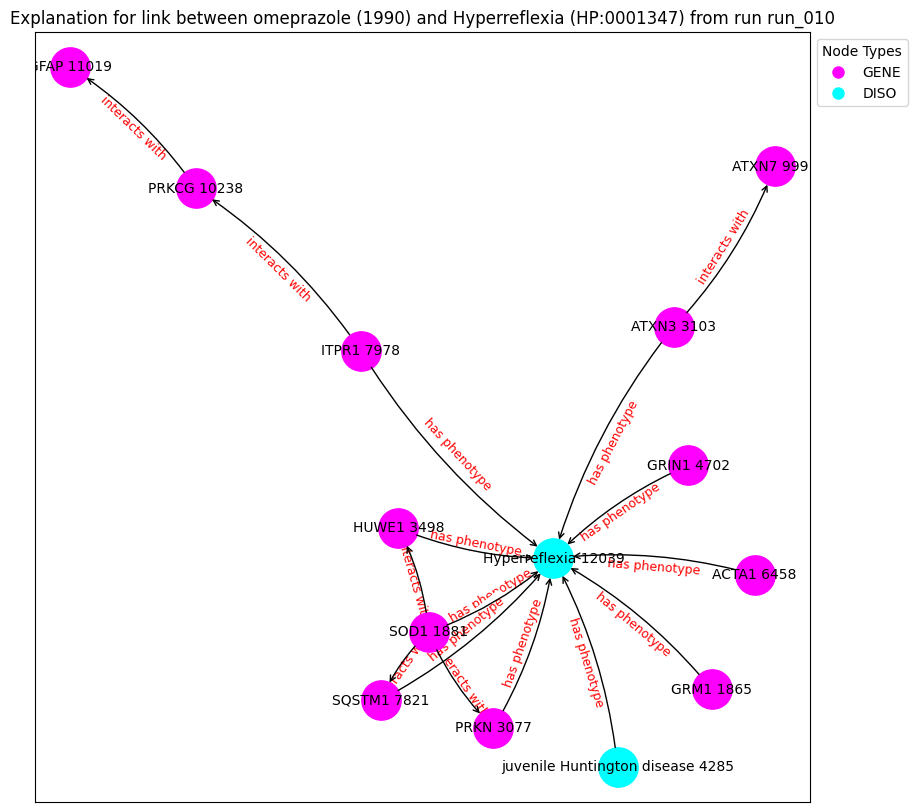

('GRM1 1865', {'type': 'GENE'})
('SOD1 1881', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('GRIN1 4702', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('ITPR1 7978', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('GRM1 1865', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('SOD1 1881', 'HUWE1 3498', {'label': 'interacts with'})
('SOD1 1881', 'PRKN 3077', {'label': 'interacts with'})
('SOD1 1881', 'SQSTM1 7821', {'label': 'interacts with'})
('SOD1 1881', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('PRKN 3077', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('ATXN3 3103', 'ATXN7 9991', {'label': 'interacts with'})
('ATXN3 3103', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('HUWE1 3498', 'Hy

Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 173.57it/s]


Contribution threshold is tensor(0.9938)
Prediction from trained model: tensor([0.4803], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:04<00:00, 172.56it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4803], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:03<00:00, 184.78it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4803], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:03<00:00, 181.77it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4803], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:03<00:00, 185.70it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4803], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:03<00:00, 178.65it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4803], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.85it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4803], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:03<00:00, 178.17it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.4803], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:03<00:00, 184.13it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4803], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12039 and 1036: 100%|██████████| 700/700 [00:03<00:00, 180.89it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


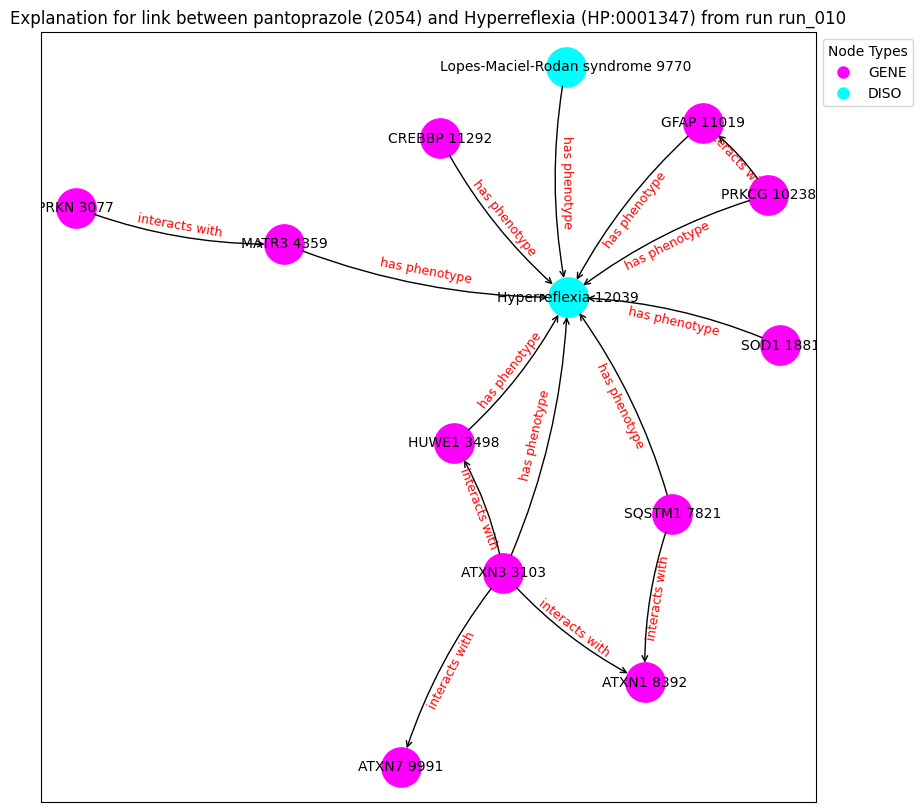

('SOD1 1881', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('HUWE1 3498', {'type': 'GENE'})
('MATR3 4359', {'type': 'GENE'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('Lopes-Maciel-Rodan syndrome 9770', {'type': 'DISO'})
('ATXN7 9991', {'type': 'GENE'})
('PRKCG 10238', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('CREBBP 11292', {'type': 'GENE'})
('Hyperreflexia 12039', {'type': 'DISO'})
('SOD1 1881', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('PRKN 3077', 'MATR3 4359', {'label': 'interacts with'})
('ATXN3 3103', 'HUWE1 3498', {'label': 'interacts with'})
('ATXN3 3103', 'ATXN7 9991', {'label': 'interacts with'})
('ATXN3 3103', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('ATXN3 3103', 'ATXN1 8392', {'label': 'interacts with'})
('HUWE1 3498', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('MATR3 4359', 'Hyperreflexia 12039', {'label': 'has phenotype'})
('SQSTM1 7821', 'Hyperreflexia 12039', {'lab

Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0031], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 224.11it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0031], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 229.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0031], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0031], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 230.53it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0031], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:02<00:00, 246.05it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0031], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:02<00:00, 240.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0031], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 229.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0031], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:02<00:00, 241.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0031], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 1082: 100%|██████████| 700/700 [00:03<00:00, 232.78it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic                              label  \
12080     12080  HP:0004408     DISO  Abnormality of the sense of smell   

       semantic_id  
12080            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.2362], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.63it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2362], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:02<00:00, 246.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2362], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:02<00:00, 251.17it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2362], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2362], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2362], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:02<00:00, 253.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2362], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:02<00:00, 237.43it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2362], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:03<00:00, 231.84it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2362], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:02<00:00, 243.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.2362], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12080 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.74it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic   label  semantic_id
12647     12647  HP:0002300     DISO  Mutism            1
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([0.1758], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 215.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1758], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 223.20it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1758], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 209.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1758], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 209.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1758], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.70it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1758], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1758], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 227.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1758], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 213.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1758], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 219.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1758], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 12647 and 1082: 100%|██████████| 700/700 [00:03<00:00, 226.44it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
1369      1369  HP:0000751     DISO  Personality changes            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.3385], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 262.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3385], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 252.96it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3385], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 248.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3385], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 259.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3385], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 262.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3385], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 256.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3385], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 253.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3385], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 264.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3385], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 261.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3385], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 2585: 100%|██████████| 700/700 [00:02<00:00, 267.00it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                label  semantic_id
1369      1369  HP:0000751     DISO  Personality changes            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5921], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 240.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5921], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 266.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5921], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 244.04it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5921], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 272.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5921], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 249.56it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5921], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 261.88it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5921], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 239.42it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5921], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 253.03it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5921], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 263.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5921], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1369 and 294: 100%|██████████| 700/700 [00:02<00:00, 252.27it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic     label  semantic_id
13477     13477  HP:0002063     DISO  Rigidity            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.4007], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 198.54it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4007], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 215.60it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4007], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 190.49it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.4007], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 204.70it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4007], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 206.45it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4007], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.73it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4007], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 202.30it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4007], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 205.64it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4007], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 201.26it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4007], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 998: 100%|██████████| 700/700 [00:03<00:00, 203.04it/s]


Contribution threshold is tensor(0.0063)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


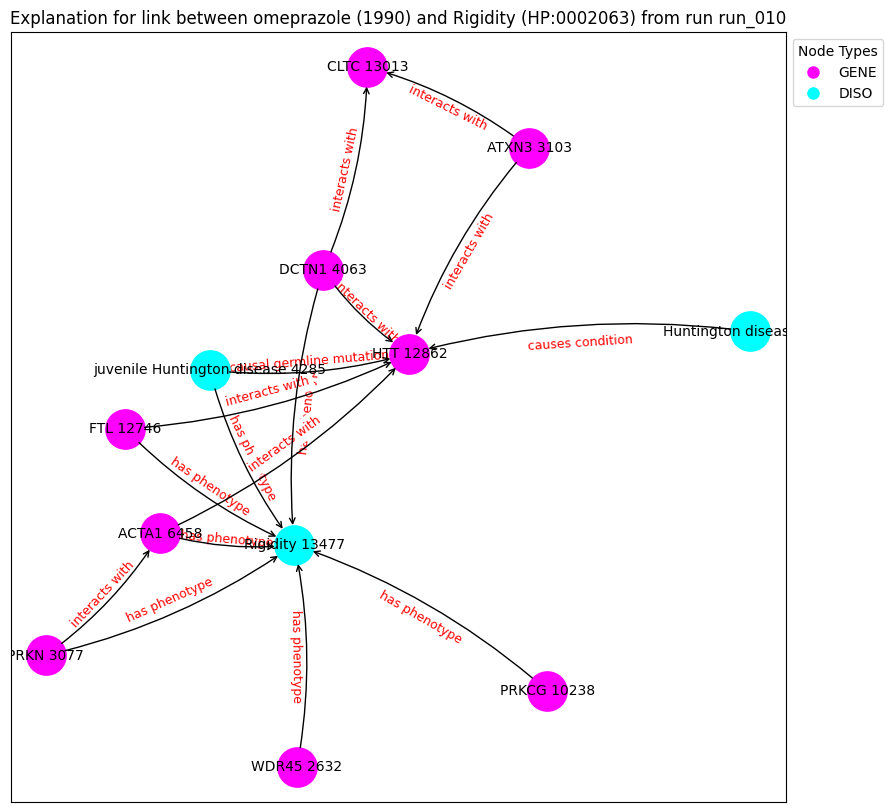

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('PRKCG 10238', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Rigidity 13477', {'type': 'DISO'})
('WDR45 2632', 'Rigidity 13477', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'Rigidity 13477', {'label': 'has phenotype'})
('ATXN3 3103', 'HTT 12862', {'label': 'interacts with'})
('ATXN3 3103', 'CLTC 13013', {'label': 'interacts with'})
('DCTN1 4063', 'HTT 12862', {'label': 'interacts with'})
('DCTN1 4063', 'CLTC 13013', {'label': 'interacts with'})
('DCTN1 4063', 'Rigidity 13477', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'HTT 12862', {'label': 'is causal germline mutation in'})
('j

Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 182.02it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.4379], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.48it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4379], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 192.96it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.4379], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.80it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.4379], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 199.77it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.4379], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 190.97it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.4379], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 194.42it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.4379], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.69it/s]


Contribution threshold is tensor(0.0063)
Prediction from trained model: tensor([0.4379], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 195.86it/s]


Contribution threshold is tensor(0.0062)
Prediction from trained model: tensor([0.4379], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13477 and 1036: 100%|██████████| 700/700 [00:03<00:00, 179.94it/s]


Contribution threshold is tensor(0.0062)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


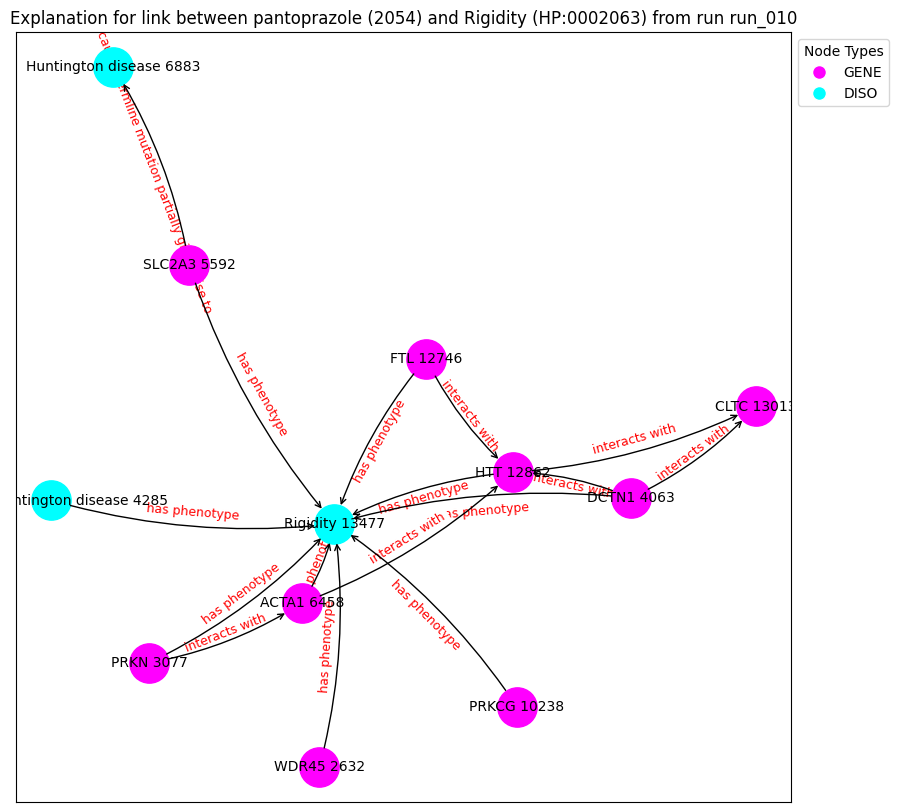

('WDR45 2632', {'type': 'GENE'})
('PRKN 3077', {'type': 'GENE'})
('DCTN1 4063', {'type': 'GENE'})
('juvenile Huntington disease 4285', {'type': 'DISO'})
('SLC2A3 5592', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('PRKCG 10238', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('CLTC 13013', {'type': 'GENE'})
('Rigidity 13477', {'type': 'DISO'})
('WDR45 2632', 'Rigidity 13477', {'label': 'has phenotype'})
('PRKN 3077', 'ACTA1 6458', {'label': 'interacts with'})
('PRKN 3077', 'Rigidity 13477', {'label': 'has phenotype'})
('DCTN1 4063', 'HTT 12862', {'label': 'interacts with'})
('DCTN1 4063', 'CLTC 13013', {'label': 'interacts with'})
('DCTN1 4063', 'Rigidity 13477', {'label': 'has phenotype'})
('juvenile Huntington disease 4285', 'Rigidity 13477', {'label': 'has phenotype'})
('SLC2A3 5592', 'Rigidity 13477', {'label': 'has phenotype'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal ger

Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 242.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 233.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 260.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 259.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 257.97it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 249.09it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 267.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 264.54it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 262.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 998: 100%|██████████| 700/700 [00:02<00:00, 243.79it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                      label  \
434       434  HP:0002500     DISO  Abnormal cerebral white matter morphology   

     semantic_id  
434            1  
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 260.18it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 252.13it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 247.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 254.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 262.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 255.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 257.59it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 246.99it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 273.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1036: 100%|██████████| 700/700 [00:02<00:00, 246.79it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic                                      label  \
434       434  HP:0002500     DISO  Abnormal cerebral white matter morphology   

     semantic_id  
434            1  
node2:
      index_id    id semantic       label  semantic_id
1082      1082  2123     DRUG  phenelzine            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 257.30it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 255.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 257.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 250.89it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 267.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 252.51it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 246.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 256.61it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 251.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 434 and 1082: 100%|██████████| 700/700 [00:02<00:00, 241.86it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic          label  semantic_id
13239     13239  HP:0003487     DISO  Babinski sign            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.1425], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 186.24it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1425], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 191.75it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1425], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.49it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1425], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 188.38it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.1425], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 193.00it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.1425], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 183.84it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1425], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 184.32it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1425], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 192.00it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.1425], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 178.04it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.1425], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 998: 100%|██████████| 700/700 [00:03<00:00, 182.74it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


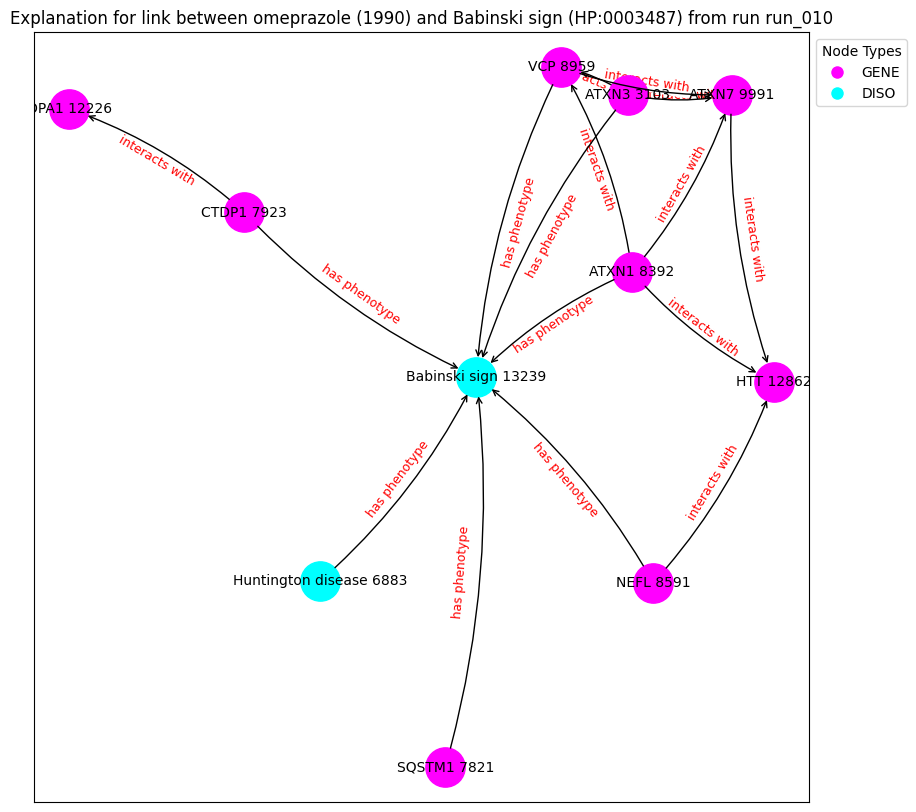

('ATXN3 3103', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('CTDP1 7923', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('OPA1 12226', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Babinski sign 13239', {'type': 'DISO'})
('ATXN3 3103', 'VCP 8959', {'label': 'interacts with'})
('ATXN3 3103', 'ATXN7 9991', {'label': 'interacts with'})
('ATXN3 3103', 'Babinski sign 13239', {'label': 'has phenotype'})
('Huntington disease 6883', 'Babinski sign 13239', {'label': 'has phenotype'})
('SQSTM1 7821', 'Babinski sign 13239', {'label': 'has phenotype'})
('CTDP1 7923', 'OPA1 12226', {'label': 'interacts with'})
('CTDP1 7923', 'Babinski sign 13239', {'label': 'has phenotype'})
('ATXN1 8392', 'HTT 12862', {'label': 'interacts with'})
('ATXN1 8392', 'VCP 8959', {'label': 'interacts with'})
('ATXN1 8392', 'ATXN7 9991', {'label': 'interacts with'

Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 180.24it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.0893], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 180.18it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.0893], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.55it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.0893], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 183.78it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.0893], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.80it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.0893], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 187.98it/s]


Contribution threshold is tensor(0.9936)
Prediction from trained model: tensor([0.0893], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:04<00:00, 172.94it/s]


Contribution threshold is tensor(0.0064)
Prediction from trained model: tensor([0.0893], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 186.89it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.0893], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 189.24it/s]


Contribution threshold is tensor(0.9937)
Prediction from trained model: tensor([0.0893], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13239 and 1036: 100%|██████████| 700/700 [00:03<00:00, 193.87it/s]


Contribution threshold is tensor(0.9937)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


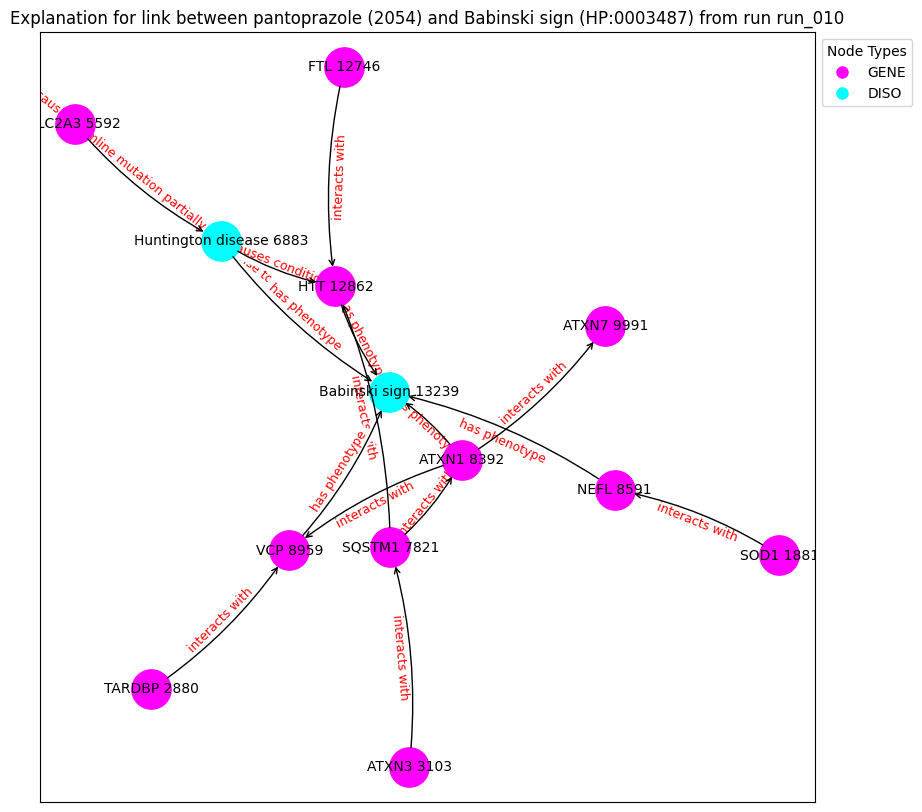

('SOD1 1881', {'type': 'GENE'})
('TARDBP 2880', {'type': 'GENE'})
('ATXN3 3103', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('Huntington disease 6883', {'type': 'DISO'})
('SQSTM1 7821', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('ATXN7 9991', {'type': 'GENE'})
('FTL 12746', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('Babinski sign 13239', {'type': 'DISO'})
('SOD1 1881', 'NEFL 8591', {'label': 'interacts with'})
('TARDBP 2880', 'VCP 8959', {'label': 'interacts with'})
('ATXN3 3103', 'SQSTM1 7821', {'label': 'interacts with'})
('SLC2A3 5592', 'Huntington disease 6883', {'label': 'is causal germline mutation partially giving rise to'})
('Huntington disease 6883', 'HTT 12862', {'label': 'causes condition'})
('Huntington disease 6883', 'Babinski sign 13239', {'label': 'has phenotype'})
('SQSTM1 7821', 'HTT 12862', {'label': 'interacts with'})
('SQSTM1 7821', 'ATXN1 8392', {'label': 'interacts with'})
('

Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 223.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:03<00:00, 224.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:02<00:00, 249.26it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.16it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:02<00:00, 243.49it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:02<00:00, 245.29it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:02<00:00, 251.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7149], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 2585: 100%|██████████| 700/700 [00:02<00:00, 234.89it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic         label  semantic_id
13783     13783  HP:0031843     DISO  Bradyphrenia            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.5803], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 232.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5803], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 229.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5803], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:02<00:00, 236.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5803], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:03<00:00, 224.71it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5803], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:02<00:00, 247.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5803], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:02<00:00, 233.80it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5803], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:02<00:00, 245.92it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5803], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:02<00:00, 244.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5803], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:02<00:00, 238.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.5803], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13783 and 294: 100%|██████████| 700/700 [00:02<00:00, 245.51it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
     index_id          id semantic            label  semantic_id
830       830  HP:0002340     DISO  Caudate atrophy            1
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.3701], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 272.14it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3701], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 251.95it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3701], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 268.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3701], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 261.37it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3701], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 255.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3701], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 262.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3701], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 259.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3701], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 260.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3701], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 260.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.3701], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 830 and 2585: 100%|██████████| 700/700 [00:02<00:00, 262.12it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
       index_id          id semantic             label  semantic_id
13592     13592  HP:0001288     DISO  Gait disturbance            1
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.4932], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 139.72it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4932], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 138.94it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4932], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 135.68it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4932], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 133.98it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4932], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 135.90it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4932], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 138.90it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4932], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 139.35it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4932], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 138.74it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4932], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 135.93it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.4932], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 294: 100%|██████████| 700/700 [00:05<00:00, 136.87it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


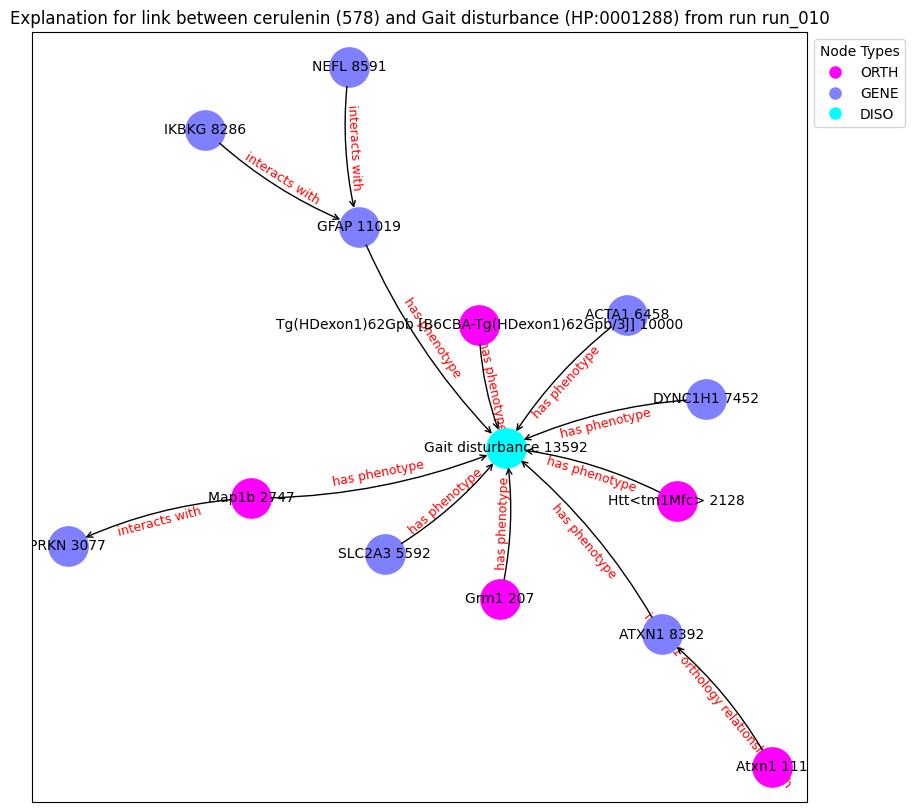

('Atxn1 111', {'type': 'ORTH'})
('Grm1 207', {'type': 'ORTH'})
('Htt<tm1Mfc> 2128', {'type': 'ORTH'})
('Map1b 2747', {'type': 'ORTH'})
('PRKN 3077', {'type': 'GENE'})
('SLC2A3 5592', {'type': 'GENE'})
('ACTA1 6458', {'type': 'GENE'})
('DYNC1H1 7452', {'type': 'GENE'})
('IKBKG 8286', {'type': 'GENE'})
('ATXN1 8392', {'type': 'GENE'})
('NEFL 8591', {'type': 'GENE'})
('Tg(HDexon1)62Gpb [B6CBA-Tg(HDexon1)62Gpb/3J] 10000', {'type': 'ORTH'})
('GFAP 11019', {'type': 'GENE'})
('Gait disturbance 13592', {'type': 'DISO'})
('Atxn1 111', 'ATXN1 8392', {'label': 'in 1 to 1 orthology relationship with'})
('Grm1 207', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Htt<tm1Mfc> 2128', 'Gait disturbance 13592', {'label': 'has phenotype'})
('Map1b 2747', 'PRKN 3077', {'label': 'interacts with'})
('Map1b 2747', 'Gait disturbance 13592', {'label': 'has phenotype'})
('SLC2A3 5592', 'Gait disturbance 13592', {'label': 'has phenotype'})
('ACTA1 6458', 'Gait disturbance 13592', {'label': 'has phenotyp

Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 125.22it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.2159], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 133.10it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.2159], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 134.87it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.2159], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 136.06it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.2159], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 136.74it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.2159], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 137.23it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.2159], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 136.15it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.2159], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 136.57it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.2159], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 137.08it/s]


Contribution threshold is tensor(0.9939)
Prediction from trained model: tensor([0.2159], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 13592 and 53: 100%|██████████| 700/700 [00:05<00:00, 135.27it/s]


Contribution threshold is tensor(0.9939)
No good explanation found after 10 iterations


c:\Users\rosa-\anaconda3\envs\xaifo\lib\site-packages\networkx\drawing\nx_pylab.py:433: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


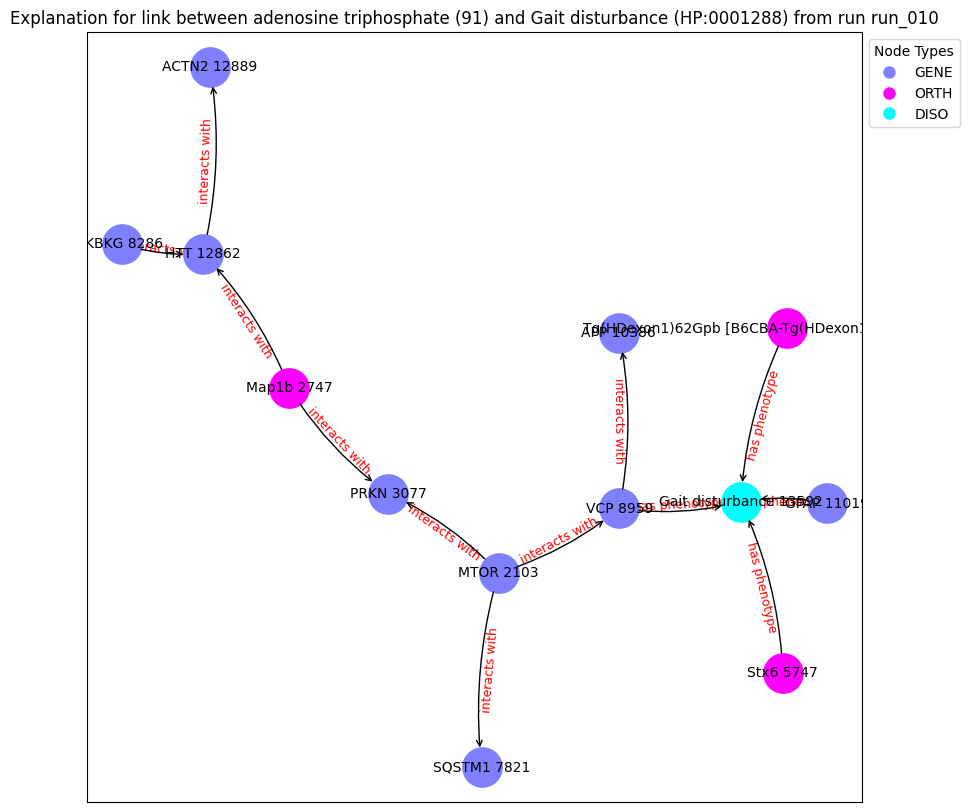

('MTOR 2103', {'type': 'GENE'})
('Map1b 2747', {'type': 'ORTH'})
('PRKN 3077', {'type': 'GENE'})
('Stx6 5747', {'type': 'ORTH'})
('SQSTM1 7821', {'type': 'GENE'})
('IKBKG 8286', {'type': 'GENE'})
('VCP 8959', {'type': 'GENE'})
('Tg(HDexon1)62Gpb [B6CBA-Tg(HDexon1)62Gpb/3J] 10000', {'type': 'ORTH'})
('APP 10386', {'type': 'GENE'})
('GFAP 11019', {'type': 'GENE'})
('HTT 12862', {'type': 'GENE'})
('ACTN2 12889', {'type': 'GENE'})
('Gait disturbance 13592', {'type': 'DISO'})
('MTOR 2103', 'PRKN 3077', {'label': 'interacts with'})
('MTOR 2103', 'SQSTM1 7821', {'label': 'interacts with'})
('MTOR 2103', 'VCP 8959', {'label': 'interacts with'})
('Map1b 2747', 'PRKN 3077', {'label': 'interacts with'})
('Map1b 2747', 'HTT 12862', {'label': 'interacts with'})
('Stx6 5747', 'Gait disturbance 13592', {'label': 'has phenotype'})
('IKBKG 8286', 'HTT 12862', {'label': 'interacts with'})
('VCP 8959', 'APP 10386', {'label': 'interacts with'})
('VCP 8959', 'Gait disturbance 13592', {'label': 'has phenoty

Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 225.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4384], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:02<00:00, 236.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4384], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:02<00:00, 241.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4384], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:02<00:00, 239.98it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4384], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:02<00:00, 248.64it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4384], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:02<00:00, 243.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4384], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:03<00:00, 223.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4384], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:02<00:00, 245.94it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4384], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:02<00:00, 246.44it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.4384], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1036: 100%|██████████| 700/700 [00:02<00:00, 244.05it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                        label  semantic_id
4071      4071  HP:0003324     DISO  Generalized muscle weakness            1
node2:
     index_id    id semantic       label  semantic_id
998       998  1990     DRUG  omeprazole            2
Prediction from trained model: tensor([0.7136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:02<00:00, 244.79it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:02<00:00, 241.02it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:02<00:00, 248.08it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:02<00:00, 250.34it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:02<00:00, 241.75it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:02<00:00, 246.28it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:02<00:00, 235.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:02<00:00, 240.55it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:02<00:00, 248.87it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.7136], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 998: 100%|██████████| 700/700 [00:02<00:00, 251.08it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic                        label  semantic_id
4071      4071  HP:0003324     DISO  Generalized muscle weakness            1
node2:
      index_id    id semantic     label  semantic_id
1000      1000  1996     DRUG  orlistat            2
Prediction from trained model: tensor([0.1935], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:02<00:00, 243.45it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1935], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:02<00:00, 244.74it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1935], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:02<00:00, 245.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1935], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:02<00:00, 249.86it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1935], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:02<00:00, 243.60it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1935], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:02<00:00, 245.85it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1935], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:03<00:00, 226.93it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1935], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:02<00:00, 242.38it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1935], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:02<00:00, 251.47it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.1935], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 4071 and 1000: 100%|██████████| 700/700 [00:02<00:00, 249.05it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic  \
5436      5436  HP:0003107     DISO   

                                               label  semantic_id  
5436  Abnormal circulating cholesterol concentration            1  
node2:
      index_id    id semantic             label  semantic_id
2585      2585  5359     DRUG  brilliant Blue G            2
Prediction from trained model: tensor([0.0026], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 261.41it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0026], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 259.27it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0026], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 273.67it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0026], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 262.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0026], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 262.76it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0026], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 265.22it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0026], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:03<00:00, 220.35it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0026], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 263.10it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0026], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 264.78it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0026], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 2585: 100%|██████████| 700/700 [00:02<00:00, 263.08it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic  \
5436      5436  HP:0003107     DISO   

                                               label  semantic_id  
5436  Abnormal circulating cholesterol concentration            1  
node2:
     index_id   id semantic      label  semantic_id
294       294  578     DRUG  cerulenin            2
Prediction from trained model: tensor([0.0010], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 262.32it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0010], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 272.00it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0010], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 268.62it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0010], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 267.48it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0010], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 267.52it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0010], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 262.25it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0010], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 236.06it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0010], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 267.82it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0010], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 262.07it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([0.0010], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 5436 and 294: 100%|██████████| 700/700 [00:02<00:00, 263.35it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations
node1:
      index_id          id semantic              label  semantic_id
1951      1951  HP:0002354     DISO  Memory impairment            1
node2:
      index_id    id semantic         label  semantic_id
1036      1036  2054     DRUG  pantoprazole            2
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 274.50it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 266.21it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 255.36it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 276.33it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 260.81it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 260.73it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 236.23it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 271.12it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 280.01it/s]


Contribution threshold is tensor(0.)
Prediction from trained model: tensor([1.], grad_fn=<SigmoidBackward0>)


Explain edge between nodes 1951 and 1036: 100%|██████████| 700/700 [00:02<00:00, 270.60it/s]


Contribution threshold is tensor(0.)
No good explanation found after 10 iterations


In [14]:
def get_node_idx(id, nodes): 
    return nodes[nodes['id'] == id].index.values.astype(int)[0]

def is_overlapping_pair(symptom_id, drug_id):
    if symptom_id in overlapping_symptoms_drugs:
        if drug_id in overlapping_symptoms_drugs[symptom_id]:
            return True
    return False

found_explations_list = []

for run_dir in run_folders_paths:
    print(run_dir)
    run_name = run_dir.split('\\')[-1]
    
    symptoms_drugs = pd.read_pickle(f'{run_dir}/pred/{dataset_prefix}_{disease_prefix}_candidates_per_symptom_{embedding_method}.pkl')   
    
    embedding = loadEdge2VecEmbedding(current_run_dir=run_dir)
        
    G = create_graph(embedding=embedding)
    edge_labels_dict = dict([((n1, n2), G.edges[(n1,n2)]['edge_label']) for n1, n2 in G.edges])
    
    best_model = load_trained_model(current_run_dir=run_dir, embedding=embedding)
    
    x = torch.Tensor(embedding['Embedding'])
    edge_index = torch.Tensor(np.array(G.edges).transpose()).type(torch.int64).long()
    
    complete_explanation_nr = 0
    incomplete_explanation_nr = 0
    
    for ind, edge in symptoms_drugs.iterrows(): 
        symptom_id = edge['Symptom']
        for drug_id in edge['Candidates']:
            if is_overlapping_pair(symptom_id=symptom_id, drug_id=drug_id):
            
                node_idx1 = get_node_idx(symptom_id, nodes)
                print('node1:')
                print(nodes.loc[[node_idx1]])

                node_idx2 = get_node_idx(str(drug_id), nodes)
                print('node2:')
                print(nodes.loc[[node_idx2]])
                
                found_edge_mask, found_limit, is_complete = explain_edge(node_idx1=node_idx1, node_idx2=node_idx2,
                                                                         model=best_model, x=x, edge_index=edge_index, G=G)
                
                if found_edge_mask is not None and found_limit is not None:
                    if is_complete:
                        complete_explanation_nr += 1
                        explanation_nr = complete_explanation_nr
                    else:
                        incomplete_explanation_nr += 1
                        explanation_nr = incomplete_explanation_nr
                    
                    found_explanation= {'symptom': symptom_id, 'drug': drug_id, 
                                        'node_idx1': node_idx1, 'node_idx2': node_idx2, 
                                        'found_edge_mask': found_edge_mask, 'found_limit': found_limit, 
                                        'complete': is_complete, 'run': run_name}
                    
                    found_explations_list.append(found_explanation)
                    
                    
                    visualize_explanation(explanation_nr, found_explanation, edge_index, edge_labels_dict)
        
    with open(f'{expl_output_dir}/{run_name}_explanations.txt', 'w') as f:
        f.write(f'Total of {complete_explanation_nr} complete explanations found and total of {incomplete_explanation_nr} incomplete explanations found for run {run_name}')

In [15]:
found_explations_list

[{'symptom': 'HP:0000716',
  'drug': '1990',
  'node_idx1': 13668,
  'node_idx2': 998,
  'found_edge_mask': tensor([0., 0., 0.,  ..., 0., 0., 0.]),
  'found_limit': tensor(0.9938),
  'complete': False,
  'run': 'run_001'},
 {'symptom': 'HP:0000716',
  'drug': '2054',
  'node_idx1': 13668,
  'node_idx2': 1036,
  'found_edge_mask': tensor([0., 0., 0.,  ..., 0., 0., 0.]),
  'found_limit': tensor(0.9938),
  'complete': False,
  'run': 'run_001'},
 {'symptom': 'HP:0000716',
  'drug': '1996',
  'node_idx1': 13668,
  'node_idx2': 1000,
  'found_edge_mask': tensor([0., 0., 0.,  ..., 0., 0., 0.]),
  'found_limit': tensor(0.9939),
  'complete': False,
  'run': 'run_001'},
 {'symptom': 'HP:0001332',
  'drug': '578',
  'node_idx1': 12933,
  'node_idx2': 294,
  'found_edge_mask': tensor([0., 0., 0.,  ..., 0., 0., 0.]),
  'found_limit': tensor(0.9938),
  'complete': False,
  'run': 'run_001'},
 {'symptom': 'HP:0001332',
  'drug': '1990',
  'node_idx1': 12933,
  'node_idx2': 998,
  'found_edge_mask':